In [2]:
import pandas as pd 
import numpy as np
from scipy import stats
import csv
import matplotlib.pyplot as plt
import glob
import os
import re
import itertools  
import GPy

In [3]:
%load_ext autoreload
%autoreload 2

# Extracting the standards from the mzmine peak picked files

Reading in the csv files exported from mzmine after peak picking.

In [4]:
zik_mzmine_peak_file_list = glob.glob(os.path.join('/Users/anamaria/Desktop/mzmine/221119/standards/', "Zik*.csv"))
mal_mzmine_peak_file_list = glob.glob(os.path.join('/Users/anamaria/Desktop/mzmine/221119/standards/', "Mal*.csv"))
vl_mzmine_peak_file_list = glob.glob(os.path.join('/Users/anamaria/Desktop/mzmine/221119/standards/', "VL*.csv"))

zik_mzmine_peak_file_list.sort()
mal_mzmine_peak_file_list.sort()
vl_mzmine_peak_file_list.sort()

file_zik1 = pd.read_csv(zik_mzmine_peak_file_list[0])
file_zik1_2 = pd.read_csv(zik_mzmine_peak_file_list[1])
file_zik2 = pd.read_csv(zik_mzmine_peak_file_list[2])
file_zik2_2 = pd.read_csv(zik_mzmine_peak_file_list[3])
file_zik3 = pd.read_csv(zik_mzmine_peak_file_list[4])
file_zik3_2 = pd.read_csv(zik_mzmine_peak_file_list[5])

file_mal1 = pd.read_csv(mal_mzmine_peak_file_list[0])
file_mal1_2 = pd.read_csv(mal_mzmine_peak_file_list[1])
file_mal2 = pd.read_csv(mal_mzmine_peak_file_list[2])
file_mal2_2 = pd.read_csv(mal_mzmine_peak_file_list[3])
file_mal3 = pd.read_csv(mal_mzmine_peak_file_list[4])
file_mal3_2 = pd.read_csv(mal_mzmine_peak_file_list[5])

file_vl1 = pd.read_csv(vl_mzmine_peak_file_list[0])
file_vl1_2 = pd.read_csv(vl_mzmine_peak_file_list[1])
file_vl2 = pd.read_csv(vl_mzmine_peak_file_list[2])
file_vl2_2 = pd.read_csv(vl_mzmine_peak_file_list[3])
file_vl3 = pd.read_csv(vl_mzmine_peak_file_list[4])
file_vl3_2 = pd.read_csv(vl_mzmine_peak_file_list[5])

Reading in the standards csv files obtained from ToxID (Polyomics).

In [7]:
zik_standards_file_list = glob.glob(os.path.join('/Volumes/Transcend/PhD/Metabolomics_datasets/Zika/', "*Std*.csv"))
malaria_standards_file_list = glob.glob(os.path.join('/Volumes/Transcend/PhD/Metabolomics_datasets/Malaria','*Std*.csv'))
vl_standards_file_list = glob.glob(os.path.join('/Volumes/Transcend/PhD/Metabolomics_datasets/VL','*Std*.csv'))

zik_standards_file_list.sort()
malaria_standards_file_list.sort()
vl_standards_file_list.sort()

zik_std1_csv_file = pd.read_csv(zik_standards_file_list[0], skiprows=9, index_col=False)
zik_std1_2_csv_file = pd.read_csv(zik_standards_file_list[1], skiprows=9, index_col=False)
zik_std2_csv_file = pd.read_csv(zik_standards_file_list[2], skiprows=15, index_col=False)
zik_std2_2_csv_file = pd.read_csv(zik_standards_file_list[3], skiprows=9, index_col=False)
zik_std3_csv_file = pd.read_csv(zik_standards_file_list[4], skiprows=15, index_col=False)
zik_std3_2_csv_file = pd.read_csv(zik_standards_file_list[5], skiprows=9, index_col=False)

mal_std1_csv_file = pd.read_csv(malaria_standards_file_list[0], skiprows=9, index_col=False)
mal_std1_2_csv_file = pd.read_csv(malaria_standards_file_list[1], skiprows=8, index_col=False)
mal_std2_csv_file = pd.read_csv(malaria_standards_file_list[2], skiprows=9, index_col=False)
mal_std2_2_csv_file = pd.read_csv(malaria_standards_file_list[3], skiprows=8, index_col=False)
mal_std3_csv_file = pd.read_csv(malaria_standards_file_list[4], skiprows=9, index_col=False)
mal_std3_2_csv_file = pd.read_csv(malaria_standards_file_list[5], skiprows=8, index_col=False)

vl_std1_csv_file = pd.read_csv(vl_standards_file_list[0], skiprows=8, index_col=False)
vl_std1_2_csv_file = pd.read_csv(vl_standards_file_list[1], skiprows=8, index_col=False)
vl_std2_csv_file = pd.read_csv(vl_standards_file_list[2], skiprows=8, index_col=False)
vl_std2_2_csv_file = pd.read_csv(vl_standards_file_list[3], skiprows=8, index_col=False)
vl_std3_csv_file = pd.read_csv(vl_standards_file_list[4], skiprows=8, index_col=False)
vl_std3_2_csv_file = pd.read_csv(vl_standards_file_list[5], skiprows=8, index_col=False)

Creating dictionaries for each of the standards csv files. Key = Compound name, Values = (Detected m/z, Expected RT, Actual RT, Polarity)

In [8]:
from metab_utils import create_std_dict

zik_standards_1 = create_std_dict(zik_std1_csv_file)
zik_standards_1_2 = create_std_dict(zik_std1_2_csv_file)
zik_standards_2 = create_std_dict(zik_std2_csv_file)
zik_standards_2_2 = create_std_dict(zik_std2_2_csv_file)
zik_standards_3 = create_std_dict(zik_std3_csv_file)
zik_standards_3_2 = create_std_dict(zik_std3_2_csv_file)

mal_standards_1 = create_std_dict(mal_std1_csv_file)
mal_standards_1_2 = create_std_dict(mal_std1_2_csv_file)
mal_standards_2 = create_std_dict(mal_std2_csv_file)
mal_standards_2_2 = create_std_dict(mal_std2_2_csv_file)
mal_standards_3 = create_std_dict(mal_std3_csv_file)
mal_standards_3_2 = create_std_dict(mal_std3_2_csv_file)

vl_standards_1 = create_std_dict(vl_std1_csv_file)
vl_standards_1_2 = create_std_dict(vl_std1_2_csv_file)
vl_standards_2 = create_std_dict(vl_std2_csv_file)
vl_standards_2_2 = create_std_dict(vl_std2_2_csv_file)
vl_standards_3 = create_std_dict(vl_std3_csv_file)
vl_standards_3_2 = create_std_dict(vl_std3_2_csv_file)

Selecting the standards from each mzmine file.

In [9]:
from metab_utils import select_std_from_mzmine

print("-------------------------------------ZIK-------------------------------------")
zik_mzmine_stds_1, zik_1_name = select_std_from_mzmine(file_zik1, zik_standards_1, mz_range= 0.001)
zik_mzmine_stds_1_2, zik_1_2_name = select_std_from_mzmine(file_zik1_2, zik_standards_1_2, mz_range= 0.001)
zik_mzmine_stds_2, zik_2_name = select_std_from_mzmine(file_zik2, zik_standards_2, mz_range= 0.001)
zik_mzmine_stds_2_2, zik_2_2_name = select_std_from_mzmine(file_zik2_2, zik_standards_2_2, mz_range= 0.001)
zik_mzmine_stds_3, zik_3_name = select_std_from_mzmine(file_zik3, zik_standards_3, mz_range= 0.001)
zik_mzmine_stds_3_2, zik_3_2_name = select_std_from_mzmine(file_zik3_2, zik_standards_3_2, mz_range= 0.001)


print("-------------------------------------MAL-------------------------------------")
mal_mzmine_stds_1, mal_1_name = select_std_from_mzmine(file_mal1, mal_standards_1)
mal_mzmine_stds_1_2, mal_1_2_name = select_std_from_mzmine(file_mal1_2, mal_standards_1_2)
mal_mzmine_stds_2, mal_2_name = select_std_from_mzmine(file_mal2, mal_standards_2)
mal_mzmine_stds_2_2, mal_2_2_name = select_std_from_mzmine(file_mal2_2, mal_standards_2_2)
mal_mzmine_stds_3, mal_3_name = select_std_from_mzmine(file_mal3, mal_standards_3)
mal_mzmine_stds_3_2, mal_3_2_name = select_std_from_mzmine(file_mal3_2, mal_standards_3_2)


print("-------------------------------------VL-------------------------------------")
vl_mzmine_stds_1, vl_1_name = select_std_from_mzmine(file_vl1, vl_standards_1)
vl_mzmine_stds_1_2, vl_1_2_name = select_std_from_mzmine(file_vl1_2, vl_standards_1_2)
vl_mzmine_stds_2,vl_2_name = select_std_from_mzmine(file_vl2, vl_standards_2)
vl_mzmine_stds_2_2, vl_2_2_name = select_std_from_mzmine(file_vl2_2, vl_standards_2_2)
vl_mzmine_stds_3, vl_3_name = select_std_from_mzmine(file_vl3, vl_standards_3)
vl_mzmine_stds_3_2, vl_3_2_name = select_std_from_mzmine(file_vl3_2, vl_standards_3_2)

-------------------------------------ZIK-------------------------------------
Zik_Std1_1_23Oct18
Zik_Std1_2_23Oct18
Zik_Std2_1_23Oct18
Zik_Std2_2_23Oct18
Zik_Std3_1_23Oct18
Zik_Std3_2_23Oct18
-------------------------------------MAL-------------------------------------
Mal_Std1_1_20Dec16
Mal_Std1_2_20Dec16
Mal_Std2_1_20Dec16
Mal_Std2_2_20Dec16
Mal_Std3_1_20Dec16
Mal_Std3_2_20Dec16
-------------------------------------VL-------------------------------------
VL_Std1_1_06Mar18
VL_Std1_2_06Mar18
VL_Std2_1_06Mar18
VL_Std2_2_06Mar18
VL_Std3_1_06Mar18
VL_Std3_2_06Mar18


Create a list with the matching standards between the two corresponding files for all standard files.

In [32]:
from metab_utils import get_std_matches_for_files

stds_dir = '/Volumes/Transcend/PhD/Metabolomics_datasets/Standards_csv'
output_dir = '/Users/anamaria/Desktop/mzmine/221119/standards'
original_files = glob.glob(os.path.join(stds_dir,'*.csv'))
original_files = [o.split(os.sep)[-1].split('.')[0] for o in original_files]
original_files = ['_'.join(o.split('_')[0:4]) for o in original_files]
original_csvs = [os.path.join(output_dir,original_file + '_pp.csv') for original_file in original_files]
matches = {}
stds_csvs = glob.glob(os.path.join(stds_dir, '*.csv'))  
matches = get_std_matches_for_files(original_files, output_dir, stds_csvs, original_csvs)

import pickle
with open('/Users/anamaria/Desktop/mzmine/std_matches.txt', 'wb') as handle:
    pickle.dump(matches, handle)

# Comparing the retention times between the datasets

In [10]:
zik_mzmine_stds_1_list = [zik_mzmine_stds_1, zik_mzmine_stds_2, zik_mzmine_stds_3]
zik_mzmine_stds_2_list = [zik_mzmine_stds_1_2, zik_mzmine_stds_2_2, zik_mzmine_stds_3_2]

mal_mzmine_stds_1_list = [mal_mzmine_stds_1, mal_mzmine_stds_2, mal_mzmine_stds_3]
mal_mzmine_stds_2_list = [mal_mzmine_stds_1_2, mal_mzmine_stds_2_2, mal_mzmine_stds_3_2]

vl_mzmine_stds_1_list = [vl_mzmine_stds_1, vl_mzmine_stds_2, vl_mzmine_stds_3]
vl_mzmine_stds_2_list = [vl_mzmine_stds_1_2, vl_mzmine_stds_2_2, vl_mzmine_stds_3_2]

0.37648101265822986 6.726409667061106 57.39599999999996


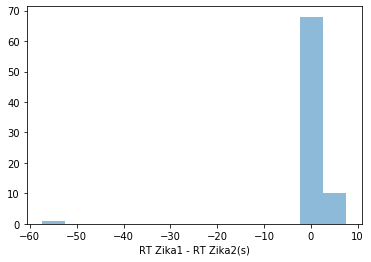

-2.23170114942529 36.361296252678564 338.23100000000005


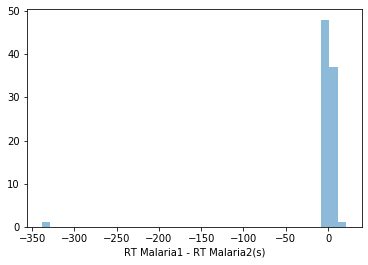

3.654024691358012 25.016349886204825 224.78100000000006


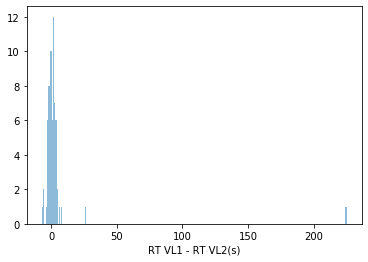

In [11]:
from metab_utils import get_stats_on_diff

get_stats_on_diff(zik_mzmine_stds_1_list, 'Zika1', zik_mzmine_stds_2_list, 'Zika2', 5, 20)
get_stats_on_diff(mal_mzmine_stds_1_list, 'Malaria1', mal_mzmine_stds_2_list, 'Malaria2', 10, 20)
get_stats_on_diff(vl_mzmine_stds_1_list, 'VL1', vl_mzmine_stds_2_list, 'VL2', 0.8, 20)

-19.851595238095243 41.402773550733414 319.737


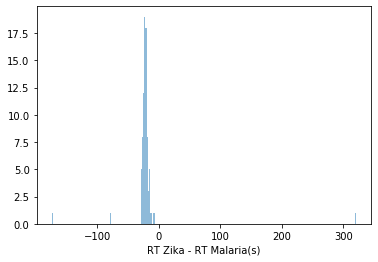

-112.03211111111112 84.7804532139366 252.5429999999999


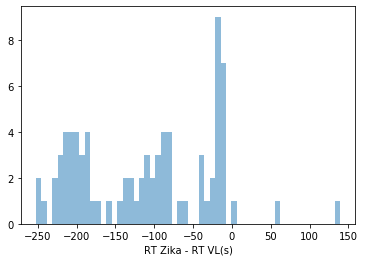

In [12]:
get_stats_on_diff(zik_mzmine_stds_1_list, 'Zika', mal_mzmine_stds_1_list, 'Malaria', 2, 200)
get_stats_on_diff(zik_mzmine_stds_1_list, 'Zika', vl_mzmine_stds_1_list, 'VL', 7, 200)

# Determining the best model for modifying the retention times

GP sampling and regression

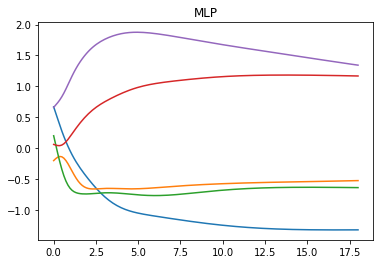

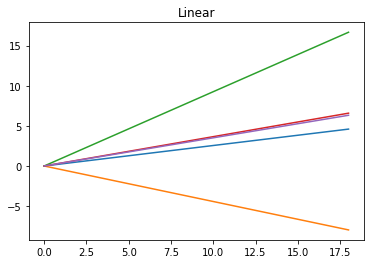

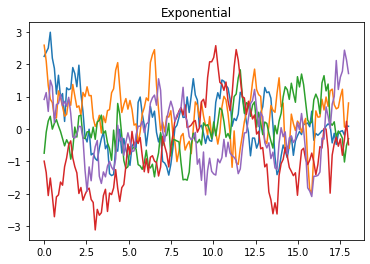

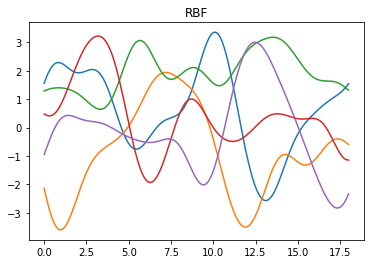

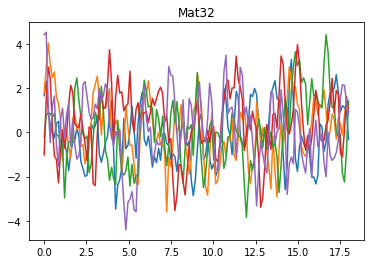

...

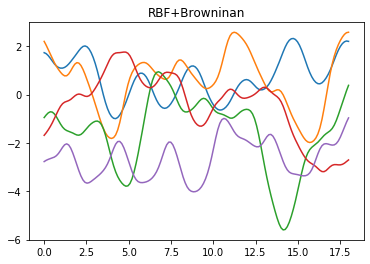

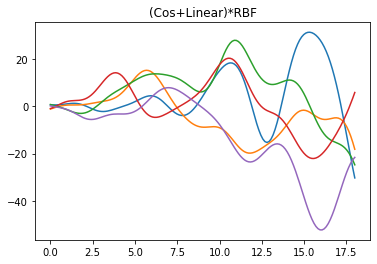

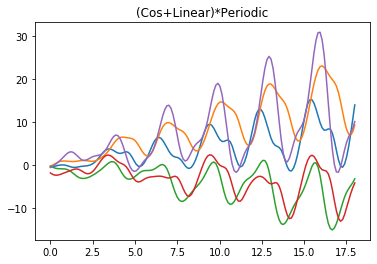

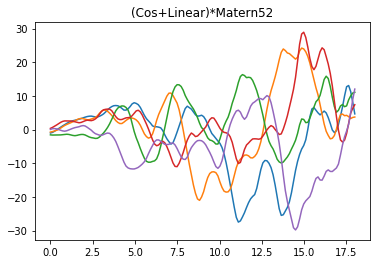

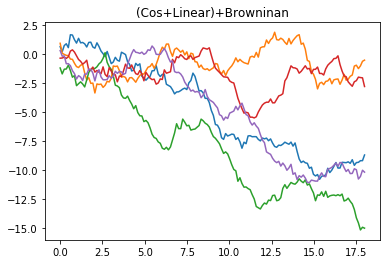

In [221]:
#define several kernels from GPy
k_lin = GPy.kern.Linear(1)
k_exp = GPy.kern.Exponential(1)

k_rbf = GPy.kern.RBF(input_dim=1, variance=2.25, lengthscale=1.5)
k_mat32 = GPy.kern.Matern32(input_dim=1, variance=2., lengthscale=0.2)
k_mat52 = GPy.kern.Matern52(1)

k_per = GPy.kern.StdPeriodic(1, period=3.)
k_cos = GPy.kern.Cosine(1)
k_brwn = GPy.kern.Brownian(1)
k_nn = GPy.kern.MLP(1)

#make a vector with various kernels and calculate composite kernel
ks = [k_nn, k_lin, k_exp, k_rbf, k_mat32, k_mat52, k_per, k_cos, k_brwn, k_rbf+k_per,
      (k_cos+k_lin)*(k_rbf), (k_cos+k_lin)*(k_per), (k_cos+k_lin)*(k_mat52), (k_cos+k_lin)+(k_brwn) ]
ks_names = ['MLP', 'Linear', 'Exponential', 'RBF', 'Mat32', 'Mat52', 'Periodic', 'Cosine', 'Browninan', 'RBF+Browninan', 
           '(Cos+Linear)*RBF', '(Cos+Linear)*Periodic', '(Cos+Linear)*Matern52', '(Cos+Linear)+Browninan']

for k, name in zip(ks,ks_names):
    #sample from the kernel
    sample_space = np.linspace(0,18,150)[:,None]
    mu = np.zeros((150))
    C = k.K(sample_space)
        
    # Sample 5 times from a multivariate Gaussian distribution with mean 0 and covariance k(X,X)
    Z  = np.random.multivariate_normal(mu, C, 5)
    for i in range(5):
        plt.plot(sample_space, Z[i])
    plt.title(name)
    plt.show()


## Zika vs Mal

In [13]:
from metab_utils import get_rt_diff_between_datasets
(mal_1_rt, zik_1_rt, stds_mal_zik, mal1_zik1_diff) = get_rt_diff_between_datasets(mal_mzmine_stds_1_list,zik_mzmine_stds_1_list)

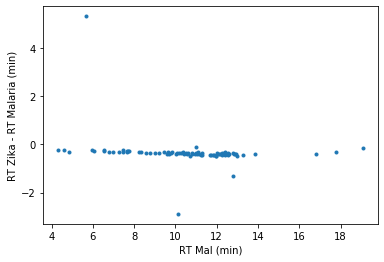

(-1, 1)

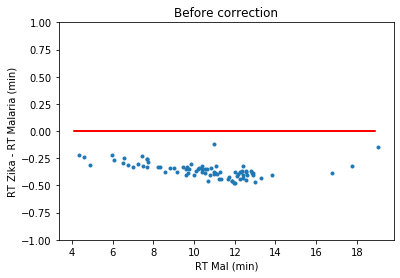

In [19]:
from metab_utils import return_data_with_no_outliers

plt.plot(np.array(mal_1_rt), np.array(zik_1_rt)-np.array(mal_1_rt), '.')
plt.xlabel('RT Mal (min)')
plt.ylabel('RT Zika - RT Malaria (min)')
#plt.ylim(-200,200)
plt.show()

mal_1_rt_mod, zik_1_rt_mod = return_data_with_no_outliers(mal_1_rt, zik_1_rt, mal1_zik1_diff, 1.4)

plt.plot(mal_1_rt_mod,zik_1_rt_mod-mal_1_rt_mod , '.')
plt.plot(zik_1_rt_mod[:,None], zik_1_rt_mod[:,None] - zik_1_rt_mod[:,None], 'r')
plt.xlabel('RT Mal (min)')
plt.ylabel('RT Zika - RT Malaria (min)')
plt.title('Before correction')
plt.ylim(-1,1)


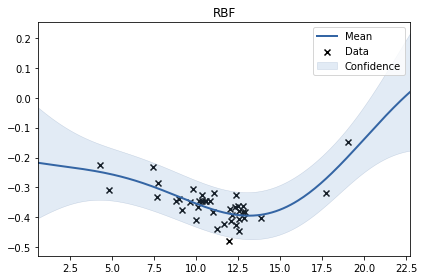

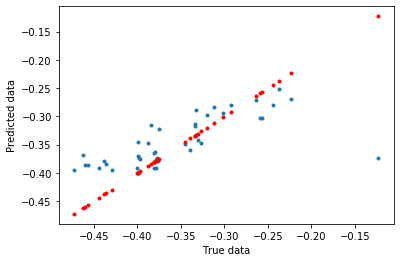

Cross-Predicted Accuracy for RBF : 0.4438179544470644
Mean absolute error for RBF : 0.03827300787636041
Mean squared error for RBF : 0.0031545014773443425


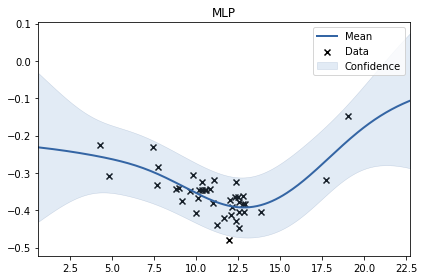

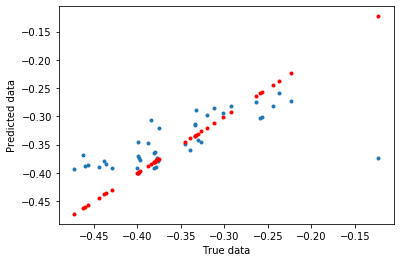

Cross-Predicted Accuracy for MLP : 0.4310199429071433
Mean absolute error for MLP : 0.03895585595647395
Mean squared error for MLP : 0.0032270880461351694


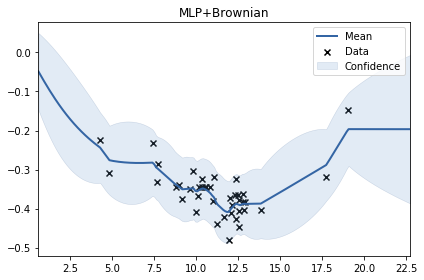

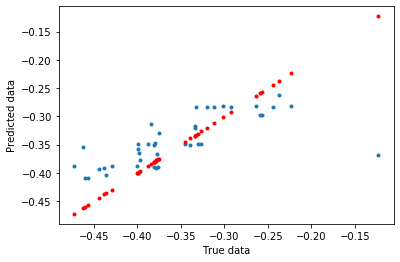

Cross-Predicted Accuracy for MLP+Brownian : 0.45260998076445114
Mean absolute error for MLP+Brownian : 0.039570398247554636
Mean squared error for MLP+Brownian : 0.0031046356820911454


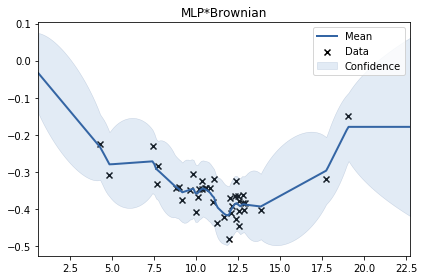

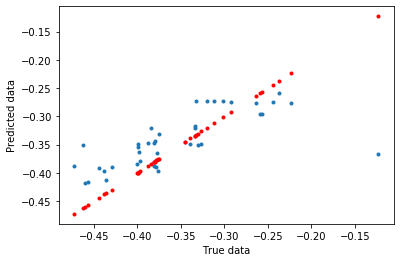

Cross-Predicted Accuracy for MLP*Brownian : 0.45813231576226665
Mean absolute error for MLP*Brownian : 0.03956965960118237
Mean squared error for MLP*Brownian : 0.0030733146172558347


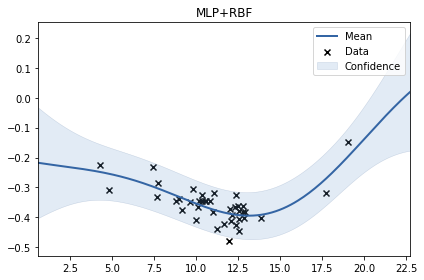

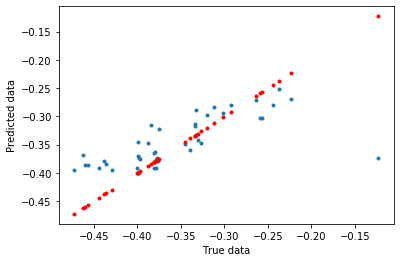

Cross-Predicted Accuracy for MLP+RBF : 0.4438177134494693
Mean absolute error for MLP+RBF : 0.038272993935788625
Mean squared error for MLP+RBF : 0.0031545028442120358


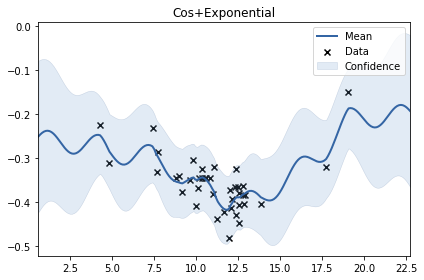

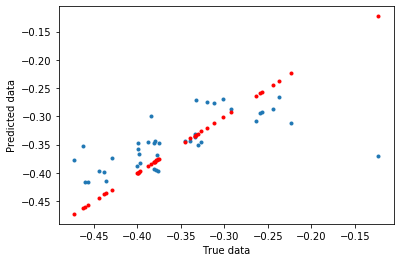

Cross-Predicted Accuracy for Cos+Exponential : 0.39875928051287735
Mean absolute error for Cos+Exponential : 0.041105866501522724
Mean squared error for Cos+Exponential : 0.0034100610636867276


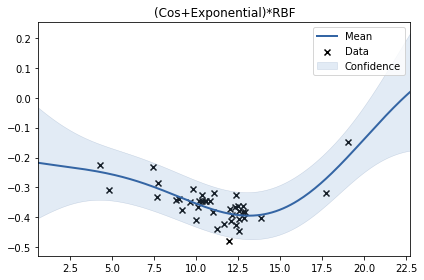

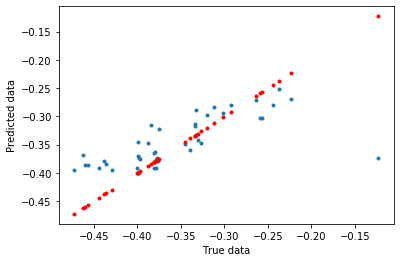

Cross-Predicted Accuracy for (Cos+Exponential)*RBF : 0.4438167303351025
Mean absolute error for (Cos+Exponential)*RBF : 0.03827296067906307
Mean squared error for (Cos+Exponential)*RBF : 0.0031545084201484532


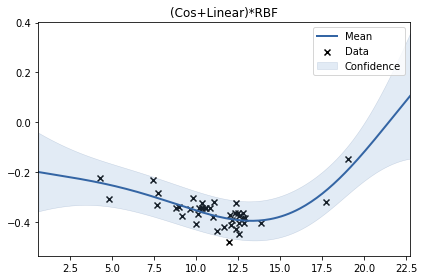

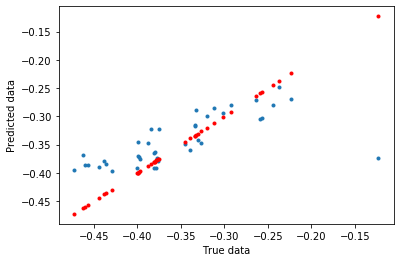

Cross-Predicted Accuracy for (Cos+Linear)*RBF : 0.44919158129571046
Mean absolute error for (Cos+Linear)*RBF : 0.03790577732067994
Mean squared error for (Cos+Linear)*RBF : 0.0031240238415265603


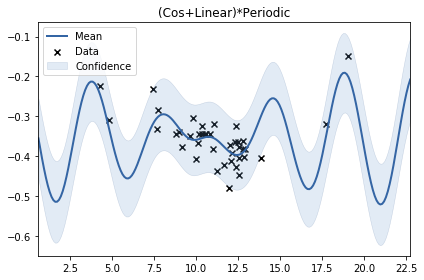

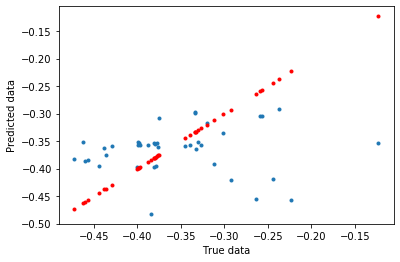

Cross-Predicted Accuracy for (Cos+Linear)*Periodic : -0.2580131010328579
Mean absolute error for (Cos+Linear)*Periodic : 0.06293821956830148
Mean squared error for (Cos+Linear)*Periodic : 0.007135081431442913


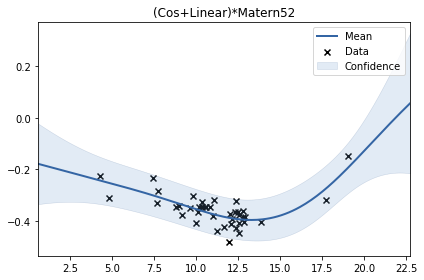

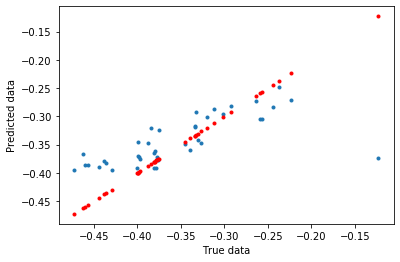

Cross-Predicted Accuracy for (Cos+Linear)*Matern52 : 0.44731928122751563
Mean absolute error for (Cos+Linear)*Matern52 : 0.03794850737249289
Mean squared error for (Cos+Linear)*Matern52 : 0.0031346429785130497
(Cos+Linear)*RBF


In [12]:
from metab_utils import try_gp_regressions
mmal, kmal, resultsmal = try_gp_regressions(mal_1_rt_mod, zik_1_rt_mod-mal_1_rt_mod)


rbf.,value,constraints,priors
variance,0.0727526192870419,+ve,
lengthscale,7.418751579234511,+ve,


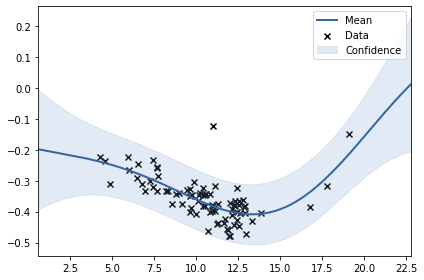

In [15]:
kmal = GPy.kern.RBF(input_dim=1, variance=0.1, lengthscale=6.5)
mmal = GPy.models.GPRegression(mal_1_rt_mod[:,None], zik_1_rt_mod[:,None] - mal_1_rt_mod[:,None],kmal)
mmal.optimize()
mmal.plot()
mmal.parameters[0]

(-1, 1)

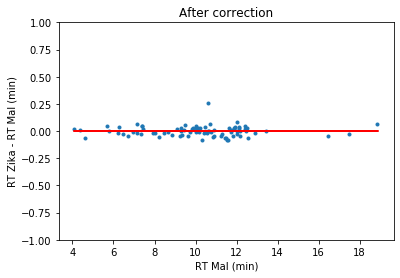

In [20]:
gpr_predicted_data,_ = mmal.predict(np.array(mal_1_rt_mod)[:,None])

plt.plot(np.array(mal_1_rt_mod)[:,None]+gpr_predicted_data, np.array(zik_1_rt_mod)[:,None] - (np.array(mal_1_rt_mod)[:,None]+gpr_predicted_data), '.')
plt.plot(np.array(zik_1_rt_mod)[:,None], np.array(zik_1_rt_mod)[:,None] -np.array(zik_1_rt_mod)[:,None], 'r')
plt.plot()
plt.xlabel('RT Mal (min)')
plt.ylabel('RT Zika - RT Mal (min)')
plt.title('After correction')
plt.ylim(-1,1)

## Zika vs VL

In [21]:
(vl_1_rt, zik_1_rt, stds_vl_zik, vl1_zik1_diff) = get_rt_diff_between_datasets(vl_mzmine_stds_1_list,zik_mzmine_stds_1_list, file_number=3)

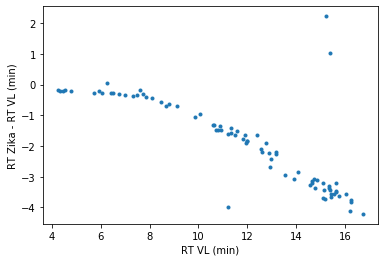

(-4, 4)

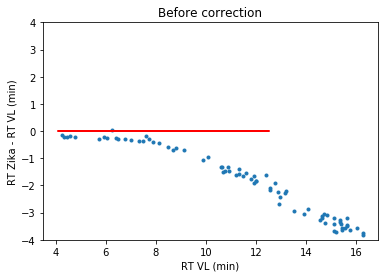

In [23]:
plt.plot(np.array(vl_1_rt), np.array(zik_1_rt) - np.array(vl_1_rt), '.')
plt.xlabel('RT VL (min)')
plt.ylabel('RT Zika - RT VL (min)')
#plt.ylim(-1,1)
plt.show()

vl_1_rt_mod, zik_1_rt_mod = return_data_with_no_outliers(vl_1_rt, zik_1_rt, vl1_zik1_diff, 1.5)

plt.plot(vl_1_rt_mod, zik_1_rt_mod - vl_1_rt_mod, '.')
plt.plot(zik_1_rt_mod[:,None], zik_1_rt_mod[:,None] - zik_1_rt_mod[:,None], 'r')
plt.xlabel('RT VL (min)')
plt.ylabel('RT Zika - RT VL (min)')
plt.title('Before correction')
plt.ylim(-4,4)

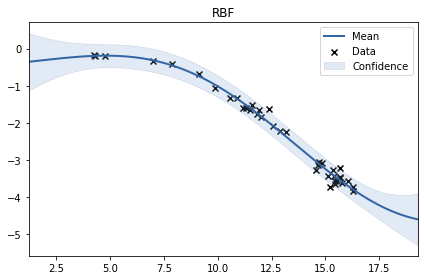

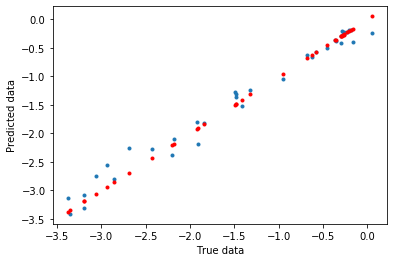

Cross-Predicted Accuracy for RBF : 0.9788507966130053
Mean absolute error for RBF : 0.1178712065945231
Mean squared error for RBF : 0.026634769251725466


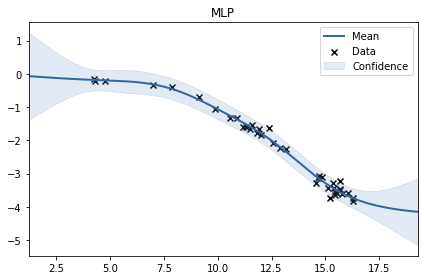

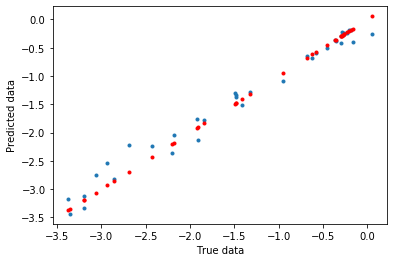

Cross-Predicted Accuracy for MLP : 0.9784608471363075
Mean absolute error for MLP : 0.11839996885208022
Mean squared error for MLP : 0.02712586171235519


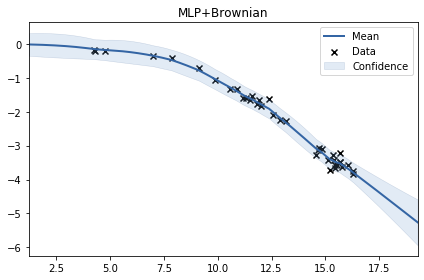

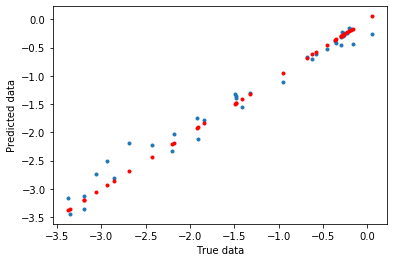

Cross-Predicted Accuracy for MLP+Brownian : 0.9763351611164439
Mean absolute error for MLP+Brownian : 0.1273077503590787
Mean squared error for MLP+Brownian : 0.02980289666278273


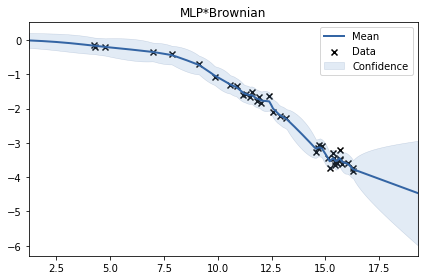

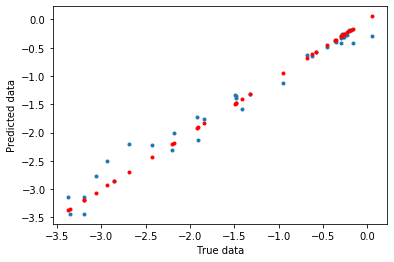

Cross-Predicted Accuracy for MLP*Brownian : 0.9756488436192534
Mean absolute error for MLP*Brownian : 0.1271678700179404
Mean squared error for MLP*Brownian : 0.030667227476412054


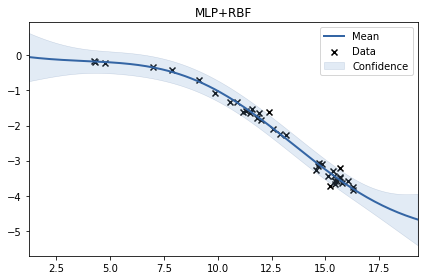

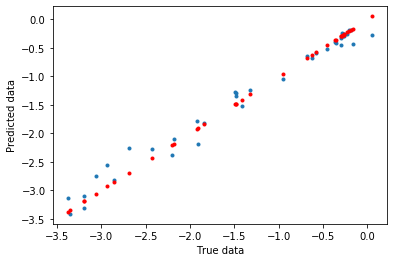

Cross-Predicted Accuracy for MLP+RBF : 0.9778298051706348
Mean absolute error for MLP+RBF : 0.1229857489617847
Mean squared error for MLP+RBF : 0.027920579926384168


 /Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/GPy/kern/src/stationary.py:168: RuntimeWarning:overflow encountered in true_divide
 /Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/GPy/kern/src/stationary.py:213: RuntimeWarning:invalid value encountered in multiply


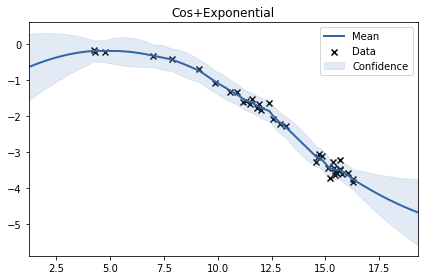

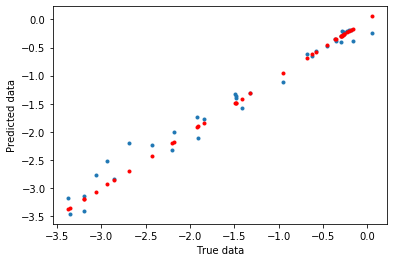

Cross-Predicted Accuracy for Cos+Exponential : 0.9776124746365431
Mean absolute error for Cos+Exponential : 0.12039992328577115
Mean squared error for Cos+Exponential : 0.028194280477698952


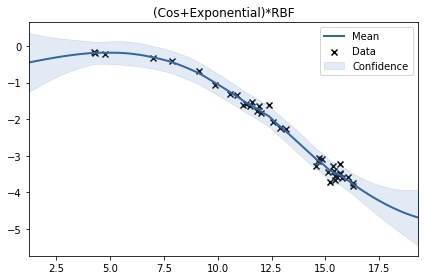

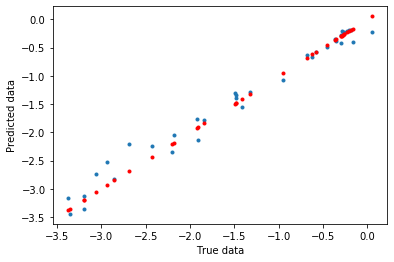

Cross-Predicted Accuracy for (Cos+Exponential)*RBF : 0.9783254215011453
Mean absolute error for (Cos+Exponential)*RBF : 0.12038937258065753
Mean squared error for (Cos+Exponential)*RBF : 0.027296413315520143


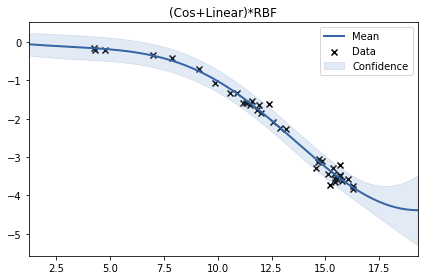

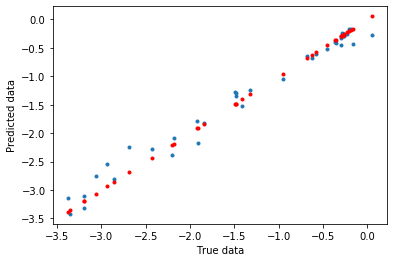

Cross-Predicted Accuracy for (Cos+Linear)*RBF : 0.9774747971812012
Mean absolute error for (Cos+Linear)*RBF : 0.12586316092478123
Mean squared error for (Cos+Linear)*RBF : 0.028367667965969463


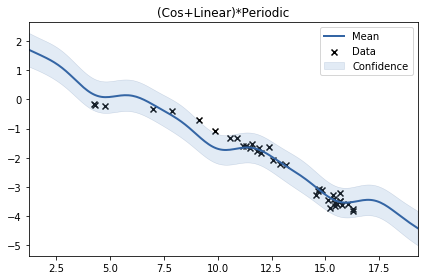

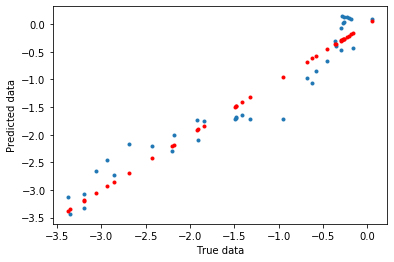

Cross-Predicted Accuracy for (Cos+Linear)*Periodic : 0.9296818613566753
Mean absolute error for (Cos+Linear)*Periodic : 0.2570713819851932
Mean squared error for (Cos+Linear)*Periodic : 0.08855687671562645


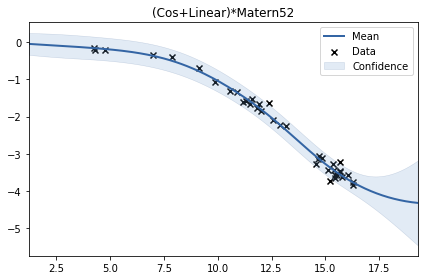

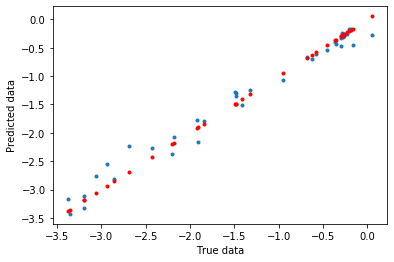

Cross-Predicted Accuracy for (Cos+Linear)*Matern52 : 0.9769466313678155
Mean absolute error for (Cos+Linear)*Matern52 : 0.12902960667910038
Mean squared error for (Cos+Linear)*Matern52 : 0.029032826568341694
RBF


In [17]:
mvl, kvl, results = try_gp_regressions(vl_1_rt_mod, zik_1_rt_mod - vl_1_rt_mod )

sum.,value,constraints,priors
rbf.variance,5.189804807960596,+ve,
rbf.lengthscale,7.732155627283562,+ve,
mlp.variance,1.1994186008735221,+ve,
mlp.weight_variance,538.4175347441105,+ve,
mlp.bias_variance,5.562684646268137e-309,+ve,


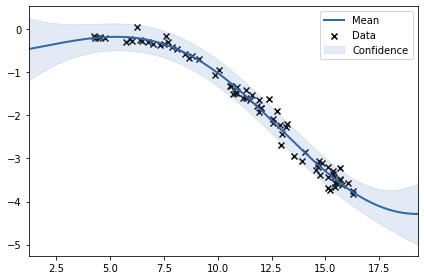

In [24]:
kvl = GPy.kern.RBF(input_dim=1, variance=0.1, lengthscale=6.5) + GPy.kern.MLP(1)
mvl = GPy.models.GPRegression(vl_1_rt_mod[:,None], zik_1_rt_mod[:,None]-vl_1_rt_mod[:,None], kvl)

mvl.optimize()
mvl.plot()
mvl.parameters[0]

(-4, 4)

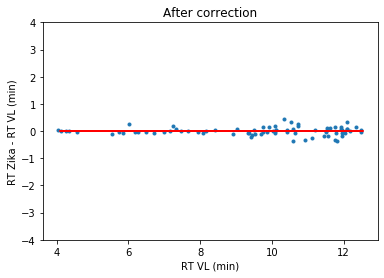

In [26]:
gpr_predicted_data,_ = mvl.predict(np.array(vl_1_rt_mod)[:,None])

plt.plot(np.array(vl_1_rt_mod)[:,None]+gpr_predicted_data, np.array(zik_1_rt_mod)[:,None] - (np.array(vl_1_rt_mod)[:,None]+gpr_predicted_data), '.')
plt.plot(np.array(zik_1_rt_mod)[:,None], np.array(zik_1_rt_mod)[:,None] -np.array(zik_1_rt_mod)[:,None], 'r')
plt.plot()
plt.xlabel('RT VL (min)')
plt.ylabel('RT Zika - RT VL (min)')
plt.title('After correction')
plt.ylim(-4,4)

# Modify mzTab files based on the previously obtained models

In [183]:
#for modifying the patient files
vl_samples = '/Users/anamaria/Desktop/mzmine/221119/vl'
vl_samples_new = '/Users/anamaria/Desktop/mzmine/221119/vl_changed_rt'
mal_samples = '/Users/anamaria/Desktop/mzmine/221119/mal'
mal_samples_new = '/Users/anamaria/Desktop/mzmine/221119/mal_changed_rt'

In [25]:
#for modifying the standard files
output_dir = '/Users/anamaria/Desktop/mzmine/221119/standards/'
output_dir_new = '/Users/anamaria/Desktop/mzmine/221119/standards_changed_rt/'


In [28]:
from metab_utils import modify_rtdrift_in_mztab

modify_rtdrift_in_mztab(output_dir, output_dir_new, name_tag = 'Mal*.mzTab', model = mmal, standards = True)
modify_rtdrift_in_mztab(output_dir, output_dir_new, name_tag = 'VL*.mzTab', model = mvl, standards = True)



-0.28707268856072377
6.999716666666667
6.712643978105943
-0.28707268856072377
6.999716666666667
6.712643978105943
-0.3834809677223735
11.052133333333334
10.66865236561096
-0.40706137375021056
12.844683333333334
12.437621959583124
-0.21115487165705576
19.131166666666665
18.92001179500961
-0.2578612865945962
5.533383333333333
5.275522046738737
-0.3571899869330466
9.8688
9.511610013066953
-0.18987435805508182
19.474333333333334
19.284458975278252
-0.3834809677223735
11.052133333333334
10.66865236561096
-0.39486397383172256
11.6989
11.304036026168278
-0.404689718138614
12.506233333333334
12.10154361519472
-0.37886120166059534
10.8234
10.444538798339405
-0.1951753369908862
19.389499999999998
19.194324663009112
-0.3566766874850066
9.847616666666665
9.49093997918166
-0.27537342892007466
6.4525500000000005
6.177176571079926
-0.23430374717905555
3.98005
3.745746252820944
-0.3640864821627108
10.158116666666666
9.794030184503956
-0.40009258959098504
12.072766666666666
11.672674077075682
-0.215202

-0.27537342892007466
6.4525500000000005
6.177176571079926
-0.3048771420056824
7.767650000000001
7.462772857994318
-0.3730730591428254
10.553066666666666
10.17999360752384
-0.2634934042645165
5.845266666666666
5.58177326240215
-0.23093287907022597
18.8045
18.573567120929773
-0.34430157943044415
9.34685
9.002548420569555
-0.1989270911242328
0.6915166666666667
0.4925895755424339
-0.21823515256291037
2.5989
2.3806648474370897
-0.24938285762159562
5.02665
4.777267142378404
-0.2411746624521316
18.631500000000003
18.39032533754787
-0.23516997699950049
4.046233333333333
3.811063356333833
-0.2922649854397137
7.230383333333333
6.938118347893619
-0.26310938821767627
5.82455
5.561440611782324
0.057901362790530306
23.689833333333336
23.747734696123867
0.04909580623762144
23.500999999999998
23.550095806237618
-0.2130921273983225
2.1014666666666666
1.888374539268344
-0.39875467378599894
11.969183333333332
11.570428659547332
-0.30587179369257855
7.8088999999999995
7.503028206307421
0.05305434638813847

-0.2059264793500811
19.216166666666666
19.010240187316587
-0.3038862865442429
7.726416666666666
7.422530380122423
-0.3396035507422065
9.160016666666667
8.820413115924461
-0.37487596892077224
10.63565
10.260774031079228
-0.37442788956631134
10.615
10.240572110433689
-0.4024850519427524
12.278766666666666
11.876281614723913
-0.23052112736220554
3.6812833333333335
3.450762205971128
-0.4065820519251495
12.761316666666666
12.354734614741517
0.06664315450563774
23.884999999999998
23.951643154505636
-0.3119759407209338
8.059266666666666
7.747290725945732
-0.24638930837827755
4.835183333333333
4.588794024955056
-0.2354444329614065
4.067033333333333
3.8315889003719263
-0.050167677178479864
21.688333333333333
21.638165656154854
-0.2002187072555115
0.8182666666666666
0.6180479594111551
-0.2932078096836106
7.2716
6.97839219031639
-0.2849767460806623
17.8485
17.56352325391934
-0.3202567942794594
8.392850000000001
8.072593205720542
-0.350078948876689
9.578616666666667
9.228537717789978
-0.2043361390

-0.39839393549673185
14.645116666666667
14.246722731169935
-0.3801521161827578
10.885983333333334
10.505831217150575
-0.3845220962203677
15.334249999999999
14.949727903779632
-0.27282684779367994
6.327366666666666
6.054539818872986
0.05902659898348392
23.714499999999997
23.77352659898348
-0.25005916940711026
5.068933333333334
4.818874163926224
-0.4069489083782395
12.823983333333333
12.417034424955093
-0.30239424646200996
7.6640500000000005
7.36165575353799
-0.3028865701003589
7.684666666666667
7.381780096566308
-0.3693687911907395
10.387233333333334
10.017864542142595
-0.3889450848888337
11.343716666666667
10.954771581777834
-0.4075732698574054
12.951799999999999
12.544226730142594
-0.26310938821767627
5.82455
5.561440611782324
-0.27459675445406634
18.041833333333333
17.767236578879267
0.061851446963807455
23.776999999999997
23.838851446963805
-0.2814909355881372
6.743916666666666
6.462425731078529
-0.19120963752148895
19.453
19.26179036247851
-0.350078948876689
9.578616666666667
9.228

8.092807505238467
-0.2814909355881372
6.743916666666666
6.462425731078529
-0.2002187072555115
0.8182666666666666
0.6180479594111551
-0.4023835903168089
14.358283333333333
13.955899743016523
-0.19381750019586785
0.20066666666666666
0.0068491664707988065
-0.26990689704904125
6.1806833333333335
5.9107764362842925
-0.3129945912648624
8.100633333333333
7.78763874206847
-0.40838100467159844
13.415283333333333
13.006902328661734
-0.38340504748652615
15.379233333333334
14.995828285846807
-0.3239149212395497
17.056666666666665
16.732751745427116
-0.2361447560327381
18.716833333333334
18.480688577300597
-0.3566766874850066
9.847616666666665
9.49093997918166
-0.3566766874850066
9.847616666666665
9.49093997918166
-0.40801880084010467
13.07655
12.668531199159894
-0.40374823727558906
12.40305
11.99930176272441
-0.3918383028699415
11.510883333333334
11.119045030463393
-0.3375230785767793
9.077566666666666
8.740043588089886
-0.33019455379169627
8.787633333333334
8.457438779541638
-0.33019455379169627


-0.19539098852646863
0.34983333333333333
0.1544423448068647
-0.1700948408579995
19.788
19.617905159142
0.013481544874747217
22.7975
22.810981544874746
-0.40291918021343764
12.319966666666666
11.917047486453228
-0.4074698157827805
13.749433333333334
13.341963517550553
-0.2806057942015947
6.702516666666667
6.421910872465072
-0.31401539793520894
8.141983333333334
7.827967935398125
-0.2833569346069258
6.830416666666666
6.547059732059741
-0.25424538845794364
5.3232333333333335
5.06898794487539
-0.2849767460806623
17.8485
17.56352325391934
-0.4031305564066856
12.340566666666666
11.93743611025998
-0.40781608410381653
13.666733333333333
13.258917249229517
-0.4081389664689823
13.121533333333334
12.713394366864351
-0.23349584948195212
3.9175833333333334
3.684087483851381
-0.24417893440951832
4.68905
4.4448710655904815
-0.28957857384177893
17.760833333333334
17.471254759491554
-0.40085004624624765
12.1347
11.733849953753753
-0.38953756195617095
15.117666666666667
14.728129104710495
0.026913311656

-0.3417069792390427
9.243533333333334
8.901826354094291
-0.27282684779367994
6.327366666666666
6.054539818872986
0.05207872295967414
23.564166666666665
23.61624538962634
-0.11439371675687277
20.660666666666668
20.546272949909795
-0.38666420800585977
11.218683333333333
10.832019125327474
-0.4027038292105438
12.29935
11.896646170789456
-0.407658509831864
12.9725
12.564841490168137
-0.21909906607761592
19.000999999999998
18.781900933922383
-0.38548090826657433
11.155783333333334
10.77030242506676
-0.40706137375021056
12.844683333333334
12.437621959583124
0.03563409301789229
23.225
23.260634093017895
-0.3441675070745122
16.581266666666668
16.237099159592155
-0.28432445072761015
6.874866666666667
6.590542215939056
-0.22697502866818475
3.38635
3.1593749713318156
-0.40631846300482455
12.719966666666666
12.313648203661842
-0.36200584272726205
16.100166666666667
15.738160823939404
-0.3830743227076482
11.031433333333332
10.648359010625684
-0.23349584948195212
3.9175833333333334
3.684087483851381

-0.23655082966667174
4.150066666666667
3.913515836999995
-0.4013355513753619
12.175866666666668
11.774531115291305
0.05902659898348392
23.714499999999997
23.77352659898348
-0.36983584724026797
10.407883333333332
10.038047486093065
-0.21620235101070895
2.4047166666666664
2.1885143156559574
-0.2849767460806623
17.8485
17.56352325391934
0.06555882893991892
23.860333333333333
23.925892162273254
-0.23238487814859787
3.8305000000000002
3.5981151218514023
-0.39148955645366934
11.49015
11.098660443546331
-0.0035065871505436524
22.487166666666667
22.483660079516124
-0.21333594831094005
2.1254666666666666
1.9121307183557266
-0.26121229247850675
5.721066666666667
5.45985437418816
-0.04217654562070057
21.820833333333333
21.77865678771263
-0.1315341263836712
20.392333333333333
20.260799206949663
-0.2757982900581537
6.4732
6.197401709941847
-0.3716893274032914
10.49055
10.118860672596709
-0.34592818313876716
9.411833333333334
9.065905150194567
-0.39219435704788974
11.532233333333332
11.1400389762854

-0.24872288958423105
4.98505
4.736327110415769
-0.4068321980936179
12.8033
12.396467801906383
-0.21115487165705576
19.131166666666665
18.92001179500961
-0.36311622089443085
10.116816666666667
9.753700445772235
-0.4041367692365283
12.444333333333333
12.040196564096805
-0.2670619459933936
6.0342666666666664
5.767204720673273
-0.2819354450456921
6.764616666666667
6.482681221620975
-0.2670619459933936
6.0342666666666664
5.767204720673273
-0.2814909355881372
6.743916666666666
6.462425731078529
-0.40432505453551837
12.464966666666667
12.06064161213115
-0.40622544766180524
13.959416666666668
13.553191219004862
-0.40840444659822484
13.311433333333333
12.90302888673511
-0.3566766874850066
9.847616666666665
9.49093997918166
-0.3281102295922528
8.705116666666667
8.377006437074414
-0.3275747097183507
8.6839
8.35632529028165
-0.4067112727262271
12.782633333333333
12.375922060607106
-0.3626295796285216
10.096183333333332
9.733553753704811
-0.3925373998902114
11.552983333333334
11.160445933443123
-0.

-0.40691493600241435
13.854199999999999
13.447285063997585
-0.40691493600241435
13.854199999999999
13.447285063997585
-0.24670859414959112
4.855950000000001
4.60924140585041
-0.3660315717841608
10.2416
9.87556842821584
-0.37886120166059534
10.8234
10.444538798339405
-0.3655525212148476
10.220949999999998
9.85539747878515
-0.37886120166059534
10.8234
10.444538798339405
-0.4003476962310768
12.093333333333334
11.692985637102257
-0.23296187666249268
3.8759
3.6429381233375073
-0.24872288958423105
4.98505
4.736327110415769
0.05305434638813847
23.584999999999997
23.638054346388135
-0.23739564497207666
4.2126
3.9752043550279232
-0.2913084522643272
7.188366666666667
6.89705821440234
-0.4057186968598795
12.6343
12.22858130314012
-0.3846875103534253
11.114283333333333
10.729595822979908
-0.28290835985712914
6.8097166666666675
6.526808306809539
-0.31350529813900396
8.121333333333332
7.807828035194328
-0.20858893984278404
1.6535166666666667
1.4449277268238827
-0.253545951240032
5.2816
5.02805404875

-0.31401539793520894
8.141983333333334
7.827967935398125
-0.36889978188436434
10.366566666666667
9.997666884782303
-0.34012363774449406
9.180650000000002
8.840526362255508
-0.2521513439325169
5.197583333333333
4.9454319894008165
-0.3845220962203677
15.334249999999999
14.949727903779632
-0.23238487814859787
3.8305000000000002
3.5981151218514023
-0.2345748357244496
4.00085
3.7662751642755503
0.06664315450563774
23.884999999999998
23.951643154505636
-0.2932078096836106
7.2716
6.97839219031639
-0.4060170584917432
12.675633333333334
12.26961627484159
-0.40801880084010467
13.07655
12.668531199159894
-0.34012363774449406
9.180650000000002
8.840526362255508
-0.2345748357244496
4.00085
3.7662751642755503
-0.3197386078930523
8.372133333333332
8.05239472544028
0.06278464888895274
23.797833333333333
23.860617982222287
-0.35059089318811776
9.5993
9.248709106811882
-0.19803945496956274
19.3435
19.145460545030435
-0.32580427373538384
17.014666666666667
16.688862392931284
-0.28957857384177893
17.76083

-0.3925373998902114
11.552983333333334
11.160445933443123
-0.33331381369299246
16.843333333333334
16.51001951964034
-0.28707268856072377
6.999716666666667
6.712643978105943
-0.2770934081541121
6.535749999999999
6.258656591845887
-0.26310938821767627
5.82455
5.561440611782324
-0.3878209902390195
11.281433333333332
10.893612343094313
0.034590356444511514
23.204166666666666
23.238757023111177
-0.4084049022458991
13.373700000000001
12.965295097754103
-0.40537593839536645
12.589416666666667
12.1840407282713
-0.32077582809486727
8.413583333333333
8.092807505238467
-0.2927360349878536
7.251
6.958263965012147
-0.350078948876689
9.578616666666667
9.228537717789978
-0.2345748357244496
4.00085
3.7662751642755503
-0.3343820527084662
8.953266666666668
8.618884613958201
-0.26310938821767627
5.82455
5.561440611782324
0.06463835271841654
23.839499999999997
23.904138352718412
0.039820084910470385
23.30933333333333
23.3491534182438
-0.3928774556599094
11.573733333333333
11.180855877673423
-0.24505378314

4.964283333333333
4.715887899765786
-0.26310938821767627
5.82455
5.561440611782324
-0.3048771420056824
7.767650000000001
7.462772857994318
-0.2615871332049855
5.741666666666666
5.480079533461681
-0.2289696322319984
3.5540333333333334
3.325063701101335
-0.27282684779367994
6.327366666666666
6.054539818872986
-0.32002627248414284
17.141833333333334
16.821807060849192
-0.29283499133001145
17.698
17.40516500866999
-0.22406081598686778
3.1330999999999998
2.9090391840131318
-0.2107330573023627
1.8677166666666667
1.656983609364304
-0.3475933915512104
16.49435
16.14675660844879
-0.25971195486935716
5.637833333333333
5.378121378463976
-0.3286312012005307
8.72575
8.397118798799468
-0.3626295796285216
10.096183333333332
9.733553753704811
-0.39005439797879715
11.406566666666667
11.016512268687869
-0.3233773068468757
8.517266666666666
8.19388935981979
-0.23571996274096707
4.087833333333333
3.8521133705923662
-0.26272770532802125
5.803883333333333
5.541155628005312
-0.2775240114009827
6.556416666666

-0.2623483453253197
5.783266666666666
5.520918321341346
-0.40795925867344396
13.62535
13.217390741326556
-0.3991005245283933
14.599333333333334
14.200232808804941
-0.3385639301686981
9.1188
8.780236069831302
-0.32077582809486727
8.413583333333333
8.092807505238467
-0.37214777297918544
10.511183333333333
10.139035560354149
-0.3739783312459932
10.594366666666668
10.220388335420674
-0.30261111344460595
17.505
17.202388886555394
0.0550242082688393
23.627333333333336
23.682357541602176
-0.30468377227074894
17.463166666666666
17.158482894395917
-0.3834809677223735
11.052133333333334
10.66865236561096
-0.23130075984345744
3.7441833333333334
3.512882573489876
-0.3889450848888337
11.343716666666667
10.954771581777834
-0.3693687911907395
10.387233333333334
10.017864542142595
-0.22947049890745963
3.5954166666666665
3.3659461677592066
0.02691331165612612
23.053166666666666
23.080079978322793
-0.30738792771052403
7.8715166666666665
7.564128738956143
-0.12432030867923369
20.505166666666664
20.380846

-0.272410577793188
6.306666666666667
6.034256088873478
-0.3249680767137638
8.5805
8.255531923286236
-0.2757982900581537
6.4732
6.197401709941847
0.05305434638813847
23.584999999999997
23.638054346388135
-0.1997939520761599
0.7764833333333333
0.5766893812571734
-0.3417069792390427
9.243533333333334
8.901826354094291
-0.3083935374384945
7.912883333333334
7.60448979589484
-0.2171043384392468
2.491316666666667
2.2742123282274203
0.043035620508550074
23.375
23.41803562050855
-0.40781608410381653
13.666733333333333
13.258917249229517
-0.39518106249932383
11.719566666666667
11.324385604167343
-0.2745158498497018
6.410666666666667
6.136150816816965
-0.36200584272726205
16.100166666666667
15.738160823939404
-0.3969797429954889
14.732
14.33502025700451
-0.12159442050135133
20.547833333333333
20.42623891283198
-0.3981928609104356
11.927583333333333
11.529390472422897
-0.23130075984345744
3.7441833333333334
3.512882573489876
-0.20346133968941138
1.1399333333333332
0.9364719936439219
-0.40757326985

-0.27230124708108816
18.083833333333335
17.811532086252246
-0.3969797429954889
14.732
14.33502025700451
-0.1687517535166419
19.809166666666666
19.640414913150025
-0.33386037482649455
8.932633333333333
8.598772958506839
-0.36116233302594725
10.034283333333333
9.673121000307386
-0.32077582809486727
8.413583333333333
8.092807505238467
-0.2315602709629544
3.7649666666666666
3.5334063957037123
-0.23130075984345744
3.7441833333333334
3.512882573489876
-0.317639344047428
8.288016666666667
7.97037732261924
-0.2814909355881372
6.743916666666666
6.462425731078529
0.06278464888895274
23.797833333333333
23.860617982222287
-0.24704981043369456
4.87805
4.631000189566305
-0.3479968933047751
9.494766666666667
9.146769773361893
-0.4071499991542503
13.812766666666667
13.405616667512417
-0.4065820519251495
12.761316666666666
12.354734614741517
-0.231042200932138
3.7234
3.492357799067862
-0.23052112736220554
3.6812833333333335
3.450762205971128
0.036682329228827984
23.246
23.282682329228827
-0.25748564185

-0.2315602709629544
3.7649666666666666
3.5334063957037123
-0.395806243619129
11.760933333333332
11.365127089714203
-0.38587448046179207
11.176566666666668
10.790692186204875
-0.231042200932138
3.7234
3.492357799067862
-0.3992977759912495
12.010416666666666
11.611118890675417
-0.3846875103534253
11.114283333333333
10.729595822979908
-0.3521204313681128
9.661266666666668
9.309146235298556
-0.3834809677223735
11.052133333333334
10.66865236561096
-0.27795594538269564
6.577083333333333
6.299127387950637
-0.2345748357244496
4.00085
3.7662751642755503
-0.23430374717905555
3.98005
3.745746252820944
-0.3838855614620944
11.072849999999999
10.688964438537905
-0.4024850519427524
12.278766666666666
11.876281614723913
-0.395806243619129
11.760933333333332
11.365127089714203
-0.2984814096642341
7.498783333333334
7.2003019236691
-0.33019455379169627
8.787633333333334
8.457438779541638
-0.34326429446715767
9.3055
8.962235705532843
-0.40203608548670244
12.237583333333333
11.83554724784663
-0.40394438622

-0.3370019769046628
9.056933333333335
8.719931356428672
-0.26466862813426006
5.9082
5.643531371865739
-0.30339256025882433
7.705816666666666
7.402424106407842
-0.2775240114009827
6.556416666666666
6.278892655265683
-0.3038862865442429
7.726416666666666
7.422530380122423
-0.3551718901534502
9.78575
9.43057810984655
-0.4003476962310768
12.093333333333334
11.692985637102257
-0.3053738483731596
7.788266666666667
7.482892818293507
0.04404764736765736
23.395833333333332
23.43988098070099
-0.27282684779367994
6.327366666666666
6.054539818872986
-0.2615871332049855
5.741666666666666
5.480079533461681
-0.2960641734595933
17.634999999999998
17.338935826540403
-0.36116233302594725
10.034283333333333
9.673121000307386
-0.22146625541838283
2.899583333333333
2.6781170779149504
-0.40009258959098504
12.072766666666666
11.672674077075682
0.040844437183915935
23.330166666666667
23.371011103850584
-0.27409508304161934
6.390016666666667
6.115921583625047
-0.22947049890745963
3.5954166666666665
3.365946167

-0.3571899869330466
9.8688
9.511610013066953
-0.23880916079873626
4.3155833333333335
4.076774172534598
-0.2289696322319984
3.5540333333333334
3.325063701101335
0.025830285020219654
23.03216666666667
23.05799695168689
0.07115579634073578
23.989166666666666
24.060322463007402
-0.26427907783714377
5.887416666666667
5.623137588829523
-0.23880916079873626
4.3155833333333335
4.076774172534598
-0.2810480731711933
6.723233333333334
6.442185260162141
-0.27537342892007466
6.4525500000000005
6.177176571079926
-0.2757982900581537
6.4732
6.197401709941847
-0.36983584724026797
10.407883333333332
10.038047486093065
-0.37442788956631134
10.615
10.240572110433689
-0.2899097350132529
7.12655
6.836640264986747
-0.27537342892007466
6.4525500000000005
6.177176571079926
-0.23880916079873626
4.3155833333333335
4.076774172534598
-0.3739783312459932
10.594366666666668
10.220388335420674
-0.23967939674699335
4.377983333333333
4.13830393658634
-0.2833569346069258
6.830416666666666
6.547059732059741
-0.3207758280

-0.26733799877166065
6.048633333333333
5.781295334561673
0.05650963529506618
23.659499999999998
23.716009635295062
-0.23416058865420453
3.9690333333333334
3.7348727446791288
-0.24781294389811237
4.927133333333333
4.679320389435221
-0.3971329939895396
11.851716666666666
11.454583672677128
-0.17791236324354615
19.664499999999997
19.48658763675645
0.06873596960774891
23.933
24.001735969607747
-0.3043832866415992
7.747116666666667
7.442733380025068
-0.2903716900282731
7.1470166666666675
6.856644976638394
-0.2372169275147178
4.199433333333333
3.962216405818616
-0.39743698944159733
11.87315
11.475713010558403
-0.19966527389007924
19.317333333333334
19.117668059443254
-0.26179303755965977
5.75295
5.491156962440341
-0.12629096394261446
20.474333333333334
20.34804236939072
-0.36713541668313887
10.289416666666666
9.922281249983527
-0.40069111518365685
12.121483333333334
11.720792218149677
-0.2352561208618626
18.731833333333334
18.496577212471472
-0.3104256767115323
7.9961
7.685674323288468
-0.19

-0.40649492317995994
12.74735
12.340855076820041
-0.394649201051786
11.685016666666666
11.29036746561488
-0.18330302754627226
19.579
19.395696972453727
-0.37417311509512685
15.7177
15.343526884904874
-0.4083577176965102
13.43985
13.031492282303489
-0.27061807759292056
6.216733333333334
5.9461152557404136
-0.3656887610108712
10.226816666666668
9.861127905655797
-0.3043832866415992
7.747116666666667
7.442733380025068
0.06226257599169348
23.786166666666666
23.84842924265836
-0.3956048729621652
11.747516666666666
11.3519117937045
-0.2825709705264241
17.893833333333337
17.61126236280691
-0.3312978559293852
8.831283333333333
8.499985477403948
0.03617533365053076
23.235833333333336
23.272008666983865
-0.36971753713411765
15.864533333333332
15.494815796199214
-0.22570041793546447
3.2767833333333334
3.0510829153978687
0.04239399257728091
23.361833333333333
23.404227325910615
0.06128950132005559
23.764499999999998
23.825789501320052
-0.2743924337952717
6.404616666666667
6.130224232871395
0.04662

-0.40701329059048497
13.8373
13.430286709409517
-0.2743924337952717
6.404616666666667
6.130224232871395
-0.4054433769507595
12.59805
12.19260662304924
-0.381943167934103
10.974466666666666
10.592523498732563
-0.3344414657049275
8.955616666666666
8.621175200961739
-0.38318456596488804
11.037033333333333
10.653848767368446
-0.3344414657049275
8.955616666666666
8.621175200961739
-0.3043832866415992
7.747116666666667
7.442733380025068
-0.2433669894295274
4.6343
4.390933010570472
-0.33496266813132913
8.976233333333333
8.641270665202004
-0.3159756402221545
17.228833333333334
16.912857693111178
-0.38109809791604665
10.932466666666667
10.55136856875062
-0.3827676298918492
11.015899999999998
10.63313237010815
-0.2837846528321528
6.850099999999999
6.566315347167847
-0.24367393378782565
4.6550666666666665
4.4113927328788405
-0.4084051882864129
13.313600000000001
12.905194811713589
-0.40701329059048497
13.8373
13.430286709409517
-0.23443155842977403
3.9898666666666665
3.7554351082368926
-0.3454309

12.382052194976538
-0.3019036236367427
7.643466666666667
7.341563043029924
-0.36903762089256487
10.372633333333333
10.003595712440768
-0.389807459422447
11.39245
11.002642540577554
-0.26963310494012005
18.132333333333335
17.862700228393216
-0.2629300685894509
5.814850000000001
5.55191993141055
-0.3512569050595613
9.62625
9.27499309494044
-0.2657215308459355
5.9639999999999995
5.698278469154064
-0.24716594403551717
4.885549999999999
4.638384055964482
-0.4082677805609336
13.502233333333333
13.0939655527724
-0.006703142296365053
22.430166666666665
22.423463524370298
-0.1805838077621589
19.622166666666665
19.441582858904507
-0.3759806183837474
15.655433333333333
15.279452714949585
-0.3124947880274531
8.080350000000001
7.767855211972548
-0.380115372331209
15.5061
15.12598462766879
-0.3996669748436892
12.039066666666667
11.639399691822977
-0.2735527179623085
6.3633
6.089747282037691
-0.37275206771484926
10.538499999999999
10.16574793228515
-0.2743924337952717
6.404616666666667
6.130224232871

-0.4040167381008538
12.4314
12.027383261899146
-0.3512569050595613
9.62625
9.27499309494044
-0.27696968340265915
6.5298
6.252830316597341
-0.4052803491484288
12.577333333333334
12.172052984184905
-0.34491245309306473
9.371233333333333
9.026320880240268
-0.23253798531435332
3.8425833333333332
3.61004534801898
-0.2484660159649844
4.968766666666666
4.720300650701682
-0.3885952338261368
15.160416666666666
14.771821432840529
-0.21034701018604177
19.144333333333336
18.933986323147295
-0.3522755644480352
9.667566666666666
9.31529110221863
-0.32817039795190317
8.707500000000001
8.379329602048099
-0.33810375741793997
9.100566666666667
8.762462909248727
-0.36276610638082185
10.101966666666668
9.739200560285846
-0.28103845233335156
6.722783333333334
6.441744880999982
-0.26254873823978486
5.7941666666666665
5.531617928426882
-0.32973296818359255
8.769366666666667
8.439633698483075
0.06692059476299544
23.891333333333332
23.958253928096326
-0.38716396516326845
11.245633333333334
10.858469368170066
-

-0.24461330272514814
4.718100000000001
4.473486697274852
-0.4037703456201075
14.235999999999999
13.83222965437989
-0.22892562370790015
3.5503833333333334
3.321457709625433
-0.3834640445538189
15.376883333333334
14.993419288779515
-0.2484660159649844
4.968766666666666
4.720300650701682
-0.30676396416246676
17.420833333333334
17.114069369170867
-0.2484660159649844
4.968766666666666
4.720300650701682
-0.23308683887796455
3.885683333333333
3.6525964944553686
-0.36903762089256487
10.372633333333333
10.003595712440768
-0.34757771024262085
9.477933333333334
9.130355623090713
-0.39017027373061575
11.413216666666667
11.02304639293605
-0.26963310494012005
18.132333333333335
17.862700228393216
-0.25537613677750826
5.38985
5.1344738632224916
-0.33914501695570143
9.141833333333333
8.802688316377631
-0.24430253811560276
4.697333333333333
4.45303079521773
-0.36997313466447834
10.413966666666665
10.043993532002187
-0.17368602068530978
19.731333333333335
19.557647312648026
-0.4006158576101688
14.494683

-0.20644355642615742
1.43845
1.2320064435738427
-0.2522037752463171
5.2007666666666665
4.94856289142035
-0.36227778451971215
10.0813
9.719022215480289
-0.3375832602780855
9.07995
8.742366739721914
-0.36520833126193397
10.206150000000001
9.840941668738067
-0.38439766211476356
11.099250000000001
10.714852337885238
-0.4040167381008538
12.4314
12.027383261899146
-0.36471836415475334
10.185133333333333
9.820414969178579
-0.2994632791898164
7.5405
7.241036720810183
-0.36276610638082185
10.101966666666668
9.739200560285846
-0.2347037957741186
4.010716666666666
3.7760128708925476
-0.24586809036837398
4.8011
4.555231909631626
-0.24586809036837398
4.8011
4.555231909631626
-0.35067333411333423
9.602633333333333
9.251959999219999
-0.26331311479093644
5.83555
5.572236885209064
0.037213280463474996
23.256666666666668
23.293879947130144
-0.2481390769819155
4.947966666666667
4.699827589684752
-0.2299308863370747
3.6332
3.403269113662925
-0.3389469913918124
16.709666666666667
16.370719675274856
-0.2689

-0.21660561108929988
2.4435166666666666
2.2269110555773666
-0.20262671316008463
1.05675
0.8541232868399155
-0.26814211257891296
6.090283333333333
5.822141220754419
-0.21353838284020632
2.145366666666667
1.9318282838264604
-0.2347037957741186
4.010716666666666
3.7760128708925476
0.07146941416134608
23.9965
24.067969414161347
-0.23554343781083942
4.074516666666667
3.8389732288558274
-0.2365097018739255
18.71066666666667
18.474156964792744
-0.2086062485010759
1.6552499999999999
1.4466437514989239
-0.3169527434818281
17.208000000000002
16.891047256518174
-0.24185375909093598
4.530666666666666
4.28881290757573
-0.29320628113092706
7.271533333333333
6.978327052202406
-0.3401849557899881
9.183083333333334
8.842898377543346
-0.40362281278495593
12.390066666666666
11.98644385388171
-0.392651631995495
11.559933333333333
11.167281701337838
-0.20904671675517447
19.1655
18.956453283244826
-0.2800766389167748
6.67765
6.397573361083225
-0.24788198045119308
18.5165
18.268618019548807
-0.40674780502346

-0.39913371719870316
11.99785
11.598716282801297
-0.23891366482581955
4.3231166666666665
4.084203001840847
-0.36616741484931803
10.247466666666666
9.881299251817348
-0.37897819792886644
10.829033333333333
10.450055135404467
-0.23920021036259942
4.3437166666666664
4.104516456304067
-0.239495830154127
4.364883333333333
4.125387503179207
-0.3459502616931449
9.412716666666666
9.06676640497352
-0.2116351364232772
19.123333333333335
18.91169819691006
-0.3850901102100879
15.310966666666667
14.92587655645658
-0.007905324380801285
22.408833333333334
22.400928008952533
-0.3399713705467507
16.684833333333334
16.344861962786585
-0.21034701018604177
19.144333333333336
18.933986323147295
-0.26691171473934605
6.026433333333333
5.759521618593987
-0.2819268432959079
6.764216666666667
6.482289823370759
-0.3512569050595613
9.62625
9.27499309494044
-0.36227778451971215
10.0813
9.719022215480289
-0.2491249495778307
5.010433333333333
4.761308383755503
-0.1983606757155139
19.33833333333333
19.139972657617818

18.821151028822534
-0.2614168263716452
5.732316666666667
5.470899840295021
-0.3401849557899881
9.183083333333334
8.842898377543346
-0.24430253811560276
4.697333333333333
4.45303079521773
-0.2629300685894509
5.814850000000001
5.55191993141055
-0.2629300685894509
5.814850000000001
5.55191993141055
-0.34176861061017805
9.245983333333333
8.904214722723156
-0.3186848710664282
8.32995
8.011265128933571
-0.22594187778196306
3.297683333333333
3.0717414555513702
-0.21201507727737556
1.9950666666666665
1.783051589389291
-0.40069111518365685
12.121483333333334
11.720792218149677
-0.23416058865420453
3.9690333333333334
3.7348727446791288
-0.4001858208370134
12.080250000000001
11.680064179162988
-0.4075434662907562
13.73335
13.325806533709244
-0.40362281278495593
12.390066666666666
11.98644385388171
-0.3772332370205793
10.745766666666666
10.368533429646087
-0.2848357179039318
17.851166666666664
17.566330948762733
-0.26179303755965977
5.75295
5.491156962440341
-0.28103845233335156
6.722783333333334


-0.3886888556879715
11.3294
10.940711144312028
-0.29510617291179475
7.354016666666666
7.058910493754872
0.06873596960774891
23.933
24.001735969607747
-0.31402487292491166
8.142366666666666
7.828341793741754
-0.407094650088501
12.850966666666666
12.443872016578165
-0.4083959171985798
13.2928
12.88440408280142
-0.1940169262551611
0.21946666666666664
0.02544974041150555
-0.32817039795190317
8.707500000000001
8.379329602048099
-0.25115771641937
5.1368833333333335
4.885725616913963
-0.34646821897340396
9.433449999999999
9.086981781026594
-0.2702068998702192
6.195916666666666
5.925709766796447
-0.2358193557187025
4.095316666666666
3.8594973109479636
-0.30676396416246676
17.420833333333334
17.114069369170867
-0.40476256144848943
12.5147
12.10993743855151
-0.37766942785134816
10.766433333333334
10.388763905481985
-0.39160313497251553
11.496883333333333
11.105280198360818
-0.26254873823978486
5.7941666666666665
5.531617928426882
-0.36950616980254414
10.3933
10.023793830197455
-0.389441549722085

-0.2837846528321528
6.850099999999999
6.566315347167847
-0.39160313497251553
11.496883333333333
11.105280198360818
-0.2347037957741186
4.010716666666666
3.7760128708925476
-0.2465034458973161
4.842616666666667
4.596113220769351
-0.26814211257891296
6.090283333333333
5.822141220754419
-0.381943167934103
10.974466666666666
10.592523498732563
-0.3956048729621652
11.747516666666666
11.3519117937045
-0.2484660159649844
4.968766666666666
4.720300650701682
-0.3454309711290725
9.391950000000001
9.046519028870929
-0.3073923775731924
7.871700000000001
7.564307622426808
-0.24748865594489045
4.906333333333333
4.658844677388443
-0.26254873823978486
5.7941666666666665
5.531617928426882
-0.40382173487976447
12.410733333333333
12.006911598453568
-0.23416058865420453
3.9690333333333334
3.7348727446791288
-0.2661166267003574
5.984800000000001
5.718683373299643
0.05357559918295296
23.596166666666665
23.649742265849618
-0.30991785159073393
7.975350000000001
7.665432148409266
-0.33966489873220485
9.16245
8

-0.36276610638082185
10.101966666666668
9.739200560285846
-0.37854822049132
10.808366666666666
10.429818446175346
-0.24095348847031328
4.468
4.227046511529687
0.0723574349562366
24.017333333333333
24.08969076828957
-0.37091490700440377
10.455866666666667
10.084951759662264
-0.37091490700440377
10.455866666666667
10.084951759662264
-0.23122850842699638
3.738383333333333
3.507154824906337
-0.39743698944159733
11.87315
11.475713010558403
-0.4044005734216448
12.473366666666667
12.068966093245022
0.05259436046458692
23.575166666666668
23.627761027131253
-0.39578217083554346
14.801333333333334
14.40555116249779
-0.29367953210152997
7.29215
6.99847046789847
-0.35379797489839915
9.72955
9.375752025101601
0.06692059476299544
23.891333333333332
23.958253928096326
-0.2481390769819155
4.947966666666667
4.699827589684752
-0.26254873823978486
5.7941666666666665
5.531617928426882
-0.2363733337455346
4.136833333333334
3.900459999587799
-0.3084000300625954
7.91315
7.604749969937404
0.07056989187975657


13.282842127115602
-0.287512995512349
7.019533333333333
6.732020337820984
-0.3879376155755705
11.287833333333333
10.899895717757763
-0.26331311479093644
5.83555
5.572236885209064
-0.27481415937733833
6.425266666666667
6.150452507289329
-0.2629300685894509
5.814850000000001
5.55191993141055
-0.4081956374375648
13.1462
12.738004362562435
-0.38359089664120083
11.05775
10.6741591033588
-0.4073471864195951
13.774849999999999
13.367502813580403
-0.23862848756172106
4.302533333333333
4.063904845771612
-0.2358193557187025
4.095316666666666
3.8594973109479636
-0.2908381757983347
7.167633333333333
6.876795157534998
-0.40741916598683814
12.916833333333333
12.509414167346495
-0.25183879771981
5.178566666666667
4.926727868946857
-0.31504856614956134
8.183733333333333
7.868684767183772
0.06692059476299544
23.891333333333332
23.958253928096326
-0.34646821897340396
9.433449999999999
9.086981781026594
-0.2347037957741186
4.010716666666666
3.7760128708925476
-0.23891366482581955
4.3231166666666665
4.084

-0.36471836415475334
10.185133333333333
9.820414969178579
-0.35067333411333423
9.602633333333333
9.251959999219999
-0.2889780385496403
7.085116666666667
6.796138628117027
-0.2782657315158159
6.591866666666666
6.31360093515085
-0.3043832866415992
7.747116666666667
7.442733380025068
-0.34072951274286545
9.2047
8.863970487257136
-0.40278836678566055
12.3074
11.904611633214339
0.06600647277589078
23.8705
23.93650647277589
-0.23227421545232363
3.82175
3.589475784547677
0.02626909863788006
23.040666666666667
23.066935765304546
-0.4075121441073368
12.937583333333333
12.530071189225996
-0.26331311479093644
5.83555
5.572236885209064
-0.2583333209259253
5.560216666666666
5.301883345740741
-0.2338908763293518
3.9482166666666667
3.714325790337315
-0.23806060055107447
4.2613
4.023239399448926
-0.4083630679852778
13.25125
12.842886932014723
-0.4080146542564429
13.607566666666665
13.199552012410223
-0.4051861388996417
14.089666666666666
13.684480527767024
-0.39578217083554346
14.801333333333334
14.40

-0.381943167934103
10.974466666666666
10.592523498732563
-0.22917556524714033
3.571083333333333
3.341907768086193
-0.36227778451971215
10.0813
9.719022215480289
-0.37091490700440377
10.455866666666667
10.084951759662264
-0.2358193557187025
4.095316666666666
3.8594973109479636
-0.23362176721315675
3.9273666666666665
3.6937448994535096
-0.3344414657049275
8.955616666666666
8.621175200961739
-0.236650951212384
4.157516666666667
3.920865715454283
-0.36178903010526986
10.060666666666666
9.698877636561397
-0.320791272024597
8.4142
8.093408727975403
-0.23122850842699638
3.738383333333333
3.507154824906337
-0.3094099428936409
7.954566666666667
7.645156723773026
-0.2484660159649844
4.968766666666666
4.720300650701682
0.04137556321702526
23.341
23.382375563217025
-0.3971329939895396
11.851716666666666
11.454583672677128
-0.36227778451971215
10.0813
9.719022215480289
-0.31975319279301884
8.372716666666667
8.052963473873648
-0.4030859878544091
14.298399999999999
13.89531401214559
-0.40698341488688

-0.40354796748987776
14.256766666666666
13.853218699176788
0.0496179319486867
23.512
23.56161793194869
-0.4076006556359858
12.958333333333334
12.550732677697349
-0.40772453955106314
13.690566666666665
13.282842127115602
-0.2590688833811523
5.601766666666666
5.342697783285514
-0.2614168263716452
5.732316666666667
5.470899840295021
-0.3512569050595613
9.62625
9.27499309494044
-0.4075121441073368
12.937583333333333
12.530071189225996
-0.4081956374375648
13.1462
12.738004362562435
-0.36520833126193397
10.206150000000001
9.840941668738067
-0.4075121441073368
12.937583333333333
12.530071189225996
-0.40421146034783273
14.193233333333334
13.7890218729855
-0.29994960764065426
7.5611
7.261150392359346
-0.394649201051786
11.685016666666666
11.29036746561488
-0.29607550809330196
7.395816666666667
7.099741158573365
-0.40741916598683814
12.916833333333333
12.509414167346495
-0.2598626380617466
5.646249999999999
5.386387361938253
-0.40741916598683814
12.916833333333333
12.509414167346495
-0.406747805

-0.2819268432959079
6.764216666666667
6.482289823370759
-0.22917556524714033
3.571083333333333
3.341907768086193
-0.23071286104366084
3.6968166666666664
3.4661038056230056
-0.35329157838849135
9.7089
9.355608421611509
-0.23044002338163672
3.6747
3.4442599766183633
-0.3750220317755525
10.6424
10.267377968224448
-0.23044002338163672
3.6747
3.4442599766183633
-0.3759123965196881
10.68375
10.307837603480312
-0.405001880391363
14.110366666666666
13.705364786275302
-0.22892562370790015
3.5503833333333334
3.321457709625433
0.05357559918295296
23.596166666666665
23.649742265849618
-0.26493591450717857
5.922416666666667
5.657480752159488
-0.2946300637771291
7.3334166666666665
7.038786602889537
-0.22742148324568556
3.4242833333333333
3.1968618500876476
-0.2941538728026365
7.312766666666667
7.01861279386403
-0.3344414657049275
8.955616666666666
8.621175200961739
-0.29320628113092706
7.271533333333333
6.978327052202406
-0.23071286104366084
3.6968166666666664
3.4661038056230056
-0.36375189753984327

11.814386411839413
-0.4035962114498638
12.387333333333334
11.98373712188347
-0.33477770501877235
8.968916666666667
8.634138961647894
0.040770813650229595
23.328666666666667
23.369437480316897
-0.3232129088276357
17.072166666666664
16.74895375783903
-0.2261504581283138
3.3156833333333333
3.0895328752050197
-0.23491018678165587
18.737666666666666
18.50275647988501
-0.051310472735748486
21.669500000000003
21.618189527264253
-0.21234342852755206
2.0275666666666665
1.8152232381391145
0.005915990558819306
22.657666666666668
22.663582657225486
-0.39241705426309836
11.545683333333333
11.153266279070234
-0.3418562282237687
9.249466666666667
8.907610438442898
-0.34420609144325653
16.5803
16.236093908556743
0.021120986918519408
22.941666666666666
22.962787653585185
-0.3792917212254815
10.844166666666666
10.464874945441185
-0.2720146961933121
6.2869166666666665
6.014901970473354
-0.24807139303857484
4.943650000000001
4.695578606961426
-0.26753986043011646
6.059116666666667
5.7915768062365505
0.014

-0.32029505289941296
17.136000000000003
16.81570494710059
-0.21280285958029344
2.07295
1.8601471404197065
-0.3527815065375507
9.688133333333333
9.335351826795783
-0.33529970793925445
8.989566666666667
8.654266958727412
0.061536944205442895
23.77
23.831536944205443
-0.22839068607594643
18.846999999999998
18.61860931392405
0.028914788417521917
23.092166666666667
23.12108145508419
-0.20266706742501317
1.0607666666666666
0.8580995992416535
-0.33543031083935204
16.793666666666667
16.458236355827314
-0.39241705426309836
11.545683333333333
11.153266279070234
-0.25410662792918437
5.3149999999999995
5.060893372070815
-0.33260792985393406
8.8831
8.550492070146067
0.046916218659525874
23.455333333333332
23.502249551992858
-0.3455564624634705
9.396966666666666
9.051410204203195
-0.35581041383994294
16.275916666666667
15.920106252826724
0.03545067074091779
23.221333333333334
23.25678400407425
-0.3903363459128799
15.080566666666666
14.690230320753786
-0.250691417943224
5.108149999999999
4.8574585820

-0.4020277711637458
12.236833333333333
11.834805562169587
-0.3756770016567097
10.672783333333333
10.297106331676623
-0.28685535249625405
6.989916666666667
6.703061314170412
-0.40251004144961666
12.2811
11.878589958550384
0.01779426673155242
22.8785
22.89629426673155
-0.21914966780946724
19.000166666666665
18.781016998857197
-0.08833641528287561
21.071666666666665
20.98333025138379
-0.21301397387832133
2.0937666666666668
1.8807526927883456
-0.2967229532243243
7.423633333333333
7.126910380109009
-0.23664758913151518
4.157266666666667
3.9206190775351515
-0.25912724922304964
5.60505
5.345922750776951
-0.3401534572525109
9.181833333333334
8.841679876080823
-0.26099367513082106
5.709016666666667
5.448022991535845
-0.33543031083935204
16.793666666666667
16.458236355827314
-0.3930930257371591
11.586983333333334
11.193890307596176
-0.22966800586832847
18.825666666666667
18.595998660798337
-0.33543031083935204
16.793666666666667
16.458236355827314
-0.20957945167582115
1.7526166666666667
1.543037

-0.402944346899186
12.3224
11.919455653100814
-0.3920246411616014
11.522033333333333
11.130008692171732
-0.4078321963004119
13.66235
13.254517803699589
-0.405273439325874
12.576466666666667
12.171193227340792
-0.3673208714034921
10.297483333333334
9.930162461929841
-0.06477769385764681
21.4495
21.384722306142354
-0.21871675791648815
2.644366666666667
2.425649908750179
-0.28823266343820264
7.051816666666666
6.7635840032284635
0.04587539003001366
23.433666666666667
23.47954205669668
-0.250691417943224
5.108149999999999
4.8574585820567755
-0.37750644397645716
10.758700000000001
10.381193556023543
-0.30813109889644785
7.9021
7.593968901103552
-0.27493763099421753
6.431299999999999
6.156362369005782
-0.24429905356977089
4.697100000000001
4.45280094643023
-0.3887044035667272
11.330266666666667
10.94156226309994
-0.4027290933714087
12.30175
11.899020906628591
-0.2873128869500854
7.010533333333333
6.723220446383248
-0.39657614050854606
14.755766666666666
14.35919052615812
-0.3558669437219796
9

0.06059811278250095
23.749166666666667
23.809764779449168
-0.30813109889644785
7.9021
7.593968901103552
0.01779426673155242
22.8785
22.89629426673155
-0.3471199180554143
9.459566666666666
9.112446748611251
0.06435768404601416
23.833166666666667
23.897524350712683
0.04890566397674362
23.497
23.545905663976743
-0.3916788700110372
11.501383333333333
11.109704463322295
-0.39954615581779307
12.029633333333333
11.63008717751554
-0.2167080315228671
2.45335
2.236641968477133
-0.37343303019351404
10.56945
10.196016969806486
0.015235976007496974
22.830333333333332
22.845569309340828
-0.3132638461653905
8.11155
7.798286153834609
-0.21893803296665193
2.6651833333333332
2.446245300366681
-0.4037954909777768
12.407983333333334
12.004187842355558
-0.331023155895675
8.820416666666667
8.489393510770991
-0.23552953786598763
4.073466666666667
3.8379371288006787
-0.40473324724691195
12.511283333333333
12.106550086086422
-0.34504139599598993
9.376383333333333
9.031341937337343
-0.23332973533093093
3.904649

-0.1984145345063324
0.6414833333333333
0.4430687988270009
-0.251024919738408
5.128716666666667
4.877691746928258
-0.3429336688357495
9.292333333333334
8.949399664497584
-0.31173828220869704
8.0496
7.7378617177913025
0.04890566397674362
23.497
23.545905663976743
-0.13040428758665323
20.41
20.279595712413347
-0.24429905356977089
4.697100000000001
4.45280094643023
0.022211068335995038
22.9625
22.984711068335994
-0.36540028089553134
10.214400000000001
9.84899971910447
-0.3763940208696218
15.64095
15.264555979130378
-0.3763940208696218
15.64095
15.264555979130378
0.057725970965739656
23.686
23.74372597096574
-0.2298954442671881
3.6303
3.4004045557328118
-0.3879657086976219
15.1884
14.800434291302377
-0.4079059322171277
13.641449999999999
13.233544067782871
-0.3471199180554143
9.459566666666666
9.112446748611251
-0.3658789992541387
10.235016666666667
9.869137667412527
-0.2818834834508541
6.762200000000001
6.480316516549147
-0.3905728329485929
11.43645
11.045877167051408
-0.31275467353913955


-0.27537240183562695
6.4525
6.177127598164373
-0.40696529352670785
12.82695
12.419984706473292
-0.39132991842819886
11.480716666666666
11.089386748238468
-0.31224614754795554
8.07025
7.7580038524520445
-0.3729780283848293
10.54875
10.175771971615172
-0.40814656839215346
13.124683333333333
12.71653676494118
-0.33529970793925445
8.989566666666667
8.654266958727412
-0.26518373782486826
5.935566666666667
5.670382928841799
-0.34237461109265677
9.270083333333334
8.927708722240677
-0.23664758913151518
4.157266666666667
3.9206190775351515
-0.3859954792245883
11.182983333333334
10.796987854108746
-0.2352556295809638
4.052733333333333
3.8174777037523695
-0.4017421413183595
14.4099
14.00815785868164
-0.3429336688357495
9.292333333333334
8.949399664497584
-0.25731044711443385
5.5019
5.244589552885566
-0.389073156358275
11.3509
10.961826843641724
-0.27657109902809157
18.005499999999998
17.728928900971905
-0.18335547237381905
19.578166666666668
19.39481119429285
-0.2717800784247247
18.09333333333333

0.01779426673155242
22.8785
22.89629426673155
-0.3763940208696218
15.64095
15.264555979130378
-0.3471199180554143
9.459566666666666
9.112446748611251
-0.3710779226560047
10.46315
10.092072077343996
-0.27493763099421753
6.431299999999999
6.156362369005782
-0.35431781078423596
9.750783333333334
9.396465522549098
-0.2415436470989164
4.509166666666667
4.2676230195677505
-0.40225470981877876
12.257466666666666
11.855211956847887
-0.2383442102788963
4.281933333333333
4.043589123054437
-0.38388789959932224
15.359916666666667
14.976028767067344
0.01891262221678676
22.89966666666667
22.918579288883453
-0.19842283622762474
19.337333333333333
19.13891049710571
-0.3401534572525109
9.181833333333334
8.841679876080823
-0.34607230220564245
9.4176
9.071527697794357
-0.00734141087338018
22.418833333333335
22.411491922459955
-0.26174220691190264
5.750166666666667
5.488424459754764
-0.23306425682773257
3.8839166666666665
3.650852409838934
-0.2818834834508541
6.762200000000001
6.480316516549147
-0.3060602

-0.2458487870064221
4.799833333333334
4.5539845463269115
-0.301600570379712
7.630733333333334
7.329132762953622
-0.3251258779027614
8.586766666666668
8.261640788763906
-0.35536572055517923
9.7937
9.43833427944482
-0.29386346427119436
7.30015
7.006286535728806
-0.2325358712190535
3.8424166666666664
3.609880795447613
0.026758820264952285
23.050166666666666
23.076925486931618
0.0011805308805853676
22.5715
22.572680530880586
-0.23144382012427211
3.75565
3.524206179875728
-0.3905728329485929
11.43645
11.045877167051408
-0.32939020699804955
8.755799999999999
8.42640979300195
-0.3517688655163764
9.647
9.295231134483624
-0.2449152997850227
4.7382
4.493284700214978
-0.274096100207601
6.390066666666667
6.115970566459065
-0.2948121382471913
7.3413
7.046487861752809
-0.23776604402153168
4.2397833333333335
4.002017289311802
0.002348863263580095
22.592666666666666
22.595015529930247
-0.2490434793500308
5.0053
4.756256520649969
0.04890566397674362
23.497
23.545905663976743
-0.25203451866025306
5.1904

-0.1919808386587185
0.02901666666666667
-0.16296417199205185
-0.4074906637068332
12.9327
12.525209336293168
-0.35335716028331743
16.34273333333333
15.989376173050013
-0.20706595766853841
1.5008666666666668
1.2938007089981283
-0.4000698862330123
12.07095
11.670880113766987
-0.32029505289941296
17.136000000000003
16.81570494710059
-0.40791196044306544
13.042033333333334
12.634121372890268
-0.400580018083188
12.112316666666667
11.711736648583479
-0.23552953786598763
4.073466666666667
3.8379371288006787
-0.3797783805022058
10.867766666666666
10.48798828616446
-0.26174220691190264
5.750166666666667
5.488424459754764
-0.35482127970449207
9.771383333333334
9.416562053628843
-0.33911348880589076
9.140583333333332
8.80146984452744
-0.3887044035667272
11.330266666666667
10.94156226309994
-0.37343303019351404
10.56945
10.196016969806486
-0.009752212697040671
22.376166666666666
22.366414453969625
-0.4043699357314925
12.46995
12.065580064268508
-0.3729780283848293
10.54875
10.175771971615172
-0.338

-0.4054358615380814
12.597083333333334
12.191647471795253
-0.3101892111082831
17.35033333333333
17.040144122225048
-0.4054358615380814
12.597083333333334
12.191647471795253
-0.233596222181102
3.9253833333333334
3.6917871111522316
-0.31839128851262943
8.318183333333334
7.999792044820705
0.0625014023019421
23.7915
23.85400140230194
-0.3246059869100901
8.566116666666666
8.241510679756576
-0.3096403855458487
7.9639999999999995
7.654359614454151
-0.3512614316156475
9.626433333333333
9.275171901717686
-0.40707704691997626
12.847633333333333
12.440556286413356
-0.2687475380598241
6.121449999999999
5.852702461940176
-0.3766316306055104
10.717416666666667
10.340785036061156
-0.24065875947103255
4.447316666666667
4.206657907195634
-0.40838278285950824
13.273183333333332
12.864800550473824
-0.2403597862650485
4.42625
4.185890213734951
-0.3668330018780963
10.276283333333334
9.909450331455238
-0.23977814541835163
4.385016666666667
4.145238521248316
-0.36635632473732305
10.255633333333332
9.88927700

0.06059811278250095
23.749166666666667
23.809764779449168
-0.2732593135804109
6.3488
6.075540686419589
-0.2877727346861474
7.0312
6.743427265313853
0.06343166219827603
23.812333333333335
23.87576499553161
-0.21192272736883755
1.9859166666666668
1.7739939392978292
-0.4008292871581006
12.132966666666666
11.732137379508567
-0.3951385412473061
11.716783333333332
11.321644792086026
-0.3492045106082162
9.54335
9.194145489391785
-0.37388550611568994
10.590116666666667
10.216231160550977
-0.1946874080846399
0.2829
0.08821259191536007
-0.11926369054527
20.584333333333333
20.465069642788063
-0.2074882945112908
1.5432166666666667
1.3357283721553759
-0.17775446072573856
19.666999999999998
19.48924553927426
-0.4000698862330123
12.07095
11.670880113766987
-0.26174220691190264
5.750166666666667
5.488424459754764
-0.23144382012427211
3.75565
3.524206179875728
-0.3481457977922372
9.50075
9.152604202207764
-0.3990107080031915
14.605250000000002
14.20623929199681
-0.18335547237381905
19.578166666666668
1

-0.38949130315733216
11.374483333333334
10.984992030176002
-0.23637065460202067
4.136633333333333
3.9002626787313126
-0.3434508823931357
9.312933333333332
8.969482450940196
-0.400580018083188
12.112316666666667
11.711736648583479
-0.3476329312220745
9.48015
9.132517068777926
-0.3315460278993395
8.8411
8.509553972100662
-0.2344400295308946
3.9905166666666667
3.756076637135772
-0.40399070469786813
12.428616666666667
12.024625961968798
-0.24277122631843684
4.59375
4.350978773681563
-0.37388550611568994
10.590116666666667
10.216231160550977
-0.3990107080031915
14.605250000000002
14.20623929199681
-0.393804498329822
11.631266666666667
11.237462168336846
-0.3492045106082162
9.54335
9.194145489391785
-0.31530506557620797
8.194083333333333
7.878778267757125
-0.25803311628471226
5.543166666666666
5.285133550381953
0.04890566397674362
23.497
23.545905663976743
-0.28685535249625405
6.989916666666667
6.703061314170412
-0.3951385412473061
11.716783333333332
11.321644792086026
-0.3132638461653905
8.

5.79145
5.528951243334323
-0.40131714618608505
12.174283333333333
11.772966187147249
-0.23201122251165174
3.8009
3.568888777488348
-0.24124749714055393
4.48855
4.247302502859446
-0.3761201506731181
10.69345
10.317329849326882
-0.3558669437219796
9.814283333333332
9.458416389611353
0.034397895923775595
23.200333333333333
23.234731229257108
-0.23040494134706535
3.67185
3.441445058652935
-0.251024919738408
5.128716666666667
4.877691746928258
-0.3927565269821929
11.566333333333334
11.173576806351141
-0.2732593135804109
6.3488
6.075540686419589
-0.17909088080651292
19.645833333333332
19.46674245252682
-0.2873128869500854
7.010533333333333
6.723220446383248
-0.25839682864704994
5.563816666666667
5.305419838019617
-0.39980967979438276
12.050283333333335
11.650473653538953
-0.33695566820548684
9.055100000000001
8.718144331794514
-0.40838278285950824
13.273183333333332
12.864800550473824
-0.40156217398815797
12.195516666666666
11.793954492678509
-0.3163420119736696
8.235866666666666
7.919524654

-0.27493763099421753
6.431299999999999
6.156362369005782
-0.23471120945559076
4.011283333333333
3.7765721238777425
-0.343967703755232
9.333533333333332
8.989565629578099
-0.2602510044510571
5.667883333333333
5.407632328882276
-0.371539354017016
10.483816666666666
10.112277312649649
-0.3673208714034921
10.297483333333334
9.930162461929841
-0.24308137249438322
4.6149000000000004
4.3718186275056174
-0.3497151056534542
9.563933333333333
9.21421822767988
-0.1984145345063324
0.6414833333333333
0.4430687988270009
-0.2298954442671881
3.6303
3.4004045557328118
-0.23977814541835163
4.385016666666667
4.145238521248316
0.052875138038726024
23.581166666666665
23.63404180470539
-0.3251258779027614
8.586766666666668
8.261640788763906
-0.31428366240736294
8.152833333333334
7.83854967092597
-0.29339093683248785
7.279583333333333
6.9861923965008454
-0.4067288954089546
12.785599999999999
12.378871104591044
-0.26174220691190264
5.750166666666667
5.488424459754764
-0.26062194644127445
5.688466666666667
5.4

-0.24368800531542267
4.656016666666667
4.4123286613512445
-0.34081807386476426
9.208216666666667
8.867398592801903
-0.22912981827588708
3.5673000000000004
3.3381701817241134
-0.24308137249438322
4.6149000000000004
4.3718186275056174
-0.36842996594725086
15.905383333333333
15.536953367386083
-0.19309675044486052
0.13298333333333334
-0.06011341711152718
-0.2218849837787128
2.9377666666666666
2.7158816828879537
-0.396213813031706
14.77675
14.380536186968294
-0.21343713483902338
2.1354166666666665
1.9219795318276431
-0.22963404519041886
3.6088666666666667
3.379232621476248
-0.2458487870064221
4.799833333333334
4.5539845463269115
-0.40473324724691195
12.511283333333333
12.106550086086422
-0.40840913402291046
13.356316666666666
12.947907532643756
-0.2679369260826481
6.0796833333333336
5.811746407250686
-0.26914976666571166
6.142066666666667
5.872916900000955
-0.32991279102316706
8.776483333333335
8.446570542310168
-0.3266955241128954
8.649049999999999
8.322354475887103
-0.26174220691190264
5

-0.2788157152258819
6.618033333333333
6.339217618107451
-0.36395522393319235
10.152516666666665
9.788561442733473
0.05189876426666884
23.560333333333332
23.6122320976
-0.304061857420199
7.733733333333333
7.429671475913135
0.03331607284284829
23.178833333333333
23.21214940617618
-0.4037954909777768
12.407983333333334
12.004187842355558
-0.23580385093255374
4.09415
3.8583461490674464
-0.23227316235958828
3.8216666666666668
3.5893935043070786
0.06435768404601416
23.833166666666667
23.897524350712683
-0.2854775563723635
6.927499999999999
6.642022443627636
-0.405273439325874
12.576466666666667
12.171193227340792
-0.2602510044510571
5.667883333333333
5.407632328882276
-0.3729780283848293
10.54875
10.175771971615172
-0.3336551501676942
8.924516666666667
8.590861516498974
-0.3507343287674488
9.6051
9.254365671232552
-0.4037954909777768
12.407983333333334
12.004187842355558
-0.40399070469786813
12.428616666666667
12.024625961968798
-0.393804498329822
11.631266666666667
11.237462168336846
-0.229

-0.3434508823931357
9.312933333333332
8.969482450940196
-0.3756770016567097
10.672783333333333
10.297106331676623
-0.3916788700110372
11.501383333333333
11.109704463322295
-0.233596222181102
3.9253833333333334
3.6917871111522316
-0.2415436470989164
4.509166666666667
4.2676230195677505
-0.23552953786598763
4.073466666666667
3.8379371288006787
-0.33260792985393406
8.8831
8.550492070146067
-0.3106514715238151
8.005316666666667
7.694665195142852
-0.393804498329822
11.631266666666667
11.237462168336846
-0.39445488478576474
11.672533333333332
11.278078448547568
-0.37388550611568994
10.590116666666667
10.216231160550977
-0.4075901591431993
12.955816666666667
12.548226507523468
-0.3315460278993395
8.8411
8.509553972100662
-0.2728432988931344
6.328183333333333
6.055340034440198
-0.2976974342168266
7.46535
7.167652565783174
-0.2976974342168266
7.46535
7.167652565783174
-0.39445488478576474
11.672533333333332
11.278078448547568
-0.4077542372063301
12.997166666666667
12.589412429460337
-0.23891459

2.757698895298044
-0.21234342852755206
2.0275666666666665
1.8152232381391145
-0.0011751705346510072
22.529
22.52782482946535
-0.24368800531542267
4.656016666666667
4.4123286613512445
-0.23279935457160972
3.8631499999999996
3.63035064542839
0.0428489791657006
23.371166666666667
23.414015645832368
-0.1949062957332376
0.30368333333333336
0.10877703760009577
-0.14582768922631947
20.168833333333335
20.023005644107016
0.003587183748452849
22.615166666666667
22.61875385041512
-0.4083131642993223
13.211016666666666
12.802703502367343
-0.3320845456874264
8.862400000000001
8.530315454312575
-0.23279935457160972
3.8631499999999996
3.63035064542839
-0.2613670939684587
5.729583333333333
5.4682162393648746
-0.23144382012427211
3.75565
3.524206179875728
-0.40797750245252473
13.062716666666667
12.654739164214142
-0.2562158593562267
5.438783333333333
5.182567473977107
0.046916218659525874
23.455333333333332
23.502249551992858
-0.3266955241128954
8.649049999999999
8.322354475887103
-0.4083643003787425
1

-0.33747636260251024
9.075716666666667
8.738240304064156
-0.3512614316156475
9.626433333333333
9.275171901717686
-0.2386291789288325
4.302583333333333
4.063954154404501
-0.33747636260251024
9.075716666666667
8.738240304064156
-0.2383442102788963
4.281933333333333
4.043589123054437
-0.2386291789288325
4.302583333333333
4.063954154404501
-0.2383442102788963
4.281933333333333
4.043589123054437
-0.3916788700110372
11.501383333333333
11.109704463322295
-0.23920137184683077
4.3438
4.104598628153169
-0.23948929947995656
4.364416666666667
4.124927367186711
-0.23692583623571495
4.1779166666666665
3.9409908304309518
-0.40838278285950824
13.273183333333332
12.864800550473824
-0.4037954909777768
12.407983333333334
12.004187842355558
-0.3986413076886215
14.629283333333332
14.23064202564471
-0.4037954909777768
12.407983333333334
12.004187842355558
-0.3902152100211115
11.415799999999999
11.025584789978888
-0.3761201506731181
10.69345
10.317329849326882
-0.3916788700110372
11.501383333333333
11.109704

0.013463689906385065
22.797166666666666
22.81063035657305
-0.32004164095175525
17.1415
16.821458359048247
-0.35860367593754405
9.927366666666668
9.568762990729123
-0.39809765436568556
11.920633333333335
11.52253567896765
-0.2606854610420033
5.691983333333334
5.4312978722913305
-0.2070652928812401
1.5008000000000001
1.2937347071187602
-0.2262508999511147
3.3243333333333336
3.098082433382219
-0.40492664082687424
12.534066666666666
12.129140025839792
-0.38387517558115214
11.072316666666667
10.688441491085515
-0.23118141879106957
3.7346
3.5034185812089302
-0.3694435360104579
10.390533333333334
10.021089797322876
-0.4045664738675473
12.492083333333333
12.087516859465786
-0.2728946892114078
18.073
17.80010531078859
-0.19291216950506085
0.11571666666666666
-0.07719550283839419
-0.22549154638754443
3.2586500000000003
3.033158453612456
-0.40492664082687424
12.534066666666666
12.129140025839792
-0.4070553763600564
13.829883333333333
13.422827956973277
-0.08310078031988066
21.154999999999998
21.0

0.04399916007975799
23.394833333333334
23.43883249341309
-0.33788783520657584
16.735166666666668
16.397278831460092
-0.3370170598635383
16.756
16.418982940136463
-0.2629506961538548
5.815966666666667
5.553015970512813
-0.34673948188464543
9.444316666666667
9.097577184782022
-0.30969659438173136
7.9663
7.656603405618269
-0.04525206435175967
21.76966666666667
21.72441460231491
-0.1794589886781139
19.64
19.460541011321887
-0.39288392494528335
14.956266666666666
14.563382741721384
-0.3405116514395815
16.671666666666667
16.331155015227086
-0.33788783520657584
16.735166666666668
16.397278831460092
0.05215692287639502
23.565833333333334
23.61799025620973
-0.3777753555312875
10.771466666666667
10.39369131113538
-0.27758836881033533
6.5595
6.281911631189665
-0.30866999197254597
7.9242333333333335
7.6155633413607875
-0.3897858235076278
11.391216666666667
11.001430843159039
-0.24252870063358245
4.5771500000000005
4.334621299366418
-0.09982288352040711
20.889833333333335
20.79001044981293
-0.32098

9.950883333333334
9.591714351187075
-0.39161576702480516
11.497633333333333
11.106017566308529
-0.35860367593754405
9.927366666666668
9.568762990729123
-0.3923674902187331
11.542683333333335
11.150315843114601
-0.36245653109751397
16.086949999999998
15.724493468902484
-0.40591273818052287
12.660916666666667
12.255003928486143
-0.0005919597528812187
22.539499999999997
22.538908040247115
-0.150268551407479
20.099333333333334
19.949064781925856
-0.35860367593754405
9.927366666666668
9.568762990729123
-0.3713032661598382
10.473233333333333
10.101930067173495
-0.37222352175539575
10.5146
10.142376478244604
-0.4033769743797564
12.365066666666667
11.96168969228691
-0.40102408590577154
12.149316666666666
11.748292580760895
-0.3508719423001454
9.610666666666667
9.259794724366522
-0.26031458147591735
5.671416666666667
5.41110208519075
-0.19291216950506085
0.11571666666666666
-0.07719550283839419
-0.36749386215521684
10.305016666666667
9.93752280451145
-0.3886230237002405
11.325733333333334
10.93

-0.18218025124587994
19.596833333333333
19.41465308208745
-0.3920452821981555
14.998266666666666
14.60622138446851
-0.3539706719706379
9.736600000000001
9.382629328029363
-0.03723641466573771
21.9035
21.866263585334263
-0.3235968396472889
8.526
8.202403160352711
-0.07890628668631905
21.221999999999998
21.14309371331368
-0.2345104443632361
3.9959166666666666
3.7614062223034304
-0.3462247093760492
9.4237
9.077475290623951
-0.23045510779231776
18.8125
18.582044892207684
-0.3971771749206503
14.720216666666666
14.323039491746016
-0.39161576702480516
11.497633333333333
11.106017566308529
-0.2725053072739605
6.311383333333334
6.038878026059373
-0.22168349658352537
2.9194166666666663
2.697733170083141
-0.3204728678819726
8.401483333333333
8.08101046545136
-0.2437470355457364
4.66
4.416252964454264
-0.3462247093760492
9.4237
9.077475290623951
-0.39126629137895375
11.476966666666668
11.085700375287715
-0.3741081569817464
10.600316666666666
10.22620850968492
-0.29936588894598415
17.56983333333333

-0.2625711304939835
5.7953833333333336
5.5328122028393505
-0.3267480650054799
8.651133333333332
8.324385268327852
-0.24252870063358245
4.5771500000000005
4.334621299366418
-0.20000668399849145
19.311833333333333
19.11182664933484
-0.3462247093760492
9.4237
9.077475290623951
-0.31329180951007274
8.112683333333333
7.79939152382326
-0.33570116200984346
9.00545
8.669748837990156
-0.23672271366167308
4.16285
3.9261272863383265
-0.39473006735282834
11.690233333333333
11.295503265980505
-0.36173771580062775
16.108
15.746262284199373
0.0237138532704807
22.991333333333333
23.015047186603812
-0.11805092828369865
20.603333333333335
20.485282405049638
-0.31097573561895764
17.334
17.023024264381043
-0.3129859511114537
17.291999999999998
16.979014048888544
-0.27459444792762544
6.414516666666667
6.139922218739041
-0.3601782329426886
16.153133333333333
15.792955100390644
-0.2629506961538548
5.815966666666667
5.553015970512813
-0.23560193588111367
4.0789333333333335
3.8433313974522196
0.055248034950903

-0.22168349658352537
2.9194166666666663
2.697733170083141
-0.3296648244139092
16.9275
16.597835175586088
-0.2704388170367569
6.207666666666666
5.93722784962991
-0.39894105986737904
11.983216666666667
11.584275606799288
-0.2911143806161238
7.1798166666666665
6.888702286050543
-0.4082472219388007
13.17165
12.763402778061199
-0.23756073519148968
4.224733333333334
3.987172598141844
-0.3944090599108403
11.6696
11.27519094008916
-0.3508719423001454
9.610666666666667
9.259794724366522
-0.33989639338643163
9.171633333333334
8.831736939946902
-0.24590950718237148
4.803816666666666
4.557907159484294
-0.3012044374859606
7.614066666666667
7.312862229180706
-0.24590950718237148
4.803816666666666
4.557907159484294
-0.3016937495633829
7.63465
7.332956250436617
0.05812992310455242
23.694833333333335
23.752963256437887
-0.10526996179840004
20.804
20.6987300382016
-0.3766646846173624
15.631416666666667
15.254751982049305
-0.2906479738486165
7.159233333333333
6.868585359484716
-0.23230139070456945
3.8239

5.5121162110250905
-0.03092688944896803
22.009999999999998
21.97907311055103
-0.315009826753801
17.249333333333333
16.93432350657953
-0.3299018412378977
8.77605
8.446148158762101
0.03144495530436685
23.141833333333334
23.1732782886377
-0.23397023556573127
3.95435
3.7203797644342687
-0.393045137480426
11.584033333333334
11.190988195852908
-0.3923674902187331
11.542683333333335
11.150315843114601
-0.3653784226237314
15.999683333333333
15.634304910709602
-0.3997464071388903
12.0453
11.64555359286111
-0.36991071433539013
10.411200000000001
10.041289285664611
-0.383656026305217
15.369216666666667
14.985560640361449
-0.020711870927023285
22.184833333333334
22.16412146240631
-0.36173771580062775
16.108
15.746262284199373
-0.34099391190280826
9.215200000000001
8.874206088097193
-0.332011223719368
8.8595
8.527488776280633
-0.3916181624123075
15.019233333333334
14.627615170921027
-0.24104039988303994
4.474083333333334
4.233042933450294
-0.4035807709760131
12.38575
11.982169229023986
-0.346739481

-0.040150306842357916
21.854666666666667
21.81451635982431
-0.26525703131206013
5.93945
5.67419296868794
-0.2656476084702888
5.9601
5.694452391529711
-0.39473006735282834
11.690233333333333
11.295503265980505
-0.23309429681163119
3.8862666666666663
3.653172369855035
-0.3905063707346531
11.4326
11.042093629265347
-0.3012044374859606
7.614066666666667
7.312862229180706
-0.2504226685658928
5.091516666666666
4.8410939981007735
-0.3262261205021264
8.630433333333334
8.304207212831209
-0.29875638139473226
7.510483333333334
7.211726951938601
-0.25312584432459917
5.256433333333334
5.003307489008734
-0.2958540513164143
7.386283333333334
7.0904292820169195
-0.34099391190280826
9.215200000000001
8.874206088097193
0.055248034950903926
23.632166666666667
23.68741470161757
-0.22168349658352537
2.9194166666666663
2.697733170083141
-0.38046573120705096
10.901333333333334
10.520867602126282
-0.4022354251812488
12.2557
11.85346457481875
-0.2584662651226295
5.56775
5.30928373487737
-0.24252870063358245
4.

-0.24252870063358245
4.5771500000000005
4.334621299366418
-0.39752449280017055
11.879366666666666
11.481842173866495
-0.259575794175003
5.630216666666667
5.370640872491664
-0.38668096825013465
11.219583333333333
10.832902365083198
-0.3870635641565361
11.2402
10.853136435843464
-0.3163502935121484
8.2362
7.9198497064878515
-0.4005269294711473
14.501100000000001
14.100573070528853
-0.35554802531552665
16.283133333333335
15.92758530801781
-0.34412693291551544
9.339883333333335
8.99575640041782
-0.4074143426835444
12.915783333333334
12.508368990649789
-0.33096417375328024
8.818083333333334
8.487119159580054
-0.40438325033947575
12.471433333333332
12.067050082993855
0.04193007372047419
23.352333333333334
23.39426340705381
-0.22191320454361418
2.9403333333333332
2.718420128789719
-0.207481645506169
1.5425499999999999
1.3350683544938309
-0.4052643925578514
12.575333333333333
12.170068940775481
-0.39375727042469433
11.6283
11.234542729575304
-0.24252870063358245
4.5771500000000005
4.3346212993

-0.3933793362256567
11.604700000000001
11.211320663774345
-0.26105803151334595
5.712566666666667
5.451508635153321
-0.261431690206426
5.733133333333333
5.471701643126907
-0.2462237724980012
4.8243833333333335
4.578159560835332
-0.3189236766722978
8.339516666666666
8.020592989994368
-0.3286174438705796
16.951333333333334
16.622715889462754
-0.2648694225753214
5.918883333333333
5.654013910758011
-0.1459448752764847
20.166999999999998
20.021055124723514
-0.2462237724980012
4.8243833333333335
4.578159560835332
0.05313221991091159
23.586666666666666
23.639798886577577
-0.3299018412378977
8.77605
8.446148158762101
-0.4083872636061239
13.2792
12.870812736393876
-0.3842138753660058
15.346766666666667
14.962552791300661
-0.30666222688688594
7.841583333333333
7.534921106446447
-0.23256462837096392
3.8446833333333337
3.61211870496237
-0.2629506961538548
5.815966666666667
5.553015970512813
-0.2407457957768302
4.453433333333334
4.212687537556503
-0.261431690206426
5.733133333333333
5.47170164312690

-0.31226132405366047
8.070866666666667
7.758605342613007
-0.26105803151334595
5.712566666666667
5.451508635153321
-0.39161576702480516
11.497633333333333
11.106017566308529
-0.332011223719368
8.8595
8.527488776280633
0.05313221991091159
23.586666666666666
23.639798886577577
-0.23423982038955293
3.9751333333333334
3.7408935129437806
-0.3905063707346531
11.4326
11.042093629265347
-0.40674711741814906
12.788683333333333
12.381936215915184
0.04298694428062892
23.374000000000002
23.41698694428063
-0.35400732254118805
16.325166666666668
15.97115934412548
-0.22168349658352537
2.9194166666666663
2.697733170083141
-0.20232462445860322
1.0267
0.8243753755413967
-0.315009826753801
17.249333333333333
16.93432350657953
0.04298694428062892
23.374000000000002
23.41698694428063
-0.4078479338609545
13.023083333333334
12.615235399472379
-0.40026559705694487
12.086683333333333
11.686417736276388
-0.23616911725012701
4.121566666666667
3.88539754941654
-0.378271106916127
10.7951
10.416828893083872
-0.34309

-0.3248769486621465
17.035333333333334
16.710456384671186
-0.393045137480426
11.584033333333334
11.190988195852908
-0.32727022947803974
8.671833333333332
8.344563103855291
-0.23423982038955293
3.9751333333333334
3.7408935129437806
-0.40591273818052287
12.660916666666667
12.255003928486143
-0.23756073519148968
4.224733333333334
3.987172598141844
-0.251765006049919
5.174066666666667
4.922301660616748
-0.23423982038955293
3.9751333333333334
3.7408935129437806
-0.3056629415816139
7.80025
7.494587058418386
-0.3539706719706379
9.736600000000001
9.382629328029363
-0.3944090599108403
11.6696
11.27519094008916
-0.34880593439777585
9.5273
9.178494065602225
-0.3717642465405748
10.493916666666667
10.122152420126092
-0.4007772779783556
12.128633333333333
11.727856055354977
-0.3184099966228554
8.318933333333334
8.000523336710478
-0.23532774638994813
4.0582
3.8228722536100523
-0.3717642465405748
10.493916666666667
10.122152420126092
-0.259575794175003
5.630216666666667
5.370640872491664
-0.3420318542

-0.2392829548607388
4.34965
4.11036704513926
-0.2317013530738451
3.7762333333333333
3.5445319802594883
-0.24559701373252962
4.783283333333333
4.5376863196008035
0.05313221991091159
23.586666666666666
23.639798886577577
-0.27672948226353733
6.518233333333333
6.241503851069796
-0.22168349658352537
2.9194166666666663
2.697733170083141
-0.15843598222507965
19.971333333333334
19.812897351108255
-0.2584662651226295
5.56775
5.30928373487737
-0.32204006349873704
8.464016666666668
8.141976603167931
-0.2633322731882888
5.8365833333333335
5.5732510601450445
-0.3235968396472889
8.526
8.202403160352711
-0.3894209268297355
11.3705
10.981079073170264
-0.3462247093760492
9.4237
9.077475290623951
-0.2754515104665325
6.45635
6.180898489533467
0.05215692287639502
23.565833333333334
23.61799025620973
-0.25666057128443276
5.4645166666666665
5.207856095382233
-0.37546265902477954
15.67345
15.29798734097522
-0.2725053072739605
6.311383333333334
6.038878026059373
-0.3462247093760492
9.4237
9.077475290623951
0

-0.347781538733388
9.486116666666668
9.13833512793328
-0.3787020730710472
10.815750000000001
10.437047926928955
-0.23336031702707383
3.907033333333333
3.6736730163062594
-0.3905063707346531
11.4326
11.042093629265347
-0.3061617707882045
7.8209
7.514738229211796
-0.2948991888255219
7.345066666666667
7.0501674778411445
-0.3246475174175757
8.567766666666667
8.243119149249091
-0.2948991888255219
7.345066666666667
7.0501674778411445
-0.35554802531552665
16.283133333333335
15.92758530801781
-0.29147454256633476
17.724333333333334
17.432858790767
-0.4069348018094867
13.850833333333332
13.443898531523846
-0.3067558086857587
17.421
17.114244191314242
-0.3299018412378977
8.77605
8.446148158762101
-0.40378066840256843
12.406433333333332
12.002652664930764
-0.2633322731882888
5.8365833333333335
5.5732510601450445
-0.34255012078192393
9.277066666666666
8.934516545884742
-0.2934762483212734
7.2833
6.989823751678726
-0.37274618328825715
10.538233333333332
10.165487150045076
-0.29018308418485605
7.138

-0.24344299311238937
4.63945
4.3960070068876105
-0.3498534962427079
9.569516666666667
9.219663170423958
0.05117755280257251
23.545
23.596177552802573
-0.2925199834384409
7.24155
6.94903001656156
-0.40698277611594935
12.830133333333333
12.423150557217383
-0.261431690206426
5.733133333333333
5.471701643126907
-0.26031458147591735
5.671416666666667
5.41110208519075
-0.3246475174175757
8.567766666666667
8.243119149249091
-0.36605280475213
10.242516666666667
9.876463861914537
-0.3436102366043169
9.319283333333335
8.975673096729018
-0.33517964112054366
8.984816666666667
8.649637025546124
-0.3184099966228554
8.318933333333334
8.000523336710478
-0.34934224784988754
9.5489
9.199557752150112
-0.23256462837096392
3.8446833333333337
3.61211870496237
-0.3148194512110477
8.174483333333333
7.859663882122285
-0.3703774120339325
10.431916666666666
10.061539254632734
0.05410342900210917
23.6075
23.66160342900211
-0.32204006349873704
8.464016666666668
8.141976603167931
-0.3436102366043169
9.3192833333333

-0.14730834560083778
20.145666666666667
19.99835832106583
-0.37217210013284757
15.78475
15.412577899867154
-0.34412693291551544
9.339883333333335
8.99575640041782
-0.26031458147591735
5.671416666666667
5.41110208519075
-0.2392829548607388
4.34965
4.11036704513926
-0.3626039946383851
10.0951
9.732496005361615
-0.23230139070456945
3.8239
3.5915986092954304
-0.22952335200878626
3.5997666666666666
3.3702433146578805
-0.19472306712561305
0.28628333333333333
0.09156026620772029
-0.20417699461282526
19.244500000000002
19.040323005387176
-0.3457094318743432
9.403083333333333
9.05737390145899
-0.2437470355457364
4.66
4.416252964454264
-0.3800435537314777
10.880683333333334
10.500639779601856
-0.26031458147591735
5.671416666666667
5.41110208519075
-0.3650942216556574
10.20125
9.836155778344342
-0.3451940875844657
9.382483333333333
9.037289245748868
-0.24222882930735978
4.55655
4.31432117069264
-0.3933793362256567
11.604700000000001
11.211320663774345
-0.40761149924297746
12.96095
12.553338500757

-0.3944090599108403
11.6696
11.27519094008916
-0.40378066840256843
12.406433333333332
12.002652664930764
-0.23532774638994813
4.0582
3.8228722536100523
-0.31995700146939676
8.380866666666666
8.060909665197268
-0.26180643430396233
5.753683333333333
5.4918768990293705
-0.33727896288978754
9.0679
8.730621037110213
-0.2810837112390565
6.724900000000001
6.443816288760944
-0.39894105986737904
11.983216666666667
11.584275606799288
-0.40378066840256843
12.406433333333332
12.002652664930764
-0.26031458147591735
5.671416666666667
5.41110208519075
-0.23672271366167308
4.16285
3.9261272863383265
-0.23256462837096392
3.8446833333333337
3.61211870496237
-0.3462247093760492
9.4237
9.077475290623951
-0.39126629137895375
11.476966666666668
11.085700375287715
-0.40378066840256843
12.406433333333332
12.002652664930764
-0.26031458147591735
5.671416666666667
5.41110208519075
-0.24104039988303994
4.474083333333334
4.233042933450294
-0.40292659782830076
12.320683333333333
11.917756735505032
-0.37551606540219

-0.23560193588111367
4.0789333333333335
3.8433313974522196
-0.34934224784988754
9.5489
9.199557752150112
-0.3555419619339698
9.800933333333335
9.445391371399365
0.04501548202373079
23.415833333333335
23.460848815357068
-0.22649375773240277
3.3451999999999997
3.118706242267597
-0.22392100273223287
18.921333333333333
18.6974123306011
0.0017513073516595562
22.581833333333336
22.583584640684997
-0.2633088920124787
18.246
17.98269110798752
-0.29205058412665363
7.220983333333334
6.92893274920668
-0.4068670681345178
12.8094
12.402532931865482
-0.4063425227219666
12.723633333333334
12.317290810611368
-0.2733364777845626
6.352616666666666
6.0792801888821035
-0.23478189674505834
4.016683333333334
3.7819014365882753
-0.37462304464770235
10.623983333333333
10.249360288685631
-0.2948991888255219
7.345066666666667
7.0501674778411445
-0.23256462837096392
3.8446833333333337
3.61211870496237
-0.39473006735282834
11.690233333333333
11.295503265980505
-0.3787020730710472
10.815750000000001
10.43704792692

-0.33517964112054366
8.984816666666667
8.649637025546124
-0.3184099966228554
8.318933333333334
8.000523336710478
-0.23033339506090855
3.666033333333333
3.4356999382724247
-0.2416322205233562
4.515316666666666
4.27368444614331
-0.26105803151334595
5.712566666666667
5.451508635153321
-0.32204006349873704
8.464016666666668
8.141976603167931
0.05117755280257251
23.545
23.596177552802573
-0.2704388170367569
6.207666666666666
5.93722784962991
-0.2336275644395055
3.9278166666666667
3.694189102227161
-0.23033339506090855
3.666033333333333
3.4356999382724247
-0.22952335200878626
3.5997666666666666
3.3702433146578805
-0.2474920271446135
4.906549999999999
4.659057972855386
-0.39408470027205855
11.648950000000001
11.254865299727943
-0.3992128610386092
12.0039
11.60468713896139
-0.2416322205233562
4.515316666666666
4.27368444614331
-0.40000788545853316
12.066
11.665992114541467
-0.40000788545853316
12.066
11.665992114541467
-0.39408470027205855
11.648950000000001
11.254865299727943
-0.3508719423001

-0.22674482054692058
3.3667000000000002
3.1399551794530796
-0.3362221659368897
9.026066666666667
8.689844500729777
-0.3194378216540157
8.3601
8.040662178345983
-0.3362221659368897
9.026066666666667
8.689844500729777
-0.22649375773240277
3.3451999999999997
3.118706242267597
-0.35761003343580755
9.886166666666666
9.528556633230858
-0.3650942216556574
10.20125
9.836155778344342
-0.3650942216556574
10.20125
9.836155778344342
-0.22674482054692058
3.3667000000000002
3.1399551794530796
-0.3519097811541768
9.652716666666667
9.30080688551249
-0.33570116200984346
9.00545
8.669748837990156
-0.3362221659368897
9.026066666666667
8.689844500729777
-0.3362221659368897
9.026066666666667
8.689844500729777
-0.3362221659368897
9.026066666666667
8.689844500729777
-0.23899538550312271
4.329
4.090004614496877
-0.23784258927949464
4.245383333333334
4.0075407440538395
-0.23870942276760698
4.3083833333333335
4.069673910565727
-0.23870942276760698
4.3083833333333335
4.069673910565727
-0.25494416117987706
5.3645

0.03492476498206712
23.210833333333333
23.2457580983154
-0.2825232865688039
6.7919
6.509376713431196
-0.38260982447478387
11.007933333333334
10.62532350885855
-0.2612857067878173
18.282
18.020714293212183
-0.273739564642248
6.372516666666667
6.098777102024419
-0.4051917108611337
12.566283333333333
12.161091622472199
-0.30963061102099665
7.9636
7.653969388979003
-0.39446867208010894
11.673416666666666
11.278947994586558
-0.014429471071303115
22.294
22.279570528928698
-0.04599537329444617
21.757333333333335
21.71133796003889
-0.24292674970516337
4.6043666666666665
4.361439916961503
-0.30608038806218874
7.8175333333333334
7.511452945271145
-0.25972149622020857
5.638366666666667
5.378645170446458
0.044201130475116215
23.399
23.443201130475117
0.00946945929444723
22.723000000000003
22.73246945929445
-0.24775984500413728
4.923733333333333
4.675973488329196
-0.27077812090542364
6.224816666666666
5.954038545761243
-0.2793590029852162
6.643783333333333
6.364424330348117
-0.2771926064184864
6.54

-0.3309212016476234
8.816383333333333
8.48546213168571
-0.3426250874188783
9.28005
8.937424912581122
-0.39781251834024745
11.899983333333333
11.502170814993086
-0.368605592126436
15.899849999999999
15.531244407873563
-0.10732534241089683
20.771666666666665
20.66434132425577
-0.3256347033894619
8.606966666666667
8.281331963277205
-0.13780241849634067
20.294333333333334
20.156530914836992
-0.26437360140752353
5.8924666666666665
5.628093065259143
-0.3204261429956323
8.399616666666667
8.079190523671034
-0.24775984500413728
4.923733333333333
4.675973488329196
-0.3664881247947958
15.965783333333333
15.599295208538537
-0.20673836092746178
19.203
18.996261639072536
-0.36586779212084997
10.234533333333333
9.868665541212483
0.07119859409083873
23.990166666666667
24.061365260757505
-0.3045763985581258
7.75515
7.450573601441874
-0.4039145366716066
12.420516666666666
12.016602129995059
-0.22964804613943313
3.6100166666666667
3.3803686205272334
-0.404107523113058
12.441166666666668
12.03705914355361

-0.2651522965858826
5.9338999999999995
5.668747703414117
-0.23153588158836969
3.7630166666666667
3.5314807850782968
0.025287386525943756
23.021666666666665
23.046954053192607
-0.19433712266593484
0.24971666666666667
0.055379544000731834
0.06470476929894765
23.841
23.90570476929895
-0.08027161190779164
21.200166666666668
21.119895054758878
-0.40351714442775066
12.37925
11.97573285557225
-0.4075628615319872
13.729000000000001
13.321437138468013
-0.3892674543476953
11.361833333333333
10.972565878985638
-0.23521718283471138
4.049816666666667
3.8145994838319552
-0.16425114119766168
19.88
19.71574885880234
0.01524486004483884
22.830499999999997
22.845744860044835
-0.39664371448445435
11.817733333333333
11.421089618848878
-0.39694064919693584
11.838283333333333
11.441342684136398
-0.3549657243907979
9.7773
9.422334275609202
-0.3298420394361108
8.773683333333334
8.443841293897224
-0.40100882139162786
14.465866666666667
14.06485784527504
-0.40176156898924287
12.21305
11.811288431010759
-0.26354

-0.23864552956122398
18.674500000000002
18.435854470438777
-0.4083850713649413
13.410066666666667
13.001681595301726
0.06176163757851459
23.775
23.836761637578512
-0.3352749995301165
16.797333333333334
16.462058333803217
0.0359589610043618
23.2315
23.267458961004362
-0.3426250874188783
9.28005
8.937424912581122
-0.2631642934686418
5.827516666666667
5.564352373198025
-0.3579923761700551
9.902
9.544007623829945
-0.1998338089364936
0.7804
0.5805661910635064
-0.008215769648905066
22.403333333333332
22.395117563684426
-0.13220567334006586
20.381833333333336
20.24962765999327
-0.3139132186462848
17.272499999999997
16.958586781353713
-0.0748508005855146
21.287
21.212149199414483
-0.26715058067302233
6.038883333333334
5.771732752660311
-0.3426250874188783
9.28005
8.937424912581122
-0.26354727294936886
5.848166666666667
5.584619393717298
0.04318970217686198
23.37816666666667
23.42135636884353
-0.05513509445207285
21.60666666666667
21.551531572214596
-0.3579923761700551
9.902
9.544007623829945
-

-0.22584300503304178
3.2891333333333335
3.0632903283002917
-0.20265936539100715
1.06
0.8573406346089929
-0.3121649427552343
8.06695
7.754785057244766
-0.21831020904909948
2.6060000000000003
2.3876897909509007
0.04113055905693361
23.336000000000002
23.377130559056937
-0.36682493457633425
10.275933333333334
9.909108398757
-0.36586779212084997
10.234533333333333
9.868665541212483
-0.05257656717770598
21.648666666666667
21.59609009948896
-0.09376975289996586
20.985500000000002
20.891730247100035
-0.061790996688034144
21.498
21.436209003311966
-0.36538749105734936
10.21385
9.848462508942651
-0.3928148601710383
11.569899999999999
11.17708513982896
-0.4083113766411579
13.47575
13.067438623358841
-0.2334643517717696
3.915133333333333
3.6816689815615633
-0.22294446590852246
3.033533333333333
2.8105888674248107
-0.20047138194711311
0.8431666666666667
0.6426952847195536
-0.02181300903332553
22.165833333333335
22.14402032430001
-0.23019644925627825
3.6548833333333333
3.424686884077055
0.0197029680

17.92716666666667
17.64637579970504
-0.3732341235991292
15.749400000000001
15.376165876400872
-0.3383633068072118
9.11085
8.772486693192787
-0.3436646007976488
9.32145
8.977785399202352
-0.26437360140752353
5.8924666666666665
5.628093065259143
-0.38302012237046024
11.028683333333333
10.645663210962873
-0.36245986801318697
10.089
9.726540131986813
-0.3850452919591898
11.132933333333334
10.747888041374145
-0.3850452919591898
11.132933333333334
10.747888041374145
-0.23576975239850206
4.091583333333333
3.8558135809348313
-0.4078279298347297
13.663516666666668
13.255688736831939
0.04214992620822605
23.356833333333334
23.39898325954156
-0.391803214869893
15.010183333333334
14.61838011846344
0.04214992620822605
23.356833333333334
23.39898325954156
-0.25494416117987706
5.3645000000000005
5.109555838820123
-0.34470333059601876
9.362883333333334
9.018180002737315
-0.25494416117987706
5.3645000000000005
5.109555838820123
-0.2647622437644086
5.9131833333333335
5.648421089568925
-0.3016247541111396

-0.2369366377975436
4.178716666666667
3.9417800288691236
-0.23153588158836969
3.7630166666666667
3.5314807850782968
-0.37967138973101333
10.862566666666668
10.482895276935654
-0.4061617282678668
13.968216666666667
13.5620549383988
-0.3346222288269284
8.962766666666665
8.628144437839737
-0.3842361162252188
11.0909
10.70666388377478
-0.3701425767274965
10.421483333333333
10.051340756605835
-0.4079703989667042
13.621866666666667
13.213896267699964
-0.0500262089337177
21.69066666666667
21.64064045773295
-0.3220752634124859
17.097166666666666
16.77509140325418
-0.2741588408347919
6.39315
6.118991159165208
-0.25494416117987706
5.3645000000000005
5.109555838820123
-0.4048449028808465
12.524366666666667
12.119521763785821
-0.3858335689022443
11.1744
10.788566431097756
-0.40701605327116863
13.836816666666666
13.429800613395496
-0.2807908669616288
17.92716666666667
17.64637579970504
-0.4048449028808465
12.524366666666667
12.119521763785821
-0.30963061102099665
7.9636
7.653969388979003
-0.3989357

-0.3383633068072118
9.11085
8.772486693192787
-0.3701425767274965
10.421483333333333
10.051340756605835
-0.39572785686217316
11.7557
11.359972143137826
-0.36682493457633425
10.275933333333334
9.909108398757
-0.36586779212084997
10.234533333333333
9.868665541212483
-0.36586779212084997
10.234533333333333
9.868665541212483
-0.2647622437644086
5.9131833333333335
5.648421089568925
-0.24084410301601722
4.460333333333334
4.219489230317317
-0.2675485334479082
6.059566666666667
5.792018133218759
-0.22964804613943313
3.6100166666666667
3.3803686205272334
-0.3579923761700551
9.902
9.544007623829945
-0.23847654866072865
4.291533333333334
4.053056784672605
-0.23319644370337067
3.89425
3.661053556296629
-0.27105657926432836
18.1065
17.835443420735672
-0.36682493457633425
10.275933333333334
9.909108398757
-0.36586779212084997
10.234533333333333
9.868665541212483
-0.27118594635470905
6.2453666666666665
5.974180720311957
-0.3065790971985687
7.83815
7.531570902801431
-0.2820139581757881
6.7682666666666

-0.3761957214339765
10.696983333333332
10.320787611899355
-0.4022199412580798
12.254283333333332
11.852063392075252
0.0013831537020080886
22.575166666666668
22.576549820368676
-0.3121649427552343
8.06695
7.754785057244766
-0.22294446590852246
3.033533333333333
2.8105888674248107
-0.2067739553393636
1.4715833333333335
1.26480937799397
-0.39382040366763327
11.632266666666668
11.238446262999036
-0.3922268952803376
14.989266666666667
14.59703977138633
-0.2585634432817576
5.57325
5.314686556718242
-0.2639869918573887
5.871783333333334
5.607796341475945
-0.28811282631316093
7.046449999999999
6.758337173686838
-0.2390505357530882
4.332966666666667
4.093916130913579
-0.37707515200065855
10.7383
10.361224847999342
-0.40668397300646986
12.778066666666666
12.371382693660196
-0.005841018506714646
22.4455
22.439658981493285
-0.3934822180004248
11.6111
11.217617781999575
-0.36730210620868897
10.296666666666665
9.929364560457977
-0.39213370748031207
11.528583333333334
11.136449625853022
-0.4053562761

10.931823783280876
-0.33039715503230505
8.79565
8.465252844967695
-0.3204261429956323
8.399616666666667
8.079190523671034
-0.24608965993384047
4.815616666666667
4.569527006732827
-0.22460013489541908
3.1807000000000003
2.9560998651045813
-0.2663321830015135
5.9961166666666665
5.729784483665153
-0.21171395015006866
1.9652166666666666
1.753502716516598
-0.23490139765042295
4.0258
3.790898602349577
-0.34106272713214625
9.217933333333333
8.876870606201187
-0.24262576232887934
4.5838
4.341174237671121
-0.31372095488501006
8.130066666666666
7.816345711781656
-0.40599220549769965
12.6721
12.2661077945023
-0.3994736571719374
12.024000000000001
11.624526342828064
-0.26874948570309765
6.12155
5.852800514296902
-0.2667281946134179
6.016850000000001
5.750121805386582
-0.4044869609455439
12.483066666666668
12.078579705721124
-0.3972348014495485
11.858866666666668
11.46163186521712
-0.3682500802783579
10.33805
9.969799919721643
-0.34046671888305746
9.194266666666666
8.853799947783608
-0.208124086009

-0.32459088536524616
8.565516666666667
8.24092578130142
-0.4081478296155584
13.558766666666665
13.150618837051107
-0.28483903024231605
6.8984
6.613560969757684
-0.2691513952993645
6.14215
5.872998604700635
-0.1725565855752967
19.749166666666667
19.57661008109137
-0.3111480576134873
8.025566666666666
7.714418609053179
-0.20412549023655982
19.245333333333335
19.041207843096775
-0.4082394645877392
13.517266666666666
13.109027202078927
-0.23075675310606258
3.7003666666666666
3.469609913560604
-0.3589896437056077
9.943416666666668
9.58442702296106
0.06653352966243085
23.8825
23.94903352966243
-0.34158412214765754
9.23865
8.897065877852341
0.019702968075855407
22.91466666666667
22.934369634742524
-0.3436646007976488
9.32145
8.977785399202352
-0.2631642934686418
5.827516666666667
5.564352373198025
-0.4083113766411579
13.47575
13.067438623358841
-0.4053562761813755
12.586916666666667
12.181560390485291
-0.26354727294936886
5.848166666666667
5.584619393717298
-0.23266431229456275
3.852533333333

6.016850000000001
5.750121805386582
-0.3121649427552343
8.06695
7.754785057244766
-0.22964804613943313
3.6100166666666667
3.3803686205272334
0.01860477430622627
22.893833333333337
22.912438107639563
-0.2691513952993645
6.14215
5.872998604700635
-0.39143941704908225
11.487183333333332
11.09574391628425
-0.40599220549769965
12.6721
12.2661077945023
-0.23019644925627825
3.6548833333333333
3.424686884077055
0.025287386525943756
23.021666666666665
23.046954053192607
-0.30411567731869155
17.474666666666668
17.170550989347976
-0.22128195111925963
18.965
18.74371804888074
-0.29233688462149776
7.233533333333333
6.941196448711835
-0.3065790971985687
7.83815
7.531570902801431
-0.2624019290001607
5.786183333333333
5.523781404333172
0.07119859409083873
23.990166666666667
24.061365260757505
-0.2834195178808574
6.8332999999999995
6.549880482119142
-0.2312756295421159
3.742166666666667
3.510891037124551
0.055109134136984844
23.629166666666666
23.68427580080365
-0.23876296855760115
4.312250000000001
4.

-0.39382040366763327
11.632266666666668
11.238446262999036
-0.26955534087982014
6.1627833333333335
5.893227992453514
-0.2474378459526494
4.903066666666667
4.655628820714018
-0.4005193243569466
12.107333333333335
11.706814008976389
-0.408277898122657
13.4965
13.088222101877342
-0.3910876327343058
11.466466666666667
11.07537903393236
-0.3729861034950296
10.549116666666666
10.176130563171636
-0.40817174555362046
13.135449999999999
12.727278254446379
-0.23876296855760115
4.312250000000001
4.073487031442399
-0.23153588158836969
3.7630166666666667
3.5314807850782968
-0.2589303689429625
5.593966666666666
5.335036297723703
-0.20743826137928434
1.5382
1.3307617386207156
-0.33039715503230505
8.79565
8.465252844967695
-0.3997491623894228
12.045516666666666
11.645767504277243
-0.40613537875854433
12.6927
12.286564621241457
-0.31731687678925036
8.275066666666667
7.957749789877417
-0.23266431229456275
3.852533333333333
3.6198690210387703
-0.31939367475826486
8.358333333333333
8.038939658575067
-0.28

-0.22964804613943313
3.6100166666666667
3.3803686205272334
-0.40502308124847175
12.54565
12.14062691875153
-0.37967138973101333
10.862566666666668
10.482895276935654
-0.3792462133055928
10.841966666666668
10.462720453361076
-0.23462730610017402
4.004866666666667
3.7702393605664923
-0.23408317518031319
3.9630666666666667
3.7289834914863533
-0.22964804613943313
3.6100166666666667
3.3803686205272334
-0.25782268987826273
5.531183333333333
5.27336064345507
-0.37967138973101333
10.862566666666668
10.482895276935654
-0.22994066657194856
3.634
3.4040593334280516
0.026398046208486195
23.043166666666664
23.06956471287515
-0.19455821201791768
0.27065
0.07609178798208233
-0.404107523113058
12.441166666666668
12.03705914355361
-0.31372095488501006
8.130066666666666
7.816345711781656
-0.26955534087982014
6.1627833333333335
5.893227992453514
-0.24054484426661737
4.4393
4.198755155733383
-0.2592989957663847
5.6147
5.355401004233615
-0.26354727294936886
5.848166666666667
5.584619393717298
-0.2296480461

-0.3972348014495485
11.858866666666668
11.46163186521712
-0.406428140838374
12.73685
12.330421859161627
-0.2857496528623642
6.939866666666666
6.654117013804302
-0.39664371448445435
11.817733333333333
11.421089618848878
-0.3209428088569398
8.42025
8.09930719114306
0.02853088873341228
23.084666666666667
23.11319755540008
-0.19597269486806712
0.40545000000000003
0.2094773051319329
-0.21764872384257172
2.54325
2.3256012761574283
0.05019412476941676
23.524166666666666
23.57436079143608
-0.2393392567983874
4.353683333333334
4.114344076534946
-0.2390505357530882
4.332966666666667
4.093916130913579
-0.28529335379394194
6.919116666666667
6.633823312872725
-0.23153588158836969
3.7630166666666667
3.5314807850782968
-0.22994066657194856
3.634
3.4040593334280516
-0.40266971170867505
12.296116666666668
11.893446954957993
-0.28297076634082163
6.8126
6.529629233659178
-0.23847654866072865
4.291533333333334
4.053056784672605
-0.2932846342409281
7.2749500000000005
6.981665365759072
-0.32459088536524616


-0.3800947801840946
10.883183333333333
10.503088553149238
-0.23292955471437748
3.8733666666666666
3.640437111952289
-0.3899982440690116
11.40335
11.013351755930987
-0.3994736571719374
12.024000000000001
11.624526342828064
-0.2334643517717696
3.915133333333333
3.6816689815615633
-0.40613537875854433
12.6927
12.286564621241457
-0.23576975239850206
4.091583333333333
3.8558135809348313
-0.22813029355792536
3.4840333333333335
3.2559030397754083
-0.2334643517717696
3.915133333333333
3.6816689815615633
-0.23266431229456275
3.852533333333333
3.6198690210387703
-0.229141504146939
3.5682666666666667
3.3391251625197276
-0.2334643517717696
3.915133333333333
3.6816689815615633
-0.22837967434447104
3.5049166666666665
3.276536992322195
-0.23187391589051942
3.7899833333333333
3.5581094174428136
-0.38051669456058446
10.903833333333333
10.523316638772748
-0.39478807516804604
11.693983333333334
11.299195258165287
-0.38051669456058446
10.903833333333333
10.523316638772748
-0.4083113766411579
13.47575
13.0

0.06461620895656343
23.839
23.903616208956564
-0.386692515211845
15.243683333333333
14.856990818121488
0.07102734308420898
23.98616666666667
24.057194009750877
-0.19310120100270167
0.1334
-0.05970120100270168
-0.228902324197103
3.5484500000000003
3.3195476758028972
0.05988934529196878
23.7335
23.793389345291967
-0.19310120100270167
0.1334
-0.05970120100270168
0.03982829512832746
23.3095
23.349328295128327
-0.32005288597068426
8.3847
8.064647114029317
-0.39623196731705335
11.7896
11.393368032682947
-0.3437068345354307
9.323133333333335
8.979426498797904
-0.36311111727074197
10.1166
9.753488882729258
0.06176912317767881
23.775166666666667
23.836935789844347
-0.1935448737608657
0.17501666666666665
-0.018528207094199056
-0.2626278997867355
5.798466666666667
5.535838766879932
-0.32737914493860687
8.67615
8.348770855061392
-0.30621657539468683
7.823166666666666
7.51695009127198
0.03880009858093833
23.288666666666664
23.327466765247603
0.056087329984552015
23.650333333333332
23.70642066331788

-0.33496392626625604
16.804666666666666
16.46970274040041
-0.09071970280585107
21.033833333333334
20.94311363052748
-0.38511515829295295
15.309933333333333
14.92481817504038
-0.24193522898893194
4.5363
4.294364771011068
-0.2657329079511659
5.9646
5.698867092048834
-0.24724889032970077
4.8909
4.6436511096703
-0.24313502675781618
4.61855
4.375414973242184
-0.3082296409364653
7.90615
7.597920359063535
0.05799281567504924
23.69183333333333
23.74982614900838
-0.26892490712868455
6.13055
5.861625092871316
-0.2888166160369787
7.077916666666667
6.789100050629688
-0.228902324197103
3.5484500000000003
3.3195476758028972
-0.4075957284151265
12.95715
12.549554271584874
-0.28280812833055613
6.805083333333333
6.522275205002777
-0.24283320156784283
4.5979833333333335
4.355150131765491
-0.3077279136885367
7.885516666666666
7.57778875297813
-0.2705412660909532
6.21285
5.942308733909047
-0.3237091421347804
8.530466666666666
8.206757524531884
-0.37579262022427995
10.678166666666668
10.302374046442388
-0.

-0.17453000189707357
19.718
19.543469998102925
-0.25370158954104477
18.4155
18.161798410458957
-0.40838191429487847
13.414150000000001
13.005768085705123
-0.30522077150932536
7.781916666666667
7.4766958951573415
-0.2685237766661146
6.1099499999999995
5.841426223333885
-0.1935448737608657
0.17501666666666665
-0.018528207094199056
-0.18680201338343858
19.523333333333333
19.336531319949895
0.0302504239868034
23.118333333333332
23.148583757320136
-0.3743425690878611
15.711933333333333
15.337590764245471
-0.21628832780133023
2.413
2.1967116721986697
-0.06808315284853095
21.396
21.32791684715147
0.05799281567504924
23.69183333333333
23.74982614900838
-0.36041767863873164
16.14625
15.785832321361267
-0.022587074254625125
22.1525
22.129912925745376
-0.40682883977176243
13.868533333333334
13.461704493561571
-0.18680201338343858
19.523333333333333
19.336531319949895
-0.21300416483609375
2.0928
1.8797958351639061
-0.08939635476127364
21.05483333333333
20.965436978572058
-0.27558517679959293
6.462

-0.3416101207136587
9.239683333333334
8.898073212619675
-0.1854726114138841
19.544500000000003
19.359027388586117
-0.21088639743645654
1.8829833333333332
1.6720969358968767
-0.364084920129937
10.15805
9.793965079870063
-0.3077279136885367
7.885516666666666
7.57778875297813
-0.39401439902929913
11.644499999999999
11.2504856009707
-0.39401439902929913
11.644499999999999
11.2504856009707
-0.40255758028768673
14.3438
13.941242419712314
-0.21648347504150242
19.044
18.827516524958497
-0.28397942469717685
17.86733333333333
17.583353908636155
-0.40836295941835277
13.4349
13.026537040581648
-0.40592263422773955
12.6623
12.256377365772261
-0.2562374116374888
5.440033333333333
5.183795921695844
-0.40069876477545274
12.122116666666667
11.721417901891215
-0.2533715420371321
5.271166666666667
5.017795124629535
-0.3936873748134887
11.623916666666666
11.230229291853178
-0.39330359772002976
11.6
11.20669640227997
-0.3164206923104327
8.239033333333333
7.9226126410229005
-0.3389995602729834
9.13606666666

-0.40383760650785805
12.4124
12.008562393492141
-0.40682883977176243
13.868533333333334
13.461704493561571
-0.2685237766661146
6.1099499999999995
5.841426223333885
-0.28462126662572684
6.888450000000001
6.603828733374273
-0.3107670772549592
8.010033333333332
7.699266256078373
-0.4078342276235152
13.019166666666667
12.611332439043151
-0.2621941806216457
5.774866666666667
5.512672486045021
-0.40790670129925144
13.040433333333334
12.632526632034082
-0.4076796814080367
12.977816666666666
12.570136985258628
-0.3626228884984781
10.0959
9.733277111501522
-0.39330359772002976
11.6
11.20669640227997
-0.28525861837920513
17.843166666666665
17.55790804828746
-0.40323061412876393
12.35045
11.947219385871236
0.03982829512832746
23.3095
23.349328295128327
-0.4003449353865771
14.514116666666666
14.113771731280089
-0.2266614277776231
3.359566666666667
3.1329052388890437
-0.3310766619263782
8.822533333333332
8.491456671406954
0.06461620895656343
23.839
23.903616208956564
-0.2693270946372208
6.151133333

-0.3077279136885367
7.885516666666666
7.57778875297813
-0.2693270946372208
6.151133333333333
5.881806238696113
-0.40788238525599085
13.648283333333334
13.240400948077342
-0.38788662321483913
11.285033333333333
10.897146710118493
0.012265426887864264
22.774833333333333
22.7870987602212
0.04593956533607234
23.435
23.480939565336072
-0.3139606669488667
17.2715
16.957539333051134
-0.3656153011398724
15.992483333333332
15.62686803219346
-0.2261763781456887
3.3179166666666666
3.091740288520978
-0.286374871534933
17.822
17.535625128465067
0.04593956533607234
23.435
23.480939565336072
-0.27300523801187837
6.336216666666667
6.063211428654789
-0.27389824213036795
6.380333333333334
6.1064350912029655
-0.3703046798564984
10.428683333333334
10.058378653476835
-0.364084920129937
10.15805
9.793965079870063
-0.24015989509782032
4.412116666666666
4.171956771568846
-0.3310766619263782
8.822533333333332
8.491456671406954
-0.30641303339289216
17.428
17.121586966607108
-0.08675318533455267
21.0968333333333

-0.4047820905879629
12.516983333333334
12.112201242745371
-0.3442263787262023
9.34385
8.999623621273798
-0.40622873323542974
12.706466666666667
12.300237933431237
-0.2598751378044883
18.307000000000002
18.047124862195513
-0.34323690392916373
16.604499999999998
16.261263096070834
-0.31692934528532596
17.2085
16.891570654714673
-0.21389991622427
19.086333333333336
18.872433417109065
-0.2925797838977058
7.244166666666667
6.951586882768961
-0.2637751268593269
5.860416666666667
5.59664153980734
-0.3416101207136587
9.239683333333334
8.898073212619675
-0.3195365394115993
8.36405
8.044513460588401
-0.2509272180557277
5.1227
4.871772781944272
-0.28696879161940814
6.995033333333334
6.7080645417139255
-0.2743176928522375
6.40095
6.126632307147762
-0.40403260358905857
12.4331
12.029067396410941
-0.3886373942824589
11.326533333333334
10.937895939050875
-0.19287899935783248
0.11261666666666666
-0.08026233269116582
-0.324751561495099
8.5719
8.247148438504901
-0.3635984701224998
10.137316666666667
9.7

-0.3284434979641274
8.718316666666668
8.389873168702541
-0.32685567568861007
8.655399999999998
8.328544324311387
-0.19287899935783248
0.11261666666666666
-0.08026233269116582
-0.28052480953573244
6.698716666666667
6.418191857130934
-0.3886373942824589
11.326533333333334
10.937895939050875
-0.364084920129937
10.15805
9.793965079870063
-0.19233513703778826
19.435
19.24266486296221
-0.23726439084020523
4.202933333333333
3.965668942493128
-0.3897542290474497
11.389416666666667
10.999662437619218
-0.40212886950061943
12.245983333333333
11.843854463832713
-0.21607185896115755
2.3921333333333332
2.1760614743721756
-0.07072711569260065
21.353333333333335
21.282606217640733
-0.054921577614828715
21.610166666666665
21.555245089051837
-0.37889513969558397
10.825033333333332
10.446138193637747
-0.24958274529391355
5.039183333333333
4.789600588039419
-0.19287899935783248
0.11261666666666666
-0.08026233269116582
-0.2104610669493039
1.8406166666666666
1.6301555997173627
-0.21782857306328762
2.56035
2

-0.3107670772549592
8.010033333333332
7.699266256078373
-0.40682883977176243
13.868533333333334
13.461704493561571
-0.1935448737608657
0.17501666666666665
-0.018528207094199056
-0.07072711569260065
21.353333333333335
21.282606217640733
-0.3252732096551685
8.592616666666666
8.267343457011497
-0.030386809632940562
22.019166666666667
21.988779857033727
-0.32005288597068426
8.3847
8.064647114029317
0.043926412109976415
23.39333333333333
23.437259745443306
-0.40069876477545274
12.122116666666667
11.721417901891215
-0.26772470675378246
6.068700000000001
5.800975293246218
-0.23077366142586986
18.807166666666667
18.576393005240796
-0.32685567568861007
8.655399999999998
8.328544324311387
-0.23986882257358988
4.391466666666667
4.151597844093077
0.05106761037739051
23.542666666666666
23.593734277044057
-0.21237073096375847
2.030266666666667
1.8178959357029085
-0.4057839572534008
14.01795
13.6121660427466
-0.4011904435201872
12.163433333333334
11.762242889813146
-0.3936331388564339
14.917750000000

0.06369137606501694
23.818166666666666
23.881858042731682
-0.2145293563518026
2.2424166666666663
2.027887310314864
-0.2029008780497319
1.0840500000000002
0.8811491219502683
-0.24374234107775283
4.659683333333334
4.415940992255581
-0.39401439902929913
11.644499999999999
11.2504856009707
-0.24015989509782032
4.412116666666666
4.171956771568846
-0.3284434979641274
8.718316666666668
8.389873168702541
-0.403020726190108
12.329816666666666
11.926795940476557
-0.3626228884984781
10.0959
9.733277111501522
-0.26691714513185705
6.026716666666667
5.75979952153481
-0.2823614712278959
6.784400000000001
6.502038528772105
-0.21237073096375847
2.030266666666667
1.8178959357029085
-0.38788662321483913
11.285033333333333
10.897146710118493
-0.04576426352514479
21.761166666666668
21.715402403141525
-0.3551271725306975
9.783916666666666
9.42878949413597
0.025933589727127032
23.034166666666668
23.060100256393795
-0.2459852869701527
18.549166666666668
18.303181379696515
-0.30743992015556587
17.407
17.099560

-0.23121668119927297
3.7374333333333336
3.5062166521340608
0.018049956929011235
22.883333333333333
22.901383290262345
-0.1484159461330391
20.128333333333334
19.979917387200295
-0.36063909092279056
10.012316666666667
9.651677575743877
0.04493496834884897
23.414166666666667
23.459101635015514
-0.3258106669923245
8.613949999999999
8.288139333007674
-0.1964799730042478
0.45415
0.2576700269957522
-0.2665210995424734
6.006016666666667
5.739495567124193
-0.36554903634709046
10.2208
9.85525096365291
-0.3143545681973753
8.1557
7.841345431802624
-0.24858869808884831
4.9765500000000005
4.727961301911153
-0.3374157561580088
9.073316666666667
8.735900910508658
-0.2434380714561447
4.639116666666666
4.395678595210522
-0.2721779078605382
6.295066666666667
6.022888758806129
-0.24283320156784283
4.5979833333333335
4.355150131765491
-0.3092508399006295
7.948049999999999
7.63879916009937
-0.39964355144864827
12.037233333333335
11.637589781884687
-0.3669858178286165
10.282916666666667
9.91593084883805
-0.3

-0.28397942469717685
17.86733333333333
17.583353908636155
-0.36311111727074197
10.1166
9.753488882729258
-0.3442263787262023
9.34385
8.999623621273798
-0.33319075057288794
8.90615
8.572959249427113
-0.24499713893530584
4.743633333333333
4.498636194398028
-0.24958274529391355
5.039183333333333
4.789600588039419
-0.3645688824374327
10.178733333333334
9.814164450895902
-0.3400450949145025
9.177533333333335
8.837488238418832
-0.4068689627780856
12.809733333333332
12.402864370555246
-0.39990535994525755
12.05785
11.657944640054742
-0.4075957284151265
12.95715
12.549554271584874
-0.3801831565607713
10.8875
10.507316843439227
-0.2902271129603422
7.140616666666667
6.850389553706325
-0.24692946986790087
4.870266666666667
4.623337196798766
-0.24858869808884831
4.9765500000000005
4.727961301911153
-0.2587831939916887
5.585666666666667
5.326883472674978
-0.31229619122862473
8.072283333333333
7.759987142104708
-0.3726339555997167
10.533150000000001
10.160516044400284
-0.2657329079511659
5.9646
5.69

0.05398710024351987
23.605
23.65898710024352
-0.40772699212900776
13.689950000000001
13.282223007870993
-0.38938850173637474
11.368666666666666
10.97927816493029
-0.36213341596513693
10.075199999999999
9.713066584034863
-0.24629449107245327
4.829
4.582705508927546
-0.39990535994525755
12.05785
11.657944640054742
0.023609835435102214
22.98933333333333
23.012943168768434
-0.39486267517405915
14.852300000000001
14.457437324825943
-0.38900871597937137
11.347283333333333
10.958274617353961
-0.08807417150578278
21.075833333333332
20.987759161827547
-0.23782959813337978
4.244433333333333
4.0066037351999535
-0.26772470675378246
6.068700000000001
5.800975293246218
-0.3634205246516502
16.058466666666668
15.695046142015018
-0.3897542290474497
11.389416666666667
10.999662437619218
-0.3730910292435855
10.553883333333333
10.180792304089747
-0.4082766539845317
13.497216666666667
13.088940012682135
-0.40622873323542974
12.706466666666667
12.300237933431237
-0.23726439084020523
4.202933333333333
3.9656

-0.2892814654546567
7.098633333333334
6.809351867878677
-0.3635984701224998
10.137316666666667
9.773718196544166
-0.2509272180557277
5.1227
4.871772781944272
0.03982829512832746
23.3095
23.349328295128327
-0.40682883977176243
13.868533333333334
13.461704493561571
-0.386692515211845
15.243683333333333
14.856990818121488
-0.4064970252827891
12.747683333333333
12.341186308050544
-0.24015989509782032
4.412116666666666
4.171956771568846
-0.37889513969558397
10.825033333333332
10.446138193637747
-0.406067786618895
12.6829
12.276832213381105
-0.23898056239504928
4.327933333333333
4.088952770938284
-0.34213075788223213
9.260383333333333
8.9182525754511
-0.19243241405558176
0.07096666666666666
-0.1214657473889151
-0.2119432461095363
1.98795
1.7760067538904638
0.058943167643309785
23.712666666666667
23.771609834309977
-0.23077366142586986
18.807166666666667
18.576393005240796
-0.3641248628001886
16.037466666666667
15.673341803866478
-0.2685237766661146
6.1099499999999995
5.841426223333885
-0.406

-0.2685237766661146
6.1099499999999995
5.841426223333885
-0.4065647784176949
13.910166666666667
13.503601888248973
-0.26454883169840016
5.901816666666666
5.637267834968266
-0.3831448851231736
11.035016666666667
10.651871781543495
-0.36936954639009534
10.387266666666667
10.017897120276572
-0.40069876477545274
12.122116666666667
11.721417901891215
-0.23044269114808924
3.674916666666667
3.4444739755185774
0.03982829512832746
23.3095
23.349328295128327
-0.4033194897498559
14.2776
13.874280510250143
-0.4065647784176949
13.910166666666667
13.503601888248973
-0.2933242483308846
17.688499999999998
17.395175751669115
-0.39623196731705335
11.7896
11.393368032682947
-0.2459794322355282
4.808400000000001
4.562420567764472
-0.4065647784176949
13.910166666666667
13.503601888248973
-0.4057839572534008
14.01795
13.6121660427466
-0.22439338987898438
18.9135
18.689106610121016
-0.14706336807775158
20.1495
20.002436631922247
-0.23638181836986383
4.137466666666667
3.9010848482968026
-0.39623196731705335
1

-0.19378086738661227
0.19721666666666668
0.0034357992800544135
-0.23811389192460886
4.265183333333334
4.027069441408725
-0.23898056239504928
4.327933333333333
4.088952770938284
-0.3944216048331737
14.876116666666666
14.481695061833493
-0.386692515211845
15.243683333333333
14.856990818121488
-0.2322782173486967
3.8220666666666667
3.58978844931797
-0.23869350521597
4.3072333333333335
4.0685398281173635
-0.23869350521597
4.3072333333333335
4.0685398281173635
-0.40541928762343826
14.062583333333333
13.657164045709894
-0.3793223910434237
10.845650000000001
10.466327608956577
-0.23957844749023416
4.370783333333334
4.1312048858431
-0.24045190199629385
4.4327499999999995
4.192298098003706
-0.23869350521597
4.3072333333333335
4.0685398281173635
-0.23898056239504928
4.327933333333333
4.088952770938284
-0.2587831939916887
5.585666666666667
5.326883472674978
-0.2384071324079693
4.2865
4.048092867592031
-0.37975987258632626
10.866866666666665
10.487106794080338
-0.4052930868532144
12.57893333333333

-0.2024824958066802
1.0424
0.8399175041933198
-0.24193522898893194
4.5363
4.294364771011068
-0.31849315148465873
8.322266666666668
8.003773515182008
-0.23018622476171458
3.65405
3.423863775238285
-0.30975525672530546
7.9687
7.658944743274695
-0.2713566914312442
6.253950000000001
5.982593308568756
0.04909580623762144
23.500999999999998
23.550095806237618
-0.36554903634709046
10.2208
9.85525096365291
-0.3576531269252182
9.88795
9.530296873074782
-0.3205692488015939
8.405333333333333
8.08476408453174
-0.23018622476171458
3.65405
3.423863775238285
-0.2330727775023338
3.884583333333333
3.651510555830999
-0.2626278997867355
5.798466666666667
5.535838766879932
-0.3205692488015939
8.405333333333333
8.08476408453174
-0.324751561495099
8.5719
8.247148438504901
-0.22993109007823742
3.6332166666666668
3.4032855765884293
-0.229660426083091
3.6110333333333333
3.3813729072502423
-0.23580783755197854
4.09445
3.858642162448022
-0.3914863193653134
15.02565
14.634163680634687
-0.40204973522274257
14.3854

-0.227149873586729
3.4012333333333333
3.1740834597466043
-0.3897542290474497
11.389416666666667
10.999662437619218
-0.2266614277776231
3.359566666666667
3.1329052388890437
-0.38900871597937137
11.347283333333333
10.958274617353961
-0.375346975132543
10.65745
10.282103024867459
-0.403020726190108
12.329816666666666
11.926795940476557
-0.37489978538697244
10.636750000000001
10.261850214613029
-0.37489978538697244
10.636750000000001
10.261850214613029
-0.37889513969558397
10.825033333333332
10.446138193637747
-0.37889513969558397
10.825033333333332
10.446138193637747
-0.2266614277776231
3.359566666666667
3.1329052388890437
-0.227149873586729
3.4012333333333333
3.1740834597466043
-0.2266614277776231
3.359566666666667
3.1329052388890437
-0.22690524597674244
3.3804000000000003
3.153494754023258
-0.22690524597674244
3.3804000000000003
3.153494754023258
-0.39011687324509214
11.41015
11.020033126754907
-0.3762555673598611
10.699783333333333
10.323527765973472
-0.227149873586729
3.40123333333333

5.767966666666666
5.581463303825203
-0.38383920264050175
2.0671166666666667
1.683277464026165
-3.8645574009649906
22.1235
18.25894259903501
-0.8923078396032782
32.44266666666667
31.55035882706339
-4.14604148587091
20.864833333333333
16.718791847462423
-0.19738017610966097
6.04555
5.8481698238903395
-0.44307847967704816
1.45045
1.0073715203229519
-3.2646218534792197
14.926866666666665
11.662244813187446
-0.3134243942037642
2.812
2.4985756057962356
-0.8399822709255886
32.89933333333333
32.05935106240774
-0.23469221396827322
3.790433333333333
3.55574111936506
-1.8261994587357648
11.9004
10.074200541264235
-2.570493937270996
13.433816666666667
10.863322729395671
-0.19340682267466036
5.958483333333334
5.765076510658673
-2.0461016230579574
12.359983333333334
10.313881710275377
-2.539973335895688
13.371183333333333
10.831209997437645
-0.6011905265879669
37.422000000000004
36.82080947341204
-2.0259969315929496
12.3184
10.29240306840705
-3.1092489482057353
24.4115
21.302251051794265
-0.69382914

-0.6026990649000865
37.333666666666666
36.73096760176658
-0.24504806905311227
6.70375
6.458701930946888
-1.9978876557100715
27.500999999999998
25.503112344289924
-1.7969465631527939
11.8383
10.041353436847206
-0.1962288471760587
6.021466666666667
5.825237819490608
-1.4197827937948304
11.005583333333334
9.585800539538504
-0.20058023081763565
6.1085
5.907919769182365
-1.135771813439348
10.317183333333332
9.181411519893985
-1.8261994587357648
11.9004
10.074200541264235
-3.586987107553128
15.722783333333332
12.135796225780204
-1.1027215711206253
10.231933333333334
9.129211762212709
-4.275044276970181
19.708666666666666
15.433622389696485
-0.7324816470985098
9.157833333333334
8.425351686234825
-1.8261994587357648
11.9004
10.074200541264235
-1.2702622598066498
10.652016666666666
9.381754406860017
-0.6116883632327017
8.733466666666667
8.121778303433965
-0.18966087106169027
4.6712
4.4815391289383095
-1.078618416885659
31.16916666666667
30.09054824978101
-2.2136481673765616
26.860166666666665
2

5.4261333333333335
5.2461281658136665
-3.069119440517504
24.520500000000002
21.451380559482498
-4.167196769976204
20.735333333333333
16.56813656335713
-1.5369639883982202
29.058
27.52103601160178
-0.18216537480491013
4.97105
4.78888462519509
-1.0338705225897087
31.43883333333333
30.404962810743623
-0.3817329880860427
7.7004166666666665
7.318683678580624
-0.5793552090629195
41.89183333333334
41.31247812427042
-0.9786585788861739
31.799
30.820341421113824
-4.1105487621492
17.511166666666668
13.400617904517468
-2.2283398169348505
26.817833333333333
24.589493516398484
-3.847016351660571
16.480733333333333
12.633716981672762
-3.586987107553128
15.722783333333332
12.135796225780204
-0.5806620610642543
39.8405
39.259837938935746
-0.7065703038967399
9.0711
8.36452969610326
-0.2332882016643083
3.811316666666667
3.5780284650023586
-0.3637975996629166
7.597383333333334
7.2335857336704175
-0.3211910332703667
7.328483333333334
7.007292300062967
-0.22123668616026748
4.000466666666666
3.7792299805063

-1.6237023665234318
11.464183333333333
9.840480966809901
-0.25555085227546215
6.807616666666666
6.552065814391204
-1.6237023665234318
11.464183333333333
9.840480966809901
-1.3925717184994042
10.942483333333334
9.54991161483393
-0.9250202042156275
9.748183333333333
8.823163129117706
-0.4514367422061554
8.060166666666667
7.608729924460512
-0.1962288471760587
6.021466666666667
5.825237819490608
-3.9996884348180366
21.589499999999997
17.58981156518196
-3.786769033121633
22.399833333333333
18.6130643002117
-3.5620104990257744
15.656766666666666
12.094756167640892
-3.8913213108479354
16.627816666666668
12.736495355818732
-3.1832358959615306
14.7406
11.55736410403847
-3.2014642939718456
14.781933333333335
11.580469039361489
-0.17959130452324246
5.362466666666666
5.182875362143424
-0.23469221396827322
3.790433333333333
3.55574111936506
-0.18704014163077431
4.757633333333334
4.570593191702559
-3.246733472843566
14.885533333333333
11.638799860489767
-0.3858945170740711
2.0459
1.660005482925929
-

-1.1107907709455276
10.252866666666668
9.14207589572114
-3.6777827030937154
22.761833333333335
19.08405063023962
-0.4243994765882704
1.6473499999999999
1.2229505234117295
-0.5678675400312017
8.564666666666666
7.996799126635464
-1.2190901500629963
10.526733333333334
9.307643183270338
-0.6637295848662461
8.92285
8.259120415133754
-0.516359160974659
8.353
7.836640839025341
-0.6666232013192044
35.23616666666667
34.569543465347465
-0.5518104906675916
8.500350000000001
7.948539509332409
-1.1107907709455276
10.252866666666668
9.14207589572114
-2.466541246577755
13.22085
10.754308753422245
-1.288778975037678
30.0885
28.799721024962324
-2.0159535965559385
12.2976
10.28164640344406
-2.8935037953249534
14.107
11.213496204675046
-0.7065703038967399
9.0711
8.36452969610326
-2.921526133455494
24.918499999999998
21.996973866544504
-0.5790722148934453
41.05616666666666
40.47709445177322
-2.642164349224622
13.581366666666666
10.939202317442044
-4.051767191312088
21.356166666666663
17.304399475354575
-4

-0.5790857663136002
40.989000000000004
40.40991423368641
-2.6013163932325796
13.497183333333334
10.895866940100754
-1.5389311875986778
11.276333333333334
9.737402145734656
-2.0863836155663265
12.4431
10.356716384433673
-2.066223157522181
12.401533333333333
10.335310175811152
-1.6140098661437392
11.442883333333333
9.828873467189593
-2.0561543682135337
12.38075
10.324595631786467
-3.673000968359453
15.957766666666666
12.284765698307213
-1.5020525110347052
11.193433333333333
9.691380822298628
-1.5112514650072484
11.214183333333333
9.702931868326084
-0.3466875191679861
7.493916666666666
7.14722914749868
-2.7232790615943046
13.749383333333332
11.026104271739028
-0.18127846434852302
5.534833333333333
5.35355486898481
-0.2316539112626259
6.557283333333333
6.325629422070707
-3.35327573013123
15.135383333333333
11.782107603202103
-0.21748798757636223
4.0637
3.8462120124236376
-0.2361602839801975
3.7688166666666665
3.532656382686469
-0.5799524307616775
42.5355
41.95554756923832
-1.54858015162083

-0.4470983256158263
8.039333333333333
7.592235007717507
-4.028294502308764
21.463833333333334
17.43553883102457
-0.1919124859452097
4.604916666666667
4.413004180721457
-0.22378443988009167
3.9588166666666664
3.7350322267865748
-0.21870596874960313
4.042883333333333
3.82417736458373
-0.6228914537703218
8.775183333333333
8.15229187956301
-1.063632866916091
31.2575
30.19386713308391
-1.3177898222106297
29.95716666666667
28.639376844456038
-1.6388651997924129
28.683
27.044134800207587
-0.5861822872077234
38.711999999999996
38.12581771279227
-0.5827167540244904
44.8225
44.23978324597551
-4.249551080237417
18.45716666666667
14.207615586429252
-2.550155155929694
13.392066666666667
10.841911510736972
-1.012445331442617
31.574666666666666
30.56222133522405
-0.1919124859452097
4.604916666666667
4.413004180721457
-4.283809371137849
19.041999999999998
14.758190628862149
-4.255147666879186
18.520166666666668
14.265018999787483
-3.847016351660571
16.480733333333333
12.633716981672762
-0.182347724066

-0.8868137341542663
32.487833333333334
31.601019599179068
-0.18763865279542813
4.736800000000001
4.549161347204572
-1.0671944632955448
31.236333333333334
30.16913887003779
-0.8198288423500841
33.0935
32.273671157649915
-0.23527199532401255
6.598666666666667
6.363394671342655
-2.4870124303274608
13.262716666666668
10.775704236339207
-0.20122151896700302
4.37615
4.174928481032997
-0.36730890305004493
7.617966666666666
7.250657763616621
-3.192339719091116
14.761216666666666
11.56887694757555
-3.004192953708582
14.34455
11.340357046291418
-0.20828272693131566
4.231233333333333
4.022950606402017
-1.2527650277995122
10.60945
9.356684972200489
-0.2199855559485684
4.0213
3.8013144440514317
-0.580733867855697
43.200833333333335
42.62009946547764
-1.1439503193330864
10.338083333333334
9.194133014000247
-0.5825111692655014
44.643166666666666
44.060655497401164
-0.2470791448014893
6.724500000000001
6.4774208551985115
-0.23189946469132394
3.8321833333333335
3.6002838686420096
-0.27429168618949973
6

-0.7615182558151226
33.73416666666667
32.97264841085155
-0.5828965962454014
44.983666666666664
44.40077007042126
-0.22378443988009167
3.9588166666666664
3.7350322267865748
-0.57910010091571
41.40833333333333
40.82923323241762
-0.23052394617452876
3.8530666666666664
3.6225427204921377
-0.5804342492524466
42.955333333333336
42.37489908408089
-0.1919124859452097
4.604916666666667
4.413004180721457
-3.219554513701553
14.823166666666667
11.603612152965114
-2.713270726078882
13.728583333333335
11.015312607254453
-0.18851085202850015
5.83075
5.6422391479715
-3.1096671289900186
14.575816666666666
11.466149537676648
-3.3271300783816287
15.073216666666667
11.746086588285038
-0.21044840700839984
4.189983333333333
3.9795349263249333
-0.18781532593540362
5.8099
5.622084674064596
-0.2491469860661084
6.745283333333333
6.496136347267225
-1.078690856169672
10.169116666666667
9.090425810496995
-0.3122255666364282
7.266516666666666
6.954291100030238
-1.0233950502006195
10.021700000000001
8.99830494979938

-3.4722644988644973
15.426533333333333
11.954268834468836
-0.39692193647009333
7.783883333333334
7.38696139686324
-2.0971628563515097
12.465300000000001
10.368137143648491
-0.9846690076192885
9.915866666666666
8.931197659047378
-0.4211706797933772
7.9108833333333335
7.489712653539956
-0.2107578339942222
6.280566666666667
6.069808832672445
-0.17941327604430057
5.275366666666667
5.095953390622366
-3.6645178120239024
15.934016666666668
12.269498854642766
-4.1448481799153285
17.691166666666668
13.546318486751339
-3.2738078010766856
14.948183333333333
11.674375532256647
-3.939534487415095
16.796666666666667
12.857132179251572
-2.22918543807279
12.7361
10.50691456192721
-1.5204569891597046
11.234900000000001
9.714443010840297
-3.212292702055734
24.129166666666666
20.916873964610932
-0.3466875191679861
7.493916666666666
7.14722914749868
-0.18966087106169027
4.6712
4.4815391289383095
-0.2051337754033824
4.293683333333333
4.088549557929951
-3.7807064742683494
22.420666666666666
18.6399601923983

-2.773479352140022
13.85405
11.080570647859979
-2.1988212349381584
12.673966666666667
10.475145431728508
-0.2470791448014893
6.724500000000001
6.4774208551985115
-2.6320588951750494
13.560516666666667
10.928457771491617
-1.7872164593619644
11.817583333333333
10.030366873971369
-2.581023374885987
13.45545
10.874426625114014
-0.4211706797933772
7.9108833333333335
7.489712653539956
-0.5838998464169265
8.627516666666667
8.04361682024974
-3.8534048375149226
16.501516666666667
12.648111829151745
-0.20828272693131566
4.231233333333333
4.022950606402017
-0.20412995577014215
4.314283333333334
4.110153377563192
-1.3397512573234565
10.818483333333335
9.478732076009878
-0.25124844921974443
6.766066666666666
6.514818217446922
-0.1864625150025745
4.778483333333333
4.5920208183307585
-0.18715375040709148
5.7892166666666665
5.602062916259575
-0.21628794171486732
4.084483333333333
3.8681953916184657
-0.21870596874960313
4.042883333333333
3.82417736458373
-1.7872164593619644
11.817583333333333
10.030366

-0.1962288471760587
6.021466666666667
5.825237819490608
-0.2390268582768016
6.640116666666667
6.401089808389865
-1.1851766433460398
10.442316666666667
9.257140023320627
-1.2527650277995122
10.60945
9.356684972200489
-0.20722657070351147
4.251833333333334
4.044606762629822
-0.22378443988009167
3.9588166666666664
3.7350322267865748
-0.6116883632327017
8.733466666666667
8.121778303433965
-0.18435505165264487
4.8624833333333335
4.678128281680689
-2.1785852403978154
12.632516666666668
10.453931426268852
-0.25555085227546215
6.807616666666666
6.552065814391204
-3.4972066376239184
15.4895
11.992293362376081
-1.8312479014905438
28.027333333333335
26.19608543184279
-0.950292804717856
31.99816666666667
31.047873861948815
-3.0137543030280582
14.3653
11.351545696971941
-3.8274179322120787
16.4178
12.590382067787921
-3.237570505141889
14.86445
11.62687949485811
-0.5801999839770122
42.756499999999996
42.176300016022985
-0.23052394617452876
3.8530666666666664
3.6225427204921377
-0.2361602839801975
3.

-0.1950287142469449
4.521683333333333
4.326654619086388
-0.18650336284146363
5.767966666666666
5.581463303825203
-0.2979018951451451
7.162616666666667
6.8647147715215215
-1.1188967173378472
10.273816666666667
9.15491994932882
-0.22378443988009167
3.9588166666666664
3.7350322267865748
-0.846689743809037
9.518116666666666
8.671426922857629
-0.7744811971345236
33.57966666666667
32.80518546953215
-0.2451692148919733
3.6405666666666665
3.395397451774693
-1.8657985079962103
11.98405
10.11825149200379
-0.22786146626862092
6.512216666666666
6.284355200398045
-4.210701363373094
18.111833333333333
13.90113196996024
-4.1448481799153285
17.691166666666668
13.546318486751339
-0.3930477696724495
7.7629
7.369852230327551
-0.1838177950712634
4.886516666666666
4.702698871595403
-2.2089334042574933
12.694666666666667
10.485733262409173
-1.7384662974752203
11.7133
9.97483370252478
-0.18781532593540362
5.8099
5.622084674064596
-2.4343184825590996
13.155
10.7206815174409
-0.18781532593540362
5.8099
5.62208

-0.18781532593540362
5.8099
5.622084674064596
-0.18435505165264487
4.8624833333333335
4.678128281680689
-0.43777291475223024
7.993933333333334
7.556160418581103
-2.8238421400188045
13.959683333333334
11.13584119331453
-0.18715375040709148
5.7892166666666665
5.602062916259575
-0.18295321046274182
4.928366666666666
4.7454134562039245
-0.5812783262268706
39.641666666666666
39.06038834043979
-2.5282574261048865
13.347166666666668
10.818909240561782
-0.1994836283530077
6.087533333333334
5.888049704980326
-4.253273961730994
20.028833333333335
15.775559371602341
-4.2588497814675
18.565
14.306150218532501
-2.773479352140022
13.85405
11.080570647859979
-0.2390268582768016
6.640116666666667
6.401089808389865
-3.210528588409211
14.802566666666667
11.592038078257456
-1.557862240363697
11.3186
9.760737759636303
-2.4547921780207957
13.196833333333332
10.742041155312537
-3.004192953708582
14.34455
11.340357046291418
-3.897424609752399
16.64865
12.751225390247601
-0.7261909738987526
9.136966666666666


-1.0005474787206339
9.959533333333333
8.958985854612699
-3.4690551160455065
23.400666666666666
19.93161155062116
-1.2274765131135865
10.547433333333334
9.319956820219748
-0.1838177950712634
4.886516666666666
4.702698871595403
-0.18781532593540362
5.8099
5.622084674064596
-0.30357406262859854
7.204533333333333
6.9009592707047345
-0.22989431341594013
6.536600000000001
6.306705686584061
-0.18781532593540362
5.8099
5.622084674064596
-0.2451692148919733
3.6405666666666665
3.395397451774693
-0.18825784161982995
4.715983333333333
4.527725491713503
-0.22123668616026748
4.000466666666666
3.7792299805063987
-0.20412995577014215
4.314283333333334
4.110153377563192
-0.20618585404253054
4.272466666666667
4.066280812624137
-0.4514367422061554
8.060166666666667
7.608729924460512
-0.21510308456284122
4.105283333333333
3.890180248770492
-2.2283398169348505
26.817833333333333
24.589493516398484
-0.5830338708251208
39.22233333333334
38.63929946250822
-3.5965210486868244
23.0175
19.420978951313174
-4.0335

-2.8135940957746826
13.938133333333333
11.12453923755865
-0.24095602322664433
6.660866666666666
6.419910643440022
-1.7872164593619644
11.817583333333333
10.030366873971369
-2.7635177592430225
13.833233333333334
11.069715574090312
-0.21973645777686102
6.408816666666667
6.189080208889806
-0.18295321046274182
4.928366666666666
4.7454134562039245
-0.18715375040709148
5.7892166666666665
5.602062916259575
-0.21268356351849604
4.1486833333333335
3.9359997698148375
-0.18148480032650127
5.013
4.831515199673499
-0.22250235873205781
3.97965
3.757147641267942
-0.6666232013192044
35.23616666666667
34.569543465347465
-0.9697634460733582
9.874516666666667
8.904753220593308
-0.617278178367556
8.754349999999999
8.137071821632443
-1.7969465631527939
11.8383
10.041353436847206
-0.22451503566708197
6.4708499999999995
6.246334964332918
-3.9996884348180366
21.589499999999997
17.58981156518196
-3.9996884348180366
21.589499999999997
17.58981156518196
-2.2089334042574933
12.694666666666667
10.485733262409173
-

-0.2199855559485684
4.0213
3.8013144440514317
-0.20618585404253054
4.272466666666667
4.066280812624137
-4.032769154445944
17.157666666666668
13.124897512220723
-1.1940569206508869
10.464533333333332
9.270476412682445
-3.0814219116320274
14.51335
11.431928088367973
-3.649579312717144
15.892516666666667
12.242937353949523
-0.28454036161620877
7.059366666666667
6.774826305050458
-0.2897811528150669
7.100666666666667
6.8108855138516
-0.22250235873205781
3.97965
3.757147641267942
-0.2484213119061991
3.5959166666666667
3.3474953547604676
-0.5887491935956994
38.40266666666666
37.81391747307096
-0.6030744357663274
37.31233333333333
36.709258897567
-0.5799366474033842
40.15016666666667
39.570230019263285
-3.246733472843566
14.885533333333333
11.638799860489767
-0.98579657299865
31.7505
30.76470342700135
-4.2368690623379415
18.330166666666667
14.093297604328725
-2.969934153847987
24.788333333333334
21.818399179485347
-0.2451692148919733
3.6405666666666665
3.395397451774693
-0.22451503566708197
6

-0.3006805589225934
7.183283333333334
6.88260277441074
-0.24049588963258373
3.7062000000000004
3.4657041103674167
-0.25486766261261096
3.5096166666666666
3.2547490040540556
-4.280325716978176
18.930333333333333
14.650007616355158
-4.256761276406895
19.986833333333333
15.730072056926439
-0.18781532593540362
5.8099
5.622084674064596
-1.1940569206508869
10.464533333333332
9.270476412682445
-0.1838177950712634
4.886516666666666
4.702698871595403
-0.5019151673876507
8.290633333333334
7.788718165945683
-0.2199855559485684
4.0213
3.8013144440514317
-2.1173422039753973
12.506816666666667
10.38947446269127
-3.4639813752358677
15.405783333333334
11.941801958097466
-0.18181352987534183
4.992016666666667
4.810203136791325
-0.7236166868622345
34.2395
33.51588331313776
-2.488520777879696
26.088
23.599479222120305
-3.3271300783816287
15.073216666666667
11.746086588285038
-0.19340682267466036
5.958483333333334
5.765076510658673
-3.9102423705237257
21.951999999999998
18.041757629476272
-0.2564545833020

-1.1768854439817886
10.4215
9.244614556018211
-2.8436557888653056
14.001433333333333
11.157777544468027
-0.2599923301630582
6.8492
6.5892076698369415
-0.18295321046274182
4.928366666666666
4.7454134562039245
-2.157758704500303
12.589816666666668
10.432057962166365
-0.22786146626862092
6.512216666666666
6.284355200398045
-0.23759263844006284
3.7479333333333336
3.5103406948932707
-0.22617219384443388
6.491533333333334
6.2653611394889
-0.22250235873205781
3.97965
3.757147641267942
-0.22250235873205781
3.97965
3.757147641267942
-3.586987107553128
15.722783333333332
12.135796225780204
-0.22989431341594013
6.536600000000001
6.306705686584061
-4.2368690623379415
18.330166666666667
14.093297604328725
-0.18781532593540362
5.8099
5.622084674064596
-0.22378443988009167
3.9588166666666664
3.7350322267865748
-0.22123668616026748
4.000466666666666
3.7792299805063987
-0.57988125827098
42.469
41.88911874172902
-0.2668399750088568
0.037033333333333335
-0.22980664167552348
-2.570493937270996
13.43381666

-2.743592463266239
13.791666666666666
11.048074203400427
-0.5810966112899525
43.491166666666665
42.910070055376714
-0.18590014564642843
5.747333333333333
5.561433187686904
-2.300493592437384
12.8818
10.581306407562616
-1.2358834647732948
10.568116666666667
9.332233201893372
-0.5833934119324482
45.45516666666666
44.871773254734215
-0.2361602839801975
3.7688166666666665
3.532656382686469
-3.619034660092396
15.808883333333334
12.189848673240938
-3.8913213108479354
16.627816666666668
12.736495355818732
-3.8274179322120787
16.4178
12.590382067787921
-2.4343184825590996
13.155
10.7206815174409
-3.673000968359453
15.957766666666666
12.284765698307213
-1.2443175785612226
10.588799999999999
9.344482421438776
-0.2668399750088568
0.037033333333333335
-0.22980664167552348
-0.2429167326909294
6.6816
6.438683267309071
-2.713270726078882
13.728583333333335
11.015312607254453
-4.229501850879284
18.26383333333333
14.034331482454046
-1.1027215711206253
10.231933333333334
9.129211762212709
-4.28199631397

-1.7872164593619644
11.817583333333333
10.030366873971369
-4.2696541887408195
18.716833333333334
14.447179144592514
-0.18781532593540362
5.8099
5.622084674064596
-0.9403664668909215
9.7919
8.851533533109079
-0.1993702493479219
4.4174500000000005
4.218079750652079
-1.5020525110347052
11.193433333333333
9.691380822298628
-0.2499559033044818
3.5751166666666667
3.325160763362185
-0.5801515813848237
42.714333333333336
42.13418175194851
-2.964211555305731
14.258199999999999
11.293988444694268
-4.278037411558039
19.645
15.366962588441961
-3.529883274415539
15.57315
12.043266725584461
-0.426426412530283
1.6261666666666665
1.1997402541363835
-0.7388082024832272
9.1787
8.439891797516772
-0.5807638036837393
43.225
42.644236196316264
-0.5947534082536947
8.669333333333332
8.074579925079638
-2.0762996617010216
12.422316666666667
10.346017004965645
-1.4928898911357606
11.172716666666668
9.679826775530907
-1.7578120775726092
11.754783333333334
9.996971255760725
-1.9851810848230116
12.233749999999999
1

-2.969934153847987
24.788333333333334
21.818399179485347
-2.3523773577542375
26.465666666666667
24.113289308912428
-0.9561723615200304
31.956
30.99982763847997
-0.655598612001727
35.484
34.82840138799828
-3.915649726865972
21.931166666666666
18.015516939800694
-0.6317418370344363
36.13133333333334
35.499591496298905
-4.263911226899278
18.631500000000003
14.367588773100724
-4.251182018500945
20.053
15.801817981499056
-0.57988125827098
42.469
41.88911874172902
-0.2668399750088568
0.037033333333333335
-0.22980664167552348
-3.636981215856256
22.8915
19.254518784143745
-1.4524906735500611
29.3875
27.935009326449936
-1.5389311875986778
11.276333333333334
9.737402145734656
-0.5803339707340562
42.87116666666667
42.29083269593261
-0.2469003427603269
3.6167000000000002
3.3697996572396733
-1.1768854439817886
10.4215
9.244614556018211
-0.18923996950300648
5.851733333333333
5.662493363830326
-0.18923996950300648
5.851733333333333
5.662493363830326
-1.5112514650072484
11.214183333333333
9.7029318683

-3.6876960306659043
15.999233333333333
12.311537302667428
-0.2649220905904315
3.3800499999999998
3.1151279094095683
-3.673000968359453
15.957766666666666
12.284765698307213
-0.7615182558151226
33.73416666666667
32.97264841085155
-0.6339283708883272
36.06366666666667
35.42973829577834
-1.9978876557100715
27.500999999999998
25.503112344289924
-1.0233154797692467
31.505166666666664
30.481851186897416
-4.1528544072152656
17.73616666666667
13.583312259451404
-0.656503657900144
35.46266666666667
34.806163008766525
-2.220987769149124
26.839
24.618012230850873
-2.4976090218380804
13.2844
10.78679097816192
-0.6026990649000865
37.333666666666666
36.73096760176658
-1.3572459671454737
10.859783333333333
9.502537366187859
-3.0532201804341312
14.451383333333332
11.398163152899201
-1.4019047565471041
10.964183333333333
9.562278576786229
-3.73846470151625
16.1459
12.407435298483751
-0.9030357445847841
9.684816666666668
8.781780922081884
-0.2316539112626259
6.557283333333333
6.325629422070707
-4.219524

-0.32340651634861217
7.343466666666667
7.020060150318055
-4.139383865760109
17.661166666666666
13.521782800906557
-1.641758685472901
28.672666666666665
27.030907981193764
-3.3622194191372223
23.709333333333333
20.34711391419611
-3.0377938620649516
14.41765
11.379856137935048
-1.8561767918465861
11.963766666666666
10.10758987482008
-0.5837746369575978
45.85133333333333
45.26755869637573
-0.4413602577851208
8.0115
7.570139742214879
-1.905781280674546
12.068066666666665
10.162285385992119
-0.5833680532140182
45.43
44.84663194678598
-4.286428268254465
19.22716666666667
14.940738398412204
-4.174159265694662
17.862833333333334
13.688674067638672
-2.3641970132194245
13.011833333333334
10.647636320113909
-3.2140433781951927
24.124333333333333
20.91028995513814
-0.5820162018000694
44.22816666666667
43.646150464866594
-0.29074601513814
3.068366666666667
2.777620651528527
-3.3622194191372223
23.709333333333333
20.34711391419611
-1.7949335283661032
28.146666666666665
26.35173313830056
-0.619763268

-1.3114664922801609
29.985500000000002
28.67403350771984
-0.6066242648612263
37.121833333333335
36.51520906847211
-0.6681854758093291
35.202999999999996
34.534814524190665
-0.631879853608444
36.126999999999995
35.49512014639155
-0.8030256636666593
9.384233333333333
8.581207669666673
-2.2882355355966872
26.646666666666665
24.358431131069977
-1.9555008496201296
12.171983333333333
10.216482483713204
-0.5815687354956758
39.56016666666667
38.978597931170995
-0.660220211910433
35.376999999999995
34.71677978808956
-0.9502003856250525
31.998833333333334
31.04863294770828
-0.2986400800949838
2.9776499999999997
2.679009919905016
-2.4098228454561834
26.305333333333333
23.89551048787715
-4.09025103914372
21.168833333333335
17.078582294189616
-0.18747541518867195
5.799383333333334
5.611907918144662
-2.991901887729586
24.729166666666668
21.73726477893708
-0.5035778186082922
0.7339
0.2303221813917078
-0.2178442179129405
4.0575833333333335
3.839739115420393
-3.704810829290558
22.674333333333333
18.969

-1.4455965568034372
11.064983333333334
9.619386776529897
-0.38840217534678345
7.737466666666666
7.349064491319883
-0.9450582266859868
9.805183333333334
8.860125106647347
-1.8169765313147295
11.88085
10.063873468685271
-1.8365613670974525
11.922333333333334
10.085771966235882
-3.585383378710283
15.718516666666666
12.133133287956383
-0.24760134186936966
3.6071
3.3594986581306303
-1.0449710675360677
10.079716666666666
9.034745599130598
-3.8014071537062932
16.33608333333333
12.534676179627038
-0.18608938086177318
4.792383333333333
4.60629395247156
-0.30562267100447116
7.219416666666667
6.913793995662195
-0.580756365502543
43.219
42.63824363449746
-0.4725109724292196
8.158933333333334
7.686422360904114
-0.2048393926396983
6.184916666666667
5.980077274026969
-0.2166384950700717
4.078383333333333
3.8617448382632613
-0.5793555759290498
41.89233333333333
41.31297775740428
-0.6088981422651969
37.00916666666667
36.400268524401476
-0.5202363725020405
8.3695
7.84926362749796
-2.0298002249572438
27.

-0.1903928241499102
5.883316666666667
5.692923842516757
-0.6681226705776027
8.938350000000002
8.270227329422399
-3.617799071471694
15.805533333333333
12.187734261861639
-0.7109194951828535
34.431333333333335
33.72041383815048
-0.6671781838130251
35.224333333333334
34.55715514952031
-3.2078147129564414
14.796383333333333
11.588568620376892
-1.0764480173654931
10.163216666666667
9.086768649301174
-4.226593102381511
18.238833333333332
14.012240230951821
-0.18070839110650638
5.070233333333333
4.889524942226827
-4.133976308353169
20.934666666666665
16.800690358313496
-0.24516785907327687
6.704983333333333
6.459815474260056
-0.5848954018144212
38.897166666666664
38.31227126485224
-4.283668151336379
19.481166666666663
15.197498515330285
-0.9683462566060825
9.870566666666667
8.902220410060584
-0.2216079911861044
3.994333333333333
3.7727253421472287
-2.1795368300932623
12.634466666666667
10.454929836573404
-2.1078689561268433
12.487333333333334
10.37946437720649
-3.2168769751815844
14.81705
11.

8.209479889383179
-0.7049236489996389
9.065516666666667
8.360593017667028
-0.604613161844938
8.706833333333332
8.102220171488394
-1.6709313433018025
11.567366666666667
9.896435323364864
-3.3510703917929945
15.130116666666668
11.779046274873673
-1.2596367219228526
10.6262
9.366563278077148
-0.5838950922346875
45.984500000000004
45.40060490776531
-2.5409080416236947
13.373099999999999
10.832191958376304
-2.311119646772566
26.581833333333336
24.270713686560768
-3.8149078698803294
16.37825
12.563342130119672
-0.2396322886990987
3.7185333333333332
3.4789010446342346
-0.5833925743913895
45.45433333333334
44.87094075894195
-1.965485587607489
12.192783333333333
10.227297745725844
-0.19604164376879396
4.496300000000001
4.300258356231207
-1.6665834331148162
28.584666666666667
26.91808323355185
-0.8844638388170569
32.507333333333335
31.62286949451628
-4.0082822718883975
21.552333333333333
17.544051061444936
-0.740971759647735
33.997
33.256028240352265
-0.2986400800949838
2.9776499999999997
2.6790

-0.18308353438003167
4.921766666666667
4.738683132286635
-0.5806217654840413
43.109833333333334
42.529211567849295
-0.18747541518867195
5.799383333333334
5.611907918144662
-0.5806217654840413
43.109833333333334
42.529211567849295
-1.3823015113794241
10.918533333333333
9.536231821953908
-0.6681226705776027
8.938350000000002
8.270227329422399
-2.0775041740833515
12.424800000000001
10.34729582591665
-0.4569227050695943
1.30105
0.8441272949304057
-0.5827216519990426
44.82683333333333
44.24411168133429
-0.2216079911861044
3.994333333333333
3.7727253421472287
-3.8922874806216363
22.020333333333333
18.128045852711697
-1.364617749382326
10.877116666666666
9.51249891728434
-1.3911690172699593
10.939216666666665
9.548047649396706
-2.281754456485949
12.843533333333333
10.561778876847384
-1.797158079038141
11.838750000000001
10.04159192096186
-2.571500117074727
13.435883333333333
10.864383216258606
-0.3425159682026191
7.467833333333333
7.125317365130714
-0.18025211910274663
5.112216666666667
4.931

-3.9365407456054946
21.8495
17.912959254394504
-1.9030091612158273
27.796666666666667
25.89365750545084
-0.8642112795062733
32.680166666666665
31.815955387160393
-1.1171594883965525
10.269333333333332
9.15217384493678
-0.5838572220755776
45.94216666666667
45.35830944459109
-0.2228782109602605
3.973516666666667
3.7506384557064063
-1.9555008496201296
12.171983333333333
10.216482483713204
-3.8149078698803294
16.37825
12.563342130119672
-0.5838572220755776
45.94216666666667
45.35830944459109
-0.5821493129017163
44.337833333333336
43.755684020431616
-1.8365613670974525
11.922333333333334
10.085771966235882
-0.32340651634861217
7.343466666666667
7.020060150318055
-1.7105197952499953
28.43166666666667
26.72114687141667
-4.03261749667012
21.444333333333336
17.411715836663216
-0.18308353438003167
4.921766666666667
4.738683132286635
-1.6804903131576978
11.588133333333333
9.907643020175636
-0.20748050206458402
4.24685
4.039369497935416
-0.4240103444690817
7.925299999999999
7.501289655530917
-3.64

-0.2178442179129405
4.0575833333333335
3.839739115420393
-0.6938732324418204
34.712333333333326
34.0184601008915
-0.9377865540006578
32.0895
31.15171344599934
-0.8029059654228572
33.26616666666667
32.46326070124381
-1.935563477036382
12.130383333333333
10.19481985629695
-0.18608938086177318
4.792383333333333
4.60629395247156
-0.18554687186117746
4.813266666666666
4.627719794805489
-1.2342351571208638
10.564066666666667
9.329831509545803
-1.5379183754469494
11.274066666666666
9.736148291219717
-0.1835121879754098
4.900816666666667
4.717304478691257
-0.4544887659698986
8.074716666666667
7.620227900696769
-1.1917888079071233
10.458866666666667
9.267077858759544
-0.24927577273575707
6.746566666666666
6.497290893930909
-0.5822798638053239
44.44666666666667
43.86438680286135
-1.3911690172699593
10.939216666666665
9.548047649396706
-2.5098943279008665
13.30955
10.799655672099133
-1.5658526278374651
11.336383333333334
9.770530705495869
-2.1179988149984865
12.508166666666666
10.39016785166818
-

4.015183333333334
3.7948320687869392
-0.30849745898294145
7.240083333333333
6.931585874350391
-3.38555771798773
15.212983333333334
11.827425615345604
-1.925619326169759
12.1096
10.183980673830241
-0.29679185957884613
2.9987333333333335
2.7019414737544873
-0.596430319863364
37.733333333333334
37.13690301346997
-0.26737503942554497
3.34925
3.081874960574455
-3.7523418016855956
16.186983333333334
12.434641531647738
-3.261844233614795
14.920433333333333
11.658589099718538
-1.7685171690166364
28.234666666666666
26.46614949765003
-0.4958109220334137
8.263833333333332
7.768022411299919
-0.7427321804523643
9.191583333333334
8.44885115288097
-1.4911747746803101
11.168833333333334
9.677658558653023
-0.4544887659698986
8.074716666666667
7.620227900696769
-4.0082822718883975
21.552333333333333
17.544051061444936
-3.957510750498379
21.7655
17.80798924950162
-0.19131820946653022
4.621833333333333
4.430515123866803
-0.22035126454639453
4.015183333333334
3.7948320687869392
-1.0449710675360677
10.07971

-0.6433070893997268
35.794666666666664
35.15135957726694
-0.18678384733476605
5.7772499999999996
5.5904661526652335
-0.22250310829613795
6.4451833333333335
6.2226802250371955
-0.5802358793561062
42.7875
42.2072641206439
-0.19360179350880458
4.55875
4.365148206491195
-0.2241637603278832
3.9527
3.728536239672117
-3.7558452623243213
22.505166666666664
18.749321404342343
-4.269299009308892
18.711166666666667
14.441867657357776
-3.625449688771141
15.826316666666665
12.200866977895524
-0.931694433800045
32.13483333333333
31.203138899533286
-0.2310820739712085
3.8445666666666667
3.613484592695458
-0.5802603381774016
42.8085
42.2282396618226
-0.7363835056591341
9.170716666666667
8.434333161007533
-4.215566145020979
18.149166666666666
13.933600521645687
-2.7830550028699292
13.874083333333335
11.091028330463406
-0.5804095432271748
39.936
39.35559045677282
-0.2805110924636125
7.02685
6.746338907536387
-1.3203341790427672
10.772366666666667
9.4520324876239
-3.086688762496294
14.524966666666668
11.

-4.224093888721644
18.21783333333333
13.993739444611688
-2.159245601428296
12.592866666666668
10.433621065238372
-0.24927577273575707
6.746566666666666
6.497290893930909
-1.797158079038141
11.838750000000001
10.04159192096186
-2.5835614371790783
13.460666666666667
10.877105229487588
-0.9088573074942019
9.701683333333333
8.792826025839132
-0.1938526114677046
5.96885
5.774997388532295
-0.18452641378046053
4.855083333333334
4.670556919552873
-0.9377526775959524
9.784483333333332
8.84673065573738
-0.7631513021535596
9.257916666666667
8.494765364513107
-1.3734510056685494
10.897833333333333
9.524382327664783
-1.7485549235886282
11.73495
9.986395076411371
-0.18396275841597287
4.8799
4.695937241584027
-0.4544887659698986
8.074716666666667
7.620227900696769
-0.5800324419326817
42.60850000000001
42.02846755806733
-0.5830883493937655
39.2115
38.62841165060624
-2.1108013104320484
27.160833333333336
25.050032022901288
-0.7709897123789418
33.6205
32.84951028762106
-0.1903928241499102
5.883316666666

-1.5472067607513864
11.294833333333335
9.747626572581948
-3.0282719800645808
14.396883333333333
11.368611353268752
-1.9861837240034106
12.235833333333334
10.249649609329923
-2.4788402868917743
13.246
10.767159713108226
-0.215449829596281
4.099166666666666
3.883716837070385
-0.18608938086177318
4.792383333333333
4.60629395247156
-4.271833340838683
18.753
14.481166659161318
-1.5472067607513864
11.294833333333335
9.747626572581948
-0.7826769316199744
9.320283333333332
8.537606401713358
-1.482023317738438
11.148083333333334
9.666060015594896
-2.7930330429152477
13.894983333333332
11.101950290418085
-1.5472067607513864
11.294833333333335
9.747626572581948
-0.2119820951839273
6.2991166666666665
6.087134571482739
-0.7173142393470471
9.107316666666666
8.390002427319619
-0.7300706702211244
9.149849999999999
8.419779329778875
-2.026359236713567
12.31915
10.292790763286433
-0.18608938086177318
4.792383333333333
4.60629395247156
-1.585204085860461
11.379316666666666
9.794112580806205
-1.5379183754

-4.069055090727254
21.273833333333336
17.204778242606082
-3.2802697001685317
14.963216666666666
11.682946966498134
-1.797158079038141
11.838750000000001
10.04159192096186
-2.571500117074727
13.435883333333333
10.864383216258606
-1.6804903131576978
11.588133333333333
9.907643020175636
-0.18747541518867195
5.799383333333334
5.611907918144662
-0.2396322886990987
3.7185333333333332
3.4789010446342346
-0.5798945050133124
42.4815
41.90160549498668
-4.233729343100812
18.301333333333332
14.06760399023252
-2.7389014080905376
25.408833333333334
22.669931925242796
-1.4911747746803101
11.168833333333334
9.677658558653023
-0.6045952655558882
37.22833333333333
36.623738067777445
-3.261844233614795
14.920433333333333
11.658589099718538
-4.086122340987988
21.189666666666668
17.10354432567868
-1.6804903131576978
11.588133333333333
9.907643020175636
-0.4958109220334137
8.263833333333332
7.768022411299919
-0.18991178169397926
4.6635
4.473588218306021
-0.7237937432012842
9.128983333333334
8.40518959013205

-0.24927577273575707
6.746566666666666
6.497290893930909
-1.2426707684367955
10.584766666666667
9.342095898229871
-0.20748050206458402
4.24685
4.039369497935416
-0.22550952780386524
3.931166666666667
3.7056571388628017
-1.7874198348962835
11.818016666666667
10.030596831770383
-1.0662672385873613
31.241833333333332
30.17556609474597
-0.3173399068527374
7.302133333333333
6.9847934264805955
-2.885031146711352
25.0165
22.13146885328865
-0.5811630787133204
43.544
42.96283692128668
-0.87942710262422
9.61575
8.73632289737578
-0.22550952780386524
3.931166666666667
3.7056571388628017
-0.2396322886990987
3.7185333333333332
3.4789010446342346
-0.1815970158024527
5.0056666666666665
4.824069650864214
-2.067402530994073
12.403966666666667
10.336564135672594
-2.0661972930129515
27.293833333333335
25.227636040320384
-0.6914489233519863
34.75483333333333
34.063384409981346
-1.2374557190207458
30.329833333333333
29.09237761431259
-3.261844233614795
14.920433333333333
11.658589099718538
-0.18961824477862

-0.2730404809627771
6.964650000000001
6.691609519037224
-3.3510703917929945
15.130116666666668
11.779046274873673
-2.5937420427925204
13.481599999999998
10.887857957207478
-0.18747541518867195
5.799383333333334
5.611907918144662
-0.20537676371428404
4.288749999999999
4.083373236285715
-0.5837746369575978
45.85133333333333
45.26755869637573
-0.5826664510448971
44.77816666666667
44.19550021562178
-0.6743068376072614
8.960049999999999
8.285743162392738
-0.25391966591337223
6.792016666666667
6.538097000753295
-0.9450582266859868
9.805183333333334
8.860125106647347
-0.23531745858615238
3.7812
3.5458825414138477
-0.580756365502543
43.219
42.63824363449746
-0.7180251293554925
34.32233333333333
33.60430820397784
-1.563185415796248
28.959333333333333
27.396147917537085
-3.717634225777992
22.632333333333335
18.914699107555343
-1.5945871216252598
11.400066666666667
9.805479545041408
-3.679315327325064
15.975533333333335
12.29621800600827
-2.7930330429152477
13.894983333333332
11.101950290418085
-

-2.7930330429152477
13.894983333333332
11.101950290418085
-3.8678079285175713
16.548883333333333
12.681075404815761
-0.22602401071867462
6.4897
6.263675989281325
-0.21935755430386905
6.403733333333333
6.184375779029464
-1.2342351571208638
10.564066666666667
9.329831509545803
-0.5770477984801374
8.600816666666667
8.02376886818653
-2.928114627800177
14.180783333333332
11.252668705533155
-1.2342351571208638
10.564066666666667
9.329831509545803
-1.0844167419621442
10.184149999999999
9.099733258037855
-0.2166384950700717
4.078383333333333
3.8617448382632613
-0.5795992673462198
40.35133333333333
39.77173406598711
-0.23674162400887155
3.7603166666666668
3.523575042657795
-0.5800090497296058
42.587333333333326
42.00732428360372
-4.224093888721644
18.21783333333333
13.993739444611688
-0.604613161844938
8.706833333333332
8.102220171488394
-1.613426526598296
11.4416
9.828173473401703
-0.18887261657987153
5.841266666666667
5.652394050086795
-3.9896631851381414
16.984166666666667
12.994503481528525

-0.18396275841597287
4.8799
4.695937241584027
-1.7092632834355257
11.650416666666667
9.941153383231141
-4.245043156220898
18.40983333333333
14.164790177112433
-0.29711059154067243
7.1566833333333335
6.859572741792661
-0.4413602577851208
8.0115
7.570139742214879
-4.224093888721644
18.21783333333333
13.993739444611688
-2.447802910773717
13.182549999999999
10.734747089226282
-3.0187158567574386
14.376083333333334
11.357367476575895
-0.24918256323719135
0.03356666666666666
-0.21561589657052468
-3.466272403563341
23.408833333333334
19.942560929769993
-1.144802238574881
30.799833333333332
29.65503109475845
-0.18678384733476605
5.7772499999999996
5.5904661526652335
-1.2168597781100345
10.521216666666668
9.304356888556633
-0.6329147640683175
8.81205
8.179135235931682
-3.1053536943648936
14.56625
11.460896305635107
-0.9907854993378322
9.932733333333335
8.941947833995503
-3.252897539070233
14.899750000000001
11.646852460929768
-0.18815809910242365
5.820283333333333
5.63212523423091
-3.1053536943

-0.7631513021535596
9.257916666666667
8.494765364513107
-0.5251731237494965
8.390366666666667
7.86519354291717
-0.2755001904239549
6.985416666666667
6.709916476242712
-0.18847077976971605
4.708983333333333
4.520512553563617
-0.9757920117688457
9.891283333333332
8.915491321564486
-0.43711550615532246
7.9907
7.553584493844678
-3.663150059064037
15.930200000000001
12.267049940935964
-2.719968135293314
13.7425
11.022531864706686
-1.6228673319382878
11.462349999999999
9.839482668061711
-4.068812433093598
17.31383333333333
13.245020900239734
-0.5824384464194914
44.58083333333333
43.99839488691384
-3.2802697001685317
14.963216666666666
11.682946966498134
-0.40780328893330875
7.8417666666666666
7.433963377733358
-0.7807246492648652
33.508
32.72727535073514
-0.18747541518867195
5.799383333333334
5.611907918144662
-0.23385908557848722
3.8028
3.5689409144215127
-0.18308353438003167
4.921766666666667
4.738683132286635
-0.20436714110235243
4.309383333333333
4.1050161922309805
-0.5815465757240865
43

-0.23707337608303192
6.618733333333334
6.381659957250302
-0.18747541518867195
5.799383333333334
5.611907918144662
-0.25380031246479007
3.5237166666666666
3.2699163542018765
-4.224093888721644
18.21783333333333
13.993739444611688
-1.2342351571208638
10.564066666666667
9.329831509545803
-3.2064333860584817
24.145333333333333
20.93889994727485
-0.740971759647735
33.997
33.256028240352265
-0.5822798638053239
44.44666666666667
43.86438680286135
-4.0082822718883975
21.552333333333333
17.544051061444936
-0.8030256636666593
9.384233333333333
8.581207669666673
-0.22091501112495848
6.4244666666666665
6.203551655541708
-0.25223324453946816
3.54455
3.292316755460532
-3.2064333860584817
24.145333333333333
20.93889994727485
-0.6417440318649845
35.837333333333326
35.195589301468345
-4.224093888721644
18.21783333333333
13.993739444611688
-4.038203350172992
17.1805
13.142296649827006
-2.0661972930129515
27.293833333333335
25.227636040320384
-0.1938526114677046
5.96885
5.774997388532295
-3.2259079194941

-3.428515855254844
15.3178
11.889284144745156
-4.262335625636169
19.91433333333333
15.651997707697163
-3.1801470010101482
14.733616666666668
11.55346966565652
-1.2342351571208638
10.564066666666667
9.329831509545803
-0.2330503895204714
6.573433333333333
6.340382943812862
-4.229022081234486
18.259666666666664
14.030644585432178
-3.4873585532877485
15.464550000000001
11.977191446712252
-0.2216079911861044
3.994333333333333
3.7727253421472287
-3.593187720636898
15.739316666666667
12.14612894602977
-3.086688762496294
14.524966666666668
11.438277904170373
-0.5934434653182166
8.664316666666668
8.070873201348451
-0.359430081592663
7.571483333333333
7.21205325174067
-2.844635167481293
14.0035
11.158864832518708
-3.6719142555279944
15.954716666666666
12.282802411138672
-0.6101557652654606
8.727716666666668
8.117560901401207
-3.6406312664151557
15.86785
12.227218733584845
-0.2148210674861133
6.34075
6.125928932513887
-2.844635167481293
14.0035
11.158864832518708
-3.6556863324928486
15.9094333333

-0.4117639607181758
7.862466666666666
7.4507027059484905
-1.3377525590024604
10.81375
9.47599744099754
-0.2755001904239549
6.985416666666667
6.709916476242712
-3.359727773916667
15.150816666666666
11.791088892749999
-0.5804130788019783
42.93766666666667
42.35725358786469
-3.617799071471694
15.805533333333333
12.187734261861639
-2.928114627800177
14.180783333333332
11.252668705533155
-1.3203341790427672
10.772366666666667
9.4520324876239
-3.38555771798773
15.212983333333334
11.827425615345604
-0.18267737599755662
4.942733333333334
4.760055957335777
-0.5803381103188681
42.87466666666667
42.2943285563478
-0.5838572220755776
45.94216666666667
45.35830944459109
-0.5454769850849459
8.474583333333333
7.9291063482483874
-0.6312082788072644
36.14816666666666
35.5169583878594
-0.7547887797359483
33.81766666666667
33.06287788693072
-0.6863592228052084
9.001949999999999
8.31559077719479
-4.236025604281313
18.322333333333333
14.08630772905202
-2.067402530994073
12.403966666666667
10.336564135672594

-0.39216986000157306
7.758116666666667
7.365946806665094
-0.38082111232071725
7.6953000000000005
7.314478887679283
-1.4090187715799658
10.980683333333333
9.571664561753368
-0.18887261657987153
5.841266666666667
5.652394050086795
-0.18887261657987153
5.841266666666667
5.652394050086795
-0.21935755430386905
6.403733333333333
6.184375779029464
-3.8412119231756137
16.461966666666665
12.620754743491052
-0.22091501112495848
6.4244666666666665
6.203551655541708
-1.8365613670974525
11.922333333333334
10.085771966235882
-1.8463624317992284
11.94305
10.096687568200771
-0.6213520069900085
8.769483333333334
8.148131326343325
-1.8463624317992284
11.94305
10.096687568200771
-1.4911747746803101
11.168833333333334
9.677658558653023
-3.1053536943648936
14.56625
11.460896305635107
-1.3552712856783984
10.855133333333333
9.499862047654934
-0.673519214406257
35.092999999999996
34.41948078559374
-0.9288759668768947
32.156
31.227124033123104
-2.258569992595749
26.731166666666663
24.472596674070914
-3.8289572

-0.2264892347295273
3.91565
3.6891607652704725
-0.18382252077782368
5.667333333333334
5.48351081255551
-1.3519122454345833
10.847216666666666
9.495304421232083
-1.0943378779497124
10.2101
9.115762122050288
-0.8767221427620626
9.607766666666667
8.731044523904604
-0.2264892347295273
3.91565
3.6891607652704725
-0.1906983290833466
4.6399
4.449201670916653
-2.180175595462744
26.95716666666667
24.776991071203923
-1.4336460885922158
29.463666666666665
28.03002057807445
-2.92865964019121
24.899333333333335
21.970673693142125
-0.18933923293597843
4.6812000000000005
4.491860767064022
-3.766823904521331
16.23035
12.46352609547867
-0.22916076194407253
3.8739833333333333
3.644822571389261
-0.8767221427620626
9.607766666666667
8.731044523904604
-0.8848632873122426
9.63175
8.746886712687758
-3.6077945647246423
15.778500000000001
12.170705435275359
-2.7100607915971224
13.721916666666667
11.011855875069545
-0.21861374922050913
4.04445
3.825836250779491
-0.32171221582754583
2.72115
2.3994377841724543
-1

14.547854606181808
-3.615472925147415
15.799233333333332
12.183760408185917
-4.1202400122377725
21.011166666666668
16.890926654428895
-4.104445674733906
21.095666666666666
16.99122099193276
-4.108462716642006
21.0745
16.966037283357995
-0.1800101180482585
5.1392
4.959189881951741
-0.2332770532456152
3.8114833333333333
3.578206280087718
-2.47057986799007
26.137333333333334
23.666753465343263
-0.742182405809988
33.98083333333333
33.23865092752334
-4.16449022407528
17.804
13.639509775924719
-0.632436374852233
8.810300000000002
8.177863625147769
-0.18291741177438325
4.9302
4.747282588225617
-3.600074870439343
15.75775
12.157675129560657
-3.615472925147415
15.799233333333332
12.183760408185917
-4.08711672086628
21.184666666666665
17.097549945800385
-4.08711672086628
21.184666666666665
17.097549945800385
-0.7867286755952989
9.3331
8.546371324404701
-0.5837992221290094
45.878166666666665
45.294367444537656
-0.5117606055034685
8.3333
7.821539394496531
-1.753181712899675
11.744866666666667
9.99

-0.5910223687929097
38.17383333333333
37.582810964540414
-3.9986404046015345
21.594
17.595359595398467
-0.18116219804541345
5.035233333333333
4.85407113528792
-0.7034855633711459
9.060633333333334
8.357147769962188
-1.887386370290809
27.846333333333334
25.958946963042525
-0.7072947164287537
34.48866666666667
33.78137195023791
-0.8809737890318896
32.536500000000004
31.655526210968112
-2.077322550228823
27.2605
25.18317744977118
-2.3929259625120185
26.352333333333334
23.959407370821317
-0.645232923667507
35.74316666666667
35.09793374299916
-2.7401526131778766
13.784500000000001
11.044347386822125
-0.7687912241179973
33.646499999999996
32.877708775882
-4.258119101027177
19.969833333333334
15.711714232306157
-1.884650279584342
12.023716666666667
10.139066387082325
-1.5138487810707346
11.220033333333333
9.706184552262599
-2.824649973667988
13.961383333333334
11.136733359665346
-1.2815155500368718
10.67925
9.397734449963128
-2.9977778064663596
14.33065
11.33287219353364
-0.23051848620190185


45.83266666666667
45.248909225560254
-0.767054986803501
9.270466666666666
8.503411679863165
-2.020708583639234
12.30745
10.286741416360766
-1.7223562275559843
11.678650000000001
9.956293772444017
-0.21148737691615338
4.170633333333333
3.9591459564171796
-2.8852428139431225
14.08945
11.204207186056877
-1.0695386102791957
10.145000000000001
9.075461389720806
-0.18432011465748133
5.688016666666667
5.503696552009186
-1.7740344254546159
11.789466666666668
10.015432241212052
-3.206870575119538
14.794233333333333
11.587362758213795
-0.23651793642999053
3.7635833333333335
3.527065396903343
-1.3962100635690362
10.95095
9.554739936430964
-0.8005100432788055
9.376383333333333
8.575873290054528
-2.1458352236816154
12.56535
10.419514776318385
-2.8852428139431225
14.08945
11.204207186056877
-0.5841807850412497
39.01233333333333
38.42815254829208
-3.584524532845748
15.716233333333333
12.131708800487585
-0.18382252077782368
5.667333333333334
5.48351081255551
-0.204766282267002
4.301183333333333
4.0964

-3.50379204892441
15.50625
12.00245795107559
-0.19614905508264258
4.493650000000001
4.297500944917358
-4.164113601542031
20.754833333333334
16.590719731791303
-0.580501949717414
43.0115
42.43099805028258
-1.1954254746353072
10.46795
9.272524525364693
-0.19445343078284338
4.536433333333333
4.34197990255049
-0.18139904004944185
5.542716666666666
5.361317626617224
-1.0299146367080994
10.039299999999999
9.0093853632919
-2.9977778064663596
14.33065
11.33287219353364
-3.4710223668876026
15.423416666666666
11.952394299779064
-2.969129216391014
24.7905
21.821370783608987
-1.7740344254546159
11.789466666666668
10.015432241212052
-0.5828975134813508
44.984500000000004
44.401602486518655
-2.2286557396634876
12.735016666666667
10.506360927003179
-3.225085275351937
14.835816666666666
11.61073139131473
-1.3431816520075088
10.826600000000001
9.483418347992492
-1.504688082805913
11.199383333333333
9.69469525052742
-0.18040017687080478
5.097583333333334
4.917183156462529
-0.7034855633711459
9.060633333

-0.7605611497847207
9.249566666666668
8.489005516881948
-3.9676731843390094
21.724
17.75632681566099
-2.0308044372841323
12.32835
10.297545562715868
-2.5571565601914372
13.406433333333332
10.849276773141895
-2.5169012374370183
13.3239
10.806998762562982
-2.5571565601914372
13.406433333333332
10.849276773141895
-0.5797148039114166
42.30616666666666
41.72645186275525
-4.233193607053291
18.296499999999998
14.063306392946707
-0.24869952181003896
3.5921333333333334
3.3434338115232944
-0.17941192305029574
5.289066666666667
5.109654743616371
-4.153903828264006
20.817833333333333
16.663929505069326
-0.45568697786995216
1.31455
0.858863022130048
-1.6643975433711446
11.553149999999999
9.888752456628854
-3.206870575119538
14.794233333333333
11.587362758213795
-0.9404305232362322
32.07
31.12956947676377
-0.6193933577440909
36.559333333333335
35.93993997558924
-0.27696934576525223
6.997683333333333
6.720713987568081
-2.135720965489405
12.544583333333332
10.408862367843927
-2.7100607915971224
13.721

-0.6419317574740635
35.832166666666666
35.190234909192604
-0.7988184110875078
33.309333333333335
32.510514922245825
-0.24086843791737067
3.7009
3.460031562082629
-3.9573464227757533
21.766166666666667
17.808820243890914
-0.18009858491703312
5.436833333333333
5.2567347484163
-2.8950481057941673
14.110283333333333
11.215235227539166
-0.9983938362809113
9.953633333333332
8.955239497052421
-2.0528940051344122
12.374016666666668
10.321122661532256
-1.7030522482939645
11.637
9.933947751706036
-1.127305215170992
10.295466666666666
9.168161451495674
-0.42457822550628777
1.6454833333333334
1.2209051078270456
-1.504688082805913
11.199383333333333
9.69469525052742
-0.2264892347295273
3.91565
3.6891607652704725
-3.1511226047163134
14.668283333333333
11.51716072861702
-0.2534837580491285
6.787816666666667
6.534332908617539
-0.2492791195525541
6.7466
6.497320880447446
-0.5802642308168675
42.81183333333333
42.23156910251647
-0.773568761419483
9.291316666666667
8.517747905247184
-0.5802642308168675
42

-0.2198473987071452
4.023616666666666
3.803769267959521
-2.8018470011016348
13.913466666666666
11.111619665565032
-2.0308044372841323
12.32835
10.297545562715868
-2.7977772023147836
25.250666666666667
22.452889464351884
-1.0279877489956686
31.475666666666665
30.447678917671
-0.6513280115684275
35.587333333333326
34.936005321764895
-2.3008118013764918
26.611
24.310188198623507
-1.204771522210244
30.490166666666667
29.285395144456423
-0.6789445134421186
8.976233333333333
8.297288819891214
-4.27780008074868
18.869000000000003
14.591199919251324
-3.9573464227757533
21.766166666666667
17.808820243890914
-1.1102630343905702
10.2515
9.14123696560943
-0.9210191067278402
9.736716666666666
8.815697559938826
-0.18209999246849407
5.58435
5.402250007531506
-2.4130930501783467
13.11165
10.698556949821652
-2.730137811862271
13.76365
11.03351218813773
-0.17943084179866275
5.30995
5.130519158201337
-2.7401526131778766
13.784500000000001
11.044347386822125
-0.21859812535386425
6.393466666666667
6.174868

-0.23189063681356004
3.8323166666666664
3.6004260298531063
-0.1801932606297072
5.118383333333333
4.938190072703626
-3.896785404996006
22.003333333333334
18.106547928337328
-1.6462010554533606
28.656833333333335
27.010632277879974
-0.19531772220598498
4.514366666666667
4.319048944460682
-0.2825161035888897
7.043116666666666
6.760600563077777
-0.17977296023400413
5.395066666666667
5.2152937064326625
-0.4786194362297067
8.18685
7.708230563770293
-1.7434734990710439
11.72405
9.980576500928956
-0.208654119114712
6.247766666666666
6.039112547551954
-3.1790995714152857
14.73125
11.552150428584714
-0.8759607519667743
32.578833333333336
31.702872581366563
-1.4050862405950326
10.971566666666666
9.566480426071633
-3.1511226047163134
14.668283333333333
11.51716072861702
-1.3962100635690362
10.95095
9.554739936430964
-2.3928647006558563
13.07035
10.677485299344143
-2.3507315711360306
12.984350000000001
10.63361842886397
-0.1921395969743429
4.59855
4.4064104030256575
-3.5524301446070723
15.631683333

-0.1817365570525311
5.563566666666667
5.381830109614136
-2.4448502450042326
13.176516666666666
10.731666421662434
-3.836922033174133
16.448166666666665
12.611244633492532
-0.18471876052758773
4.846916666666667
4.662197906139079
-0.9210191067278402
9.736716666666666
8.815697559938826
-1.506637294989627
29.174166666666668
27.66752937167704
-0.5997988140362516
37.5075
36.907701185963745
-0.8784595176093397
32.55766666666667
31.67920714905733
-3.7203384186377946
16.0929
12.372561581362206
-0.5792949193474808
41.80583333333333
41.22653841398585
-0.7729219786546544
33.597833333333334
32.824911354678676
-4.276677557720216
18.84466666666667
14.567989108946453
-0.9749457886475739
9.888933333333334
8.91398754468576
-0.1906983290833466
4.6399
4.449201670916653
-0.23795258324435054
3.7427166666666665
3.504764083422316
-3.3434915489524286
15.11205
11.768558451047571
-2.7401526131778766
13.784500000000001
11.044347386822125
-2.434750896687497
13.155883333333332
10.721132436645835
-0.6156996512165733

-0.4429513138879173
8.01925
7.576298686112082
-2.208062070107438
12.692883333333333
10.484821263225895
-0.23189063681356004
3.8323166666666664
3.6004260298531063
-0.18063085439123938
5.076783333333334
4.896152478942095
-0.9063234966054665
9.694349999999998
8.788026503394532
-2.1458352236816154
12.56535
10.419514776318385
-0.4786194362297067
8.18685
7.708230563770293
-3.122939662441077
14.605316666666665
11.482377004225588
-0.21261768750687793
4.149883333333333
3.9372656458264554
-2.8852428139431225
14.08945
11.204207186056877
-0.18432011465748133
5.688016666666667
5.503696552009186
-0.18933923293597843
4.6812000000000005
4.491860767064022
-4.177761384910511
20.666666666666668
16.488905281756157
-3.311147146900236
23.853833333333334
20.542686186433098
-1.9921305085183256
27.518666666666665
25.52653615814834
-0.5953031581402541
37.816
37.22069684185975
-2.47057986799007
26.137333333333334
23.666753465343263
-4.277372593718326
19.66
15.382627406281674
-0.9170323133901874
32.24633333333333

-0.20682606964463446
4.259733333333333
4.052907263688699
-3.5923202122777482
15.737
12.144679787722252
-0.22236277624097056
3.981933333333333
3.7595705570923625
-0.6193933577440909
36.559333333333335
35.93993997558924
-0.27450307116589556
6.977033333333334
6.702530262167438
-4.22266314364823
18.206
13.98333685635177
-4.14069843907378
17.668333333333333
13.527634894259553
-0.19086821726645553
5.895833333333333
5.7049651160668775
-0.18249019635445052
5.6051166666666665
5.422626470312216
-0.19700020950391206
4.472916666666666
4.275916457162754
-0.4740727315459168
8.1661
7.692027268454083
-4.225191086472002
18.226999999999997
14.001808913527995
-0.4786194362297067
8.18685
7.708230563770293
-0.580501949717414
43.0115
42.43099805028258
-3.929773179841021
21.876166666666666
17.946393486825645
-0.6513280115684275
35.587333333333326
34.936005321764895
-2.2185362396020736
12.714316666666667
10.495780427064593
-2.9977778064663596
14.33065
11.33287219353364
-0.18040017687080478
5.097583333333334
4

14.110283333333333
11.215235227539166
-0.5991514101135493
8.686116666666667
8.086965256553118
-2.3507315711360306
12.984350000000001
10.63361842886397
-0.19445343078284338
4.536433333333333
4.34197990255049
-3.206870575119538
14.794233333333333
11.587362758213795
-0.2332770532456152
3.8114833333333333
3.578206280087718
-1.0943378779497124
10.2101
9.115762122050288
-2.0528940051344122
12.374016666666668
10.321122661532256
-1.0059488991168735
9.9743
8.968351100883126
-0.23467870101784172
3.790633333333333
3.5559546323154914
-0.9983938362809113
9.953633333333332
8.955239497052421
-1.9058687455840513
12.06825
10.16238125441595
-0.18933923293597843
4.6812000000000005
4.491860767064022
-0.4386995475633597
7.998483333333334
7.559783785769974
-0.9513662513894303
9.822983333333333
8.871617081943903
-0.19875648587473904
4.431516666666667
4.232760180791928
-3.96250643784213
21.745166666666666
17.782660228824536
-0.18485781450759475
5.709183333333333
5.524325518825738
-0.5991514101135493
8.6861166

-0.23189063681356004
3.8323166666666664
3.6004260298531063
-2.781956196057024
13.871783333333333
11.089827137276309
-0.21739503281875727
4.0653
3.8479049671812424
-0.17941192305029574
5.289066666666667
5.109654743616371
-3.311147146900236
23.853833333333334
20.542686186433098
-0.582565389555926
44.690000000000005
44.10743461044408
-1.3962100635690362
10.95095
9.554739936430964
-0.5838793360302432
45.966833333333334
45.38295399730309
-0.7867286755952989
9.3331
8.546371324404701
-2.0308044372841323
12.32835
10.297545562715868
-2.6985689618822164
13.698066666666668
10.999497704784451
-1.6934448845283754
11.616216666666666
9.922771782138291
-3.2159864275842835
14.815016666666667
11.599030239082383
-3.3779878078104844
15.194700000000001
11.816712192189517
-0.2198473987071452
4.023616666666666
3.803769267959521
-1.8438694992419258
11.937783333333334
10.093913834091408
-3.1511226047163134
14.668283333333333
11.51716072861702
-0.49277816929071605
8.250416666666666
7.75763849737595
-1.185941481

-2.8656034206186263
14.047816666666668
11.182213246048041
-0.6380886898224531
8.830916666666667
8.192827976844214
-0.23467870101784172
3.790633333333333
3.5559546323154914
-0.23551407029921734
6.601383333333334
6.365869263034116
-0.9674917242339376
9.868183333333333
8.900691609099395
-0.18382252077782368
5.667333333333334
5.48351081255551
-3.992827781322987
21.618833333333335
17.626005552010348
-2.020708583639234
12.30745
10.286741416360766
-0.9674917242339376
9.868183333333333
8.900691609099395
-3.8443863996402214
16.472216666666665
12.627830267026443
-0.5818993537874597
44.13283333333333
43.550933979545874
-0.7220055144012179
9.123016666666667
8.401011152265449
-4.265064130887602
18.647666666666666
14.382602535779064
-0.5021937513970727
8.29185
7.7896562486029275
-2.875430438448589
14.068633333333334
11.193202894884745
-3.122939662441077
14.605316666666665
11.482377004225588
-0.20249820417713238
6.143833333333333
5.941335129156201
-1.2383748579281928
10.574233333333332
9.335858475405

-0.18540799977908762
5.72975
5.5443420002209125
-1.2815155500368718
10.67925
9.397734449963128
-1.855102335893335
11.961500000000001
10.106397664106666
-0.22364317722801275
3.9611
3.7374568227719873
-0.18789337348459867
5.812283333333334
5.6243899598487355
-2.791911723540764
13.892633333333333
11.100721609792569
-0.773568761419483
9.291316666666667
8.517747905247184
-1.0453201531414322
10.08065
9.035329846858568
-0.21861374922050913
4.04445
3.825836250779491
-0.19445343078284338
4.536433333333333
4.34197990255049
-0.23051848620190185
3.85315
3.622631513798098
-0.18930565919808373
5.853583333333333
5.664277674135249
-2.7252693052738834
25.4455
22.720230694726116
-0.5791232036316849
41.47833333333333
40.89921012970164
-0.5817319772757017
39.517
38.9352680227243
-1.6710372951066592
28.569000000000003
26.897962704893345
-0.5861045557005866
38.7225
38.13639544429941
-4.074427271926396
21.247666666666664
17.173239394740268
-0.20366093885188263
6.1645
5.960839061148118
-3.70591291829966
16.05

-3.584524532845748
15.716233333333333
12.131708800487585
-4.1367992025657045
17.647166666666667
13.510367464100963
-0.19614905508264258
4.493650000000001
4.297500944917358
-2.6985689618822164
13.698066666666668
10.999497704784451
-0.239402011493425
3.7218333333333335
3.4824313218399086
-1.0453201531414322
10.08065
9.035329846858568
-0.19140809648465051
4.619249999999999
4.427841903515349
-0.22236277624097056
3.981933333333333
3.7595705570923625
-3.1699032626482833
14.7105
11.540596737351716
-0.9674917242339376
9.868183333333333
8.900691609099395
-1.220654598105959
10.5306
9.30994540189404
-1.7126919935063825
11.657816666666667
9.945124673160285
-0.5804182658137069
42.942
42.361581734186295
-0.18139904004944185
5.542716666666666
5.361317626617224
-1.2729852978140457
10.658616666666667
9.385631368852621
-4.144517157229458
17.68933333333333
13.544816176103872
-2.781956196057024
13.871783333333333
11.089827137276309
-0.21861374922050913
4.04445
3.825836250779491
-0.23467870101784172
3.7906

-0.239402011493425
3.7218333333333335
3.4824313218399086
-2.3507315711360306
12.984350000000001
10.63361842886397
-3.8833572987733476
16.60085
12.717492701226654
-0.18485781450759475
5.709183333333333
5.524325518825738
-1.1859414810091806
10.444233333333333
9.258291852324152
-0.7933590187505928
9.353983333333334
8.560624314582741
-0.1971458899540579
6.0407166666666665
5.843570776712609
-0.4099321523479347
7.852916666666667
7.4429845143187325
-3.864543143330188
16.538083333333333
12.673540190003145
-0.27696934576525223
6.997683333333333
6.720713987568081
-0.27696934576525223
6.997683333333333
6.720713987568081
-0.9282843352425658
9.757516666666668
8.829232331424102
-2.135720965489405
12.544583333333332
10.408862367843927
-0.20895796767317165
4.218233333333333
4.009275365660161
-1.1182765810284252
10.272216666666667
9.153940085638242
-0.9513662513894303
9.822983333333333
8.871617081943903
-0.18522059828538318
4.82625
4.641029401714617
-0.23467870101784172
3.790633333333333
3.555954632315

-3.9826694930424367
16.957166666666666
12.97449717362423
-0.18432011465748133
5.688016666666667
5.503696552009186
-0.2198473987071452
4.023616666666666
3.803769267959521
-2.104993276591344
12.481416666666666
10.376423390075322
-0.5800370646024859
42.61266666666667
42.03262960206418
-0.1794499399821774
5.247283333333333
5.0678333933511555
-0.7605611497847207
9.249566666666668
8.489005516881948
-2.0308044372841323
12.32835
10.297545562715868
-0.19518488343440765
5.998866666666667
5.80368178323226
-1.0299146367080994
10.039299999999999
9.0093853632919
-0.3615056125356517
7.583833333333333
7.222327720797681
-2.0630167670173094
12.394916666666667
10.331899899649358
-0.8482042517000394
9.522683333333333
8.674479081633294
-3.9087865258576997
16.687833333333334
12.779046807475634
-0.2137655053553118
4.1291166666666665
3.9153511613113547
-1.2037264971978843
10.488633333333333
9.284906836135448
-0.19614905508264258
4.493650000000001
4.297500944917358
-0.23651793642999053
3.7635833333333335
3.527

-0.21037380414848883
4.1913833333333335
3.9810095291848446
-0.4740727315459168
8.1661
7.692027268454083
-3.864543143330188
16.538083333333333
12.673540190003145
-3.47925894398729
15.444116666666668
11.964857722679378
-0.2825161035888897
7.043116666666666
6.760600563077777
-0.23189063681356004
3.8323166666666664
3.6004260298531063
-1.3073597614138919
10.741383333333333
9.434023571919441
-0.18139904004944185
5.542716666666666
5.361317626617224
-0.18540799977908762
5.72975
5.5443420002209125
-3.864543143330188
16.538083333333333
12.673540190003145
-1.369447069412395
10.88845
9.519002930587606
-2.2593351144892466
12.797733333333333
10.538398218844087
-3.8294440148645847
16.42425
12.594805985135416
-0.24086843791737067
3.7009
3.460031562082629
-0.19700020950391206
4.472916666666666
4.275916457162754
-3.750840451963846
16.182516666666668
12.431676214702822
-0.21411841763666928
6.330616666666667
6.1164982490299975
-0.23189063681356004
3.8323166666666664
3.6004260298531063
-3.773736400933771
1

-3.5603780165481
15.652483333333333
12.092105316785233
-2.688375554996334
13.676933333333332
10.988557778336999
-2.208062070107438
12.692883333333333
10.484821263225895
-3.8294440148645847
16.42425
12.594805985135416
-0.18540799977908762
5.72975
5.5443420002209125
-0.239402011493425
3.7218333333333335
3.4824313218399086
-0.24540998953402493
3.6372333333333335
3.3918233437993086
-0.21861374922050913
4.04445
3.825836250779491
-3.412286474015467
15.277983333333333
11.865696859317866
-2.208062070107438
12.692883333333333
10.484821263225895
-0.18540799977908762
5.72975
5.5443420002209125
-3.864543143330188
16.538083333333333
12.673540190003145
-0.21261768750687793
4.149883333333333
3.9372656458264554
-3.5119208937995126
15.527
12.015079106200487
-0.24086843791737067
3.7009
3.460031562082629
-0.2552778673710634
3.5042166666666663
3.248938799295603
-0.5799380247523906
42.522166666666664
41.94222864191427
-3.0469384642109247
14.437633333333334
11.39069486912241
-3.2628375506721667
14.922733333

-0.2037632447013209
4.3219
4.118136755298679
-2.8852428139431225
14.08945
11.204207186056877
-0.2037632447013209
4.3219
4.118136755298679
-0.5801873092267069
42.7455
42.16531269077329
-0.9513662513894303
9.822983333333333
8.871617081943903
-0.239402011493425
3.7218333333333335
3.4824313218399086
-4.2646272249325605
19.882166666666667
15.617539441734106
-0.4770514900106164
1.0744333333333331
0.5973818433227167
-0.8005100432788055
9.376383333333333
8.575873290054528
-0.4835063050815478
8.208966666666667
7.725460361585119
-3.576158838788885
15.69405
12.117891161211116
-1.2120485963880725
10.5093
9.297251403611927
-0.5777762976129566
8.603666666666667
8.02589036905371
-0.6101957104281723
8.727866666666667
8.117670956238495
-0.6156996512165733
8.748466666666667
8.132767015450094
-0.34446803792904745
7.480083333333334
7.135615295404286
-1.0135291943337421
9.99495
8.981420805666257
-0.6380886898224531
8.830916666666667
8.192827976844214
-1.0059488991168735
9.9743
8.968351100883126
-0.63243637

-1.3691130422113673
10.887666666666666
9.518553624455299
-2.9548828869924826
24.828833333333332
21.87395044634085
-3.2485629680491
14.88975
11.6411870319509
-0.2288015181634222
3.8795333333333333
3.650731815169911
-0.18321991154077466
5.6406
5.457380088459225
-4.003864337859056
21.5715
17.567635662140944
-0.5047447171459325
0.7162333333333333
0.21148861618740078
-0.19332192748719024
4.566216666666667
4.372894739179476
-3.7526776766891174
16.18798333333333
12.435305656644214
-1.1006898021326776
10.226650000000001
9.125960197867323
-1.6647649919305891
11.553949999999999
9.88918500806941
-0.21513784572721306
6.345283333333333
6.13014548760612
-0.22746335934265005
3.90035
3.67288664065735
-0.8740334266236687
9.599816666666667
8.725783240042999
-0.22614207423566768
3.921133333333333
3.6949912590976655
-0.625309689646457
8.784116666666668
8.15880697702021
-0.19181733092642617
4.607600000000001
4.415782669073574
-2.2730578627581526
26.689833333333336
24.416775470575182
-0.19255882947426528
4.

-4.129932872051064
20.9575
16.827567127948935
-3.6196858916144734
15.81065
12.190964108385527
-3.6029374151439626
15.765433333333334
12.162495918189371
-3.319817269599227
15.055933333333334
11.736116063734107
-4.15216546680406
20.828333333333333
16.676167866529273
-4.098199477972361
21.12816666666667
17.029967188694307
-4.129932872051064
20.9575
16.827567127948935
-3.081081650920943
14.512599999999999
11.431518349079056
-0.18468192387631177
5.702383333333333
5.517701409457021
-0.2947626776880554
7.1389499999999995
6.844187322311944
-0.5931704372373687
37.984500000000004
37.391329562762635
-0.22448065951887486
6.470416666666667
6.245936007147792
-3.571756031246032
15.682416666666667
12.110660635420635
-0.2386646133910233
3.7324333333333333
3.49376871994231
-3.579601642119343
15.703166666666668
12.123565024547325
-2.7200803884539866
13.742733333333332
11.022652944879345
-2.2493530354146714
12.777333333333333
10.527980297918662
-0.1816172181943898
5.556383333333333
5.374766115138943
-0.69

-4.013658534870181
21.528833333333335
17.515174798463153
-0.8777496337072836
32.56366666666666
31.68591703295938
-2.9313265252392604
24.892166666666665
21.960840141427404
-0.6087101504786574
8.722283333333333
8.113573182854676
-3.4667837049499504
23.407333333333334
19.940549628383383
-3.4733399973381296
15.429233333333334
11.955893335995205
-2.291319184678599
12.863066666666667
10.571747481988067
-2.8713959573717887
14.060083333333333
11.188687375961544
-0.18098982268631403
5.514833333333333
5.333843510647019
-0.5832268036024288
45.29216666666667
44.70893986306424
-0.21695479267768292
4.0729
3.855945207322317
-0.28938725854575864
7.0976
6.808212741454241
-0.21088753712005825
6.28255
6.071662462879941
-3.4733399973381296
15.429233333333334
11.955893335995205
-3.502749738074858
23.301166666666667
19.79841692859181
-0.5951793136106858
37.82533333333333
37.23015401972265
-0.583406181357768
39.15016666666667
38.566760485308905
-0.20450353317866643
6.179150000000001
5.974646466821334
-4.1833

-1.0678732545483172
10.140600000000001
9.072726745451684
-4.183305369798653
17.920833333333334
13.737527963534681
-0.5838742676247701
45.96116666666667
45.3772923990419
-0.17953750403793833
5.2177
5.0381624959620614
-0.7391122918508302
9.1797
8.44058770814917
-2.051756304957962
12.371666666666666
10.319910361708704
-0.20742011346342792
4.248033333333334
4.040613219869906
-1.0513454686128654
10.096733333333333
9.045387864720468
-0.18278521039580653
5.619933333333334
5.437148122937527
-3.1751505668107285
14.722333333333333
11.547182766522605
-1.7130009904047157
11.658483333333333
9.945482342928617
-2.8812143807347113
14.080900000000002
11.19968561926529
-0.2386646133910233
3.7324333333333333
3.49376871994231
-0.7913391983716309
9.347633333333333
8.556294134961702
-1.3867429799139899
10.9289
9.54215702008601
-2.1563612877384486
12.58695
10.430588712261551
-0.5795909049458832
40.357166666666664
39.77757576172078
-4.271661768600119
19.771333333333335
15.499671564733216
-3.595201910936801
15

-0.17942391731155283
5.304883333333334
5.125459416021781
-0.7265267055039857
9.138083333333332
8.411556627829347
-0.5810949347691459
43.48983333333333
42.90873839856418
-2.891010153847482
14.1017
11.210689846152517
-2.0355723324857014
27.386166666666668
25.35059433418097
-3.041777279095477
14.426350000000001
11.384572720904524
-0.6953560256573894
9.032900000000001
8.337543974342612
-1.1420106275524091
10.333133333333334
9.191122705780925
-0.5824126314137974
44.55883333333334
43.976420701919544
-0.18321991154077466
5.6406
5.457380088459225
-1.0261273272615057
10.029083333333334
9.002956006071829
-0.17973045875697835
5.388366666666667
5.208636207909689
-2.207019764605974
12.690750000000001
10.483730235394027
-4.194237033646186
20.553
16.358762966353815
-3.407094625981994
23.58083333333333
20.173738707351337
-4.250195675547754
18.464166666666664
14.21397099111891
-0.8115706320672302
9.410783333333335
8.599212701266104
-4.267601684317828
19.837833333333332
15.570231649015504
-2.55811352107

-0.17961514584669658
5.367483333333333
5.187868187486637
-0.5803760838238645
42.906666666666666
42.3262905828428
-1.0870124259324712
31.1205
30.03348757406753
-4.277137831435375
19.665166666666668
15.388028835231292
-0.8905565571428333
32.457
31.566443442857167
-1.2232182321086285
30.399
29.175781767891372
-0.8183099187151157
9.4316
8.613290081284884
-0.7988811100151203
33.30866666666667
32.50978555665155
-0.49514276746852204
8.260883333333334
7.765740565864812
-3.4376196838182693
23.4925
20.05488031618173
-2.039780501924774
12.346916666666667
10.307136164741893
-4.286444096998327
19.232000000000003
14.945555903001676
-0.7119448267800088
34.415333333333336
33.703388506553324
-1.7012015258119941
28.463833333333334
26.762631807521338
-2.0718666307388
27.276833333333332
25.204966702594533
-0.18194003800597613
4.984316666666667
4.802376628660691
-2.1664948114240374
12.607733333333334
10.441238521909296
-0.18368023465508543
5.6612
5.477519765344915
-0.2288015181634222
3.8795333333333333
3.6

-0.23156331573086675
3.8372666666666664
3.6057033509357996
-1.8850547471538093
12.024566666666667
10.139511919512858
-0.6833203457725432
8.991433333333333
8.30811298756079
-0.1965695102447711
4.48335
4.286780489755229
-2.356478819895935
26.454166666666666
24.097687846770732
-0.6135742669663173
36.796166666666664
36.18259239970035
-1.2889507811396896
10.697183333333333
9.408232552193644
-0.48582993462713375
8.219416666666667
7.733586732039534
-0.23156331573086675
3.8372666666666664
3.6057033509357996
-2.311555030393869
12.904383333333334
10.592828302939465
-2.8104051006557995
13.931433333333333
11.121028232677533
-0.7279708746964744
34.17666666666666
33.44869579197019
-1.644960977882576
11.51075
9.865789022117424
-0.18048755688424478
5.08945
4.9089624431157555
-1.001259511623788
31.647499999999997
30.646240488376208
-1.0835841688835046
10.181966666666666
9.098382497783161
-0.2431228378732868
3.6690833333333335
3.4259604954600467
-0.286752625959636
7.076933333333333
6.790180707373697
-3.

-0.2033202510169616
6.1585
5.9551797489830385
-0.4041024994134119
7.8222499999999995
7.418147500586588
-0.18048755688424478
5.08945
4.9089624431157555
-3.3632537536411817
15.159266666666667
11.796012913025486
-2.176625259867407
12.6285
10.451874740132594
-1.8246181812783746
11.89705
10.072431818721626
-0.41198186467416065
7.8636
7.451618135325839
-0.9723317070589133
9.881666666666666
8.909334959607753
-0.7265267055039857
9.138083333333332
8.411556627829347
-0.37758672453533393
7.6770499999999995
7.299463275464666
-0.3888018510796769
7.7396666666666665
7.35086481558699
-0.18442226023115893
4.859566666666667
4.675144406435508
-1.0501181192306142
31.338833333333334
30.28871521410272
-0.5822502193812742
44.42183333333333
43.83958311395206
-1.59753794992708
11.406583333333334
9.809045383406254
-0.8341505077614038
32.95433333333333
32.12018282557193
-0.5822330580199893
39.39433333333333
38.81210027531334
-0.23294413293641014
3.8164666666666665
3.5835225337302563
-0.5806350546548344
43.120666

-0.1974294257634739
4.462633333333333
4.265203907569859
-0.476365201200764
8.176583333333333
7.700218132132569
-3.951442081081588
16.84
12.888557918918412
-2.218967997834106
12.715200000000001
10.496232002165895
-0.5795982697978665
42.184
41.60440173020213
-0.8183099187151157
9.4316
8.613290081284884
-1.090723010863094
31.09916666666667
30.008443655803575
-4.217517610111003
18.164499999999997
13.946982389888994
-0.6190130546483275
36.574
35.95498694535167
-1.410180530224082
29.56
28.149819469775917
-1.7033761283771582
11.637699999999999
9.93432387162284
-0.2033202510169616
6.1585
5.9551797489830385
-0.1902728931797668
4.652566666666667
4.4622937734869
-0.4052124103593542
1.8465166666666666
1.4413042563073124
-2.709231203390395
25.488666666666667
22.779435463276272
-0.1890934418647987
5.847583333333334
5.658489891468535
-0.23156331573086675
3.8372666666666664
3.6057033509357996
-1.1086613088806558
10.24735
9.138688691119345
-0.1974294257634739
4.462633333333333
4.265203907569859
-0.1902

-3.212049180277617
14.806033333333334
11.593984153055716
-0.745670092447412
9.2012
8.455529907552588
-1.6838700536186622
11.595466666666665
9.911596613048003
-0.21424193766638666
4.120583333333333
3.9063413956669466
-0.580219829951913
42.77366666666667
42.193446836714756
-0.20742011346342792
4.248033333333334
4.040613219869906
-0.2288015181634222
3.8795333333333333
3.650731815169911
-0.18308751895254716
4.921566666666666
4.738479147714119
-0.580219829951913
42.77366666666667
42.193446836714756
-0.5804011232552018
42.92766666666667
42.34726554341147
-0.1812902730224124
5.535616666666667
5.3543263936442544
-1.1338976866782957
10.312383333333335
9.178485646655039
-3.7617341356101193
16.21505
12.453315864389882
-0.8183099187151157
9.4316
8.613290081284884
-1.2369693389165022
10.570783333333333
9.33381399441683
-2.9120181378135044
14.146416666666665
11.234398528853161
-1.263199100986661
10.634866666666666
9.371667565680005
-0.21088753712005825
6.28255
6.071662462879941
-3.1934788238716862
1

-0.5823554558236914
44.51033333333333
43.92797787750963
-0.6010298458832359
37.431666666666665
36.830636820783425
-0.2033202510169616
6.1585
5.9551797489830385
-3.506054400423615
15.512016666666666
12.005962266243051
-1.092748095296045
10.20595
9.113201904703955
-0.19097092336564003
4.6319
4.44092907663436
-2.9120181378135044
14.146416666666665
11.234398528853161
-3.2485629680491
14.88975
11.6411870319509
-3.7526776766891174
16.18798333333333
12.435305656644214
-1.1679824530233205
10.399066666666666
9.231084213643346
-3.1285953665787147
14.617916666666668
11.489321300087953
-0.20429362045844357
4.3109
4.106606379541557
-3.041777279095477
14.426350000000001
11.384572720904524
-0.21576186801654273
4.093683333333334
3.877921465316791
-2.769971389390818
13.846716666666667
11.07674527727585
-1.1420106275524091
10.333133333333334
9.191122705780925
-0.4408924764888553
8.009216666666667
7.568324190177812
-4.206063008887309
18.077333333333335
13.871270324446026
-4.286392449516704
19.29833333333

-3.0716345232862707
14.491800000000001
11.42016547671373
-0.2288015181634222
3.8795333333333333
3.650731815169911
-0.2431228378732868
3.6690833333333335
3.4259604954600467
-4.073064200103033
21.25433333333333
17.1812691332303
-0.4783179321872737
1.0596166666666667
0.581298734479393
-3.3392627989166073
23.7745
20.435237201083392
-0.6414481713452407
35.8455
35.20405182865476
-0.1895961615342543
4.6732
4.483603838465745
-0.46734533600155714
8.135083333333334
7.667737997331777
-0.23335709951226136
6.57695
6.343592900487739
-0.8048661084837079
9.389966666666668
8.58510055818296
-0.22330777135859137
3.966533333333333
3.7432255619747417
-3.041777279095477
14.426350000000001
11.384572720904524
-1.1939634862794861
10.4643
9.270336513720514
-0.5825359127854348
44.6645
44.08196408721456
-0.40725812986558196
1.8253666666666668
1.4181085368010848
-0.5982460221593247
37.608
37.009753977840674
-2.464951964709993
26.152833333333334
23.68788136862334
-3.530548294566664
15.574866666666667
12.04431837210

-3.1095995314324085
14.575666666666667
11.466067135234258
-0.5803215686964585
42.86066666666667
42.28034509797021
-0.19410406235007827
4.545516666666667
4.351412604316589
-0.2814594919052098
3.1775333333333333
2.8960738414281235
-0.1797450975926438
5.17605
4.996304902407356
-0.2343390486265804
3.795666666666667
3.5613276180400866
-0.8813388158231419
9.621383333333334
8.740044517510192
-1.4229160371720297
11.012816666666668
9.589900629494638
-0.2108315054104395
4.182816666666667
3.971985161256227
-1.2802184785893758
10.676116666666667
9.395898188077291
-0.1816172181943898
5.556383333333333
5.374766115138943
-0.20742011346342792
4.248033333333334
4.040613219869906
-1.3147786588230588
10.759116666666667
9.444338007843609
-0.20571718141881945
6.1998
5.99408281858118
-1.0032827633874746
9.967016666666666
8.963733903279191
-0.18194003800597613
4.984316666666667
4.802376628660691
-2.649526332291373
13.596566666666666
10.947040334375293
-0.22614207423566768
3.921133333333333
3.6949912590976655

-0.24613064279016328
3.627283333333333
3.38115269054317
-0.6309163632420933
8.804733333333333
8.17381697009124
-0.20216630095842447
6.137833333333333
5.935667032374909
-4.0888394352820825
17.406
13.317160564717916
-0.9246475846436226
9.747116666666667
8.822469082023044
-1.1420106275524091
10.333133333333334
9.191122705780925
-0.7781772194241654
9.306000000000001
8.527822780575836
-3.1285953665787147
14.617916666666668
11.489321300087953
-4.237545808563411
18.3365
14.09895419143659
-1.5321441423251443
11.261133333333333
9.72898919100819
-1.0032827633874746
9.967016666666666
8.963733903279191
-3.165944384885357
14.701583333333334
11.535638948447977
-4.28345418498477
19.4895
15.20604581501523
-0.18468192387631177
5.702383333333333
5.517701409457021
-0.6309163632420933
8.804733333333333
8.17381697009124
-1.0184771128685526
10.008383333333335
8.989906220464782
-1.0184771128685526
10.008383333333335
8.989906220464782
-0.20530606291085007
4.290183333333333
4.084877270422483
-2.019590055451061

-0.18579396974770646
5.7436
5.557806030252293
-2.99258747223751
14.319416666666665
11.326829194429155
-3.3392627989166073
23.7745
20.435237201083392
-0.8048661084837079
9.389966666666668
8.58510055818296
-1.1338976866782957
10.312383333333335
9.178485646655039
-0.22330777135859137
3.966533333333333
3.7432255619747417
-3.723840628819808
16.103083333333334
12.379242704513526
-0.1812902730224124
5.535616666666667
5.3543263936442544
-0.1852235082481002
5.722966666666666
5.537743158418566
-1.2369693389165022
10.570783333333333
9.33381399441683
-1.8246181812783746
11.89705
10.072431818721626
-0.2248356677939114
3.9419166666666663
3.717080998872755
-0.18704251626591883
5.78565
5.598607483734082
-2.75999774295385
13.825883333333334
11.065885590379484
-0.745670092447412
9.2012
8.455529907552588
-0.21695479267768292
4.0729
3.855945207322317
-0.2343390486265804
3.795666666666667
3.5613276180400866
-0.18983392323559656
5.868233333333333
5.678399410097737
-0.5881518824888285
38.469
37.8808481175111

-3.081081650920943
14.512599999999999
11.431518349079056
-0.1816172181943898
5.556383333333333
5.374766115138943
-1.7340681669433664
11.70385
9.969781833056633
-1.8554815377834544
11.9623
10.106818462216546
-0.249248558790228
3.584683333333333
3.335434774543105
-0.179629077571704
5.196866666666667
5.017237589094963
-1.36464140238456
29.752
28.38735859761544
-0.40725812986558196
1.8253666666666668
1.4181085368010848
-3.970004232265538
16.909
12.938995767734461
-1.7033761283771582
11.637699999999999
9.93432387162284
-0.19936951706755224
4.417466666666667
4.218097149599115
-0.23294413293641014
3.8164666666666665
3.5835225337302563
-0.30315648797105155
7.201483333333333
6.8983268453622815
-4.064456229684637
17.294333333333334
13.229877103648697
-0.18278521039580653
5.619933333333334
5.437148122937527
-0.19181733092642617
4.607600000000001
4.415782669073574
-0.2431228378732868
3.6690833333333335
3.4259604954600467
-4.08155339342418
21.2125
17.13094660657582
-1.9303846027050913
27.7103333333

-1.4588658795741765
11.09535
9.636484120425823
-0.24613064279016328
3.627283333333333
3.38115269054317
-0.5807404689371154
43.20616666666667
42.62542619772955
-0.7949263068237791
33.351
32.55607369317622
-0.29441941536700256
3.0259333333333336
2.731513917966331
-0.18368023465508543
5.6612
5.477519765344915
-1.2802184785893758
10.676116666666667
9.395898188077291
-0.1965695102447711
4.48335
4.286780489755229
-0.36682344385530996
7.6151333333333335
7.248309889478024
-0.18368023465508543
5.6612
5.477519765344915
-0.19936951706755224
4.417466666666667
4.218097149599115
-1.5881713773824941
11.385883333333334
9.79771195595084
-3.1471663080651027
14.659416666666667
11.512250358601564
-0.18308751895254716
4.921566666666666
4.738479147714119
-0.6773611337686276
8.970716666666668
8.29335553289804
-3.672822873413118
15.957266666666667
12.28444379325355
-1.245400132474927
10.59145
9.346049867525073
-0.18368023465508543
5.6612
5.477519765344915
-0.8530628648846346
9.5373
8.684237135115366
-2.156361

-1.9573901318245124
27.625999999999998
25.668609868175487
-4.284474508260068
19.4465
15.162025491739932
-0.5791613576544794
40.79983333333333
40.220671975678854
-1.2538441907722842
10.612083333333334
9.35823914256105
-0.5805021514609123
43.01166666666666
42.43116451520575
-0.4718404094420805
8.15585
7.684009590557919
-0.7202949720484497
9.1173
8.39700502795155
-3.6875608647014104
15.998850000000001
12.31128913529859
-0.18368023465508543
5.6612
5.477519765344915
-2.0821130138259036
12.4343
10.352186986174097
-0.8530628648846346
9.5373
8.684237135115366
-3.87815062870159
16.58335
12.70519937129841
-1.3515588731405899
10.846383333333334
9.494824460192744
-3.831330396980384
16.430266666666668
12.598936269686284
-1.9048510293077854
12.066116666666666
10.16126563735888
-3.456810864517564
15.387883333333333
11.931072468815769
-3.7526776766891174
16.18798333333333
12.435305656644214
-3.165944384885357
14.701583333333334
11.535638948447977
-0.18542021861310332
4.818266666666667
4.63284644805356

-3.156418525817095
14.680166666666667
11.523748140849571
-0.23294413293641014
3.8164666666666665
3.5835225337302563
-0.21513784572721306
6.345283333333333
6.13014548760612
-2.8104051006557995
13.931433333333333
11.121028232677533
-0.6893105800062642
9.012133333333333
8.322822753327069
-0.19572864691255631
4.5040666666666676
4.308338019754111
-0.18027165903755815
5.110216666666667
4.929945007629109
-2.95264223154048
14.233333333333333
11.280691101792852
-0.17942854913411566
5.2594
5.079971450865885
-1.15013963831899
10.35385
9.20371036168101
-0.5835205346979269
39.12883333333333
38.54531279863541
-1.1184954333640942
30.942833333333333
29.824337899969237
-0.3237581602692501
7.345833333333333
7.022075173064083
-3.0117437211105553
14.360933333333332
11.349189612222776
-0.20329972042731015
4.3316
4.12830027957269
-0.19572864691255631
4.5040666666666676
4.308338019754111
-0.19332192748719024
4.566216666666667
4.372894739179476
-2.1462330915935866
12.566166666666668
10.419933575073081
-1.2975

-3.642443133857171
15.872833333333334
12.230390199476163
-0.5005508009058985
8.284666666666666
7.784115865760768
-0.5805021514609123
43.01166666666666
42.43116451520575
-0.8740334266236687
9.599816666666667
8.725783240042999
-3.716660108974196
16.08223333333333
12.365573224359135
-4.237545808563411
18.3365
14.09895419143659
-2.0821130138259036
12.4343
10.352186986174097
-2.9429620129869676
14.212566666666667
11.2696046536797
-1.2538441907722842
10.612083333333334
9.35823914256105
-1.8442323408940382
11.93855
10.094317659105961
-0.5821195035147539
44.31316666666667
43.73104716315191
-2.8104051006557995
13.931433333333333
11.121028232677533
-1.7130009904047157
11.658483333333333
9.945482342928617
-0.5869302098243452
8.63925
8.052319790175655
-3.2931595436933705
14.9933
11.70014045630663
-1.3515588731405899
10.846383333333334
9.494824460192744
-0.4628908420021247
8.114333333333333
7.651442491331208
-0.2541794452797177
3.5187000000000004
3.2645205547202827
-1.0835841688835046
10.1819666666

-0.3638626657600099
7.597766666666667
7.233904000906657
-0.1955478661114114
4.508583333333333
4.313035467221922
-0.22282508083152663
6.449333333333333
6.226508252501806
-0.22123185472268858
6.428633333333334
6.207401478610645
-3.3636915648592733
15.160316666666667
11.796625101807393
-4.208145357950663
20.449333333333335
16.241187975382672
-4.268253662170832
19.82766666666667
15.559413004495838
-2.1451606419735647
27.0595
24.914339358026435
-0.21643788449773638
6.363666666666666
6.14722878216893
-3.389585350522232
15.222733333333334
11.833147982811102
-0.5838337680745198
45.91616666666666
45.33233289859214
-4.2454829094312885
18.41433333333333
14.168850423902043
-0.22123185472268858
6.428633333333334
6.207401478610645
-0.48603792389933176
8.22035
7.734312076100668
-2.7455917830905108
13.795833333333333
11.050241550242822
-2.0352422182975793
27.387166666666666
25.351924448369086
-0.38185196268263155
7.701083333333333
7.3192313706507015
-0.5825407366902784
44.66866666666667
44.08612592997

-3.308235055616123
15.02865
11.720414944383878
-2.1750808903712073
26.971999999999998
24.79691910962879
-2.3946015966475365
26.347666666666665
23.95306507001913
-0.1929564847013978
5.9478333333333335
5.754876848631936
-0.8515010642868397
32.79333333333333
31.94183226904649
-4.103204007294419
21.10216666666667
16.99896265937225
-2.2158480832664367
12.708816666666667
10.49296858340023
-3.0497720070452985
14.443833333333334
11.394061326288035
-0.18429170014975682
4.8652500000000005
4.680958299850244
-0.5897688452825633
8.6502
8.060431154717437
-3.7614396281325
16.214166666666667
12.452727038534167
-1.6193839981049525
28.753
27.13361600189505
-4.236493076819485
18.326666666666664
14.09017358984718
-0.19773792325584338
6.0528666666666675
5.855128743410824
-0.6343341784969727
36.05133333333333
35.41699915483636
-0.2178062967984573
4.058233333333333
3.8404270365348756
-0.20445616075419082
6.178333333333333
5.973877172579142
-0.2351489464819423
6.597283333333333
6.362134386851391
-0.1955478661

-0.1818235250769078
5.568683333333333
5.386859808256426
-2.050893012880138
12.369883333333332
10.318990320453194
-3.354998263336668
15.1395
11.784501736663332
-1.0280787302623935
10.03435
9.006271269737606
-0.8300192259103483
9.467516666666667
8.637497440756318
-3.6630423793138824
22.809
19.14595762068612
-3.040304876683919
14.423133333333334
11.382828456649415
-0.579100003618052
41.408
40.82889999638195
-0.21643788449773638
6.363666666666666
6.14722878216893
-0.9371658843996897
9.782816666666667
8.845650782266977
-0.5057155670615572
8.307183333333333
7.8014677662717755
-0.2704182368559742
6.942183333333333
6.671765096477359
-0.2135576033060147
6.32245
6.108892396693985
-0.5519092595996682
8.50075
7.948840740400332
-3.3274681106677306
15.074016666666667
11.746548555998936
-4.129988720661267
17.610833333333336
13.480844612672069
-0.7824787346922673
33.488166666666665
32.705687931974396
-0.6572479913648692
8.899849999999999
8.24260200863513
-0.2402328137667098
3.70995
3.4697171862332903


-0.2391728981115051
6.6417
6.402527101888495
-2.8755876782578866
14.068966666666666
11.19337898840878
-3.1733924442007293
14.718366666666666
11.544974222465937
-2.8755876782578866
14.068966666666666
11.19337898840878
-3.6572287990005066
15.913716666666666
12.25648786766616
-1.043562894070618
10.07595
9.032387105929383
-0.7179057484399749
9.1093
8.391394251560024
-1.7429049681574877
28.321
26.578095031842516
-1.5907561779014756
11.3916
9.800843822098525
-0.5886269848380916
38.416000000000004
37.82737301516191
-3.272782105375043
14.9458
11.673017894624957
-0.1794816341036949
5.333116666666667
5.153635032562972
-1.4885483778365227
11.162883333333333
9.67433495549681
-0.573547088507496
8.587083333333334
8.013536244825838
-2.9144642774644396
14.151633333333333
11.237169055868893
-3.237077222259124
14.863316666666666
11.626239444407542
-0.6522080661149854
35.565666666666665
34.91345860055168
-1.2954847353634786
30.057833333333335
28.762348597969854
-2.865839627342254
14.048316666666667
11.18

-0.5814995640755978
43.8115
43.2300004359244
-0.5951672901382636
8.670916666666667
8.075749376528403
-0.5827214636758864
44.82666666666667
44.24394520299078
-1.3800901783712973
10.913366666666667
9.53327648829537
-2.775240757049616
13.857733333333334
11.082492576283718
-0.20566464264746287
6.198916666666666
5.9932520240192035
-3.1641670711544023
14.697583333333334
11.533416262178932
-0.9669182908572225
9.866583333333333
8.89966504247611
-0.18821768851012166
5.822066666666667
5.6338489781565455
-0.1808507999351434
5.504533333333333
5.323682533398189
-0.9518574846630798
9.824366666666666
8.872509182003586
-0.7627994107049005
9.256783333333335
8.493983922628434
-1.5907561779014756
11.3916
9.800843822098525
-2.5443863839616867
13.380233333333333
10.835846949371646
-0.5796095214899122
42.19616666666666
41.61655714517675
-2.194027126333694
12.664150000000001
10.470122873666307
-4.247506266944789
20.093833333333336
15.846327066388547
-3.359642524246034
23.716666666666665
20.35702414242063
-3.

-0.18117637000966624
5.034216666666667
4.853040296657
-2.992240749595119
14.318666666666667
11.326425917071548
-0.2181445016625645
6.387283333333333
6.169138831670769
-0.43729840624922645
7.9916
7.554301593750774
-2.152673246169833
12.579383333333334
10.426710087163501
-0.2181445016625645
6.387283333333333
6.169138831670769
-0.2402328137667098
3.70995
3.4697171862332903
-1.49768595753779
11.183566666666668
9.685880709128877
-0.7826085510061489
9.320066666666666
8.537458115660517
-0.18252109918515202
4.951133333333333
4.768612234148181
-0.5818421081474803
39.48883333333333
38.90699122518585
-4.186598133390966
17.942333333333334
13.755735199942368
-0.5827728752471035
44.87233333333334
44.289560458086235
-2.6815826723666323
25.563166666666667
22.881583994300037
-3.602024942212527
23.0005
19.398475057787472
-4.284443351433879
19.069333333333336
14.784889981899457
-0.541694437548415
8.459083333333334
7.917388895784919
-2.8350962967446165
13.983383333333334
11.148287036588718
-2.504074015155

-4.077691018062708
17.354166666666668
13.27647564860396
-0.7433120324745914
9.193483333333335
8.450171300858743
-1.5321823689241736
29.076166666666666
27.54398429774249
-0.4313182964269373
1.5748833333333332
1.1435650369063959
-0.2127156065989908
4.1481
3.9353843934010095
-4.180064313608497
17.9
13.719935686391501
-0.9972450609238876
9.950483333333333
8.953238272409445
-0.17955403793956748
5.353899999999999
5.174345962060432
-0.18821768851012166
5.822066666666667
5.6338489781565455
-0.18821768851012166
5.822066666666667
5.6338489781565455
-1.6665413660974266
11.557816666666668
9.89127530056924
-0.4633506759401058
8.116483333333333
7.653132657393227
-1.0673373526399672
10.139183333333333
9.071845980693366
-1.300137442449973
30.03666666666667
28.736529224216696
-0.43765147686468
1.5081
1.07044852313532
-2.8669608108068907
25.065
22.19803918919311
-3.2188397371079702
14.821533333333333
11.602693596225363
-0.20703530015762794
4.2556
4.048564699842372
-4.022069700945842
21.491666666666667
1

-0.9743818688545929
9.887366666666667
8.912984797812074
-1.6193086968651826
11.454533333333334
9.835224636468151
-0.3535299736114723
7.53595
7.182420026388527
-0.20566464264746287
6.198916666666666
5.9932520240192035
-4.073163868289001
17.3335
13.260336131711
-0.21659436023782064
4.07915
3.8625556397621796
-0.17949979620935608
5.228483333333333
5.048983537123977
-0.8229595655078441
9.4459
8.622940434492156
-2.635048540880291
13.566683333333334
10.931634792453043
-4.285934056349472
19.160166666666665
14.874232610317193
-1.078732740011871
31.168499999999998
30.08976725998813
-3.070346084975178
14.488966666666666
11.418620581691489
-0.95924924570663
9.845133333333333
8.885884087626703
-0.18753842517733688
5.80135
5.613811574822663
-0.20212499199072909
6.137083333333334
5.934958341342605
-0.21387227507709383
4.1272
3.9133277249229064
-1.208317903253862
30.4725
29.26418209674614
-0.586445665534459
38.677
38.09055433446554
-3.0609291888612304
14.468283333333334
11.407354144472103
-1.63814108

-4.280425669048775
18.933
14.652574330951225
-0.17983072306917336
5.162933333333333
4.98310261026416
-0.19575100427724124
6.011216666666667
5.815465662389426
-0.2127156065989908
4.1481
3.9353843934010095
-0.17941282860600438
5.291516666666666
5.112103838060662
-2.765368986390442
13.8371
11.071731013609558
-0.18527861099289566
4.823916666666666
4.638638055673771
-0.2029306239627715
4.339383333333333
4.136452709370562
-0.4588090771137274
8.095166666666666
7.636357589552938
-3.7531925086647533
16.189516666666666
12.436324158001913
-4.101032165411752
17.464333333333332
13.36330116792158
-3.0114059860943527
14.360199999999999
11.348794013905646
-0.20703530015762794
4.2556
4.048564699842372
-0.3238771308214723
7.346633333333333
7.022756202511861
-0.24844948190178684
3.5955333333333335
3.3470838514315466
-0.7499146321809746
9.21505
8.465135367819025
-0.20566464264746287
6.198916666666666
5.9932520240192035
-0.5682757070360367
8.566283333333333
7.998007626297296
-4.091061826262042
17.4165
13.3

-0.6778557683349522
35.007
34.32914423166505
-3.9998414340103707
17.024
13.02415856598963
-3.859187940894312
22.143166666666666
18.283978725772354
-3.731995480360162
16.1269
12.394904519639837
-2.755485903324562
13.816466666666667
11.060980763342105
-3.1274214926533546
14.6153
11.487878507346645
-1.8312288969722204
11.91105
10.07982110302778
-2.7053323083248273
13.7121
11.006767691675172
-2.463149834044792
13.213916666666668
10.750766832621876
-2.9826466022123057
14.297933333333333
11.315286731121027
-2.020789057564585
12.307616666666666
10.286827609102081
-1.2164085514186027
10.520100000000001
9.303691448581398
-0.573547088507496
8.587083333333334
8.013536244825838
-0.8027316517421639
9.383316666666667
8.580585014924504
-0.21539777535409144
4.100083333333333
3.8846855579792416
-0.21539777535409144
4.100083333333333
3.8846855579792416
-0.18527861099289566
4.823916666666666
4.638638055673771
-1.6001281038534998
11.4123
9.8121718961465
-0.8300192259103483
9.467516666666667
8.637497440756

-0.6810772379256491
8.98365
8.302572762074352
-0.19206479206854965
5.926183333333333
5.734118541264784
-0.5816401630493448
43.92383333333333
43.342193170283984
-0.4937862788086562
0.8695166666666666
0.3757303878580104
-3.8763847080587865
22.079833333333333
18.203448625274547
-4.161820904869771
17.788166666666665
13.626345761796895
-0.879138863888798
9.6149
8.735761136111202
-0.18580350246362798
4.803283333333334
4.617479830869706
-0.17944582784461716
5.2492833333333335
5.069837505488716
-0.20445616075419082
6.178333333333333
5.973877172579142
-1.960219891299161
12.181816666666666
10.221596775367505
-3.0797279059500724
14.509616666666666
11.429888760716594
-2.4653754188484562
26.151666666666664
23.686291247818207
-0.5823272283868146
44.4865
43.90417277161318
-0.5795141847133376
42.09
41.510485815286664
-2.0811021719676503
12.432216666666667
10.351114494699017
-1.104984590331597
31.018166666666666
29.91318207633507
-3.7531925086647533
16.189516666666666
12.436324158001913
-3.942529390344

-0.495365402625481
8.261866666666666
7.766501264041185
-0.2081003651591402
4.234766666666667
4.026666301507527
-3.8563059708456393
16.511
12.65469402915436
-4.09543536117063
17.437333333333335
13.341897972162705
-3.8499570677884023
16.490283333333334
12.640326265544932
-0.18215094652786945
4.971883333333333
4.789732386805464
-0.2997804039261638
7.176616666666666
6.876836262740502
-0.6689800120958296
8.941366666666665
8.272386654570836
-2.7455917830905108
13.795833333333333
11.050241550242822
-1.6476000327930365
11.516516666666666
9.86891663387363
-0.7826085510061489
9.320066666666666
8.537458115660517
-0.5153681676132322
8.348766666666666
7.833398499053434
-4.129988720661267
17.610833333333336
13.480844612672069
-3.9944962782699776
17.003
13.008503721730023
-3.843571808977849
16.469583333333333
12.626011524355484
-3.9606500506491784
16.874000000000002
12.913349949350824
-3.739092867456172
16.14775
12.408657132543826
-4.190236172263393
17.9665
13.776263827736607
-2.142522702125156
12.55

4.723259448941307
-3.336249653727542
15.094833333333334
11.758583679605792
-2.364214344271664
26.4325
24.06828565572834
-3.4420313896859085
23.479666666666667
20.037635276980758
-3.0018247573015984
14.339416666666667
11.337591909365068
-0.21387227507709383
4.1272
3.9133277249229064
-0.23284852635195818
3.8179000000000003
3.585051473648042
-0.580132400974458
42.6975
42.11736759902554
-0.7826085510061489
9.320066666666666
8.537458115660517
-4.281999295847985
18.978333333333335
14.69633403748535
-0.3344118261314577
2.5841833333333333
2.2497715072018756
-0.5790963082343694
40.95133333333333
40.37223702509896
-0.580132400974458
42.6975
42.11736759902554
-0.6810772379256491
8.98365
8.302572762074352
-0.4677982115233732
8.137183333333333
7.66938512180996
-0.18821768851012166
5.822066666666667
5.6338489781565455
-0.9743818688545929
9.887366666666667
8.912984797812074
-1.9201297824871162
12.098116666666666
10.17798688417955
-1.6287156474360174
11.475183333333332
9.846467685897315
-2.62503460697

34.6375
33.939261547210606
-1.1997832128203072
10.478816666666667
9.27903345384636
-2.1121227026683655
12.496083333333333
10.383960630664967
-1.4429078738590775
11.058816666666667
9.61590879280759
-0.20817463771497557
6.240116666666666
6.031942028951691
-0.18089731895088335
5.055033333333333
4.87413601438245
-0.7408224637023988
33.999
33.2581775362976
-2.329068193301609
12.940133333333334
10.611065140031725
-0.5788554067755314
8.607883333333332
8.0290279265578
-2.329068193301609
12.940133333333334
10.611065140031725
-2.9826466022123057
14.297933333333333
11.315286731121027
-0.4677982115233732
8.137183333333333
7.66938512180996
-0.5836241345584856
45.690666666666665
45.10704253210818
-1.1915021081691606
10.45815
9.26664789183084
-2.2463034877753003
12.771099999999999
10.524796512224698
-1.4794252362853157
11.142183333333332
9.662758097048016
-0.19575100427724124
6.011216666666667
5.815465662389426
-2.625034606970388
13.546033333333332
10.920998726362944
-3.5642757901667395
15.6627166666

-1.9801453257232637
12.223283333333335
10.24313800761007
-0.31807925005806226
2.7608166666666665
2.442737416608604
-3.1825062991228563
14.738949999999999
11.556443700877143
-0.24999911803674024
3.5745333333333336
3.3245342152965933
-0.5802829538930414
42.82783333333334
42.2475503794403
-0.5088691275871042
0.6493
0.14043087241289576
-0.5832952776470464
45.35850000000001
44.77520472235296
-0.5799151149658766
42.50083333333334
41.92091821836746
-0.802683569022296
33.268499999999996
32.465816430977696
-0.5801806013401922
42.73966666666667
42.159486065326476
-0.8094357976489448
9.404166666666667
8.594730869017722
-0.19206479206854965
5.926183333333333
5.734118541264784
-0.703736030260357
34.546166666666664
33.842430636406306
-2.6248916491803964
25.716333333333335
23.09144168415294
-0.484835549833754
0.98185
0.497014450166246
-1.5834907539562497
28.884
27.300509246043752
-2.7617820791467658
25.34733333333333
22.585551254186566
-2.10119554203472
27.18933333333333
25.08813779129861
-0.20391942

-3.1269879930293776
24.363166666666665
21.236178673637287
-0.21157574431612147
4.169
3.957424255683878
-3.8297107218447266
16.4251
12.595389278155274
-0.4633506759401058
8.116483333333333
7.653132657393227
-0.4633506759401058
8.116483333333333
7.653132657393227
-2.6953463954497536
13.691383333333333
10.996036937883579
-0.5951672901382636
8.670916666666667
8.075749376528403
-0.4500965440365263
8.05375
7.6036534559634745
-0.4722825269025037
8.157883333333334
7.6856008064308305
-0.6810772379256491
8.98365
8.302572762074352
-0.5800611954709094
42.63433333333333
42.05427213786242
-0.2549650779212129
3.5083333333333333
3.2533682554121204
-1.9403521277544442
12.140383333333334
10.20003120557889
-0.8437428547205457
9.509216666666667
8.665473811946121
-3.5514006090613712
23.15533333333333
19.60393272427196
-2.132377881739991
12.537716666666666
10.405338784926675
-3.843571808977849
16.469583333333333
12.626011524355484
-0.2104528500785392
4.1899
3.9794471499214605
-0.20598776073782687
4.27643333

-4.196958135792979
20.533333333333335
16.336375197540356
-0.5799215407396758
42.50683333333333
41.92691179259366
-0.682838362930422
34.91166666666666
34.228828303736236
-3.544506140049293
15.611033333333333
12.06652719328404
-2.511674936808994
26.0245
23.512825063191006
-3.018780749393393
24.65666666666667
21.637885917273277
-4.28427419430313
19.061666666666667
14.777392472363537
-0.23712922154489036
6.61935
6.3822207784551095
-3.5285008594822855
15.569583333333332
12.041082473851047
-0.23980929514006277
3.716
3.4761907048599374
-0.179522731042141
5.345783333333333
5.166260602291192
-0.5791453178762609
41.53416666666667
40.95502134879041
-0.595474565306759
37.80316666666667
37.20769210135991
-0.9387114629212849
32.08266666666667
31.143955203745385
-0.579809465869868
42.40016666666667
41.820357200796806
-0.5577816078415907
8.524433333333333
7.966651725491742
-3.536516847315042
15.590300000000001
12.053783152684959
-3.9522768376916204
21.78666666666667
17.83438982897505
-3.48791896639134

-4.106601550037208
21.084333333333333
16.977731783296125
-0.2524056598504103
3.54225
3.28984434014959
-0.18120887144804954
5.031899999999999
4.85069112855195
-3.206312517439784
24.145666666666667
20.939354149226883
-4.143461383726894
17.6835
13.540038616273105
-0.5826087291930495
44.727666666666664
44.14505793747362
-3.8215361400287833
22.2785
18.456963859971218
-1.9555138568595059
27.631833333333336
25.67631947647383
-1.0149048281878503
31.558833333333332
30.54392850514548
-0.7061079961373764
9.069533333333334
8.363425337195958
-1.5808019750988507
11.369566666666666
9.788764691567815
-1.1825580773163722
10.43575
9.253191922683628
-0.1825897894491959
4.947416666666667
4.764826877217471
-0.5791231509484565
40.878
40.298876849051545
-0.19905208047795497
6.079116666666667
5.880064586188712
-0.2524056598504103
3.54225
3.28984434014959
-4.281014054737799
18.949166666666667
14.668152611928868
-0.194124194158249
5.975083333333333
5.780959139175084
-3.055258939178387
14.45585
11.40059106082161

-1.939537876875427
12.138683333333335
10.199145456457908
-0.18833469077338805
5.825550000000001
5.637215309226613
-0.9462494794170908
9.80855
8.86230052058291
-0.310685993867736
7.25565
6.944964006132264
-3.2064679575325385
14.793316666666668
11.586848709134129
-3.851047965269352
16.493833333333335
12.642785368063983
-0.5796791810358624
42.269666666666666
41.6899874856308
-1.787898951832025
28.17
26.382101048167975
-2.2658362261494673
12.811016666666665
10.545180440517198
-0.33215053414856754
7.401416666666666
7.0692661325180985
-0.18904719307064966
5.846266666666667
5.657219473596017
-0.9686451445154063
9.8714
8.902754855484593
-0.5685661885463276
8.567433333333334
7.998867144787006
-0.2538278721904703
6.791133333333334
6.537305461142863
-0.31963247053678856
7.317866666666666
6.998234196129878
-0.18833469077338805
5.825550000000001
5.637215309226613
-0.9462494794170908
9.80855
8.86230052058291
-0.2560020711411539
6.8119
6.555897928858846
-3.694769236492519
22.707
19.012230763507482
-2

-1.7815864498504865
28.191
26.409413550149512
-0.5273734882284344
8.399616666666667
7.872243178438232
-1.959403888531753
12.180116666666667
10.220712778134914
-4.143461383726894
17.6835
13.540038616273105
-3.7841532957500448
22.408833333333334
18.62468003758329
-0.1838457357440575
4.885233333333333
4.701387597589275
-0.58270146093904
39.29066666666667
38.707965205727625
-0.5807472795718436
43.211666666666666
42.63091938709482
-0.48726209614901705
0.9521333333333334
0.46487123718431633
-0.2508418655219202
3.5631833333333334
3.312341467811413
-3.824841662881198
16.40961666666667
12.58477500378547
-3.034891937879422
14.411316666666666
11.376424728787244
-2.141556664448629
12.556566666666667
10.415010002218038
-3.064710467575061
14.476583333333334
11.411872865758273
-0.5791643261117265
41.57683333333333
40.9976690072216
-2.8814919336157345
25.026
22.144508066384265
-0.19089053646739274
4.63425
4.443359463532607
-0.19600961591918065
6.016783333333334
5.820773717414153
-1.1661082370250213
10

31.58
30.568380889628795
-3.1603133284599707
14.688916666666668
11.528603338206697
-0.1863304959174883
5.76215
5.575819504082512
-0.18699546923681964
5.784133333333333
5.5971378640965135
-1.9095271939805372
12.075916666666666
10.166389472686129
-0.2678172374643708
6.91955
6.651732762535629
-0.2215574631046735
3.995166666666667
3.7736092035619935
-0.2081080967854092
4.234616666666667
4.0265085698812575
-0.18765173173433425
5.804866666666666
5.617214934932332
-2.964676300188387
14.2592
11.294523699811613
-2.4653754188484562
26.151666666666664
23.686291247818207
-4.286252597499949
19.194666666666667
14.908414069166717
-0.7786756352363948
33.531333333333336
32.75265769809694
-1.8203862181232626
28.062833333333334
26.24244711521007
-0.6165979661935843
36.669666666666664
36.05306870047308
-3.576259636468876
15.694316666666667
12.118057030197791
-0.23712922154489036
6.61935
6.3822207784551095
-0.2352186068177815
6.598066666666667
6.3628480598488855
-0.23902071345175102
6.6400500000000005
6.40

-0.19089053646739274
4.63425
4.443359463532607
-2.808143442558894
13.926683333333333
11.11853989077444
-0.21888674358815763
4.039816666666667
3.820929923078509
-2.039869168285371
12.347100000000001
10.30723083171463
-1.2644993563911768
30.201166666666666
28.93666731027549
-0.5791365597335698
41.513000000000005
40.933863440266435
-2.505571962451846
13.3007
10.795128037548155
-2.52574427822816
13.342016666666666
10.816272388438506
-0.18430769196251617
4.8645499999999995
4.680242308037483
-0.21888674358815763
4.039816666666667
3.820929923078509
-3.3235218738856886
15.064683333333333
11.741161459447644
-0.45255716239995536
1.3485833333333335
0.8960261709333781
-0.21888674358815763
4.039816666666667
3.820929923078509
-2.297693795027108
12.876083333333334
10.578389538306226
-3.44628065577421
15.3617
11.915419344225791
-1.0063946517541922
9.975516666666666
8.969122014912474
-0.4352430929268962
7.981466666666666
7.54622357373977
-2.317939464738764
12.917416666666666
10.599477201927902
-0.20919

-0.5992220518606164
37.54416666666667
36.944944614806055
-0.5820254756968204
39.4435
38.861474524303176
-3.630210882818602
15.8393
12.209089117181398
-0.22677702886153384
3.9111166666666666
3.6843396378051327
-2.23354560827633
12.745016666666666
10.511471058390336
-0.5799215407396758
42.50683333333333
41.92691179259366
-2.8492602266827802
25.1125
22.26323977331722
-3.48620526558485
23.350166666666667
19.863961401081816
-2.3078160138337935
12.896749999999999
10.588933986166206
-0.20012145893252864
6.0998
5.8996785410674715
-4.267290039860399
18.680166666666665
14.412876626806266
-2.151674186375054
12.577333333333334
10.42565914695828
-0.5798311567270176
42.421166666666664
41.84133550993965
-3.3409979492704664
15.106116666666667
11.7651187173962
-0.8810502034528582
9.620533333333332
8.739483129880474
-2.776424530848473
25.308
22.531575469151527
-2.4125461924697476
13.110533333333333
10.697987140863585
-4.200271590897415
20.509
16.308728409102585
-0.21991726358648123
6.411233333333333
6.1

-1.7915121806452206
11.826733333333333
10.035221152688113
-0.9169643549034276
9.725066666666667
8.808102311763239
-2.8571181408404556
14.029866666666667
11.172748525826211
-0.2047683348852729
6.1837
5.978931665114727
-0.5907468334256194
38.19983333333333
37.60908649990771
-0.2560020711411539
6.8119
6.555897928858846
-3.6463204135375236
15.883516666666667
12.237196253129143
-2.713750355939787
25.476499999999998
22.76274964406021
-0.5804078955708274
42.93333333333333
42.3529254377625
-0.8597605295963575
9.557366666666667
8.69760613707031
-0.5027321981425956
8.2942
7.791467801857404
-0.19699487367638824
6.037583333333333
5.840588459656945
-0.6342682181659267
36.05333333333333
35.4190651151674
-4.1716370320726135
20.706833333333336
16.535196301260722
-1.0140197135164613
9.996283333333334
8.982263619816873
-2.255681243001014
12.790266666666668
10.534585423665654
-0.20293535003962404
4.339283333333333
4.136347983293709
-0.5922165866922793
38.06583333333333
37.47361674664105
-0.57956081376884

-1.3973353206112051
10.953566666666667
9.556231346055462
-0.1897901128570254
5.8670333333333335
5.677243220476308
-0.687445049741271
9.0057
8.318254950258728
-1.0451019673018465
10.080066666666665
9.034964699364819
-0.5224320036918613
8.3788
7.856367996308139
-0.5826087291930495
44.727666666666664
44.14505793747362
-0.7806071377130692
33.50933333333333
32.72872619562026
-3.025379567850983
14.390583333333332
11.365203765482349
-2.588996015048128
25.813666666666666
23.22467065161854
-1.0928374487439925
10.206183333333334
9.113345884589341
-0.18340505464703938
4.905950000000001
4.722544945352961
-3.251402773312826
14.8963
11.644897226687174
-0.19699487367638824
6.037583333333333
5.840588459656945
-0.27020410521619453
6.940333333333333
6.670129228117139
-0.23835262229845
3.7369333333333334
3.4985807110348834
-0.5801087797801774
42.67666666666666
42.09655788688649
-4.041531254983781
21.403666666666666
17.362135411682885
-0.46276218313521156
1.2367166666666667
0.7739544835314551
-0.802890074

-0.5799215407396758
42.50683333333333
41.92691179259366
-0.8952297843615895
9.6621
8.766870215638411
-0.6148973693999569
36.73983333333333
36.124935963933375
-1.1332603207475387
10.31075
9.177489679252462
-1.5338398545032348
11.264933333333333
9.731093478830099
-0.5790679960347784
41.24733333333334
40.66826533729856
-0.3763975904595327
7.6703
7.293902409540467
-0.2352186068177815
6.598066666666667
6.3628480598488855
-0.6287818631112287
8.796899999999999
8.16811813688877
-1.9696169339740237
12.201383333333332
10.231766399359309
-0.46560923854129044
8.127016666666666
7.661407428125376
-2.4651146122173415
13.217933333333333
10.752818721115991
-0.6934890709162005
9.0265
8.3330109290838
-0.24928581344400413
6.746666666666667
6.497380853222663
-0.9911245768201553
9.933666666666666
8.94254208984651
-0.21766447409548562
4.060666666666666
3.8430021925711806
-0.6771311903259711
35.021166666666666
34.34403547634069
-0.3077731487398836
7.2349
6.927126851260116
-3.1881476193007003
14.75171666666666

-3.844664650793625
16.473116666666666
12.628452015873041
-0.46560923854129044
8.127016666666666
7.661407428125376
-0.19505196298322858
5.9959333333333324
5.800881370350104
-0.5795608137688433
42.142833333333336
41.56327251956449
-2.0907607004278574
12.452116666666665
10.361355966238808
-0.8528242498583154
9.536583333333335
8.68375908347502
-4.022855962618507
21.488166666666665
17.465310704048157
-3.85739990859949
16.514583333333334
12.657183424733844
-4.070181409559659
17.32
13.249818590440341
-2.6575210466880748
13.613083333333332
10.955562286645257
-3.9258860983375996
16.747833333333332
12.821947234995733
-0.46560923854129044
8.127016666666666
7.661407428125376
-0.2338109558677246
3.803516666666667
3.5697057107989423
-0.19600961591918065
6.016783333333334
5.820773717414153
-0.23103163478862143
3.8453333333333335
3.614301698544712
-2.1210065967572334
12.51435
10.393343403242767
-0.5797877979248529
42.379
41.79921220207515
-2.082117554476808
27.246166666666667
25.164049112189858
-3.500

-0.1897901128570254
5.8670333333333335
5.677243220476308
-2.8866321580675773
14.0924
11.205767841932422
-0.18833469077338805
5.825550000000001
5.637215309226613
-4.262542300156575
18.612833333333334
14.35029103317676
-0.45678353656404624
8.085600000000001
7.628816463435955
-0.3166156209698272
7.297133333333333
6.980517712363506
-2.5869421934325274
13.467616666666666
10.880674473234139
-0.24425965662942417
3.6532
3.408940343370576
-0.18904719307064966
5.846266666666667
5.657219473596017
-0.2294614641594137
3.86935
3.639888535840586
-4.07928618863118
17.3615
13.28221381136882
-3.831351279341469
16.430333333333333
12.598982053991865
-2.3385319279277894
12.95945
10.620918072072211
-2.964676300188387
14.2592
11.294523699811613
-0.4481084486474032
8.0442
7.596091551352597
-0.18904719307064966
5.846266666666667
5.657219473596017
-0.17942501753026363
5.262033333333333
5.0826083158030695
-3.851047965269352
16.493833333333335
12.642785368063983
-1.0373442968396773
10.059283333333333
9.0219390364

-0.1825897894491959
4.947416666666667
4.764826877217471
-1.108809209485102
10.247733333333334
9.138924123848232
-0.203581216445599
6.1631
5.959518783554401
-0.5797664989109705
42.358
41.778233501089026
-2.141556664448629
12.556566666666667
10.415010002218038
-0.8319580081146967
9.473433333333332
8.641475325218636
-0.705634835638616
34.51533333333334
33.809698497694725
-2.588996015048128
25.813666666666666
23.22467065161854
-0.2968414299573823
2.9981666666666666
2.7013252367092844
-0.41118902365046495
1.7846833333333334
1.3734943096828685
-0.5976155853116882
37.6505
37.052884414688315
-2.607016894014862
13.508916666666666
10.901899772651804
-0.9241935722030092
9.745816666666666
8.821623094463657
-0.1932261834743656
5.954233333333334
5.761007149858968
-0.19136855439430178
5.908716666666667
5.717348112272365
-3.1603133284599707
14.688916666666668
11.528603338206697
-0.20129275577824046
6.121816666666667
5.920523910888426
-4.166660598457497
17.817
13.650339401542503
-0.687445049741271
9.00

-1.0528906795966435
10.100850000000001
9.047959320403358
-0.2524056598504103
3.54225
3.28984434014959
-0.2524056598504103
3.54225
3.28984434014959
-0.47003948738787216
0.14215
-0.32788948738787216
-0.24774893913100016
3.6050833333333334
3.3573343942023333
-0.719572110252054
34.299166666666665
33.57959455641461
-3.206312517439784
24.145666666666667
20.939354149226883
-0.1932261834743656
5.954233333333334
5.761007149858968
-4.157240415712987
20.7975
16.640259584287012
-1.2787982963677411
30.1345
28.855701703632256
-0.24577055686185645
3.63225
3.3864794431381435
-0.4312160281579267
0.09983333333333334
-0.33138269482459337
-0.24577055686185645
3.63225
3.3864794431381435
-1.4552334477426054
29.3765
27.921266552257393
-4.28427419430313
19.061666666666667
14.777392472363537
-4.157240415712987
20.7975
16.640259584287012
-0.6528631617148228
35.54966666666667
34.89680350495185
-1.5901381020564287
11.390233333333333
9.800095231276904
-4.177541542083276
17.884
13.706458457916725
-0.580776938480868

-1.6373796710290875
11.494166666666667
9.856786995637579
-0.4979828468606655
8.2734
7.775417153139335
-0.8667364110450819
9.578166666666668
8.711430255621586
-1.6323017728660183
28.706500000000002
27.074198227133984
-0.582111231733057
44.306333333333335
43.724222101600276
-2.7180115170330197
13.738433333333335
11.020421816300315
-3.1881476193007003
14.751716666666665
11.563569047365965
-3.1699328458328324
14.710566666666667
11.540633820833834
-0.20851161093196424
6.245500000000001
6.0369883890680365
-0.2298465607993876
6.536033333333333
6.3061867725339456
-3.9011336827047387
16.661383333333333
12.760249650628595
-0.2801048989318957
7.023533333333333
6.743428434401437
-3.1603133284599707
14.688916666666668
11.528603338206697
-0.6006987849736873
8.692
8.091301215026313
-0.179610920451168
5.366616666666667
5.187005746215499
-1.0296239877297069
10.038516666666668
9.008892678936961
-0.8915127568651151
32.44916666666667
31.557653909801555
-1.049159201194282
31.34466666666667
30.2955074654723

In [184]:
modify_rtdrift_in_mztab(mal_samples, mal_samples_new, name_tag = '*.mzTab', model = mmal, standards = False)
modify_rtdrift_in_mztab(vl_samples, vl_samples_new, name_tag = '*.mzTab', model = mvl, standards = False)


-0.38153755428074787
10.95425
10.572712445719253
-0.33655531905252206
16.767
16.430444680947478
-0.3355907990222162
9.001083333333334
8.665492534311117
-0.3329893122085593
8.898183333333332
8.565194021124773
-0.2271222388168601
3.398883333333333
3.171761094516473
-0.22834120599082386
3.5017
3.273358794009176
-0.4003714951655599
12.095266666666667
11.694895171501107
-0.37788711510713846
10.776783333333332
10.398896218226193
-0.1128108553710816
20.6855
20.57268914462892
-0.19820096847432633
0.6206833333333334
0.42248236485900703
-0.31814315495718637
8.308233333333334
7.990090178376147
-0.2271222388168601
3.398883333333333
3.171761094516473
-0.2271222388168601
3.398883333333333
3.171761094516473
-0.4003714951655599
12.095266666666667
11.694895171501107
-0.20618509639281069
1.4125333333333332
1.2063482369405225
-0.2687027549960861
18.149166666666666
17.88046391167058
-0.33002229199869093
16.919333333333334
16.589311041334643
-0.07772979476501687
21.240833333333335
21.16310353856832
-0.4066

-0.23138577082869605
3.751
3.519614229171304
-0.28766767980543806
7.026483333333333
6.738815653527896
0.06755429496026633
23.90583333333333
23.973387628293597
-0.1929444388695405
0.11873333333333333
-0.07421110553620716
-0.23138577082869605
3.751
3.519614229171304
-0.4080666223078191
13.0935
12.685433377692181
-0.3998516772347488
12.0536
11.653748322765251
-0.3732434800324016
10.560816666666666
10.187573186634264
-0.39233606748964533
11.540783333333334
11.148447265843688
-0.2430485618731124
4.612666666666667
4.369618104793554
-0.22090432835489582
2.84805
2.6271456716451045
-0.21046006376247806
1.8405166666666666
1.6300566029041885
-0.2551799144437581
5.37835
5.123170085556242
-0.357395428919607
16.23195
15.874554571080393
-0.27610258585050174
6.48795
6.2118474141494975
-0.04354736022758114
21.798000000000002
21.75445263977242
-0.4003714951655599
12.095266666666667
11.694895171501107
-0.39207899261207024
14.9966
14.60452100738793
-0.2801552545351693
6.681349999999999
6.40119474546483
-0

-0.38366679837302764
11.061633333333333
10.677966534960305
-0.4064910313720501
12.746733333333333
12.340242301961283
0.024752207109948424
23.011333333333333
23.03608554044328
-0.01592834652105775
22.267833333333332
22.251904986812274
-0.23997557798561742
4.39905
4.159074422014383
-0.40779928489366357
13.009383333333334
12.60158404843967
0.02928117941685196
23.099333333333334
23.128614512750186
-0.1155415055809389
20.642666666666667
20.527125161085728
-0.4064052566369414
13.93385
13.52744474336306
-0.24598655540500813
4.808866666666666
4.5628801112616575
-0.14671186209803033
20.154999999999998
20.008288137901967
0.06755429496026633
23.90583333333333
23.973387628293597
-0.2150353219003448
2.2917166666666664
2.0766813447663215
-0.33186357548774303
16.877
16.545136424512258
-0.04097804596853723
21.840833333333332
21.799855287364796
-0.38362519301327325
15.37045
14.986824806986727
-0.3954165559901378
11.73505
11.339633444009861
-0.2735600567072469
18.060833333333335
17.787273276626088
-0.40

-0.36017511321126294
9.992883333333333
9.63270822012207
-0.2940751884356947
7.309349999999999
7.015274811564304
0.038989576895245764
23.2925
23.331489576895247
0.038989576895245764
23.2925
23.331489576895247
-0.23968454145395934
4.37835
4.138665458546041
-0.3451882476646415
9.382249999999999
9.037061752335358
-0.23968454145395934
4.37835
4.138665458546041
-0.23270011452350337
3.85535
3.6226498854764966
-0.2335177133488745
3.9192833333333335
3.685765619984459
-0.23851496337570877
4.294316666666666
4.055801703290958
0.013436905820433831
22.796666666666667
22.8101035724871
-0.1920137315422069
0.03206666666666667
-0.15994706487554025
-0.2264200106864681
18.879833333333334
18.653413322646866
0.05029658990551501
23.526333333333334
23.576629923238848
-0.24056046451847035
4.4403999999999995
4.199839535481529
-0.37700484770215137
10.734983333333334
10.357978485631183
-0.3474282074738886
9.471933333333334
9.124505125859447
-0.4027955162501585
12.308083333333334
11.905287817083176
-0.394201641152

-0.24244196305198462
4.5712
4.328758036948016
-0.28766767980543806
7.026483333333333
6.738815653527896
-0.21046006376247806
1.8405166666666666
1.6300566029041885
-0.25402022342189423
5.309866666666666
5.055846443244772
-0.2872081064772294
7.005816666666666
6.718608560189437
-0.22206436445120648
2.954066666666667
2.7320023022154603
-0.20832653685390945
1.6272333333333333
1.418906796479424
-0.40763893900674275
12.967649999999999
12.560011060993256
-0.2843870467587766
6.8777333333333335
6.5933462865745565
0.06100420380316281
23.758166666666668
23.81917087046983
-0.4006705653067699
12.119783333333334
11.719112768026564
-0.19752167736195092
0.5547166666666666
0.3571949893047157
-0.31545341382691017
8.200066666666666
7.884613252839756
-0.288659068563794
7.070883333333333
6.782224264769539
-0.200597766641761
0.8556333333333334
0.6550355666915724
-0.3078234982693333
7.88945
7.581626501730667
-0.23597658943234656
4.1071333333333335
3.871156743900987
-0.24214098978572918
4.5504999999999995
4.308

23.397235187309903
-0.2867486324221049
6.9851
6.698351367577895
-0.19246446023887487
0.07395
-0.11851446023887487
-0.3603835074825027
16.147233333333332
15.78684982585083
0.024752207109948424
23.011333333333333
23.03608554044328
-0.34623345271394
9.42405
9.077816547286059
-0.2881965549793133
7.0502
6.762003445020687
-0.36680341974289044
10.275
9.90819658025711
-0.24567071155048126
4.788133333333334
4.542462621782852
-0.38608050387580894
11.1875
10.801419496124192
-0.23851496337570877
4.294316666666666
4.055801703290958
-0.21158405732288824
19.124166666666667
18.91258260934378
-0.40839727075499077
13.3911
12.982702729245009
-0.33372076950417007
16.833833333333335
16.500112563829166
-0.38362519301327325
15.37045
14.986824806986727
-0.28766767980543806
7.026483333333333
6.738815653527896
-0.3264597485029289
8.6397
8.31324025149707
-0.24056046451847035
4.4403999999999995
4.199839535481529
-0.24244196305198462
4.5712
4.328758036948016
-0.06394538784999348
21.463
21.399054612150007
-0.406763

15.439059861635322
0.057176008902079606
23.674
23.73117600890208
-0.2332525918371262
3.8986333333333336
3.6653807414962074
-0.24214098978572918
4.5504999999999995
4.308359010214271
-0.024974154231258774
22.1115
22.08652584576874
-0.3708521825287353
10.453066666666667
10.082214484137932
-0.23851496337570877
4.294316666666666
4.055801703290958
-0.24244196305198462
4.5712
4.328758036948016
-0.2881965549793133
7.0502
6.762003445020687
-0.24244196305198462
4.5712
4.328758036948016
-0.28529518383379915
6.9192
6.633904816166201
0.04515229709377179
23.418666666666663
23.463818963760435
-0.23164371733265643
3.7716333333333334
3.539989616000677
-0.24244196305198462
4.5712
4.328758036948016
-0.28766767980543806
7.026483333333333
6.738815653527896
-0.20895419544442506
1.6900833333333334
1.4811291378889084
-0.24214098978572918
4.5504999999999995
4.308359010214271
-0.21025013565738604
1.8195833333333333
1.6093331976759473
-0.4044910948844569
12.483533333333332
12.079042238448874
0.05131883254968651


5.96965
5.703821287914295
0.008837291069848097
22.711333333333336
22.720170624403185
-0.39573160612060265
11.75595
11.360218393879398
-0.1920137315422069
0.03206666666666667
-0.15994706487554025
-0.4036925581540872
12.397266666666667
11.993574108512579
-0.2503839626528235
5.0891166666666665
4.838732704013843
-0.26582871208570524
5.96965
5.703821287914295
-0.14671186209803033
20.154999999999998
20.008288137901967
-0.24244196305198462
4.5712
4.328758036948016
-0.23243805824354447
3.8346999999999998
3.6022619417564554
-0.23997557798561742
4.39905
4.159074422014383
-0.21974107636608187
2.740333333333333
2.520592256967251
0.06939969335306326
23.948333333333334
24.017733026686397
-0.20447360084394972
1.2410833333333333
1.0366097324893837
-0.21025013565738604
1.8195833333333333
1.6093331976759473
-0.4046734230912975
12.504349999999999
12.099676576908701
-0.3490584511016869
9.537466666666667
9.18840821556498
-0.19545596448879177
0.3560333333333333
0.16057736884454155
-0.24244196305198462
4.571

-0.202117171270208
1.0060833333333334
0.8039661620631254
-0.22252668896356853
2.9959166666666666
2.773389977703098
-0.23597658943234656
4.1071333333333335
3.871156743900987
-0.25144462113071764
5.154483333333333
4.903038712202616
-0.22908631526132794
3.5637
3.334613684738672
-0.23515505337194986
4.0451
3.80994494662805
-0.40559533241745027
12.61785
12.21225466758255
-0.3972681760090945
11.861216666666667
11.463948490657573
-0.4070801266910815
13.825466666666667
13.418386539975586
0.047315388917412424
23.463666666666665
23.510982055584076
-0.3050621539254237
7.775333333333333
7.470271179407909
-0.32308077995999773
8.505466666666667
8.182385886706669
-0.23270011452350337
3.85535
3.6226498854764966
-0.23542768866617714
4.065766666666667
3.8303389780004897
-0.28766767980543806
7.026483333333333
6.738815653527896
-0.24274489021055
4.59195
4.34920510978945
-0.35385922610981546
9.73205
9.378190773890184
-0.3236060579425789
8.526366666666666
8.202760608724088
-0.36349176341841777
16.05635
15.6

-0.2867486324221049
6.9851
6.698351367577895
-0.24089711076341824
4.46405
4.223152889236582
-0.19752167736195092
0.5547166666666666
0.3571949893047157
-0.23597658943234656
4.1071333333333335
3.871156743900987
-0.40190495442845564
14.39705
13.995145045571544
-0.24089711076341824
4.46405
4.223152889236582
-0.24119256419250656
4.484716666666667
4.243524102474161
-0.23034610001130018
3.6670666666666665
3.4367205666553664
-0.28766767980543806
7.026483333333333
6.738815653527896
-0.24214098978572918
4.5504999999999995
4.308359010214271
-0.2604887279707999
5.6810833333333335
5.420594605362534
-0.2691566070790563
6.142416666666667
5.8732600595876105
-0.2348596475558936
4.022616666666667
3.7877570191107734
-0.28766767980543806
7.026483333333333
6.738815653527896
-0.24214098978572918
4.5504999999999995
4.308359010214271
-0.26093026569679845
5.705516666666667
5.444586400969868
-0.23034610001130018
3.6670666666666665
3.4367205666553664
-0.23191665134364292
3.7933833333333333
3.5614666819896903
0.0

-0.28766767980543806
7.026483333333333
6.738815653527896
-0.24214098978572918
4.5504999999999995
4.308359010214271
-0.2604887279707999
5.6810833333333335
5.420594605362534
-0.23405119677146236
3.9606
3.7265488032285377
-0.24214098978572918
4.5504999999999995
4.308359010214271
-0.28766767980543806
7.026483333333333
6.738815653527896
-0.22908631526132794
3.5637
3.334613684738672
-0.23138577082869605
3.751
3.519614229171304
-0.2881965549793133
7.0502
6.762003445020687
-0.24214098978572918
4.5504999999999995
4.308359010214271
-0.28766767980543806
7.026483333333333
6.738815653527896
-0.2308724868082983
3.7097166666666666
3.4788441798583682
-0.22984109336974345
3.62585
3.3960089066302563
-0.24437575045433524
4.702233333333334
4.457857582878999
-0.3683311196683471
10.3416
9.973268880331652
-0.24214098978572918
4.5504999999999995
4.308359010214271
-0.35437080496644036
9.75295
9.39857919503356
-0.32308077995999773
8.505466666666667
8.182385886706669
-0.24834011292608016
4.960766666666667
4.7124

-0.28766767980543806
7.026483333333333
6.738815653527896
-0.3484662516268825
9.513633333333333
9.16516708170645
-0.358088069613966
9.905966666666666
9.5478785970527
-0.24178826265676023
4.526133333333333
4.284345070676573
-0.28766767980543806
7.026483333333333
6.738815653527896
-0.22543999320894448
3.254166666666667
3.0287266734577223
-0.23164371733265643
3.7716333333333334
3.539989616000677
-0.40724855283531236
12.881083333333333
12.47383478049802
-0.3995863677090409
12.032766666666667
11.633180298957626
-0.26707570059057995
6.034983333333333
5.767907632742753
-0.22090432835489582
2.84805
2.6271456716451045
-0.2046829692001425
1.2620333333333333
1.0573503641331907
-0.2500495335953209
5.068333333333333
4.818283799738013
0.05229761703112526
23.568833333333334
23.62113095036446
-0.23138577082869605
3.751
3.519614229171304
-0.23138577082869605
3.751
3.519614229171304
0.04616405064767061
23.439666666666668
23.48583071731434
0.0629112379561691
23.800666666666665
23.863577904622833
-0.290139

-0.26747435237754
6.055716666666667
5.788242314289127
-0.22045078924801165
2.8062166666666664
2.5857658774186545
-0.2063938612046946
1.4334666666666667
1.227072805461972
-0.25071947380202375
5.109883333333333
4.85916385953131
-0.3966440029192887
14.7518
14.355155997080711
0.0542506939490416
23.610666666666667
23.664917360615707
-0.24119256419250656
4.484716666666667
4.243524102474161
-0.21151980457914898
1.94595
1.7344301954208512
-0.4083835871827116
13.412016666666666
13.003633079483954
-0.22933540547212117
3.584283333333333
3.354947927861212
-0.23164371733265643
3.7716333333333334
3.539989616000677
-0.2308724868082983
3.7097166666666666
3.4788441798583682
-0.23880107501116954
4.3149999999999995
4.07619892498883
-0.39207899261207024
14.9966
14.60452100738793
-0.2280957307907613
3.481133333333333
3.253037602542572
-0.3484662516268825
9.513633333333333
9.16516708170645
0.021470199776798274
22.948333333333334
22.96980353311013
-0.2966242643849671
17.624000000000002
17.327375735615036
-0.

-0.364201118251676
16.035183333333332
15.670982215081656
-0.2271222388168601
3.398883333333333
3.171761094516473
-0.22543999320894448
3.254166666666667
3.0287266734577223
-0.32090899181774313
8.4189
8.097991008182257
-0.3203852615487527
8.397983333333334
8.077598071784582
-0.3203852615487527
8.397983333333334
8.077598071784582
-0.2348596475558936
4.022616666666667
3.7877570191107734
-0.3203852615487527
8.397983333333334
8.077598071784582
-0.23458920130882144
4.00195
3.7673607986911786
-0.23458920130882144
4.00195
3.7673607986911786
-0.3203852615487527
8.397983333333334
8.077598071784582
-0.2343195753383679
3.981266666666667
3.746947091328299
-0.2271222388168601
3.398883333333333
3.171761094516473
-0.22688063256494295
3.3783000000000003
3.1514193674350572
-0.2370869050029747
4.1898333333333335
3.952746428330359
-0.2348596475558936
4.022616666666667
3.7877570191107734
-0.2271222388168601
3.398883333333333
3.171761094516473
-0.23652934551776594
4.148466666666667
3.911937321148901
-0.28720

-0.22883768760798562
3.5430833333333336
3.314245645725348
-0.2382293021230817
4.273583333333334
4.035354031210252
-0.34248017309839784
9.274283333333333
8.931803160234935
-0.349575014070708
9.558283333333332
9.208708319262623
-0.2308724868082983
3.7097166666666666
3.4788441798583682
-0.22834120599082386
3.5017
3.273358794009176
-0.22883768760798562
3.5430833333333336
3.314245645725348
-0.22883768760798562
3.5430833333333336
3.314245645725348
-0.2280957307907613
3.481133333333333
3.253037602542572
-0.22883768760798562
3.5430833333333336
3.314245645725348
-0.22933540547212117
3.584283333333333
3.354947927861212
-0.23908833112663808
4.335683333333334
4.096595002206696
-0.2280957307907613
3.481133333333333
3.253037602542572
-0.22933540547212117
3.584283333333333
3.354947927861212
-0.23766251986064812
4.2322
3.9945374801393516
-0.2280957307907613
3.481133333333333
3.253037602542572
-0.22883768760798562
3.5430833333333336
3.314245645725348
-0.23794523412812163
4.252883333333333
4.01493809920

-0.29701178537865647
7.436016666666666
7.13900488128801
-0.2077035718711452
1.5648000000000002
1.357096428128855
0.03658266425000359
23.244000000000003
23.28058266425001
-0.19594399249655736
0.4027
0.20675600750344264
-0.2474798396370067
4.905766666666667
4.65828682702966
-0.3268439053196569
8.654933333333334
8.328089428013676
-0.26681018293477154
6.021133333333333
5.7543231503985615
0.0588445252927382
23.710500000000003
23.76934452529274
-0.40300052087353433
12.327850000000002
11.924849479126467
-0.3965060724092706
14.75985
14.36334392759073
-0.2150457753811078
2.292733333333333
2.0776875579522254
-0.3871426095273083
15.224333333333334
14.837190723806026
0.043974913027994916
23.394333333333336
23.43830824636133
-0.22236473974135484
2.9812833333333333
2.7589185935919787
-0.37854022541348686
10.807983333333334
10.429443107919848
-0.23460901322102945
4.003466666666666
3.768857653445637
-0.2150457753811078
2.292733333333333
2.0776875579522254
-0.18971778536926637
19.47683333333333
19.2871

-0.40831486088436764
13.212183333333334
12.803868472448967
-0.03699830244997582
21.907500000000002
21.870501697550026
-0.38214998224442986
10.984816666666667
10.602666684422237
-0.3817327732407698
10.963966666666666
10.582233893425895
-0.38214998224442986
10.984816666666667
10.602666684422237
-0.3361554489809341
16.776500000000002
16.440344551019066
-0.23914076738287326
4.33945
4.100309232617127
-0.2247528277226728
3.1941166666666665
2.969363838943994
-0.4030852307840054
14.298466666666666
13.89538143588266
-0.255261479677922
5.383133333333333
5.127871853655411
0.052999819359316275
23.583833333333335
23.636833152692653
-0.21198311192707653
1.9919
1.7799168880729235
-0.24286323168617752
4.600033333333333
4.357170101647156
-0.35280608696300786
9.689133333333332
9.336327246370324
0.06358011082566868
23.81566666666667
23.879246777492337
-0.29805509408430697
7.480616666666666
7.182561572582359
-0.2022927708249358
1.0235333333333334
0.8212405625083976
-0.4083724264001002
13.425199999999998
1

-0.40459713323207924
12.495583333333334
12.090986200101256
-0.2530459477075362
5.251633333333333
4.998587385625797
-0.2337877141803828
3.940233333333333
3.7064456191529502
-0.36178705369730835
10.060583333333334
9.698796279636026
-0.2960437470750199
7.39445
7.09840625292498
0.04499133058238869
23.415333333333333
23.46032466391572
-0.32079836800704575
8.414483333333333
8.093684965326288
-0.3776075896932407
15.597883333333334
15.220275743640093
0.011969735158505884
22.769333333333336
22.78130306849184
-0.3458169434882309
9.407383333333334
9.061566389845103
-0.23487953586977084
4.024133333333333
3.7892537974635623
-0.24005075294367395
4.404383333333333
4.164332580389659
-0.23114368680928443
3.7315666666666667
3.5004229798573823
-0.24034255703013518
4.425033333333333
4.184690776303198
0.00853890819962716
22.70583333333333
22.714372241532956
-0.19174401359157778
0.007083333333333333
-0.18466068025824445
-0.3799136385029197
10.87435
10.49443636149708
-0.1988109596536245
0.6801666666666667
0.

-0.05993818430664724
21.528166666666667
21.46822848236002
-0.24351636392053466
4.644416666666667
4.400900302746132
-0.28765330468979283
17.797666666666665
17.51001336197687
0.06911861756742763
23.94183333333333
24.010951950900758
-0.2742056616733659
6.395449999999999
6.121244338326633
-0.37294535521775873
10.547266666666667
10.174321311448908
-0.2100742438572928
1.8020333333333334
1.5919590894760405
-0.2890453401610591
7.088116666666666
6.799071326505607
0.0038618583902788745
22.620166666666666
22.624028525056946
-0.2463244889223698
18.543333333333333
18.297008844410964
0.022437357881264164
22.966833333333334
22.989270691214596
-0.39755772567903014
11.881733333333333
11.484175607654302
-0.40278522668038375
12.3071
11.904314773319616
-0.40233627269586447
12.264966666666668
11.862630393970804
-0.2379566482328701
4.253716666666667
4.015760018433797
-0.3992732709451199
12.008533333333332
11.609260062388213
-0.2911550549909096
17.7305
17.43934494500909
-0.36385046117766917
10.14805000000000

-0.4008801414581401
12.137216666666665
11.736336525208525
-0.2425607972762548
4.579350000000001
4.336789202723746
0.04703603683313742
23.457833333333333
23.50486937016647
-0.39330252229154417
11.599933333333333
11.206630811041789
0.053979342892990875
23.604833333333332
23.658812676226322
-0.2379566482328701
4.253716666666667
4.015760018433797
-0.23244671437112374
3.835383333333333
3.602936618962209
-0.32079836800704575
8.414483333333333
8.093684965326288
-0.4047772485259318
12.516416666666666
12.111639418140735
-0.39899961095667646
11.98765
11.588650389043323
0.06638726732564057
23.879166666666666
23.945553933992308
-0.2843120799384269
6.874300000000001
6.589987920061574
-0.404490271582273
14.165
13.760509728417727
-0.40300052087353433
12.327850000000002
11.924849479126467
-0.32737031363123703
8.6758
8.348429686368764
-0.3496250228402521
9.560300000000002
9.21067497715975
-0.28667112632138037
6.9816
6.69492887367862
-0.3799136385029197
10.87435
10.49443636149708
-0.3799136385029197
10.

-0.24286323168617752
4.600033333333333
4.357170101647156
-0.2672665189255714
6.0449166666666665
5.777650147741095
-0.2505493951429516
5.099366666666667
4.848817271523715
-0.24034255703013518
4.425033333333333
4.184690776303198
-0.4051558207634687
12.56185
12.156694179236531
-0.3842609703105593
11.092183333333333
10.707922363022774
-0.3041618897236362
7.7379
7.433738110276364
-0.23460901322102945
4.003466666666666
3.768857653445637
-0.2425607972762548
4.579350000000001
4.336789202723746
-0.24915883132615424
5.012566666666667
4.763407835340513
-0.28712891491909565
7.00225
6.715121085080904
-0.21155388570219869
1.9493333333333331
1.7377794476311346
-0.3522923867940633
9.66825
9.315957613205937
-0.32516952949223354
8.5885
8.263330470507766
-0.368990301190927
10.37055
10.001559698809073
-0.28712891491909565
7.00225
6.715121085080904
-0.2425607972762548
4.579350000000001
4.336789202723746
-0.301600570379712
7.630733333333334
7.329132762953622
-0.2337877141803828
3.940233333333333
3.706445619

18.002166666666668
17.725414972554503
-0.2042529759301781
1.2190166666666669
1.0147636907364888
-0.35280608696300786
9.689133333333332
9.336327246370324
-0.19174401359157778
0.007083333333333333
-0.18466068025824445
0.052999819359316275
23.583833333333335
23.636833152692653
-0.3880152246744364
11.2921
10.904084775325563
-0.40300052087353433
12.327850000000002
11.924849479126467
-0.35280608696300786
9.689133333333332
9.336327246370324
-0.2445301251892158
4.712549999999999
4.468019874810784
-0.19638047286123228
0.44458333333333333
0.24820286047210105
-0.3839413472861334
15.357766666666667
14.973825319380532
-0.24351636392053466
4.644416666666667
4.400900302746132
-0.2865327658543971
17.819000000000003
17.532467234145606
-0.2354316540605067
4.066066666666667
3.83063501260616
-0.23352178678285296
3.9196
3.6860782132171472
-0.24127689119833007
4.4906
4.249323108801669
-0.37234757372203375
10.520199999999999
10.147852426277966
-0.35553018889805665
9.800450000000001
9.444919811101945
-0.19816

-0.28712891491909565
7.00225
6.715121085080904
-0.24286323168617752
4.600033333333333
4.357170101647156
-0.2693486268995129
6.152233333333333
5.8828847064338206
-0.28667112632138037
6.9816
6.69492887367862
-0.2425607972762548
4.579350000000001
4.336789202723746
0.03762738739728359
23.265
23.302627387397283
-0.07900003897260269
21.2205
21.1414999610274
-0.23299229840872115
3.8782833333333335
3.6452910349246124
-0.2337877141803828
3.940233333333333
3.7064456191529502
0.031157345737726314
23.136166666666668
23.167324012404393
-0.20857046670928758
1.6516666666666666
1.443096199957379
-0.3896552867203139
15.11225
14.722594713279685
-0.30101648785398094
7.60615
7.3051335121460195
-0.3992732709451199
12.008533333333332
11.609260062388213
-0.3771602256719431
10.742316666666666
10.365156440994722
-0.28667112632138037
6.9816
6.69492887367862
-0.2425607972762548
4.579350000000001
4.336789202723746
-0.40789986812801937
13.038366666666667
12.630466798538647
-0.28244523465982496
6.788283333333334
6.

-0.368374094153454
10.343483333333333
9.97510923917988
-0.2516118881341045
5.164716666666666
4.913104778532562
-0.23352178678285296
3.9196
3.6860782132171472
-0.299032063603337
7.5222
7.2231679363966625
-0.23598014177112525
4.1074
3.871419858228875
-0.28244523465982496
6.788283333333334
6.505838098673509
0.0257097205559957
23.029833333333332
23.055543053889327
-0.1988109596536245
0.6801666666666667
0.4813557070130422
0.07108444453145898
23.9875
24.05858444453146
-0.23218581064980082
3.8147499999999996
3.5825641893501987
-0.25829939401539564
18.334833333333332
18.076533939317937
-0.23218581064980082
3.8147499999999996
3.5825641893501987
-0.40498451922034606
12.541
12.136015480779655
-0.236272043503567
4.129266666666667
3.8929946231631
-0.3771602256719431
10.742316666666666
10.365156440994722
-0.24195934972086441
4.537966666666667
4.296007316945802
-0.39034946713148033
11.423533333333333
11.033183866201853
-0.28667112632138037
6.9816
6.69492887367862
-0.3690934246448368
15.88441666666666

-0.23114368680928443
3.7315666666666667
3.5004229798573823
-0.23244671437112374
3.835383333333333
3.602936618962209
0.04903244196720674
23.499666666666666
23.548699108633873
-0.23011387747162526
3.6481500000000002
3.418036122528375
-0.1426416985855584
20.218666666666664
20.076024968081107
-0.312155921044443
8.066583333333334
7.754427412288891
-0.217930552845104
2.5700333333333334
2.3521027804882295
-0.3737491260490987
15.732066666666666
15.358317540617568
-0.27151571457214496
6.261933333333333
5.990417618761189
-0.230620220858604
3.689316666666667
3.458696445808063
-0.3164546530305964
8.2404
7.923945346969403
0.04599570537152593
23.43616666666667
23.482162372038193
-0.19345119677256772
0.16621666666666668
-0.027234530105901045
-0.37940710693356317
10.84975
10.470342893066437
-0.2038370145711494
19.25
19.04616298542885
-0.3485151491367675
9.515600000000001
9.167084850863233
-0.22986205527188242
3.6275666666666666
3.397704611394784
-0.22309510799922816
3.04705
2.823954892000772
-0.404224

3.7941333333333334
3.562207251553642
-0.28712891491909565
7.00225
6.715121085080904
-0.24351636392053466
4.644416666666667
4.400900302746132
-0.26846838947974483
6.1071
5.838631610520255
-0.2296090938016243
3.6068166666666666
3.3772075728650424
-0.20380254906801065
1.174
0.9701974509319893
-0.1426416985855584
20.218666666666664
20.076024968081107
-0.2935730797221161
7.287516666666666
6.99394358694455
-0.21837262180776484
2.6119
2.393527378192235
-0.18971778536926637
19.47683333333333
19.287115547964067
-0.23088797361071467
3.7109666666666663
3.4800786930559515
-0.22986205527188242
3.6275666666666666
3.397704611394784
-0.29099833371595585
7.1747000000000005
6.883701666284045
-0.37671673917509185
10.721416666666666
10.344699927491575
-0.28667112632138037
6.9816
6.69492887367862
-0.23218581064980082
3.8147499999999996
3.5825641893501987
-0.1169448718290074
20.62066666666667
20.50372179483766
-0.1770173815723951
19.67866666666667
19.501649285094274
-0.22911027892828306
3.5656833333333333
3

-0.22024159600315962
2.7868500000000003
2.566608403996841
-0.20034322520497516
0.8305333333333333
0.6301901081283582
-0.4023419603624535
14.361716666666666
13.959374706304212
-0.23114368680928443
3.7315666666666667
3.5004229798573823
-0.2388537644986255
4.3187999999999995
4.0799462355013745
-0.3663628747726325
10.255916666666668
9.889553791894036
-0.23088797361071467
3.7109666666666663
3.4800786930559515
-0.230620220858604
3.689316666666667
3.458696445808063
-0.23942891872684302
4.3601
4.120671081273157
-0.3663628747726325
10.255916666666668
9.889553791894036
-0.23165833062538121
3.7727999999999997
3.5411416693746185
-0.3658778399310164
10.234966666666667
9.86908882673565
0.022437357881264164
22.966833333333334
22.989270691214596
-0.2796411176786915
6.657116666666667
6.3774755489879755
0.04903244196720674
23.499666666666666
23.548699108633873
-0.23914076738287326
4.33945
4.100309232617127
-0.2843120799384269
6.874300000000001
6.589987920061574
-0.403426431448493
12.370049999999999
11.9

-0.40789986812801937
13.038366666666667
12.630466798538647
-0.3972620250613613
11.860783333333334
11.463521308271973
0.05104404466571079
23.542166666666667
23.59321071133238
0.03433092310463495
23.199
23.233330923104635
-0.24005075294367395
4.404383333333333
4.164332580389659
-0.28667112632138037
6.9816
6.69492887367862
-0.2273917790431207
3.421766666666667
3.1943748876235465
0.04703603683313742
23.457833333333333
23.50486937016647
0.06821490492710425
23.921
23.989214904927103
-0.2273917790431207
3.421766666666667
3.1943748876235465
-0.1988109596536245
0.6801666666666667
0.4813557070130422
-0.2273917790431207
3.421766666666667
3.1943748876235465
-0.28147413968789503
6.743133333333334
6.461659193645438
-0.22690798130777767
3.3806333333333334
3.153725352025556
-0.22714928550456315
3.4011833333333334
3.17403404782877
-0.22666727000185005
3.360066666666667
3.133399396664817
-0.23682667383423273
4.170566666666667
3.933739992832434
-0.31266966861784096
8.08745
7.77478033138216
-0.40765941311

-0.23114368680928443
3.7315666666666667
3.5004229798573823
-0.23218581064980082
3.8147499999999996
3.5825641893501987
-0.3404264119206374
9.192666666666666
8.852240254746029
-0.22690798130777767
3.3806333333333334
3.153725352025556
0.026793158225976152
23.050833333333333
23.07762649155931
-0.28521980283219506
6.915766666666667
6.630546863834472
0.04903244196720674
23.499666666666666
23.548699108633873
-0.22666727000185005
3.360066666666667
3.133399396664817
-0.2276346848546581
3.4423166666666662
3.2146819818120083
-0.23192608177969165
3.7941333333333334
3.562207251553642
-0.40773781856743674
12.992816666666666
12.58507884809923
-0.3966618687866995
11.818983333333334
11.422321464546634
-0.23218581064980082
3.8147499999999996
3.5825641893501987
-0.23165833062538121
3.7727999999999997
3.5411416693746185
-0.23114368680928443
3.7315666666666667
3.5004229798573823
-0.2800819494671807
6.677899999999999
6.397818050532819
-0.23114368680928443
3.7315666666666667
3.5004229798573823
-0.28052303404

-0.034374972413563895
21.951666666666664
21.9172916942531
-0.36111242428838075
16.126183333333334
15.765070909044953
-0.2633644177403336
5.838316666666667
5.5749522489263335
0.06672350687004439
23.886833333333335
23.95355684020338
-0.38010556712501203
15.506466666666666
15.126361099541654
0.030454082652871806
23.122333333333334
23.152787415986204
-0.26058584250336536
5.686466666666666
5.4258808241633005
-0.1932028055898326
0.14291666666666666
-0.05028613892316594
0.06580112318467657
23.865833333333335
23.93163445651801
-0.2373729976500375
4.210933333333333
3.973560335683296
-0.29016854852115653
17.7495
17.459331451478846
0.03363516687054047
23.185166666666664
23.218801833537203
-0.24979699511779008
5.052583333333333
4.802786338215543
-0.25946896537633846
5.624233333333334
5.364764367956996
-0.30301766272575414
7.69015
7.387132337274246
-0.37177809828099767
15.797733333333333
15.425955235052335
0.057229537881528916
23.675166666666666
23.732396204548195
-0.23943567699615764
4.36058333333

-0.1961711808663158
0.4244833333333334
0.22831215246701758
-0.20686536123951027
1.48075
1.2738846387604896
-0.24476465313723983
4.728183333333333
4.483418680196094
-0.4030121034048849
14.304883333333333
13.901871229928448
-0.33983757911584367
9.1693
8.829462420884155
-0.40515906666333
12.56225
12.15709093333667
-0.3585033727058673
9.923200000000001
9.564696627294135
-0.377812857297086
10.773249999999999
10.395437142702914
-0.35800041908581426
9.902333333333333
9.54433291424752
-0.3783136343555039
10.797133333333333
10.41881969897783
-0.40515906666333
12.56225
12.15709093333667
-0.25371316414027745
5.2915833333333335
5.037870169193056
-0.29897752939187217
7.5198833333333335
7.220905803941461
-0.29301492082907266
7.263183333333333
6.97016841250426
-0.39944204546754514
12.02155
11.622107954532455
-0.36215748476504306
10.076216666666665
9.714059181901622
-0.3393177764276788
9.148683333333334
8.809365556905655
-0.2324405916338519
3.8348999999999998
3.6024594083661476
-0.2388604690030227
4.3

10.309974137157047
-0.2425218940326368
4.576683333333333
4.334161439300697
-0.2713603410102716
6.254133333333333
5.982772992323062
-0.4078196566851977
13.665766666666666
13.257947009981468
-0.4035515792660309
14.256433333333332
13.852881754067301
-0.3626520128926941
10.097133333333334
9.73448132044064
-0.20536451425243007
1.3302833333333333
1.1249188190809032
0.062023473006475816
23.78083333333333
23.842856806339807
-0.401285322363208
12.17155
11.770264677636792
-0.16432533953943784
19.878833333333333
19.714507993793895
-0.40274048052806055
12.302833333333332
11.900092852805273
-0.4022570730259539
12.257683333333334
11.85542626030738
-0.31940287437033327
17.15533333333333
16.835930458963
-0.35690579931944333
9.857066666666666
9.500160867347223
-0.3759591961762857
10.685933333333333
10.309974137157047
-0.2696478751687066
6.1675
5.897852124831294
-0.28718849026476945
7.004933333333333
6.717744843068563
-0.21098236302061368
1.8925333333333334
1.6815509703127196
-0.27053731145723914
6.2126

-0.3220542814308458
8.464583333333334
8.142529051902487
-0.3084925637693723
7.91695
7.608457436230628
-0.2970478305211268
17.615666666666666
17.31861883614554
-0.35900606218349407
9.944099999999999
9.585093937816504
-0.28718849026476945
7.004933333333333
6.717744843068563
-0.27053731145723914
6.21265
5.94211268854276
-0.2511984104420407
5.139383333333333
4.888184922891292
-0.40439520102244764
12.472766666666667
12.06837146564422
-0.3314010837445014
8.835366666666665
8.503965582922165
-0.23298251095345224
3.8775166666666667
3.6445341557132145
-0.24222108169748735
4.556016666666666
4.313795584969179
-0.2544122449245252
5.333116666666667
5.078704421742142
-0.2700554913486344
6.188233333333333
5.918177841984699
-0.3311192849468727
16.894166666666667
16.563047381719795
-0.34402538187195386
9.335833333333333
8.991807951461379
-0.2490863204082504
5.008
4.75891367959175
-0.182568599205317
19.590666666666667
19.40809806746135
0.004903929519911698
22.639166666666664
22.644070596186577
-0.1917441

-0.3451623844505304
9.381216666666667
9.036054282216137
-0.2905868778321383
7.156533333333333
6.865946455501195
-0.23514166869319353
4.044083333333334
3.80894166464014
-0.38987143213449393
11.396099999999999
11.006228567865504
-0.2879415475132948
17.792166666666667
17.50422511915337
0.03257578340515953
23.164166666666667
23.196742450071827
-0.28009009268155083
6.678283333333334
6.398193240651783
-0.08493099400192275
21.125833333333333
21.04090233933141
-0.40274048052806055
12.302833333333332
11.900092852805273
-0.40274048052806055
12.302833333333332
11.900092852805273
-0.2382187609216183
4.272816666666667
4.034597905745049
-0.28718849026476945
7.004933333333333
6.717744843068563
-0.36370846562972114
10.142
9.778291534370279
-0.28764801216034175
7.0256
6.737951987839658
-0.40755834515863554
12.948283333333334
12.540724988174698
-0.27368547622123507
6.36985
6.096164523778764
-0.28718849026476945
7.004933333333333
6.717744843068563
-0.2373729976500375
4.210933333333333
3.973560335683296
-

2.5945666666666667
2.376377296321871
-0.2090554588189466
1.7002166666666667
1.49116120784772
-0.3835993705217289
11.058183333333334
10.674583962811605
-0.3840078000216546
11.079133333333335
10.69512553331168
-0.23541381154428453
4.0647166666666665
3.829302855122382
-0.19526198732018218
0.3375333333333333
0.1422713460131511
-0.34836388077315483
9.509516666666666
9.161152785893512
-0.16432533953943784
19.878833333333333
19.714507993793895
-0.4002410397063382
12.0847
11.68445896029366
-0.24348681003204353
4.642416666666667
4.3989298566346235
-0.32739386325161374
16.979
16.651606136748384
-0.20123358131868585
0.9184666666666667
0.7172330853479808
-0.37874925212495236
10.818016666666667
10.439267414541714
-0.3632163023199063
10.121066666666668
9.757850364346762
-0.407727017683135
12.989983333333333
12.582256315650199
-0.29016854852115653
17.7495
17.459331451478846
-0.37314759036783934
15.7523
15.37915240963216
-0.3840078000216546
11.079133333333335
10.69512553331168
-0.3835993705217289
11.0

-0.28673017542953905
6.984266666666667
6.697536491237128
-0.2425218940326368
4.576683333333333
4.334161439300697
-0.12020009597983702
20.569666666666667
20.44946657068683
-0.3396695985939809
16.692166666666665
16.352497068072683
-0.2633644177403336
5.838316666666667
5.5749522489263335
-0.250464620322136
5.094116666666666
4.8436520463445305
-0.2337767392471779
3.9393833333333332
3.7056065940861553
-0.2425218940326368
4.576683333333333
4.334161439300697
-0.3716960051968
10.49085
10.1191539948032
-0.39651605647594257
11.808966666666667
11.412450610190724
-0.30202351368382563
7.6485
7.346476486316175
-0.2319206329290191
3.7937000000000003
3.561779367070981
0.05626402778352407
23.654166666666665
23.71043069445019
-0.2232853432780828
3.0640833333333335
2.8407979900552505
-0.32701626805012896
8.661766666666667
8.334750398616539
-0.2679727104829521
6.081533333333334
5.813560622850382
-0.3521442394437201
9.662233333333335
9.310089093889614
-0.2425218940326368
4.576683333333333
4.334161439300697

9.923200000000001
9.564696627294135
-0.3731683790437961
10.5574
10.184231620956204
-0.2337767392471779
3.9393833333333332
3.7056065940861553
-0.24623728650143817
18.544833333333333
18.298596046831896
-0.21843080709912674
19.012
18.793569192900875
-0.38122630501881566
15.464133333333333
15.082907028314517
-0.38054657814503123
10.9053
10.52475342185497
-0.3626520128926941
10.097133333333334
9.73448132044064
-0.34454717173442584
9.35665
9.012102828265574
-0.23404342044205506
3.96
3.725956579557945
-0.28764801216034175
7.0256
6.737951987839658
-0.08358162221847704
21.147333333333332
21.063751711114854
-0.24222108169748735
4.556016666666666
4.313795584969179
-0.2298649049397158
3.6278
3.3979350950602845
-0.2522697031119041
5.204766666666667
4.952496963554763
-0.34298180745257334
9.29425
8.951268192547426
-0.377812857297086
10.773249999999999
10.395437142702914
-0.40840247439387667
13.306283333333333
12.897880858939457
-0.2731438229968943
6.343083333333333
6.0699395103364395
-0.4072359903550

-0.24507604816858464
4.748866666666667
4.5037906184980825
-0.19730615687293207
0.5338499999999999
0.33654384312706787
-0.2137561853252824
2.16675
1.9529938146747177
-0.3763437365104272
15.642716666666667
15.26637293015624
-0.39171612595600336
11.5036
11.111883874043997
-0.29254016885401324
7.2424333333333335
6.94989316447932
-0.4052612902699877
14.081050000000001
13.675788709730014
-0.24282417047773952
4.597366666666667
4.354542496188928
-0.3177070170197589
8.290733333333334
7.973026316313575
-0.3759591961762857
10.685933333333333
10.309974137157047
-0.025168674742548067
22.108166666666666
22.082997991924117
-0.14882059314658613
20.122
19.973179406853415
-0.3505249274970499
9.596633333333333
9.246108405836283
-0.4045796276578646
12.493583333333333
12.089003705675468
-0.38865235934355014
11.327366666666668
10.938714307323117
-0.407037742755042
12.840266666666668
12.433228923911626
-0.2838524825847424
6.8532166666666665
6.569364184081924
-0.2177480766873967
2.5527
2.3349519233126035
0.03

-0.24222108169748735
4.556016666666666
4.313795584969179
-0.23218013128774662
3.8143000000000002
3.5821198687122537
-0.40276743081104804
14.326033333333333
13.923265902522285
-0.3053123670078135
7.785716666666667
7.480404299658853
-0.2425218940326368
4.576683333333333
4.334161439300697
-0.28718849026476945
7.004933333333333
6.717744843068563
-0.28673017542953905
6.984266666666667
6.697536491237128
-0.24222108169748735
4.556016666666666
4.313795584969179
-0.31659176243671383
8.245916666666666
7.9293249042299525
-0.4030121034048849
14.304883333333333
13.901871229928448
-0.202109789123475
1.00535
0.803240210876525
-0.2090554588189466
1.7002166666666667
1.49116120784772
-0.22116485093053473
2.871983333333333
2.6508184824027983
-0.22522381302450079
3.2353333333333336
3.010109520308833
-0.40276743081104804
14.326033333333333
13.923265902522285
-0.40746714549289687
12.927416666666666
12.51994952117377
-0.23568701026718497
4.08535
3.849662989732815
-0.3462068058968528
9.422983333333333
9.07677

-0.23113995617179017
3.731266666666667
3.500126710494877
-0.28673017542953905
6.984266666666667
6.697536491237128
-0.24222108169748735
4.556016666666666
4.313795584969179
-0.34836388077315483
9.509516666666666
9.161152785893512
-0.32701626805012896
8.661766666666667
8.334750398616539
0.035767417023755285
23.227666666666668
23.263434083690424
-0.2425218940326368
4.576683333333333
4.334161439300697
-0.28340142770544996
6.832466666666666
6.549065238961216
-0.3516299484920826
9.641366666666666
9.289736718174584
-0.19354281616491228
19.415666666666667
19.222123850501756
-0.19995264969779314
0.7920833333333334
0.5921306836355402
-0.250464620322136
5.094116666666666
4.8436520463445305
-0.2337767392471779
3.9393833333333332
3.7056065940861553
-0.28673017542953905
6.984266666666667
6.697536491237128
-0.31874893091701295
8.332516666666667
8.013767735749655
-0.24128310608259174
4.491033333333333
4.2497502272507415
0.04201152184841361
23.354
23.39601152184841
-0.37460640314517013
10.62321666666666

-0.24222108169748735
4.556016666666666
4.313795584969179
-0.23088446297111098
3.7106833333333333
3.4797988703622225
-0.407037742755042
12.840266666666668
12.433228923911626
-0.3974261772405293
11.872383333333334
11.474957156092804
0.055302028865055905
23.633333333333333
23.68863536219839
-0.31659176243671383
8.245916666666666
7.9293249042299525
-0.2745294565338485
6.411333333333333
6.136803876799485
-0.18102510013028572
19.615166666666667
19.434141566536383
-0.38789725063123104
11.285616666666666
10.897719416035436
-0.4052612902699877
14.081050000000001
13.675788709730014
-0.23088446297111098
3.7106833333333333
3.4797988703622225
-0.230369056667588
3.6689333333333334
3.4385642766657454
-0.40340760147612653
12.368150000000002
11.964742398523875
-0.23943567699615764
4.3605833333333335
4.121147656337175
-0.28673017542953905
6.984266666666667
6.697536491237128
-0.2327022335709361
3.8555166666666665
3.6228144330957304
-0.22522381302450079
3.2353333333333336
3.010109520308833
-0.381452681651

-0.27410661138919656
6.390583333333334
6.116476721944137
-0.3122912686157131
8.072083333333333
7.759792064717621
-0.3467294993190202
9.443916666666667
9.097187167347647
-0.24157987972638684
4.511683333333334
4.270103453606947
-0.24034892901165827
4.425483333333333
4.1851344043216745
-0.4083755534835316
13.264433333333333
12.8560577798498
-0.3974261772405293
11.872383333333334
11.474957156092804
-0.23088446297111098
3.7106833333333333
3.4797988703622225
-0.3511144954581741
9.620483333333334
9.26936883787516
-0.37460640314517013
10.623216666666668
10.248610263521497
-0.23062289542854109
3.6895333333333338
3.458910437904793
-0.24005709939466846
4.404833333333333
4.164776233938665
-0.28340142770544996
6.832466666666666
6.549065238961216
-0.23139679443393113
3.7518833333333332
3.520486538899402
-0.2301165329883107
3.6483666666666665
3.418250133678356
-0.35900606218349407
9.944099999999999
9.585093937816504
-0.23976643830095778
4.3841833333333335
4.144416895032376
-0.23976643830095778
4.3841

11.97985
11.580953510026411
-0.35538237482390767
9.794383333333334
9.439000958509427
-0.24804632006039362
4.94205
4.694003679939606
-0.37270719158526355
10.536466666666666
10.163759475081402
-0.1961711808663158
0.4244833333333334
0.22831215246701758
-0.3079847598796015
7.896083333333333
7.588098573453732
0.06389149955931926
23.822666666666667
23.886558166225985
-0.27053731145723914
6.21265
5.94211268854276
-0.31607293959077964
8.225033333333334
7.9089603937425546
-0.3902354894839971
11.416966666666667
11.02673117718267
0.06389149955931926
23.822666666666667
23.886558166225985
-0.4075568662100596
13.73035
13.32279313378994
-0.23568701026718497
4.08535
3.849662989732815
-0.2327022335709361
3.8555166666666665
3.6228144330957304
-0.22837189929284452
3.5042666666666666
3.2758947673738223
-0.23139679443393113
3.7518833333333332
3.520486538899402
-0.23914726656973906
4.339916666666666
4.100769400096928
-0.40755834515863554
12.948283333333334
12.540724988174698
-0.3997184088068655
12.0431
11.6

-0.22837189929284452
3.5042666666666666
3.2758947673738223
-0.2679727104829521
6.081533333333334
5.813560622850382
-0.22861851746081285
3.5248500000000003
3.2962314825391874
-0.22861851746081285
3.5248500000000003
3.2962314825391874
-0.22837189929284452
3.5042666666666666
3.2758947673738223
-0.2388604690030227
4.319283333333333
4.08042286433031
-0.22837189929284452
3.5042666666666666
3.2758947673738223
-0.2278821652883608
3.4631833333333333
3.2353011680449724
-0.3489740196193091
9.534066666666666
9.185092647047357
-0.3505249274970499
9.596633333333333
9.246108405836283
-0.2327022335709361
3.8555166666666665
3.6228144330957304
-0.22911390438342305
3.5659833333333335
3.3368694289499103
-0.2281267173337007
3.4837333333333333
3.255606615999633
-0.2298649049397158
3.6278
3.3979350950602845
-0.22861851746081285
3.5248500000000003
3.2962314825391874
-0.27965029555030285
6.65755
6.377899704449697
-0.22837189929284452
3.5042666666666666
3.2758947673738223
-0.2301165329883107
3.6483666666666665


-0.38138048319606344
10.94645
10.565069516803938
-0.4065144300090381
12.75045
12.343935569990963
-0.33653252475220485
9.038350000000001
8.701817475247797
-0.33497067317967044
8.97655
8.64157932682033
-0.018862432467421475
22.216833333333334
22.19797090086591
-0.19377171751475353
19.412
19.218228282485246
-0.22723323290461261
3.4083166666666664
3.181083433762054
-0.2401107137818842
4.4086333333333325
4.168522619551449
-0.2401107137818842
4.4086333333333325
4.168522619551449
-0.40102507293700207
12.149400000000002
11.748374927062999
-0.3787360722692169
10.817383333333334
10.438647261064117
-0.06280601442368883
21.4815
21.41869398557631
-0.20982317587453048
1.7769666666666666
1.567143490792136
-0.22699126213602683
3.3877333333333337
3.1607420711973067
-0.40025239382955535
12.085616666666665
11.68536427283711
-0.21240376858959187
2.033533333333333
1.8211295647437413
-0.2018974601888862
0.9842666666666666
0.7823692064777804
-0.2715868269074089
6.2655
5.993913173092592
-0.3250230524404272
8.

-0.02669797976244158
22.082
22.05530202023756
-0.3955855408857829
11.746233333333333
11.35064779244755
-0.24613043022562964
4.818283333333333
4.572152903107703
-0.40025239382955535
12.085616666666665
11.68536427283711
-0.36406734632148907
10.1573
9.79323265367851
-0.10769634430746175
20.765833333333333
20.65813698902587
-0.3254906922504298
17.021666666666665
16.696175974416235
-0.36150620648359677
10.04875
9.687243793516403
-0.19482226152322057
0.2957
0.10087773847677944
-0.27076293245469607
6.22405
5.953287067545304
-0.20341023049373674
1.1348333333333334
0.9314231028395966
-0.25822874318494415
5.554283333333333
5.296054590148389
0.06834530502378999
23.924
23.99234530502379
-0.36171086178299267
16.108783333333335
15.747072471550343
-0.08656457262493034
21.099833333333333
21.013268760708403
-0.27386946948249946
6.378916666666667
6.1050471971841676
0.06371362178399398
23.818666666666665
23.88238028845066
-0.14319586597592587
20.209999999999997
20.06680413402407
-0.23550571576843304
4.07

-0.3885345587369978
15.163133333333333
14.774598774596335
-0.2873236277189266
7.0110166666666665
6.72369303894774
-0.406755800421877
13.880383333333333
13.473627532911456
-0.38186008194363574
10.970316666666667
10.588456584723032
-0.38186008194363574
10.970316666666667
10.588456584723032
-0.3350488239878548
16.802666666666667
16.467617842678813
-0.23920044265794727
4.343733333333334
4.104532890675387
0.03971332951222427
23.307166666666667
23.34687999617889
-0.2163644954523002
2.4203333333333332
2.203968837881033
-0.40828800068480553
13.49055
13.082261999315195
-0.2669366328229581
6.027733333333333
5.760796700510375
-0.24881590161875655
4.990933333333333
4.742117431714577
-0.24287690793250893
4.600966666666666
4.358089758734158
-0.3520017768188022
9.65645
9.304448223181197
-0.3098180037197257
7.971266666666667
7.661448662946941
0.008267450944781707
22.700833333333332
22.709100784278114
0.06924839706627035
23.944833333333335
24.014081730399607
-0.21993861544519974
18.987166666666667
18.7

9.54845
9.199118918326567
-0.3991904345273162
12.002183333333333
11.602992898806017
-0.3272012682448159
8.669099999999998
8.341898731755183
-0.35784916791665955
9.896066666666666
9.538217498750006
-0.24074437200578425
4.453333333333333
4.212588961327549
-0.4028246131763431
14.321133333333334
13.918308720156991
-0.2698849352454151
6.179566666666667
5.9096817314212515
-0.28686384861924474
6.9903
6.703436151380756
-0.17852277506813427
19.654833333333332
19.476310558265197
-0.40025239382955535
12.085616666666665
11.68536427283711
-0.40810610361683186
13.575183333333333
13.1670772297165
-0.3749158653632334
15.692316666666667
15.317400801303434
-0.3503640882053767
9.590133333333334
9.239769245127958
-0.24074437200578425
4.453333333333333
4.212588961327549
-0.28640639274065216
6.969633333333333
6.683226940592681
-0.40025239382955535
12.085616666666665
11.68536427283711
-0.35784916791665955
9.896066666666666
9.538217498750006
-0.22699126213602683
3.3877333333333337
3.1607420711973067
0.0598289

-0.2438456867812142
4.666650000000001
4.422804313218786
-0.3891736588415199
11.35655
10.96737634115848
-0.11871045629297036
20.593
20.47428954370703
-0.2890831578174724
17.770333333333333
17.48125017551586
-0.372092317207101
10.508683333333332
10.13659101612623
0.07028340789218303
23.968833333333336
24.03911674122552
-0.2764841772120801
6.5064
6.22991582278792
0.02447563758305686
23.005999999999997
23.030475637583052
-0.27747185146197384
6.553916666666667
6.276444815204693
0.061709230832045936
23.773833333333336
23.835542564165383
-0.21045320874215
1.8398333333333334
1.6293801245911834
-0.3729477631222327
15.758983333333333
15.386035570211101
-0.2538829365188127
18.412333333333333
18.15845039681452
0.04702006439821174
23.4575
23.50452006439821
-0.19377171751475353
19.412
19.218228282485246
-0.40102507293700207
12.149400000000002
11.748374927062999
-0.4031020495530815
12.337766666666665
11.934664617113583
-0.23830198703114958
4.2788666666666675
4.0405646796355175
-0.3769164531412559
10.

-0.23307661214350617
3.8848833333333332
3.651806721189827
-0.28686384861924474
6.9903
6.703436151380756
-0.2422731514927401
4.5596000000000005
4.3173268485072605
0.05400261415718874
23.60533333333333
23.65933594749052
-0.2512584021752119
5.143066666666667
4.891808264491455
-0.02669797976244158
22.082
22.05530202023756
-0.4039476797171073
12.424033333333334
12.020085653616226
-0.23149150210051495
3.759466666666667
3.527975164566152
0.06464573342777641
23.83966666666667
23.904312400094447
-0.22311481804647526
3.0488166666666667
2.8257018486201915
-0.2512584021752119
5.143066666666667
4.891808264491455
-0.40220973044593156
12.253350000000001
11.851140269554069
-0.3266761896288415
8.648283333333334
8.321607143704492
-0.24287690793250893
4.600966666666666
4.358089758734158
-0.34453339108601777
9.3561
9.011566608913983
-0.28686384861924474
6.9903
6.703436151380756
-0.2677935784342784
6.072266666666667
5.804473088232388
-0.3217193987050714
8.451233333333333
8.129513934628262
0.051067610377390

-0.33167412156691856
8.846166666666667
8.514492545099749
-0.3735801870041849
15.737766666666666
15.36418647966248
-0.1971054969796785
0.51445
0.31734450302032147
-0.4078125588271807
13.013066666666667
12.605254107839487
-0.2322748473155396
3.8218
3.5895251526844607
-0.24353927616019722
4.645966666666666
4.402427390506469
-0.22456129850299833
3.1772833333333335
2.952722034830335
-0.3306284157688928
8.8048
8.474171584231108
-0.40414153216655113
12.44485
12.040708467833449
-0.37553093225163664
15.671083333333334
15.295552401081697
-0.2139232608702013
2.183133333333333
1.9692100724631318
-0.38994382588969734
15.098899999999999
14.708956174110302
-0.28884463050465325
7.079166666666667
6.790322036162014
-0.24323386079884168
4.625266666666667
4.382032805867825
0.05106761037739051
23.542666666666666
23.593734277044057
-0.19377171751475353
19.412
19.218228282485246
-0.3440107538527545
9.33525
8.991239246147245
-0.23307661214350617
3.8848833333333332
3.651806721189827
0.05106761037739051
23.5426

-0.23334064056047166
3.9055000000000004
3.6721593594395285
-0.39146393082120534
11.488633333333333
11.097169402512128
-0.1922410235858255
0.05316666666666667
-0.13907435691915884
-0.3749158653632334
15.692316666666667
15.317400801303434
-0.23307661214350617
3.8848833333333332
3.651806721189827
-0.3801070698184227
10.883783333333334
10.503676263514912
-0.2341469594212623
3.9679833333333336
3.7338363739120712
-0.23981983812586016
4.387983333333334
4.1481634952074735
-0.2401107137818842
4.4086333333333325
4.168522619551449
-0.28258302081182185
6.794666666666667
6.512083645854846
0.031131955179730053
23.13566666666667
23.1667986218464
-0.4078978758373545
13.037766666666666
12.629868790829311
-0.3849135795161551
15.318233333333334
14.933319753817178
-0.2422731514927401
4.5596000000000005
4.3173268485072605
-0.24481826041806332
4.73175
4.486931739581936
-0.24287690793250893
4.600966666666666
4.358089758734158
-0.28200606920751636
6.7679
6.485893930792484
-0.13143819329855994
20.3938333333333

-0.3903969776691749
15.077716666666667
14.687319688997492
0.06371362178399398
23.818666666666665
23.88238028845066
-0.21091185090255027
1.8855166666666667
1.6746048157641165
0.06278464888895274
23.797833333333333
23.860617982222287
-0.4078125588271807
13.013066666666667
12.605254107839487
-0.10457112042647182
20.815
20.71042887957353
-0.38805005131755543
11.294016666666666
10.90596661534911
-0.3822772485436102
10.9912
10.608922751456388
-0.3546405210360133
9.763983333333334
9.409342812297322
-0.40174706488674616
12.211766666666668
11.81001960177992
-0.3736138718990435
10.5777
10.204086128100956
0.06834530502378999
23.924
23.99234530502379
0.023384349919005357
22.985
23.008384349919005
-0.3899764043811601
11.402099999999999
11.012123595618839
-0.23123411149074213
3.7388333333333335
3.5075992218425913
0.06278464888895274
23.797833333333333
23.860617982222287
-0.3567672249255136
9.85135
9.494582775074486
-0.40220973044593156
12.253350000000001
11.851140269554069
-0.40714266309105906
13.81

-0.23334064056047166
3.9055000000000004
3.6721593594395285
-0.23334064056047166
3.9055000000000004
3.6721593594395285
-0.23175589990740686
3.7805833333333334
3.5488274334259264
-0.22944864011212462
3.5936166666666667
3.364168026554542
0.07117719646610277
23.98966666666667
24.06084386313277
-0.28258302081182185
6.794666666666667
6.512083645854846
-0.24103897036848654
4.473983333333334
4.232944362964847
-0.34453339108601777
9.3561
9.011566608913983
-0.4072666563960229
12.88475
12.477483343603977
-0.3977615371387855
11.896316666666667
11.498555129527881
-0.3066069391197561
7.8393
7.532693060880243
-0.22050199094929512
2.81095
2.590448009050705
-0.29480212586450905
7.340866666666667
7.046064540802158
-0.2555870530330864
5.4021833333333324
5.146596280300246
0.04399916007975799
23.394833333333334
23.43883249341309
-0.4071300362638516
12.857733333333334
12.450603297069483
0.06834530502378999
23.924
23.99234530502379
-0.31142627299117454
8.0369
7.725473727008825
-0.22240897689980255
2.98528333

-0.4074803805679913
13.747166666666667
13.339686286098676
0.028957414455645453
23.093
23.121957414455647
-0.3205780114247867
8.405683333333334
8.085105321908546
0.048024328858503273
23.4785
23.526524328858503
-0.3514868643584288
9.635566666666668
9.284079802308238
-0.2304572630314723
3.6761
3.4456427369685274
-0.23072316189631148
3.6976500000000003
3.4669268381036886
-0.22944864011212462
3.5936166666666667
3.364168026554542
0.07117719646610277
23.98966666666667
24.06084386313277
-0.3035051292705617
7.710516666666666
7.407011537396104
0.041775253339413704
23.34916666666667
23.39094192000608
-0.2341469594212623
3.9679833333333336
3.7338363739120712
-0.4078978758373545
13.037766666666666
12.629868790829311
-0.3994614054129424
12.023050000000001
11.623588594587059
0.06371362178399398
23.818666666666665
23.88238028845066
-0.3124529266574818
8.07865
7.766197073342518
0.02788144221933757
23.072
23.09988144221934
-0.38805005131755543
11.294016666666666
10.90596661534911
-0.40489234913191263
14

2.9944245058812804
-0.24881590161875655
4.990933333333333
4.742117431714577
-0.372092317207101
10.508683333333332
10.13659101612623
-0.3525159211503637
9.677333333333333
9.32481741218297
-0.2958347038387332
7.3854500000000005
7.089615296161267
0.004757835971030883
22.6365
22.641257835971032
-0.2304572630314723
3.6761
3.4456427369685274
-0.23097807089904054
3.718233333333333
3.4872552624342923
-0.38138048319606344
10.94645
10.565069516803938
-0.23097807089904054
3.718233333333333
3.4872552624342923
-0.23661218490875424
4.154633333333333
3.918021148424579
-0.25482722393269186
5.357616666666667
5.102789442733975
-0.269478229815564
6.15885
5.889371770184436
-0.28930992579011816
7.099900000000001
6.810590074209882
0.06278464888895274
23.797833333333333
23.860617982222287
-0.24257417495987044
4.580266666666666
4.337692491706795
-0.2304572630314723
3.6761
3.4456427369685274
-0.40379446980474154
14.233716666666668
13.829922196861926
-0.4082065886474189
13.533216666666668
13.12501007801925
-0.3

-0.24257417495987044
4.580266666666666
4.337692491706795
-0.28686384861924474
6.9903
6.703436151380756
-0.23981983812586016
4.387983333333334
4.1481634952074735
-0.40834205979669824
13.232533333333333
12.824191273536634
-0.39833619621253413
11.938099999999999
11.539763803787464
-0.236889618009407
4.175233333333334
3.938343715323927
-0.28588256053552996
6.9459
6.66001743946447
-0.23830198703114958
4.2788666666666675
4.0405646796355175
-0.28588256053552996
6.9459
6.66001743946447
-0.23862756574927635
4.302466666666667
4.063839100917391
-0.22649317485550602
3.34515
3.1186568251444937
-0.22771879697877973
3.4494166666666666
3.221697869687887
-0.23801877295849405
4.25825
4.020231227041506
-0.22504216078538664
3.219466666666667
2.9944245058812804
-0.22504216078538664
3.219466666666667
2.9944245058812804
-0.23550571576843304
4.071666666666667
3.8361609508982344
-0.2341469594212623
3.9679833333333336
3.7338363739120712
-0.23605989442212327
4.113383333333333
3.87732343891121
-0.2380187729584940

-0.2284532798103419
3.5110666666666663
3.2826133868563243
-0.2279627980995903
3.4699666666666666
3.2420038685670765
-0.22870358186460504
3.5319333333333334
3.303229751468728
-0.23920044265794727
4.343733333333334
4.104532890675387
-0.3493310816734343
9.54845
9.199118918326567
-0.2279627980995903
3.4699666666666666
3.2420038685670765
-0.23801877295849405
4.25825
4.020231227041506
-0.2284532798103419
3.5110666666666663
3.2826133868563243
-0.22944864011212462
3.5936166666666667
3.364168026554542
-0.23072316189631148
3.6976500000000003
3.4669268381036886
-0.23862756574927635
4.302466666666667
4.063839100917391
-0.22870358186460504
3.5319333333333334
3.303229751468728
-0.28497048418246607
6.9044
6.619429515817534
-0.22870358186460504
3.5319333333333334
3.303229751468728
-0.27562804681431063
6.464933333333334
6.189305286519023
-0.2304572630314723
3.6761
3.4456427369685274
-0.23773690553203985
4.2376499999999995
3.9999130944679595
-0.2806736703796735
6.705699999999999
6.425026329620326
-0.261

3.240133333333333
3.014854481373522
-0.225515897815045
3.2607666666666666
3.0352507688516215
-0.225515897815045
3.2607666666666666
3.0352507688516215
-0.22601481483673969
3.3039833333333335
3.077968518496594
-0.225515897815045
3.2607666666666666
3.0352507688516215
-0.225515897815045
3.2607666666666666
3.0352507688516215
-0.225515897815045
3.2607666666666666
3.0352507688516215
-0.225515897815045
3.2607666666666666
3.0352507688516215
-0.23661218490875424
4.154633333333333
3.918021148424579
-0.236889618009407
4.175233333333334
3.938343715323927
-0.23661218490875424
4.154633333333333
3.918021148424579
-0.23661218490875424
4.154633333333333
3.918021148424579
-0.23661218490875424
4.154633333333333
3.918021148424579
-0.23661218490875424
4.154633333333333
3.918021148424579
-0.23605989442212327
4.113383333333333
3.87732343891121
-0.23633561182559482
4.134016666666667
3.8976810548410716
-0.23633561182559482
4.134016666666667
3.8976810548410716
-0.23523321806688724
4.051033333333334
3.81580011526

-0.2873328875313892
7.011433333333333
6.724100445801944
-0.23778813347068295
4.2414000000000005
4.003611866529318
-0.3790252293352292
10.8313
10.452274770664772
-0.20055477173935293
19.303
19.10244522826065
0.03054738045330764
23.124166666666667
23.154714047119974
-0.23638382803530278
4.137616666666667
3.9012328386313646
-0.3625469081678929
10.092683333333333
9.73013642516544
0.05246946179114394
23.572499999999998
23.624969461791142
-0.2067108019911903
1.4652500000000002
1.2585391980088099
-0.2708279920248937
6.227333333333333
5.956505341308439
0.05246946179114394
23.572499999999998
23.624969461791142
-0.407530998060742
12.941916666666666
12.534385668605925
0.058441901083757894
23.701666666666664
23.76010856775042
0.05442109276856251
23.61433333333333
23.668754426101895
-0.36409663504317424
10.15855
9.794453364956826
-0.3739219172939512
10.591783333333332
10.21786141603938
-0.3933213377551822
11.6011
11.207778662244818
-0.2358164760006467
4.0950999999999995
3.859283523999353
-0.2825930

-0.3445100050330432
9.355166666666666
9.010656661633622
-0.37721243270103233
10.744783333333334
10.367570900632302
-0.26095592657360944
5.706933333333334
5.445977406759724
-0.3681700619443109
15.913549999999999
15.545379938055689
-0.20280533432537495
1.0745333333333333
0.8717279990079584
-0.2495995133580302
5.040233333333333
4.790633819975303
-0.2465203503385467
4.8437166666666664
4.5971963163281195
-0.2569494552232561
5.481166666666667
5.224217211443411
-0.3666223481280977
10.267149999999999
9.9005276518719
-0.28641523517876455
6.970033333333333
6.683618098154569
-0.31927179636705916
17.158166666666666
16.838894870299608
-0.3172977923895083
8.2743
7.957002207610492
-0.377653282615232
10.765666666666668
10.388013384051437
-0.35679268291382205
9.8524
9.495607317086177
-0.4082302490414472
13.521883333333333
13.113653084291887
-0.3264670287837501
16.999833333333335
16.673366304549585
-0.21492295461896893
2.2807833333333334
2.0658603787143646
-0.32796676054948926
8.699433333333333
8.371466

-0.34825112112155887
9.504983333333334
9.156732212211775
-0.3487703216497591
9.525866666666667
9.177096345016908
-0.4065321069675426
13.915099999999999
13.508567893032456
-0.23750694809061768
4.220783333333333
3.9832763852427155
-0.1979047206021069
19.345666666666666
19.14776194606456
0.033727471191206546
23.187
23.220727471191207
0.06975943192922875
23.956666666666667
24.026426098595895
-0.40088631329173063
12.137733333333333
11.736847020041603
-0.2708279920248937
6.227333333333333
5.956505341308439
-0.37731294451094904
15.608416666666667
15.231103722155718
-0.31096772331333083
17.334166666666665
17.023198943353332
0.05246946179114394
23.572499999999998
23.624969461791142
-0.2067108019911903
1.4652500000000002
1.2585391980088099
-0.3691064900304458
10.375666666666666
10.00656017663622
-0.3268392812762695
8.65475
8.32791071872373
-0.37859131207791175
10.810433333333332
10.43184202125542
-0.24620208468952753
4.822966666666667
4.576764581977139
-0.1922151934548143
0.05076666666666666
-0.

-0.10742073760557014
20.770166666666668
20.6627459290611
-0.2721889298474627
6.295616666666667
6.023427736819204
-0.21231107494694368
2.024366666666667
1.8120555917197232
0.02054399208399467
22.930666666666664
22.951210658750657
-0.3821376760175196
10.9842
10.60206232398248
-0.24110070313295984
4.4783
4.23719929686704
-0.31144714746652147
8.037749999999999
7.726302852533477
0.028249059093750986
23.079166666666666
23.10741572576042
-0.23310516550571392
3.8871166666666666
3.6540115011609524
-0.40088631329173063
12.137733333333333
11.736847020041603
0.0669060025153898
23.891000000000002
23.95790600251539
-0.371995764196114
10.504333333333333
10.132337569137219
0.021644669819988333
22.951666666666664
22.973311336486653
-0.3477313163637703
9.484100000000002
9.136368683636231
-0.40160412795771205
14.420666666666667
14.019062538708955
-0.3456314936205396
9.399966666666668
9.054335173046129
-0.40268404259725055
14.333133333333334
13.930449290736084
-0.4077906437341101
13.673533333333333
13.265

-0.24110070313295984
4.4783
4.23719929686704
-0.3504131719875656
9.592116666666668
9.241703494679102
-0.28452688268924464
6.884133333333334
6.599606450644089
-0.24294214873092446
4.605416666666667
4.362474517935742
-0.2043356391565313
1.2272833333333333
1.022947694176802
-0.19683630072407177
0.48846666666666666
0.2916303659425949
-0.40605904433735296
13.982133333333334
13.576074288995981
-0.28641523517876455
6.970033333333333
6.683618098154569
-0.24823639096594385
4.954166666666667
4.705930275700723
-0.2699370601565607
6.182216666666666
5.912279606510106
-0.3995961944981967
12.033533333333333
11.633937138835137
-0.3173034072201521
17.200499999999998
16.883196592779846
-0.4044727719841684
12.481466666666668
12.076993894682499
-0.28641523517876455
6.970033333333333
6.683618098154569
-0.3645875746663757
10.179533333333334
9.814945758666958
-0.24294214873092446
4.605416666666667
4.362474517935742
-0.046005423204668605
21.757166666666667
21.711161243461998
0.021644669819988333
22.9516666666

-0.37245933288685773
10.52525
10.152790667113141
-0.30713317598974244
7.861016666666667
7.553883490676925
-0.24294214873092446
4.605416666666667
4.362474517935742
-0.25658928443681206
5.460400000000001
5.203810715563189
-0.40675241825816955
12.789583333333333
12.382830915075163
0.06781590750255934
23.911833333333334
23.979649240835894
0.04428994743565175
23.40083333333333
23.445123280768982
-0.4011328924729576
12.158533333333333
11.757400440860375
-0.3206764948455424
8.409616666666667
8.088940171821124
-0.25767371452388277
5.522683333333333
5.265009618809451
-0.37005356170768344
10.417533333333333
10.04747977162565
-0.24110070313295984
4.4783
4.23719929686704
-0.3525450311619268
9.678516666666667
9.32597163550474
-0.377653282615232
10.765666666666668
10.388013384051437
-0.18270502124401491
19.5885
19.405794978755985
-0.3001369904214652
17.5545
17.254363009578537
-0.35842692534076304
16.202983333333332
15.844556407992568
-0.3224703958962338
17.0885
16.766029604103768
-0.2864152351787645

-0.3960537701012862
11.77755
11.381496229898714
-0.2994015737393716
7.537883333333334
7.238481759593963
0.02717062901319034
23.05816666666667
23.08533729567986
-0.21101352165712894
1.8956333333333333
1.6846198116762043
-0.3531496089583731
9.703116666666666
9.349967057708293
-0.23638382803530278
4.137616666666667
3.9012328386313646
-0.24922054287516826
5.016450000000001
4.767229457124833
-0.2317782742491279
3.782366666666667
3.5505883924175388
0.04428994743565175
23.40083333333333
23.445123280768982
-0.2205577329227557
2.8161
2.5955422670772443
-0.2531513823527374
5.2579666666666665
5.0048152843139295
0.024924942854993526
23.014666666666667
23.03959160952166
-0.33968332877302115
16.69183333333333
16.35215000456031
-0.4025801101657541
12.287666666666667
11.885086556500912
-0.2358164760006467
4.0950999999999995
3.859283523999353
-0.2398756220757836
4.39195
4.152074377924216
-0.34030296162162976
9.187766666666667
8.847463705045037
-0.27672461063572934
18.002666666666666
17.725942056030938


-0.28641523517876455
6.970033333333333
6.683618098154569
-0.2322980195594515
3.8236333333333334
3.591335313773882
-0.20500144794983288
1.2939166666666668
1.088915218716834
-0.3588987203096977
9.939633333333335
9.580734613023637
-0.2312540371031634
3.7404333333333333
3.5091792962301698
-0.3588987203096977
9.939633333333335
9.580734613023637
-0.4074161603672718
13.76075
13.353333839632729
-0.3739219172939512
10.591783333333332
10.21786141603938
-0.4023239794187835
12.263833333333334
11.86150935391455
-0.24889133815571984
4.9957
4.74680866184428
0.05939028448628211
23.7225
23.78189028448628
-0.3903168070984594
11.42165
11.03133319290154
-0.23610747789918274
4.11695
3.880842522100817
-0.27041807430210874
6.206616666666666
5.9361985923645575
-0.4051795546314879
14.090416666666666
13.685237112035178
-0.2317782742491279
3.782366666666667
3.5505883924175388
-0.23778813347068295
4.2414000000000005
4.003611866529318
-0.40411729377666583
14.20255
13.798432706223334
-0.28073268722543054
6.70846666

0.04017290020543457
23.3165
23.356672900205435
-0.2317782742491279
3.782366666666667
3.5505883924175388
-0.22971829534730848
3.6157833333333333
3.386065037986025
0.0432707613167085
23.379833333333334
23.423104094650043
-0.374443833693497
10.615733333333333
10.241289499639835
-0.2569494552232561
5.481166666666667
5.224217211443411
-0.22290290739409424
3.0298000000000003
2.8068970926059063
-0.21732519122048644
2.5124166666666667
2.2950914754461804
-0.2922916117305425
7.2315499999999995
6.939258388269457
-0.2347192781742492
4.0119
3.7771807218257507
-0.27672461063572934
18.002666666666666
17.725942056030938
-0.06921839673348268
21.377666666666666
21.308448269933184
-0.2385374495034081
18.676333333333332
18.437795883829924
-0.3883553337756521
15.171133333333334
14.782777999557682
-0.2513366456139914
5.147866666666667
4.896530021052676
-0.35679268291382205
9.8524
9.495607317086177
-0.2322980195594515
3.8236333333333334
3.591335313773882
-0.2317782742491279
3.782366666666667
3.55058839241753

-0.23022160778947853
3.6569333333333334
3.426711725543855
-0.23047491750024196
3.6775333333333333
3.4470584158330912
-0.28641523517876455
6.970033333333333
6.683618098154569
-0.24294214873092446
4.605416666666667
4.362474517935742
-0.25658928443681206
5.460400000000001
5.203810715563189
-0.23336972946215895
3.907766666666667
3.674396937204508
-0.24294214873092446
4.605416666666667
4.362474517935742
-0.28641523517876455
6.970033333333333
6.683618098154569
-0.23047491750024196
3.6775333333333333
3.4470584158330912
-0.32563302368594316
8.6069
8.281266976314056
-0.27672461063572934
18.002666666666666
17.725942056030938
-0.20910959659146078
1.7056333333333333
1.4965237367418727
-0.28595860722919153
6.94935
6.663391392770809
-0.231511709008697
3.761083333333333
3.5295716243246362
-0.24294214873092446
4.605416666666667
4.362474517935742
-0.28595860722919153
6.94935
6.663391392770809
-0.2317782742491279
3.782366666666667
3.5505883924175388
-0.2312540371031634
3.7404333333333333
3.5091792962301

-0.23022160778947853
3.6569333333333334
3.426711725543855
-0.380816047642345
10.918550000000002
10.537733952357657
-0.23099771745806852
3.7198166666666665
3.488818949208598
-0.2358164760006467
4.0950999999999995
3.859283523999353
-0.28641523517876455
6.970033333333333
6.683618098154569
-0.2695291958966948
6.16145
5.8919208041033055
-0.23074253156505786
3.6992166666666666
3.4684741351016086
-0.24233738081574063
4.564016666666666
4.321679285850926
-0.28595860722919153
6.94935
6.663391392770809
0.05246946179114394
23.572499999999998
23.624969461791142
-0.37106263706148757
10.462466666666668
10.09140402960518
-0.2312540371031634
3.7404333333333333
3.5091792962301698
-0.23099771745806852
3.7198166666666665
3.488818949208598
-0.37859131207791175
10.810433333333332
10.43184202125542
-0.24233738081574063
4.564016666666666
4.321679285850926
-0.23047491750024196
3.6775333333333333
3.4470584158330912
-0.37859131207791175
10.810433333333332
10.43184202125542
-0.229217105463565
3.574516666666667
3.

-0.3520313416467309
9.657649999999999
9.305618658353268
-0.1942965933726709
0.24588333333333334
0.05158673996066243
-0.20370709563641098
1.1644666666666665
0.9607595710302556
-0.2347192781742492
4.0119
3.7771807218257507
-0.23310516550571392
3.8871166666666666
3.6540115011609524
-0.23444937064738802
3.991233333333333
3.756783962685945
-0.23444937064738802
3.991233333333333
3.756783962685945
-0.22971829534730848
3.6157833333333333
3.386065037986025
-0.23310516550571392
3.8871166666666666
3.6540115011609524
-0.22946645047692693
3.5950833333333336
3.365616882856407
-0.22872120778650373
3.5334
3.304678792213496
0.04017290020543457
23.3165
23.356672900205435
-0.1919889279630752
0.029766666666666667
-0.16222226129640854
-0.21122436052456217
1.9165999999999999
1.7053756394754376
0.050320229494711446
23.526833333333332
23.577153562828045
-0.22822851012477818
3.4922666666666666
3.2640381565418886
-0.40839430288099976
13.29
12.881605697119
-0.3960537701012862
11.77755
11.381496229898714
0.056348

-0.22531116764640613
3.24295
3.017638832353594
-0.22626445737234624
3.3255
3.0992355426276537
-0.22531116764640613
3.24295
3.017638832353594
-0.2250739950394598
3.2222500000000003
2.9971760049605405
-0.22531116764640613
3.24295
3.017638832353594
-0.22554889019311308
3.2636333333333334
3.03808444314022
-0.2243200015084892
3.1560166666666665
2.931696665158177
-0.22455656368928956
3.1768666666666667
2.952310102977377
-0.22554889019311308
3.2636333333333334
3.03808444314022
-0.22578697708416273
3.284283333333333
3.0584963562491705
-0.40818193568719374
13.139966666666668
12.731784730979474
-0.40012357999460146
12.07525
11.675126420005398
-0.22554889019311308
3.2636333333333334
3.03808444314022
-0.2250739950394598
3.2222500000000003
2.9971760049605405
-0.2250739950394598
3.2222500000000003
2.9971760049605405
-0.2250739950394598
3.2222500000000003
2.9971760049605405
-0.33554572592296716
8.9993
8.663754274077032
-0.2248364150643425
3.20145
2.9766135849356576
-0.22650444462012465
3.346116666666

-0.28073268722543054
6.708466666666666
6.427733979441236
-0.2678550831489994
6.07545
5.807594916851
-0.22896862716968025
3.55395
3.3249813728303197
-0.27476950611920103
6.4230833333333335
6.148313827214133
-0.24110070313295984
4.4783
4.23719929686704
-0.22896862716968025
3.55395
3.3249813728303197
-0.2386812810882366
4.306349999999999
4.067668718911762
-0.22725344955640714
3.4100333333333332
3.1827798837769263
-0.2279836147288553
3.4717166666666666
3.243733051937811
-0.2279836147288553
3.4717166666666666
3.243733051937811
-0.22822851012477818
3.4922666666666666
3.2640381565418886
-0.2279836147288553
3.4717166666666666
3.243733051937811
-0.231511709008697
3.761083333333333
3.5295716243246362
-0.28206596372636317
6.770683333333333
6.48861736960697
-0.23778813347068295
4.2414000000000005
4.003611866529318
-0.229217105463565
3.574516666666667
3.3452995612031016
-0.40840464925054554
13.374433333333334
12.966028684082788
-0.22946645047692693
3.5950833333333336
3.365616882856407
-0.2609559265

-0.28715185456740877
7.003283333333333
6.7161314787659245
-0.29614061528931385
17.6335
17.337359384710687
-0.3998753941211136
14.547016666666668
14.147141272545554
-0.2824693294724816
6.7894
6.5069306705275185
-0.3502588875631656
9.585883333333333
9.235624445770167
-0.24117155723696504
4.48325
4.2420784427630345
0.036640806434432696
23.245166666666666
23.2818074731011
-0.223693578405726
3.1005
2.876806421594274
-0.34757687980240604
9.4779
9.130323120197595
-0.24337190643847484
4.6346333333333325
4.391261426894857
-0.2579525779685825
5.538583333333333
5.280630755364751
-0.4008956662628512
12.138516666666668
11.737621000403816
-0.2824693294724816
6.7894
6.5069306705275185
-0.348615413371254
9.519633333333333
9.171017919962079
-0.2818917244656154
6.762583333333334
6.480691608867718
-0.2356465595056979
4.0823
3.8466534404943022
-0.33107076358702536
8.8223
8.491229236412975
-0.09466481252491843
20.971333333333334
20.876668520808416
-0.34013833761020973
9.181233333333333
8.841094995723124
-0

3.765255323209638
-0.03180185810716542
21.995166666666666
21.9633648085595
-0.2424087040259464
4.5689166666666665
4.32650796264072
-0.2017120213279351
19.284333333333333
19.082621312005397
-0.2731552663699195
6.34365
6.070494733630081
-0.39479769850992574
14.855833333333333
14.461035634823407
-0.3797554762751291
15.519516666666668
15.139761190391539
-0.37292772995850665
10.546466666666667
10.17353893670816
0.06767787861825565
23.908666666666665
23.97634454528492
-0.21919252138668177
2.6890666666666667
2.469874145279985
-0.21145753126130273
1.9397666666666666
1.728309135405364
-0.20192953090275245
0.98745
0.7855204690972476
-0.23241610602191842
3.8329666666666666
3.600550560644748
-0.23789115609771716
4.2489333333333335
4.011042177235616
-0.2522848187337037
5.205683333333334
4.95339851459963
-0.27101742458136924
6.236883333333334
5.965865908751965
-0.19434575543277166
0.25053333333333333
0.05618757790056167
-0.3235453619169307
17.064833333333333
16.7412879714164
-0.28669363640862167
6.9

-0.40501397758448987
12.54455
12.139536022415509
-0.38406899796163785
11.082283333333333
10.698214335371695
-0.24830971587106965
4.958833333333333
4.710523617462263
-0.22616612512323986
3.3170333333333333
3.0908672082100934
-0.22688571084993803
3.3787333333333334
3.1518476224833956
-0.2944270029486351
7.3246166666666666
7.030189663718032
-0.3998552607356969
12.053883333333333
11.654028072597637
-0.36239879839671785
10.086416666666667
9.724017868269948
-0.23294911622022796
3.8749
3.6419508837797716
-0.40405976164383484
12.436016666666665
12.031956905022831
-0.2462755924767891
4.827766666666666
4.581491074189877
-0.22048432352045885
18.978166666666667
18.757682343146207
-0.2205911225031999
2.8191833333333336
2.598592210830134
-0.21212901450890365
2.00635
1.7942209854910962
-0.40657340605349923
12.759916666666667
12.353343260613167
-0.3702420539279629
15.8477
15.477457946072036
-0.0933066163442928
20.992833333333333
20.89952671698904
-0.14433607007863983
20.192166666666665
20.047830596588

-0.28669363640862167
6.982616666666667
6.6959230302580455
-0.23456134345702895
3.999816666666667
3.765255323209638
-0.400645348342042
12.117700000000001
11.717054651657959
-0.4011419106086328
12.1593
11.758158089391367
-0.14023289489717733
20.256333333333334
20.116100438436156
-0.29161259366156456
17.721666666666668
17.430054073005103
-0.2476028376039645
4.913666666666667
4.666063829062702
-0.21942397029263194
2.710733333333333
2.4913093630407013
-0.35077471165480434
9.606733333333333
9.255958621678529
-0.35664434508044585
9.846283333333334
9.489638988252889
-0.22712694187289106
3.3992833333333334
3.1721563914604425
0.05209436502805366
23.5645
23.616594365028053
-0.19507454620391596
0.3196833333333334
0.12460878712941742
-0.4003749803077653
12.09555
11.695175019692234
-0.23514741999704247
18.733666666666668
18.498519246669627
-0.29396675912629733
17.676
17.3820332408737
-0.40258536546744605
14.341466666666667
13.93888130119922
-0.3639489711483914
10.15225
9.78830102885161
-0.4046284035

-0.34757687980240604
9.4779
9.130323120197595
-0.23261218837773295
18.776333333333334
18.5437211449556
-0.23704947740677673
4.1870666666666665
3.95001718925989
0.058038527739389556
23.692833333333333
23.75087186107272
-0.3679861073323306
10.326500000000001
9.958513892667671
-0.2424087040259464
4.5689166666666665
4.32650796264072
-0.40728632967538647
12.888766666666667
12.48148033699128
-0.3761864563754126
10.69655
10.320363543624588
-0.3245413875760147
8.56355
8.239008612423985
-0.2459583209575712
4.807016666666667
4.561058345709095
-0.3062085152749583
7.8228333333333335
7.516624818058375
-0.3470567402181345
9.457033333333333
9.1099765931152
0.031174271583809005
23.1365
23.16767427158381
-0.28715185456740877
7.003283333333333
6.7161314787659245
-0.40386437159466837
12.415216666666668
12.011352295072
-0.28669363640862167
6.982616666666667
6.6959230302580455
-0.34757687980240604
9.4779
9.130323120197595
-0.383662891321628
11.061433333333333
10.677770442011706
-0.2847890322074813
6.896116

9.088996846702406
-0.3670253412885356
10.284633333333334
9.917607992044799
-0.39228251577407447
14.986500000000001
14.594217484225927
-0.37218823980582905
15.784216666666667
15.412028426860838
-0.23994764215691433
4.3970666666666665
4.157119024509752
-0.19320102693445296
0.14275
-0.05045102693445297
-0.1740131103329842
19.726166666666664
19.55215355633368
-0.2034957423117536
1.1433666666666666
0.939870924354913
-0.3900219588277919
15.095266666666667
14.705244707838876
-0.3811061898711259
10.932866666666666
10.55176047679554
-0.23994764215691433
4.3970666666666665
4.157119024509752
-0.30941523402566407
7.954783333333333
7.645368099307669
-0.39336403997950076
11.60375
11.2103859600205
-0.36000975401707525
16.157966666666667
15.797956912649592
-0.404329681251935
14.181383333333335
13.777053652081399
-0.32401721188539145
8.542716666666667
8.218699454781277
-0.23241610602191842
3.8329666666666666
3.600550560644748
-0.3427846280994553
9.286399999999999
8.943615371900544
-0.09912586105464385


1.0565166666666665
0.8538922979132336
0.026836075421945438
23.051666666666666
23.07850274208861
-0.40257940072942255
12.2876
11.885020599270577
-0.3798301124966792
10.870283333333333
10.490453220836654
-0.24176564135437417
4.524566666666667
4.282801025312293
-0.28669363640862167
6.982616666666667
6.6959230302580455
0.06306750464467041
23.804166666666667
23.86723417131134
-0.3743027926480712
10.60925
10.234947207351928
-0.253769625103319
5.29495
5.0411803748966815
-0.21039887566831594
1.8344166666666666
1.6240177909983506
-0.3528798549752971
16.355566666666665
16.00268681169137
-0.18403707932541488
19.567333333333334
19.38329625400792
-0.2034957423117536
1.1433666666666666
0.939870924354913
-0.28669363640862167
6.982616666666667
6.6959230302580455
-0.40257940072942255
12.2876
11.885020599270577
-0.3261895678683647
8.628983333333334
8.302793765464969
-0.3480964449091054
9.498766666666667
9.150670221757562
-0.28669363640862167
6.982616666666667
6.6959230302580455
-0.3802574694524641
10.89

-0.28669363640862167
6.982616666666667
6.6959230302580455
-0.28669363640862167
6.982616666666667
6.6959230302580455
-0.24659364506280312
4.848483333333333
4.60188968827053
-0.2680404412991717
6.085033333333333
5.816992892034161
-0.23189632781565805
3.7917666666666667
3.5598703388510087
-0.4022562186822316
14.36875
13.96649378131777
-0.4070539046485582
12.843283333333334
12.436229428684776
-0.2405313567410784
4.43835
4.1978186432589215
-0.23510196848062326
4.041066666666667
3.8059646981860435
-0.3970178977321366
11.843666666666667
11.44664876893453
-0.28669363640862167
6.982616666666667
6.6959230302580455
-0.24271052093473766
4.5896
4.346889479065262
-0.2594758060446749
5.624616666666666
5.365140860621992
0.014186118343940582
22.81066666666667
22.82485278501061
-0.19201337210902447
0.03203333333333333
-0.15998003877569114
-0.20283461980002737
1.07745
0.8746153801999726
0.07146229246057222
23.996333333333332
24.067795625793906
-0.39228251577407447
14.986500000000001
14.594217484225927
-0

7.281067839081666
-0.2430138080821752
4.6103
4.367286191917825
-0.2244091714680777
3.163883333333333
2.9394741618652556
-0.2890681535585633
7.089133333333334
6.80006517977477
-0.24830971587106965
4.958833333333333
4.710523617462263
0.05209436502805366
23.5645
23.616594365028053
-0.30941523402566407
7.954783333333333
7.645368099307669
-0.28715185456740877
7.003283333333333
6.7161314787659245
-0.3443529613834867
9.348899999999999
9.004547038616511
-0.23294911622022796
3.8749
3.6419508837797716
-0.24023903154971016
4.417716666666666
4.177477635116956
-0.23903940960963366
4.332166666666667
4.093127257057033
-0.30730945854214564
7.868283333333333
7.560973874791188
-0.4080603192160315
13.591933333333333
13.183873014117301
0.05997240863561855
23.735333333333333
23.795305741968953
-0.24036225512257303
18.645333333333333
18.40497107821076
-0.26141076013010234
5.731983333333333
5.47057257320323
-0.2424087040259464
4.5689166666666665
4.32650796264072
-0.2650935259571643
5.930783333333333
5.665689

0.05404139434793208
23.606166666666663
23.660208061014597
-0.21716308499516956
2.4969333333333332
2.2797702483381634
-0.20889341373659154
1.6840000000000002
1.4751065862634087
-0.19643023199273435
0.44936666666666664
0.2529364346739323
0.0387176759568867
23.287
23.325717675956884
-0.40301319606290764
12.329083333333333
11.926070137270425
-0.2353737374372583
4.061683333333333
3.8263095958960744
-0.2424087040259464
4.5689166666666665
4.32650796264072
-0.28669363640862167
6.982616666666667
6.6959230302580455
-0.23965741893784953
4.376416666666667
4.136759247728817
0.04706797863631236
23.4585
23.505567978636314
-0.3305496419138565
8.801683333333333
8.471133691419476
-0.3443529613834867
9.348899999999999
9.004547038616511
-0.3815871596644558
10.956716666666667
10.575129507002211
-0.4003749803077653
12.09555
11.695175019692234
-0.2974088992724071
7.453016666666667
7.15560776739426
-0.23483080857016325
4.020416666666667
3.7855858580965034
0.0618589293255844
23.77716666666667
23.83902559599225

-0.39360431704702215
14.91925
14.525645682952979
-0.20718296196687713
1.5126
1.3054170380331227
-0.23111218984986048
3.729033333333333
3.497921143483473
-0.2583177444820999
5.559333333333333
5.301015588851233
-0.23760956458528293
4.228316666666667
3.9907071020813842
-0.26392699282502474
5.868566666666666
5.604639673841642
-0.23294911622022796
3.8749
3.6419508837797716
-0.34343435903368547
16.599583333333335
16.25614897429965
-0.3873096263403175
11.253533333333333
10.866223706993015
-0.23429312479911368
3.979233333333333
3.7449402085342194
-0.23294911622022796
3.8749
3.6419508837797716
-0.24023903154971016
4.417716666666666
4.177477635116956
-0.23374231921998434
3.936716666666667
3.7029743474466823
-0.24367813028476126
4.65535
4.411671869715239
-0.23994764215691433
4.3970666666666665
4.157119024509752
-0.19297812492771937
0.12188333333333333
-0.07109479159438604
0.07146229246057222
23.996333333333332
24.067795625793906
-0.23456134345702895
3.999816666666667
3.765255323209638
-0.40212336

-0.23294911622022796
3.8749
3.6419508837797716
-0.23294911622022796
3.8749
3.6419508837797716
-0.23789115609771716
4.2489333333333335
4.011042177235616
-0.2316255593259421
3.7701833333333337
3.5385577740073915
0.06306750464467041
23.804166666666667
23.86723417131134
-0.23347656349116808
3.9160833333333334
3.6826067698421654
-0.23649377674071226
4.145816666666667
3.9093228899259547
-0.23374231921998434
3.936716666666667
3.7029743474466823
-0.19551444982221589
0.36161666666666664
0.16610221684445076
-0.21495360668505326
2.2837666666666667
2.0688130599816135
-0.27143003561377865
6.257633333333334
5.986203297719555
-0.38769253165369455
11.274400000000002
10.886707468346307
-0.2316255593259421
3.7701833333333337
3.5385577740073915
0.05902659898348392
23.714499999999997
23.77352659898348
-0.22036449712385875
2.7982333333333336
2.5778688362094746
-0.38646743138904116
15.253283333333334
14.866815901944292
-0.23294911622022796
3.8749
3.6419508837797716
-0.23241610602191842
3.8329666666666666
3.

-0.2356465595056979
4.0823
3.8466534404943022
-0.23374231921998434
3.936716666666667
3.7029743474466823
-0.2316255593259421
3.7701833333333337
3.5385577740073915
-0.23085679697927486
3.70845
3.4775932030207253
0.06859137275050323
23.929666666666666
23.99825803941717
-0.2332124509492992
3.8954999999999997
3.6622875490507005
-0.23215573628731612
3.8123666666666667
3.5802109303793506
-0.23241610602191842
3.8329666666666666
3.600550560644748
-0.28623589681588935
6.961916666666666
6.675680769850777
-0.23903940960963366
4.332166666666667
4.093127257057033
-0.34224766612341884
9.265033333333333
8.922785667209915
-0.3272365894086925
8.6705
8.343263410591309
-0.1357235910087105
20.326833333333333
20.191109742324624
-0.30941523402566407
7.954783333333333
7.645368099307669
-0.4073857079061639
12.909600000000001
12.502214292093837
-0.2424087040259464
4.5689166666666665
4.32650796264072
-0.2810024687055541
6.721100000000001
6.440097531294446
-0.09777478801088799
20.922166666666666
20.82439187865577

0.03329086638526578
23.178333333333335
23.2116241997186
-0.3869243704513813
11.232683333333334
10.845758962881952
-0.3761864563754126
10.69655
10.320363543624588
-0.2459583209575712
4.807016666666667
4.561058345709095
-0.40405976164383484
12.436016666666665
12.031956905022831
-0.4078590060373979
13.654916666666667
13.247057660629268
-0.40212336394543424
12.245483333333334
11.843359969387901
-0.3757231930981213
10.674933333333334
10.299210140235212
0.04403956678414474
23.395666666666667
23.439706233450813
-0.27143003561377865
6.257633333333334
5.986203297719555
-0.3681227657912173
15.915033333333334
15.546910567542117
-0.10048845571557655
20.87933333333333
20.778844877617754
-0.23261218837773295
18.776333333333334
18.5437211449556
-0.21495360668505326
2.2837666666666667
2.0688130599816135
-0.2824289080899937
17.8965
17.614071091910006
-0.3325471785389332
16.861166666666666
16.52861948812773
-0.2340252790232743
3.9585999999999997
3.7245747209767255
0.04180785460855506
23.349833333333333


-0.19595321272269617
0.40358333333333335
0.20763012061063718
-0.32993174269024494
8.777233333333333
8.447301590643088
-0.39088111961877403
11.454383333333334
11.06350221371456
-0.29008264688427254
7.134216666666666
6.844134019782394
-0.3981885313027863
11.927266666666666
11.52907813536388
-0.40657340605349923
12.759916666666667
12.353343260613167
-0.3752736535926863
10.654050000000002
10.278776346407316
-0.23215573628731612
3.8123666666666667
3.5802109303793506
-0.23111218984986048
3.729033333333333
3.497921143483473
-0.3954211012688231
11.73535
11.339928898731177
-0.2596019053172596
18.311833333333333
18.05223142801607
0.014186118343940582
22.81066666666667
22.82485278501061
0.04706797863631236
23.4585
23.505567978636314
-0.22834499212084447
3.502016666666667
3.2736716745458225
-0.2332124509492992
3.8954999999999997
3.6622875490507005
-0.24271052093473766
4.5896
4.346889479065262
-0.28669363640862167
6.982616666666667
6.6959230302580455
-0.26470368529830557
5.910066666666666
5.6453629

-0.21255250720402996
2.0482333333333336
1.8356808261293036
-0.40799837544841766
13.612916666666667
13.204918291218249
-0.22933479934145873
3.584233333333333
3.354898533991874
-0.23903940960963366
4.332166666666667
4.093127257057033
-0.2303424112425594
3.6667666666666667
3.4364242554241073
-0.23085679697927486
3.70845
3.4775932030207253
-0.2298384481320075
3.6256333333333335
3.395794885201326
-0.22908611391996936
3.563683333333333
3.3345972194133635
-0.23903940960963366
4.332166666666667
4.093127257057033
-0.2298384481320075
3.6256333333333335
3.395794885201326
-0.23059615428016345
3.6873666666666667
3.456770512386503
-0.23059615428016345
3.6873666666666667
3.456770512386503
-0.23085679697927486
3.70845
3.4775932030207253
-0.22908611391996936
3.563683333333333
3.3345972194133635
0.04806409670785826
23.479333333333333
23.52739743004119
0.04806409670785826
23.479333333333333
23.52739743004119
-0.2298384481320075
3.6256333333333335
3.395794885201326
-0.23241610602191842
3.8329666666666666


-0.36443915010961125
10.173183333333332
9.808744183223721
-0.3985099459434338
14.637716666666668
14.239206720723233
-0.21297693912058868
2.0901166666666664
1.8771397275460777
-0.38901767651788277
15.141383333333332
14.75236565681545
-0.23136851091238553
3.749616666666667
3.5182481557542813
0.05708421467110826
23.672
23.729084214671108
-0.4036651685662711
12.394433333333334
11.990768164767063
-0.3779174882950775
15.58675
15.208832511704923
-0.23111218984986048
3.729033333333333
3.497921143483473
-0.2295845566518494
3.6048
3.3752154433481505
-0.23136851091238553
3.749616666666667
3.5182481557542813
-0.2876120223364309
7.023983333333334
6.736371310996903
0.06306750464467041
23.804166666666667
23.86723417131134
-0.20125681934574924
0.9207666666666667
0.7195098473209175
-0.28669363640862167
6.982616666666667
6.6959230302580455
-0.2353737374372583
4.061683333333333
3.8263095958960744
0.06306750464467041
23.804166666666667
23.86723417131134
-0.19297812492771937
0.12188333333333333
-0.07109479

-0.24367813028476126
4.65535
4.411671869715239
-0.22563642808107343
3.2712333333333334
3.04559690525226
-0.23374231921998434
3.936716666666667
3.7029743474466823
-0.24398560127139857
4.676066666666667
4.432081065395269
-0.22563642808107343
3.2712333333333334
3.04559690525226
-0.22516175080483303
3.2299166666666665
3.0047549158618336
-0.22516175080483303
3.2299166666666665
3.0047549158618336
-0.22640560102565133
3.3376333333333337
3.1112277323076825
-0.2818917244656154
6.762583333333334
6.480691608867718
-0.2424087040259464
4.5689166666666665
4.32650796264072
-0.22539881417931962
3.250583333333333
3.0251845191540134
-0.22736896811450003
3.4198333333333335
3.1924643652188336
-0.22688571084993803
3.3787333333333334
3.1518476224833956
-0.22563642808107343
3.2712333333333334
3.04559690525226
-0.22688571084993803
3.3787333333333334
3.1518476224833956
-0.22539881417931962
3.250583333333333
3.0251845191540134
-0.22688571084993803
3.3787333333333334
3.1518476224833956
-0.23704947740677673
4.187

-0.27774120566162375
6.566816666666667
6.289075461005043
-0.24117155723696504
4.48325
4.2420784427630345
-0.2285911181303043
3.522566666666667
3.2939755485363627
-0.27632203392776544
6.498566666666666
6.222244632738901
-0.3067134878662736
7.8437
7.536986512133726
-0.2303424112425594
3.6667666666666667
3.4364242554241073
-0.26392699282502474
5.868566666666666
5.604639673841642
-0.23677119445581762
4.16645
3.9296788055441825
-0.2285911181303043
3.522566666666667
3.2939755485363627
-0.2781748558923032
6.587533333333334
6.30935847744103
-0.2285911181303043
3.522566666666667
3.2939755485363627
-0.2810024687055541
6.721100000000001
6.440097531294446
-0.22908611391996936
3.563683333333333
3.3345972194133635
-0.2278552416015851
3.460916666666667
3.233061425065082
-0.22834499212084447
3.502016666666667
3.2736716745458225
-0.22834499212084447
3.502016666666667
3.2736716745458225
-0.22761179790133557
3.4403833333333336
3.212771535431998
-0.2285911181303043
3.522566666666667
3.2939755485363627
-0.

8.008433333333333
7.69770547626254
-0.37799559233390445
10.78195
10.403954407666095
-0.35185103900105463
9.650333333333332
9.298482294332278
-0.15618323999101888
20.006666666666668
19.85048342667565
-0.06320617639826454
21.475
21.411793823601737
0.044717454880436894
23.409666666666666
23.454384121547104
-0.3315599326513121
8.84165
8.510090067348688
-0.21308449006994787
19.099666666666668
18.88658217659672
-0.23326049461086462
3.8992500000000003
3.6659895053891356
-0.4047629896202032
12.51475
12.109987010379797
0.06898874859740488
23.93883333333333
24.007822081930737
-0.3873084770673919
15.21715
14.829841522932607
-0.3315599326513121
8.84165
8.510090067348688
-0.2658057566827611
18.20133333333333
17.93552757665057
-0.23487538289990173
4.023816666666667
3.788941283766765
-0.3315599326513121
8.84165
8.510090067348688
-0.23822448964266218
4.273233333333334
4.0350088436906715
-0.4047629896202032
12.51475
12.109987010379797
-0.2582208164182076
5.553833333333333
5.295612516915126
0.0689887485

0.06716849506989583
23.897
23.964168495069895
-0.3873084770673919
15.21715
14.829841522932607
0.055825868292963474
23.64466666666667
23.700492534959633
-0.23299655424990307
3.878616666666667
3.645620112416764
-0.40746714549289687
12.927416666666666
12.51994952117377
0.07085593210807306
23.982166666666668
24.053022598774742
-0.4068078745521341
12.799083333333334
12.3922754587812
0.03960653221886411
23.305
23.344606532218865
-0.20797758549338796
1.5922666666666667
1.3842890811732786
-0.40727107891361924
12.88565
12.478378921086382
-0.355599196154186
9.803283333333333
9.447684137179147
0.058707869068471516
23.7075
23.76620786906847
-0.3738039022309866
10.586383333333334
10.212579431102347
-0.40356090864488126
12.383716666666666
11.980155758021786
-0.3470326307372228
9.456066666666667
9.109034035929444
-0.40737143820359334
12.906550000000001
12.499178561796407
0.058707869068471516
23.7075
23.76620786906847
-0.23822448964266218
4.273233333333334
4.0350088436906715
-0.0004532170562573101
22.

-0.20517551722235505
1.31135
1.106174482777645
-0.3617805523983838
16.106749999999998
15.744969447601614
-0.33058255306033724
16.9065
16.575917446939663
-0.40530474154711926
12.5804
12.17509525845288
-0.3233739556542423
8.517133333333334
8.193759377679092
-0.22691775117620894
3.381466666666667
3.154548915490458
-0.22691775117620894
3.381466666666667
3.154548915490458
-0.40017297482412273
12.079216666666667
11.679043691842544
-0.3623396804843625
10.083916666666665
9.721576986182303
-0.3807063353212372
10.91315
10.532443664678762
-0.3988221509731955
11.974250000000001
11.575427849026806
-0.404965091790055
12.538666666666668
12.133701574876612
-0.38576521651458373
11.170783333333333
10.78501811681875
-0.30541403918816035
7.789933333333334
7.484519294145174
-0.3988221509731955
11.974250000000001
11.575427849026806
-0.34321868572697567
9.303683333333334
8.960464647606358
-0.4069265819272093
12.819966666666666
12.413040084739457
0.01608783908137898
22.846333333333334
22.862421172414713
-0.23

-0.3561080979656638
9.8242
9.468091902034336
-0.2874435068749388
17.801666666666666
17.514223159791726
-0.24315561666537777
4.61995
4.376794383334622
-0.28637102755540433
6.9680333333333335
6.681662305777929
-0.40069111518365685
12.121483333333334
11.720792218149677
-0.37614760510513
10.694733333333334
10.318585728228204
-0.40764979425993053
13.70885
13.30120020574007
-0.4044534813944105
14.168783333333332
13.764329851938921
-0.3709563332727285
10.457716666666666
10.086760333393938
-0.2122645758540992
2.019766666666667
1.8075020908125676
-0.25331002713462747
18.42233333333333
18.169023306198703
0.055825868292963474
23.64466666666667
23.700492534959633
-0.4011861440894986
12.163066666666667
11.761880522577169
-0.40308487755178846
12.336083333333333
11.932998455781544
-0.40170838037201584
12.20835
11.806641619627984
-0.40217192048464745
12.2499
11.847728079515353
-0.3561080979656638
9.8242
9.468091902034336
-0.3566152335025874
9.845083333333333
9.488468099830746
-0.2874435068749388
17.80

-0.24125824969965037
4.4893
4.24804175030035
-0.20517551722235505
1.31135
1.106174482777645
-0.4022174123208332
14.371916666666667
13.969699254345834
-0.3742606990704528
10.607316666666666
10.233055967596213
-0.37614760510513
10.694733333333334
10.318585728228204
-0.19389833590263628
0.20828333333333332
0.014384997430697044
-0.21784366196961835
2.561783333333333
2.3439396713637146
-0.2577505096452266
5.527066666666667
5.269316157021441
-0.4019556305390609
14.393016666666666
13.991061036127606
-0.3528785884668155
9.692083333333333
9.339204744866517
-0.3988221509731955
11.974250000000001
11.575427849026806
-0.39352282003318306
14.923483333333333
14.52996051330015
-0.20755894187922808
1.5503
1.342741058120772
-0.30269303557865324
7.676566666666667
7.3738736310880135
-0.24315561666537777
4.61995
4.376794383334622
-0.23570669143574363
4.086833333333334
3.85112664189759
-0.21438878294158062
19.078333333333333
18.863944550391754
0.035141922326527936
23.21516666666667
23.250308588993196
-0.223

-0.23193593269693114
3.7949166666666665
3.5629807339697352
-0.3873084770673919
15.21715
14.829841522932607
-0.28637102755540433
6.9680333333333335
6.681662305777929
-0.40142802399696276
12.18385
11.782421976003036
-0.2868287586338072
6.988716666666666
6.701887908032859
-0.27125189535114513
6.248683333333333
5.9774314379821885
-0.3463604228169357
9.429133333333334
9.082772910516399
-0.28637102755540433
6.9680333333333335
6.681662305777929
-0.3069266950117584
7.8525
7.545573304988242
-0.33425184764241467
8.948116666666666
8.61386481902425
-0.24096276997589694
4.46865
4.227687230024103
-0.2335260748636011
3.9199333333333333
3.6864072584697323
-0.2463639954766752
4.8335333333333335
4.5871693378566585
-0.19108451699547446
19.455
19.263915483004524
-0.40356090864488126
12.383716666666666
11.980155758021786
-0.1992739822861863
0.7254666666666666
0.5261926843804803
-0.30541403918816035
7.789933333333334
7.484519294145174
-0.24249661781787568
4.57495
4.332453382182124
-0.38853071644159
11.3206


12.29455
11.891896852897156
-0.30541403918816035
7.789933333333334
7.484519294145174
-0.3802809765033084
10.892283333333333
10.512002356830024
-0.2415551628237863
4.509966666666667
4.268411503842881
-0.28637102755540433
6.9680333333333335
6.681662305777929
-0.2976819715153904
17.603166666666667
17.305484695151275
-0.34431912128297565
16.577466666666666
16.23314754538369
0.05089474091525292
23.538999999999998
23.589894740915252
-0.3069266950117584
7.8525
7.545573304988242
-0.20776841123877343
1.5713000000000001
1.3635315887612267
-0.26093268055716945
5.70565
5.444717319442831
-0.40581178831011
14.014416666666667
13.608604878356557
-0.28637102755540433
6.9680333333333335
6.681662305777929
-0.40308487755178846
12.336083333333333
11.932998455781544
-0.32722061067129127
8.669866666666667
8.342646055995376
-0.28637102755540433
6.9680333333333335
6.681662305777929
-0.349182584249328
9.542466666666666
9.193284082417337
-0.3807063353212372
10.91315
10.532443664678762
-0.379853398613093
10.87141

-0.2124838573968938
2.0414499999999998
1.828966142603106
-0.2986004465705072
7.50385
7.205249553429493
-0.24315561666537777
4.61995
4.376794383334622
-0.28637102755540433
6.9680333333333335
6.681662305777929
-0.2427987916362505
4.595633333333334
4.352834541697083
-0.2558980504971393
5.4203166666666664
5.164418616169527
-0.24315561666537777
4.61995
4.376794383334622
-0.39824975516793226
11.93175
11.533500244832068
-0.35236459028144307
9.671183333333333
9.31881874305189
-0.31293172230123867
8.098083333333333
7.785151611032095
-0.2687452658505538
6.121333333333333
5.852588067482779
-0.23219569804200013
3.815533333333333
3.583337635291333
0.045730936076971526
23.430666666666664
23.476397602743635
-0.22300684351355327
3.0391333333333335
2.81612648981978
0.045730936076971526
23.430666666666664
23.476397602743635
-0.4059744455474865
13.993366666666667
13.587392221119181
-0.3528785884668155
9.692083333333333
9.339204744866517
-0.24315561666537777
4.61995
4.376794383334622
-0.3112396821687582
8

-0.23193593269693114
3.7949166666666665
3.5629807339697352
-0.14187434233676938
20.230666666666664
20.088792324329894
0.028573567825188703
23.085500000000003
23.11407356782519
-0.2196886875811176
2.73545
2.5157613124188827
-0.2573875273204731
5.506316666666667
5.248929139346194
-0.4047629896202032
12.51475
12.109987010379797
-0.3747972647762644
10.632016666666667
10.257219401890403
-0.3892757305305967
11.362300000000001
10.973024269469404
-0.36250357894274465
16.08556666666667
15.723063087723924
0.04268657431727642
23.367833333333333
23.41051990765061
-0.3694567442893375
10.391116666666667
10.02165992237733
-0.35021473601103414
9.584100000000001
9.233885263988967
-0.28637102755540433
6.9680333333333335
6.681662305777929
-0.2427987916362505
4.595633333333334
4.352834541697083
-0.01284955527270007
22.321666666666665
22.308817111393964
-0.30212147704987086
17.514833333333335
17.212711856283466
-0.18973866286390512
19.476499999999998
19.28676133713609
-0.2699626392091432
6.183516666666667


4.509966666666667
4.268411503842881
-0.23543341652966432
4.0662
3.8307665834703357
-0.3689815926411816
10.370166666666668
10.001185074025486
-0.28637102755540433
6.9680333333333335
6.681662305777929
-0.24315561666537777
4.61995
4.376794383334622
-0.3069266950117584
7.8525
7.545573304988242
-0.296995837478665
7.435333333333333
7.138337495854668
-0.27125189535114513
6.248683333333333
5.9774314379821885
-0.31574198255327424
8.2117
7.895958017446726
-0.3996478123069188
12.037566666666667
11.637918854359748
-0.3738039022309866
10.586383333333334
10.212579431102347
-0.23141218876934688
3.7531166666666667
3.5217044778973197
-0.3141142777471535
8.145983333333334
7.83186905558618
-0.40415335197659996
12.446133333333334
12.041979981356734
-0.255542263482859
5.399566666666667
5.144024403183808
-0.22543367125457114
3.253616666666667
3.0281829954120956
-0.04837095195228397
21.718
21.669629048047717
-0.23406804844135387
3.9619
3.727831951558646
-0.4042453910546032
14.18985
13.785604608945397
-0.2868

-0.3747972647762644
10.632016666666667
10.257219401890403
-0.40356090864488126
12.383716666666666
11.980155758021786
0.06440202627868301
23.834166666666665
23.898568692945346
-0.2896740883163482
17.759
17.46932591168365
-0.20710285352142932
1.5045666666666666
1.2974638131452374
0.024172868955169333
23.000166666666665
23.024339535621834
-0.2343360577618263
3.9825333333333335
3.748197275571507
-0.19906017588718383
0.7045333333333333
0.5054731574461495
-0.3266959444311496
8.649066666666666
8.322370722235517
-0.35185103900105463
9.650333333333332
9.298482294332278
-0.28637102755540433
6.9680333333333335
6.681662305777929
-0.24769222112193623
4.9193999999999996
4.671707778878063
-0.3847058218645065
15.32675
14.942044178135493
0.055825868292963474
23.64466666666667
23.700492534959633
-0.22370950171571236
3.101916666666667
2.8782071649509544
-0.3892805305784134
15.129433333333333
14.74015280275492
-0.4080730101428607
13.09585
12.68777698985714
-0.2343360577618263
3.9825333333333335
3.74819727

-0.3747972647762644
10.632016666666667
10.257219401890403
-0.31953820567548286
8.364116666666666
8.044578460991183
-0.28637102755540433
6.9680333333333335
6.681662305777929
-0.39043952225367806
11.428733333333334
11.038293811079656
-0.23299655424990307
3.878616666666667
3.645620112416764
-0.3813196859293047
15.460566666666667
15.079246980737363
-0.40746714549289687
12.927416666666666
12.51994952117377
-0.3996478123069188
12.037566666666667
11.637918854359748
0.058707869068471516
23.7075
23.76620786906847
-0.31463046867294675
8.16685
7.852219531327053
-0.22131505821261532
2.8857500000000003
2.664434941787385
-0.36613831299397953
15.976516666666667
15.610378353672687
-0.20364650684996455
1.1584166666666667
0.9547701598167021
0.03722985651821613
23.257
23.294229856518218
-0.30752387880744414
7.877116666666667
7.569592787859222
-0.4019556305390609
14.393016666666666
13.991061036127606
-0.2346053116701694
4.003183333333333
3.768578021663164
-0.23271876433687277
3.8568166666666666
3.62409790

-0.3747972647762644
10.632016666666667
10.257219401890403
-0.4071221711828644
13.817866666666667
13.410744495483803
-0.40356090864488126
12.383716666666666
11.980155758021786
-0.3566152335025874
9.845083333333333
9.488468099830746
-0.2577505096452266
5.527066666666667
5.269316157021441
-0.38815378975523906
11.299733333333334
10.911579543578094
-0.40239828860323534
12.2707
11.868301711396764
-0.37665752560428534
10.718633333333335
10.34197580772905
-0.4082228291459453
13.159183333333335
12.75096050418739
-0.39635578644184544
14.768566666666667
14.372210880224822
-0.25116639615916636
5.137416666666667
4.8862502705075
-0.34431912128297565
16.577466666666666
16.23314754538369
-0.27125189535114513
6.248683333333333
5.9774314379821885
-0.20755894187922808
1.5503
1.342741058120772
-0.2557496258262182
18.379666666666665
18.123917040840446
-0.21438878294158062
19.078333333333333
18.863944550391754
-0.30960160313777824
17.3625
17.052898396862222
-0.36250357894274465
16.08556666666667
15.72306308

-0.37569884670537856
10.6738
10.29810115329462
-0.2301279732735736
3.6492999999999998
3.419172026726426
-0.3453187973799665
9.387466666666667
9.0421478692867
-0.23193593269693114
3.7949166666666665
3.5629807339697352
-0.2301279732735736
3.6492999999999998
3.419172026726426
-0.30642137378657486
7.8316333333333334
7.525211959546759
0.07085593210807306
23.982166666666668
24.053022598774742
-0.27125189535114513
6.248683333333333
5.9774314379821885
-0.19389833590263628
0.20828333333333332
0.014384997430697044
-0.3679563665641088
10.325199999999999
9.95724363343589
-0.2573875273204731
5.506316666666667
5.248929139346194
-0.3141142777471535
8.145983333333334
7.83186905558618
-0.23326049461086462
3.8992500000000003
3.6659895053891356
-0.3223236382117872
8.475316666666666
8.15299302845488
-0.4077299485823751
12.99075
12.583020051417625
-0.40069111518365685
12.121483333333334
11.720792218149677
0.06059811278250095
23.749166666666667
23.809764779449168
-0.30642137378657486
7.8316333333333334
7.52

-0.23193593269693114
3.7949166666666665
3.5629807339697352
-0.24185351818887646
4.53065
4.288796481811123
-0.28637102755540433
6.9680333333333335
6.681662305777929
-0.29259197472088494
7.2447
6.952108025279115
0.04891358953231377
23.497166666666665
23.54608025619898
-0.22519669039652657
3.232966666666667
3.0077699762701404
-0.37524920169301723
10.652916666666666
10.277667464973648
0.035141922326527936
23.21516666666667
23.250308588993196
-0.35769903137764836
9.88985
9.53215096862235
-0.09953770757283606
20.894333333333336
20.7947956257605
-0.2311555017969692
3.7325166666666667
3.5013611648696976
-0.2311555017969692
3.7325166666666667
3.5013611648696976
-0.37849467461753206
10.8058
10.427305325382468
-0.23167002344497933
3.7737333333333334
3.542063309888354
-0.22962471275343266
3.6081
3.3784752872465673
-0.24125824969965037
4.4893
4.24804175030035
-0.21645717399140352
2.42925
2.2127928260085965
-0.3012044374859606
7.614066666666667
7.312862229180706
-0.20860541634296326
1.65516666666666

-0.22912578910772585
3.5669666666666666
3.337840877558941
-0.28637102755540433
6.9680333333333335
6.681662305777929
0.06059811278250095
23.749166666666667
23.809764779449168
-0.2427987916362505
4.595633333333334
4.352834541697083
-0.2525796931918862
5.223533333333333
4.970953640141447
-0.28637102755540433
6.9680333333333335
6.681662305777929
0.056793280851617056
23.665666666666667
23.722459947518285
-0.22519669039652657
3.232966666666667
3.0077699762701404
-0.3293935753951778
8.755933333333333
8.426539757938155
0.03405449652966941
23.193499999999997
23.227554496529667
-0.2343360577618263
3.9825333333333335
3.748197275571507
-0.2910913168609863
7.1788
6.887708683139014
0.04891358953231377
23.497166666666665
23.54608025619898
-0.22495987243623905
3.2122666666666664
2.9873067942304274
-0.24315561666537777
4.61995
4.376794383334622
-0.3709563332727285
10.457716666666666
10.086760333393938
-0.29259197472088494
7.2447
6.952108025279115
-0.3012044374859606
7.614066666666667
7.312862229180706


-0.22642209817947012
3.33905
3.1126279018205296
0.061536944205442895
23.77
23.831536944205443
0.02749626197227946
23.0645
23.091996261972277
-0.22642209817947012
3.33905
3.1126279018205296
-0.2266620119792907
3.3596166666666667
3.132954654687376
-0.22594380642041478
3.29785
3.071906193579585
-0.2783699605080312
6.5968333333333335
6.318463372825303
-0.2301279732735736
3.6492999999999998
3.419172026726426
-0.3223236382117872
8.475316666666666
8.15299302845488
-0.2343360577618263
3.9825333333333335
3.748197275571507
-0.22543367125457114
3.253616666666667
3.0281829954120956
-0.2346053116701694
4.003183333333333
3.768578021663164
-0.2444280881092148
4.705733333333333
4.461305245224118
-0.23271876433687277
3.8568166666666666
3.624097902329794
-0.24604712868393042
4.812833333333333
4.566786204649403
-0.22567158696025647
3.2742833333333334
3.048611746373077
0.04990225395748976
23.517999999999997
23.567902253957488
-0.23406804844135387
3.9619
3.727831951558646
-0.24604712868393042
4.81283333333

-0.28208892346576997
6.77175
6.4896610765342295
-0.2444280881092148
4.705733333333333
4.461305245224118
-0.2281326778056022
3.4842333333333335
3.256100655527731
-0.27750210185434177
6.555366666666667
6.277864564812325
-0.22962471275343266
3.6081
3.3784752872465673
-0.2283782787606764
3.5048000000000004
3.276421721239324
-0.23570669143574363
4.086833333333334
3.85112664189759
-0.2311555017969692
3.7325166666666667
3.5013611648696976
-0.28395155804717476
6.857766666666667
6.573815108619492
-0.228624518707236
3.52535
3.296725481292764
-0.2308995393053277
3.7119
3.4810004606946725
-0.28395155804717476
6.857766666666667
6.573815108619492
-0.2415551628237863
4.509966666666667
4.268411503842881
-0.2283782787606764
3.5048000000000004
3.276421721239324
-0.22788830370270807
3.4637000000000002
3.2358116962972923
-0.24003876671669822
4.403533333333333
4.1634945666166345
-0.2281326778056022
3.4842333333333335
3.256100655527731
-0.2281326778056022
3.4842333333333335
3.256100655527731
-0.229374815007

-0.32407308657932143
17.053166666666666
16.729093580087344
-0.09635090116564346
20.944666666666667
20.848315765501024
-0.27914988588628953
6.633883333333333
6.354733447447044
-0.23531454876765168
4.0572
3.8218854512323484
-0.3261471166130562
17.006999999999998
16.68085288338694
-0.4071369422504565
13.815166666666666
13.40802972441621
-0.2861486894053875
6.957966666666667
6.671817977261279
-0.27106474608745934
6.2392666666666665
5.968201920579207
-0.40757030706695574
13.727316666666667
13.31974635959971
-0.13358081538547556
20.360333333333333
20.226752517947858
-0.25456417954747335
5.3421
5.087535820452527
-0.30553384016905105
7.7949
7.489366159830949
-0.4020705833986624
12.2407
11.838629416601337
-0.3554270521339349
9.796216666666668
9.440789614532733
-0.307641668858337
7.881966666666667
7.57432499780833
-0.28742601739501206
17.802
17.514573982604986
-0.4020705833986624
12.2407
11.838629416601337
-0.40307974036660765
14.29895
13.895870259633393
-0.26452192391077195
18.224333333333334
1

-0.24962320741709065
5.041716666666667
4.7920934592495765
-0.22037319320036733
18.98
18.759626806799634
-0.2945309912014821
17.665000000000003
17.37046900879852
-0.30982370854853536
7.971500000000001
7.661676291451466
-0.20005840292475793
19.311
19.110941597075243
-0.2472328627767152
4.889866666666666
4.642633803889951
-0.33385068258202755
8.93225
8.598399317417972
0.05917820947994247
23.71783333333333
23.777011542813273
-0.38072056577800184
10.91385
10.533129434221998
-0.2524308904358179
5.214533333333334
4.962102442897516
-0.4013641818058936
12.178333333333335
11.77696915152744
-0.2957774453419417
7.382983333333333
7.0872058879913915
-0.40146031653569136
14.431766666666666
14.030306350130974
-0.21643932558127876
2.4275333333333333
2.2110940077520547
-0.3894297662847188
11.371
10.981570233715281
-0.33332897574039166
8.911616666666667
8.578287690926276
-0.3328068380308822
8.890966666666666
8.558159828635784
-0.23394715175070424
3.952566666666667
3.7186195149159627
0.01128785426843891
2

-0.2861486894053875
6.957966666666667
6.671817977261279
-0.3430261758356883
9.296016666666667
8.952990490830977
-0.3905236430670854
11.4336
11.043076356932914
-0.04763532253334141
21.730166666666666
21.682531344133324
0.0629707822067075
23.802
23.864970782206708
-0.40183911946714956
12.219933333333334
11.818094213866184
-0.381810945139533
15.441699999999999
15.059889054860466
-0.23182011454293294
3.7857
3.553879885457067
-0.23754643338707526
4.223683333333333
3.9861368999462576
-0.404754135950006
12.513716666666665
12.10896253071666
-0.26895449488757794
6.132066666666666
5.863112171779088
-0.24962320741709065
5.041716666666667
4.7920934592495765
-0.35329157838849135
9.7089
9.355608421611509
-0.37085367632176336
10.453133333333334
10.08227965701157
-0.28742601739501206
17.802
17.514573982604986
-0.3717883445811857
10.495000000000001
10.123211655418816
-0.37113633993142975
15.818733333333334
15.447596993401904
-0.24755480943659214
4.910583333333333
4.663028523896741
-0.2861486894053875
6

-0.40112112213751006
12.157533333333333
11.756412211195823
-0.40112112213751006
12.157533333333333
11.756412211195823
-0.4006233292398689
12.115883333333333
11.715260004093464
-0.23754643338707526
4.223683333333333
3.9861368999462576
-0.2847040338979203
6.892233333333333
6.607529299435413
0.062038425044596085
23.781166666666664
23.84320509171126
-0.07088224477174973
21.350833333333334
21.279951088561585
-0.30395786143526315
7.7294
7.425442138564737
-0.26895449488757794
6.132066666666666
5.863112171779088
-0.3367163831565582
16.763166666666667
16.426450283510107
-0.3511618343185974
9.6224
9.271238165681403
-0.3511618343185974
9.6224
9.271238165681403
-0.31143118452835294
8.0371
7.725668815471647
-0.4006233292398689
12.115883333333333
11.715260004093464
-0.3018198918677981
7.63995
7.3381301081322015
-0.36827785939728375
10.339266666666667
9.970988807269384
-0.2586952332107251
5.580699999999999
5.3220047667892745
-0.3587918438457355
16.192666666666664
15.83387482282093
-0.0598359306955247

-0.2967439325655741
7.424533333333333
7.1277894007677585
0.029383350087604218
23.101333333333333
23.130716683420935
-0.23448370449299827
3.993866666666667
3.7593829621736687
-0.4027562300959936
12.304333333333334
11.90157710323734
-0.2942671536042005
7.317683333333333
7.023416179729132
-0.37225343875718286
10.51595
10.143696561242818
-0.28742601739501206
17.802
17.514573982604986
-0.407978727116752
13.619233333333334
13.211254606216581
-0.3850816292008561
11.134833333333335
10.749751704132478
-0.22037319320036733
18.98
18.759626806799634
0.05040688805464853
23.528666666666666
23.579073554721315
-0.281744389637805
17.909333333333333
17.627588943695528
-0.37894325383712
10.82735
10.44840674616288
-0.3856020616297706
15.289733333333334
14.904131271703564
-0.40229845288013166
12.261483333333333
11.859184880453201
0.05917820947994247
23.71783333333333
23.777011542813273
-0.40726682034120254
12.884783333333333
12.47751651299213
-0.2186677508361511
2.63975
2.421082249163849
-0.286148689405387

-0.2866061956681294
6.978666666666667
6.692060470998538
-0.17724907045662852
19.675
19.497750929543372
-0.30495859697908845
7.7710333333333335
7.466074736354245
-0.37894325383712
10.82735
10.44840674616288
-0.3838108775317125
11.069016666666666
10.685205789134955
-0.30395786143526315
7.7294
7.425442138564737
0.015821850185177802
22.841333333333335
22.85715518351851
-0.2847040338979203
6.892233333333333
6.607529299435413
-0.3856020616297706
15.289733333333334
14.904131271703564
-0.40009363037033496
12.072849999999999
11.672756369629663
-0.36937030158535444
10.387300000000002
10.017929698414648
-0.3251367906204762
8.5872
8.262063209379523
-0.408247828196478
13.512966666666667
13.10471883847019
-0.3018198918677981
7.63995
7.3381301081322015
-0.325199039136001
17.028166666666667
16.702967627530665
-0.3838108775317125
11.069016666666666
10.685205789134955
-0.4049563326028788
12.537616666666667
12.132660334063788
-0.25456417954747335
5.3421
5.087535820452527
-0.22242667836888608
2.9868833333

-0.3516772193210709
9.643283333333333
9.291606114012263
-0.375647987136674
10.671433333333333
10.29578534619666
-0.2870649218732635
6.999366666666666
6.712301744793402
-0.4069052158625298
12.81615
12.40924478413747
-0.003255199858698446
22.491666666666667
22.488411466807968
-0.40253658445773943
12.283583333333333
11.881046748875594
-0.407978727116752
13.619233333333334
13.211254606216581
-0.34617682661435234
9.421783333333334
9.075606506718982
-0.34407135347732154
9.337666666666667
8.993595313189346
-0.36267916544019263
10.098283333333335
9.735604167893142
-0.38787811976368325
11.284566666666667
10.896688546902983
-0.4039944504206965
12.429016666666666
12.025022216245969
-0.3554270521339349
9.796216666666668
9.440789614532733
-0.24590315347687208
4.8034
4.557496846523128
-0.22314029946905833
3.0511
2.8279597005309416
0.04434645139869248
23.401999999999997
23.44634645139869
-0.24590315347687208
4.8034
4.557496846523128
-0.24297393451717442
4.607583333333333
4.3646093988161585
0.04938074

-0.40457305339884186
12.492833333333333
12.088260279934492
-0.2870649218732635
6.999366666666666
6.712301744793402
-0.2651447520463939
5.9334999999999996
5.668355247953606
-0.2387193441873523
4.3091
4.070380655812648
-0.30553384016905105
7.7949
7.489366159830949
-0.2893784733560065
7.102950000000001
6.813571526643994
-0.24554286145477544
4.779716666666667
4.534173805211892
0.05040688805464853
23.528666666666666
23.579073554721315
-0.21228293833759215
2.0215833333333335
1.8093003949957414
-0.3511618343185974
9.6224
9.271238165681403
-0.3914952396789031
15.025216666666667
14.633721426987764
-0.04078847484312939
21.844
21.803211525156872
-0.2402041632092683
4.41525
4.175045836790732
-0.3136357489342413
8.126616666666667
7.812980917732426
-0.3933753115170564
11.604450000000002
11.211074688482945
-0.36027686407909326
16.1503
15.790023135920908
-0.28517936661748794
17.84466666666667
17.55948730004918
0.07036223520440443
23.970666666666666
24.04102890187107
-0.1899474185679464
19.473166666666

-0.4042000207948485
12.451216666666665
12.047016645871818
-0.3596262960354306
9.96995
9.61032370396457
-0.25456417954747335
5.3421
5.087535820452527
-0.37225343875718286
10.51595
10.143696561242818
-0.3146675985950488
8.16835
7.853682401404951
0.06670159587786115
23.886333333333333
23.953034929211196
-0.20453173960298032
1.2469
1.0423682603970197
-0.24393455825055266
4.672633333333334
4.428698775082781
-0.24172114093710528
4.521483333333333
4.279762192396228
-0.2861486894053875
6.957966666666667
6.671817977261279
-0.2326014377939728
3.847583333333333
3.6149818955393602
-0.2861486894053875
6.957966666666667
6.671817977261279
-0.24172114093710528
4.521483333333333
4.279762192396228
-0.23475374421240203
4.0145333333333335
3.7797795891209316
-0.2861486894053875
6.957966666666667
6.671817977261279
-0.30495859697908845
7.7710333333333335
7.466074736354245
-0.10783415905909738
20.763666666666666
20.655832507607567
-0.32679136037623224
8.65285
8.326058639623769
-0.2392927231192541
4.3503500000

-0.19723154543691923
0.5266333333333333
0.32940178789641406
-0.28742601739501206
17.802
17.514573982604986
-0.37513618597839155
15.684733333333332
15.30959714735494
0.024985378501429636
23.015833333333333
23.040818711834763
-0.38587448046179207
11.176566666666668
10.790692186204875
-0.23475374421240203
4.0145333333333335
3.7797795891209316
-0.39695669126882904
11.839400000000001
11.442443308731173
-0.35638269283161217
16.260116666666665
15.903733973835052
-0.2861486894053875
6.957966666666667
6.671817977261279
-0.26849138328018207
6.1082833333333335
5.839791950053152
-0.2524308904358179
5.214533333333334
4.962102442897516
0.05917820947994247
23.71783333333333
23.777011542813273
-0.2676889999780616
6.0668500000000005
5.799161000021939
0.04938074134876691
23.507
23.556380741348768
-0.04207659130041827
21.822499999999998
21.78042340869958
-0.3882567212593715
11.305416666666668
10.917159945407295
-0.37422657696677364
10.60575
10.231523423033227
-0.4049563326028788
12.537616666666667
12.132

-0.24332225941680174
4.631266666666666
4.387944407249864
-0.28373425244284123
6.847783333333334
6.564049080890493
-0.3698437497359882
10.408233333333333
10.038389583597345
-0.3201884003866913
8.390116666666666
8.069928266279975
-0.24142403808922364
4.50085
4.259425961910776
0.05040688805464853
23.528666666666666
23.579073554721315
-0.30686996062246547
17.418666666666663
17.1117967060442
-0.395682171586173
14.806966666666666
14.411284495080492
-0.3676921280522873
15.928500000000001
15.560807871947715
0.014693634228452587
22.82016666666667
22.834860300895123
-0.2676889999780616
6.0668500000000005
5.799161000021939
-0.37474596774592783
10.62965
10.254904032254071
-0.4043884808027519
12.472016666666667
12.067628185863915
-0.3548261635183543
9.771583333333332
9.416757169814979
-0.11057076636996727
20.720666666666666
20.6100959002967
-0.38787811976368325
11.284566666666667
10.896688546902983
-0.4025887347467798
14.341183333333333
13.938594598586553
-0.04207659130041827
21.822499999999998
21.

-0.22533469598182698
3.2449999999999997
3.0196653040181727
-0.29187437172528297
7.21325
6.921375628274717
-0.27106474608745934
6.2392666666666665
5.968201920579207
0.030606736798112058
23.125333333333334
23.155940070131447
-0.2557306154551567
18.38
18.124269384544842
-0.4059525654931475
12.666500000000001
12.260547434506854
-0.20686162205781056
19.201
18.99413837794219
-0.2861486894053875
6.957966666666667
6.671817977261279
-0.3151844390548666
8.189216666666667
7.8740322276118
-0.22462363563611687
3.1827666666666667
2.95814303103055
-0.24142403808922364
4.50085
4.259425961910776
-0.25062428404258297
5.104
4.853375715957418
-0.22509725957792048
3.224283333333333
2.999186073755413
-0.28891300392821506
7.082216666666667
6.7933036627384515
0.054320417930326395
23.612166666666667
23.666487084596994
-0.34669830252663036
9.442666666666666
9.095968364140035
-0.3995658440594254
12.031166666666667
11.631600822607242
-0.2358621222930175
4.098533333333333
3.8626712110403156
-0.23613706697405223
4.

-0.21467148612812503
2.2562833333333336
2.0416118472052087
-0.19837964449470646
0.6380833333333332
0.43970368883862676
-0.24332225941680174
4.631266666666666
4.387944407249864
-0.2861486894053875
6.957966666666667
6.671817977261279
-0.2879867492773134
7.0408
6.752813250722687
0.057244829485766716
23.6755
23.732744829485767
-0.23182011454293294
3.7857
3.553879885457067
-0.23130159075026546
3.74425
3.5129484092497347
-0.24332225941680174
4.631266666666666
4.387944407249864
-0.2861486894053875
6.957966666666667
6.671817977261279
-0.23027481783191706
3.6612666666666667
3.4309918488347497
-0.3964754044775396
14.761633333333332
14.365157928855792
0.06578644715553714
23.8655
23.93128644715554
-0.2326014377939728
3.847583333333333
3.6149818955393602
-0.2861486894053875
6.957966666666667
6.671817977261279
0.05822889145973026
23.697
23.75522889145973
-0.24297393451717442
4.607583333333333
4.3646093988161585
-0.2861486894053875
6.957966666666667
6.671817977261279
-0.23155881153191882
3.76485
3.53

-0.3987457798034373
11.968516666666666
11.569770886863228
-0.31846861949435945
8.321283333333334
8.002814713838974
-0.22337428618949007
3.072033333333333
2.848659047143843
0.013561881449444951
22.799
22.812561881449444
0.0412530892100966
23.3385
23.379753089210098
-0.2399129134460367
4.3946
4.154687086553963
-0.3882567212593715
11.305416666666668
10.917159945407295
-0.23002242494817138
3.6406833333333335
3.4106609083851622
-0.24267105236079323
4.5869
4.344228947639206
-0.23155881153191882
3.76485
3.5332911884680813
-0.2402041632092683
4.41525
4.175045836790732
-0.3766209868477087
10.716916666666666
10.340295679818958
-0.27106474608745934
6.2392666666666665
5.968201920579207
-0.06384268477347824
21.46466666666667
21.40082398189319
-0.40457305339884186
12.492833333333333
12.088260279934492
-0.21667243452663998
2.4499333333333335
2.2332608988066935
-0.2861486894053875
6.957966666666667
6.671817977261279
-0.23078994783825746
3.7030499999999997
3.4722600521617424
-0.4054700036171901
14.0565

-0.22682303804369808
3.3733833333333334
3.1465602952896354
-0.2326014377939728
3.847583333333333
3.6149818955393602
-0.2773356321500966
6.547383333333333
6.270047701183237
-0.2399129134460367
4.3946
4.154687086553963
-0.2248605582995441
3.2035666666666667
2.9787061083671227
-0.22706425920769902
3.39395
3.166885740792301
-0.27284296313501955
6.328166666666666
6.055323703531647
-0.22509725957792048
3.224283333333333
2.999186073755413
-0.22682303804369808
3.3733833333333334
3.1465602952896354
-0.22509725957792048
3.224283333333333
2.999186073755413
-0.22706425920769902
3.39395
3.166885740792301
-0.2273060782653965
3.4145
3.1871939217346035
-0.3273173269848313
8.6737
8.34638267301517
-0.22803637695992796
3.4761499999999996
3.2481136230400716
-0.2861486894053875
6.957966666666667
6.671817977261279
-0.2358621222930175
4.098533333333333
3.8626712110403156
-0.24621943445417038
4.8241000000000005
4.57788056554583
-0.22533469598182698
3.2449999999999997
3.0196653040181727
-0.327861586508032
8.69

-0.25717331441475966
5.494033333333333
5.2368600189185734
-0.22927098237037635
3.5789666666666666
3.3496956842962904
-0.2399129134460367
4.3946
4.154687086553963
-0.22852755986434292
3.5172666666666665
3.2887391068023235
-0.2399129134460367
4.3946
4.154687086553963
-0.23027481783191706
3.6612666666666667
3.4309918488347497
-0.2828351629260184
6.806333333333333
6.523498170407315
-0.22828165039765513
3.4967166666666665
3.2684350162690112
-0.27500862823169747
6.4347666666666665
6.159758038434969
-0.23104530547718272
3.72365
3.4926046945228175
-0.22706425920769902
3.39395
3.166885740792301
-0.22682303804369808
3.3733833333333334
3.1465602952896354
-0.23754643338707526
4.223683333333333
3.9861368999462576
-0.22952071855143297
3.5995500000000002
3.3700292814485673
-0.27914988588628953
6.633883333333333
6.354733447447044
-0.22828165039765513
3.4967166666666665
3.2684350162690112
-0.24049682112142567
4.4359166666666665
4.195419845545241
-0.22779212884805955
3.4556
3.2278078711519402
-0.2290225

0.05202396751189188
23.563
23.615023967511892
-0.16798993544488866
19.821166666666667
19.653176731221777
-0.38164711246073424
10.9597
10.578052887539265
-0.07850011061973369
21.2285
21.14999988938027
-0.24643867930666874
4.838399999999999
4.59196132069333
-0.2579473087602582
5.538283333333334
5.280336024573076
-0.23223862966633813
3.8189333333333333
3.5866947036669954
-0.4008697836143116
12.13635
11.735480216385689
-0.2230356350501994
3.0417166666666664
2.818681031616467
-0.37175273707125145
15.798566666666666
15.426813929595415
-0.3979591252627951
14.672466666666667
14.274507541403871
0.06923398154137732
23.9445
24.013733981541378
-0.40776401813828966
13.6805
13.272735981861711
-0.27809800660258377
6.583866666666666
6.305768660064082
-0.23357519207703303
3.92375
3.690174807922967
-0.33167664976234024
8.846266666666667
8.514590016904327
-0.22567773664377733
3.2748166666666667
3.0491389300228895
-0.3293871033361836
16.933833333333332
16.604446229997148
0.004410651487953596
22.6301666666

-0.2579473087602582
5.538283333333334
5.280336024573076
-0.26792693423951053
6.079166666666667
5.811239732427156
0.053979342892990875
23.604833333333332
23.658812676226322
-0.37430859739624767
10.609516666666668
10.23520806927042
-0.2874073542158637
7.014783333333333
6.727375979117469
-0.27245654499784794
18.081
17.80854345500215
-0.35027374115845433
9.586483333333332
9.236209592174877
-0.2428671389298711
4.6003
4.357432861070128
0.0092438044789767
22.718833333333336
22.728077137812313
-0.28841070630634236
7.059783333333333
6.771372627026991
-0.3250763524639788
8.5848
8.25972364753602
-0.2586795976288161
5.579816666666667
5.321137069037851
-0.2294093920536152
3.5903833333333335
3.360973941279718
-0.3524047877931482
9.672816666666668
9.32041187887352
-0.377582702272395
10.762316666666667
10.384733964394272
-0.40828827784600397
13.490383333333334
13.08209505548733
-0.052434664115118906
21.651
21.59856533588488
-0.3655130217819029
10.219249999999999
9.853736978218096
0.06923398154137732
2

-0.0128875660877978
22.321
22.308112433912203
-0.37175273707125145
15.798566666666666
15.426813929595415
-0.4083700299469982
13.25835
12.849979970053003
-0.26884950852799716
6.126683333333333
5.857833824805336
-0.2428671389298711
4.6003
4.357432861070128
-0.23439138891514666
3.9867833333333333
3.7523919444181866
-0.23890047784260138
4.322166666666666
4.083266188824065
-0.4065890366200905
12.76245
12.355860963379909
-0.2428671389298711
4.6003
4.357432861070128
-0.37099252371758584
10.459333333333332
10.088340809615746
0.005569807563350057
22.651333333333334
22.656903140896684
-0.37145983991370335
10.480250000000002
10.108790160086299
-0.22183662719495878
2.9333666666666667
2.711530039471708
-0.22183662719495878
2.9333666666666667
2.711530039471708
-0.28694772402003
6.994083333333333
6.707135609313303
-0.22424526800042455
3.1494166666666668
2.925171398666242
-0.4081068940480015
13.574883333333334
13.166776439285332
0.0092438044789767
22.718833333333336
22.728077137812313
-0.2973851308275

-0.0128875660877978
22.321
22.308112433912203
-0.322375931625275
8.4774
8.155024068374724
-0.1979442324323879
0.5957166666666667
0.39777243423427877
-0.3566536439309451
9.846666666666666
9.49001302273572
-0.4042414380742021
12.45575
12.051508561925798
-0.2053561967294868
1.32945
1.1240938032705132
-0.37572784689923944
10.67515
10.29942215310076
-0.21200195407482347
1.9937666666666667
1.7817647125918432
-0.2803509121050687
6.69055
6.410199087894931
0.06833082053143853
23.92366666666667
23.99199748719811
-0.2133196827825522
2.123866666666667
1.9105469838841147
-0.3861571964349024
15.266433333333334
14.88027613689843
-0.3719254287703271
10.501166666666668
10.129241237896341
-0.16099489049437052
19.931166666666666
19.770171776172294
-0.4002939885816016
14.517733333333332
14.11743934475173
-0.34655227599113747
9.436816666666665
9.090264390675529
-0.38905885674020824
15.139516666666667
14.75045780992646
-0.2484775669244208
4.9695
4.7210224330755794
-0.20877436820000606
1.6720833333333334
1.4

1.719581234380184
-0.3919415686901281
15.003383333333334
14.611441764643205
0.05494697527073797
23.625666666666667
23.680613641937406
-0.40673323795091987
12.786333333333333
12.379600095382413
0.05991200214791734
23.733999999999998
23.793912002147916
-0.21977631668521047
2.7436166666666666
2.523840349981456
-0.38412043868674806
11.084933333333334
10.700812894646585
-0.28694772402003
6.994083333333333
6.707135609313303
-0.38783831784396483
11.282383333333334
10.894545015489369
-0.4008697836143116
12.13635
11.735480216385689
-0.232762653331977
3.860266666666667
3.62750401333469
-0.3593333856856824
9.957733333333334
9.598399947647652
-0.07047895681660271
21.357333333333333
21.28685437651673
-0.01680873418652623
22.2525
22.235691265813475
-0.4027747538645876
12.306099999999999
11.903325246135411
-0.4027747538645876
12.306099999999999
11.903325246135411
-0.37293397254029126
10.54675
10.173816027459708
-0.34603106979013265
9.41595
9.069918930209868
-0.2932559649714461
7.273700000000001
6.980

-0.34655227599113747
9.436816666666665
9.090264390675529
-0.22326913159219297
3.0626333333333333
2.8393642017411405
-0.22326913159219297
3.0626333333333333
2.8393642017411405
-0.40837087553618134
13.426866666666665
13.018495791130483
-0.36346685849937554
10.131716666666668
9.768249808167292
-0.24580486434513626
4.79695
4.551145135654863
-0.06757786396274257
21.404166666666665
21.336588802703922
-0.37895398073321296
10.827866666666667
10.448912685933454
-0.38537982116304437
11.150466666666667
10.765086845503623
-0.38412043868674806
11.084933333333334
10.700812894646585
-0.23521103330411908
4.0493500000000004
3.8141389666958814
-0.4028556068491729
14.318466666666666
13.915611059817493
-0.40708322090159654
12.8488
12.441716779098405
-0.40704267817824114
13.832133333333333
13.425090655155092
-0.4047919078166127
12.518133333333333
12.11334142551672
-0.3885927724145106
11.32405
10.93545722758549
-0.3614167282474501
10.044983333333333
9.683566605085883
-0.24383777015400787
4.6661166666666665


0.003248163632966275
22.608999999999998
22.612248163632966
-0.40255561182980804
12.285366666666667
11.882811054836859
-0.34655227599113747
9.436816666666665
9.090264390675529
-0.3443751002683504
9.349783333333333
9.005408233064983
-0.3629021424793447
10.107733333333334
9.74483119085399
-0.38701453051752577
11.23755
10.850535469482475
-0.4049929678752152
12.542016666666665
12.13702369879145
-0.38905885674020824
15.139516666666667
14.75045780992646
-0.3561465817233824
9.825783333333334
9.46963675160995
-0.24643867930666874
4.838399999999999
4.59196132069333
-0.2650247671421693
18.215333333333334
17.950308566191165
-0.25747748599403475
5.511466666666666
5.253989180672631
-0.20274290473010714
1.0683166666666668
0.8655737619365597
-0.3845237853838207
11.105783333333333
10.721259547949513
-0.2428671389298711
4.6003
4.357432861070128
-0.19336597136017775
0.15821666666666667
-0.035149304693511074
-0.28550943705118415
6.92895
6.6434405629488165
0.04472551422701605
23.40983333333333
23.454558847

-0.34655227599113747
9.436816666666665
9.090264390675529
-0.32898140926569397
8.739616666666667
8.410635257400973
-0.2432255174145509
4.624700000000001
4.38147448258545
-0.19243868077657378
0.07155
-0.12088868077657378
-0.28694772402003
6.994083333333333
6.707135609313303
0.06273250124170864
23.796666666666667
23.859399167908375
-0.4036195723687127
12.389733333333334
11.98611376096462
-0.2235034943103852
3.083566666666667
2.860063172356282
-0.3071876741506077
17.412166666666668
17.10497899251606
-0.3189898444870377
8.342166666666666
8.023176822179629
-0.40722197432060203
12.87575
12.468528025679397
0.06552209173985987
23.8595
23.925022091739862
-0.24442214962937203
18.576
18.33157785037063
0.041522457871232876
23.344
23.385522457871232
-0.4032015145976109
12.347566666666667
11.944365152069057
-0.2867869862322189
17.814166666666665
17.527379680434446
-0.3650254861090152
10.1983
9.833274513890984
-0.19887856804203874
19.33
19.13112143195796
-0.3905620317598646
15.069933333333333
14.67937

-0.369982532820605
10.414383333333335
10.04440080051273
-0.36950994201654797
10.393466666666665
10.023956724650118
-0.349758073829082
9.565666666666667
9.215908592837586
-0.28694772402003
6.994083333333333
6.707135609313303
-0.369982532820605
10.414383333333335
10.04440080051273
-0.3396245607095635
9.16085
8.821225439290437
-0.23197828640349805
3.798283333333333
3.566305046929835
-0.23304487614672897
3.8823999999999996
3.6493551238532707
0.05991200214791734
23.733999999999998
23.793912002147916
-0.34172920060257406
9.244416666666666
8.902687466064092
-0.3391046607764696
9.140233333333333
8.801128672556864
0.05104404466571079
23.542166666666667
23.59321071133238
-0.34811137576261075
9.499366666666667
9.151255290904055
-0.22736105284864017
18.864166666666666
18.636805613818026
-0.0998017579417318
20.89016666666667
20.79036490872494
-0.40209892959095295
12.243266666666667
11.841167737075715
-0.3264372928253989
17.0005
16.6740627071746
-0.23330963993624765
3.9030833333333335
3.669773693397

0.03842900245062947
23.281166666666664
23.319595669117295
-0.4026077424270226
14.339583333333334
13.93697559090631
-0.23093879418088248
3.7150666666666665
3.484127872485784
-0.2428671389298711
4.6003
4.357432861070128
-0.2325001526336451
3.8396
3.6070998473663547
0.052999819359316275
23.583833333333335
23.636833152692653
-0.2368763501233111
4.17425
3.9373736498766885
-0.34172920060257406
9.244416666666666
8.902687466064092
-0.28694772402003
6.994083333333333
6.707135609313303
-0.23604544784472425
4.1123
3.876254552155276
-0.24913447739535288
5.011033333333333
4.76189885593798
-0.40585007228759784
12.652216666666668
12.24636659437907
-0.4066421662988836
13.8983
13.491657833701117
-0.39094788011601855
11.458283333333332
11.067335453217314
0.03313117514931278
23.175166666666666
23.208297841815977
-0.2509093680047926
5.1216
4.870690631995207
-0.2509093680047926
5.1216
4.870690631995207
-0.3055475118112083
7.795466666666667
7.489919154855459
-0.23357519207703303
3.92375
3.690174807922967
-0

-0.2368763501233111
4.17425
3.9373736498766885
-0.28694772402003
6.994083333333333
6.707135609313303
-0.2428671389298711
4.6003
4.357432861070128
-0.22424526800042455
3.1494166666666668
2.925171398666242
-0.2404797840794483
18.64333333333333
18.402853549253884
-0.2428671389298711
4.6003
4.357432861070128
-0.28603248235940804
6.952699999999999
6.666667517640591
0.03842900245062947
23.281166666666664
23.319595669117295
-0.39507529038214173
11.71265
11.317574709617858
-0.3034540284322875
7.708383333333333
7.404929304901046
-0.21200195407482347
1.9937666666666667
1.7817647125918432
-0.23223862966633813
3.8189333333333333
3.5866947036669954
-0.3070604274833397
7.858016666666667
7.550956239183327
-0.34603106979013265
9.41595
9.069918930209868
-0.2432255174145509
4.624700000000001
4.38147448258545
-0.28694772402003
6.994083333333333
6.707135609313303
-0.3077157651325466
7.885016666666667
7.57730090153412
-0.28694772402003
6.994083333333333
6.707135609313303
-0.2428671389298711
4.6003
4.357432

-0.3780840290549722
10.786166666666666
10.408082637611693
-0.4072700183444439
13.790083333333333
13.382813314988889
-0.4042414380742021
12.45575
12.051508561925798
-0.35775458853015396
9.892149999999999
9.534395411469845
-0.3873997816827236
11.258433333333333
10.871033551650608
-0.23093879418088248
3.7150666666666665
3.484127872485784
-0.40201920848561656
14.387933333333333
13.985914124847715
-0.323425481755543
8.519183333333334
8.195757851577792
-0.394753540683343
11.69175
11.296996459316658
-0.23223862966633813
3.8189333333333333
3.5866947036669954
-0.2874073542158637
7.014783333333333
6.727375979117469
-0.2422634613234479
4.558933333333333
4.316669872009885
-0.2306706432366773
3.6934
3.462729356763323
-0.4051431442657466
14.09455
13.689406855734253
-0.40255561182980804
12.285366666666667
11.882811054836859
-0.408210976644397
13.153416666666667
12.745205690022269
-0.349758073829082
9.565666666666667
9.215908592837586
-0.40201920848561656
14.387933333333333
13.985914124847715
-0.23412

-0.23604544784472425
4.1123
3.876254552155276
-0.23041642828632458
3.6727833333333333
3.4423669050470087
0.034180177628627254
23.196
23.23018017762863
-0.3475926579156935
9.478533333333333
9.130940675417639
-0.052434664115118906
21.651
21.59856533588488
-0.22520222874087692
3.23345
3.008247771259123
-0.2927810273706408
7.252966666666667
6.960185639296026
-0.003003956022021234
22.496166666666667
22.493162710644647
0.026518349953360082
23.0455
23.07201834995336
-0.20923088760786523
1.7177666666666667
1.5085357790588014
-0.28694772402003
6.994083333333333
6.707135609313303
-0.2428671389298711
4.6003
4.357432861070128
-0.3013952976922405
7.6221000000000005
7.32070470230776
-0.22520222874087692
3.23345
3.008247771259123
-0.2413247115362832
4.493933333333334
4.252608621797051
-0.22520222874087692
3.23345
3.008247771259123
-0.28649004572808257
6.973416666666666
6.686926620938584
0.05104404466571079
23.542166666666667
23.59321071133238
-0.30873050961888415
7.926716666666667
7.617986157047783
-

-0.40767736656443465
13.702216666666667
13.294539300102231
-0.40585007228759784
12.652216666666668
12.24636659437907
-0.24256468871829784
4.5796166666666664
4.337051977948368
-0.23041642828632458
3.6727833333333333
3.4423669050470087
-0.23016291842498693
3.65215
3.421987081575013
-0.37145983991370335
10.480250000000002
10.108790160086299
-0.3582576515650929
9.913
9.554742348434907
-0.23093879418088248
3.7150666666666665
3.484127872485784
-0.232762653331977
3.860266666666667
3.62750401333469
-0.232762653331977
3.860266666666667
3.62750401333469
-0.24256468871829784
4.5796166666666664
4.337051977948368
-0.22520222874087692
3.23345
3.008247771259123
-0.23145214652684776
3.7563166666666663
3.5248645201398183
-0.22543980162682953
3.25415
3.0287101983731706
-0.4074217643078276
12.917399999999999
12.509978235692172
-0.3998386023655657
12.052566666666667
11.652728064301101
-0.3108434869792084
8.01315
7.702306513020791
-0.22090650223098063
2.84825
2.6273434977690195
0.03313117514931278
23.17516

-0.22567773664377733
3.2748166666666667
3.0491389300228895
-0.2432255174145509
4.624700000000001
4.38147448258545
0.053979342892990875
23.604833333333332
23.658812676226322
-0.36847444530827056
10.347883333333334
9.979408888025063
-0.35027374115845433
9.586483333333332
9.236209592174877
-0.3719254287703271
10.501166666666668
10.129241237896341
-0.1950212911555611
0.31461666666666666
0.11959537551110555
-0.23493179682190268
4.028116666666667
3.793184869844764
-0.24162213362619345
4.514616666666667
4.272994533040474
-0.28694772402003
6.994083333333333
6.707135609313303
-0.23304487614672897
3.8823999999999996
3.6493551238532707
-0.22891176360379906
3.5492333333333335
3.3203215697295345
-0.23041642828632458
3.6727833333333333
3.4423669050470087
-0.23171075468351965
3.7769833333333334
3.5452725786498136
-0.2432255174145509
4.624700000000001
4.38147448258545
-0.2279033549151681
3.4649666666666668
3.2370633117514984
-0.4074217643078276
12.917399999999999
12.509978235692172
-0.3987128409447116

-0.22665675433030674
3.359166666666667
3.13250991233636
-0.22520222874087692
3.23345
3.008247771259123
-0.33539744338210975
8.993433333333334
8.658035889951224
-0.22543980162682953
3.25415
3.0287101983731706
-0.22471922836664837
3.1911666666666667
2.966447438300018
-0.22448217038589757
3.1703166666666664
2.945834496280769
-0.22448217038589757
3.1703166666666664
2.945834496280769
-0.22448217038589757
3.1703166666666664
2.945834496280769
-0.22593782780257665
3.2973333333333334
3.0713955055307567
-0.33702597278391433
9.057883333333333
8.720857360549418
-0.01680873418652623
22.2525
22.235691265813475
-0.3655130217819029
10.219249999999999
9.853736978218096
-0.33702597278391433
9.057883333333333
8.720857360549418
-0.408051069217759
13.087866666666667
12.679815597448908
-0.39899015671988514
11.986933333333333
11.587943176613448
-0.33754580479213514
9.078466666666666
8.74092086187453
-0.24353114521322472
4.645416666666667
4.401885521453442
-0.33539744338210975
8.993433333333334
8.658035889951

-0.22814837606432503
3.4855500000000004
3.2574016239356753
-0.2836164714833631
6.842366666666666
6.558750195183303
-0.22864052447945538
3.526683333333333
3.298042808853878
-0.22891176360379906
3.5492333333333335
3.3203215697295345
-0.281314135430341
6.735666666666666
6.454352531236325
-0.22891176360379906
3.5492333333333335
3.3203215697295345
-0.2666730378935316
6.013966666666667
5.747293628773135
-0.22814837606432503
3.4855500000000004
3.2574016239356753
-0.28087072076236796
6.714933333333334
6.4340626125709655
-0.2279033549151681
3.4649666666666668
3.2370633117514984
-0.28550943705118415
6.92895
6.6434405629488165
-0.22891176360379906
3.5492333333333335
3.3203215697295345
-0.27991069196315044
6.669833333333333
6.389922641370182
-0.22814837606432503
3.4855500000000004
3.2574016239356753
-0.22891176360379906
3.5492333333333335
3.3203215697295345
-0.27586596664076857
6.476483333333333
6.200617366692565
-0.22741636775438678
3.4238500000000003
3.1964336322456135
-0.22991071885371273
3.631

0.97985
0.7779970427504392
-0.37369816654277677
10.58155
10.207851833457223
-0.1741502593470704
19.724
19.54984974065293
-0.30305016750418473
17.496166666666667
17.193116499162482
0.05028082888518494
23.526
23.576280828885185
-0.3424939956092756
9.274833333333333
8.932339337724057
-0.24007002906696706
4.40575
4.165679970933033
-0.40276040828102744
14.326633333333332
13.923872925052304
-0.4082041736918566
13.150183333333333
12.741979159641476
-0.23441092797120022
3.9882833333333334
3.753872405362133
-0.24575132755839313
4.793433333333334
4.5476820057749405
-0.21295867823457704
2.0883166666666666
1.8753579884320897
-0.30529709911254965
7.785083333333334
7.479786234220784
-0.4077545498009585
12.997250000000001
12.589495450199042
-0.25551517227810105
5.397983333333333
5.142468161055232
-0.4029649921306879
12.3244
11.921435007869313
-0.376550709185103
10.713616666666667
10.337065957481563
-0.29057971353695944
7.1562166666666664
6.865636953129707
-0.2916035260767784
7.201350000000001
6.90974

-0.408369399844677
13.257683333333334
12.849313933488657
-0.24606699068879956
4.814133333333333
4.568066342644534
-0.3329855194365562
8.898033333333332
8.565047813896776
-0.3340276697349902
8.93925
8.60522233026501
-0.333506391780253
8.918633333333334
8.585126941553082
-0.23744912126917472
4.2165333333333335
3.9790842120641585
-0.3878578535579743
15.193150000000001
14.805292146442026
-0.3383802540554519
16.723333333333333
16.38495307927788
-0.34888004910917003
9.530283333333333
9.181403284224164
-0.2604193328803852
5.677233333333334
5.416814000452948
-0.4084100795821859
13.342
12.933589920417814
-0.3963751019421824
11.799333333333333
11.402958231391152
-0.24388710906002636
18.585166666666666
18.34127955760664
-0.2463839382904307
4.834833333333333
4.588449395042902
-0.19595460439930346
0.40371666666666667
0.2077620622673632
-0.3990149926695059
11.988816666666667
11.589801673997162
-0.32368190321561763
8.529383333333334
8.205701430117715
0.05438237693360912
23.6135
23.66788237693361
-0.4

-0.2511834870147637
5.138466666666667
4.887283179651903
-0.24507931685917395
4.749083333333333
4.504004016474159
-0.40672444858479007
12.78485
12.378125551415211
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.370240162377959
10.425816666666666
10.055576504288707
-0.3712466883935428
10.470699999999999
10.099453311606457
-0.2166588931716259
2.4486333333333334
2.2319744401617077
-0.2166588931716259
2.4486333333333334
2.2319744401617077
-0.2886478737221425
7.070383333333334
6.781735459611191
-0.2592515050945583
5.612033333333333
5.352781828238775
-0.365704235727916
10.227483333333334
9.861779097605417
-0.22412689749699188
3.13895
2.914823102503008
-0.2159913862497138
2.3843666666666667
2.168375280416953
-0.37696428077593364
15.620816666666666
15.243852385890733
-0.40840719025792216
13.366016666666667
12.957609476408745
-0.406124247969771
13.973333333333333
13.567209085363562
-0.3037216137886871
7.71955
7.415828386211313
-0.24128645277650396
4.491266666666666
4.249980213890162
-

0.051444343869326725
23.550666666666665
23.602111010535992
-0.2089024056546377
1.6848999999999998
1.4759975943453623
-0.408386694312175
13.407866666666667
12.999479972354493
-0.3451469493990379
9.3806
9.035453050600962
-0.36618978716166317
10.248433333333333
9.88224354617167
-0.24007002906696706
4.40575
4.165679970933033
-0.2886478737221425
7.070383333333334
6.781735459611191
-0.26653510614509845
6.006749999999999
5.740214893854901
-0.23333614996655805
3.90515
3.671813850033442
0.012265426887864264
22.774833333333333
22.7870987602212
0.0389648697439435
23.291999999999998
23.33096486974394
-0.04333706186093052
21.801499999999997
21.758162938139066
-0.13107578481317717
20.3995
20.268424215186823
-0.3788095769351575
10.820916666666667
10.44210708973151
-0.10009753682229702
20.8855
20.785402463177704
-0.3589776294458966
9.942916666666667
9.58393903722077
-0.2886478737221425
7.070383333333334
6.781735459611191
-0.30898325792607884
7.937083333333334
7.6281000754072545
-0.40461576449101033
12

-0.28818613327452725
7.049733333333333
6.761547200058806
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.3755777454033843
10.668166666666668
10.292588921263283
-0.2704032602520814
6.205866666666666
5.935463406414585
-0.4073877275122848
12.910033333333333
12.502645605821048
-0.19365194386202056
0.18508333333333335
-0.00856861052868721
-0.22362130796235724
3.094066666666667
2.87044535870431
-0.39957632230187046
12.031983333333333
11.632407011031463
0.04424150561097116
23.399833333333333
23.444074838944303
-0.4070151009379357
13.836983333333334
13.4299682323954
-0.289112292475852
7.0911
6.801987707524148
-0.27081378822682667
6.226616666666667
5.95580287843984
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.39072560679510404
15.062183333333333
14.671457726538229
-0.2886478737221425
7.070383333333334
6.781735459611191
-0.31278547688166525
8.09215
7.779364523118335
-0.40135760917176333
12.177766666666667
11.776409057494904
-0.2886478737221425
7.070383333333334
6.7817354

-0.20827446730305577
1.6220166666666667
1.413742199363611
-0.3280361721163671
16.9645
16.636463827883635
-0.33988589107549827
9.171216666666668
8.83133077559117
-0.2886478737221425
7.070383333333334
6.781735459611191
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.265746498820163
5.965316666666666
5.699570167846503
-0.2501271873508356
5.073166666666666
4.823039479315831
-0.2425274851235002
4.577066666666667
4.334539181543167
0.06960842593314587
23.953166666666668
24.022775092599815
-0.39807611144419375
14.665166666666666
14.267090555222472
-0.28818613327452725
7.049733333333333
6.761547200058806
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.20676597808901676
1.4707833333333333
1.2640173552443166
-0.2484182545689395
4.9657333333333336
4.717315078764394
-0.28818613327452725
7.049733333333333
6.761547200058806
-0.3774357533026014
10.75535
10.377914246697399
-0.2035747220848485
1.15125
0.9476752779151516
-0.3451469493990379
9.3806
9.035453050600962
-0.27040326025208

-0.28818613327452725
7.049733333333333
6.761547200058806
-0.2501271873508356
5.073166666666666
4.823039479315831
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.28818613327452725
7.049733333333333
6.761547200058806
-0.2508461121013913
5.1177
4.866853887898609
-0.23333614996655805
3.90515
3.671813850033442
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.3788095769351575
10.820916666666667
10.44210708973151
-0.30164338901164855
7.632533333333333
7.330889944321685
-0.25152194782698567
5.159216666666667
4.9076947188396804
0.0472994343804201
23.46333333333333
23.51063276771375
-0.21709597348767495
2.4905166666666667
2.2734206931789918
-0.40482287237204406
14.129933333333334
13.72511046096129
-0.2377300779217547
4.237150000000001
3.999419922078246
-0.35264833063459844
9.682716666666666
9.330068336032067
-0.3171492903694969
8.268333333333334
7.951184042963837
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.28818613327452725
7.049733333333333
6.761547200058806


-0.25474548698576216
5.3528
5.0980545130142385
-0.30529709911254965
7.785083333333334
7.479786234220784
-0.37837495022626544
10.800066666666668
10.421691716440403
-0.24128645277650396
4.491266666666666
4.249980213890162
-0.28818613327452725
7.049733333333333
6.761547200058806
-0.28818613327452725
7.049733333333333
6.761547200058806
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.2508461121013913
5.1177
4.866853887898609
-0.27163736154145934
6.268033333333333
5.996395971791874
-0.3505018367951551
9.595699999999999
9.245198163204844
-0.23333614996655805
3.90515
3.671813850033442
-0.2886478737221425
7.070383333333334
6.781735459611191
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.2916035260767784
7.201350000000001
6.909746473923223
0.07139818464071178
23.994833333333336
24.066231517974046
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.32709778576348747
16.985666666666667
16.65856888090318
-0.22536730999670201
18.897333333333332
18.67196602333663
-0.3994

-0.40746841295021674
13.749733333333333
13.342264920383117
-0.40274905777957914
12.303650000000001
11.900900942220423
-0.35323430725048544
9.706566666666667
9.353332359416182
0.05840387898115838
23.700833333333332
23.759237212314492
-0.19504511855444517
0.31688333333333335
0.12183821477888818
-0.09290673962836588
20.999166666666667
20.906259927038302
-0.2159913862497138
2.3843666666666667
2.168375280416953
-0.30898325792607884
7.937083333333334
7.6281000754072545
-0.12421380394386625
20.506833333333336
20.38261952938947
-0.24099085964607336
4.470616666666667
4.229625807020594
-0.28818613327452725
7.049733333333333
6.761547200058806
-0.2644603997501349
5.8971
5.632639600249865
-0.24979432688673553
5.052416666666667
4.802622339779932
-0.23202108536796884
3.8016833333333335
3.569662247965365
-0.2415829999247311
4.5119
4.270317000075269
-0.3963751019421824
11.799333333333333
11.402958231391152
-0.3346142231381505
8.962449999999999
8.627835776861849
-0.234142633233957
3.96765
3.733507366766

-0.324808203197109
8.57415
8.24934179680289
-0.23858816934489746
4.299616666666666
4.061028497321769
-0.40252946418306956
12.282916666666667
11.880387202483597
-0.28818613327452725
7.049733333333333
6.761547200058806
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.30796773854716686
7.895383333333333
7.587415594786166
-0.08011520030242175
21.20266666666667
21.122551466364246
-0.23441092797120022
3.9882833333333334
3.753872405362133
-0.30898325792607884
7.937083333333334
7.6281000754072545
-0.2920752816451857
7.222066666666667
6.929991385021481
-0.23333614996655805
3.90515
3.671813850033442
-0.23202108536796884
3.8016833333333335
3.569662247965365
-0.2886478737221425
7.070383333333334
6.781735459611191
-0.383586985267252
11.057549999999999
10.673963014732747
-0.3084751102635477
7.9162333333333335
7.607758223069785
-0.36367754832104027
10.140683333333333
9.777005785012292
-0.3755777454033843
10.668166666666668
10.292588921263283
-0.4018475443800622
12.220683333333334
11.8188357

-0.3483626372566344
9.509466666666667
9.161104029410032
-0.37787450948715906
10.776183333333334
10.398308823846175
-0.39270821239588005
11.563383333333332
11.170675120937453
-0.3106616825678302
8.005733333333334
7.695071650765503
-0.236329810239584
4.133583333333333
3.8972535230937493
-0.23333614996655805
3.90515
3.671813850033442
-0.2930233200853345
7.2635499999999995
6.970526679914665
-0.23176196327832044
3.781066666666667
3.5493047033883465
-0.3101514836067535
7.9849
7.6747485163932465
-0.23441092797120022
3.9882833333333334
3.753872405362133
-0.3547683664618261
9.769216666666667
9.41444830020484
-0.28818613327452725
7.049733333333333
6.761547200058806
-0.405700861775228
12.6319
12.226199138224771
-0.4033973468646326
12.367116666666668
11.963719319802035
-0.3686802515409864
10.356916666666667
9.98823641512568
-0.3117591738607254
8.05045
7.738690826139274
-0.35746942431640316
9.88035
9.522880575683597
-0.3221086466877078
8.46675
8.144641353312291
0.053404571157807876
23.5924999999999

0.03142804473387928
23.1415
23.17292804473388
-0.23228179818609618
3.82235
3.590068201813904
-0.23333614996655805
3.90515
3.671813850033442
-0.23307171236142177
3.8845
3.6514282876385784
-0.2325432708311308
3.8430000000000004
3.6104567291688694
-0.2867227931852283
6.983933333333334
6.697210540148106
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.3792420750322145
10.841766666666667
10.462524591634452
-0.4078340806488996
13.661833333333334
13.253999252684434
-0.4077545498009585
12.997250000000001
12.589495450199042
-0.4001042430162771
12.0737
11.673595756983723
0.05727540950734575
23.676166666666667
23.73344207617401
-0.31117300671030224
8.026583333333333
7.715410326623031
-0.2217218905742
2.9229166666666666
2.701194776092467
-0.3547683664618261
9.769216666666667
9.41444830020484
0.030360756087234972
23.1205
23.150860756087233
-0.2217218905742
2.9229166666666666
2.701194776092467
0.07050547165939877
23.974
24.0445054716594
-0.30680715182436824
7.847566666666666
7.540759514842

-0.2592515050945583
5.612033333333333
5.352781828238775
-0.22996634609694
3.6361
3.4061336539030598
-0.2357715233449228
4.091716666666667
3.855945143321744
-0.28818613327452725
7.049733333333333
6.761547200058806
-0.4042452352385906
12.456166666666666
12.051921431428076
-0.22531996600917303
3.2437166666666664
3.0183967006574934
-0.28818613327452725
7.049733333333333
6.761547200058806
-0.23123743203499714
3.7391
3.507862567965003
-0.24222665021033862
4.5564
4.3141733497896615
-0.28483100033872577
6.898033333333333
6.613202332994607
-0.19595460439930346
0.40371666666666667
0.2077620622673632
-0.4082468986729939
13.51345
13.105203101327007
-0.31278547688166525
8.09215
7.779364523118335
-0.21040873848857167
1.8354
1.6249912615114281
-0.23123743203499714
3.7391
3.507862567965003
-0.2886478737221425
7.070383333333334
6.781735459611191
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.28818613327452725
7.049733333333333
6.761547200058806
-0.3792420750322145
10.841766666666667
10.4625

-0.37787450948715906
10.776183333333334
10.398308823846175
-0.37787450948715906
10.776183333333334
10.398308823846175
-0.23149504309831737
3.75975
3.528254956901683
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.24069669170288677
4.449983333333334
4.209286641630447
-0.28764318835572755
7.025383333333334
6.737740144977606
-0.23176196327832044
3.781066666666667
3.5493047033883465
-0.2425274851235002
4.577066666666667
4.334539181543167
-0.2886478737221425
7.070383333333334
6.781735459611191
-0.2238908783795892
3.1180333333333334
2.8941424549537444
0.06960842593314587
23.953166666666668
24.022775092599815
-0.2886478737221425
7.070383333333334
6.781735459611191
-0.21061894405384074
1.85635
1.6457310559461593
-0.2377300779217547
4.237150000000001
3.999419922078246
-0.28818613327452725
7.049733333333333
6.761547200058806
-0.289112292475852
7.0911
6.801987707524148
-0.23228179818609618
3.82235
3.590068201813904
0.029093778117593644
23.095666666666666
23.12476044478426
-0.3161110144

-0.24069669170288677
4.449983333333334
4.209286641630447
-0.28818613327452725
7.049733333333333
6.761547200058806
-0.23386803405665002
3.94645
3.71258196594335
-0.23021853919764668
3.6566833333333335
3.4264647941356867
-0.23123743203499714
3.7391
3.507862567965003
-0.23123743203499714
3.7391
3.507862567965003
-0.4080396780732731
13.083816666666667
12.675776988593395
-0.39759441804616547
11.884350000000001
11.486755581953837
0.022593929393333947
22.969833333333334
22.992427262726668
-0.356892470311991
9.856516666666666
9.499624196354675
-0.37323945145855175
10.560633333333334
10.187393881874781
-0.3231569953606276
8.5085
8.185343004639373
0.06404701426404513
23.826166666666666
23.89021368093071
-0.19435033583738492
0.25096666666666667
0.05661633082928175
-0.14680772926351632
20.1535
20.006692270736483
-0.24874527648873668
4.986466666666667
4.7377213901779305
-0.40525594215356153
14.081666666666667
13.676410724513106
-0.12970085221172825
20.421
20.291299147788273
-0.3903884551528518
11.4

-0.23333614996655805
3.90515
3.671813850033442
-0.28718219873916695
7.00465
6.717467801260833
-0.24317670266491653
4.621383333333333
4.378206630668417
-0.22580218329509116
3.2856
3.0597978167049087
-0.2810968994532024
6.725516666666667
6.444419767213464
-0.22580218329509116
3.2856
3.0597978167049087
-0.24128645277650396
4.491266666666666
4.249980213890162
-0.3221086466877078
8.46675
8.144641353312291
-0.23441092797120022
3.9882833333333334
3.753872405362133
-0.2336013733716823
3.9257833333333334
3.692181959961651
-0.24378732112621637
4.662716666666666
4.41892934554045
-0.24804579779008462
4.9420166666666665
4.6939708688765815
-0.225082766083453
3.2230166666666666
2.9979339005832135
-0.225082766083453
3.2230166666666666
2.9979339005832135
-0.22604088099799446
3.306233333333333
3.080192452335339
-0.2357715233449228
4.091716666666667
3.855945143321744
-0.22580218329509116
3.2856
3.0597978167049087
-0.32812621816335097
8.70575
8.377623781836649
-0.22846824946532918
3.5123166666666665
3.283

-0.2857404780199151
6.93945
6.653709521980085
-0.22846824946532918
3.5123166666666665
3.2838484172013374
-0.2403619106996996
4.4264
4.1860380893003
-0.22896279808619158
3.5534666666666666
3.324503868580475
-0.23149504309831737
3.75975
3.528254956901683
-0.24099085964607336
4.470616666666667
4.229625807020594
-0.2272428498395671
3.4091333333333336
3.1818904834937665
-0.2282225417491992
3.4917666666666665
3.263544124917467
-0.2287151984637581
3.5328999999999997
3.3041848015362416
-0.285285301857229
6.91875
6.633464698142771
-0.26818797479289236
6.092650000000001
5.824462025207108
-0.23744912126917472
4.2165333333333335
3.9790842120641585
-0.22921125610908566
3.5740333333333334
3.3448220772242476
-0.2857404780199151
6.93945
6.653709521980085
-0.2573595965859261
5.504716666666667
5.24735707008074
-0.2287151984637581
3.5328999999999997
3.3041848015362416
-0.2819856314824829
6.76695
6.484964368517517
-0.22846824946532918
3.5123166666666665
3.2838484172013374
-0.26947039083225577
6.15845
5.88

-0.34984069196417
9.568999999999999
9.21915930803583
-0.2267649034200887
3.3684166666666666
3.141651763246578
-0.32681952419179416
8.653966666666667
8.327147142474873
-0.19523907514724015
0.33535
0.14011092485275983
-0.28695031113128744
6.9942
6.707249688868712
-0.35199151066012035
9.656033333333333
9.304041822673213
-0.4075126998525176
13.74015
13.332637300147482
-0.06278549794649196
21.481833333333334
21.41904783538684
-0.28603468808193866
6.9528
6.666765311918061
-0.3503562507174405
9.589816666666668
9.239460415949226
-0.32849189480893193
8.720233333333335
8.391741438524402
-0.25133284043382575
5.147633333333333
4.896300492899508
-0.4019503054085981
12.229866666666668
11.82791636125807
-0.2454829332914672
4.775766666666667
4.5302837333751995
-0.2615692086294541
5.740683333333333
5.479114124703879
-0.2774356986727031
6.552183333333333
6.2747476346606295
-0.27467752042243854
6.418583333333333
6.143905812910894
-0.23501080863403545
4.034133333333333
3.799122524699298
-0.332315472022693

0.06767061119045788
23.9085
23.976170611190458
-0.4073341908116941
12.898683333333334
12.49134914252164
0.06583780847433474
23.866666666666667
23.932504475141002
-0.2361141510437349
4.11745
3.881335848956265
-0.012127910647957998
22.334333333333333
22.322205422685375
0.06209074867302132
23.782333333333334
23.844424082006356
-0.3714468304884273
10.479666666666667
10.10821983617824
-0.26846547509904717
6.106949999999999
5.838484524900952
-0.2333836365067794
3.90885
3.6754663634932205
-0.23836142799182702
4.283183333333333
4.0448219053415055
-0.40309015087686484
12.3366
11.933509849123135
-0.32255387989647377
17.086666666666666
16.76411278677019
-0.2468905981434959
4.86775
4.620859401856504
-0.2556824114833618
5.407749999999999
5.152067588516637
-0.36444967252185256
10.173633333333333
9.809183660811481
-0.28695031113128744
6.9942
6.707249688868712
-0.32629334677384825
8.6331
8.306806653226152
-0.2323081334802377
3.8244333333333334
3.5921251998530956
-0.24286787156079503
4.600350000000001


-0.3776262506569793
10.764383333333335
10.386757082676356
-0.35876487401583024
9.934066666666666
9.575301792650837
-0.3785628183552944
10.809066666666666
10.430503848311371
-0.32244078056081915
8.479983333333333
8.157542552772513
-0.40021706980512006
12.082766666666666
11.682549596861547
-0.20565989871583168
1.3598833333333333
1.1542234346175015
-0.40540948682765077
12.5937
12.18829051317235
-0.37486947260113923
10.635349999999999
10.26048052739886
-0.25241795126542255
5.21375
4.961332048734578
-0.21859720158447216
2.6330999999999998
2.4145027984155276
-0.2127758330207794
2.0702833333333333
1.8575075003125538
-0.2468905981434959
4.86775
4.620859401856504
-0.22649744939237126
3.3455166666666667
3.119019217274295
-0.4004737178538954
12.1036
11.703126282146105
-0.36288720685914955
10.1071
9.744212793140852
-0.34191784837674155
9.251916666666666
8.909998818289925
-0.23285518573416875
3.8675333333333333
3.6346781475991645
-0.40507540945487164
12.552
12.146924590545128
-0.37297545891491923
1

-0.2542046365785309
5.320816666666667
5.0666120300881365
-0.4012214824571415
12.166083333333335
11.764861850876192
-0.3767429660883279
10.72265
10.345907033911672
-0.3566783045003198
9.847683333333332
9.491005028833012
-0.28914404144276673
17.769166666666667
17.4800226252239
-0.24286787156079503
4.600350000000001
4.357482128439205
-0.28695031113128744
6.9942
6.707249688868712
-0.30938837219500614
7.953683333333333
7.644294961138327
-0.4053601723311834
14.06955
13.664189827668816
-0.3659829185518313
10.2395
9.873517081448169
-0.23666731561891463
4.158733333333333
3.9220660177144184
-0.4057497737333454
12.638499999999999
12.232750226266653
-0.21232051086482728
2.0253
1.8129794891351727
0.0533967941442748
23.592333333333332
23.645730127477606
-0.3295426322898387
8.761833333333334
8.432290701043495
-0.40287665618276414
12.315866666666667
11.912990010483902
-0.4009762428597784
12.145283333333333
11.744307090473555
-0.4021799661321571
12.250633333333333
11.848453367201175
-0.207818456372174


14.3834
13.981324365885026
-0.4072324744016479
12.87785
12.470617525598353
-0.4045392646416287
14.159933333333333
13.755394068691704
-0.1936166781131956
0.1817666666666667
-0.011850011446528919
-0.20196042232385913
0.9905166666666666
0.7885562443428075
-0.28740957758824703
7.014883333333333
6.727473755745086
0.07144804822479088
23.996
24.06744804822479
-0.24286787156079503
4.600350000000001
4.357482128439205
-0.25686260860730803
5.476166666666667
5.219304058059359
-0.236390304012556
4.1381
3.9017096959874435
-0.21719395240984374
2.4998833333333335
2.2826893809234896
-0.2092973780270433
1.7244166666666667
1.5151192886396234
-0.20196042232385913
0.9905166666666666
0.7885562443428075
-0.3690217232397883
10.371933333333335
10.002911610093546
-0.28674316966298663
17.815
17.528256830337014
-0.3482735095013505
9.505883333333333
9.157609823831983
-0.2425651751628446
4.57965
4.337084824837156
-0.38580585923604505
11.172933333333333
10.787127474097288
-0.4072945461996893
13.785300000000001
13.37

-0.4077915886289315
13.673283333333334
13.265491744704402
-0.28649225737406225
6.973516666666667
6.687024409292604
-0.21168622889481958
1.9624666666666668
1.7507804377718472
-0.2998972298822835
7.558883333333333
7.25898610345105
-0.252762189544387
5.23455
4.981787810455613
-0.3659829185518313
10.2395
9.873517081448169
-0.40287665618276414
12.315866666666667
11.912990010483902
-0.4024056606841717
12.271383333333334
11.868977672649162
-0.4083086923344301
13.477533333333334
13.069224640998904
-0.23100475018746192
3.7203833333333334
3.4893785831458715
-0.24286787156079503
4.600350000000001
4.357482128439205
-0.38210340742151094
10.982483333333333
10.600379925911822
-0.28740957758824703
7.014883333333333
6.727473755745086
0.06488914403236626
23.845166666666668
23.910055810699035
-0.4053601723311834
14.06955
13.664189827668816
-0.3466958066998872
9.442566666666666
9.095870859966778
-0.37273736484450026
15.766
15.3932626351555
-0.3669670118806959
10.282100000000002
9.915132988119305
-0.241963

-0.3957713194723257
11.7586
11.362828680527674
0.03265158029028138
23.165666666666667
23.198318246956948
-0.4083379403870754
13.456583333333333
13.048245392946257
-0.39687289532338865
14.738333333333333
14.341460438009944
0.06767061119045788
23.9085
23.976170611190458
-0.3256901350981313
8.609166666666665
8.283476531568533
-0.2441461398196103
4.686850000000001
4.442703860180391
-0.1936166781131956
0.1817666666666667
-0.011850011446528919
-0.28649225737406225
6.973516666666667
6.687024409292604
-0.3503562507174405
9.589816666666668
9.239460415949226
0.058282163459035474
23.69816666666667
23.756448830125706
-0.21741323674704427
2.5208166666666667
2.3034034299196224
-0.40309015087686484
12.3366
11.933509849123135
-0.23666731561891463
4.158733333333333
3.9220660177144184
-0.28649225737406225
6.973516666666667
6.687024409292604
-0.2339268787744928
3.951
3.717073121225507
-0.23047902382187346
3.6778666666666666
3.4473876428447934
-0.4078716295774073
13.029966666666667
12.62209503708926
0.071

-0.3256901350981313
8.609166666666665
8.283476531568533
-0.3882467689647241
11.304866666666667
10.916619897701944
-0.2339268787744928
3.951
3.717073121225507
-0.28649225737406225
6.973516666666667
6.687024409292604
-0.3484671644025084
16.471816666666665
16.12334950226416
-0.28695031113128744
6.9942
6.707249688868712
-0.2339268787744928
3.951
3.717073121225507
-0.2320477429893505
3.8038000000000003
3.5717522570106497
-0.40237309570874513
14.35915
13.956776904291255
-0.40701562856885887
12.836166666666665
12.429151038097807
-0.404933973885942
14.11785
13.712916026114058
-0.2410289645473348
4.473283333333333
4.232254368785998
-0.2496059020935506
5.040633333333333
4.791027431239782
-0.3634672503403843
10.131733333333333
9.768266082992948
-0.23528266472590542
4.054783333333334
3.8195006686074287
-0.39704152972339346
11.845316666666667
11.448275136943273
-0.28695031113128744
6.9942
6.707249688868712
-0.24516938621780715
4.75505
4.509880613782193
0.022750426807419455
22.97283333333333
22.9955

0.05440560722316143
23.613999999999997
23.668405607223157
-0.3659829185518313
10.2395
9.873517081448169
-0.2560393217526995
5.428533333333333
5.172494011580634
-0.38210340742151094
10.982483333333333
10.600379925911822
-0.3639591318133987
10.152683333333332
9.788724201519933
-0.3456531673959007
9.400833333333333
9.055180165937433
-0.3440730251099159
9.337733333333334
8.993660308223419
-0.23980671873100856
4.38705
4.147243281268992
-0.28695031113128744
6.9942
6.707249688868712
-0.22997368480966396
3.6367
3.406726315190336
-0.3466958066998872
9.442566666666666
9.095870859966778
-0.3767429660883279
10.72265
10.345907033911672
-0.3153558147080766
17.242
16.926644185291924
-0.4082173587131337
13.1565
12.748282641286865
-0.22353882013764415
3.0867166666666668
2.8631778465290227
-0.39047553712514893
15.074016666666667
14.683541129541519
-0.2416223737743708
4.514633333333333
4.273010959558962
-0.28695031113128744
6.9942
6.707249688868712
-0.2320477429893505
3.8038000000000003
3.571752257010649

0.04004167371092235
23.31383333333333
23.353875007044255
-0.37942810078115974
10.850766666666667
10.471338565885507
-0.29884379662888416
7.5142
7.215356203371115
-0.3190705879339423
8.3454
8.026329412066058
-0.24286787156079503
4.600350000000001
4.357482128439205
-0.4015397555703736
14.42565
14.024110244429625
-0.3833979976575802
11.0479
10.66450200234242
-0.35933658457643636
9.957866666666666
9.59853008209023
-0.37812699316857534
10.788216666666667
10.410089673498092
-0.23047902382187346
3.6778666666666666
3.4473876428447934
-0.23666731561891463
4.158733333333333
3.9220660177144184
-0.23285518573416875
3.8675333333333333
3.6346781475991645
0.06209074867302132
23.782333333333334
23.844424082006356
-0.20147594627142829
0.9424666666666667
0.7409907203952384
-0.23126109544193407
3.741
3.5097389045580663
-0.1984087200385818
0.6409166666666667
0.4425079466280849
0.06488914403236626
23.845166666666668
23.910055810699035
-0.2105941864986971
1.8538833333333333
1.6432891468346362
-0.22353882013

-0.236390304012556
4.1381
3.9017096959874435
-0.36239328148514816
10.086183333333334
9.723790051848185
-0.380785248585368
10.917033333333334
10.536248084747966
-0.3684060315791854
10.344883333333334
9.976477301754148
-0.32244078056081915
8.479983333333333
8.157542552772513
-0.2410289645473348
4.473283333333333
4.232254368785998
-0.3659829185518313
10.2395
9.873517081448169
-0.28649225737406225
6.973516666666667
6.687024409292604
-0.2320477429893505
3.8038000000000003
3.5717522570106497
-0.1984087200385818
0.6409166666666667
0.4425079466280849
-0.4071846604429028
13.806333333333333
13.39914867289043
-0.3889968284707359
11.346616666666668
10.957619838195932
-0.3456531673959007
9.400833333333333
9.055180165937433
-0.22503034544974665
3.218433333333333
2.993402987883586
-0.27245308005788127
6.308783333333333
6.036330253275452
-0.2336492546084531
3.9295
3.695850745391547
-0.2918808249974816
7.213533333333333
6.9216525083358516
-0.25133284043382575
5.147633333333333
4.896300492899508
0.01109

-0.27886802100472985
6.620516666666666
6.3416486456619365
-0.30938837219500614
7.953683333333333
7.644294961138327
-0.20589983143893542
1.3839333333333335
1.1780335018943981
-0.3635282028837635
16.055266666666668
15.691738463782904
-0.27594735048889846
18.017
17.7410526495111
-0.0020561113887515303
22.513166666666667
22.511110555277916
-0.23178852281936047
3.7831833333333336
3.551394810513973
-0.2468905981434959
4.86775
4.620859401856504
0.037892093605707805
23.270333333333333
23.308225426939043
-0.35740377843444116
16.231716666666667
15.874312888232225
-0.25094437033130157
18.4635
18.2125556296687
-0.24847085930636287
18.506333333333334
18.25786247402697
-0.26119171063692836
5.7199333333333335
5.458741622696405
-0.2361141510437349
4.11745
3.881335848956265
-0.2302259040411927
3.6572833333333334
3.427057429292141
0.030521938452114136
23.12366666666667
23.154188605118783
-0.3566783045003198
9.847683333333332
9.491005028833012
-0.321916295717651
8.459083333333334
8.137167037615683
-0.225

-0.2422639458018785
4.558966666666667
4.316702720864788
-0.2849894806175739
6.905266666666666
6.620277186049092
-0.30713519702140046
7.8610999999999995
7.553964802978599
-0.4082351700458031
13.519433333333334
13.111198163287531
-0.2968243715441399
7.427983333333333
7.131158961789193
-0.2302259040411927
3.6572833333333334
3.427057429292141
-0.24286787156079503
4.600350000000001
4.357482128439205
-0.22946887950766692
3.5952833333333336
3.3658144538256667
-0.3776262506569793
10.764383333333335
10.386757082676356
-0.3649384591160144
10.194566666666667
9.829628207550652
-0.23074933281450916
3.6997666666666666
3.4690173338521575
-0.28649225737406225
6.973516666666667
6.687024409292604
-0.24286787156079503
4.600350000000001
4.357482128439205
-0.22946887950766692
3.5952833333333336
3.3658144538256667
-0.24286787156079503
4.600350000000001
4.357482128439205
-0.28649225737406225
6.973516666666667
6.687024409292604
-0.23178852281936047
3.7831833333333336
3.551394810513973
-0.23178852281936047
3.7

-0.23921995814143926
4.345133333333334
4.105913375191895
-0.28350022503547323
6.837016666666667
6.553516441631194
-0.23100475018746192
3.7203833333333334
3.4893785831458715
-0.2289704362920033
3.5541
3.3251295637079967
-0.21363392181779017
2.15475
1.9411160781822097
-0.23921995814143926
4.345133333333334
4.105913375191895
-0.15351419281655948
20.0485
19.894985807183442
-0.39165364027622984
11.499883333333335
11.108229693057105
-0.23074933281450916
3.6997666666666666
3.4690173338521575
-0.4009762428597784
12.145283333333333
11.744307090473555
0.06858414001234868
23.9295
23.99808414001235
-0.32244078056081915
8.479983333333333
8.157542552772513
-0.2163200007340681
2.41605
2.199729999265932
-0.3466958066998872
9.442566666666666
9.095870859966778
-0.232810627697549
18.773000000000003
18.540189372302454
-0.2839511950223923
6.857749999999999
6.573798804977607
-0.2192656346612365
2.6959166666666667
2.4766510320054302
-0.38786748855264086
11.283983333333333
10.896115844780693
-0.23126109544193

-0.2347328008070817
4.012933333333334
3.778200532526252
-0.23555535423257878
4.0754166666666665
3.8398613124340875
-0.2339268787744928
3.951
3.717073121225507
-0.2369454152783086
4.179366666666667
3.942421251388358
-0.23723229311965788
4.200566666666666
3.963334373547008
-0.23666731561891463
4.158733333333333
3.9220660177144184
-0.236390304012556
4.1381
3.9017096959874435
-0.40779831834144065
13.009116666666667
12.601318348325227
-0.3991031138350435
11.995516666666667
11.596413552831624
-0.33715520841312685
9.062999999999999
8.725844791586873
-0.22773341791890545
3.45065
3.2229165820810945
-0.2255072684607735
3.2600166666666666
3.034509398205893
-0.22749018357446338
3.4301000000000004
3.2026098164255368
-0.2255072684607735
3.2600166666666666
3.034509398205893
-0.2361141510437349
4.11745
3.881335848956265
-0.22503034544974665
3.218433333333333
2.993402987883586
-0.23555535423257878
4.0754166666666665
3.8398613124340875
-0.23555535423257878
4.0754166666666665
3.8398613124340875
-0.283951

-0.3413966573085062
9.2312
8.889803342691494
-0.3402802854155985
9.186866666666667
8.846586381251068
-0.3402802854155985
9.186866666666667
8.846586381251068
-0.3424391229449729
9.27265
8.930210877055028
-0.30562151042256414
7.798533333333333
7.492911822910769
-0.331269626703944
8.830166666666665
8.49889703996272
-0.34191784837674155
9.251916666666666
8.909998818289925
-0.22700593401312097
3.3889833333333335
3.1619773993202127
-0.22749018357446338
3.4301000000000004
3.2026098164255368
-0.3355200297419738
8.998283333333335
8.662763303591362
-0.3295426322898387
8.761833333333334
8.432290701043495
-0.3430307799439902
9.2962
8.95316922005601
-0.3413966573085062
9.2312
8.889803342691494
-0.3753211027968776
10.65625
10.280928897203122
-0.3413966573085062
9.2312
8.889803342691494
-0.330220667876561
8.788666666666668
8.458445998790106
-0.2267649034200887
3.3684166666666666
3.141651763246578
-0.22649744939237126
3.3455166666666667
3.119019217274295
-0.2315183764776041
3.761616666666667
3.5300982

-0.330220667876561
8.788666666666668
8.458445998790106
-0.22822293962557005
3.4918
3.26357706037443
-0.22578004869041834
3.2836833333333333
3.057903284642915
-0.22601886897719758
3.304333333333333
3.0783144643561355
-0.22601886897719758
3.304333333333333
3.0783144643561355
-0.22625787203126924
3.3249333333333335
3.098675461302064
-0.22601886897719758
3.304333333333333
3.0783144643561355
-0.2255072684607735
3.2600166666666666
3.034509398205893
-0.22578004869041834
3.2836833333333333
3.057903284642915
-0.22601886897719758
3.304333333333333
3.0783144643561355
-0.22578004869041834
3.2836833333333333
3.057903284642915
-0.22578004869041834
3.2836833333333333
3.057903284642915
-0.22601886897719758
3.304333333333333
3.0783144643561355
-0.22526891143141148
3.2392666666666665
3.013997755235255
-0.22578004869041834
3.2836833333333333
3.057903284642915
-0.22526891143141148
3.2392666666666665
3.013997755235255
-0.35566331694527653
9.805916666666667
9.45025334972139
-0.23555535423257878
4.0754166666

-0.3414302110810753
9.232533333333333
8.891103122252257
-0.39357322126815264
14.920866666666665
14.527293445398513
-0.3852780400178403
15.3032
14.91792195998216
-0.40334576235111963
12.361933333333333
11.958587570982214
-0.347252481735711
9.464883333333335
9.117630851597625
-0.21402141388454732
2.1927499999999998
1.9787285861154524
-0.40772720901657034
12.990033333333335
12.582306124316764
-0.404060687589034
14.2081
13.804039312410966
-0.4005556845252617
12.110316666666668
11.709760982141406
-0.3630266910680007
10.113016666666665
9.749989975598664
-0.30049096690848986
7.583983333333333
7.283492366424843
-0.40833534846439934
13.227183333333333
12.818847984868933
-0.3625327323546347
10.092083333333333
9.729550600978698
-0.2704463906720165
6.20805
5.937603609327984
-0.30407465957847424
7.734266666666667
7.430192007088192
0.0710130649450295
23.985833333333336
24.056846398278363
-0.3846535151990099
11.112516666666666
10.727863151467655
-0.23371157060276648
3.9343333333333335
3.7006217627305

-0.3573734908264832
9.876383333333333
9.51900984250685
-0.24564335159695883
4.786333333333333
4.540689981736374
0.06817866684182271
23.920166666666667
23.98834533350849
-0.38425031970015033
11.091633333333334
10.707383013633184
-0.4078904266144169
13.035533333333332
12.627642906718915
-0.33985018244580933
9.1698
8.82994981755419
-0.3588838968162211
9.939016666666667
9.580132769850445
-0.37770837552311187
10.768283333333333
10.390574957810221
-0.3594569100148639
9.962883333333334
9.60342642331847
-0.3782097207204166
10.792166666666667
10.41395694594625
-0.34568984415297865
9.4023
9.056610155847022
-0.24896499597184452
5.00035
4.751385004028156
-0.3928698408310105
11.573266666666665
11.180396825835654
-0.20428280974972768
1.222
1.0177171902502722
-0.4047134518707952
12.508983333333333
12.104269881462537
-0.2554872340553396
5.39635
5.140862765944661
-0.3050778110794954
7.7759833333333335
7.4709055222538385
-0.2462761031895394
4.8278
4.58152389681046
-0.2278008307970757
3.4563333333333333


-0.24337239815704836
4.634666666666666
4.3912942685096175
-0.40509563301158413
12.554466666666666
12.149371033655083
-0.37637870882001045
10.705549999999999
10.329171291179989
0.03481612477376053
23.208666666666666
23.243482791440428
-0.35627090738638534
9.830900000000002
9.474629092613617
-0.40590196152354807
14.002833333333333
13.596931371809784
-0.36716033577820084
10.2905
9.9233396642218
-0.4072561401920014
12.882616666666667
12.475360526474667
0.045305121315288854
23.421833333333332
23.46713845464862
-0.4013084204241074
12.173533333333333
11.772224912909225
-0.27437612303190173
6.403816666666667
6.1294405436347645
-0.40292332084461036
12.320366666666667
11.917443345822056
-0.40202518348215843
12.236600000000001
11.834574816517843
-0.35525317691592184
9.789083333333334
9.433830156417413
-0.35627090738638534
9.830900000000002
9.474629092613617
-0.2863046711403839
17.823333333333334
17.53702866219295
-0.2515584357671944
18.452833333333334
18.20127489756614
-0.37637870882001045
10.705

0.05869267970402199
23.70716666666667
23.765859346370693
-0.2558430912468219
5.417116666666667
5.161273575419845
-0.3588838968162211
9.939016666666667
9.580132769850445
-0.343511533434111
9.31535
8.97183846656589
-0.347252481735711
9.464883333333335
9.117630851597625
-0.3482917510539093
9.506616666666668
9.15832491561276
-0.37907983698295056
10.833933333333333
10.454853496350381
-0.20205274190601516
19.278833333333335
19.07678059142732
0.04949145919556551
23.509333333333334
23.5588247925289
-0.3520132745534996
9.656916666666666
9.304903392113166
-0.22272078207074353
3.0134166666666666
2.790695884595923
-0.23589360442164709
4.1009
3.8650063955783533
-0.19924539949421272
0.7226666666666667
0.523421267172454
0.05160897647147082
23.554166666666667
23.605775643138138
-0.23589360442164709
4.1009
3.8650063955783533
-0.4062503880848669
12.7097
12.303449611915132
-0.40004068566543616
12.068616666666665
11.66857598100123
-0.37637870882001045
10.705549999999999
10.329171291179989
-0.3275919543698

-0.37351745861647956
10.5733
10.19978254138352
-0.3243514413361271
17.047
16.722648558663874
-0.3826058583996832
11.007733333333334
10.62512747493365
-0.4045317347054277
12.488133333333334
12.083601598627906
-0.2604977438893439
5.681583333333333
5.421085589443989
-0.35627090738638534
9.830900000000002
9.474629092613617
-0.2720361803098893
18.088666666666665
17.816630486356775
-0.3846535151990099
11.112516666666666
10.727863151467655
-0.24337239815704836
4.634666666666666
4.3912942685096175
-0.3170236368760556
8.263283333333334
7.946259696457278
-0.28605417320943194
6.953683333333333
6.6676291601239015
-0.35313323955692555
9.70245
9.349316760443076
-0.11480815094279795
20.654166666666665
20.539358515723865
-0.39024852156498424
11.417716666666667
11.027468145101682
-0.3846535151990099
11.112516666666666
10.727863151467655
-0.22152425427451883
2.9048833333333333
2.6833590790588144
-0.19770390033144147
0.5723833333333334
0.3746794330018919
-0.28122028270656196
6.731283333333334
6.450063050

-0.2954716769092096
7.3698
7.07432832309079
0.00500433806949975
22.641000000000002
22.646004338069503
-0.27658259196630386
6.51115
6.234567408033696
-0.4026249404913468
14.338133333333333
13.935508392841987
-0.4045317347054277
12.488133333333334
12.083601598627906
-0.3640821865397649
10.157933333333334
9.79385114679357
-0.3782097207204166
10.792166666666667
10.41395694594625
-0.3226299203943547
8.487516666666666
8.16488674627231
-0.4077831216255393
13.675516666666665
13.267733545041125
-0.28605417320943194
6.953683333333333
6.6676291601239015
-0.2674371195709693
6.053783333333333
5.786346213762363
-0.28605417320943194
6.953683333333333
6.6676291601239015
-0.23211201472610898
3.8089
3.576787985273891
-0.3880203743995245
11.292383333333333
10.90436295893381
-0.3640821865397649
10.157933333333334
9.79385114679357
-0.23318065346584738
3.8930166666666666
3.6598360132008194
-0.3925272479884785
11.552366666666668
11.159839418678189
-0.4082968727593842
13.485116666666666
13.076819793907282
-0.

0.06817866684182271
23.920166666666667
23.98834533350849
-0.29595391148868333
7.390583333333334
7.09462942184465
-0.23398857858876076
3.955766666666667
3.7217780880779063
0.04849318051625322
23.488333333333333
23.536826513849586
-0.3503954365563806
9.5914
9.241004563443619
-0.4037587928896237
12.40415
12.000391207110376
-0.3852780400178403
15.3032
14.91792195998216
-0.21989376107724645
2.75455
2.5346562389227536
-0.21031513802353652
1.8260666666666665
1.61575152864313
-0.24863708660026573
4.979616666666667
4.730979580066401
-0.4047134518707952
12.508983333333333
12.104269881462537
-0.3744970847063108
10.618183333333333
10.243686248627021
-0.36214360641838794
16.096133333333334
15.733989726914947
-0.2551327710578706
5.375583333333334
5.1204505622754635
-0.26130435701782706
5.726133333333333
5.4648289763155065
-0.24863708660026573
4.979616666666667
4.730979580066401
-0.3498786905544716
9.570533333333334
9.220654642778863
-0.24337239815704836
4.634666666666666
4.3912942685096175
-0.286054

-0.37951168088544085
10.854816666666666
10.475304985781225
-0.31918256542087253
8.349883333333333
8.03070076791246
-0.24337239815704836
4.634666666666666
4.3912942685096175
-0.4020644524706628
14.3843
13.982235547529337
-0.38219120988024313
10.986883333333333
10.60469212345309
-0.2300436444982239
3.6424166666666666
3.4123730221684427
-0.23589360442164709
4.1009
3.8650063955783533
0.052586556255450334
23.575
23.627586556255448
-0.23107242431223496
3.7258333333333336
3.4947609090210987
-0.19548232980843527
0.35855000000000004
0.16306767019156476
-0.4057681905263839
12.641
12.235231809473616
0.029315240090380668
23.1
23.12931524009038
-0.21250021643337225
2.043066666666667
1.8305664502332946
-0.00106402163967248
22.531
22.529935978360328
-0.17439288194883934
19.720166666666668
19.545773784717827
-0.23994858100161054
4.397133333333333
4.157184752331722
-0.2536254701703218
5.28635
5.032724529829678
-0.2326346674663936
3.8502
3.6175653325336063
-0.3181398306552763
8.3081
7.989960169344723
-0

-0.23645576700378768
4.1429833333333335
3.9065275663295456
0.021557446172448924
22.95
22.971557446172447
-0.2687595490462422
6.122066666666667
5.8533071176204245
-0.29092170032972947
17.735
17.44407829967027
-0.38257082572513373
15.412166666666668
15.029595840941534
0.06634336726396298
23.87816666666667
23.94451003393063
-0.23029631783241655
3.6630166666666666
3.43272034883425
0.02824051480095338
23.079
23.107240514800953
-0.40415641956202264
12.446466666666668
12.042310247104645
-0.3992833226148502
14.5872
14.187916677385148
-0.38219120988024313
10.986883333333333
10.60469212345309
-0.368120628780508
10.332383333333333
9.964262704552825
-0.24146859909383833
4.503950000000001
4.262481400906163
-0.368120628780508
10.332383333333333
9.964262704552825
-0.3248086227778325
8.574166666666667
8.249358043888835
-0.28605417320943194
6.953683333333333
6.6676291601239015
-0.40551474178797875
14.051183333333334
13.645668591545355
-0.23211201472610898
3.8089
3.576787985273891
-0.3706637486908393
15

-0.40772720901657034
12.990033333333335
12.582306124316764
-0.4013084204241074
12.173533333333333
11.772224912909225
0.045305121315288854
23.421833333333332
23.46713845464862
-0.30782228303381776
7.889399999999999
7.581577716966182
-0.2224884787639433
2.9924666666666666
2.769978187902723
-0.20925971557824463
1.72065
1.5113902844217555
0.009785152464727664
22.728833333333334
22.73861848579806
0.06908255182676182
23.941
24.01008255182676
-0.3883982605319486
11.31325
10.924851739468052
-0.40832793019358304
13.464166666666667
13.055838736473085
-0.24760387637098102
4.913733333333334
4.666129456962353
-0.4049227288041103
12.5336
12.12867727119589
0.06634336726396298
23.87816666666667
23.94451003393063
-0.1983572355714378
0.6359
0.4375427644285622
0.04327886584669097
23.38
23.42327886584669
-0.2845574877400645
6.885533333333333
6.600975845593268
-0.22202581493301377
2.9505666666666666
2.7285408517336527
-0.20147241364825352
0.9421166666666667
0.7406442530184132
0.03266842140067398
23.166
23.

-0.36429065019921275
16.032500000000002
15.66820934980079
-0.34428123339276256
16.578416666666666
16.234135433273902
-0.22904183258161193
3.560016666666667
3.3309748340850547
-0.37204867431135435
10.506716666666668
10.134667992355313
-0.3221057192239122
8.466633333333332
8.14452761410942
-0.23107242431223496
3.7258333333333336
3.4947609090210987
-0.2427107646327532
4.589616666666667
4.346905902033914
-0.2788894402658375
6.621533333333333
6.342643893067495
-0.31428036474655263
8.1527
7.838419635253446
-0.3983866411621958
11.941816666666666
11.54343002550447
-0.3024203481420027
17.50883333333333
17.206412985191328
-0.23081655611990537
3.7052
3.474383443880095
-0.23132922398232247
3.746466666666667
3.5151374426843445
-0.2854661980566393
6.926983333333334
6.641517135276695
-0.2430138080821752
4.6103
4.367286191917825
-0.23029631783241655
3.6630166666666666
3.43272034883425
-0.2430138080821752
4.6103
4.367286191917825
-0.23158675446762256
3.7670833333333333
3.5354965788657107
-0.23211201472

-0.27523655409397674
6.445883333333333
6.170646779239356
-0.23107242431223496
3.7258333333333336
3.4947609090210987
-0.2300436444982239
3.6424166666666666
3.4123730221684427
-0.35149879023865305
9.636050000000001
9.284551209761348
-0.23994858100161054
4.397133333333333
4.157184752331722
0.05160897647147082
23.554166666666667
23.605775643138138
-0.23029631783241655
3.6630166666666666
3.43272034883425
-0.23081655611990537
3.7052
3.474383443880095
-0.24146859909383833
4.503950000000001
4.262481400906163
-0.2779419913015244
6.576416666666666
6.298474675365141
-0.29999845105654943
7.563166666666667
7.263168215610117
-0.2695700499743283
6.1635333333333335
5.893963283359005
-0.40793269692097966
13.633483333333334
13.225550636412354
-0.23081655611990537
3.7052
3.474383443880095
-0.2393276205633753
4.35285
4.113522379436625
-0.23185234853993641
3.7882666666666664
3.55641431812673
-0.2323726439844832
3.829533333333333
3.5971606893488497
0.02824051480095338
23.079
23.107240514800953
-0.2734717116

10.464833333333333
10.093717763692403
0.04327886584669097
23.38
23.42327886584669
-0.3875274029096669
11.265383333333334
10.877855930423667
-0.2462761031895394
4.8278
4.58152389681046
-0.33829221939576004
9.108033333333333
8.769741113937574
-0.23561916343673595
4.080233333333333
3.844614169896597
-0.2278008307970757
3.4563333333333333
3.2285325025362575
-0.23994858100161054
4.397133333333333
4.157184752331722
-0.2854661980566393
6.926983333333334
6.641517135276695
-0.40702472863823413
12.83785
12.430825271361766
-0.3986778455177914
11.963433333333334
11.564755487815543
-0.23875304110624085
4.311533333333333
4.072780292227092
-0.2384678104640685
4.2909
4.052432189535931
-0.22904183258161193
3.560016666666667
3.3309748340850547
-0.2258410789813282
3.2889666666666666
3.0631255876853385
-0.23617935859869998
4.122333333333334
3.8861539747346336
-0.2370111683925913
4.184233333333333
3.947222164940742
-0.23479543143313875
4.017716666666667
3.782921235233528
-0.23507412590018817
4.03895
3.8038

-0.2854661980566393
6.926983333333334
6.641517135276695
-0.24595882959569715
4.80705
4.561091170404303
-0.22559629396396008
3.26775
3.0421537060360397
-0.2405330129694978
4.438466666666667
4.197933653697169
-0.2251203404183263
3.2263
3.0011796595816738
-0.2430138080821752
4.6103
4.367286191917825
-0.22464524745607994
3.1846666666666668
2.960021419210587
-0.2251203404183263
3.2263
3.0011796595816738
-0.22559629396396008
3.26775
3.0421537060360397
-0.2251203404183263
3.2263
3.0011796595816738
-0.22535842297741526
3.247066666666667
3.0217082436892517
-0.22535842297741526
3.247066666666667
3.0217082436892517
-0.2251203404183263
3.2263
3.0011796595816738
-0.2251203404183263
3.2263
3.0011796595816738
-0.2258410789813282
3.2889666666666666
3.0631255876853385
-0.40833534846439934
13.227183333333333
12.818847984868933
-0.39923026312130827
12.005233333333333
11.606003070212024
-0.22559629396396008
3.26775
3.0421537060360397
-0.22559629396396008
3.26775
3.0421537060360397
-0.2251203404183263
3.22

-0.2695700499743283
6.1635333333333335
5.893963283359005
-0.24337239815704836
4.634666666666666
4.3912942685096175
-0.22853635074550382
3.5180000000000002
3.2894636492544964
-0.22853635074550382
3.5180000000000002
3.2894636492544964
-0.22879396046287448
3.53945
3.3106560395371254
-0.33192694651539134
8.856166666666667
8.524239720151275
-0.34299101621128447
9.294616666666666
8.951625650455382
-0.22929056569298323
3.5805833333333337
3.3512927676403503
-0.27837625866504845
6.597133333333333
6.318757074668285
-0.2300436444982239
3.6424166666666666
3.4123730221684427
-0.2747995005330517
6.42455
6.149750499466949
-0.22853635074550382
3.5180000000000002
3.2894636492544964
-0.22904183258161193
3.560016666666667
3.3309748340850547
-0.2722176583880689
6.29705
6.024832341611931
-0.2280453067019237
3.4769
3.2488546932980764
-0.22904183258161193
3.560016666666667
3.3309748340850547
-0.23185234853993641
3.7882666666666664
3.55641431812673
-0.2775087091335935
6.5556833333333335
6.27817462419974
-0.23

-0.4073672392967481
13.770800000000001
13.363432760703253
-0.24517970815764478
4.755733333333334
4.510553625175689
-0.25757307066238044
5.516933333333333
5.259360262670953
-0.35079490146165626
9.60755
9.256755098538344
-0.2272823121131342
3.4124833333333333
3.185201021220199
-0.37145166271746477
10.479883333333333
10.108431670615868
-0.32720000679196315
8.66905
8.341849993208037
-0.3566653680979379
9.84715
9.490484631902062
0.04989436064495871
23.517833333333332
23.56772769397829
-0.2847135165114796
6.892666666666667
6.607953150155187
-0.3513914429687227
9.6317
9.280308557031278
-0.2375049063435556
4.220633333333334
3.983128426989778
0.03959831530770429
23.30483333333333
23.344431648641034
0.03208684836216015
23.1545
23.186586848362158
-0.09106648240925128
21.028333333333332
20.937266850924082
-0.24549279169474902
4.776416666666666
4.530923874971917
-0.25800147851584665
5.541366666666667
5.28336518815082
-0.26633408964246685
5.996216666666667
5.729882577024201
-0.28374331609594505
6.84

-0.025703951322095908
22.099
22.073296048677904
-0.2763723396872317
18.009166666666665
17.732794326979434
-0.2516844550433568
5.16915
4.917465544956643
-0.24292650530173332
4.60435
4.361423494698267
-0.27190500750802005
6.281433333333334
6.009528325825314
-0.4079054211810689
13.6416
13.233694578818932
-0.19291831008310747
19.425666666666665
19.232748356583556
0.005742936649561409
22.6545
22.66024293664956
0.05979113771001633
23.731333333333335
23.79112447104335
-0.3719180227029857
10.500833333333333
10.128915310630347
-0.23257753062692532
3.8457
3.6131224693730744
-0.24079327069112633
4.456766666666667
4.21597339597554
-0.25608148757067317
5.430983333333333
5.17490184576266
-0.2871296548606155
7.002283333333334
6.715153678472718
-0.40688767287700667
13.858783333333333
13.451895660456326
-0.3947805081931651
14.856766666666665
14.4619861584735
-0.4031887072751922
12.346300000000001
11.94311129272481
-0.3481550483752688
16.479883333333333
16.131728284958065
-0.24292650530173332
4.60435
4.

-0.25355376042718136
5.282066666666666
5.028512906239484
-0.4019464318830367
14.39375
13.991803568116964
-0.06314460180780956
21.476
21.41285539819219
-0.22357995985463852
3.0903833333333335
2.866803373478695
-0.4084077273478005
13.3638
12.9553922726522
-0.4053627057681306
12.587733333333334
12.182370627565204
-0.3868065577071935
15.2388
14.851993442292805
0.06278464888895274
23.797833333333333
23.860617982222287
-0.30554268645394167
7.795266666666667
7.489723980212725
-0.19336756990367687
0.15836666666666668
-0.03500090323701019
-0.2727365727399025
6.322883333333333
6.050146760593431
0.04890566397674362
23.497
23.545905663976743
-0.2458635180859018
4.8008
4.554936481914098
-0.3879300305055202
11.287416666666667
10.899486636161146
-0.2875890223794204
7.02295
6.735360977620579
-0.37435284852753725
10.61155
10.237197151472461
-0.2458635180859018
4.8008
4.554936481914098
-0.20122836084562934
0.9179499999999999
0.7167216391543706
-0.40775567453795714
12.997549999999999
12.58979432546204
0.

-0.33659735169320787
16.766000000000002
16.429402648306795
-0.17889101487688325
19.649
19.47010898512312
-0.360322054945748
9.999033333333333
9.638711278387586
-0.35079490146165626
9.60755
9.256755098538344
-0.3634543191474334
10.131183333333333
9.7677290141859
-0.31138166279746504
8.035083333333334
7.72370167053587
-0.40134445562309784
12.176633333333333
11.775288877710235
-0.3009516278700566
7.603416666666666
7.302465038796609
-0.3723818870653526
10.521749999999999
10.149368112934646
-0.25873300513869535
5.582833333333334
5.324100328194639
-0.26971855073081197
6.1711
5.901381449269188
-0.39175754440968613
11.506066666666667
11.114309122256982
-0.33748440391814
16.744833333333336
16.407348929415196
-0.35824961720017634
9.912666666666667
9.55441704946649
-0.35241914288253706
9.673399999999999
9.320980857117462
-0.24108782791922234
4.4774
4.236312172080778
-0.40701081133147876
13.837733333333334
13.430722522001856
-0.2553701584904746
5.3895
5.134129841509525
0.03540896743465208
23.2205


-0.024089934877062694
22.126666666666665
22.102576731789604
-0.24797856438835758
18.514833333333335
18.266854768944977
-0.3551409950904074
9.784483333333332
9.429342338242925
-0.20707592948966713
1.5018666666666667
1.2947907371769996
0.010433756338989103
22.740833333333335
22.751267089672325
-0.3492483598605358
9.545116666666667
9.195868306806132
-0.3492483598605358
9.545116666666667
9.195868306806132
-0.19004134719753474
19.471666666666668
19.281625319469132
0.055001041135387715
23.62683333333333
23.681834374468718
-0.3454101226742746
9.391116666666667
9.045706543992392
-0.20548427009937056
19.223333333333336
19.017849063233967
0.05091046151075353
23.53933333333333
23.590243794844085
-0.210745922772409
19.137833333333333
18.927087410560922
-0.13658710956278236
20.313333333333333
20.17674622377055
-0.3684649453288189
10.347466666666666
9.979001721337847
-0.24820969636370172
4.952466666666667
4.704256970302965
-0.2689067030039054
6.129616666666666
5.860709963662761
-0.25873300513869535


-0.30446580400761714
7.7505500000000005
7.446084195992383
-0.28667112632138037
6.9816
6.69492887367862
-0.4073672392967481
13.770800000000001
13.363432760703253
-0.2595245969387465
5.627350000000001
5.367825403061254
-0.3659713323100203
10.239
9.873028667689981
-0.4038360204922865
12.412233333333335
12.008397312841048
-0.4072017650288251
12.871733333333333
12.464531568304508
-0.40276165030363487
12.30485
11.902088349696365
-0.38215696595371684
10.985166666666666
10.60300970071295
-0.2875890223794204
7.02295
6.735360977620579
-0.2728399490061595
18.074
17.801160050993843
-0.3566653680979379
9.84715
9.490484631902062
-0.3669999275587866
15.95
15.583000072441212
-0.21710730117609056
2.4916
2.2744926988239094
-0.2331194465453561
3.8882333333333334
3.6551138867879773
-0.24079327069112633
4.456766666666667
4.21597339597554
-0.19198820893732194
0.0297
-0.16228820893732193
-0.1984191517257714
0.6419333333333334
0.44351418160756195
0.07108444453145898
23.9875
24.05858444453146
-0.22311165667792

-0.31163978752861793
17.32016666666667
17.00852687913805
0.06921956491151739
23.944166666666668
24.013386231578185
-0.2595245969387465
5.627350000000001
5.367825403061254
-0.34007113651284926
9.178566666666667
8.838495530153818
-0.24292650530173332
4.60435
4.361423494698267
-0.2553701584904746
5.3895
5.134129841509525
-0.2331194465453561
3.8882333333333334
3.6551138867879773
-0.24517970815764478
4.755733333333334
4.510553625175689
0.05979113771001633
23.731333333333335
23.79112447104335
-0.22408566062683533
3.1353
2.9112143393731644
0.03314798884651045
23.1755
23.20864798884651
-0.3190711624000197
17.1625
16.843428837599983
-0.2229450786663862
18.9375
18.714554921333615
-0.21622016410734635
2.406433333333333
2.190213169225987
-0.4048265237303952
12.5222
12.117373476269604
-0.4083481869166836
13.44825
13.039901813083317
-0.24292650530173332
4.60435
4.361423494698267
-0.2875890223794204
7.02295
6.735360977620579
-0.24853587200322558
4.9732
4.724664127996775
-0.307650980567751
7.88235
7.5

-0.140904419422551
20.245833333333334
20.104928913910783
-0.3433103186024593
9.307333333333334
8.964023014730875
-0.2506215890302538
5.103833333333333
4.8532117443030796
-0.22167271280837952
2.918433333333333
2.6967606205249535
-0.4019464318830367
14.39375
13.991803568116964
-0.4050266643850472
12.546083333333334
12.141056668948286
-0.3454101226742746
9.391116666666667
9.045706543992392
-0.36287344932618637
10.106516666666666
9.74364321734048
0.0343560397274537
23.1995
23.233856039727453
-0.09378028023490978
20.985333333333333
20.891553053098423
-0.27059598515902694
6.215616666666667
5.945020681507639
-0.2871296548606155
7.002283333333334
6.715153678472718
-0.23958031564055526
4.370916666666667
4.131336351026111
-0.2350081807756199
4.033933333333334
3.7989251525577137
-0.40446507630652107
12.4806
12.07613492369348
-0.36138860971751274
10.043800000000001
9.682411390282489
-0.38749376660341417
11.26355
10.876056233396586
-0.3464511562160284
9.432766666666668
9.086315510450639
-0.24138405

-0.34112339148805965
16.6567
16.31557660851194
-0.30654924053635013
7.836916666666666
7.530367426130316
0.05979113771001633
23.731333333333335
23.79112447104335
-0.23127666780683387
3.74225
3.510973332193166
-0.05106761502123086
21.6735
21.62243238497877
-0.24292650530173332
4.60435
4.361423494698267
-0.267185797922576
6.0407166666666665
5.773530868744091
-0.25608148757067317
5.430983333333333
5.17490184576266
-0.24292650530173332
4.60435
4.361423494698267
-0.22052561844253504
2.8131333333333335
2.592607714890798
-0.3476213062928034
9.479683333333332
9.13206202704053
-0.2229450786663862
18.9375
18.714554921333615
-0.25355376042718136
5.282066666666666
5.028512906239484
-0.267584517484764
6.061433333333333
5.793848815848569
-0.2323163521133541
3.825083333333333
3.592766981219979
-0.23986999485603755
4.39155
4.151680005143962
-0.2904544477013757
17.744000000000003
17.45354555229863
-0.24292650530173332
4.60435
4.361423494698267
-0.21513903550675129
2.3018
2.086660964493249
-0.26718579792

-0.24919272716758278
5.0147
4.7655072728324175
-0.32772403003695794
8.689816666666667
8.36209263662971
-0.3551409950904074
9.784483333333332
9.429342338242925
-0.4048265237303952
12.5222
12.117373476269604
-0.2049411949647325
1.2878833333333333
1.0829421383686006
0.05189876426666884
23.560333333333332
23.6122320976
-0.38949336284815594
11.3746
10.985106637151842
-0.32217412090672887
17.095000000000002
16.772825879093272
-0.06314460180780956
21.476
21.41285539819219
-0.2920065162383123
7.219049999999999
6.927043483761687
-0.20278190385970551
1.0721999999999998
0.8694180961402943
-0.3699580962549799
10.4133
10.04334190374502
-0.012859057700218487
22.3215
22.308640942299782
-0.35241914288253706
9.673399999999999
9.320980857117462
-0.40327054451025324
14.282
13.878729455489747
-0.40446507630652107
12.4806
12.07613492369348
-0.39255413104884107
11.554
11.161445868951159
-0.19609474128718596
0.41715
0.22105525871281406
-0.27729187564804647
6.545283333333333
6.267991457685286
-0.2920065162383

-0.30815786047544025
7.9032
7.59504213952456
0.06167178935083513
23.773000000000003
23.83467178935084
-0.3634543191474334
10.131183333333333
9.7677290141859
-0.3566653680979379
9.84715
9.490484631902062
-0.402058786195053
12.239633333333334
11.837574547138281
-0.25608148757067317
5.430983333333333
5.17490184576266
0.06648966246504542
23.881500000000003
23.947989662465048
-0.3748723599029601
10.635483333333333
10.260610973430373
-0.23473018332022155
4.012733333333333
3.7780031500131117
-0.2871296548606155
7.002283333333334
6.715153678472718
-0.2041666939593936
19.244666666666667
19.040499972707273
-0.34383142926776844
9.328100000000001
8.984268570732233
0.053855189596199754
23.60216666666667
23.656021856262868
-0.22381523862093167
3.1113166666666667
2.887501428045735
0.053855189596199754
23.60216666666667
23.656021856262868
0.05979113771001633
23.731333333333335
23.79112447104335
-0.38830826193570056
11.308266666666666
10.919958404730966
-0.23986999485603755
4.39155
4.151680005143962
-0

-0.31351064705231857
8.121550000000001
7.808039352947683
-0.35293182790159994
9.69425
9.3413181720984
-0.2317970993012758
3.783866666666667
3.552069567365391
-0.2871296548606155
7.002283333333334
6.715153678472718
-0.23986999485603755
4.39155
4.151680005143962
-0.20707592948966713
1.5018666666666667
1.2947907371769996
-0.4031887072751922
12.346300000000001
11.94311129272481
-0.24292650530173332
4.60435
4.361423494698267
-0.2862123427350638
6.96085
6.674637657264936
-0.34593068264319704
9.411933333333334
9.066002650690137
-0.10076320153925111
20.875
20.77423679846075
-0.3557317024795252
16.27808333333333
15.922351630853806
-0.4046478319799982
12.501399999999999
12.09675216802
-0.3587516455118924
9.933516666666666
9.574765021154773
-0.24168123365765637
4.518716666666666
4.27703543300901
0.057886116916169836
23.6895
23.747386116916168
-0.3210304496427611
17.12
16.79896955035724
0.009279918183558833
22.7195
22.72877991818356
-0.3790483899167617
10.832416666666667
10.453368276749906
-0.4044

-0.25608148757067317
5.430983333333333
5.17490184576266
0.03208684836216015
23.1545
23.186586848362158
-0.13658710956278236
20.313333333333333
20.17674622377055
-0.21897760812911057
19.003
18.784022391870888
-0.3699121770565148
15.858300000000002
15.488387822943487
0.05091046151075353
23.53933333333333
23.590243794844085
-0.40684863187594267
12.806166666666666
12.399318034790724
-0.37817901207849225
10.7907
10.412520987921507
-0.32899169483772905
16.942833333333333
16.613841638495604
-0.3634543191474334
10.131183333333333
9.7677290141859
-0.23722506183265735
4.200033333333334
3.9628082715006765
-0.23050346136320832
3.67985
3.449346538636792
-0.3481399918510827
9.500516666666666
9.152376674815583
-0.3310113593922851
8.81995
8.488938640607715
-0.2250680846857338
3.2217333333333333
2.9966652486475995
-0.2380681458398174
4.26185
4.023781854160182
-0.39428219673829723
11.6615
11.267217803261703
-0.2920065162383123
7.219049999999999
6.927043483761687
0.03208684836216015
23.1545
23.1865868483

-0.29295384581940964
7.260516666666666
6.967562820847256
-0.37723782041407483
10.745983333333333
10.368745512919258
-0.3288462849789906
8.734266666666667
8.405420381687676
-0.2323163521133541
3.825083333333333
3.592766981219979
-0.366312310950866
15.971183333333332
15.604871022382467
0.040631691945594364
23.325833333333332
23.366465025278927
0.0655661755606371
23.860500000000002
23.92606617556064
-0.3767957529988092
10.725133333333334
10.348337580334524
-0.37861458678610294
10.81155
10.432935413213897
-0.3988133424357224
14.618150000000002
14.219336657564279
-0.32335678100760434
8.51645
8.193093218992397
-0.2822690157242388
17.8995
17.61723098427576
-0.4083481869166836
13.44825
13.039901813083317
-0.22875126194218087
3.5359
3.307148738057819
-0.22924716659365207
3.577
3.3477528334063478
-0.1942965933726709
0.24588333333333334
0.05158673996066243
-0.28811729085127236
7.04665
6.758532709148727
-0.206658284696162
1.4599833333333334
1.2533250486371714
-0.39140558164102446
11.48518333333333

-0.25800147851584665
5.541366666666667
5.28336518815082
0.06921956491151739
23.944166666666668
24.013386231578185
-0.3551409950904074
9.784483333333332
9.429342338242925
-0.2689067030039054
6.129616666666666
5.860709963662761
-0.4074976554285501
12.934283333333333
12.526785677904783
-0.40056684158982225
12.111233333333333
11.71066649174351
-0.3566653680979379
9.84715
9.490484631902062
-0.37532397781640814
10.656383333333334
10.281059355516927
-0.2307654110979147
3.7010666666666667
3.470301255568752
-0.23986999485603755
4.39155
4.151680005143962
-0.2832925682189549
6.82745
6.544157431781045
-0.23127666780683387
3.74225
3.510973332193166
-0.2299981526638658
3.6387
3.4087018473361343
-0.35027992998796
9.586733333333333
9.236453403345372
-0.23925017109860824
4.347300000000001
4.108049828901392
-0.23153400583258232
3.7628666666666666
3.5313326608340843
-0.23127666780683387
3.74225
3.510973332193166
-0.24138405199525492
4.498066666666667
4.256682614671412
-0.28667112632138037
6.9816
6.694928

-0.39140558164102446
11.485183333333334
11.09377775169231
-0.33429862065813887
8.949966666666667
8.615668046008528
-0.4062929476324705
13.94995
13.543657052367529
-0.236107922755867
4.116983333333334
3.8808754105774668
-0.2331194465453561
3.8882333333333334
3.6551138867879773
-0.22899878517345174
3.55645
3.327451214826548
-0.23986999485603755
4.39155
4.151680005143962
-0.23986999485603755
4.39155
4.151680005143962
-0.23025025438710167
3.659266666666667
3.429016412279565
-0.23958031564055526
4.370916666666667
4.131336351026111
-0.2871296548606155
7.002283333333334
6.715153678472718
-0.4083852404933823
13.276416666666668
12.868031426173285
-0.3975373698887863
11.880283333333333
11.482745963444547
-0.23867689936088254
4.306033333333334
4.067356433972451
-0.2380681458398174
4.26185
4.023781854160182
-0.40562898126465674
14.037283333333333
13.631654352068676
-0.22554255914499488
3.2630833333333333
3.0375407741883382
-0.2250680846857338
3.2217333333333333
2.9966652486475995
-0.23666036588830

-0.34119195126238655
9.223066666666666
8.88187471540428
-0.30654924053635013
7.836916666666666
7.530367426130316
-0.34279007113499393
9.286616666666667
8.943826595531673
-0.32772403003695794
8.689816666666667
8.36209263662971
-0.30604534381234383
7.816083333333333
7.510037989520989
-0.3288462849789906
8.734266666666667
8.405420381687676
-0.3734392456622635
10.569733333333334
10.19629408767107
-0.26221832999493766
5.776183333333334
5.513965003338396
-0.33048856197594767
8.799266666666666
8.468778104690719
-0.3433103186024593
9.307333333333334
8.964023014730875
-0.3353384654451762
8.9911
8.655761534554824
-0.32720000679196315
8.66905
8.341849993208037
-0.34279007113499393
9.286616666666667
8.943826595531673
-0.34171284909103583
9.243766666666666
8.90205381757563
-0.37435284852753725
10.61155
10.237197151472461
-0.34171284909103583
9.243766666666666
8.90205381757563
-0.3288462849789906
8.734266666666667
8.405420381687676
-0.2265440967062321
3.3495166666666667
3.1229725699604347
-0.2265440

-0.39434088561916714
14.880433333333334
14.486092447714167
-0.21348173059692688
2.1398
1.9263182694030734
-0.2864649823998655
6.972283333333333
6.685818350933468
-0.2850285762950535
6.90705
6.622021423704947
-0.2358696589881879
4.0991
3.8632303410118123
-0.3424512706704129
9.273133333333334
8.930682062662921
-0.2350513338819339
4.037216666666667
3.8021653327847327
-0.4071018346687565
12.852333333333332
12.445231498664576
0.07149789818353139
23.997166666666665
24.068664564850195
-0.24953033393470747
5.0359
4.786369666065292
-0.40738652838415945
13.766866666666665
13.359480138282505
-0.28885284890116747
7.079533333333333
6.7906804844321655
-0.1010802627639854
20.87
20.768919737236015
-0.24915168322217007
5.0121166666666666
4.762964983444497
-0.0313986262892441
22.002
21.970601373710753
-0.40193096579117604
12.228133333333334
11.826202367542159
-0.4021607584827873
12.248883333333334
11.846722574850546
-0.26800624835953823
6.083266666666666
5.815260418307128
-0.3656094303990248
10.2234
9.8

-0.233159534244322
3.891366666666667
3.658207132422345
-0.4073263773642094
12.89705
12.489723622635792
0.05335012656369563
23.591333333333335
23.64468345989703
-0.2183117953421988
2.60615
2.3878382046578013
-0.37347762785466054
10.571483333333333
10.198005705478673
-0.10969007790023061
20.7345
20.62480992209977
-0.4073263773642094
12.89705
12.489723622635792
-0.356302485826983
9.8322
9.475897514173017
-0.40390162573338106
12.41915
12.01524837426662
-0.3763335271382876
10.703433333333333
10.327099806195045
-0.4072243115761234
12.876216666666666
12.468992355090542
0.06600647277589078
23.8705
23.93650647277589
-0.21920799330267215
2.690516666666667
2.471308673363995
-0.04184675095778578
21.82633333333333
21.784486582375546
-0.2358696589881879
4.0991
3.8632303410118123
-0.004298925618813607
22.473000000000003
22.46870107438119
-0.15240775398349182
20.065833333333334
19.91342557934984
-0.24811058527246033
4.94615
4.69803941472754
-0.24197841065971504
4.539283333333334
4.297304922673619
0.05

-0.3440479501627218
9.336733333333333
8.992685383170612
-0.3625130419977878
10.09125
9.728736958002212
-0.39967123066784604
12.0394
11.639728769332155
-0.3630062660171339
10.112150000000002
9.749143733982867
-0.40687416726173786
12.81065
12.403775832738264
-0.39016505248794764
11.412916666666666
11.022751614178718
-0.3763335271382876
10.703433333333333
10.327099806195045
0.06692059476299544
23.891333333333332
23.958253928096326
-0.34612685735852733
9.419783333333333
9.073656475974806
-0.23898913163183033
4.328550000000001
4.089560868368171
-0.2145573611736349
2.24515
2.0305926388263655
-0.4040246226202704
14.211616666666666
13.807592044046396
-0.18760738252286308
19.5105
19.322892617477137
-0.28303225603854454
17.885166666666667
17.60213441062812
-0.4075811569985911
13.72485
13.31726884300141
-0.40390162573338106
12.41915
12.01524837426662
-0.39040158283883375
15.077499999999999
14.687098417161165
-0.2196633082970999
2.7330833333333335
2.5134200250362335
0.0632236518611395
23.807666666

-0.3504309065967506
9.592833333333335
9.242402426736584
-0.35946210535125056
9.963099999999999
9.603637894648749
-0.22728584708545774
3.412783333333333
3.1854974862478755
0.05038325700884935
23.528166666666667
23.578549923675517
-0.3510317406312635
9.617133333333333
9.26610159270207
-0.20980965929895323
1.7756166666666668
1.5658070073677135
-0.3645661563202536
10.178616666666667
9.814050510346412
-0.40486535037742877
12.526783333333332
12.121917982955903
-0.3767773339617363
10.724266666666667
10.34748933270493
-0.39913109578763173
11.99765
11.59851890421237
-0.4009718866220514
12.144916666666667
11.743944780044616
-0.4009718866220514
12.144916666666667
11.743944780044616
-0.23616466495303068
4.1212333333333335
3.8850686683803026
-0.3088877439571097
7.933166666666667
7.624278922709557
0.03801608796428885
23.27283333333333
23.31084942129762
-0.2512646481148061
5.1434500000000005
4.892185351885194
-0.3088877439571097
7.933166666666667
7.624278922709557
-0.28217900157243214
6.7759333333333

0.03167315446824355
23.146333333333335
23.17800648780158
-0.4062240314829155
12.705766666666667
12.299542635183752
0.05834302975126966
23.6995
23.75784302975127
-0.27233163546396333
6.302733333333333
6.03040169786937
-0.37301839837026585
10.550583333333332
10.177564934963065
-0.2248809053356673
3.20535
2.9804690946643326
0.011413557415638126
22.759
22.770413557415637
-0.32368190321561763
8.529383333333334
8.205701430117715
0.047403120576938185
23.465500000000002
23.51290312057694
-0.3799611836415462
10.876666666666667
10.49670548302512
0.062292444415651696
23.786833333333334
23.849125777748984
-0.3579415243635452
16.21665
15.858708475636456
0.01027170925067579
22.737833333333334
22.74810504258401
-0.3160787334013676
8.225266666666666
7.909187933265299
-0.3297068592180835
8.768333333333334
8.438626474115251
-0.3504309065967506
9.592833333333335
9.242402426736584
-0.4033490362403467
14.274933333333333
13.871584297092987
-0.40815579319167883
13.128566666666668
12.72041087347499
-0.3927005

-0.3552873104092431
9.790483333333333
9.435196022924089
-0.24043890425791992
4.4318333333333335
4.191394429075413
0.06874319655485656
23.93316666666667
24.001909863221524
-0.4083661759430012
13.254349999999999
12.845983824056997
-0.3874449824231453
15.211216666666667
14.823771684243521
-0.4071500895872301
13.81275
13.40559991041277
0.052375743939391
23.5705
23.62287574393939
-0.366577336359308
10.2652
9.898622663640692
-0.24324048708800416
4.6257166666666665
4.382476179578663
-0.4021607584827873
12.248883333333334
11.846722574850546
0.0632236518611395
23.807666666666666
23.870890318527806
-0.19447894248613237
19.400666666666666
19.206187724180534
-0.3504309065967506
9.592833333333335
9.242402426736584
-0.40815579319167883
13.128566666666668
12.72041087347499
-0.3817100289929345
10.962833333333332
10.581123304340398
-0.24227848162489674
4.559966666666667
4.31768818504177
-0.3110744470909367
8.022566666666666
7.71149221957573
0.04023848960941406
23.317833333333333
23.358071822942748
-0.3

-0.2523879509062654
5.2119333333333335
4.959545382427068
-0.28839058382625926
7.058883333333333
6.770492749507074
-0.38743225063663744
11.2602
10.872767749363362
-0.4074240541890183
12.9179
12.510475945810981
-0.4009718866220514
12.144916666666667
11.743944780044616
0.05335012656369563
23.591333333333335
23.64468345989703
-0.04850202993823011
21.715833333333332
21.667331303395102
-0.3472570522499818
9.465066666666667
9.117809614416686
-0.28885284890116747
7.079533333333333
6.7906804844321655
-0.25717331441475966
5.494033333333333
5.2368600189185734
-0.26968189888259264
6.169233333333334
5.899551434450741
-0.4026226041551719
12.291666666666666
11.889044062511495
-0.23424198644653027
3.9753
3.7410580135534697
-0.24197841065971504
4.539283333333334
4.297304922673619
-0.2935385764423522
17.68433333333333
17.39079475689098
-0.24849515906342934
4.970616666666667
4.722121507603238
-0.28885284890116747
7.079533333333333
6.7906804844321655
0.04839789328551751
23.486333333333334
23.5347312266188

-0.2072482801143919
1.51915
1.3119017198856082
-0.30621214230244687
7.822983333333334
7.516771191030887
-0.20149411318825927
0.9442666666666667
0.7427725534784074
-0.23183581107253348
3.78695
3.5551141889274667
-0.24197841065971504
4.539283333333334
4.297304922673619
-0.21676605205614896
2.4589166666666666
2.2421506146105177
-0.37990105176885647
15.514100000000001
15.134198948231145
0.04023848960941406
23.317833333333333
23.358071822942748
-0.2509269475720315
5.122683333333333
4.8717563857613015
-0.40486535037742877
12.526783333333332
12.121917982955903
-0.3625130419977878
10.09125
9.728736958002212
-0.24451514787783668
4.71155
4.467034852122163
-0.20514623151166478
1.3084166666666666
1.1032704351550018
-0.28885284890116747
7.079533333333333
6.7906804844321655
-0.243852861940269
4.667133333333334
4.423280471393065
-0.24778586946034342
4.9254
4.677614130539657
-0.32315741414666044
8.508516666666667
8.185359252520007
0.04334369302567932
23.381333333333334
23.424677026359014
-0.4046874129

-0.2992651473886619
17.571833333333334
17.27256818594467
-0.3587182567784628
16.19475
15.836031743221536
-0.28885284890116747
7.079533333333333
6.7906804844321655
-0.19246374422127133
0.07388333333333333
-0.118580410887938
-0.20085957788179798
0.8814833333333334
0.6806237554515354
-0.07730321273979981
21.247666666666664
21.170363453926864
-0.3445376033749271
16.571983333333332
16.227445729958404
-0.24197841065971504
4.539283333333334
4.297304922673619
-0.28839058382625926
7.058883333333333
6.770492749507074
-0.39677391716475563
11.826716666666666
11.42994274950191
-0.28885284890116747
7.079533333333333
6.7906804844321655
-0.2334240895814752
3.912
3.678575910418525
-0.3286619258662421
8.726966666666668
8.398304740800425
-0.4028405836106199
12.3124
11.90955941638938
0.06692059476299544
23.891333333333332
23.958253928096326
-0.20514623151166478
1.3084166666666666
1.1032704351550018
0.012551933284853545
22.780166666666666
22.79271859995152
-0.28885284890116747
7.079533333333333
6.790680484

-0.25342304845181474
5.274249999999999
5.020826951548185
-0.3504309065967506
9.592833333333335
9.242402426736584
-0.24197841065971504
4.539283333333334
4.297304922673619
-0.28885284890116747
7.079533333333333
6.7906804844321655
-0.36896885179300243
15.888366666666666
15.519397814873663
-0.233159534244322
3.891366666666667
3.658207132422345
-0.2932276819136672
7.272466666666667
6.979238984753
-0.366577336359308
10.2652
9.898622663640692
-0.3937745238611058
11.629383333333333
11.235608809472227
-0.3587182567784628
16.19475
15.836031743221536
-0.3912891179417042
15.0352
14.643910882058295
-0.2556861250668203
5.407966666666667
5.152280541599847
-0.2556861250668203
5.407966666666667
5.152280541599847
-0.3046164795677506
7.7568166666666665
7.452200187098915
-0.40145917452723245
12.18655
11.785090825472768
-0.37492395728519823
10.637866666666667
10.26294270938147
-0.36249507805799674
16.085816666666666
15.72332158860867
-0.4009718866220514
12.144916666666667
11.743944780044616
-0.373477627854

-0.23078623585146596
3.70275
3.471963764148534
-0.23616466495303068
4.1212333333333335
3.8850686683803026
-0.2334240895814752
3.912
3.678575910418525
-0.23155610124027604
3.7646333333333333
3.5330772320930572
0.05929942087574061
23.7205
23.77979942087574
-0.20535519862073892
1.32935
1.123994801379261
-0.23001732504023054
3.6402666666666668
3.4102493416264363
-0.28885284890116747
7.079533333333333
6.7906804844321655
-0.2527315164177355
5.2326999999999995
4.9799684835822635
-0.23155610124027604
3.7646333333333333
3.5330772320930572
-0.20430230900854496
1.2239499999999999
1.019647690991455
-0.18760738252286308
19.5105
19.322892617477137
-0.3046164795677506
7.7568166666666665
7.452200187098915
-0.23841655252204408
4.287183333333333
4.048766780811289
-0.2575354662922491
5.514783333333333
5.257247867041084
-0.23104178700311995
3.7233666666666663
3.4923248796635464
-0.2932276819136672
7.272466666666667
6.979238984753
-0.26992741034285966
18.127
17.85707258965714
-0.19181420397458518
19.443333

-0.3510317406312635
9.617133333333333
9.26610159270207
-0.3583901797047132
9.9185
9.560109820295287
-0.28885284890116747
7.079533333333333
6.7906804844321655
-0.233159534244322
3.891366666666667
3.658207132422345
-0.35889110836366156
9.939316666666667
9.580425558303006
-0.23078623585146596
3.70275
3.471963764148534
0.062292444415651696
23.786833333333334
23.849125777748984
-0.23001732504023054
3.6402666666666668
3.4102493416264363
-0.40835326017768914
13.443866666666667
13.035513406488977
-0.36810424886147886
10.331666666666667
9.963562417805187
-0.4021607584827873
12.248883333333334
11.846722574850546
-0.2448260290714368
4.732266666666666
4.487440637595229
0.047403120576938185
23.465500000000002
23.51290312057694
-0.2646126230518768
5.905216666666666
5.64060404361479
-0.23155610124027604
3.7646333333333333
3.5330772320930572
-0.16531090177023586
19.863333333333333
19.698022431563096
0.05643291207278926
23.657833333333333
23.714266245406122
-0.2183117953421988
2.60615
2.387838204657801

-0.34352868205534515
9.316033333333333
8.972504651277989
-0.23183581107253348
3.78695
3.5551141889274667
-0.2305233872849225
3.6814666666666667
3.450943279381744
0.060244025437620655
23.741333333333333
23.801577358770952
0.047403120576938185
23.465500000000002
23.51290312057694
-0.23155610124027604
3.7646333333333333
3.5330772320930572
-0.28885284890116747
7.079533333333333
6.7906804844321655
-0.24197841065971504
4.539283333333334
4.297304922673619
-0.3494013821812425
9.551283333333334
9.201881951152092
-0.3155612959832177
8.204416666666667
7.88885537068345
-0.24197841065971504
4.539283333333334
4.297304922673619
-0.2879280182015125
7.038166666666667
6.750238648465155
0.05929942087574061
23.7205
23.77979942087574
-0.2795840169204069
17.949666666666666
17.67008264974626
-0.3445376033749271
16.571983333333332
16.227445729958404
-0.23129826718180813
3.7439833333333334
3.5126850661515254
-0.4045055476325734
12.485166666666666
12.080661119034094
-0.37904078562719545
10.83205
10.453009214372

9.295350000000001
8.952340566626802
-0.3894327124122239
11.371166666666666
10.981733954254441
-0.20598860889992354
1.3928333333333331
1.1868447244334095
-0.22595902608065865
18.8875
18.66154097391934
-0.22535746610038254
3.246983333333333
3.0216258672329506
-0.23898913163183033
4.328550000000001
4.089560868368171
-0.2927528106308652
7.251733333333333
6.958980522702468
-0.24882275658689956
4.991366666666667
4.7425439100797675
-0.23001732504023054
3.6402666666666668
3.4102493416264363
-0.22043381179987387
18.979
18.758566188200124
-0.28839058382625926
7.058883333333333
6.770492749507074
-0.24197841065971504
4.539283333333334
4.297304922673619
-0.24074911801716758
4.453666666666667
4.212917548649499
-0.25307645509812904
5.253466666666667
5.000390211568538
-0.29227981964671645
7.231033333333333
6.938753513686617
-0.22535746610038254
3.246983333333333
3.0216258672329506
-0.28885284890116747
7.079533333333333
6.7906804844321655
0.06783769246143903
23.912333333333333
23.98017102579477
-0.2416

-0.23104178700311995
3.7233666666666663
3.4923248796635464
-0.24133954216138198
4.4949666666666666
4.253627124505284
-0.2794467527331004
6.647933333333333
6.368486580600232
-0.39052738453482394
11.433816666666667
11.043289282131843
-0.3660941045860281
10.2443
9.878205895413974
0.02280257613563795
22.973833333333335
22.996635909468974
-0.2233879317565332
18.930166666666665
18.70677873491013
-0.2692755637095532
6.1485
5.879224436290447
-0.20683079319117492
1.4772833333333333
1.2704525401421582
-0.3498641285961932
16.435466666666667
16.085602538070475
-0.2305233872849225
3.6814666666666667
3.450943279381744
-0.28839058382625926
7.058883333333333
6.770492749507074
-0.24197841065971504
4.539283333333334
4.297304922673619
-0.23078623585146596
3.70275
3.471963764148534
-0.28885284890116747
7.079533333333333
6.7906804844321655
-0.24197841065971504
4.539283333333334
4.297304922673619
-0.28885284890116747
7.079533333333333
6.7906804844321655
-0.2305233872849225
3.6814666666666667
3.4509432793817

-0.23956583873843906
4.369883333333333
4.130317494594894
-0.2864649823998655
6.972283333333333
6.685818350933468
-0.23155610124027604
3.7646333333333333
3.5330772320930572
-0.22950329966826355
3.598116666666667
3.368613366998403
-0.35154443387988177
9.6379
9.286355566120118
-0.35889110836366156
9.939316666666667
9.580425558303006
-0.23898913163183033
4.328550000000001
4.089560868368171
-0.28839058382625926
7.058883333333333
6.770492749507074
-0.23078623585146596
3.70275
3.471963764148534
-0.23104178700311995
3.7233666666666663
3.4923248796635464
-0.24014647870921368
4.411166666666667
4.1710201879574536
-0.2831404345003612
6.820433333333333
6.5372928988329715
-0.32535087181481825
8.595699999999999
8.270349128185181
-0.38328012635849884
15.3842
15.0009198736415
-0.20893404510703395
1.6880666666666668
1.479132621559633
-0.23026990446183693
3.6608666666666663
3.4305967622048295
-0.23927667596479507
4.3492
4.109923324035204
-0.2292532206996939
3.5775
3.348246779300306
-0.22950329966826355
3

-0.28839058382625926
7.058883333333333
6.770492749507074
-0.23644034534843283
4.1418333333333335
3.9053929879849005
-0.2292532206996939
3.5775
3.348246779300306
-0.22535746610038254
3.246983333333333
3.0216258672329506
-0.2265600412649269
3.3508833333333334
3.1243232920684063
-0.22535746610038254
3.246983333333333
3.0216258672329506
-0.23559597347768113
4.078483333333334
3.8428873598556526
-0.28839058382625926
7.058883333333333
6.770492749507074
-0.2350513338819339
4.037216666666667
3.8021653327847327
-0.2879280182015125
7.038166666666667
6.750238648465155
-0.23451066180228086
3.9959333333333333
3.7614226715310526
-0.28692370268691736
6.992999999999999
6.706076297313082
-0.2350513338819339
4.037216666666667
3.8021653327847327
-0.23644034534843283
4.1418333333333335
3.9053929879849005
-0.2879280182015125
7.038166666666667
6.750238648465155
-0.23559597347768113
4.078483333333334
3.8428873598556526
-0.2369960758156775
4.183116666666667
3.946120590850989
-0.24043890425791992
4.431833333333

-0.22631987475895277
3.3302666666666667
3.103946791907714
-0.22535746610038254
3.246983333333333
3.0216258672329506
-0.3340276697349902
8.93925
8.60522233026501
-0.2248809053356673
3.20535
2.9804690946643326
-0.2248809053356673
3.20535
2.9804690946643326
-0.2248809053356673
3.20535
2.9804690946643326
-0.2255959100083793
3.2677166666666664
3.042120756658287
-0.3356375563727043
9.002933333333335
8.66729577696063
0.006480168927122706
22.668
22.674480168927122
-0.25362521229147533
18.416833333333333
18.16320812104186
-0.3356375563727043
9.002933333333335
8.66729577696063
-0.37393502242397425
10.592383333333334
10.21844831090936
-0.3356375563727043
9.002933333333335
8.66729577696063
-0.3345973690135111
8.961783333333333
8.627185964319821
-0.34300943337319956
9.295350000000001
8.952340566626802
-0.3286619258662421
8.726966666666668
8.398304740800425
-0.32918432414134535
8.74765
8.418465675858656
-0.34300943337319956
9.295350000000001
8.952340566626802
-0.3297068592180835
8.768333333333334
8.

-0.19725791369492507
0.5291833333333333
0.33192541963840827
-0.2280167354008099
3.4745
3.24648326459919
-0.27850893452381054
6.60345
6.324941065476189
-0.26800624835953823
6.083266666666666
5.815260418307128
-0.25869552824623
5.5807166666666665
5.322021138420436
-0.22900461718553433
3.5569333333333333
3.327928716147799
-0.23812075636475027
4.2656833333333335
4.027562576968583
-0.2280167354008099
3.4745
3.24648326459919
-0.2297654377275864
3.61965
3.389884562272414
-0.23898913163183033
4.328550000000001
4.089560868368171
-0.22826194214091777
3.4950666666666668
3.266804724525749
-0.341413434358116
9.231866666666667
8.89045323230855
-0.22826194214091777
3.4950666666666668
3.266804724525749
-0.22850778430457241
3.515616666666667
3.2871088823620944
-0.227772157858825
3.4539166666666667
3.2261445088078418
-0.2280167354008099
3.4745
3.24648326459919
-0.23898913163183033
4.328550000000001
4.089560868368171
-0.227772157858825
3.4539166666666667
3.2261445088078418
-0.24014647870921368
4.41116666

-0.20699399494398663
1.49365
1.2866560050560132
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.402085315894674
12.242033333333334
11.83994801743866
-0.3237464399226835
8.53195
8.208203560077317
-0.24119542924325732
4.484916666666667
4.24372123742341
-0.30809825812683544
7.90075
7.592651741873165
-0.2379331371701453
4.252
4.014066862829854
-0.31453312066511796
8.162916666666666
7.848383546001548
0.0450718265148074
23.416999999999998
23.462071826514805
-0.30333669198746405
7.703483333333334
7.40014664134587
-0.2927272664592824
7.250616666666667
6.957889400207384
-0.11266217132525372
20.687833333333334
20.57517116200808
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.22158576122545948
2.9105
2.68891423877454
-0.40405557666873904
12.435566666666666
12.031511089997927
-0.38671823063721356
15.242583333333332
14.855865102696118
-0.23996571705264091
4.39835
4.158384282947359
-0.2967167375001658
7.4233666666666664


-0.33356033267019947
8.920766666666667
8.587206333996468
-0.3325202760975122
8.879633333333334
8.547113057235823
-0.234288356089991
3.9788666666666668
3.7445783105766757
-0.20166175351737325
0.9608833333333333
0.7592215798159601
-0.338158514735702
16.728666666666665
16.390508151930963
-0.348764523946115
9.525633333333333
9.17686880938722
-0.26602374027644937
5.979916666666667
5.713892926390217
-0.3672243402309632
10.293283333333333
9.92605899310237
-0.21905143183041786
2.6758333333333337
2.4567819015029158
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.3161780668172819
8.229266666666666
7.913088599849384
0.07132692731733298
23.993166666666664
24.064493593983997
-0.22505620523970365
18.9025
18.677443794760297
-0.259064371619691
18.32133333333333
18.06226896171364
-0.3199878496291495
8.3821
8.06211215037085
-0.38143119707010675
10.948966666666667
10.56753546959656
-0.3819091437908565
10.972766666666667
10.59085752287581
-0.38143119707010675
10.948966666666667
10.5675354695965

-0.19227263712016657
19.436
19.243727362879834
-0.3325974398001828
16.86
16.527402560199818
-0.3712295612117027
10.469933333333334
10.098703772121631
-0.2369039862028327
18.704
18.467096013797168
-0.40088213261992234
12.137383333333334
11.736501200713413
-0.3372683447023131
16.75
16.412731655297687
-0.36866165752102886
10.3561
9.98743834247897
-0.37556053607189777
10.667366666666668
10.29180613059477
-0.35040451060055877
9.591766666666667
9.241362156066108
-0.2402578862657715
4.4190499999999995
4.178792113734228
-0.28796704618446056
7.039916666666667
6.751949620482206
0.05319449989219058
23.588
23.64119449989219
-0.23075572246341225
3.700283333333333
3.469527610869921
-0.40112877382765977
12.158183333333334
11.757054559505674
-0.34564691543259074
9.400583333333334
9.054936417900743
-0.4075930853193004
12.956516666666666
12.548923581347365
-0.4024401388909876
14.3536
13.951159861109012
-0.3635867229200268
10.136816666666666
9.773229943746639
-0.4048485733894277
12.5248
12.11995142661057

-0.2137006457835483
2.1612999999999998
1.9475993542164516
-0.3091125494401388
7.942383333333334
7.633270783893195
0.07132692731733298
23.993166666666664
24.064493593983997
0.027830112306558685
23.071
23.098830112306562
-0.1140324577534449
20.666333333333334
20.55230087557989
-0.08847280058773646
21.0695
20.981027199412264
0.07132692731733298
23.993166666666664
24.064493593983997
-0.2294112123623362
3.590533333333333
3.3611221209709967
0.0551631612688509
23.630333333333333
23.685496494602184
-0.30433522926709977
7.745116666666666
7.440781437399567
-0.34772841077117034
9.483983333333333
9.136254922562163
-0.4074064324409167
12.914066666666667
12.50666023422575
-0.14410164752163723
20.195833333333333
20.051731685811696
0.027830112306558685
23.071
23.098830112306562
-0.3199878496291495
8.3821
8.06211215037085
0.06862753230558204
23.9305
23.99912753230558
0.022385150921289523
22.965833333333332
22.98821848425462
-0.22248180300595377
18.94516666666667
18.722684863660714
0.02566665078220652
2

15.087583333333333
14.697396706182955
-0.23960753090609688
18.658166666666666
18.41855913576057
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.31350282943301166
8.121233333333333
7.807730503900321
-0.40088213261992234
12.137383333333334
11.736501200713413
-0.29028771640949746
7.1433
6.853012283590503
-0.2534080110054844
5.27335
5.019941988994516
-0.2640143602220095
5.87325
5.609235639777991
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.357373893984978
9.876399999999999
9.519026106015021
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.4016079932577946
14.420366666666666
14.018758673408872
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.33304030393220796
8.9002
8.567159696067792
-0.2385126625135282
4.29415
4.055637337486472
0.01763546811850196
22.8755
22.8931354681185
-0.20912942086630126
1.7076166666666666
1.4984872458003653
-0.23344743027077142
3.913816666666667
3.6803692363958955


-0.304835821369811
7.765933333333334
7.461097511963523
-0.24119542924325732
4.484916666666667
4.24372123742341
0.06480066541086661
23.843166666666665
23.907967332077533
-0.4084100880203657
13.343033333333333
12.934623245312967
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.259064371619691
18.32133333333333
18.06226896171364
-0.21262978879564598
2.0558666666666667
1.8432368778710209
-0.2813244877594083
6.736149999999999
6.454825512240591
0.04911164472903479
23.50133333333333
23.550444978062366
-0.4048485733894277
12.5248
12.119951426610573
-0.24875058000959588
18.5015
18.252749419990405
-0.3925894897053107
11.55615
11.16356051029469
-0.21305456878941786
2.097766666666667
1.884712097877249
-0.3601625589925391
16.153583333333334
15.793420774340795
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.20166175351737325
0.9608833333333333
0.7592215798159601
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.2

-0.23764978881707854
4.2312666666666665
3.993616877849588
-0.28742551258163074
7.0156
6.72817448741837
-0.21427677688426106
19.080166666666667
18.865889889782405
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.23371350543313563
3.934483333333333
3.7007698279001975
-0.40213777536250994
14.378383333333334
13.976245557970824
-0.40696822971209223
12.827483333333333
12.420515103621241
-0.40823887316983465
13.517566666666665
13.109327793496831
-0.23937534106041536
4.3562666666666665
4.116891325606251
-0.234288356089991
3.9788666666666668
3.7445783105766757
-0.39696722112873917
11.840133333333334
11.443166112204596
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.3681838458104213
10.33515
9.96696615418958
0.008484631983871727
22.704833333333333
22.713317965317206
-0.26641833233010015
6.000633333333334
5.734215001003234
-0.3048564169021115
17.459666666666667
17

23.93372248973233
-0.32320390075554806
8.510366666666666
8.187162765911118
-0.26313190203860803
5.8257666666666665
5.562634764628059
0.07043386729378599
23.97233333333333
24.042767200627118
-0.22377017426181217
18.923833333333334
18.700063159071522
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.256031005623482
5.42805
5.172018994376518
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.24119542924325732
4.484916666666667
4.24372123742341
-0.2850687777329748
6.908883333333334
6.623814555600359
0.04911164472903479
23.50133333333333
23.550444978062366
-0.3552552087866613
9.789166666666667
9.433911457880006
-0.2903591779404683
17.745833333333334
17.455474155392864
-0.4076779668859788
12.977383333333334
12.569705366447355
-0.23344743027077142
3.913816666666667
3.6803692363958955
-0.23736756336611597
4.210533333333333
3.9731657699672174
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.28842822215014907
7.0

-0.40301028540283634
12.3288
11.925789714597164
-0.35313733198554065
9.702616666666668
9.349479334681128
-0.23537968105640839
4.062133333333334
3.826753652276925
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.23736756336611597
4.210533333333333
3.9731657699672174
-0.2385126625135282
4.29415
4.055637337486472
0.06588915639899544
23.867833333333333
23.93372248973233
-0.19506754024125927
0.3190166666666666
0.12394912642540734
-0.38361924744938225
11.0592
10.67558075255062
-0.26313190203860803
5.8257666666666665
5.562634764628059
-0.40827988935460535
13.1899
12.781620110645395
-0.29491506093855396
17.657500000000002
17.36258493906145
-0.235927541038644
4.10345
3.8675224589613557
-0.40478880368127435
14.1336
13.728811196318725
-0.04405834471453436
21.789499999999997
21.74544165528546
-0.08712000400323791
21.091
21.003879995996762
-0.19494671753080836
19.393166666666666
19.198219949135858
-0.23510745060200455
4.041483333333

-0.2408987753055506
4.464166666666667
4.223267891361116
-0.2348281874307908
4.020216666666666
3.7853884792358756
-0.23967448623162113
4.377633333333334
4.137958847101713
0.06588915639899544
23.867833333333333
23.93372248973233
-0.23344743027077142
3.913816666666667
3.6803692363958955
-0.20292647392964847
1.0866
0.8836735260703515
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.235927541038644
4.10345
3.8675224589613557
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.2348281874307908
4.020216666666666
3.7853884792358756
-0.40588317796587126
12.6568
12.25091682203413
-0.4077287128918302
13.689516666666666
13.281787953774836
-0.3732222368823239
10.55985
10.186627763117677
-0.3237464399226835
8.53195
8.208203560077317
-0.235927541038644
4.10345
3.8675224589613557
-0.2356529681878059
4.082783333333333
3.8471303651455275
-0.35416162728354617
9.7444
9.390238372716455
-0.24119542924325732
4.484916666666667
4.2437212

-0.23455764441699123
3.9995333333333334
3.7649756889163424
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.24119542924325732
4.484916666666667
4.24372123742341
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.2102160523271448
1.8161833333333335
1.6059672810061887
-0.23318214698479622
3.893133333333333
3.659951186348537
-0.36611687290078176
10.245283333333333
9.87916646043255
-0.3991896458222143
14.593433333333333
14.194243687511118
-0.3557639322708309
9.810049999999999
9.454286067729168
-0.40161911694622676
12.2005
11.798880883053773
-0.234288356089991
3.9788666666666668
3.7445783105766757
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.3692766261199508
10.383166666666666
10.013890040546714
-0.060541719972479396
21.51833333333333
21.45779161336085
-0.23371350543313563
3.934483333333333
3.7007698279001975
-0.2992236199075131
7.530333333333333
7.23110971342582
-0.28796704618446056
7.039916666666667

-0.28796704618446056
7.039916666666667
6.751949620482206
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.27188767956138093
6.280566666666667
6.008678987105286
-0.235927541038644
4.10345
3.8675224589613557
-0.3823253732001666
10.993616666666666
10.6112912934665
-0.2736908840413459
6.370116666666666
6.09642578262532
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.26313190203860803
5.8257666666666665
5.562634764628059
-0.2356529681878059
4.082783333333333
3.8471303651455275
-0.2326077861973651
3.8480833333333333
3.615475547135968
0.03558408044370159
23.224
23.2595840804437
-0.19506754024125927
0.3190166666666666
0.12394912642540734
-0.40827988935460535
13.1899
12.781620110645395
-0.21723582022928356
2.5038833333333335
2.28664751310405
-0.20912942086630126
1.7076166666666666
1.4984872458003653
-0.23075572246341225
3.700283333333333
3.469527610869921
-0.377

-0.20899548464298004
19.166333333333334
18.957337848690354
-0.3096949650127081
7.966233333333333
7.656538368320625
-0.22838485817783027
3.50535
3.2769651418221697
0.052211647308365486
23.567
23.619211647308365
0.01763546811850196
22.8755
22.8931354681185
-0.3712295612117027
10.469933333333334
10.098703772121631
-0.235927541038644
4.10345
3.8675224589613557
-0.3681838458104213
10.33515
9.96696615418958
-0.23234565198908863
3.8274
3.5950543480109114
0.0668038260665975
23.888666666666666
23.955470492733262
-0.28696509536431836
6.994866666666667
6.707901571302348
-0.3920274012366364
14.999149999999998
14.607122598763363
-0.20229478274624157
1.0237333333333334
0.8214385505870918
-0.24371245157133326
4.657666666666667
4.413954215095333
0.03558408044370159
23.224
23.2595840804437
-0.23537968105640839
4.062133333333334
3.826753652276925
-0.35040451060055877
9.591766666666667
9.241362156066108
-0.3215568225663843
8.44475
8.123193177433617
-0.2408987753055506
4.464166666666667
4.223267891361116


3.8066999999999998
3.5746157175462017
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.39930514352390556
12.010983333333334
11.611678189809428
-0.4075930853193004
12.956516666666666
12.548923581347365
0.05123250492778883
23.546166666666668
23.597399171594457
-0.2714735318096233
6.259816666666667
5.988343134857043
-0.22135711185636753
2.8896
2.6682428881436326
-0.2487213095660341
4.9849499999999995
4.736228690433966
-0.3161780668172819
8.229266666666666
7.913088599849384
-0.33615941530805393
9.023583333333333
8.68742391802528
-0.3876440522120431
11.271749999999999
10.884105947787956
-0.4044881422787252
12.4832
12.078711857721276
-0.30693800551943107
7.852966666666666
7.546028661147235
-0.23182388139054722
3.786
3.554176118609453
-0.40386073329202676
12.414833333333332
12.010972600041306
-0.28935524673077295
7.101916666666667
6.812561419935894
-0.28842822215014907
7.060566666666667
6.772138444516518
0.07132692731733298
23.993166666666664
24.064493593983997
-0.3199878496291495
8

-0.18940458110818081
19.481833333333334
19.292428752225153
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.2408987753055506
4.464166666666667
4.223267891361116
-0.228631720863941
3.52595
3.297318279136059
-0.2387992269589776
4.314866666666666
4.076067439707689
-0.3918447232187261
11.511266666666668
11.119421943447941
-0.407307851375177
12.8932
12.485892148624822
-0.39696722112873917
11.840133333333334
11.443166112204596
-0.4077582952495994
12.99825
12.5904917047504
0.06772147741127056
23.909666666666666
23.97738814407794
-0.22112870164276077
2.868666666666667
2.647537965023906
-0.31937285190286235
8.3575
8.038127148097137
-0.17803867423689906
19.6625
19.484461325763103
-0.2387992269589776
4.314866666666666
4.076067439707689
-0.28796704618446056
7.039916666666667
6.751949620482206
-0.4026897392390545
14.33265
13.929960260760945
-0.23707856099760194
4.189216666666667
3.9521381056690648
-0.22639065970451222
3.3363500000000004
3.109959340295488
-0.36711246450080637
15.946516666

-0.22590986962220572
3.2949166666666665
3.0690067970444606
-0.23510745060200455
4.041483333333334
3.806375882731329
-0.22615026472915223
3.3156666666666665
3.089516401937514
-0.23510745060200455
4.041483333333334
3.806375882731329
-0.28742551258163074
7.0156
6.72817448741837
-0.22519153436845718
3.2325166666666667
3.0073251322982095
-0.23510745060200455
4.041483333333334
3.806375882731329
-0.28742551258163074
7.0156
6.72817448741837
-0.2356529681878059
4.082783333333333
3.8471303651455275
-0.228631720863941
3.52595
3.297318279136059
-0.23455764441699123
3.9995333333333334
3.7649756889163424
-0.22813903618353537
3.484766666666667
3.2566276304831314
-0.23344743027077142
3.913816666666667
3.6803692363958955
-0.22712909754092414
3.3994666666666666
3.1723375691257427
-0.31566010670900657
8.208400000000001
7.892739893290995
-0.31566010670900657
8.208400000000001
7.892739893290995
-0.235927541038644
4.10345
3.8675224589613557
-0.23510745060200455
4.041483333333334
3.806375882731329
-0.2276151

-0.34296631972791247
9.293633333333334
8.950667013605422
-0.3281792340573393
8.70785
8.379670765942661
-0.30643387576086245
7.8321499999999995
7.525716124239137
-0.37276162928479306
10.538933333333334
10.16617170404854
-0.30593057211171626
7.811333333333334
7.505402761221617
-0.3434860188284402
9.314333333333334
8.970847314504894
-0.32704527771375425
8.662916666666666
8.335871388952912
-0.3346007398430788
8.961916666666667
8.627315926823588
-0.3451260905661344
9.379766666666665
9.03464057610053
-0.32704527771375425
8.662916666666666
8.335871388952912
-0.34296631972791247
9.293633333333334
8.950667013605422
-0.40521790208979447
12.569533333333334
12.164315431243539
-0.3746581281363599
10.625599999999999
10.250941871863638
-0.32922389918983164
8.749216666666666
8.419992767476835
-0.3907289623088962
11.445516666666666
11.05478770435777
-0.3413895269636743
9.230916666666667
8.889527139702993
-0.3281792340573393
8.70785
8.379670765942661
-0.22543079781312247
3.2533666666666665
3.02793586885

0.03561742313366742
23.224666666666668
23.260284089800336
0.011772476655358952
22.765666666666668
22.777439143322027
-0.2740266121963779
6.38665
6.112623387803622
-0.197458939727411
19.352833333333333
19.15537439360592
-0.12653600350071703
20.4705
20.343963996499284
-0.4069986131894823
12.833033333333333
12.42603472014385
-0.35215450103361934
9.662650000000001
9.310495498966382
-0.197458939727411
19.352833333333333
19.15537439360592
-0.40688285396942536
12.812183333333333
12.405300479363909
-0.3959387447220074
14.792466666666666
14.396527921944658
-0.38744230267969326
15.211333333333332
14.82389103065364
0.06176163757851459
23.775
23.836761637578512
-0.30264765868489674
7.674666666666667
7.37201900798177
-0.21261628755997541
2.0545333333333335
1.841917045773358
-0.1958782145383201
0.3964
0.20052178546167987
0.03561742313366742
23.224666666666668
23.260284089800336
-0.37133489405281717
10.47465
10.103315105947184
-0.35000546383100795
9.57565
9.225644536168991
-0.37813274348734116
15.578

3.9111166666666666
3.6777039234225835
-0.40778757594048176
13.006166666666667
12.598379090726185
-0.3968893459607751
11.834716666666667
11.437827320705892
0.05698472779077725
23.669833333333333
23.72681806112411
-0.16226817385932565
19.911166666666666
19.748898492807342
-0.29817665185277464
7.4858
7.187623348147225
-0.197458939727411
19.352833333333333
19.15537439360592
-0.40724780929923887
12.880933333333333
12.473685524034094
-0.3554489820291177
9.797116666666666
9.441667684637547
-0.40778757594048176
13.006166666666667
12.598379090726185
-0.2816815375059134
6.7528
6.471118462494086
0.04608390023202463
23.438
23.484083900232022
-0.2529531048868079
5.246049999999999
4.993096895113192
-0.23559001157874904
4.078033333333333
3.842443321754584
0.06933486700859197
23.946833333333334
24.016168200341927
-0.27984528448371404
6.6667499999999995
6.386904715516286
-0.23102088674507293
3.721683333333333
3.49066244658826
-0.24140224656460063
4.499333333333333
4.257931086768733
-0.3297961362477442


-0.38442438703356485
11.100633333333333
10.716208946299767
-0.06744385056841248
21.406333333333336
21.338889482764923
-0.40027446263142674
12.0874
11.687125537368575
-0.3627716126193663
10.1022
9.739428387380634
-0.2320790313619071
3.8062833333333335
3.5742043019714265
-0.40486985549275833
12.527316666666668
12.122446811173909
-0.2458924804209135
4.8027
4.5568075195790865
-0.3597029570007979
9.97315
9.613447042999203
-0.30264765868489674
7.674666666666667
7.37201900798177
-0.2574623412703563
5.5106
5.253137658729644
-0.27240174123738825
18.082
17.809598258762612
-0.4067627999247456
12.79135
12.384587200075254
-0.39071721420414973
11.444833333333333
11.054116119129183
-0.20075462344082717
0.8711166666666668
0.6703620432258396
-0.24018061298460147
4.413583333333333
4.173402720348732
-0.3731241982942699
15.753083333333333
15.379959135039062
-0.060572419129084815
21.517833333333332
21.457260914204248
-0.4017648605473696
14.408116666666666
14.006351806119296
-0.4031111288975813
14.296183333

0.04711588367342388
23.4595
23.506615883673422
-0.2816815375059134
6.7528
6.471118462494086
-0.20890040743741245
1.6846999999999999
1.4757995925625873
-0.4028982827183464
12.31795
11.915051717281653
-0.34948944758811595
9.554833333333333
9.205343885745217
-0.3779095208551754
10.77785
10.399940479144826
-0.40128143702268804
12.171216666666668
11.76993522964398
-0.36985541448534254
10.40875
10.038894585514656
-0.2868867532886952
6.991333333333333
6.704446580044638
-0.3869532326374169
15.2325
14.845546767362583
-0.35069128472788347
16.41375
16.063058715272117
-0.40152224360966304
12.192033333333335
11.790511089723672
-0.3559581616501215
9.818033333333334
9.462075171683212
-0.3760605809583617
10.690666666666667
10.314606085708306
-0.29016854852115653
17.7495
17.459331451478846
-0.2868867532886952
6.991333333333333
6.704446580044638
-0.24295803993668152
4.6065
4.363541960063318
-0.4071859083264192
13.806099999999999
13.39891409167358
-0.4051770654467516
14.0907
13.685522934553248
-0.3648082

-0.2868867532886952
6.991333333333333
6.704446580044638
-0.34948944758811595
9.554833333333333
9.205343885745217
-0.2562756434785831
5.4422500000000005
5.185974356521418
-0.36833670824287285
15.908316666666668
15.539979958423794
-0.3779095208551754
10.77785
10.399940479144826
-0.3313640057247712
8.8339
8.50253599427523
0.013240429325712053
22.793
22.80624042932571
-0.36685378221576687
15.954516666666667
15.5876628844509
-0.2692827375490179
6.148866666666667
5.879583929117649
-0.4060492309497782
12.680233333333332
12.274184102383554
0.040844437183915935
23.330166666666667
23.371011103850584
-0.30531116161890903
7.785666666666667
7.480355505047758
-0.24295803993668152
4.6065
4.363541960063318
-0.3441206648001852
9.339633333333333
8.995512668533149
0.06843218883454563
23.926
23.994432188834544
-0.22461439818742296
18.90983333333333
18.685218935145908
-0.03760367430093477
21.897333333333332
21.859729659032396
-0.11963610045847467
20.578500000000002
20.458863899541527
-0.3728123662301117
10

-0.2320790313619071
3.8062833333333335
3.5742043019714265
-0.2320790313619071
3.8062833333333335
3.5742043019714265
-0.24265497855592544
4.585800000000001
4.343145021444076
0.05308549893631111
23.58566666666667
23.63875216560298
0.01774134188611033
22.8775
22.895241341886113
-0.1237984535680614
20.513333333333332
20.38953487976527
-0.32484135064146136
8.575466666666667
8.250625316025205
-0.2868867532886952
6.991333333333333
6.704446580044638
-0.2947008733091192
7.336483333333334
7.041782460024215
-0.4028982827183464
12.31795
11.915051717281653
-0.34095278812047536
9.213566666666667
8.872613878546192
-0.19609682658128835
0.41735
0.22125317341871165
0.06751793170881934
23.904999999999998
23.97251793170882
-0.20291158508576357
1.0851166666666667
0.8822050815809032
-0.20959045847688484
1.7537166666666666
1.5441262081897817
-0.24265497855592544
4.585800000000001
4.343145021444076
-0.2868867532886952
6.991333333333333
6.704446580044638
-0.38924527912435636
11.360583333333333
10.9713380542089

0.05112258795154874
23.543833333333335
23.594955921284885
0.031233504530625636
23.137666666666668
23.168900171197294
-0.3779095208551754
10.77785
10.399940479144826
-0.24140224656460063
4.499333333333333
4.257931086768733
-0.3505203919342056
9.59645
9.245929608065795
-0.24330702779541113
4.630233333333334
4.386926305537923
-0.2864292366396197
6.970666666666667
6.684237430027047
-0.40473754678294227
14.139083333333334
13.734345786550392
-0.38894255482731
15.144783333333333
14.755840778506023
-0.2868867532886952
6.991333333333333
6.704446580044638
-0.24787076813331288
4.930833333333334
4.682962565200021
-0.3992050253751984
12.0033
11.6040949746248
-0.24295803993668152
4.6065
4.363541960063318
-0.2868867532886952
6.991333333333333
6.704446580044638
-0.36382778064324106
10.147083333333335
9.783255552690093
-0.40840526494739626
13.372616666666666
12.96421140171927
-0.4045098196815138
12.48565
12.081140180318485
-0.37747057771375514
10.757
10.379529422286245
-0.3505203919342056
9.59645
9.245

-0.38099302026166715
15.473016666666666
15.092023646405
-0.3538428936450049
9.731383333333333
9.377540439688328
-0.24330702779541113
4.630233333333334
4.386926305537923
-0.3171161114933818
8.267
7.949883888506617
-0.2868867532886952
6.991333333333333
6.704446580044638
-0.3653832275615012
10.213666666666667
9.848283439105165
-0.13796232523344967
20.291833333333333
20.153871008099884
-0.24295803993668152
4.6065
4.363541960063318
-0.2688777772913373
6.128133333333333
5.859255556041996
-0.3576241302599922
9.886750000000001
9.529125869740009
-0.35319930923248233
16.346983333333334
15.99378402410085
-0.3743787562498901
15.710700000000001
15.336321243750112
-0.3668368433044541
10.27645
9.909613156695546
-0.2420518048953737
4.54435
4.302298195104626
-0.20224884006350952
1.0191666666666666
0.816917826603157
-0.4041273898046789
12.443316666666668
12.03918927686199
-0.3741902652816751
10.604083333333334
10.229893068051659
-0.25114334257065585
5.136
4.884856657429344
-0.3607002957402071
10.0148833

-0.23925854000351232
4.3479
4.1086414599964876
-0.2548020443812429
5.356133333333333
5.101331288952091
-0.24047388526662494
4.4342999999999995
4.193826114733374
0.06082381569958341
23.754166666666666
23.814990482366248
0.014373180643343447
22.814166666666665
22.828539847310008
-0.34948944758811595
9.554833333333333
9.205343885745217
-0.24295803993668152
4.6065
4.363541960063318
0.04304373233329954
23.375166666666665
23.418210398999964
-0.40469187869037937
12.506483333333334
12.101791454642955
-0.38812326401769615
11.29805
10.909926735982303
0.05602583708121062
23.649
23.705025837081212
-0.38021145791891475
10.888883333333332
10.508671875414418
-0.33574048233972054
16.78633333333333
16.450592850993612
-0.38812326401769615
11.29805
10.909926735982303
-0.4028982827183464
12.31795
11.915051717281653
-0.3505203919342056
9.59645
9.245929608065795
-0.37747057771375514
10.757
10.379529422286245
-0.2529531048868079
5.246049999999999
4.993096895113192
-0.3297961362477442
8.771866666666666
8.4420

-0.3836137085556883
11.058916666666667
10.67530295811098
-0.308923101305276
7.934616666666667
7.625693565361391
0.05602583708121062
23.649
23.705025837081212
-0.36333593708232004
10.126149999999999
9.762814062917679
-0.2868867532886952
6.991333333333333
6.704446580044638
-0.40817543850424487
13.547166666666667
13.138991228162423
-0.4037352675159005
12.4017
11.9979647324841
-0.24521748315245995
4.758233333333334
4.513015850180874
0.06843218883454563
23.926
23.994432188834544
-0.19609682658128835
0.41735
0.22125317341871165
-0.28648891418093386
17.819833333333335
17.533344419152403
-0.1779965716630404
19.663166666666665
19.485170095003625
-0.3869203531417875
11.232466666666665
10.845546313524878
-0.23449000809818166
3.99435
3.759859991901818
-0.2868867532886952
6.991333333333333
6.704446580044638
-0.3569720302362738
9.8598
9.502827969763725
-0.24081036921126353
4.457966666666667
4.2171562974554035
-0.40386941922701813
14.226583333333334
13.822713914106316
0.05308549893631111
23.585666666

-0.3741902652816751
10.604083333333334
10.229893068051659
-0.3931314339844626
14.94365
14.550518566015537
-0.2389706048350343
4.327216666666667
4.088246061831632
-0.19675020131244203
0.48016666666666663
0.2834164653542246
-0.40835476213171196
13.243433333333334
12.835078571201622
-0.40817820109552305
13.1383
12.730121798904475
-0.39975191725236425
12.045733333333335
11.64598141608097
0.05794709402491273
23.690833333333334
23.74878042735825
-0.30063152558452333
7.589916666666666
7.289285141082143
-0.24722459176038059
4.889333333333334
4.642108741572954
-0.21349733346584476
2.1413333333333333
1.9278359998674885
-0.4026811531919394
12.2972
11.894518846808062
-0.2350447606335927
4.036716666666667
3.801671906033074
-0.23233995968970333
3.8269499999999996
3.5946100403102963
-0.23925854000351232
4.3479
4.1086414599964876
-0.265954364325087
5.976266666666667
5.710312302341579
-0.23127770608684728
3.7423333333333333
3.511055627246486
-0.287873021887046
7.0357
6.747826978112954
-0.38850011057245

0.022506954364059722
22.968166666666665
22.990673621030727
-0.392589763678041
11.556166666666666
11.163576902988625
-0.3728123662301117
10.541233333333334
10.168420967103224
-0.2868867532886952
6.991333333333333
6.704446580044638
-0.24295803993668152
4.6065
4.363541960063318
-0.2252071944950309
3.233883333333333
3.008676138838302
-0.24140224656460063
4.499333333333333
4.257931086768733
-0.22544554930087501
3.25465
3.0292044506991247
-0.2966301237957212
7.41965
7.123019876204278
-0.2227624331724246
3.0171666666666668
2.7944042334942423
0.059874239381173144
23.733166666666666
23.79304090604784
-0.34948944758811595
9.554833333333333
9.205343885745217
-0.40152224360966304
12.192033333333335
11.790511089723672
-0.287873021887046
7.0357
6.747826978112954
-0.2350447606335927
4.036716666666667
3.801671906033074
-0.3095247379362909
7.959266666666666
7.649741928730375
-0.23531674819954285
4.057366666666667
3.822049918467124
-0.2299914231635023
3.63815
3.408158576836498
-0.287873021887046
7.0357


9.161802872673727
-0.40332112862783276
12.359466666666666
11.956145538038834
-0.23181864971223676
3.7855833333333333
3.5537646836210968
-0.23049812134794057
3.6794166666666666
3.448918545318726
0.01997477616831725
22.919833333333333
22.93980810950165
-0.20656322061055843
1.45045
1.2438867793894417
0.0024407185360449807
22.594333333333335
22.59677405186938
-0.36985541448534254
10.40875
10.038894585514656
-0.3971332065227866
14.72285
14.325716793477213
-0.22869897580210852
3.53155
3.3028510241978917
-0.23102088674507293
3.721683333333333
3.49066244658826
-0.275373086557712
6.452533333333333
6.177160246775621
0.02794131643351963
23.07316666666667
23.10110798310019
-0.40750301160423685
13.742266666666666
13.334763655062428
-0.39035611189044583
11.423916666666665
11.03356055477622
-0.3760605809583617
10.690666666666667
10.314606085708306
-0.029415889381797566
22.035666666666668
22.00625077728487
0.05210218567132674
23.564666666666668
23.616768852337994
-0.20032986366586236
0.829216666666666

-0.4055369789374481
14.048499999999999
13.64296302106255
0.005934202383421322
22.658
22.663934202383423
-0.4083932804142225
13.2883
12.879906719585778
-0.39947559098372465
12.024149999999999
11.624674409016274
0.04811976091974915
23.4805
23.52861976091975
0.05010738934683942
23.522333333333332
23.57244072268017
-0.2794055143399128
6.645983333333334
6.366577818993421
-0.3971332065227866
14.72285
14.325716793477213
-0.20869096816747645
1.6637333333333333
1.4550423651658568
-0.23153588158836969
3.7630166666666667
3.5314807850782968
0.05210218567132674
23.564666666666668
23.616768852337994
-0.40524425947232867
12.572816666666666
12.167572407194339
-0.1679158553545586
19.822333333333333
19.654417477978775
-0.23153588158836969
3.7630166666666667
3.5314807850782968
-0.2284498871207824
3.5107833333333334
3.282333446212551
-0.2892634927768636
7.097833333333333
6.808569840556469
-0.2420518048953737
4.54435
4.302298195104626
-0.22695840774247877
3.3849333333333336
3.157974925590855
0.050107389346

-0.22643782240463672
3.3404000000000003
3.1139621775953636
-0.22720027013146504
3.4055166666666663
3.1783163965352013
-0.2277140556831504
3.4490166666666666
3.2213026109835163
-0.2252071944950309
3.233883333333333
3.008676138838302
-0.2261978560197906
3.3197666666666668
3.093568810646876
-0.22668246194410624
3.3613666666666666
3.1346842047225603
-0.26800044302438586
6.082966666666667
5.814966223642281
-0.22668246194410624
3.3613666666666666
3.1346842047225603
-0.24140224656460063
4.499333333333333
4.257931086768733
-0.32266381990992876
8.488866666666667
8.166202846756738
-0.2342211950577484
3.9737
3.7394788049422516
-0.22568407902995824
3.2753666666666663
3.049682587636708
-0.23395319164176587
3.953033333333333
3.719080141691567
-0.24330702779541113
4.630233333333334
4.386926305537923
-0.2831028752329814
6.818700000000001
6.535597124767019
-0.22544554930087501
3.25465
3.0292044506991247
-0.2436129874647981
4.65095
4.407337012535201
-0.2342211950577484
3.9737
3.7394788049422516
-0.24330

-0.2789674192248801
6.625233333333333
6.346265914108453
-0.2279584372772393
3.4696
3.2416415627227604
-0.2736057372610723
6.365916666666666
6.092310929405594
-0.22820344625852174
3.4901666666666666
3.261963220408145
-0.23754075886430326
4.2232666666666665
3.9857259078023635
-0.22820344625852174
3.4901666666666666
3.261963220408145
-0.2386838180000842
4.306533333333333
4.067849515333249
-0.22820344625852174
3.4901666666666666
3.261963220408145
-0.2279584372772393
3.4696
3.2416415627227604
-0.24081036921126353
4.457966666666667
4.2171562974554035
-0.22869897580210852
3.53155
3.3028510241978917
-0.23754075886430326
4.2232666666666665
3.9857259078023635
-0.22820344625852174
3.4901666666666666
3.261963220408145
-0.2320790313619071
3.8062833333333335
3.5742043019714265
-0.2868867532886952
6.991333333333333
6.704446580044638
-0.2744488575468105
6.407383333333333
6.132934475786522
-0.2289467203133615
3.552133333333333
3.3231866130199714
-0.2411057107711031
4.47865
4.237544289228897
-0.23988898

-0.235100433563195
4.04095
3.8058495664368044
-0.23002813728003513
3.64115
3.411121862719965
-0.2348061300469657
4.018533333333333
3.783727203286367
-0.2882531405434119
7.052733333333333
6.764480192789922
0.01028071368526269
22.738
22.74828071368526
-0.40711915160824763
13.818416666666668
13.41129751505842
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.24700056973329
4.874866666666667
4.627866096933377
-0.4019876086129518
12.233216666666667
11.831229058053715
-0.3233609699125226
8.516616666666668
8.193255696754145
-0.2087182674492688
1.6664666666666668
1.4577483992173978
-0.40016530570772246
14.526816666666667
14.126651360958945
-0.4019876086129518
12.233216666666667
11.831229058053715
-0.31730650474457867
8.27465
7.9573434952554205
-0.21860299048266482
19.009166666666665
18.790563676184
-0.40745683819544876
13.752199999999998
13.34474316180455
-0.2226731921891395
18.942
18.719326807810862
-0.25380178494455174
5.296866666666667
5.043064881722115
-0.38423816234698693
15.3457

-0.2085092262933198
1.6455333333333333
1.4370241070400134
-0.2775076658582032
6.555633333333334
6.2781256674751305
-0.23585856151434864
18.721666666666668
18.48580810515232
-0.3427427572444056
9.284733333333332
8.941990576088926
0.04141637540401735
23.341833333333334
23.383249708737353
-0.3456484799898215
16.543966666666666
16.198318186676843
-0.2887165463217318
7.073449999999999
6.7847334536782675
-0.39970078334578096
12.041716666666668
11.642015883320887
-0.2127989742679105
2.0725666666666664
1.8597676923987558
0.05559491313466508
23.639666666666667
23.695261579801333
-0.2305348934653294
3.6824
3.4518651065346706
-0.30435204842653474
7.745816666666667
7.441464618240133
-0.3803342050716358
15.4979
15.117565794928364
-0.406724161798133
13.885433333333333
13.4787091715352
-0.23237433132869167
3.8296666666666668
3.597292335337975
0.06428375856113402
23.831500000000002
23.895783758561137
-0.294184586951052
7.3141
7.019915413048948
-0.40644765253633
12.7399
12.33345234746367
-0.34754988969

0.05068241133447092
23.534499999999998
23.58518241133447
-0.23345321310953304
3.914266666666667
3.6808134535571337
-0.23237433132869167
3.8296666666666668
3.597292335337975
-0.24700056973329
4.874866666666667
4.627866096933377
-0.40461300161232017
12.4974
12.09278699838768
-0.2614447357852363
5.73385
5.472405264214764
-0.24732183078679737
4.8956
4.648278169213203
-0.30701395807767606
7.8561
7.549086041922323
-0.25871883892157066
5.582033333333333
5.323314494411763
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.32118918257563633
8.430083333333334
8.108894150757697
-0.239342515280623
4.353916666666667
4.114574151386043
-0.37804873449827314
10.784483333333332
10.406434598835059
-0.39483415007064804
11.696966666666667
11.302132516596018
-0.3728807163445853
10.544333333333332
10.171452616988747
-0.05688595969629473
21.578
21.521114040303704
0.05559491313466508
23.639666666666667
23.695261579801333
-0.3180029923904506
17.1855
16.86749700760955
-0.3692141320426157
15.8805833333333

-0.34431202325925137
9.347266666666666
9.002954643407415
-0.36489337420576906
10.192633333333333
9.827739959127564
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.2476446586841624
4.9163499999999996
4.668705341315837
-0.19198748990698156
0.029633333333333334
-0.1623541565736482
-0.3007132910025785
7.593366666666666
7.292653375664088
0.06993904187674885
23.960833333333333
24.03077237521008
-0.2501853299818008
18.476666666666667
18.226481336684866
-0.24145494043465532
4.503
4.261545059565345
-0.26792596733325835
6.079116666666667
5.811190699333409
-0.40382618150520533
12.411200000000001
12.007373818494795
-0.24631569358595673
4.830383333333333
4.584067639747376
-0.39380673707927094
14.908683333333332
14.514876596254062
-0.22931898533046424
18.831500000000002
18.602181014669537
-0.35978557753956186
9.9766
9.616814422460438
-0.294184586951052
7.3141
7.019915413048948
0.052648982617172005
23.57633333333333
23.628982315950502
-0.3239803215514876
8.54125
8.217269678448512
-0.052769

7.052733333333333
6.764480192789922
-0.24145494043465532
4.503
4.261545059565345
-0.4047926187252838
12.518216666666666
12.113424047941383
-0.35610688259968204
9.82415
9.468043117400317
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.2564333383288129
5.451383333333334
5.194949995004521
-0.33155614044243875
8.8415
8.509943859557561
-0.2376272877176231
4.229616666666667
3.991989378949044
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.25380178494455174
5.296866666666667
5.043064881722115
-0.23132008096157386
3.7457333333333334
3.5144132523717593
-0.24145494043465532
4.503
4.261545059565345
0.05463004469011469
23.618833333333335
23.67346337802345
-0.34641619660800427
9.431366666666666
9.084950470058661
-0.24500522246817863
18.566
18.32099477753182
-0.33478691263950516
16.808833333333332
16.474046420693828
-0.3239803215514876
8.54125
8.217269678448512
-0.2476446586841624
4.9163499999999996
4.668705341315837
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.26

-0.26586794319740514
5.971716666666667
5.705848723469261
-0.25231725761479495
5.20765
4.955332742385205
-0.24631569358595673
4.830383333333333
4.584067639747376
-0.36897515554273264
10.369883333333332
10.000908177790599
-0.40560765592848125
14.0399
13.634292344071518
-0.28779204484473
7.032066666666666
6.744274621821936
-0.21564015772242126
19.057833333333335
18.842193175610912
-0.4076733411055352
12.976216666666666
12.56854332556113
0.07083449449222601
23.98166666666667
24.052501161158894
-0.4024408458324701
12.274650000000001
11.872209154167532
-0.2911177836992076
7.179966666666667
6.8888488829674595
-0.30335385032236695
7.7042
7.400846149677633
-0.2348061300469657
4.018533333333333
3.783727203286367
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.2869884643970098
17.810333333333332
17.523344868936324
-0.2560232637009554
5.4276
5.171576736299045
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.21543708080273327
2.3307333333333333
2.1152962525306
0.029655638654789

-0.30270975530922684
7.677266666666667
7.37455691135744
-0.11999790065052279
20.57283333333333
20.452835432682807
-0.38703396403677914
11.2386
10.85156603596322
-0.2342671175923905
3.977233333333333
3.7429662157409425
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.36417830401366275
16.035866666666667
15.671688362653004
-0.2417536115693344
4.523733333333333
4.281979721763999
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.2326361494105068
3.8503166666666666
3.6176805172561597
-0.4025024046835045
14.348416666666667
13.945914261983162
-0.40694539887477643
12.82335
12.416404601125222
-0.40745683819544876
13.752199999999998
13.34474316180455
-0.239941070584349
4.3966
4.156658929415651
-0.2339991549808641
3.9565833333333336
3.7225841783524696
-0.3967659633627115
11.826166666666667
11.429400703303957
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.24145494043465532
4.503
4.261545059565345
-0.31730650474457867
8.27465
7.9573434952554205
-0.24145494043465532
4.

-0.24086216412273198
4.461600000000001
4.2207378358772685
-0.3973226376874005
14.711466666666666
14.314144028979266
-0.3714193204258718
10.478433333333333
10.107014012907461
-0.4034228001450465
12.369683333333334
11.966260533188288
-0.38580774893356584
11.173033333333333
10.787225584399767
-0.23318833475914147
3.8936166666666665
3.660428331907525
-0.24145494043465532
4.503
4.261545059565345
-0.2887165463217318
7.073449999999999
6.7847334536782675
-0.25835183963734165
5.561266666666667
5.3029148270293245
-0.40402202955989397
12.431966666666666
12.027944637106772
-0.28779204484473
7.032066666666666
6.744274621821936
-0.4068275971283195
12.8025
12.39567240287168
-0.34378836730872964
9.326383333333332
8.982594966024603
-0.40424174190666984
12.455783333333333
12.051541591426663
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.24145494043465532
4.503
4.261545059565345
-0.25835183963734165
5.561266666666667
5.3029148270293245
-0.30759309040209115
7.879966666666666
7.572373576264575


-0.29370672840720013
7.293333333333334
6.999626604926133
-0.3157490129674969
8.211983333333333
7.896234320365836
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.24145494043465532
4.503
4.261545059565345
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.28390836382743734
6.855783333333333
6.571874969505895
-0.2690254020440783
18.14333333333333
17.874307931289252
-0.2127989742679105
2.0725666666666664
1.8597676923987558
-0.20378853292720944
1.1725999999999999
0.9688114670727904
-0.23675076563162878
4.164933333333333
3.928182567701704
-0.23318833475914147
3.8936166666666665
3.660428331907525
-0.0299256710088896
22.026999999999997
21.997074328991108
0.03179141135126873
23.148666666666667
23.180458078017935
-0.29370672840720013
7.293333333333334
6.999626604926133
-0.3475498896979552
9.476816666666668
9.129266776968713
-0.4009900960009096
12.14645
11.745459903999091
-0.3770917490454261
10.739083333333333
10.361991584287907
-0.2526608163382733
5.228433333333333
4.975772516

-0.38285891979083253
11.020516666666667
10.637657746875835
-0.30759309040209115
7.879966666666666
7.572373576264575
0.058647105204708186
23.706166666666665
23.764813771871374
-0.3634221831678287
10.129816666666667
9.766394483498837
-0.4014754938135042
12.187966666666666
11.786491172853163
-0.4076444703424489
13.710116666666666
13.302472196324217
-0.24796853930657337
4.937083333333334
4.689114794026761
0.06812067158724212
23.918833333333335
23.986954004920577
-0.290489083816448
17.743333333333332
17.452844249516886
-0.24496323790066787
4.741383333333333
4.496420095432665
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.26302277086355286
5.819866666666667
5.556843895803114
-0.3833293254741854
11.0444
10.661070674525813
-0.2342671175923905
3.977233333333333
3.7429662157409425
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.39615471092700083
11.784366666666667
11.388211955739667
-0.20077185711015844
19.299500000000002
19.098728142889843
-0.38578151214592327
15.28223333

-0.1449220974842937
20.183
20.038077902515706
-0.23237433132869167
3.8296666666666668
3.597292335337975
-0.2342671175923905
3.977233333333333
3.7429662157409425
-0.23318833475914147
3.8936166666666665
3.660428331907525
-0.239342515280623
4.353916666666667
4.114574151386043
-0.23080727302278148
3.70445
3.4736427269772188
-0.4070587085030397
12.844183333333332
12.437124624830291
-0.3954725676488078
11.738750000000001
11.343277432351194
-0.2887165463217318
7.073449999999999
6.7847334536782675
-0.38703396403677914
11.2386
10.85156603596322
-0.2359206636732154
4.1029333333333335
3.8670126696601184
-0.23318833475914147
3.8936166666666665
3.660428331907525
-0.2315777864959334
3.766366666666667
3.5347888801707334
-0.2305348934653294
3.6824
3.4518651065346706
-0.3623459872505609
10.084183333333334
9.721837346082772
-0.3742552547613851
10.607066666666666
10.232811411905281
0.053622221180102375
23.597166666666666
23.65078888784677
-0.23185360470903138
3.7883666666666667
3.5565130619576353
0.00913

-0.2348061300469657
4.018533333333333
3.783727203286367
-0.30759309040209115
7.879966666666666
7.572373576264575
-0.2830079333660145
6.814316666666667
6.531308733300652
-0.2348061300469657
4.018533333333333
3.783727203286367
-0.24145494043465532
4.503
4.261545059565345
-0.23080727302278148
3.70445
3.4736427269772188
-0.2901800740468172
7.138533333333333
6.848353259286516
0.06241933697848369
23.78966666666667
23.85208600364515
-0.2396501724010065
4.3759
4.136249827598993
-0.33155614044243875
8.8415
8.509943859557561
-0.3747904025063923
10.6317
10.256909597493609
-0.23080727302278148
3.70445
3.4736427269772188
-0.3737991644745997
10.586166666666665
10.212367502192066
-0.3663785548796608
15.96915
15.60277144512034
-0.39168979814813853
11.502033333333333
11.110343535185194
-0.23237433132869167
3.8296666666666668
3.597292335337975
-0.28724993708295465
7.0077
6.720450062917045
-0.4047926187252838
12.518216666666666
12.113424047941383
0.022958974660116566
22.97683333333333
22.99979230799345
-

-0.23185360470903138
3.7883666666666667
3.5565130619576353
-0.24145494043465532
4.503
4.261545059565345
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.23080727302278148
3.70445
3.4736427269772188
-0.23292466518982247
3.872983333333333
3.6400586681435105
0.02405168240488327
22.997833333333332
23.021885015738217
-0.23002813728003513
3.64115
3.411121862719965
-0.30335385032236695
7.7042
7.400846149677633
-0.2916713919289815
7.2043333333333335
6.912661941404352
-0.23318833475914147
3.8936166666666665
3.660428331907525
-0.23371888024189114
3.9349
3.701181119758109
-0.2882531405434119
7.052733333333333
6.764480192789922
-0.24145494043465532
4.503
4.261545059565345
0.053622221180102375
23.597166666666666
23.65078888784677
-0.2106426999273192
1.8587166666666666
1.6480739667393474
-0.3728807163445853
10.544333333333332
10.171452616988747
-0.30122304210605977
7.614850000000001
7.313626957893941
-0.23002813728003513
3.64115
3.411121862719965
-0.23132008096157386
3.7457333333333334
3.5

-0.23106290048017597
3.7250666666666663
3.4940037661864904
-0.40758827533579445
12.955366666666666
12.547778391330873
-0.39912301105600834
11.997033333333333
11.597910322277324
0.05559491313466508
23.639666666666667
23.695261579801333
-0.1964042277427699
0.4468666666666667
0.2504624389238968
-0.2548543918475785
5.359216666666667
5.104362274819088
-0.21365683915406286
2.1569999999999996
1.9433431608459366
-0.39384159965505383
11.6336
11.239758400344945
-0.22901889756455118
3.5581166666666664
3.3290977691021153
-0.23132008096157386
3.7457333333333334
3.5144132523717593
-0.23106290048017597
3.7250666666666663
3.4940037661864904
-0.33423372827288145
8.9474
8.613166271727119
-0.20078432656261203
0.87405
0.673265673437388
-0.2761390785233704
6.489716666666666
6.213577588143296
-0.3634221831678287
10.129816666666667
9.766394483498837
-0.23080727302278148
3.70445
3.4736427269772188
-0.3331928576670996
8.906233333333335
8.573040475666234
-0.2305348934653294
3.6824
3.4518651065346706
-0.23994107

-0.22877050320322234
3.5375
3.3087294967967775
-0.22776029650169516
3.452916666666667
3.2251563701649717
-0.2272734754287089
3.4117333333333333
3.184459857904624
-0.27656877509838895
6.510483333333334
6.233914558234945
-0.40840983034839606
13.336450000000001
12.928040169651606
-0.3944993479533415
11.675383333333334
11.280883985379992
-0.22651202352768873
3.346766666666667
3.120254643138978
-0.2348061300469657
4.018533333333333
3.783727203286367
-0.22603296364901582
3.3055499999999998
3.079517036350984
-0.24210641488234552
4.548116666666667
4.306010251784322
-0.22627220557728855
3.3261666666666665
3.099894461089378
-0.24210641488234552
4.548116666666667
4.306010251784322
-0.22679006346064157
3.370566666666667
3.1437766032060255
-0.22579429108060034
3.2849166666666667
3.0591223755860666
-0.22528344033382075
3.240533333333333
3.0152498929995124
-0.22528344033382075
3.240533333333333
3.0152498929995124
-0.22776029650169516
3.452916666666667
3.2251563701649717
-0.2270315679135827
3.39116666

-0.22824980134628836
3.49405
3.2658001986537117
-0.2302809600236051
3.6617666666666664
3.4314857066430613
-0.27975411611078504
6.662450000000001
6.382695883889216
-0.20272365431405748
1.0664
0.8636763456859425
-0.19243832268750016
0.07151666666666667
-0.12092165602083349
-0.2379103183052793
4.250333333333334
4.012423015028054
-0.22800463567626894
3.4734833333333333
3.2454786976570644
-0.23292466518982247
3.872983333333333
3.6400586681435105
-0.23292466518982247
3.872983333333333
3.6400586681435105
-0.22800463567626894
3.4734833333333333
3.2454786976570644
-0.23819447624259127
4.27105
4.032855523757409
-0.22849620114499358
3.51465
3.2861537988550067
-0.22849620114499358
3.51465
3.2861537988550067
-0.22824980134628836
3.49405
3.2658001986537117
-0.22776029650169516
3.452916666666667
3.2251563701649717
-0.22901889756455118
3.5581166666666664
3.3290977691021153
-0.22901889756455118
3.5581166666666664
3.3290977691021153
-0.23847999824234323
4.291783333333333
4.05330333509099
-0.408089799437

0.03955722703542533
23.304
23.343557227035422
-0.2243589063544721
3.15945
2.935091093645528
-0.24466905487971757
4.721816666666667
4.4771476117869495
-0.26083643324956385
5.700333333333333
5.439496900083769
-0.23266410050139175
3.852516666666667
3.619852566165275
-0.27974457850443213
6.662000000000001
6.382255421495569
-0.3398081707715608
9.168133333333333
8.828325162561773
-0.23540390098850317
4.0639666666666665
3.8285627656781633
-0.40591159489337747
14.001583333333334
13.595671738439957
-0.28579810431061037
6.942066666666666
6.656268562356056
-0.19479926948408843
0.2935166666666667
0.09871739718257827
-0.38243101061836154
15.417633333333333
15.035202322714971
-0.31992240335917843
8.379483333333333
8.059560929974154
-0.40223396862298366
12.255566666666665
11.853332698043682
-0.32534373504448844
8.595416666666667
8.27007293162218
-0.37395358540025725
10.593233333333334
10.219279747933077
-0.3080694744826429
7.899566666666667
7.591497192184024
-0.26083643324956385
5.700333333333333
5.4

3.138516666666667
2.9143946660052604
-0.4068226054669697
12.801633333333333
12.394810727866364
-0.21598534428368088
2.383783333333333
2.167797989049652
-0.38216660904484456
10.98565
10.603483390955155
-0.23214059882192295
3.8111666666666664
3.5790260678447434
-0.38216660904484456
10.98565
10.603483390955155
-0.33927775760781154
16.701666666666668
16.362388909058858
-0.01000719995762965
22.371666666666666
22.361659466709035
-0.18892418297717672
19.4895
19.30057581702282
-0.23966419861352395
4.3769
4.137235801386476
-0.22072661337064092
2.8316833333333333
2.6109567199626924
-0.27655875874103564
6.510000000000001
6.233441241258965
-0.40518349699833
12.565266666666668
12.160083169668338
-0.2166378898315212
2.4466166666666664
2.229978776835145
-0.29774108387604786
17.601999999999997
17.30425891612395
-0.36258571462894235
16.08315
15.720564285371058
-0.2493608254352906
5.025266666666667
4.775905841231376
-0.23348856304011922
3.9170166666666666
3.6835281036265473
-0.24272490047930395
4.590583

5.316833333333333
5.062695826151264
-0.40129697266421016
12.17255
11.771253027335788
-0.3006552229789521
7.590916666666667
7.290261443687715
-0.01000719995762965
22.371666666666666
22.361659466709035
-0.18604849790961453
19.53533333333333
19.349284835423717
-0.3905481008913606
11.435016666666666
11.044468565775306
-0.4005085441212649
12.106449999999999
11.705941455878733
-0.33840102562060526
16.722833333333334
16.38443230771273
-0.351030917106238
9.617099999999999
9.266069082893761
-0.3594325302996706
9.961866666666667
9.602434136366996
-0.35154566741043203
9.63795
9.286404332589568
-0.3594325302996706
9.961866666666667
9.602434136366996
-0.241173466711743
4.483383333333333
4.24220986662159
-0.3993993535896213
14.579433333333332
14.180033979743712
-0.3720249970813677
10.505650000000001
10.133625002918633
-0.330330181270288
8.793000000000001
8.462669818729713
-0.40080510268656844
12.13095
11.730144897313432
-0.32700071241154516
8.66115
8.334149287588454
-0.38794398620208204
11.288183333

-0.3075615183472553
7.878666666666667
7.571105148319411
-0.38410711327995717
15.351083333333333
14.966976220053375
-0.40341586426867837
12.368983333333334
11.965567469064656
-0.3838813423901416
11.072633333333332
10.68875199094319
-0.281593180261396
6.748683333333333
6.467090153071937
-0.24176852879442046
4.524766666666666
4.282998137872246
-0.32314485066110343
8.508016666666666
8.184871816005563
-0.40794345773873675
13.630216666666666
13.222273208927929
-0.10803559419316802
20.7605
20.652464405806832
-0.3339203106571045
16.829166666666666
16.49524635600956
-0.27678780223579236
18.0015
17.72471219776421
-0.1609842773089449
19.931333333333335
19.77034905602439
-0.38674354127601474
15.2415
14.854756458723985
-0.30640201689540936
7.8308333333333335
7.524431316437925
0.06828736044297347
23.922666666666665
23.990954027109638
-0.2135266776368675
2.1442166666666664
1.930689989029799
-0.23540390098850317
4.0639666666666665
3.8285627656781633
-0.3952682169202548
11.725283333333334
11.3300151164

-0.3488001371751174
9.527066666666666
9.178266529491548
0.035233747157733114
23.217
23.25223374715773
-0.23295889901840927
3.8756666666666666
3.6427077676482575
-0.23995515325484829
4.3976
4.157644846745152
-0.22903660114163893
3.5595833333333333
3.3305467321916944
-0.3660975779252359
10.24445
9.878352422074764
-0.2430289802895288
4.6113333333333335
4.368304353043805
-0.31069190893663357
8.006966666666667
7.696274757730033
0.0416121869828814
23.345833333333335
23.387445520316216
-0.28579810431061037
6.942066666666666
6.656268562356056
-0.3494096520390195
9.551616666666666
9.202207014627646
-0.14098969020457508
20.244500000000002
20.10351030979543
-0.2405408214102166
4.439016666666666
4.19847584525645
-0.2580298934356613
5.542983333333334
5.284953439897673
-0.3825817267725967
11.006516666666666
10.62393493989407
-0.2424225399165194
4.569866666666667
4.327444126750148
-0.3319016635571088
8.855166666666666
8.523265003109557
-0.3112212736422374
8.028550000000001
7.7173287263577635
-0.37447

-0.2430289802895288
4.6113333333333335
4.368304353043805
-0.20536850663182982
1.3306833333333332
1.1253148267015034
-0.25230296100119354
5.206783333333333
4.95448037233214
-0.26278517563083303
5.807
5.544214824369167
-0.2853438702666711
6.921416666666667
6.636072796399996
-0.28579810431061037
6.942066666666666
6.656268562356056
-0.24903079003421846
5.004499999999999
4.7554692099657805
-0.39862849114304166
11.959750000000001
11.56112150885696
-0.40442292227261345
12.475866666666667
12.071443744394053
-0.28579810431061037
6.942066666666666
6.656268562356056
-0.23540390098850317
4.0639666666666665
3.8285627656781633
-0.363567142575955
10.135983333333334
9.77241619075738
-0.4083047123311967
13.205350000000001
12.797045287668805
-0.09068818123038061
21.034333333333333
20.943645152102953
-0.35529949994453547
9.790983333333333
9.435683833388797
-0.146669254017442
20.155666666666665
20.008997412649222
-0.351030917106238
9.617099999999999
9.266069082893761
-0.35893036730272787
9.940949999999999

4.0639666666666665
3.8285627656781633
-0.25012397264526276
5.072966666666667
4.822842694021404
-0.23540390098850317
4.0639666666666665
3.8285627656781633
-0.21552046896011745
2.3388166666666668
2.123296197706549
-0.40361989645596263
12.389766666666667
11.986146770210704
-0.25230296100119354
5.206783333333333
4.95448037233214
-0.30431640900431156
7.7443333333333335
7.440016924329022
-0.23906676446338504
4.334133333333333
4.095066568869948
-0.23455873234972324
3.999616666666667
3.7650579343169435
-0.2424225399165194
4.569866666666667
4.327444126750148
-0.2853438702666711
6.921416666666667
6.636072796399996
0.06276230152109356
23.79733333333333
23.860095634854424
-0.3408730530826556
9.2104
8.869526946917345
-0.23820684665203595
4.27195
4.033743153347965
-0.3242905838239464
8.553583333333334
8.229292749509387
-0.36913372567102365
10.376866666666666
10.007732940995643
-0.3096705253897649
7.965233333333333
7.655562807943568
-0.2853438702666711
6.921416666666667
6.636072796399996
-0.304316409

-0.3651245031003052
10.20255
9.837425496899694
-0.35044204186106154
9.593283333333334
9.242841291472272
-0.23160365072770595
3.7684333333333333
3.536829682605627
-0.20040714496675194
0.8368333333333333
0.6364261883665814
-0.3564013558242496
16.2596
15.903198644175749
-0.38921142049410573
15.132583333333335
14.74337191283923
-0.40182349023674013
14.403500000000001
14.00167650976326
-0.24147027664778997
4.5040666666666676
4.262596390018878
-0.3242905838239464
8.553583333333334
8.229292749509387
-0.3685724487126245
10.352183333333333
9.983610884620708
-0.3494096520390195
9.551616666666666
9.202207014627646
-0.23083244336104125
3.7064833333333334
3.475650889972292
-0.3387662053866528
9.126816666666667
8.788050461280013
-0.23083244336104125
3.7064833333333334
3.475650889972292
-0.23295889901840927
3.8756666666666666
3.6427077676482575
-0.20620471057867285
1.4145
1.2082952894213272
-0.0014160916483784425
22.52466666666667
22.52325057501829
-0.2424225399165194
4.569866666666667
4.327444126750

-0.3408730530826556
9.2104
8.869526946917345
-0.32920284853488546
8.748383333333333
8.419180484798447
-0.39021049638834493
15.086466666666666
14.696256170278321
-0.21114422781720998
1.9086333333333334
1.6974891055161234
-0.34203889904393275
16.634183333333333
16.2921444342894
-0.40025260020314335
12.085633333333334
11.68538073313019
-0.2853438702666711
6.921416666666667
6.636072796399996
-0.24272490047930395
4.590583333333333
4.347858432854029
-0.278867669895853
6.620500000000001
6.341632330104147
-0.19246732426441426
0.07421666666666667
-0.1182506575977476
-0.2059957573840645
1.39355
1.1875542426159356
-0.23540390098850317
4.0639666666666665
3.8285627656781633
-0.3319016635571088
8.855166666666666
8.523265003109557
-0.38042119702427346
10.899149999999999
10.518728802975726
-0.3645482407780891
10.177850000000001
9.813301759221911
0.020963722616058528
22.938666666666666
22.959630389282726
-0.2379228677777807
4.25125
4.013327132222219
-0.40442292227261345
12.475866666666667
12.0714437443

3.747783333333333
3.516437690494733
-0.23240154535308544
3.8318166666666666
3.599415121313581
-0.23455873234972324
3.999616666666667
3.7650579343169435
-0.23240154535308544
3.8318166666666666
3.599415121313581
-0.23849218809461703
4.292666666666666
4.054174478572049
-0.23083244336104125
3.7064833333333334
3.475650889972292
-0.28771333202897
7.028533333333333
6.740820001304363
-0.38794398620208204
11.288183333333334
10.900239347131253
-0.2405408214102166
4.439016666666666
4.19847584525645
-0.23348856304011922
3.9170166666666666
3.6835281036265473
-0.2313456428385997
3.747783333333333
3.516437690494733
-0.2313456428385997
3.747783333333333
3.516437690494733
-0.3683875893652189
15.906716666666666
15.538329077301448
-0.23513113827692067
4.043283333333333
3.8081521950564126
-0.23266410050139175
3.852516666666667
3.619852566165275
-0.2853438702666711
6.921416666666667
6.636072796399996
-0.24024727988645633
4.4183
4.178052720113544
-0.2255498494890431
3.263716666666667
3.0381668171776237
-0.3

-0.2255498494890431
3.263716666666667
3.0381668171776237
-0.28579810431061037
6.942066666666666
6.656268562356056
0.059874239381173144
23.733166666666666
23.79304090604784
-0.24565475040308582
4.787083333333333
4.541428582930248
-0.25045843379686583
5.093733333333334
4.843274899536468
-0.40025260020314335
12.085633333333334
11.68538073313019
-0.23188061777364632
3.790516666666667
3.5586360488930207
-0.23540390098850317
4.0639666666666665
3.8285627656781633
-0.2473050123155749
4.894516666666666
4.647211654351091
-0.3080694744826429
7.899566666666667
7.591497192184024
-0.278867669895853
6.620500000000001
6.341632330104147
-0.23160365072770595
3.7684333333333333
3.536829682605627
-0.23540390098850317
4.0639666666666665
3.8285627656781633
-0.229797561205892
3.6222833333333333
3.3924857721274413
-0.2424225399165194
4.569866666666667
4.327444126750148
-0.23083244336104125
3.7064833333333334
3.475650889972292
-0.39203617427935
14.998716666666667
14.606680492387317
-0.22712091110323812
18.8681

-0.28579810431061037
6.942066666666666
6.656268562356056
-0.20258987024336728
1.0530833333333334
0.8504934630899661
0.06919793789501733
23.943666666666665
24.01286460456168
-0.2515200410370778
5.1591
4.907579958962922
-0.36960911421796694
10.39785
10.028240885782033
-0.07796916407042184
21.237000000000002
21.15903083592958
-0.2370623268258386
4.188016666666667
3.9509543398408282
-0.37122733640950933
15.815766666666667
15.444539330257157
-0.18604849790961453
19.53533333333333
19.349284835423717
-0.23055626705216903
3.6841333333333335
3.4535770662811647
-0.23083244336104125
3.7064833333333334
3.475650889972292
-0.38216660904484456
10.98565
10.603483390955155
-0.23083244336104125
3.7064833333333334
3.475650889972292
-0.2356779455100383
4.084666666666667
3.848988721156629
-0.3665823382980423
10.265416666666665
9.898834328368622
-0.2313456428385997
3.747783333333333
3.516437690494733
-0.23083244336104125
3.7064833333333334
3.475650889972292
-0.40238500233445573
14.358166666666667
13.9557816

-0.3718738849245572
15.794583333333332
15.422709448408774
-0.38945362477631784
11.37235
10.982896375223683
-0.2303022570776433
3.6635
3.433197742922357
-0.2303022570776433
3.6635
3.433197742922357
-0.23055626705216903
3.6841333333333335
3.4535770662811647
-0.23160365072770595
3.7684333333333333
3.536829682605627
-0.23295889901840927
3.8756666666666666
3.6427077676482575
-0.290174053915367
7.1382666666666665
6.8480926127513
-0.23540390098850317
4.0639666666666665
3.8285627656781633
0.06646772516843434
23.880999999999997
23.94746772516843
-0.32700071241154516
8.66115
8.334149287588454
0.06081629616684965
23.754
23.81481629616685
-0.24024727988645633
4.4183
4.178052720113544
-0.2255498494890431
3.263716666666667
3.0381668171776237
-0.3584283181169494
9.920083333333334
9.561655015216385
0.040582572992612725
23.324833333333334
23.365415906325946
-0.23055626705216903
3.6841333333333335
3.4535770662811647
-0.2340216081161116
3.9583166666666667
3.724295058550555
-0.28677927538689585
6.98648333

-0.22531116764640613
3.24295
3.017638832353594
-0.22483451434396184
3.2012833333333335
2.976448818989372
-0.22580449336812003
3.2858
3.0599955066318802
-0.2255498494890431
3.263716666666667
3.0381668171776237
-0.22483451434396184
3.2012833333333335
2.976448818989372
-0.22531116764640613
3.24295
3.017638832353594
-0.22728879302608207
3.4130333333333334
3.185744540307251
-0.2255498494890431
3.263716666666667
3.0381668171776237
-0.4079621263353823
13.057733333333335
12.649771206997952
-0.3980511681531368
11.91725
11.519198831846863
-0.2255498494890431
3.263716666666667
3.0381668171776237
-0.22580449336812003
3.2858
3.0599955066318802
-0.2255498494890431
3.263716666666667
3.0381668171776237
-0.3366651612714603
9.0436
8.70693483872854
-0.22531116764640613
3.24295
3.017638832353594
-0.22704683509193446
3.3924666666666665
3.165419831574732
-0.22507246974316997
3.2221166666666665
2.9970441969234964
-0.3361450961425275
9.023016666666667
8.68687157052414
-0.2255498494890431
3.263716666666667
3.0

0.06406181893828092
23.8265
23.89056181893828
-0.28676413782108834
6.9858
6.699035862178912
-0.28201144800580935
6.76815
6.486138551994191
-0.3519159423424132
9.652966666666666
9.301050724324252
-0.24027981101916618
4.420599999999999
4.180320188980833
0.05547163988375965
23.637
23.69247163988376
-0.3144155894412174
8.158166666666666
7.843751077225449
-0.23708667947641526
4.189816666666667
3.952729987190252
-0.245987318640421
4.808916666666667
4.562929348026246
-0.2838862267335165
6.8547666666666665
6.57088043993315
-0.2362551016040697
4.128
3.89174489839593
-0.2356662293805566
4.083783333333333
3.8481171039527764
-0.23998802345736803
4.399933333333333
4.159945309875965
-0.406674585719054
13.89325
13.486575414280946
-0.28722254245668943
7.006466666666666
6.719244124209977
-0.19938911617886557
0.73675
0.5373608838211344
-0.2716067723151716
6.2665
5.994893227684829
-0.2042064712175995
1.2143666666666666
1.010160195449067
-0.2581547857460744
5.550083333333333
5.291928547587259
-0.402070399

-0.23319089537712845
3.8938166666666665
3.660625771289538
-0.24090900118077285
4.464883333333333
4.22397433215256
-0.4036200584957792
12.389783333333332
11.986163274837553
-0.34528139988623735
16.553250000000002
16.207968600113766
-0.28722254245668943
7.006466666666666
6.719244124209977
-0.28822080188247234
17.786833333333334
17.49861253145086
-0.2430549269898742
4.6131
4.370045073010126
-0.2577367812043043
5.526283333333334
5.268546552129029
-0.3042039138399817
7.73965
7.4354460861600185
-0.3664834245934063
10.261133333333333
9.894649908739927
0.06025156538567365
23.7415
23.801751565385672
-0.357672399868242
16.2242
15.866527600131757
-0.14122418215388302
20.240833333333335
20.09960915117945
-0.2655362963966054
18.206166666666665
17.94063037027006
-0.23457374754229954
4.000766666666666
3.766192919124367
0.011144141899521356
22.754
22.765144141899523
-0.3962589825743059
11.791433333333334
11.395174350759028
-0.23056613396305892
3.6849333333333334
3.4543671993702745
-0.3519159423424132


-0.38076798237885956
10.916183333333333
10.535415350954473
-0.012061497081814643
22.335500000000003
22.32343850291819
-0.358425153609598
16.203033333333334
15.844608179723735
-0.28722254245668943
7.006466666666666
6.719244124209977
-0.19504214037519263
0.3166
0.12155785962480736
-0.2694383870540211
6.156816666666667
5.887378279612646
-0.2427517171984872
4.592416666666667
4.349664949468179
-0.2521351543706223
5.1966
4.944464845629378
-0.2443784910582696
4.702416666666666
4.458038175608396
-0.40673915089097856
12.787333333333333
12.380594182442355
-0.2430549269898742
4.6131
4.370045073010126
-0.28676413782108834
6.9858
6.699035862178912
-0.2644269834010917
5.895316666666667
5.6308896832655755
-0.25701261477300785
5.484800000000001
5.227787385226993
-0.37148102381620707
10.4812
10.109718976183792
-0.36078643692436124
16.135616666666667
15.774830229742307
-0.37194727407532413
10.50215
10.130202725924676
-0.21838196937627818
2.6127833333333332
2.394401363957055
-0.20680852339659006
1.47505


-0.25665219872116274
5.464033333333333
5.20738113461217
0.0015028392547062758
22.577333333333335
22.57883617258804
-0.35353118674102013
9.718666666666667
9.365135479925648
-0.3084609045983655
7.91565
7.607189095401635
-0.24866602835477924
4.98145
4.732783971645221
-0.34589110579604854
9.41035
9.06445889420395
-0.2511037593905968
5.133566666666667
4.88246290727607
-0.34589110579604854
9.41035
9.06445889420395
-0.34484651021601476
9.368599999999999
9.023753489783985
-0.3664834245934063
10.261133333333333
9.894649908739927
-0.28722254245668943
7.006466666666666
6.719244124209977
-0.4062193338627168
13.960266666666666
13.554047332803949
-0.2042064712175995
1.2143666666666666
1.010160195449067
0.07140530884399832
23.995
24.066405308844
-0.2424497337262338
4.5717333333333325
4.329283599607098
-0.40426434840761627
12.458266666666667
12.05400231825905
-0.2440158468518635
4.6781
4.434084153148136
-0.2062862618364443
19.21033333333333
19.00404707149689
-0.36034673454180466
10.000066666666667
9.6

-0.09441204162436226
20.97533333333333
20.88092129170897
-0.4070892931172564
12.84995
12.442860706882744
0.07140530884399832
23.995
24.066405308844
-0.3470879145131194
9.458283333333332
9.111195418820213
-0.382104405758916
10.982533333333333
10.600428927574416
-0.28722254245668943
7.006466666666666
6.719244124209977
-0.27078274385520484
6.2250499999999995
5.954267256144795
-0.4010769073003734
12.153783333333333
11.75270642603296
-0.23319089537712845
3.8938166666666665
3.660625771289538
-0.028603105857080452
22.049500000000002
22.020896894142922
-0.40295845835240973
12.323766666666668
11.920808208314257
-0.40274223147024213
12.302999999999999
11.900257768529757
-0.373402679246568
10.568066666666665
10.194663987420096
-0.34484651021601476
9.368599999999999
9.023753489783985
-0.2930542476236093
7.2649
6.971845752376391
-0.24468881540207776
4.723133333333333
4.478444517931256
-0.4080712695316291
13.588033333333334
13.179962063801705
-0.3890244625678909
11.348166666666666
10.959142204098775

-0.4081694215156456
13.134433333333334
12.726263911817687
-0.3254109066195445
8.598083333333333
8.27267242671379
-0.06100231760859817
21.510833333333334
21.449831015724737
-0.20136405325408113
0.9313833333333333
0.7300192800792522
-0.40653731424607253
13.914316666666668
13.507779352420595
-0.40501494366933544
12.544666666666666
12.13965172299733
-0.23292700361558483
3.8731666666666666
3.640239663051082
-0.3816866086936018
10.961666666666668
10.579980057973065
-0.28722254245668943
7.006466666666666
6.719244124209977
0.0390801507529628
23.294333333333334
23.333413484086297
-0.3600504474063947
16.1568
15.796749552593607
-0.027351857343533237
22.070833333333333
22.0434814759898
-0.25550243046026516
18.384
18.128497569539736
-0.3789899581511512
10.8296
10.450610041848847
-0.3834038806927702
11.048200000000001
10.664796119307232
-0.3042039138399817
7.73965
7.4354460861600185
-0.3177539365380021
8.292616666666667
7.974862730128665
-0.33337813643277703
16.841833333333334
16.508455196900556
-0.

12.323766666666668
11.920808208314257
-0.3803426078859876
10.895299999999999
10.514957392114011
-0.4013206351384526
12.174583333333334
11.773262698194882
-0.24214921276517543
4.551066666666667
4.308917453901492
-0.2186359179563555
2.63675
2.418114082043645
-0.28722254245668943
7.006466666666666
6.719244124209977
0.06774327309580079
23.910166666666665
23.977909939762466
-0.3767153213039399
10.72135
10.344634678696059
0.030606736798112058
23.125333333333334
23.155940070131447
0.01000147680947111
22.732833333333335
22.742834810142806
-0.2318670052424845
3.7894333333333337
3.557566328090849
-0.3453688404613482
9.389466666666667
9.04409782620532
-0.2573741428029912
5.50555
5.248175857197009
-0.21683505463741393
2.465533333333333
2.2486982786959193
-0.37194727407532413
10.50215
10.130202725924676
-0.40445144368539176
12.479066666666666
12.074615222981274
-0.4036826423432003
14.24425
13.840567357656798
-0.2424497337262338
4.5717333333333325
4.329283599607098
-0.40476921710529123
14.1357000000

-0.3497601394906832
9.565750000000001
9.215989860509318
-0.39247480028889536
11.549183333333334
11.156708533044439
-0.24630419753336463
4.829633333333334
4.5833291357999695
-0.38789633979245663
11.285566666666666
10.89767032687421
-0.23372146029633967
3.9351
3.70137853970366
-0.28676413782108834
6.9858
6.699035862178912
-0.30206362154669497
7.650183333333334
7.348119711786639
-0.28722254245668943
7.006466666666666
6.719244124209977
-0.2427517171984872
4.592416666666667
4.349664949468179
-0.25665219872116274
5.464033333333333
5.20738113461217
-0.2318670052424845
3.7894333333333337
3.557566328090849
-0.28722254245668943
7.006466666666666
6.719244124209977
-0.4026905247536464
14.332583333333334
13.929892808579687
-0.24057253700474435
4.44125
4.200677462995256
-0.36290017733339175
10.10765
9.744749822666607
-0.2362551016040697
4.128
3.89174489839593
-0.28722254245668943
7.006466666666666
6.719244124209977
-0.2424497337262338
4.5717333333333325
4.329283599607098
-0.3519159423424132
9.652966

-0.2848576465224777
6.899249999999999
6.6143923534775215
0.06025156538567365
23.7415
23.801751565385672
-0.39894172110538995
11.983266666666667
11.584324945561278
-0.23539311108061467
4.063149999999999
3.8277568889193847
-0.36306857426397965
16.0689
15.705831425736019
-0.20701726223525818
1.4959833333333334
1.2889660710980753
-0.39692216503111366
14.735416666666667
14.338494501635553
-0.2318670052424845
3.7894333333333337
3.557566328090849
-0.23936742425747803
4.3557
4.116332575742522
-0.294069428882875
17.674
17.379930571117125
-0.2430549269898742
4.6131
4.370045073010126
-0.2863058421610607
6.965083333333333
6.678777491172273
-0.2521351543706223
5.1966
4.944464845629378
-0.2427517171984872
4.592416666666667
4.349664949468179
-0.22420151791692755
3.14555
2.9213484820830726
-0.33337813643277703
16.841833333333334
16.508455196900556
-0.2503818128529637
5.088983333333333
4.83860152048037
-0.4046347881964336
12.4999
12.095265211803566
0.07140530884399832
23.995
24.066405308844
-0.21749190

-0.3920243638531298
14.9993
14.60727563614687
-0.24370899404459467
4.6574333333333335
4.413724339288739
-0.2502430193019265
18.475666666666665
18.22542364736474
-0.23238698770266297
3.8306666666666667
3.598279678964004
-0.2427517171984872
4.592416666666667
4.349664949468179
-0.34924256871504133
9.544883333333333
9.195640764618291
-0.379422594696073
10.8505
10.471077405303927
-0.32321437108367423
8.510783333333332
8.187568962249658
-0.28722254245668943
7.006466666666666
6.719244124209977
-0.24531275839338995
4.7645333333333335
4.5192205749399434
-0.23319089537712845
3.8938166666666665
3.660625771289538
-0.350792841327336
9.607466666666665
9.25667382533933
-0.318274896867922
8.313516666666667
7.995241769798745
-0.24567197844908029
4.788216666666667
4.542544688217586
-0.1924662502632506
0.07411666666666666
-0.11834958359658393
-0.3704590944133217
10.435550000000001
10.065090905586679
-0.2443784910582696
4.702416666666666
4.458038175608396
-0.35566615739662155
9.806033333333334
9.450367175

-0.23403650887246163
3.9594666666666667
3.725430157794205
-0.28676413782108834
6.9858
6.699035862178912
-0.38972790657180145
15.1089
14.719172093428199
0.06961561946084913
23.953333333333333
24.02294895279418
-0.4082149215361319
13.155316666666666
12.747101745130534
-0.3874457227003244
11.260933333333332
10.873487610633008
-0.40183893219125966
12.219916666666668
11.818077734475409
-0.4072966699048972
13.784883333333333
13.377586663428437
-0.2528722602885267
5.241183333333334
4.988311073044807
-0.3729416835068555
10.5471
10.174158316493145
0.05139728492197758
23.549666666666667
23.601063951588646
0.025037171456434235
23.016833333333334
23.04187050478977
-0.20266773715732644
1.0608333333333333
0.8581655961760069
-0.38945038542270194
11.372166666666667
10.982716281243965
-0.28722254245668943
7.006466666666666
6.719244124209977
-0.3587712875665219
9.934333333333333
9.57556204576681
-0.23108712666445896
3.7270166666666666
3.4959295400022077
0.06961561946084913
23.953333333333333
24.02294895

-0.35404331442052184
9.739566666666667
9.385523352246144
-0.2102344630594639
19.146166666666666
18.9359322036072
-0.23238698770266297
3.8306666666666667
3.598279678964004
0.030606736798112058
23.125333333333334
23.155940070131447
-0.032776610710157916
21.978666666666665
21.945890055956507
-0.28676413782108834
6.9858
6.699035862178912
-0.24057253700474435
4.44125
4.200677462995256
-0.2246754003502276
3.187316666666667
2.962641266316439
-0.342162605581254
9.26165
8.919487394418745
-0.33037946369722404
8.79495
8.464570536302777
-0.21733603392790565
19.029999999999998
18.81266396607209
-0.3122621444220952
8.0709
7.758637855577905
-0.2427517171984872
4.592416666666667
4.349664949468179
-0.28343507707246274
6.834016666666667
6.550581589594204
-0.36078643692436124
16.135616666666667
15.774830229742307
-0.4046347881964336
12.4999
12.095265211803566
-0.31879635655622696
8.334416666666666
8.015620310110439
0.05335790514844162
23.5915
23.64485790514844
-0.2430549269898742
4.6131
4.370045073010126

0.02175802653649392
22.953833333333332
22.975591359869824
-0.28017332077803814
6.6822
6.402026679221962
-0.3829292615240794
15.398083333333334
15.015154071809254
-0.3062169468826038
17.432000000000002
17.1257830531174
-0.35117935562654873
16.400866666666666
16.049687311040117
-0.2130772383416325
2.1
1.8869227616583677
-0.2935459010795618
7.286333333333333
6.992787432253771
-0.24764258009948947
4.916216666666667
4.668574086567178
0.05041476455203789
23.528833333333335
23.579248097885372
-0.33337813643277703
16.841833333333334
16.508455196900556
-0.15965731606198713
19.952166666666667
19.79250935060468
-0.39840048610707746
14.6447
14.246299513892923
-0.25550243046026516
18.384
18.128497569539736
0.05041476455203789
23.528833333333335
23.579248097885372
-0.35614702217898175
16.266633333333335
15.910486311154353
-0.2062862618364443
19.21033333333333
19.00404707149689
-0.21705346129429992
2.48645
2.2693965387057
-0.3690387563707329
10.372683333333333
10.0036445769626
-0.2542835636759178
18.

4.349664949468179
-0.2427517171984872
4.592416666666667
4.349664949468179
-0.2427517171984872
4.592416666666667
4.349664949468179
-0.22980834005362605
3.6231666666666666
3.3933583266130407
-0.2427517171984872
4.592416666666667
4.349664949468179
-0.37991466494306836
10.874400000000001
10.494485335056932
-0.23134397999548362
3.74765
3.5163060200045164
-0.23160135593583941
3.76825
3.5366486440641607
-0.28722254245668943
7.006466666666666
6.719244124209977
-0.24340313694786364
4.63675
4.393346863052137
-0.2295569877899286
3.602533333333333
3.3729763455434045
-0.3941539176391017
14.890383333333334
14.496229415694232
-0.30408270511599683
17.47533333333333
17.171250628217336
-0.2916334751353069
7.202666666666667
6.91103319153136
-0.22135347004078776
2.8892666666666664
2.6679131966258787
-0.3729416835068555
10.5471
10.174158316493145
-0.23083161796180673
3.7064166666666667
3.47558504870486
-0.2293073268200111
3.5819666666666667
3.3526593398466558
-0.3443090990047716
9.34715
9.002840900995228
-

-0.39247480028889536
11.549183333333334
11.156708533044439
-0.40785912480586084
13.654883333333334
13.247024208527474
0.03800782339591591
23.272666666666666
23.31067449006258
-0.09305405126042365
20.99683333333333
20.903779282072907
-0.34528139988623735
16.553250000000002
16.207968600113766
-0.40590517475752363
14.002416666666667
13.596511491909144
-0.38981739693621875
11.393016666666666
11.003199269730448
-0.3743176667021946
10.609933333333334
10.235615666631139
-0.24635355317121566
18.54283333333333
18.296479780162116
0.057397687093280414
23.678833333333333
23.736231020426615
-0.4077844025852103
13.0053
12.59751559741479
-0.23292700361558483
3.8731666666666666
3.640239663051082
-0.23031229348546323
3.6643166666666667
3.4340043731812036
-0.2415004791573262
4.506166666666667
4.264666187509341
0.023947772275718773
22.995833333333334
23.019781105609052
-0.17524707163220976
19.706666666666667
19.531419595034457
-0.09169718788749828
21.01833333333333
20.926636145445833
0.06961561946084913


-0.28201144800580935
6.76815
6.486138551994191
-0.23969763872277694
4.379283333333333
4.139585694610556
-0.22734046445437905
3.4174166666666665
3.1900762022122873
-0.24090900118077285
4.464883333333333
4.22397433215256
-0.2270985321625001
3.396866666666667
3.169768134504167
-0.2254219866046081
3.2526
3.027178013395392
-0.2270985321625001
3.396866666666667
3.169768134504167
-0.22518446926634406
3.2319
3.006715530733656
-0.2268570036086387
3.3762833333333333
3.1494263297246947
-0.22758339650687565
3.4379833333333334
3.210399936826458
-0.3282074257687564
8.708966666666667
8.38075924089791
-0.2288104051627433
3.5408166666666667
3.3120062615039236
-0.28722254245668943
7.006466666666666
6.719244124209977
-0.2351210481068926
4.042516666666667
3.807395618559774
-0.24500015308528345
4.743833333333333
4.49883318024805
-0.2254219866046081
3.2526
3.027178013395392
-0.3282074257687564
8.708966666666667
8.38075924089791
-0.2427517171984872
4.592416666666667
4.349664949468179
-0.2882121886752238
7.05

-0.22831689978157932
3.4996666666666667
3.2713497668850873
-0.2385080610108069
4.293816666666667
4.055308605655861
-0.33946403457926544
9.154483333333333
8.815019298754068
-0.3287326367143314
8.729766666666666
8.401034029952335
-0.22494730837951415
3.2111666666666663
2.986219358287152
-0.2254219866046081
3.2526
3.027178013395392
-0.2254219866046081
3.2526
3.027178013395392
-0.2256598655141372
3.2732666666666663
3.0476068011525292
-0.2254219866046081
3.2526
3.027178013395392
-0.22494730837951415
3.2111666666666663
2.986219358287152
-0.3561749346594202
9.82695
9.47077506534058
-0.23737186547329625
4.21085
3.9734781345267036
-0.23737186547329625
4.21085
3.9734781345267036
-0.23793359362189248
4.252033333333333
4.01409973971144
-0.23737186547329625
4.21085
3.9734781345267036
-0.23680847540437466
4.169216666666666
3.932408191262292
-0.23765228937817484
4.23145
3.9937977106218248
-0.23708667947641526
4.189816666666667
3.952729987190252
-0.2362551016040697
4.128
3.89174489839593
-0.2370866794

-0.4071020971583226
12.852383333333334
12.445281236175012
-0.39730505104173064
11.863816666666667
11.466511615624936
0.06851903296336036
23.928
23.996519032963363
-0.4073151676882565
12.894716666666666
12.487401498978409
-0.35582355384853326
9.8125
9.456676446151466
-0.24341322200702142
4.637433333333333
4.394020111326312
-0.37773047372891067
10.769333333333332
10.391602859604422
-0.4038528192822134
12.414
12.010147180717786
-0.4071020971583226
12.852383333333334
12.445281236175012
0.0703550704708863
23.9705
24.040855070470887
-0.2220590398946063
2.9535833333333334
2.731524293438727
-0.38478298596258065
11.11925
10.734467014037419
-0.23566357694237738
4.083583333333333
3.847919756390956
-0.05831375782163775
21.554666666666666
21.49635290884503
-0.24245021942031997
4.571766666666666
4.329316447246346
-0.25856609498029437
5.5734
5.3148339050197055
0.03156330254318221
23.144166666666667
23.17572996920985
0.0712556421970011
23.9915
24.062755642197
-0.2192816522666845
2.697416666666667
2.47

9.372272764542101
-0.3740027078252728
10.595483333333334
10.221480625508061
-0.21769111711886813
2.547283333333333
2.329592216214465
-0.3973317484688559
14.710916666666666
14.31358491819781
-0.28807153463078383
7.0446
6.756528465369216
-0.37866701945294545
10.814066666666667
10.435399647213721
-0.2229854886465722
3.0372166666666667
2.8142311780200946
-0.21769111711886813
2.547283333333333
2.329592216214465
-0.3967070813853152
11.8221
11.425392918614685
-0.35633041748911876
9.83335
9.47701958251088
-0.4028186797303781
12.310300000000002
11.907481320269623
-0.19836596003441043
0.6367499999999999
0.4383840399655895
-0.28807153463078383
7.0446
6.756528465369216
-0.4063668951579309
13.939400000000001
13.53303310484207
-0.375267547206967
15.680200000000001
15.304932452793034
0.03472416642142806
23.206833333333336
23.241557499754762
-0.20982668025364482
1.7773166666666667
1.5674899864130218
-0.2427519610310298
4.592433333333333
4.349681372302303
-0.24531301060057575
4.76455
4.519236989399424


-0.2522697031119041
5.204766666666667
4.952496963554763
-0.23372339539943554
3.9352500000000004
3.7015266046005646
-0.24245021942031997
4.571766666666666
4.329316447246346
-0.2691650767150917
6.14285
5.873684923284909
-0.4073151676882565
12.894716666666666
12.487401498978409
-0.2570578378758015
5.4874
5.230342162124199
-0.34233606895267843
9.268550000000001
8.926213931047323
-0.251828134963765
5.1779166666666665
4.926088531702901
-0.3929478773033648
14.953016666666667
14.560068789363301
-0.31543437170428956
17.240333333333336
16.924898961629047
-0.21950528819003057
2.7183333333333333
2.498828045143303
0.030496494310676872
23.12316666666667
23.153663160977345
-0.3758770145660276
10.6821
10.306222985433973
-0.1893941396179233
19.482000000000003
19.29260586038208
0.06761246187135184
23.90716666666667
23.97477912853802
-0.30457599777625965
7.755133333333333
7.450557335557074
-0.24306472053310002
4.613766666666667
4.3707019461335666
-0.3174512910235394
17.197333333333333
16.879882042309795


4.400099999999999
4.1601096281009555
-0.24306472053310002
4.613766666666667
4.3707019461335666
-0.34882249745892413
9.527966666666666
9.179144169207742
-0.39537662984267186
11.732416666666667
11.337040036823996
-0.2852850313133942
17.842666666666666
17.557381635353273
-0.407278081790891
13.788516666666668
13.381238584875778
-0.3817896040829809
10.966800000000001
10.58501039591702
-0.24121333834438952
4.486166666666667
4.244953328322277
-0.31426181587376223
8.151950000000001
7.837688184126239
-0.2836200942237681
6.842533333333334
6.5589132391095655
-0.20581337602903152
19.218
19.01218662397097
-0.2329289169309865
3.8733166666666667
3.6403877497356802
0.06012334977691253
23.738666666666667
23.79879001644358
-0.3494323932882014
9.552533333333335
9.203100940045132
-0.37866701945294545
10.814066666666667
10.435399647213721
-0.38531826763820054
15.301533333333333
14.916215065695132
-0.40324370960355693
12.351750000000001
11.948506290396445
-0.4015753173924833
14.4229
14.021324682607517
-0.34

3.1222833333333333
2.8983445561175722
-0.1893941396179233
19.482000000000003
19.29260586038208
-0.40210746672792264
14.380833333333333
13.97872586660541
-0.35097985494992623
9.615033333333335
9.264053478383408
-0.36001013341526333
9.985983333333333
9.62597319991807
0.05819844445428039
23.69633333333333
23.754531777787612
-0.28176385929826164
6.756633333333334
6.4748694740350725
-0.19319142172828052
0.14184999999999998
-0.051341421728280545
0.03472416642142806
23.206833333333336
23.241557499754762
-0.3461485112826883
9.42065
9.074501488717312
-0.28807153463078383
7.0446
6.756528465369216
-0.36815795295962983
10.334016666666667
9.965858713707037
-0.2874777746873429
7.01795
6.730472225312657
-0.2870186987667833
6.997283333333333
6.710264634566549
-0.3099965271840248
7.978566666666667
7.668570139482641
-0.38597538199080994
11.181916666666666
10.795941284675855
-0.2390813734323689
4.335183333333333
4.096101959900964
-0.3641247477023122
10.15975
9.795625252297688
-0.2111037637280629
19.132
1

-0.4077837914190954
13.005133333333333
12.597349541914237
-0.19434117485679725
0.2501
0.05575882514320274
-0.2846034060371081
6.887633333333333
6.603029927296225
-0.3990358501974799
11.9904
11.59136414980252
-0.2874777746873429
7.01795
6.730472225312657
-0.028740123467890094
22.047166666666666
22.018426543198775
-0.24531301060057575
4.76455
4.519236989399424
-0.2249197127494279
3.20875
2.9838302872505724
-0.32900498334436
8.74055
8.41154501665564
-0.4048218511982852
12.52165
12.116828148801714
-0.32740865451995593
16.978666666666665
16.65125801214671
-0.3732202058569529
15.749866666666666
15.376646460809713
-0.07752168675261051
21.24416666666667
21.166644979914057
-0.25552087501598986
5.398316666666667
5.142795791650677
-0.29086423010716467
7.168783333333334
6.877919103226169
-0.2427519610310298
4.592433333333333
4.349681372302303
0.0629707822067075
23.802
23.864970782206708
-0.30832293837594604
7.909983333333333
7.601660394957387
0.025045802805261128
23.017
23.042045802805262
-0.34994

-0.26015182222025635
5.662366666666667
5.40221484444641
-0.25076346493595236
5.1126
4.861836535064048
-0.3884078832642123
11.313783333333333
10.92537545006912
-0.40260013544694195
12.28955
11.886949864553058
-0.35097985494992623
9.615033333333335
9.264053478383408
-0.25148817676792923
5.15715
4.90566182323207
-0.40446048515952016
12.480083333333333
12.075622848173813
-0.25940950159617815
5.620900000000001
5.361490498403823
-0.3515682813770308
9.638866666666667
9.287298385289636
-0.24500040426979242
4.743849999999999
4.498849595730206
-0.23372339539943554
3.9352500000000004
3.7015266046005646
-0.2390813734323689
4.335183333333333
4.096101959900964
-0.3520818423480433
9.659699999999999
9.307618157651955
-0.28807153463078383
7.0446
6.756528465369216
-0.3099965271840248
7.978566666666667
7.668570139482641
-0.2329289169309865
3.8733166666666667
3.6403877497356802
-0.3180546524212442
8.304683333333333
7.986628680912089
-0.35259504523779417
9.68055
9.327954954762205
-0.24437948766597184
4.702

-0.3250964981059412
8.5856
8.260503501894059
-0.2674987529173103
6.056983333333333
5.789484580416023
-0.31101720456544635
8.020233333333334
7.7092161287678875
-0.3094876899843182
7.95775
7.6482623100156815
-0.2387948380256274
4.31455
4.075755161974373
-0.27480393210477283
6.424766666666667
6.149962734561894
-0.2329289169309865
3.8733166666666667
3.6403877497356802
-0.23238614387343215
3.8306
3.5982138561265677
-0.38478298596258065
11.11925
10.734467014037419
-0.3099965271840248
7.978566666666667
7.668570139482641
0.06012334977691253
23.738666666666667
23.79879001644358
-0.2486752392673267
4.982033333333334
4.733358094066007
-0.3641247477023122
10.15975
9.795625252297688
-0.3553149392677175
9.791616666666666
9.436301727398948
-0.40211179514570294
12.244433333333335
11.842321538187631
-0.4079284909080644
13.63475
13.226821509091936
-0.2486752392673267
4.982033333333334
4.733358094066007
-0.3740027078252728
10.595483333333334
10.221480625508061
0.0629707822067075
23.802
23.864970782206708

0.04101614695003673
23.333666666666666
23.3746828136167
-0.2427519610310298
4.592433333333333
4.349681372302303
-0.2831704160719519
6.821816666666667
6.538646250594715
-0.32728915238637546
8.672583333333334
8.345294180946958
-0.4048218511982852
12.52165
12.116828148801714
-0.31857548714239603
8.325566666666667
8.00699117952427
-0.2427519610310298
4.592433333333333
4.349681372302303
0.05236793242244202
23.570333333333334
23.622701265755776
-0.3842875214247511
15.343783333333333
14.959495811908582
-0.4075071809304467
12.93645
12.528942819069554
-0.3764036033504947
10.706716666666667
10.330313063316172
-0.40504702672003
12.54855
12.14350297327997
0.022863406601559152
22.975
22.99786340660156
-0.3553149392677175
9.791616666666666
9.436301727398948
-0.3914960307987422
11.490533333333333
11.099037302534592
-0.23238614387343215
3.8306
3.5982138561265677
-0.2313391995401196
3.747266666666667
3.5159274671265472
-0.40210746672792264
14.380833333333333
13.97872586660541
-0.3105060974070213
7.9993

-0.4052165614040698
12.569366666666667
12.164150105262598
-0.24437948766597184
4.702483333333333
4.458103845667361
-0.26015182222025635
5.662366666666667
5.40221484444641
-0.2312710852101778
18.798833333333334
18.567562248123156
0.029357810612274535
23.100833333333334
23.13019114394561
-0.2312710852101778
18.798833333333334
18.567562248123156
-0.30128114544369816
17.53166666666667
17.23038552122297
-0.35270829083486344
16.360166666666668
16.007458375831806
-0.39441192579537565
11.669783333333333
11.275371407537957
-0.3499493087000951
9.573383333333334
9.223434024633239
-0.4052165614040698
12.569366666666667
12.164150105262598
-0.4052165614040698
12.569366666666667
12.164150105262598
-0.40572376468269067
12.634983333333334
12.229259568650644
-0.39184751436200727
11.511433333333335
11.119585818971327
-0.40759171743491374
13.722433333333333
13.31484161589842
0.03472416642142806
23.206833333333336
23.241557499754762
-0.3050774096035278
7.775966666666666
7.4708892570631384
-0.23030676304406

0.05334234771711202
23.591166666666666
23.64450901438378
-0.4060239533700095
12.676616666666666
12.270592713296656
-0.2308272847740762
3.7060666666666666
3.4752393818925906
-0.20811744796237264
1.6062833333333333
1.3981658853709606
-0.2402816973281916
4.420733333333334
4.180451636005142
-0.21835269494673581
2.6100166666666667
2.3916639717199306
-0.2312710852101778
18.798833333333334
18.567562248123156
-0.32151159312014405
17.1095
16.787988406879858
-0.4080017333974648
13.07075
12.662748266602536
-0.2303067630440695
3.6638666666666664
3.433559903622597
-0.2427519610310298
4.592433333333333
4.349681372302303
-0.3937535532024653
11.628066666666665
11.2343131134642
-0.4081740098094987
13.547783333333333
13.139609323523835
0.03472416642142806
23.206833333333336
23.241557499754762
-0.4075071809304467
12.93645
12.528942819069554
-0.4003628819285113
12.094566666666667
11.694203784738155
0.05531745332425411
23.633666666666667
23.68898411999092
-0.3190959786885076
8.346416666666666
8.02732068797

-0.2351179774728176
4.042283333333334
3.807165355860516
-0.3218749051857419
8.457433333333334
8.135558428147592
-0.2351179774728176
4.042283333333334
3.807165355860516
-0.23457722978451867
4.001033333333334
3.766456103548815
-0.3234468471846125
8.520033333333334
8.196586486148721
-0.2353904689062306
4.06295
3.8275595310937693
-0.22806495601012866
3.47855
3.250485043989871
-0.2351179774728176
4.042283333333334
3.807165355860516
-0.22733437200901263
3.4169
3.189565627990987
-0.23404018055906395
3.95975
3.725709819440936
-0.22831012737801581
3.4991
3.270789872621984
-0.22685075589421055
3.3757499999999996
3.148899244105789
-0.4078579780251719
13.025983333333333
12.61812535530816
-0.399577604975195
12.032083333333333
11.632505728358138
-0.22757708658832387
3.43745
3.2098729134116764
-0.22610811565471356
3.3120333333333334
3.0859252176786196
-0.24371936709967834
4.658133333333334
4.4144139662336555
-0.22658727161060943
3.353216666666667
3.1266293950560575
-0.24341322200702142
4.637433333333

3.3114464138285156
-0.28551236891246834
6.929083333333334
6.643570964420865
-0.26170721857571433
5.74825
5.486542781424285
-0.22806495601012866
3.47855
3.250485043989871
-0.2776221247977424
6.561116666666666
6.283494541868924
-0.22955009724071374
3.6019666666666668
3.372416569425953
-0.23936951979724852
4.35585
4.1164804802027515
-0.27942736571021376
6.6470166666666675
6.367589300956453
-0.22831012737801581
3.4991
3.270789872621984
-0.24568186096927136
4.788866666666666
4.543184805697395
-0.23056017253982675
3.68445
3.4538898274601735
-0.2850574472501093
6.908366666666667
6.623309219416558
-0.23709276894506914
4.190266666666667
3.953173897721598
-0.22806495601012866
3.47855
3.250485043989871
-0.23737209190720288
4.210866666666666
3.973494574759463
-0.22930046034057394
3.5814
3.352099539659426
-0.32848179448350245
8.719833333333334
8.39135153884983
-0.22782061182980506
3.4579999999999997
3.230179388170195
-0.22905129038544114
3.5608
3.331748709614559
-0.22905129038544114
3.5608
3.331748

-0.3633273102653869
10.125783333333334
9.762456023067948
0.04926205898709632
23.5045
23.553762058987097
-0.20713326792450815
1.5076166666666666
1.3004833987421585
-0.3737565262868695
15.731816666666667
15.358060140379797
-0.4066952570041652
12.779950000000001
12.373254742995837
-0.24530821880512466
4.764233333333333
4.5189251145282086
-0.2447526356420408
18.570333333333334
18.325580697691294
-0.3643108820509955
10.1677
9.803389117949004
-0.3742915450772355
10.608733333333333
10.234441788256097
0.06380999166269845
23.820833333333333
23.88464332499603
-0.3937267245782524
11.626383333333333
11.23265660875508
-0.2796107642015613
6.655683333333333
6.376072569131772
-0.3342689251647045
16.821
16.486731074835298
-0.40010049806361103
12.0734
11.673299501936388
-0.2844210934525001
17.858999999999998
17.574578906547497
-0.2274868356423656
3.4298166666666665
3.2023298310243007
-0.2274868356423656
3.4298166666666665
3.2023298310243007
-0.23048046109073284
3.677983333333333
3.4475028722426004
-0.28

-0.4080368180416595
13.6001
13.19206318195834
-0.22896521006323223
3.5536666666666665
3.3247014566034343
-0.23210339974246164
3.8082166666666666
3.576113266924205
-0.2362441806907516
4.127183333333333
3.8909391526425816
-0.2362441806907516
4.127183333333333
3.8909391526425816
-0.24662057116010716
4.850233333333334
4.603612762173227
-0.40498008321759793
12.540466666666667
12.135486583449069
-0.2016684768050151
0.96155
0.7598815231949849
-0.3272862088054379
8.672466666666667
8.345180457861229
-0.2649037678482439
18.217499999999998
17.952596232151755
-0.38031911852455547
10.89415
10.513830881475444
-0.28576506772214194
6.940566666666667
6.654801598944525
-0.4084100881262621
13.343083333333334
12.934673245207073
-0.37110513037018317
15.819749999999999
15.448644869629815
-0.28576506772214194
6.940566666666667
6.654801598944525
-0.3093293649177733
7.951266666666667
7.641937301748894
-0.3371008665117822
16.754
16.41689913348822
-0.2326266231727777
3.8495666666666666
3.616940043493889
-0.24273

-0.3933422922227189
11.6024
11.20905770777728
-0.30604856610283315
7.816216666666667
7.510168100563833
-0.37571603299265866
10.6746
10.298883967007342
0.04926205898709632
23.5045
23.553762058987097
-0.18799420165906391
19.50433333333333
19.31633913167427
-0.25553884098863433
5.399366666666666
5.1438278256780325
-0.28576506772214194
6.940566666666667
6.654801598944525
-0.3490671416179164
9.537816666666666
9.188749525048749
-0.23679926563483722
4.168533333333333
3.931734067698496
0.04926205898709632
23.5045
23.553762058987097
-0.344213426586066
9.343333333333334
8.999119906747268
-0.3272862088054379
8.672466666666667
8.345180457861229
-0.2331789466259757
3.8928833333333333
3.6597043867073573
-0.04407839080513608
21.789166666666667
21.74508827586153
-0.1976547565418757
0.5676166666666667
0.36996191012479096
0.04926205898709632
23.5045
23.553762058987097
-0.20713326792450815
1.5076166666666666
1.3004833987421585
-0.2724326637866694
6.307766666666667
6.035334002879997
-0.368341389059228
10.

0.04827078609412387
23.483666666666668
23.531937452760793
-0.21780857480217297
2.55845
2.340641425197827
-0.2853105569616452
6.9199
6.6345894430383545
-0.23999765255140226
4.400616666666666
4.160619014115264
-0.312551841536426
8.082666666666666
7.77011482513024
-0.1053229130319123
20.803166666666666
20.697843753634753
0.0234971120911614
22.987166666666667
23.010663778757827
-0.2414805824608215
4.504783333333333
4.263302750872512
-0.25738636337338416
5.50625
5.2488636366266155
-0.38665241084117496
11.21805
10.831397589158826
-0.36548981343013304
15.9963
15.630810186569867
-0.3966100968111036
14.753783333333333
14.357173236522229
-0.33950395813323475
9.156066666666668
8.816562708533432
-0.23854211913031298
4.296283333333333
4.05774121420302
-0.28576506772214194
6.940566666666667
6.654801598944525
-0.39788117500264164
11.904933333333334
11.507052158330692
-0.365846148594699
10.2336
9.8677538514053
-0.2379634975721342
4.254216666666666
4.016253169094532
-0.3120374280130178
8.06176666666666

-0.1109740665510631
20.714333333333332
20.60335926678227
-0.2427373324877271
4.591433333333333
4.348696000845606
-0.2853105569616452
6.9199
6.6345894430383545
-0.2427373324877271
4.591433333333333
4.348696000845606
-0.23371028074549471
3.9342333333333332
3.7005230525878385
-0.24308578098582478
4.6152
4.372114219014175
-0.32843003126317616
8.717783333333333
8.389353302070157
-0.3548896456165572
9.774183333333333
9.419293687716776
-0.23184292798687756
3.787516666666667
3.5556737386797894
0.05999505664492301
23.735833333333336
23.795828389978258
-0.2791716988412043
6.634916666666667
6.355744967825463
-0.353354564730731
9.711466666666666
9.358112101935935
-0.24308578098582478
4.6152
4.372114219014175
-0.31691376762163315
8.258866666666666
7.941952899045033
-0.28576506772214194
6.940566666666667
6.654801598944525
-0.14808581782960673
20.1335
19.985414182170395
-0.11410683132868504
20.665166666666668
20.551059835337984
-0.35122480603762396
9.62495
9.273725193962376
0.05809184636369753
23.694

-0.38116853736525746
10.93595
10.554781462634743
-0.2331789466259757
3.8928833333333333
3.6597043867073573
-0.40759183186860626
12.956216666666668
12.548624834798062
-0.3972953646187175
11.863133333333334
11.465837968714617
0.05221946404150897
23.567166666666665
23.619386130708175
-0.17232428041995712
19.752833333333335
19.580509052913378
0.02800117913859833
23.074333333333335
23.102334512471934
-0.35122480603762396
9.62495
9.273725193962376
-0.23075798989708673
3.7004666666666663
3.4697086767695797
-0.23568502034257666
4.0851999999999995
3.849514979657423
-0.30201239575265504
7.648033333333333
7.346020937580678
-0.2312706460843853
3.7417666666666665
3.510496020582281
0.04926205898709632
23.5045
23.553762058987097
-0.19656329641907433
0.46216666666666667
0.26560337024759234
-0.21382092096704108
2.1731
1.9592790790329588
-0.4027537814802852
12.3041
11.901346218519715
-0.23595994022766165
4.105883333333334
3.869923393105672
-0.24339133176668626
4.635949999999999
4.392558668233313
-0.2857

-0.4083671564840047
13.430733333333334
13.02236617684933
-0.4042257767585714
12.454033333333333
12.049807556574763
-0.40700680163520053
13.838433333333334
13.431426531698134
-0.24468256151983525
4.722716666666667
4.478034105146832
-0.40839847470093205
13.3888
12.980401525299067
-0.4025339148162811
12.283333333333333
11.880799418517052
-0.2449948784004803
4.743483333333333
4.498488454932852
0.06937088440795106
23.947666666666667
24.01703755107462
-0.23048046109073284
3.677983333333333
3.4475028722426004
0.0561718550883112
23.65216666666667
23.708338521754982
-0.4020755573564324
12.241150000000001
11.839074442643568
-0.24530821880512466
4.764233333333333
4.5189251145282086
0.06749611046037367
23.9045
23.971996110460374
-0.37526538373386453
10.653666666666668
10.278401282932803
-0.2558954735414629
5.420166666666666
5.164271193125203
-0.25112675094079223
18.46033333333333
18.20920658239254
-0.2312706460843853
3.7417666666666665
3.510496020582281
0.04926205898709632
23.5045
23.5537620589870

-0.17368602068530978
19.731333333333335
19.557647312648026
-0.3871568746950802
15.223716666666666
14.836559791971586
-0.28576506772214194
6.940566666666667
6.654801598944525
-0.2824686101704741
6.789366666666667
6.506898056496193
-0.24029042214374907
4.42135
4.181059577856251
-0.30352349593960537
7.711283333333333
7.407759837393728
-0.23595994022766165
4.105883333333334
3.869923393105672
-0.40221413868150213
14.372183333333334
13.969969194651831
-0.24118349226952873
4.484083333333333
4.242899841063805
-0.2302267224043748
3.65735
3.4271232775956255
-0.3076546243535121
7.882499999999999
7.574845375646487
-0.28576506772214194
6.940566666666667
6.654801598944525
-0.24308578098582478
4.6152
4.372114219014175
-0.25895462418074744
5.5953333333333335
5.336378709152586
-0.23184292798687756
3.787516666666667
3.5556737386797894
-0.23513837776878532
4.043833333333334
3.8086949555645484
-0.2853105569616452
6.9199
6.6345894430383545
-0.38116853736525746
10.93595
10.554781462634743
-0.285765067722141

-0.32405410377624044
8.544183333333333
8.220129229557092
-0.3141723802928077
8.148333333333333
7.834160953040525
-0.0672377113350553
21.409666666666666
21.342428955331613
-0.2853105569616452
6.9199
6.6345894430383545
-0.23152837886506328
3.7624166666666667
3.5308882878016035
-0.23152837886506328
3.7624166666666667
3.5308882878016035
-0.28576506772214194
6.940566666666667
6.654801598944525
-0.2427373324877271
4.591433333333333
4.348696000845606
-0.22896521006323223
3.5536666666666665
3.3247014566034343
-0.32185901854954324
8.4568
8.134940981450455
-0.3275417218739557
16.975666666666665
16.64812494479271
-0.3632435922729841
16.063716666666668
15.700473074393685
-0.20078348278299374
0.8739666666666667
0.6731831838836729
0.05025718541356214
23.5255
23.575757185413565
0.009325055529493809
22.720333333333333
22.729658388862827
0.07027624011008747
23.968666666666664
24.03894290677675
-0.3694325910538613
10.39005
10.020617408946139
-0.2916376456220877
7.20285
6.911212354377912
-0.2356850203425

-0.3612574709150973
10.038283333333334
9.677025862418237
-0.3668145617213806
10.275483333333334
9.908668771611953
-0.23075798989708673
3.7004666666666663
3.4697086767695797
-0.23101385240727734
3.7211166666666666
3.490102814259389
-0.3780801857529994
10.785983333333332
10.407903147580333
-0.23075798989708673
3.7004666666666663
3.4697086767695797
-0.23048046109073284
3.677983333333333
3.4475028722426004
-0.22946361671228643
3.59485
3.3653863832877136
-0.23075798989708673
3.7004666666666663
3.4697086767695797
-0.3351760868270056
16.799666666666667
16.464490579839662
-0.38059726425214047
15.488
15.10740273574786
-0.28576506772214194
6.940566666666667
6.654801598944525
-0.4036012449740448
12.387849999999998
11.984248755025954
-0.2862878008814378
6.964266666666666
6.677978865785228
-0.23184292798687756
3.787516666666667
3.5556737386797894
-0.23707856099760194
4.189216666666667
3.9521381056690648
-0.22553642045264166
3.2625499999999996
3.037013579547358
-0.22946361671228643
3.59485
3.3653863

-0.23568502034257666
4.0851999999999995
3.849514979657423
-0.2257840901759407
3.2840333333333334
3.058249243157393
-0.23513837776878532
4.043833333333334
3.8086949555645484
-0.23541116859301636
4.064516666666667
3.8291054980736505
-0.2791716988412043
6.634916666666667
6.355744967825463
-0.23513837776878532
4.043833333333334
3.8086949555645484
-0.23541116859301636
4.064516666666667
3.8291054980736505
-0.23568502034257666
4.0851999999999995
3.849514979657423
-0.2343056984031352
3.9802000000000004
3.745894301596865
-0.2272440275101697
3.4092333333333333
3.181989305823164
-0.3158755784749935
8.217083333333333
7.90120775485834
-0.3300762012383447
8.78295
8.452873798761654
-0.3158755784749935
8.217083333333333
7.90120775485834
-0.23541116859301636
4.064516666666667
3.8291054980736505
-0.23403737278144443
3.9595333333333333
3.725495960551889
-0.3158755784749935
8.217083333333333
7.90120775485834
-0.23457548864183386
4.0009
3.7663245113581656
-0.23999765255140226
4.400616666666666
4.1606190141

-0.17097212689511682
19.774166666666666
19.60319453977155
-0.3358666983880473
9.012
8.676133301611953
-0.40810052683281506
13.106233333333334
12.698132806500519
-0.3981689241660522
11.925833333333333
11.527664409167281
-0.33690599035155944
9.053133333333333
8.716227342981774
-0.33638640457126334
9.032566666666666
8.696180262095403
-0.34317223706854383
9.301833333333333
8.95866109626479
-0.405151490523568
12.561316666666666
12.156165176143098
-0.3878076107257421
11.2807
10.892892389274257
-0.3300762012383447
8.78295
8.452873798761654
-0.3436926175370115
9.322566666666667
8.978874049129656
-0.32947862919448767
8.7593
8.429821370805511
-0.30655287159772704
7.837066666666667
7.53051379506894
-0.3436926175370115
9.322566666666667
8.978874049129656
-0.33059892799592283
8.803633333333332
8.47303440533741
-0.30604856610283315
7.816216666666667
7.510168100563833
-0.3289544678201387
8.73855
8.40959553217986
-0.3733756126029193
10.566833333333333
10.193457720730414
-0.3070580028226977
7.857916666

-2.2692136042406688
12.817916666666667
10.548703062425998
-2.24622095135153
26.7665
24.52027904864847
-3.4250972955681043
23.528833333333335
20.10373603776523
-3.7414669239301332
16.15475
12.413283076069867
-0.25324608482833355
3.531066666666667
3.2778205818383332
-4.121397649213435
21.004833333333334
16.8834356841199
-0.9299364178090599
9.762233333333334
8.832296915524275
-4.071583065909252
17.32633333333333
13.254750267424079
-0.5815891371654303
43.883
43.30141086283457
-4.28506314502874
19.4165
15.131436854971259
-1.1352445567823963
10.315833333333334
9.180588776550938
-2.1769261581723214
12.629116666666667
10.452190508494345
-2.331574933698633
12.94525
10.613675066301367
-3.249011144605298
14.890783333333333
11.641772188728035
-2.1241365757475563
12.520783333333332
10.396646757585776
-0.5791504826148159
41.546166666666664
40.96701618405185
-2.24622095135153
26.7665
24.52027904864847
-0.7218358356195438
9.122449999999999
8.400614164380455
-3.4337366505085285
15.330666666666668
11.89

-2.9945825994372584
14.323733333333333
11.329150733896075
-1.954656539752948
27.6345
25.67984346024705
-0.5879740815968493
38.489333333333335
37.90135925173649
-2.493984164010202
26.073
23.5790158359898
-4.121397649213435
21.004833333333334
16.8834356841199
-0.5836377900368586
45.705000000000005
45.121362209963145
-0.5791699120694744
41.58866666666667
41.009496754597194
-0.2759121710270449
6.988866666666667
6.712954495639622
-2.6773186794546557
25.574666666666666
22.897347987212008
-1.342371923397625
29.8485
28.506128076602376
-0.18869396879014744
5.8361
5.647406031209853
-0.5845586660585873
38.95016666666667
38.36560800060808
-0.8394936543764544
9.49635
8.656856345623545
-0.2288898843589635
3.8781666666666665
3.649276782307703
-2.525135709853336
25.987666666666666
23.462530956813332
-0.5821055793225494
44.30166666666666
43.71956108734411
-3.4168015359542636
15.289033333333332
11.872231797379069
-0.7826927123004879
9.320333333333334
8.537640621032846
-4.05778189153369
21.32783333333333

-0.5791424994527681
40.83583333333333
40.25669083388057
-0.5818866307703914
44.122499999999995
43.540613369229604
-3.7297039694606653
22.592499999999998
18.862796030539332
-0.24993985457126655
3.5753333333333335
3.325393478762067
-0.6382746515092208
35.934999999999995
35.296725348490774
-0.9982236011683057
9.953166666666668
8.954943065498362
-2.5317867184458223
13.3544
10.822613281554178
-0.5815891371654303
43.883
43.30141086283457
-2.1973072035170844
12.670866666666665
10.47355946314958
-0.7206706270537921
34.28283333333333
33.56216270627954
-0.24045961801782312
3.7067166666666664
3.4662570486488433
-0.2840088822934064
7.055116666666667
6.77110778437326
-0.6325958091585306
8.810883333333333
8.178287524174802
-0.8539198342603456
32.771499999999996
31.91758016573965
-0.20805227749262656
4.2357
4.027647722507373
-3.8059349065568355
16.350166666666667
12.544231760109831
-0.1969532233830762
6.036716666666666
5.83976344328359
-0.5796172749494488
42.2045
41.624882725050554
-0.325942723842871

-3.4250972955681043
23.528833333333335
20.10373603776523
-0.5810802675071329
43.47816666666667
42.897086399159534
-0.21246145426685814
4.152733333333333
3.940271879066475
-0.8226777188788272
33.065333333333335
32.242655614454506
-1.6684409307199175
11.56195
9.893509069280082
-4.066606181717148
21.285666666666668
17.21906048494952
-3.535911804617008
15.588733333333332
12.052821528716324
-0.2759121710270449
6.988866666666667
6.712954495639622
-0.1797235343968424
5.387233333333333
5.20750979893649
-2.4474358784394568
13.1818
10.734364121560544
-1.5685743862859383
11.342433333333334
9.773858947047396
-3.459530903035109
15.394666666666666
11.935135763631557
-0.5790641069730942
41.147000000000006
40.56793589302691
-0.763804118995024
33.70633333333333
32.94252921433831
-0.19302552305305198
4.5742
4.381174476946948
-1.143395019233978
10.336666666666668
9.19327164743269
-2.375767598986606
13.035449999999999
10.659682401013393
-0.7909489543764838
33.39416666666667
32.60321771229019
-0.5837565177

-1.2324229843298156
30.354166666666668
29.121743682336852
-3.8350757725988878
22.23033333333333
18.395257560734443
-0.3782313449451209
7.6807
7.302468655054879
-1.4641813420167296
11.107483333333333
9.643301991316603
-3.284953542374595
14.974133333333333
11.689179790958738
-0.5684819793776654
8.5671
7.9986180206223345
-1.6191114947469245
11.4541
9.834988505253076
-3.51152988647177
15.526
12.01447011352823
-0.5242396971521401
8.386433333333333
7.862193636181193
-0.4109222168768696
7.858083333333334
7.447161116456464
-3.535911804617008
15.588733333333332
12.052821528716324
-0.18730994748236185
4.74815
4.560840052517638
-0.5836377900368586
45.705000000000005
45.121362209963145
-0.24245510888376032
6.67675
6.43429489111624
-0.5818073933767423
44.05833333333333
43.47652593995659
-3.2670376761716327
14.932466666666667
11.665428990495034
-3.211018467797743
14.803683333333334
11.59266486553559
-1.7890392472590548
11.821466666666668
10.032427419407613
-0.35651103464537925
7.553983333333333
7.19

-1.6382172279817269
11.496
9.857782772018274
-0.18350134348298752
4.901333333333333
4.717831989850345
-1.6977843815729283
28.475666666666665
26.77788228509374
-0.9810522642209971
31.782666666666668
30.801614402445672
-2.1129394093787823
27.1545
25.041560590621216
-2.805352049541785
25.23033333333333
22.424981283791546
-1.177786859830789
10.423766666666667
9.245979806835878
-2.5317867184458223
13.3544
10.822613281554178
-0.5810538778171743
43.457166666666666
42.87611278884949
-0.5050446969406366
0.7116166666666667
0.2065719697260301
-0.2759121710270449
6.988866666666667
6.712954495639622
-1.977027306894314
12.216800000000001
10.239772693105687
-0.20384248112775083
4.32025
4.116407518872249
-2.972199619926215
14.2754
11.303200380073784
-0.2091295725020501
4.21495
4.00582042749795
-0.29145031711134095
3.0602
2.768749682888659
-1.1612909872191537
10.38215
9.220859012780846
-0.6680117268784898
35.20666666666667
34.53865493978818
-3.6839972358343758
22.741833333333332
19.057836097498956
-2.2

-0.2759121710270449
6.988866666666667
6.712954495639622
-0.6789287209178738
34.98616666666667
34.307237945748795
-0.35304491502688506
7.533
7.179955084973115
-0.23436039344896642
3.79535
3.5609896065510336
-0.5794245330461454
40.486666666666665
39.90724213362052
-0.7770477522679347
33.55
32.772952247732064
-0.2759121710270449
6.988866666666667
6.712954495639622
-3.2292401084164055
14.845333333333334
11.616093224916929
-0.28929531709326284
7.096883333333333
6.807588016240071
-1.0134433668428926
9.994716666666667
8.981273299823775
-1.5888569958502146
11.387400000000001
9.798543004149787
-3.535911804617008
15.588733333333332
12.052821528716324
-0.24676192018755216
3.6186000000000003
3.371838079812448
-0.5684819793776654
8.5671
7.9986180206223345
-0.20805227749262656
4.2357
4.027647722507373
-0.2759121710270449
6.988866666666667
6.712954495639622
-0.18605189068506434
4.7938
4.607748109314936
-0.1795644065791464
5.210966666666667
5.03140226008752
-3.4468944850108763
23.465500000000002
20.01

-0.3947482328681602
1.95455
1.5598017671318398
-3.066319202545884
14.480116666666667
11.413797464120783
-1.0448214785839838
10.079316666666667
9.034495188082683
-1.2808669390078649
10.677683333333333
9.396816394325468
-4.2584350414754155
18.559833333333334
14.301398291857918
-2.8458441836057453
25.121666666666666
22.27582248306092
-0.5809049719132116
39.75716666666666
39.17626169475345
-0.5821311949018977
44.32283333333333
43.74070213843143
-1.109739890667763
30.9915
29.881760109332234
-0.22085368551279316
4.0068166666666665
3.7859629811538733
-2.46061420715521
13.208733333333333
10.748119126178123
-2.491117982215485
13.271116666666668
10.779998684451183
-0.22085368551279316
4.0068166666666665
3.7859629811538733
-1.409443212054498
10.981666666666666
9.572223454612168
-4.183305369798653
17.920833333333334
13.737527963534681
-0.7282280034924167
34.173
33.44477199650758
-3.535911804617008
15.588733333333332
12.052821528716324
-0.19302552305305198
4.5742
4.381174476946948
-3.18347169377054

11.475050000000001
9.846395151073706
-0.5791244338165686
41.48166666666667
40.9025422328501
-3.75661182148022
16.199716666666667
12.443104845186447
-3.442165243788061
15.3515
11.909334756211939
-1.177786859830789
10.423766666666667
9.245979806835878
-0.18998015352821085
4.661416666666667
4.471436513138456
-0.2759121710270449
6.988866666666667
6.712954495639622
-1.0058084790233721
9.973916666666666
8.968108187643294
-4.267982983458097
18.69066666666667
14.422683683208572
-4.1515559591470605
20.832
16.68044404085294
-0.5836377900368586
45.705000000000005
45.121362209963145
-2.525135709853336
25.987666666666666
23.462530956813332
-3.211018467797743
14.803683333333334
11.59266486553559
-0.5841521641172776
39.01716666666667
38.43301450254939
-0.8205513286823578
33.086333333333336
32.26578200465098
-0.20594622595555734
4.277266666666667
4.071320440711109
-2.363083108849315
26.43566666666667
24.072583557817353
-4.086177911186844
17.3935
13.307322088813155
-0.2302359755345833
3.857466666666667

-0.5812499129588371
39.65
39.06875008704116
-0.5791931580072518
40.746833333333335
40.167640175326085
-4.06219565950709
21.306833333333334
17.244637673826244
-1.3668172216262633
29.742666666666665
28.3758494450404
-0.2759121710270449
6.988866666666667
6.712954495639622
-0.17950051579626347
5.3393
5.159799484203736
-0.19067574891047911
4.640566666666667
4.449890917756188
-0.22085368551279316
4.0068166666666665
3.7859629811538733
-2.1769261581723214
12.629116666666667
10.452190508494345
-3.442165243788061
15.3515
11.909334756211939
-0.30114781566145155
7.186733333333334
6.885585517671882
-1.2998347336640421
10.72335
9.423515266335958
-0.805347271758377
33.24066666666667
32.43531939490829
-3.1529209231860236
14.672316666666667
11.519395743480644
-0.19817981184148437
4.444916666666667
4.2467368548251825
-2.553972954770458
13.3999
10.845927045229542
-1.0370587231953579
10.058516666666666
9.021457943471308
-1.354026250396764
10.8522
9.498173749603236
-0.862350155038385
9.5651
8.7027498449616

-3.115131343592438
14.587950000000001
11.472818656407563
-0.40943608325354575
1.8028333333333333
1.3933972500797875
-3.3560647022624295
15.142050000000001
11.785985297737572
-2.227889730570702
12.73345
10.505560269429298
-3.3647475720443296
15.162849999999999
11.79810242795567
-2.054776495347703
27.328166666666668
25.273390171318965
-3.1725630025711453
24.2385
21.065936997428853
-3.792611969402344
22.379666666666665
18.58705469726432
-3.75661182148022
16.199716666666667
12.443104845186447
-0.24526187440139324
3.639283333333333
3.39402145893194
-0.2759121710270449
6.988866666666667
6.712954495639622
-0.7135914656865232
34.38983333333333
33.67624186764681
-4.211494039300888
18.117833333333333
13.906339294032446
-0.18076387044598619
5.497833333333333
5.317069462887347
-0.2091295725020501
4.21495
4.00582042749795
-0.18998015352821085
4.661416666666667
4.471436513138456
-0.27346048074734597
6.968216666666667
6.694756185919321
-0.9299364178090599
9.762233333333334
8.832296915524275
-3.152920

-1.0211037403218768
10.0155
8.994396259678123
-0.1999933100993303
4.403366666666667
4.203373356567337
-0.9299364178090599
9.762233333333334
8.832296915524275
-0.2759121710270449
6.988866666666667
6.712954495639622
-4.171945682002935
20.704833333333333
16.532887651330398
-0.39717441831339784
1.9295166666666668
1.532342248353269
-0.7620774652309326
33.727333333333334
32.9652558681024
-1.0948489067668135
10.211433333333334
9.11658442656652
-0.5793130050769353
41.832499999999996
41.25318699492306
-0.5976155853116882
37.6505
37.052884414688315
-0.21599496984879352
4.0896
3.8736050301512064
-0.24993985457126655
3.5753333333333335
3.325393478762067
-0.23297193810994088
3.8160499999999997
3.583078061890059
-0.21246145426685814
4.152733333333333
3.940271879066475
-0.580304680074601
42.846333333333334
42.26602865325873
-0.5794438623360314
42.00633333333334
41.42688947099731
-0.6692174539964242
35.181333333333335
34.51211587933691
-1.0134433668428926
9.994716666666667
8.981273299823775
-0.8394936

11.859927905019154
-4.280273896704681
19.58966666666667
15.309392769961988
-3.4396257452904457
23.486666666666668
20.047040921376222
-0.6813028896470232
34.940666666666665
34.259363777019644
-1.3173210199509597
10.765183333333333
9.447862313382373
-0.20485100845306192
4.299449999999999
4.094598991546937
-0.7909489543764838
33.39416666666667
32.60321771229019
-0.5802800242609223
42.82533333333333
42.24505330907241
-0.5863697400795811
38.687
38.100630259920415
-0.6150962644286331
36.7315
36.11640373557137
-0.595159473852025
37.82683333333333
37.231673859481305
-2.217705327297324
12.712616666666666
10.494911339369342
-2.4168801119169814
13.119383333333333
10.702503221416352
-3.451153042699346
15.3738
11.922646957300653
-1.5888569958502146
11.387400000000001
9.798543004149787
-2.0816358873173257
12.433316666666666
10.35168077934934
-0.18605189068506434
4.7938
4.607748109314936
-0.27860832601398045
3.21165
2.9330416739860197
-0.6358790173758617
36.005
35.36912098262414
-0.582182252173471
44

-0.5814794862545796
43.7955
43.21402051374542
-0.22755929214822856
3.8988500000000004
3.671290707851772
-0.2580877858412123
3.4675000000000002
3.209412214158788
-0.5802800242609223
42.82533333333333
42.24505330907241
-0.2759121710270449
6.988866666666667
6.712954495639622
-0.2759121710270449
6.988866666666667
6.712954495639622
-1.7890392472590548
11.821466666666668
10.032427419407613
-2.1139704042097307
12.499883333333335
10.385912929123604
-0.2759121710270449
6.988866666666667
6.712954495639622
-0.24045961801782312
3.7067166666666664
3.4662570486488433
-2.4862758377700835
26.09416666666667
23.607890828896586
-2.375767598986606
13.035449999999999
10.659682401013393
-0.9593622125635761
9.84545
8.886087787436423
-3.115131343592438
14.587950000000001
11.472818656407563
-0.2069913720428218
4.256466666666666
4.049475294623845
-0.24045961801782312
3.7067166666666664
3.4662570486488433
-0.5837760154475724
45.852833333333336
45.26905731788577
-0.28103493504212906
7.031116666666667
6.7500817316

-1.666536107179958
28.584833333333332
26.918297226153374
-3.6236344220437005
22.933333333333334
19.309698911289633
-0.7761140636801542
9.299433333333333
8.523319269653179
-2.4270566063368832
13.140166666666666
10.713110060329782
-0.22210650979769753
3.9861333333333335
3.764026823535636
-2.5844776361277297
13.46255
10.87807236387227
-3.8612771033151816
16.527316666666668
12.666039563351486
-2.702299709321526
25.507333333333335
22.80503362401181
-0.5791599394427802
41.56733333333333
40.98817339389055
-0.3716086486134458
2.1936000000000004
1.8219913513865547
-0.1999933100993303
4.403366666666667
4.203373356567337
-0.7909489543764838
33.39416666666667
32.60321771229019
-0.5838788891017579
45.96633333333333
45.38245444423157
-0.5800851042462298
42.65566666666667
42.07558156242044
-2.385965732228165
13.056266666666666
10.670300934438501
-2.248284848994153
12.77515
10.526865151005847
-2.5317867184458223
13.3544
10.822613281554178
-3.4252842453369325
15.30985
11.884565754663068
-0.187921090223

-0.2759121710270449
6.988866666666667
6.712954495639622
-0.1844945560392972
4.85645
4.6719554439607025
-0.29554760857101314
7.144900000000001
6.8493523914289876
-0.2759121710270449
6.988866666666667
6.712954495639622
-0.2422973642534032
3.6806833333333335
3.4383859690799303
-0.5818866307703914
44.122499999999995
43.540613369229604
-2.501281405412854
13.291916666666667
10.790635261253813
-0.4787001120078145
8.187216666666666
7.708516554658852
-1.4368548758604547
11.044916666666667
9.608061790806213
-3.3825931523030874
15.205816666666667
11.82322351436358
-1.1612909872191537
10.38215
9.220859012780846
-3.467864036671628
15.4155
11.947635963328372
-3.1057070537017495
14.567033333333335
11.461326279631585
-1.6588201802171127
11.541
9.882179819782888
-2.8539805340467908
25.099833333333333
22.245852799286542
-0.8326413413327316
9.475516666666666
8.642875325333934
-0.24526187440139324
3.639283333333333
3.39402145893194
-0.5836377900368586
45.705000000000005
45.121362209963145
-0.5803531096490

-0.579783725594142
42.375
41.79521627440586
-3.044316656356159
14.4319
11.387583343643842
-0.5806988539499454
43.1725
42.59180114605005
-1.0948489067668135
10.211433333333334
9.11658442656652
-0.18998015352821085
4.661416666666667
4.471436513138456
-0.34447792190626814
0.05685
-0.2876279219062681
-0.5790671205276183
41.23833333333334
40.65926621280572
-0.24993985457126655
3.5753333333333335
3.325393478762067
-4.278882038789128
18.894000000000002
14.615117961210874
-3.8212789995980145
16.398333333333333
12.577054333735319
-0.19067574891047911
4.640566666666667
4.449890917756188
-0.2759121710270449
6.988866666666667
6.712954495639622
-0.18998015352821085
4.661416666666667
4.471436513138456
-0.2759121710270449
6.988866666666667
6.712954495639622
-3.220137893141221
14.8245
11.60436210685878
-0.2422973642534032
3.6806833333333335
3.4383859690799303
-0.2069913720428218
4.256466666666666
4.049475294623845
-0.26319095919549795
3.4019666666666666
3.1387757074711686
-0.23615459590241983
3.7689
3

-1.8301188029494497
11.908700000000001
10.078581197050552
-2.744152316924122
13.792833333333334
11.048681016409212
-4.095087240300721
17.43566666666667
13.340579426365949
-4.2821003610620885
18.9815
14.699399638937912
-0.5802059486843429
42.76166666666666
42.18146071798232
-0.9681729254439517
9.870083333333334
8.901910407889382
-3.3560647022624295
15.142050000000001
11.785985297737572
-0.3291088038049992
7.381466666666666
7.052357862861667
-0.25324608482833355
3.531066666666667
3.2778205818383332
-0.18998015352821085
4.661416666666667
4.471436513138456
-0.2759121710270449
6.988866666666667
6.712954495639622
-0.2759121710270449
6.988866666666667
6.712954495639622
-0.18855149831078677
4.70635
4.517798501689213
-0.24993985457126655
3.5753333333333335
3.325393478762067
-4.28506314502874
19.4165
15.131436854971259
-0.5684819793776654
8.5671
7.9986180206223345
-2.363083108849315
26.43566666666667
24.072583557817353
-0.18998015352821085
4.661416666666667
4.471436513138456
-0.2759121710270449


-3.1245563920338952
14.608916666666666
11.48436027463277
-4.248385871767876
18.444666666666667
14.19628079489879
-4.092840586622312
21.155666666666665
17.062826080044353
-2.4088029396174147
26.30816666666667
23.899363727049256
-0.18357244856565558
5.656483333333333
5.4729108847676775
-0.5810538778171743
43.457166666666666
42.87611278884949
-0.9060070618115788
9.693433333333333
8.787426271521754
-2.3640336985280896
13.011500000000002
10.647466301471912
-0.26319095919549795
3.4019666666666666
3.1387757074711686
-3.52780282199938
15.567783333333333
12.039980511333953
-0.2759121710270449
6.988866666666667
6.712954495639622
-0.7909489543764838
33.39416666666667
32.60321771229019
-1.3721774524712487
10.89485
9.522672547528751
-0.3947482328681602
1.95455
1.5598017671318398
-0.5817248869781935
43.99183333333334
43.410108446355146
-0.24676192018755216
3.6186000000000003
3.371838079812448
-0.2148188102831483
4.110316666666667
3.8954978563835185
-1.0293210180707746
10.0377
9.008378981929225
-0.28

-0.27344908841816107
3.2741833333333332
3.000734244915172
-0.27344908841816107
3.2741833333333332
3.000734244915172
-0.2700207172678972
3.31635
3.0463292827321027
-0.27344908841816107
3.2741833333333332
3.000734244915172
-0.2700207172678972
3.31635
3.0463292827321027
-0.2648190723822097
3.38135
3.11653092761779
-0.805347271758377
33.24066666666667
32.43531939490829
-1.3721774524712487
10.89485
9.522672547528751
-1.913330496919393
12.083883333333334
10.170552836413941
-0.5804848194882624
42.99733333333334
42.416848513845075
-0.5834191358764294
45.48083333333333
44.8974141974569
-0.2422973642534032
3.6806833333333335
3.4383859690799303
-1.30856474618583
10.744266666666666
9.435701920480836
-0.3484856219875496
2.4349166666666666
2.086431044679117
-0.2599657995362037
3.4432166666666664
3.1832508671304627
-0.27169718505145113
3.295666666666667
3.023969481615216
-2.103810759801405
12.478983333333334
10.375172573531929
-0.1915006274494857
4.6166
4.425099372550514
-0.2759121710270449
6.9888666

-0.2759121710270449
6.988866666666667
6.712954495639622
-0.26670108230467804
3.3576833333333336
3.0909822510286555
-0.7871472828321089
33.436
32.64885271716789
-0.5801817505903735
42.74066666666667
42.1604849160763
-0.5837565177474495
45.83166666666667
45.24791014891922
-1.8932833961862983
12.04185
10.148566603813702
-0.17983037835125515
5.162983333333333
4.983152954982078
-1.9139683997470165
27.762
25.848031600252984
-0.47047000621839885
1.1501833333333333
0.6797133271149345
-0.5831000944212352
45.17166666666667
44.58856657224543
-0.5808302853188074
43.2785
42.6976697146812
-2.4270566063368832
13.140166666666666
10.713110060329782
-0.24676192018755216
3.6186000000000003
3.371838079812448
-0.2700207172678972
3.31635
3.0463292827321027
-0.268355749693896
3.3370166666666665
3.0686609169727705
-0.268355749693896
3.3370166666666665
3.0686609169727705
-2.1444874090952695
12.562583333333333
10.418095924238063
-0.5807247965586235
43.1935
42.61277520344137
-0.26823583868423384
6.92321666666666

-0.22494196445728676
3.9402166666666667
3.71527470220938
-0.22210650979769753
3.9861333333333335
3.764026823535636
-0.21961525719613917
4.027516666666667
3.807901409470528
-0.2759121710270449
6.988866666666667
6.712954495639622
-0.21961525719613917
4.027516666666667
3.807901409470528
-0.2615722784783969
3.4226
3.161027721521603
-0.5800114371526011
42.5895
42.0094885628474
-0.5836975921457146
45.76833333333333
45.18463574118762
-0.19302552305305198
4.5742
4.381174476946948
-0.4650007775927918
8.124183333333333
7.659182555740541
-0.5825268360278262
44.656666666666666
44.07413983063884
-3.8588685871021084
22.144333333333336
18.285464746231227
-0.21246145426685814
4.152733333333333
3.940271879066475
-0.22210650979769753
3.9861333333333335
3.764026823535636
-0.27169718505145113
3.295666666666667
3.023969481615216
-0.268355749693896
3.3370166666666665
3.0686609169727705
-0.27344908841816107
3.2741833333333332
3.000734244915172
-0.26670108230467804
3.3576833333333336
3.0909822510286555
-0.249

-0.2648190723822097
3.38135
3.11653092761779
-0.2069913720428218
4.256466666666666
4.049475294623845
-0.1795644065791464
5.210966666666667
5.03140226008752
-0.2648190723822097
3.38135
3.11653092761779
-0.26319095919549795
3.4019666666666666
3.1387757074711686
-0.1999933100993303
4.403366666666667
4.203373356567337
-0.26319095919549795
3.4019666666666666
3.1387757074711686
-0.268355749693896
3.3370166666666665
3.0686609169727705
-0.26670108230467804
3.3576833333333336
3.0909822510286555
-0.2648190723822097
3.38135
3.11653092761779
-0.2069913720428218
4.256466666666666
4.049475294623845
-0.2648190723822097
3.38135
3.11653092761779
-0.21246145426685814
4.152733333333333
3.940271879066475
-0.23615459590241983
3.7689
3.53274540409758
-0.25147537000854925
3.5546833333333336
3.3032079633247844
-0.23436039344896642
3.79535
3.5609896065510336
-0.268355749693896
3.3370166666666665
3.0686609169727705
-0.580384022837027
42.913333333333334
42.3329493104963
-0.2648190723822097
3.38135
3.116530927617

-0.2615722784783969
3.4226
3.161027721521603
-0.26319095919549795
3.4019666666666666
3.1387757074711686
-0.1938045217633686
4.553383333333333
4.359578811569964
-0.25147537000854925
3.5546833333333336
3.3032079633247844
-0.26319095919549795
3.4019666666666666
3.1387757074711686
-0.26319095919549795
3.4019666666666666
3.1387757074711686
-0.24993985457126655
3.5753333333333335
3.325393478762067
-0.2599657995362037
3.4432166666666664
3.1832508671304627
-0.2580877858412123
3.4675000000000002
3.209412214158788
-0.21022482922262498
4.194183333333333
3.983958504110708
-0.2565055575847168
3.488116666666667
3.23161110908195
-0.26319095919549795
3.4019666666666666
3.1387757074711686
-0.2565055575847168
3.488116666666667
3.23161110908195
-0.25147537000854925
3.5546833333333336
3.3032079633247844
-0.2565055575847168
3.488116666666667
3.23161110908195
-0.2565055575847168
3.488116666666667
3.23161110908195
-0.26319095919549795
3.4019666666666666
3.1387757074711686
-0.254933444673469
3.50875
3.2538165

-0.29223859565320254
7.119666666666666
6.827428071013464
-0.19194151266464132
4.6041
4.4121584873353585
-0.3433696151129908
7.4732
7.1298303848870095
-1.9749249262094786
27.571666666666665
25.596741740457187
-0.5831563663374819
45.22483333333333
44.641676966995846
-0.8250403818836389
9.452283333333332
8.627242951449693
-1.271424035086028
10.654833333333332
9.383409298247305
-3.0764211883231596
14.502333333333333
11.425912145010173
-3.455473022055628
15.384549999999999
11.929076977944371
-0.24137238533131722
3.69375
3.452377614668683
-3.5963171246991266
15.747683333333333
12.151366208634206
-2.0904774843985763
12.451533333333334
10.361055848934758
-0.20045514299729916
4.393050000000001
4.192594857002701
-0.9010482595119012
32.372
31.470951740488097
-3.2103165294569393
14.802083333333334
11.591766803876395
-1.2371526246762627
10.571233333333334
9.334080708657071
-1.4892985932728209
11.164583333333333
9.675284740060512
-0.42884777509060257
0.09801666666666667
-0.3308311084239359
-0.216579

-4.004519286999024
21.568666666666665
17.56414737966764
-4.149719805038199
20.843
16.6932801949618
-1.2658493298108962
30.194833333333335
28.928984003522437
-0.7882174078017385
33.424166666666665
32.635949258864926
-0.8561867407279511
32.75116666666666
31.894979925938713
-4.286445529537122
19.284166666666668
14.997721137129545
-1.5150188632980157
29.141833333333334
27.62681447003532
-2.7087979132189552
25.489833333333333
22.781035420114378
-0.5792292380951292
41.70066666666666
41.12143742857153
-1.298876390677016
10.72105
9.422173609322984
-0.22144941645832716
3.99695
3.775500583541673
-0.19194151266464132
4.6041
4.4121584873353585
-0.18029124938539098
5.456783333333333
5.276492083947942
-0.20139322163490192
4.3724
4.171006778365098
-0.5801445557449529
40.049
39.46885544425505
-0.2381507429472265
3.7398499999999997
3.501699257052773
-3.403231079180955
15.255883333333333
11.852652254152378
-1.0455757733665365
10.081333333333333
9.035757559966797
-0.7669095999780495
9.270000000000001
8.5

33.018166666666666
32.19066201536423
-0.5801933727626061
40.027
39.44680662723739
-0.5794490642014569
40.46566666666667
39.886217602465216
-0.4679489121959577
1.1787166666666666
0.710767754470709
-1.4709389468225638
11.122883333333334
9.65194438651077
-2.1107694801780355
12.4933
10.382530519821964
-1.4618074161549544
11.102066666666667
9.640259250511713
-4.0959569675189655
17.439833333333336
13.34387636581437
-4.285278091162027
19.113
14.827721908837972
-3.2055872568776422
24.147666666666666
20.942079409789024
-1.5150188632980157
29.141833333333334
27.62681447003532
-1.8133788024527675
11.873216666666668
10.0598378642139
-1.0054971512207231
9.973066666666666
8.967569515445943
-2.4123666262285326
13.110166666666666
10.697800040438134
-0.18905384860217112
4.6902
4.501146151397829
-2.277707091735877
12.835266666666666
10.557559574930789
-1.4526839809304093
11.081216666666668
9.628532685736259
-2.1318180597579897
12.536566666666666
10.404748606908676
-0.2476086579764285
3.6069999999999998


-4.150918442485732
17.725166666666667
13.574248224180934
-0.8030172258399144
33.265
32.461982774160084
-1.874505781227299
12.002383333333334
10.127877552106035
-0.515196021466032
0.5145666666666666
-0.0006293547993654336
-0.5800909164251191
42.660833333333336
42.080742416908215
-2.6806597816653195
13.660950000000001
10.980290218334682
-0.3400508613449489
7.45225
7.112199138655051
-0.6563918146685808
8.8968
8.24040818533142
-4.174120857553859
20.69066666666667
16.51654580911281
-0.3871848505752453
2.032583333333333
1.6453984827580879
-1.2033781111573276
10.487766666666666
9.284388555509338
-3.421511843538269
15.300583333333332
11.879071489795063
-1.2033781111573276
10.487766666666666
9.284388555509338
-3.421511843538269
15.300583333333332
11.879071489795063
-0.2786871543899707
7.0119
6.733212845610029
-0.1911094970995606
4.627866666666667
4.436757169567106
-0.1800562618346646
5.432083333333334
5.252027071498669
-3.815591751185849
16.380399999999998
12.564808248814149
-0.4352903203171223

-1.2543566037509564
10.613333333333333
9.358976729582377
-3.4825910808524476
23.360833333333336
19.878242252480888
-0.5828980637549037
44.985
44.402101936245096
-0.627931533485194
36.2545
35.626568466514804
-4.286445529537122
19.284166666666668
14.997721137129545
-0.8828846988384811
9.625933333333334
8.743048634494853
-0.41273803065627845
1.7686333333333333
1.3558953026770548
-0.6084641380262124
37.030166666666666
36.42170252864045
-0.46217870543267736
8.111
7.648821294567323
-1.8133788024527675
11.873216666666668
10.0598378642139
-0.8095271417179077
9.40445
8.594922858282093
-0.7128116013994088
9.092183333333333
8.379371731933924
-0.3400508613449489
7.45225
7.112199138655051
-2.465049393194789
13.2178
10.752750606805211
-0.18258236199942246
4.947816666666667
4.765234304667245
-1.2287348026693081
10.550533333333334
9.321798530664026
-0.5801933727626061
40.027
39.44680662723739
-4.2082742690427075
20.448333333333334
16.240059064290627
-2.4074233298378616
26.312
23.90457667016214
-0.4168

-0.28417963028309146
7.056483333333333
6.772303703050242
-4.004519286999024
21.568666666666665
17.56414737966764
-3.403231079180955
15.255883333333333
11.852652254152378
-2.4853586344813863
13.259333333333332
10.773974698851946
-0.8605079123772441
9.5596
8.699092087622756
-0.1911094970995606
4.627866666666667
4.436757169567106
-0.28945356774985953
7.098116666666667
6.808663098916807
-0.1892016085554502
5.85065
5.66144839144455
-0.6820996976325233
8.9872
8.305100302367476
-2.7328447014919632
13.769283333333334
11.03643863184137
-3.620183357341226
15.812000000000001
12.191816642658775
-2.402179546480035
13.089366666666667
10.687187120186632
-1.4709389468225638
11.122883333333334
9.65194438651077
-2.8379562208161637
25.142833333333332
22.30487711251717
-3.421511843538269
15.300583333333332
11.879071489795063
-1.2371526246762627
10.571233333333334
9.334080708657071
-0.3130227629102933
7.272116666666666
6.959093903756373
-1.854580965134872
11.9604
10.105819034865128
-2.8458441836057453
25.1

-3.4596746503434233
23.428166666666666
19.968492016323243
-0.2786871543899707
7.0119
6.733212845610029
-0.8318541717113419
9.473116666666666
8.641262494955324
-0.2023657597074191
4.3514
4.149034240292581
-3.407499553881891
23.579666666666665
20.172167112784773
-0.6180740604758679
36.61066666666667
35.9925926061908
-0.27620132467936287
6.991283333333333
6.71508200865397
-0.28417963028309146
7.056483333333333
6.772303703050242
-0.20205256793413184
6.135766666666667
5.933714098732535
-0.1838450089419581
4.885266666666666
4.701421657724708
-0.2786871543899707
7.0119
6.733212845610029
-0.6820996976325233
8.9872
8.305100302367476
-3.256022012511508
14.906966666666667
11.65094465415516
-3.9059977579673344
16.678166666666666
12.772168908699332
-0.9576150439532682
9.84055
8.882934956046732
-0.29773717425638324
7.161383333333333
6.86364615907695
-0.5965673536478562
8.676266666666667
8.07969931301881
-3.2285419334913854
14.843733333333335
11.61519139984195
-3.67643991646311
15.967433333333334
12.

-0.9576150439532682
9.84055
8.882934956046732
-0.19194151266464132
4.6041
4.4121584873353585
-0.2786871543899707
7.0119
6.733212845610029
-4.193165854975643
20.56066666666667
16.367500811691027
-2.3290028715982203
12.94
10.61099712840178
-4.076600025111738
17.34916666666667
13.272566641554931
-1.671475562914253
11.56855
9.897074437085747
-1.508367553328391
11.207683333333334
9.699315780004943
-1.5643163027463203
11.332966666666666
9.768650363920345
-2.690812247266365
13.681983333333333
10.991171086066968
-0.28417963028309146
7.056483333333333
6.772303703050242
-0.3679152487702311
7.6215
7.253584751229769
-0.19685863492081523
4.476333333333333
4.279474698412518
-0.1794125911007427
5.276883333333333
5.0974707422325904
-0.9820764941331817
9.908700000000001
8.92662350586682
-0.3325545067696538
7.40405
7.071495493230346
-0.8511515683133286
32.7965
31.945348431686675
-3.5647006176275653
15.663833333333335
12.09913271570577
-0.5791810681516942
41.6115
41.03231893184831
-1.5732624113518998
28.

-0.18077218313497667
5.498483333333334
5.317711150198357
-0.1854025872656706
4.818966666666666
4.633564079400996
-0.19268636407744566
4.583433333333333
4.390746969255887
-0.5828747270092762
44.96383333333333
44.38095860632406
-2.660319154361538
13.618866666666666
10.958547512305127
-0.579068304103858
41.08583333333333
40.50676502922948
-1.2287348026693081
10.550533333333334
9.321798530664026
-0.6328600779138895
8.81185
8.17898992208611
-1.4618074161549544
11.102066666666667
9.640259250511713
-0.19863389998535297
4.434349999999999
4.235716100014646
-0.2177732500783236
4.0588
3.841026749921676
-0.5806276924822757
43.11466666666667
42.5340389741844
-0.18051844261609062
5.477633333333333
5.297114890717243
-3.2650246201360247
14.9278
11.662775379863975
-1.2287348026693081
10.550533333333334
9.321798530664026
-3.67643991646311
15.967433333333334
12.290993416870224
-0.1838450089419581
4.885266666666666
4.701421657724708
-0.2786871543899707
7.0119
6.733212845610029
-2.608700706865733
13.512383

-1.0698163029760792
10.145733333333334
9.075917030357255
-0.19268636407744566
4.583433333333333
4.390746969255887
-0.27620132467936287
6.991283333333333
6.71508200865397
-0.6584394110319209
35.41766666666667
34.75922725563475
-0.606211840124633
37.143
36.53678815987537
-1.6213688857891828
28.745833333333334
27.12446444754415
-2.8945301055079646
24.991
22.096469894492035
-1.3339136810686085
10.80465
9.470736318931392
-1.0455757733665365
10.081333333333333
9.035757559966797
-4.2779927975789604
18.873333333333335
14.595340535754374
-3.899912057202954
16.657183333333332
12.757271276130378
-3.7737639043825055
16.251316666666664
12.477552762284159
-0.19685863492081523
4.476333333333333
4.279474698412518
-1.1609223594030453
10.381216666666667
9.220294307263622
-1.508367553328391
11.207683333333334
9.699315780004943
-0.22144941645832716
3.99695
3.775500583541673
-3.3226684798059978
15.062666666666667
11.739998186860669
-0.27620132467936287
6.991283333333333
6.71508200865397
-3.0764211883231596

-1.5838415997989514
11.376299999999999
9.792458400201047
-1.2455976271672071
10.591933333333333
9.346335706166126
-0.9125271376212538
9.712283333333334
8.79975619571208
-2.0278649378270828
12.322266666666668
10.294401728839585
-0.19345092339449366
4.562766666666667
4.369315743272173
-0.732859624363968
9.159083333333333
8.426223708969365
-2.690812247266365
13.681983333333333
10.991171086066968
-1.5838415997989514
11.376299999999999
9.792458400201047
-2.9238098382575615
14.171583333333333
11.247773495075771
-0.19194151266464132
4.6041
4.4121584873353585
-0.27373776554075846
6.970566666666667
6.696828901125908
-0.8561867407279511
32.75116666666666
31.894979925938713
-1.3135083805741985
29.976333333333333
28.662824952759134
-0.23234824583769864
3.825416666666667
3.5930684208289683
-0.1911094970995606
4.627866666666667
4.436757169567106
-0.5804954965230937
43.006166666666665
42.42567117014357
-0.2786871543899707
7.0119
6.733212845610029
-0.7354563226438504
34.07183333333333
33.3363770106894

-2.5781848165819596
13.449616666666666
10.871431850084706
-3.9729179068860105
16.92
12.947082093113991
-1.4892985932728209
11.164583333333333
9.675284740060512
-0.5802419743664213
40.00566666666667
39.42542469230025
-0.5838984625150783
39.060833333333335
38.476934870818255
-0.17993453748360366
5.148700000000001
4.968765462516397
-0.18051844261609062
5.477633333333333
5.297114890717243
-1.7932657201872146
11.830466666666666
10.037200946479452
-0.1811207038372089
5.038233333333333
4.857112629496124
-4.1378553951511385
20.9125
16.774644604848863
-0.5814711841577136
39.58683333333333
39.00536214917562
-1.0619861725897124
10.125016666666665
9.063030494076953
-3.899912057202954
16.657183333333332
12.757271276130378
-2.7650338798371763
13.8364
11.071366120162823
-4.150918442485732
17.725166666666667
13.574248224180934
-3.302366145781498
15.014866666666668
11.71250052088517
-2.0904774843985763
12.451533333333334
10.361055848934758
-0.2786871543899707
7.0119
6.733212845610029
-2.120925517165723

-1.6907745070638285
11.610433333333333
9.919658826269504
-0.2053414027895144
4.289466666666667
4.084125263877152
-3.358934303921444
15.148916666666667
11.789982362745222
-1.2901965107443516
10.700183333333333
9.409986822588982
-3.68381818680907
15.988249999999999
12.304431813190929
-3.751630566848071
16.184866666666668
12.433236099818597
-0.2786871543899707
7.0119
6.733212845610029
-0.22556892348758595
6.48405
6.258481076512414
-0.18077218313497667
5.498483333333334
5.317711150198357
-0.5579725068308647
8.5252
7.967227493169135
-0.1871609843144455
4.7533666666666665
4.566205682352221
-0.8511515683133286
32.7965
31.945348431686675
-3.466897315826394
23.407
19.940102684173606
-2.1181774386060965
27.139
25.020822561393903
-2.0904774843985763
12.451533333333334
10.361055848934758
-1.2455976271672071
10.591933333333333
9.346335706166126
-3.293487316695746
14.994066666666667
11.700579349970921
-2.3919992933287517
13.068583333333333
10.676584040004581
-3.7150880125797343
16.077683333333333
12

-0.18105237779825245
5.519316666666667
5.338264288868414
-3.026902509294956
14.3939
11.366997490705044
-0.1838450089419581
4.885266666666666
4.701421657724708
-0.6760428005011647
8.966116666666666
8.290073866165502
-3.5805760013023686
15.70575
12.125173998697631
-0.4223831595519414
7.917050000000001
7.494666840448059
-1.6423233344723158
11.504983333333334
9.862659998861018
-1.2200745613823827
10.529166666666667
9.309092105284284
-2.5165106640367583
13.3231
10.806589335963242
-1.4985043131218845
11.185416666666667
9.686912353544782
-0.8028278663822164
9.383616666666667
8.58078880028445
-0.19194151266464132
4.6041
4.4121584873353585
-0.2786871543899707
7.0119
6.733212845610029
-0.18578453390834682
5.743266666666667
5.55748213275832
-0.21898316617559033
4.0381833333333335
3.819200167157743
-0.21406946952741635
4.123666666666667
3.9095971971392505
-0.580139417784844
42.70366666666666
42.12352724888182
-0.5803645890967388
42.897000000000006
42.31663541090327
-0.2815972344449875
7.0356833333

-0.204331580784185
4.3101166666666675
4.1057850858824825
-2.3410469492760626
12.964583333333334
10.623536384057271
-0.2786871543899707
7.0119
6.733212845610029
-0.19194151266464132
4.6041
4.4121584873353585
-2.8458441836057453
25.121666666666666
22.27582248306092
-1.4046790289194675
29.582833333333333
28.178154304413866
-0.19194151266464132
4.6041
4.4121584873353585
-0.5799938455001605
42.573499999999996
41.99350615449983
-4.177334518218558
20.669500000000003
16.492165481781445
-1.271424035086028
10.654833333333332
9.383409298247305
-0.5819613735956253
44.18333333333333
43.601371959737705
-4.035909571499012
17.170833333333334
13.134923761834322
-3.8379606426994286
22.220000000000002
18.382039357300574
-0.24137238533131722
3.69375
3.452377614668683
-4.283349417294303
19.024166666666666
14.740817249372363
-4.035909571499012
17.170833333333334
13.134923761834322
-3.275621657983166
14.9524
11.676778342016835
-1.0533350739605396
10.102033333333333
9.048698259372793
-0.27620132467936287
6.99

-0.2491243649625261
3.5863666666666663
3.33724230170414
-0.6876605095729893
34.82266666666667
34.135006157093684
-1.9654215496169982
12.192649999999999
10.227228450383
-0.580139417784844
42.70366666666666
42.12352724888182
-0.5837735644551998
45.850166666666674
45.266393102211474
-2.6493972122323726
13.596300000000001
10.946902787767629
-2.661014862533836
25.618666666666666
22.95765180413283
-3.935950690210646
21.85183333333333
17.915882643122686
-3.4638147272067172
15.405366666666668
11.94155193945995
-3.096796289762132
14.5473
11.450503710237868
-0.5579725068308647
8.5252
7.967227493169135
-3.256022012511508
14.906966666666667
11.65094465415516
-1.1108873220891695
10.253116666666667
9.142229344577498
-0.23234824583769864
3.825416666666667
3.5930684208289683
-0.22270441794171347
3.9763499999999996
3.753645582058286
-1.1108873220891695
10.253116666666667
9.142229344577498
-0.9661002858629217
9.864299999999998
8.898199714137077
-2.2253147789179764
12.728183333333334
10.502868554415357
-

-0.17974317837737885
5.390416666666667
5.210673488289288
-0.19194151266464132
4.6041
4.4121584873353585
-0.2786871543899707
7.0119
6.733212845610029
-0.18029124938539098
5.456783333333333
5.276492083947942
-0.6575171895521326
35.439
34.78148281044787
-1.904819227692407
12.066049999999999
10.161230772307592
-0.20334018184107094
4.33075
4.127409818158929
-0.25218704221158816
3.545166666666667
3.2929796244550786
-0.2610880191437559
6.859266666666667
6.598178647522911
-0.24137238533131722
3.69375
3.452377614668683
-2.1107694801780355
12.4933
10.382530519821964
-3.350239432270122
15.128133333333333
11.77789390106321
-0.5640115544024127
8.54935
7.985338445597588
-1.2117124929324135
10.508466666666667
9.296754173734254
-0.2476086579764285
3.6069999999999998
3.3593913420235713
-2.495882576948638
13.280866666666666
10.784984089718028
-0.1829806655225923
4.926966666666667
4.743986001144075
-1.6213688857891828
28.745833333333334
27.12446444754415
-0.29223859565320254
7.119666666666666
6.827428071

-0.6066275305805444
37.12166666666667
36.51503913608612
-2.095478071667319
27.206333333333337
25.110855261666018
-2.5077808555667698
26.035166666666665
23.527385811099897
-3.4468180705168194
15.363033333333334
11.916215262816515
-0.5796216333671289
42.20916666666667
41.629545033299536
-0.5826551976850123
39.30050000000001
38.71784480231499
-4.2583161647106245
19.967333333333332
15.709017168622708
-0.2815972344449875
7.035683333333334
6.754086098888346
-0.3943540327784447
0.07686666666666667
-0.3174873661117781
-4.28211621305265
18.982000000000003
14.699883786947353
-3.358934303921444
15.148916666666667
11.789982362745222
-0.19194151266464132
4.6041
4.4121584873353585
-0.19268636407744566
4.583433333333333
4.390746969255887
-0.21068426478680635
4.185566666666666
3.97488240187986
-0.2367313452507176
3.7604666666666664
3.523735321415949
-0.2491243649625261
3.5863666666666663
3.33724230170414
-1.7213503724875423
11.676483333333334
9.955132960845791
-0.1829806655225923
4.926966666666667
4.7

-3.8937726911136323
16.636166666666664
12.742393975553032
-4.23857902742985
20.185833333333335
15.947254305903485
-0.19772285433883496
4.455666666666667
4.257943812327832
-0.19040419069300185
4.648633333333334
4.458229142640332
-2.1107694801780355
12.4933
10.382530519821964
-0.2165799731783835
4.079400000000001
3.862820026821617
-0.2786871543899707
7.0119
6.733212845610029
-0.2381507429472265
3.7398499999999997
3.501699257052773
-0.25218704221158816
3.545166666666667
3.2929796244550786
-0.1951864155580978
4.517683333333333
4.3224969177752355
-0.2367313452507176
3.7604666666666664
3.523735321415949
-0.2129246646541958
4.144299999999999
3.9313753353458036
-0.25867774973504254
3.4598500000000003
3.2011722502649578
-2.060085670856047
12.388866666666667
10.32878099581062
-3.096796289762132
14.5473
11.450503710237868
-0.9895689845299955
9.929383333333334
8.939814348803338
-0.19194151266464132
4.6041
4.4121584873353585
-1.8232810648408133
11.894216666666667
10.070935601825854
-0.2023657597074

-1.8232810648408133
11.894216666666667
10.070935601825854
-0.5838157770619858
45.89633333333334
45.31251755627135
-2.6493972122323726
13.596300000000001
10.946902787767629
-0.5805686139669586
39.87466666666667
39.29409805269971
-2.399810963060231
26.333166666666667
23.933355703606438
-0.4479736326752004
1.39805
0.9500763673247996
-0.19268636407744566
4.583433333333333
4.390746969255887
-0.19194151266464132
4.6041
4.4121584873353585
-0.45770711240807316
8.089966666666667
7.632259554258594
-0.20334018184107094
4.33075
4.127409818158929
-0.2786871543899707
7.0119
6.733212845610029
-0.23098559861307422
3.846033333333333
3.615047734720259
-0.25218704221158816
3.545166666666667
3.2929796244550786
-0.20744647338860034
4.247516666666667
4.0400701932780665
-0.19601332327157195
4.497
4.300986676728428
-0.19194151266464132
4.6041
4.4121584873353585
-0.19194151266464132
4.6041
4.4121584873353585
-0.24137238533131722
3.69375
3.452377614668683
-0.2443147193894788
3.652433333333333
3.4081186139438544

-2.877642056986943
25.036333333333335
22.158691276346392
-0.581022472574503
39.71933333333333
39.13831086075883
-3.6710261552760457
22.7835
19.112473844723954
-2.296812150292407
26.622333333333334
24.325521183040927
-0.2688045504858394
3.3314333333333335
3.062628782847494
-0.2239754865043011
3.9557333333333333
3.731757846829032
-0.19194151266464132
4.6041
4.4121584873353585
-0.2786871543899707
7.0119
6.733212845610029
-0.24137238533131722
3.69375
3.452377614668683
-0.24137238533131722
3.69375
3.452377614668683
-0.21406946952741635
4.123666666666667
3.9095971971392505
-0.2491243649625261
3.5863666666666663
3.33724230170414
-0.2688045504858394
3.3314333333333335
3.062628782847494
-0.2688045504858394
3.3314333333333335
3.062628782847494
-0.19194151266464132
4.6041
4.4121584873353585
-0.2786871543899707
7.0119
6.733212845610029
-0.23098559861307422
3.846033333333333
3.615047734720259
-0.2476086579764285
3.6069999999999998
3.3593913420235713
-0.27620132467936287
6.991283333333333
6.71508200

-2.8222430057508063
25.185
22.362756994249192
-0.19194151266464132
4.6041
4.4121584873353585
-0.2688045504858394
3.3314333333333335
3.062628782847494
-0.19194151266464132
4.6041
4.4121584873353585
-0.27620132467936287
6.991283333333333
6.71508200865397
-0.19194151266464132
4.6041
4.4121584873353585
-0.20640131677896534
4.268166666666667
4.061765349887701
-0.18776335545557288
4.73255
4.544786644544427
-3.842792683417777
16.467066666666668
12.62427398324889
-0.7945554088472093
33.355
32.56044459115279
-1.7932657201872146
11.830466666666666
10.037200946479452
-0.5801633963676558
42.724666666666664
42.14450327029901
-0.7202451425525709
9.117133333333333
8.396888190780762
-0.6142585803460499
36.76683333333334
36.15257475298729
-0.33579155703623087
7.425016666666666
7.089225109630435
-4.034528705892164
21.43566666666667
17.401137960774506
-0.5263179833608689
8.395183333333334
7.868865349972465
-0.1897187312035129
4.669416666666667
4.479697935463154
-0.1848895362077343
4.839783333333333
4.654

-1.701911109731654
11.634533333333334
9.93262222360168
-0.19194151266464132
4.6041
4.4121584873353585
-0.27214738708249797
3.290133333333333
3.017985946250835
-0.19194151266464132
4.6041
4.4121584873353585
-0.25218704221158816
3.545166666666667
3.2929796244550786
-0.2786871543899707
7.0119
6.733212845610029
-0.27046957613185896
3.3108
3.040330423868141
-0.2443147193894788
3.652433333333333
3.4081186139438544
-0.204331580784185
4.3101166666666675
4.1057850858824825
-0.27620132467936287
6.991283333333333
6.71508200865397
-0.9661002858629217
9.864299999999998
8.898199714137077
-0.19345092339449366
4.562766666666667
4.369315743272173
-0.2815972344449875
7.035683333333334
6.754086098888346
-3.3138444922786405
15.04185
11.72800550772136
-0.27046957613185896
3.3108
3.040330423868141
-0.27214738708249797
3.290133333333333
3.017985946250835
-0.19194151266464132
4.6041
4.4121584873353585
-0.23098559861307422
3.846033333333333
3.615047734720259
-0.27620132467936287
6.991283333333333
6.71508200865

-0.2786871543899707
7.0119
6.733212845610029
-0.4488847138223804
8.047933333333333
7.599048619510953
-0.2867969568679314
7.077283333333333
6.7904863764654015
-0.5801633963676558
42.724666666666664
42.14450327029901
-0.5156375491668044
0.3436
-0.17203754916680436
-1.8431438708330532
11.93625
10.093106129166946
-0.5910727581707107
8.655216666666666
8.064143908495955
-4.080546789106187
21.217499999999998
17.13695321089381
-2.3818179844494978
13.0478
10.665982015550503
-0.19194151266464132
4.6041
4.4121584873353585
-0.5986291516202602
37.58266666666667
36.98403751504641
-3.691014270272067
22.71916666666667
19.028152396394603
-0.2506497316250318
3.5657666666666668
3.315116935041635
-0.267152415109976
3.3520333333333334
3.0848809182233574
-0.274337922087156
3.2633333333333336
2.9889954112461776
-0.27046957613185896
3.3108
3.040330423868141
-0.24283536095717295
3.6731166666666666
3.4302813057094936
-2.1521615260036526
12.578333333333335
10.426171807329682
-0.1911094970995606
4.627866666666667

-0.267152415109976
3.3520333333333334
3.0848809182233574
-0.6563918146685808
8.8968
8.24040818533142
-0.5806943074944826
39.82899999999999
39.24830569250551
-3.4596746503434233
23.428166666666666
19.968492016323243
-0.3293591197990935
7.383116666666667
7.0537575468675735
-1.0762503617497092
31.183
30.106749638250292
-0.5793278951913035
40.5785
39.99917210480869
-3.046054531539106
14.4357
11.389645468460895
-1.5455727128047414
11.291183333333333
9.745610620528591
-0.26042311754002867
3.4373333333333336
3.176910215793305
-0.2688045504858394
3.3314333333333335
3.062628782847494
-0.26364922510788347
3.39615
3.1325007748921165
-0.20334018184107094
4.33075
4.127409818158929
-0.27620132467936287
6.991283333333333
6.71508200865397
-0.19345092339449366
4.562766666666667
4.369315743272173
-0.5797026931628597
42.29383333333333
41.714130640170474
-0.5965673536478562
8.676266666666667
8.07969931301881
-0.5141843645561366
0.5420333333333333
0.02784896877719667
-3.047395193724281
24.579333333333334
2

-0.24580194498574315
3.6318166666666665
3.3860147216809233
-0.28355048699624774
3.1527000000000003
2.8691495130037525
-0.2760438538695382
3.2426000000000004
2.966556146130462
-0.27046957613185896
3.3108
3.040330423868141
-0.19194151266464132
4.6041
4.4121584873353585
-0.2786871543899707
7.0119
6.733212845610029
-0.2688045504858394
3.3314333333333335
3.062628782847494
-0.19194151266464132
4.6041
4.4121584873353585
-0.2688045504858394
3.3314333333333335
3.062628782847494
-0.19194151266464132
4.6041
4.4121584873353585
-0.267152415109976
3.3520333333333334
3.0848809182233574
-0.267152415109976
3.3520333333333334
3.0848809182233574
-0.27046957613185896
3.3108
3.040330423868141
-0.27046957613185896
3.3108
3.040330423868141
-0.27046957613185896
3.3108
3.040330423868141
-0.19268636407744566
4.583433333333333
4.390746969255887
-0.2786871543899707
7.0119
6.733212845610029
-0.2760438538695382
3.2426000000000004
2.966556146130462
-0.19268636407744566
4.583433333333333
4.390746969255887
-0.27776635

-0.25867774973504254
3.4598500000000003
3.2011722502649578
-0.25867774973504254
3.4598500000000003
3.2011722502649578
-0.25867774973504254
3.4598500000000003
3.2011722502649578
-0.26364922510788347
3.39615
3.1325007748921165
-0.26364922510788347
3.39615
3.1325007748921165
-0.2620301086202659
3.41675
3.154719891379734
-0.26042311754002867
3.4373333333333336
3.176910215793305
-0.25551878674524175
3.5010499999999998
3.245531213254758
-0.25867774973504254
3.4598500000000003
3.2011722502649578
-0.2620301086202659
3.41675
3.154719891379734
-0.2620301086202659
3.41675
3.154719891379734
-0.25867774973504254
3.4598500000000003
3.2011722502649578
-0.25709133791436045
3.4804666666666666
3.223375328752306
-0.2539551572902923
3.521666666666667
3.2677115093763747
-0.25709133791436045
3.4804666666666666
3.223375328752306
-0.25551878674524175
3.5010499999999998
3.245531213254758
-0.26042311754002867
3.4373333333333336
3.176910215793305
-0.23108464133798634
6.550633333333334
6.319548691995347
-0.249124

-0.22144941645832716
3.99695
3.775500583541673
-0.22020860683586818
4.017566666666666
3.797358059830798
-2.270143651731189
12.819816666666666
10.549673014935477
-3.4871645291204096
23.34733333333333
19.860168804212922
-2.2382584846977736
26.78933333333333
24.551074848635558
-3.7731201560849144
16.249366666666667
12.476246510581753
-0.7505442216354936
9.217099999999999
8.466555778364505
-0.5790923588125239
41.38033333333333
40.80124097452081
-0.36532552735512525
2.2588166666666667
1.8934911393115414
-0.6665920140661079
35.23683333333334
34.570241319267225
-1.0511607988967295
31.3325
30.281339201103272
-2.2083391302826776
26.8755
24.66716086971732
-0.8488970976310632
32.817
31.968102902368937
-0.5793426856868606
40.56333333333334
39.98399064764648
-0.247650121365794
3.6064333333333334
3.3587832119675394
-0.19188408168935212
4.605716666666667
4.413832584977315
-3.125738587855892
14.61155
11.485811412144107
-3.8969613766945734
22.002666666666666
18.105705289972093
-0.39474661742911366
1.95

-0.5837992221290094
45.878166666666665
45.294367444537656
-0.58071882108751
43.18866666666667
42.60794784557916
-2.408323041030071
26.3095
23.901176958969927
-1.5894748956006381
11.388766666666667
9.799291771066029
-1.9486584654004133
12.157716666666666
10.209058201266252
-2.757953726898215
13.821616666666667
11.063662939768452
-0.6549461003641959
35.4995
34.8445538996358
-4.111971757062559
21.055833333333332
16.943861576270773
-4.120484030202849
21.009833333333333
16.889349303130484
-3.0767693815410553
14.5031
11.426330618458945
-0.1977827837460211
4.45425
4.256467216253979
-0.2626968726676324
6.873916666666667
6.611219793999035
-1.466635434575947
29.331
27.864364565424054
-0.17983267911354517
5.16265
4.982817320886455
-4.128146840776903
20.967499999999998
16.839353159223094
-0.27539883440337576
6.984566666666667
6.709167832263291
-0.18761187166639104
4.737716666666667
4.5501047950002755
-0.1830470141258047
5.632533333333333
5.449486319207528
-0.7968502602887888
33.330333333333336
32.

-2.1424932995304307
27.067333333333334
24.9248400338029
-3.56375571816902
15.66135
12.09759428183098
-2.249051330726644
12.776716666666665
10.527665335940021
-3.4943207046013924
23.326166666666666
19.831845962065273
-0.1910498511647205
4.6296
4.438550148835279
-0.27539883440337576
6.984566666666667
6.709167832263291
-0.8042559006697161
9.388066666666667
8.583810765996951
-3.4943207046013924
23.326166666666666
19.831845962065273
-0.3159438877542158
7.292483333333333
6.976539445579117
-0.8177149929310588
9.429766666666666
8.612051673735607
-1.45594078735283
29.37366666666667
27.91772587931384
-4.249762811925198
20.069000000000003
15.819237188074805
-0.5808012988818643
39.79183333333334
39.21103203445147
-2.514292307278156
26.017333333333333
23.50304102605518
-1.037275838240344
31.417666666666666
30.38039082842632
-0.8042559006697161
9.388066666666667
8.583810765996951
-2.2803427388325233
12.84065
10.560307261167477
-3.471494984111054
23.3935
19.922005015888946
-0.18965871100533604
4.6712

-0.27539883440337576
6.984566666666667
6.709167832263291
-1.5894748956006381
11.388766666666667
9.799291771066029
-2.476982294460342
13.2422
10.765217705539659
-0.9271972161959674
32.16866666666667
31.2414694504707
-3.5066163313166854
15.51345
12.006833668683315
-1.5813227675303008
28.892
27.3106772324697
-4.139446152482101
20.903333333333332
16.76388718085123
-0.19188408168935212
4.605716666666667
4.413832584977315
-3.7799851415427455
16.270216666666666
12.49023152512392
-3.9920629992754755
16.9935
13.001437000724525
-0.7968502602887888
33.330333333333336
32.53348307304455
-0.5838376873856905
45.9205
45.33666231261431
-0.5791045030511928
41.423
40.84389549694881
-3.294420559694622
14.99625
11.701829440305378
-2.622147845054542
13.540083333333333
10.917935488278792
-1.5112070812153462
11.214083333333333
9.702876252117987
-0.4006775068239392
7.804033333333334
7.403355826509395
-0.27539883440337576
6.984566666666667
6.709167832263291
-0.18398705914103175
5.674300000000001
5.4903129408589

-4.04704998792678
21.37816666666667
17.33111667873989
-0.9420191572031964
32.05833333333333
31.116314176130132
-3.7371111195092794
16.141916666666667
12.404805547157387
-0.2859942085671179
7.070933333333333
6.784939124766215
-4.284167921484581
19.057000000000002
14.772832078515421
-0.24138650414469964
3.69355
3.4521634958553005
-0.1933978880809235
4.564183333333333
4.37078544525241
-4.194635003832847
17.996333333333332
13.801698329500486
-0.3427834676671182
7.469516666666666
7.126733198999548
-0.20607252823741362
6.20575
5.9996774717625865
-0.617039640206066
36.651833333333336
36.03479369312727
-1.0934566449762144
10.207799999999999
9.114343355023784
-2.2083391302826776
26.8755
24.66716086971732
-0.27539883440337576
6.984566666666667
6.709167832263291
-1.8211815295254965
11.889766666666667
10.06858513714117
-0.8109680056253694
9.408916666666666
8.597948661041297
-0.5612004668223136
8.538133333333333
7.976932866511019
-2.4035346419299017
13.092133333333333
10.688598691403431
-0.27539883

-0.623566734689291
36.404833333333336
35.781266598644045
-4.258903326510005
19.959833333333332
15.700930006823327
-0.5170157646048992
0.4252166666666667
-0.09179909793823249
-0.5837992221290094
45.878166666666665
45.294367444537656
-0.8845172694508534
9.630733333333334
8.74621606388248
-4.188362774576845
17.954
13.765637225423156
-0.5837770872698833
45.854
45.27022291273012
-0.7104488953996082
9.084216666666666
8.373767771267058
-1.666772748555827
28.584
26.917227251444174
-1.2909610650468206
30.078500000000002
28.787538934953183
-3.6767537645412602
15.968316666666668
12.291562902125408
-0.3251768534317563
7.3553500000000005
7.030173146568244
-1.669168772808142
11.563533333333334
9.894364560525192
-0.4006775068239392
7.804033333333334
7.403355826509395
-0.27539883440337576
6.984566666666667
6.709167832263291
-0.17941659445494906
5.270216666666667
5.090800072211718
-0.1998220299581135
6.0940666666666665
5.894244636708553
-2.115826426900618
12.5037
10.387873573099382
-0.7104488953996082


-1.669168772808142
11.563533333333334
9.894364560525192
-3.5477590629590168
15.619499999999999
12.071740937040982
-0.24582850846763904
3.63145
3.385621491532361
-3.0386259271545057
14.419466666666667
11.380840739512161
-2.156531897160079
12.5873
10.430768102839922
-3.4480335032441474
15.36605
11.918016496755852
-0.579786766646377
40.232499999999995
39.652713233353616
-0.5892283675116694
38.3515
37.762271632488336
-4.278176054408068
18.8775
14.599323945591934
-0.34428342038803805
2.47925
2.134966579611962
-0.27539883440337576
6.984566666666667
6.709167832263291
-0.18761187166639104
4.737716666666667
4.5501047950002755
-3.4943207046013924
23.326166666666666
19.831845962065273
-0.8177149929310588
9.429766666666666
8.612051673735607
-0.1986987548911685
4.43285
4.234151245108832
-1.7911130037551217
11.825883333333334
10.034770329578212
-0.2762598417302655
3.2399833333333334
2.963723491603068
-0.7073364244707498
34.48800000000001
33.78066357552926
-1.7303594430440405
28.363666666666667
26.63

-0.5791045030511928
41.423
40.84389549694881
-2.5398839269640945
13.371
10.831116073035906
-0.5796895228110248
42.28033333333334
41.700643810522315
-0.18067654171686343
5.072900000000001
4.892223458283137
-0.4700071610059027
0.1421
-0.32790716100590267
-3.9778627939476827
21.681833333333334
17.70397053938565
-0.5816973927671896
39.525999999999996
38.94430260723281
-0.8761242232428259
9.606
8.729875776757174
-1.5641233520902134
28.95583333333333
27.391709981243118
-2.7470222315477884
25.387
22.639977768452212
-0.5790822021443098
41.00383333333333
40.424751131189026
-3.4353829102529723
23.499000000000002
20.06361708974703
-1.6728407247331418
28.562666666666665
26.889825941933523
-2.8931643433751297
24.994666666666667
22.101502323291538
-0.6307467328446421
36.16283333333333
35.53208660048869
-0.6004308383257406
37.46816666666667
36.867735828340926
-2.476982294460342
13.2422
10.765217705539659
-2.476982294460342
13.2422
10.765217705539659
-1.6885053505148804
11.605516666666666
9.9170113161

-0.39778508176688376
0.07861666666666665
-0.3191684151002171
-3.7662040784559636
16.228483333333333
12.46227925487737
-0.6133010394930469
36.808
36.194698960506955
-0.7086660281951094
34.466833333333334
33.75816730513822
-1.4401322057734376
29.437333333333335
27.997201127559897
-1.1676853826435334
10.398316666666666
9.230631284023133
-3.422747354331378
15.303616666666667
11.880869312335289
-0.6847254607017845
8.9963
8.311574539298215
-0.1910498511647205
4.6296
4.438550148835279
-2.3422881365485964
12.967116666666668
10.624828530118071
-0.27539883440337576
6.984566666666667
6.709167832263291
-0.18701382654715815
4.758566666666667
4.571552840119509
-3.3601661688188997
15.151866666666667
11.791700497847767
-0.5808666527072166
39.76983333333333
39.188966680626116
-4.2158435413733315
18.151333333333334
13.935489791960002
-0.8620541193345588
9.564216666666665
8.702162547332106
-4.1146377564555365
17.53166666666667
13.417028910211133
-1.3911653964130668
29.639333333333333
28.248167936920268
-

-0.1823226441867689
4.9621
4.7797773558132315
-0.5798638522561017
40.189
39.6091361477439
-0.4406923899026225
1.47585
1.0351576100973776
-2.5926172684314626
25.803833333333333
23.21121606490187
-4.1542612363278195
20.81566666666667
16.66140543033885
-0.5790702175345999
41.266666666666666
40.687596449132066
-3.2765604286393213
14.954583333333334
11.678022904694012
-1.0132962432648185
9.994316666666666
8.981020423401848
-0.1910498511647205
4.6296
4.438550148835279
-3.412123998622235
23.566333333333333
20.154209334711098
-0.31898440200791356
7.313433333333333
6.99444893132542
-0.6015004373538186
37.4035
36.80199956264618
-0.27235781615564747
3.28755
3.0151921838443525
-1.350484868376661
10.84385
9.493365131623339
-0.1836075762551843
4.8963
4.712692423744816
-2.2923457521416726
26.634999999999998
24.342654247858327
-4.224093888721644
18.21783333333333
13.993739444611688
-0.5817371101529698
44.001666666666665
43.419929556513694
-1.1174564629683061
10.270100000000001
9.152643537031695
-0.344

-1.6289588491752767
11.475716666666667
9.84675781749139
-1.287477376717618
10.693633333333334
9.406155956615716
-2.6734299168469136
13.645983333333334
10.97255341648642
-1.5894748956006381
11.388766666666667
9.799291771066029
-0.27539883440337576
6.984566666666667
6.709167832263291
-2.8931643433751297
24.994666666666667
22.101502323291538
-0.214368955411814
4.118316666666667
3.903947711254853
-3.375312094732042
23.672
20.29668790526796
-0.579786766646377
40.232499999999995
39.652713233353616
-2.8036755710756225
25.23483333333333
22.43115776225771
-0.9142438401571695
9.717233333333333
8.802989493176163
-2.3007629665601925
12.88235
10.581587033439808
-0.20865097155831336
6.247716666666666
6.039065695108353
-0.23234935306358295
3.8254
3.593050646936417
-3.4816404854430942
15.450116666666666
11.968476181223572
-1.1734958243575573
30.649
29.475504175642442
-0.701909422309706
34.57616666666667
33.87425724435697
-1.1929626273151825
10.4618
9.268837372684818
-0.23828222279126976
3.737949999999

-0.5801727556338179
42.73283333333333
42.152660577699514
-0.21296326515526687
6.313716666666666
6.100753401511399
-0.6675863453224835
35.21566666666667
34.54808032134419
-1.5894748956006381
11.388766666666667
9.799291771066029
-1.0618792945374764
10.124733333333333
9.062854038795857
-0.1910498511647205
4.6296
4.438550148835279
-0.272952292672727
6.9639
6.690947707327273
-2.105673670318808
12.482816666666668
10.37714299634786
-0.27539883440337576
6.984566666666667
6.709167832263291
-2.2286394413966235
12.734983333333334
10.50634389193671
-0.27539883440337576
6.984566666666667
6.709167832263291
-0.1910498511647205
4.6296
4.438550148835279
-0.1910498511647205
4.6296
4.438550148835279
-0.27539883440337576
6.984566666666667
6.709167832263291
-0.5791362241963753
41.512166666666666
40.93303044247029
-1.0663795632151807
31.24116666666667
30.174787103451486
-0.8956881502912903
32.41516666666667
31.51947851637538
-2.2308898646558024
26.8105
24.579610135344197
-1.3063596045383932
30.0085
28.70214

-4.260928280330809
18.5915
14.33057171966919
-0.1910498511647205
4.6296
4.438550148835279
-1.3327615614637693
10.801916666666667
9.469155105202898
-1.100023630443335
31.046166666666668
29.946143036223333
-0.9371189500663917
9.782683333333333
8.845564383266941
-0.45481538669574206
1.32405
0.8692346133042579
-0.7907507820797424
33.39633333333333
32.60558255125359
-0.5837992221290094
45.878166666666665
45.294367444537656
-0.580560042532543
43.059333333333335
42.47877329080079
-3.7622610127926777
22.4835
18.72123898720732
-1.666772748555827
28.584
26.917227251444174
-0.580560042532543
43.059333333333335
42.47877329080079
-4.087546934510325
21.1825
17.094953065489676
-2.3933463862699256
13.071333333333333
10.677986947063408
-3.4396264161002037
15.345216666666666
11.905590250566462
-0.6980701452273195
9.042183333333332
8.344113188106013
-1.5687693987381053
11.342866666666668
9.774097267928562
-2.6632697577842066
13.624966666666667
10.96169690888246
-2.0835040520166075
12.437166666666666
10.3

11.276900000000001
9.73771557063834
-1.6194073010130552
11.454749999999999
9.835342698986944
-0.2397207671892545
3.7172666666666667
3.477545899477412
-0.2778896685394585
7.005316666666667
6.727426998127209
-0.1910498511647205
4.6296
4.438550148835279
-3.422747354331378
15.303616666666667
11.880869312335289
-1.1174564629683061
10.270100000000001
9.152643537031695
-0.6004308383257406
37.46816666666667
36.867735828340926
-3.710165920655605
22.656833333333335
18.94666741267773
-4.280446946617037
19.584999999999997
15.30455305338296
-2.4348080076869465
13.156
10.721191992313054
-0.2637096904751104
3.3953833333333336
3.1316736428582232
-0.1910498511647205
4.6296
4.438550148835279
-0.20985902814548751
4.201083333333333
3.9912243051878455
-0.22963160331491395
3.8667333333333334
3.6371017300184194
-1.7911130037551217
11.825883333333334
10.034770329578212
-1.0056985925631778
9.973616666666667
8.967918074103489
-0.27539883440337576
6.984566666666667
6.709167832263291
-0.20557286265324137
4.284783

-0.272952292672727
6.9639
6.690947707327273
-0.2204041898038156
4.0143
3.793895810196185
-3.9740182901089085
16.924166666666668
12.95014837655776
-4.272380257227876
19.758666666666667
15.48628640943879
-3.16303359248829
14.695033333333333
11.531999740845043
-1.261732478502843
10.631300000000001
9.369567521497158
-0.23234935306358295
3.8254
3.593050646936417
-1.184152804720945
10.43975
9.255597195279055
-0.3886110540759731
2.017866666666667
1.6292556125906938
-0.8471041348960426
9.519366666666667
8.672262531770624
-0.6307467328446421
36.16283333333333
35.53208660048869
-0.5829981317775612
45.07666666666667
44.49366853488911
-1.4739487187670761
11.129733333333332
9.655784614566256
-0.27539883440337576
6.984566666666667
6.709167832263291
-0.1910498511647205
4.6296
4.438550148835279
-4.263867951401448
19.892999999999997
15.62913204859855
-1.8010813554325509
28.12633333333333
26.32525197790078
-3.8306885271923434
22.246
18.415311472807655
-0.5829981317775612
45.07666666666667
44.49366853488

-3.7622610127926777
22.4835
18.72123898720732
-1.3303170127995916
29.9015
28.57118298720041
-0.4303900180495859
1.5846333333333333
1.1542433152837475
-2.770901886952146
25.32283333333333
22.551931446381186
-0.2859942085671179
7.070933333333333
6.784939124766215
-0.19874915059303078
6.07315
5.874400849406969
-0.2035572815088642
4.3262
4.122642718491136
-0.24285553966905127
3.6728333333333336
3.4299777936642823
-0.6477711441366782
35.677
35.02922885586332
-1.1431729372317534
10.3361
9.192927062768247
-1.5687693987381053
11.342866666666668
9.774097267928562
-2.5602502968008807
13.412783333333334
10.852533036532453
-3.38606066155139
15.2142
11.82813933844861
-2.372917879029636
13.029633333333333
10.656715454303697
-0.23828222279126976
3.7379499999999997
3.49966777720873
-0.5800520818238226
42.62616666666667
42.04611458484285
-0.7826266584121253
33.4865
32.70387334158787
-2.5398839269640945
13.371
10.831116073035906
-0.1910498511647205
4.6296
4.438550148835279
-0.272952292672727
6.9639
6.69

-0.2179580746991121
4.055633333333334
3.8376752586342215
-0.2179580746991121
4.055633333333334
3.8376752586342215
-3.808333190164433
16.35765
12.549316809835567
-3.2765604286393213
14.954583333333334
11.678022904694012
-0.2491686228083836
3.5857666666666663
3.3365980438582827
-0.585286477791394
38.838166666666666
38.252880188875274
-4.278176054408068
18.8775
14.599323945591934
-2.156531897160079
12.5873
10.430768102839922
-3.9920629992754755
16.9935
13.001437000724525
-0.24582850846763904
3.63145
3.385621491532361
-0.27455268279921086
3.2607166666666667
2.986163983867456
-1.1269679991815025
10.2946
9.167632000818498
-1.287477376717618
10.693633333333334
9.406155956615716
-3.285510831151946
14.975433333333333
11.689922502181387
-3.0862733906757427
14.524049999999999
11.437776609324256
-0.1910498511647205
4.6296
4.438550148835279
-0.3041480409811612
7.208716666666667
6.9045686256855054
-0.18912218587878726
5.8484
5.659277814121213
-0.247650121365794
3.6064333333333334
3.3587832119675394


-3.375312094732042
23.672
20.29668790526796
-2.2382584846977736
26.78933333333333
24.551074848635558
-4.2790691182767375
18.898500000000002
14.619430881723265
-4.279636069925427
19.606333333333335
15.326697263407908
-0.272952292672727
6.9639
6.690947707327273
-0.25545409230250016
3.5019
3.2464459076975
-4.2790691182767375
18.898500000000002
14.619430881723265
-3.891358899674401
22.023833333333336
18.132474433658935
-0.5801487275580346
42.71183333333333
42.1316846057753
-0.703196063822725
34.555
33.85180393617728
-0.36532552735512525
2.2588166666666667
1.8934911393115414
-0.2586146953822208
3.4606666666666666
3.2020519712844457
-0.25545409230250016
3.5019
3.2464459076975
-0.24285553966905127
3.6728333333333336
3.4299777936642823
-0.247650121365794
3.6064333333333334
3.3587832119675394
-1.8410778091263253
11.931883333333333
10.090805524207008
-0.8824061102623215
32.5245
31.64209388973768
-2.622147845054542
13.540083333333333
10.917935488278792
-0.7102180774117972
34.44233333333333
33.732

-1.1269679991815025
10.2946
9.167632000818498
-1.261732478502843
10.631300000000001
9.369567521497158
-0.23685702324087288
3.7586333333333335
3.5217763100924606
-0.2762598417302655
3.2399833333333334
2.963723491603068
-0.2706787531313495
3.3082166666666666
3.037537913535317
-0.2706787531313495
3.3082166666666666
3.037537913535317
-1.0776071444713722
10.166266666666667
9.088659522195295
-0.7888372500991654
33.41733333333333
32.62849608323417
-1.350484868376661
10.84385
9.493365131623339
-0.582622867208455
44.74
44.157377132791545
-0.5803778692779513
42.908166666666666
42.32778879738871
-0.5838793360302432
45.966833333333334
45.38295399730309
-0.7302114595461404
9.150316666666667
8.420105207120526
-0.5822306742494661
44.405499999999996
43.82326932575053
-0.26533987609491305
3.3747833333333332
3.10944345723842
-0.267356369065439
3.349483333333333
3.082126964267894
-0.2706787531313495
3.3082166666666666
3.037537913535317
-0.2491686228083836
3.5857666666666663
3.3365980438582827
-1.72886764

-1.5015949736282366
11.1924
9.690805026371763
-3.6998727037593966
16.033916666666666
12.33404396290727
-0.2706787531313495
3.3082166666666666
3.037537913535317
-0.5834369263548389
45.498666666666665
44.91522974031183
-1.323644494212715
10.78025
9.456605505787286
-0.2706787531313495
3.3082166666666666
3.037537913535317
-0.22566471513118813
3.9287
3.703035284868812
-0.26533987609491305
3.3747833333333332
3.10944345723842
-0.269011116271173
3.328866666666667
3.059855550395494
-0.27798078789335534
3.2192
2.9412192121066445
-0.22963160331491395
3.8667333333333334
3.6371017300184194
-0.2762598417302655
3.2399833333333334
2.963723491603068
-0.25702872915928765
3.4812833333333333
3.2242546041740456
-0.269011116271173
3.328866666666667
3.059855550395494
-0.22697105145333296
3.908066666666667
3.681095615213334
-0.269011116271173
3.328866666666667
3.059855550395494
-0.2706787531313495
3.3082166666666666
3.037537913535317
-0.27539883440337576
6.984566666666667
6.709167832263291
-0.2155720444118287

-0.7926774108763635
33.37533333333333
32.582655922456965
-0.5801971004367097
42.754
42.173802899563285
-0.1998220299581135
6.0940666666666665
5.894244636708553
-1.811266618618781
11.868733333333333
10.057466714714552
-0.3427834676671182
7.469516666666666
7.126733198999548
-0.5832368391697589
45.301833333333335
44.71859649416358
-0.23098340681906393
3.8460666666666667
3.615083259847603
-0.269011116271173
3.328866666666667
3.059855550395494
-0.27235781615564747
3.28755
3.0151921838443525
-0.1986987548911685
4.43285
4.234151245108832
-0.2637096904751104
3.3953833333333336
3.1316736428582232
-3.0672750633364103
14.482216666666666
11.414941603330256
-0.5826186227749819
39.30833333333333
38.72571471055835
-2.8433597821505288
25.128333333333334
22.284973551182805
-2.0760412976828864
27.264333333333333
25.18829203565045
-0.5794382423995437
40.47483333333333
39.89539509093379
-1.4339327972626599
29.4625
28.02856720273734
-1.1350493080113608
10.315333333333333
9.180284025321972
-2.18782633519672

-0.247650121365794
3.6064333333333334
3.3587832119675394
-0.247650121365794
3.6064333333333334
3.3587832119675394
-0.25545409230250016
3.5019
3.2464459076975
-0.25702872915928765
3.4812833333333333
3.2242546041740456
-0.26208756210188255
3.4160166666666667
3.153929104564784
-0.2586146953822208
3.4606666666666666
3.2020519712844457
-0.19523386638242357
4.5164833333333325
4.321249466950909
-0.26208756210188255
3.4160166666666667
3.153929104564784
-0.26047758901636087
3.4366333333333334
3.1761557443169726
-0.1960645858993928
4.495733333333334
4.299668747433941
-0.26047758901636087
3.4366333333333334
3.1761557443169726
-0.2014727881712446
4.370666666666667
4.169193878495422
-0.2637096904751104
3.3953833333333336
3.1316736428582232
-0.25545409230250016
3.5019
3.2464459076975
-0.25545409230250016
3.5019
3.2464459076975
-0.2586146953822208
3.4606666666666666
3.2020519712844457
-0.27455268279921086
3.2607166666666667
2.986163983867456
-0.269011116271173
3.328866666666667
3.059855550395494
-0.2

40.216166666666666
39.6363515011671
-4.1503609755061674
20.839166666666664
16.688805691160496
-0.24356450297774757
3.6629
3.4193354970222525
-0.21124265591102187
4.175166666666667
3.963924010755645
-2.1026931231722656
12.476683333333334
10.373990210161068
-3.141716043343557
14.647216666666667
11.50550062332311
-2.3609062092015876
13.005116666666668
10.64421045746508
-3.9440074606787476
21.819833333333335
17.875825872654588
-0.18912377733741437
4.687983333333333
4.498859555995919
-1.7004309564663185
28.4665
26.766069043533683
-0.9182854817305728
32.236666666666665
31.318381184936094
-2.3034603850524284
26.6035
24.300039614947572
-3.157422050436516
24.279999999999998
21.122577949563482
-3.996422585403323
21.6035
17.607077414596677
-0.5152211529411019
0.5138166666666667
-0.0014044862744352349
-1.8928308778991152
12.040899999999999
10.148069122100884
-0.3314819277933623
7.397049999999999
7.065568072206637
-3.6912879343965983
16.009433333333334
12.318145398936736
-1.108320533161546
10.24646

-0.5936043727155464
8.664933333333332
8.071328960617786
-0.7887767169234028
33.418
32.6292232830766
-0.5839053117774657
45.996
45.41209468822254
-1.6349667905708785
11.488883333333332
9.853916542762454
-1.9545733162660852
12.17005
10.215476683733915
-2.7567718133266723
13.81915
11.062378186673328
-4.058801100065782
21.323
17.264198899934218
-4.124124765316257
20.989833333333333
16.865708568017077
-4.103459017551689
21.100833333333334
16.997374315781645
-0.2697458957605079
6.936366666666667
6.666620770906159
-3.0939474905382554
14.541
11.447052509461745
-0.19981473752838497
4.407383333333333
4.207568595804948
-0.9184075579184281
9.729216666666668
8.81080910874824
-0.46856494005063354
1.1717666666666666
0.7032017266160331
-1.0865788311419777
31.123
30.036421168858023
-4.107454352231109
21.079833333333333
16.972378981102224
-0.2774610763830623
7.001766666666667
6.724305590283604
-0.17995016144442388
5.146683333333333
4.966733171888909
-0.7990379161009535
33.307
32.507962083899045
-1.09081

3.6629
3.4193354970222525
-1.796954396951243
11.838316666666666
10.041362269715423
-0.5815292415460771
43.835166666666666
43.25363742512059
-3.715399122070565
16.078583333333334
12.36318421126277
-3.3265857969524895
23.810333333333332
20.483747536380843
-2.258185087432622
12.795383333333332
10.53719824590071
-2.2377841055832235
12.753683333333333
10.51589922775011
-3.452720453272324
23.448500000000003
19.99577954672768
-0.3314819277933623
7.397049999999999
7.065568072206637
-2.0925248568215125
12.45575
10.363225143178488
-0.8142481584265937
9.419066666666668
8.604818508240074
-1.5381492152240952
11.274583333333334
9.736434118109239
-0.20583919696902342
4.279416666666666
4.073577469697643
-0.4704289468370604
1.15065
0.6802210531629396
-1.280149502305207
10.67595
9.395800497694793
-0.5826333581369525
44.74916666666666
44.16653330852971
-0.5817513170404212
39.51199999999999
38.93024868295957
-2.4228213901610403
13.131516666666666
10.708695276505626
-1.1163849625979765
10.267333333333333
9

-3.651693934388021
15.898366666666668
12.246672732278647
-3.4671245248655076
23.406333333333336
19.93920880846783
-1.6560116988273101
28.622
26.96598830117269
-3.2720144039923156
14.944016666666666
11.67200226267435
-2.6285593387253527
13.5533
10.924740661274647
-1.4073143520574334
10.976733333333334
9.5694189812759
-2.029829890700846
12.326333333333334
10.296503442632488
-2.83267694218495
25.157
22.32432305781505
-0.22083362051670008
4.00715
3.7863163794833
-0.2774610763830623
7.001766666666667
6.724305590283604
-3.2884573053136883
23.9175
20.629042694686312
-4.135469179830185
20.926166666666667
16.790697486836482
-0.4466540277837936
1.4122166666666667
0.9655626388828731
-0.6013325254282815
37.4135
36.812167474571716
-1.9238592842496995
27.730833333333333
25.806974049083635
-3.4357623118123612
15.335666666666667
11.899904354854305
-1.2010947130483913
10.482083333333332
9.28098862028494
-2.2270074260829418
26.821666666666665
24.594659240583724
-3.7671613540045286
16.231366666666666
12.

-2.348991471020213
26.475166666666667
24.126175195646454
-0.27997037694279925
7.022433333333334
6.7424629563905345
-0.5805661364664267
43.06433333333334
42.48376719686691
-0.5805661364664267
43.06433333333334
42.48376719686691
-1.042311349389081
10.0726
9.030288650610919
-1.0345462656726738
10.051766666666667
9.017220400993994
-2.6285593387253527
13.5533
10.924740661274647
-0.18213511778793645
4.9728
4.790664882212064
-0.579091968857151
41.37883333333333
40.79974136447618
-1.6747420838784564
11.57565
9.900907916121543
-0.9184075579184281
9.729216666666668
8.81080910874824
-1.0345462656726738
10.051766666666667
9.017220400993994
-1.010319509996819
9.986216666666667
8.975897156669848
-2.2479913070963775
12.77455
10.526558692903622
-1.6747420838784564
11.57565
9.900907916121543
-0.9184075579184281
9.729216666666668
8.81080910874824
-0.2774610763830623
7.001766666666667
6.724305590283604
-0.5837454203199961
45.81966666666666
45.23592124634666
-0.2774610763830623
7.001766666666667
6.7243055

-0.6665662530741656
8.932866666666666
8.2663004135925
-0.35559618097406087
7.548466666666667
7.192870485692606
-0.5838450625677591
45.928666666666665
45.344821604098904
-0.6488327654602699
8.86975
8.22091723453973
-0.4491900020822044
8.0494
7.600209997917796
-3.427323994659446
15.314866666666667
11.887542672007221
-2.382022109063989
13.048216666666667
10.666194557602678
-3.4441768030716418
15.356483333333333
11.912306530261692
-1.8598595662684332
11.971533333333333
10.1116737670649
-1.2178298503979192
10.523616666666667
9.305786816268748
-0.2774610763830623
7.001766666666667
6.724305590283604
-2.83267694218495
25.157
22.32432305781505
-3.970385035691912
21.712833333333332
17.74244829764142
-2.494750553795825
13.27855
10.783799446204174
-3.418855364379347
15.294066666666668
11.87521130228732
-4.280781113507704
18.942666666666664
14.66188555315896
-0.18651433409949902
5.7683333333333335
5.5818189992338345
-0.8035900778512328
33.259
32.45540992214877
-0.5835766321275742
45.64116666666666


-0.6140592519989969
36.775333333333336
36.16127408133434
-0.6751657326666578
35.059999999999995
34.38483426733334
-2.043450039036145
27.362333333333332
25.318883294297187
-1.4253220426025806
11.018366666666667
9.593044624064087
-4.131768729368172
20.947166666666664
16.815397937298492
-0.4704289468370604
1.15065
0.6802210531629396
-1.1928614664935608
30.55
29.35713853350644
-1.0179792699971557
10.007033333333334
8.989054063336178
-0.24209162928308103
3.683583333333333
3.441491704050252
-0.583825917081592
45.9075
45.32367408291841
-3.644095628066424
15.877383333333334
12.23328770526691
-0.5821950795313331
44.37583333333334
43.79363825380201
-1.6349667905708785
11.488883333333332
9.853916542762454
-1.5779408321501567
28.9045
27.326559167849844
-3.760183004044592
16.2104
12.450216995955408
-0.6606194493874114
8.911833333333334
8.251213883945923
-2.7986452269796587
13.906749999999999
11.10810477302034
-1.6141689713688692
11.443233333333334
9.829064361964464
-1.6747420838784564
11.57565
9.90

13.173083333333333
10.729913429521298
-0.18178683075682045
4.993666666666667
4.8118798359098465
-3.225434741743733
14.836616666666666
11.611181924922933
-3.5461074220538364
23.171333333333333
19.625225911279497
-3.949294485547558
21.79866666666667
17.84937218111911
-3.25817989241963
24.002
20.74382010758037
-0.5803216427018629
39.97183333333333
39.39151169063147
-0.7856103514044861
9.329566666666667
8.54395631526218
-0.9626534453707478
9.854666666666667
8.892013221295919
-0.1911888602641909
4.625566666666667
4.434377806402476
-2.268373314658234
12.8162
10.547826685341766
-0.2774610763830623
7.001766666666667
6.724305590283604
-1.6747420838784564
11.57565
9.900907916121543
-3.7308628869714724
16.123583333333332
12.39272044636186
-0.1831411670302714
5.63695
5.453808832969728
-3.1789003781626803
14.730799999999999
11.551899621837318
-0.35559618097406087
7.548466666666667
7.192870485692606
-2.6707477322900885
13.640433333333334
10.969685601043246
-1.5857311257950215
11.380483333333332
9.79

-0.19357482068744503
4.559466666666666
4.365891845979221
-0.2774610763830623
7.001766666666667
6.724305590283604
-0.18532240916121623
5.726616666666667
5.5412942575054505
-0.19205078777427786
4.6010333333333335
4.408982545559056
-2.6707477322900885
13.640433333333334
10.969685601043246
-1.9777566276208418
12.218316666666668
10.240560039045826
-0.737400328590823
9.174066666666667
8.436666338075844
-3.752123434249775
16.186333333333334
12.434209899083559
-2.5565150107113155
13.405116666666666
10.84860165595535
-2.2120893949644564
26.86466666666667
24.652577271702214
-2.2197154475335665
26.842666666666666
24.6229512191331
-2.112852032658182
12.497583333333333
10.384731300675151
-1.2362023934837154
10.568900000000001
9.332697606516286
-0.1911888602641909
4.625566666666667
4.434377806402476
-2.821687487811083
13.95515
11.133462512188917
-0.5797025005387457
40.28333333333333
39.70363083279459
-3.9855822625987223
21.6495
17.663917737401277
-1.0345462656726738
10.051766666666667
9.017220400993

-1.3341244821842437
10.80515
9.471025517815756
-0.1911888602641909
4.625566666666667
4.434377806402476
-0.2774610763830623
7.001766666666667
6.724305590283604
-1.7655554149800707
11.77135
10.00579458501993
-0.19205078777427786
4.6010333333333335
4.408982545559056
-0.19048018593350946
4.646366666666666
4.455886480733157
-0.2027992495552553
4.3421666666666665
4.139367417111411
-1.1545526811795526
30.748
29.59344731882045
-2.1391475810054104
27.077166666666667
24.938019085661256
-2.7691645960963243
25.3275
22.558335403903676
-4.247804355858516
18.438499999999998
14.190695644141481
-1.6349667905708785
11.488883333333332
9.853916542762454
-0.9111816834008977
9.708400000000001
8.797218316599103
-3.026865695626544
24.634833333333333
21.60796763770679
-3.055783696213574
14.456999999999999
11.401216303786425
-0.23897375716580882
3.7279833333333334
3.4890095761675246
-3.9435403350354505
16.811166666666665
12.867626331631214
-2.7567718133266723
13.81915
11.062378186673328
-3.084452834805404
14.52

-0.24356450297774757
3.6629
3.4193354970222525
-3.6839065695370152
15.988499999999998
12.304593430462983
-0.993736419106142
9.940850000000001
8.947113580893859
-0.43971646579522883
8.003466666666666
7.5637502008714375
-0.1911888602641909
4.625566666666667
4.434377806402476
-1.0501076737396886
10.093433333333333
9.043325659593645
-2.112852032658182
12.497583333333333
10.384731300675151
-0.5804829524058608
39.90716666666666
39.3266837142608
-0.1911888602641909
4.625566666666667
4.434377806402476
-0.5806512277649549
43.133833333333335
42.55318210556838
-0.2774610763830623
7.001766666666667
6.724305590283604
-0.1911888602641909
4.625566666666667
4.434377806402476
-4.210386721580438
20.431833333333334
16.221446611752896
-0.5791966298604851
40.741499999999995
40.16230337013951
-1.5571889428735588
11.3171
9.759911057126441
-2.5252969234502487
13.3411
10.815803076549752
-4.131768729368172
20.947166666666664
16.815397937298492
-0.3794359492327146
2.1126
1.7331640507672854
-1.1410055149076186
10

-0.31203377181456915
7.265166666666667
6.953132894852098
-0.24209162928308103
3.683583333333333
3.441491704050252
-1.8598595662684332
11.971533333333333
10.1116737670649
-0.5808911886223065
43.32733333333333
42.746442144711025
-2.5205651648680956
26.000166666666665
23.47960150179857
-0.2079699226210039
4.2373
4.029330077378996
-1.6349667905708785
11.488883333333332
9.853916542762454
-0.19205078777427786
4.6010333333333335
4.408982545559056
-1.2178298503979192
10.523616666666667
9.305786816268748
-2.5358357241779643
13.362699999999998
10.826864275822034
-1.796954396951243
11.838316666666666
10.041362269715423
-1.280149502305207
10.67595
9.395800497694793
-0.24209162928308103
3.683583333333333
3.441491704050252
-0.2944490741289201
7.136566666666667
6.842117592537747
-3.615456190149718
22.958833333333335
19.343377143183616
-0.5866689307847164
38.648
38.061331069215285
-3.311621149368385
23.852500000000003
20.540878850631618
-0.25081767342196315
6.761833333333333
6.5110156599113695
-0.3416

11.62295564317508
-2.1350717725207957
12.54325
10.408178227479205
-0.24209162928308103
3.683583333333333
3.441491704050252
-0.583825917081592
45.9075
45.32367408291841
-3.960094438221052
21.755
17.794905561778947
-2.4743906945197907
13.2369
10.76250930548021
-1.5779408321501567
28.9045
27.326559167849844
-0.6597868508921412
35.386833333333335
34.727046482441196
-0.5807031741071693
43.176
42.59529682589283
-3.356419073553763
23.725833333333334
20.36941425977957
-0.27183949093267756
3.2939166666666666
3.022077175733989
-4.131768729368172
20.947166666666664
16.815397937298492
-0.5831283902685538
45.19833333333334
44.61520494306478
-0.20904502325458907
4.216566666666667
4.007521643412078
-0.19048018593350946
4.646366666666666
4.455886480733157
-3.8748424686236405
16.572283333333335
12.697440864709694
-4.2293485431796505
18.2625
14.033151456820349
-0.28298548966282056
7.0469
6.763914510337179
-0.7585488052540512
9.243066666666666
8.484517861412614
-0.19205078777427786
4.6010333333333335
4.4

-0.8035900778512328
33.259
32.45540992214877
-0.3114520662759759
2.8338166666666664
2.5223646003906905
-2.0504623215635895
27.341166666666666
25.290704345103077
-0.582584596206777
44.70666666666667
44.12408207045989
-2.83267694218495
25.157
22.32432305781505
-0.865353069664522
9.57405
8.708696930335478
-2.3302766496788365
12.9426
10.612323350321164
-3.3461367582249366
15.11835
11.772213241775063
-0.881531255376558
9.62195
8.740418744623442
-2.3200785839162847
12.921783333333334
10.601704749417049
-0.20378404331758304
4.321466666666667
4.117682623349084
-0.2774610763830623
7.001766666666667
6.724305590283604
-0.23754095932086727
3.748683333333333
3.511142374012466
-0.21959742303403118
4.027816666666667
3.808219243632636
-0.17945550972291358
5.322966666666667
5.143511156943753
-3.418855364379347
15.294066666666668
11.87521130228732
-2.840564832156666
25.135833333333334
22.29526850117667
-0.2855888113058995
7.067716666666667
6.782127855360767
-3.3461367582249366
15.11835
11.77221324177506

-0.28822928677048765
7.08855
6.800320713229512
-0.2123693232444026
4.154416666666666
3.9420473434222636
-0.2774610763830623
7.001766666666667
6.724305590283604
-0.9155243892443554
32.258
31.34247561075565
-2.6707477322900885
13.640433333333334
10.969685601043246
-1.9646611310396622
12.191066666666668
10.226405535627006
-0.7119855390744192
9.089400000000001
8.377414460925582
-3.619943855568337
15.811350000000001
12.191406144431664
-1.6349667905708785
11.488883333333332
9.853916542762454
-1.2094550421688766
10.502866666666668
9.293411624497791
-0.1911888602641909
4.625566666666667
4.434377806402476
-0.23612274673963896
3.769366666666667
3.533243919927028
-0.2774610763830623
7.001766666666667
6.724305590283604
-0.17963240801732638
5.3709333333333324
5.191300925316006
-0.23161506028868928
3.8364833333333332
3.604868273044644
-0.2774610763830623
7.001766666666667
6.724305590283604
-2.019694661299212
12.30535
10.285655338700789
-2.7132386318131694
13.728516666666668
11.015278034853498
-0.579

-4.278256051443051
18.87933333333333
14.60107728189028
-0.8723730681535642
9.594899999999999
8.722526931846435
-0.5800114371526011
42.5895
42.0094885628474
-2.3922360564761505
13.069066666666666
10.676830610190516
-0.1911888602641909
4.625566666666667
4.434377806402476
-2.1026931231722656
12.476683333333334
10.373990210161068
-0.2749900246438841
6.981133333333333
6.706143308689449
-3.5378614232606935
15.593783333333333
12.05592191007264
-0.25649026405022823
3.488316666666667
3.2318264026164387
-0.5827192982843457
8.622933333333332
8.040214035048987
-1.4538277137107727
11.083833333333333
9.63000561962256
-2.029829890700846
12.326333333333334
10.296503442632488
-2.751920690998311
25.373833333333334
22.621912642335023
-3.3833794433096642
15.207716666666666
11.824337223357002
-0.5792767448169212
40.635
40.055723255183075
-0.5868361244374185
38.626666666666665
38.03983054222925
-1.0865788311419777
31.123
30.036421168858023
-0.6315458987821714
36.1375
35.50595410121783
-4.09920998165191
17.4

-3.5216455199110825
15.551933333333332
12.03028781342225
-2.4533569136311826
13.193900000000001
10.740543086368818
-1.0501076737396886
10.093433333333333
9.043325659593645
-2.3200785839162847
12.921783333333334
10.601704749417049
-0.1911888602641909
4.625566666666667
4.434377806402476
-0.5804088920490713
42.93416666666667
42.3537577746176
-2.5283060515284674
25.979
23.45069394847153
-4.260851326727206
18.590500000000002
14.329648673272796
-2.8009436245285215
25.242166666666666
22.441223042138144
-0.9184075579184281
9.729216666666668
8.81080910874824
-1.3739153755376545
29.712333333333333
28.338417957795677
-3.752123434249775
16.186333333333334
12.434209899083559
-1.0345462656726738
10.051766666666667
9.017220400993994
-0.5802333622834013
42.785333333333334
42.20509997104993
-0.25301277451153226
3.5341666666666667
3.2811538921551344
-0.21837479067824006
4.048516666666667
3.830141875988427
-0.2148018970043779
4.110616666666667
3.895814769662289
-3.291570046724395
14.989583333333334
11.69

4.677156438470752
-2.072234210152871
12.413933333333334
10.341699123180463
-2.3922360564761505
13.069066666666666
10.676830610190516
-0.993736419106142
9.940850000000001
8.947113580893859
-0.19205078777427786
4.6010333333333335
4.408982545559056
-0.2774610763830623
7.001766666666667
6.724305590283604
-0.25649026405022823
3.488316666666667
3.2318264026164387
-0.1911888602641909
4.625566666666667
4.434377806402476
-0.2774610763830623
7.001766666666667
6.724305590283604
-0.5809779523177276
43.39666666666667
42.81568871434894
-2.112852032658182
12.497583333333333
10.384731300675151
-3.3194924454427834
15.055166666666667
11.735674221223883
-1.2094550421688766
10.502866666666668
9.293411624497791
-1.010319509996819
9.986216666666667
8.975897156669848
-0.19205078777427786
4.6010333333333335
4.408982545559056
-0.2774610763830623
7.001766666666667
6.724305590283604
-0.2668421231967528
3.3559166666666664
3.0890745434699136
-0.25649026405022823
3.488316666666667
3.2318264026164387
-0.179420785897

-0.2599515632645648
3.4434
3.183448436735435
-0.2774610763830623
7.001766666666667
6.724305590283604
-0.5837257688188799
45.7985
45.21477423118112
-2.3302766496788365
12.9426
10.612323350321164
-0.2790051639685345
3.2068833333333333
2.927878169364799
-0.2684949985709153
3.3352833333333334
3.066788334762418
-0.2631752173776647
3.4021666666666666
3.138991449289002
-0.19613011716630524
4.494116666666667
4.2979865495003615
-0.2774610763830623
7.001766666666667
6.724305590283604
-3.960094438221052
21.755
17.794905561778947
-2.287472588465814
26.648833333333336
24.361360744867522
-1.6254378293262572
28.731166666666663
27.105728837340408
-0.24505015255624585
3.6422166666666667
3.397166514110421
-1.244671572607487
10.589666666666666
9.344995094059179
-2.1026931231722656
12.476683333333334
10.373990210161068
-0.2580723826474127
3.4677000000000002
3.2096276173525875
-0.2599515632645648
3.4434
3.183448436735435
-0.24654842135224442
3.6215333333333333
3.374984911981089
-0.1911888602641909
4.625566

-3.9307583035239873
16.765166666666666
12.834408363142678
-0.2684949985709153
3.3352833333333334
3.066788334762418
-3.3833794433096642
15.207716666666666
11.824337223357002
-0.2668421231967528
3.3559166666666664
3.0890745434699136
-0.5815292415460771
43.835166666666666
43.25363742512059
-0.5821619780709817
44.348333333333336
43.76617135526236
-0.21350890499647335
4.133733333333334
3.9202244283368604
-0.2668421231967528
3.3559166666666664
3.0890745434699136
-0.583529411715288
45.5925
45.00897058828471
-0.2774610763830623
7.001766666666667
6.724305590283604
-0.2684949985709153
3.3352833333333334
3.066788334762418
-0.2701621705048467
3.3146
3.0444378294951533
-2.851684249416863
14.018383333333333
11.16669908391647
-0.28252722041631273
3.164833333333333
2.8823061129170204
-1.2277470612199295
10.5481
9.32035293878007
-0.27384060722707204
3.2693999999999996
2.9955593927729276
-0.5800817332941826
42.65266666666666
42.07258493337248
-0.2549169972462977
3.508966666666667
3.254049669420369
-0.21

3.0444378294951533
-0.26480322716069793
3.38155
3.116746772839302
-0.5836803710203622
45.75
45.166319628979636
-0.36618196620769083
7.611383333333333
7.2452013671256426
-0.251464172982395
3.5548333333333333
3.3033691603509383
-0.2668421231967528
3.3559166666666664
3.0890745434699136
-0.20478663784432172
4.300766666666666
4.0959800288223445
-0.2549169972462977
3.508966666666667
3.254049669420369
-0.2684949985709153
3.3352833333333334
3.066788334762418
-0.24654842135224442
3.6215333333333333
3.374984911981089
-0.27727026952170775
3.2277666666666667
2.950496397144959
-0.251464172982395
3.5548333333333333
3.3033691603509383
-0.24654842135224442
3.6215333333333333
3.374984911981089
-0.27183949093267756
3.2939166666666666
3.022077175733989
-0.26480322716069793
3.38155
3.116746772839302
-0.24209162928308103
3.683583333333333
3.441491704050252
-0.26480322716069793
3.38155
3.116746772839302
-0.2668421231967528
3.3559166666666664
3.0890745434699136
-0.3940207929359332
0.0767
-0.3173207929359332


-0.2668421231967528
3.3559166666666664
3.0890745434699136
-0.2027992495552553
4.3421666666666665
4.139367417111411
-0.2749900246438841
6.981133333333333
6.706143308689449
-0.2701621705048467
3.3146
3.0444378294951533
-0.17967331711535905
5.1884
5.008726682884641
-0.5799883665395171
42.5685
41.98851163346048
-0.6945263858696933
34.701
34.00647361413031
-0.5842593032013799
38.99916666666666
38.41490736346528
-0.7690579671450042
33.64333333333333
32.87427536618833
-4.262455399169749
18.611666666666668
14.34921126749692
-0.4624919280524722
8.112466666666666
7.649974738614194
-3.3194924454427834
15.055166666666667
11.735674221223883
-0.2027992495552553
4.3421666666666665
4.139367417111411
-0.2774610763830623
7.001766666666667
6.724305590283604
-0.2684949985709153
3.3352833333333334
3.066788334762418
-4.2780229086898345
19.645333333333333
15.367310424643499
-4.21305629932041
20.410666666666668
16.197610367346257
-0.7708340638693763
33.62233333333333
32.85149926946396
-0.5829845824849258
45.0

-0.20583919696902342
4.279416666666666
4.073577469697643
-0.24209162928308103
3.683583333333333
3.441491704050252
-0.23897375716580882
3.7279833333333334
3.4890095761675246
-0.24209162928308103
3.683583333333333
3.441491704050252
-0.24356450297774757
3.6629
3.4193354970222525
-0.20378404331758304
4.321466666666667
4.117682623349084
-0.2701621705048467
3.3146
3.0444378294951533
-0.24209162928308103
3.683583333333333
3.441491704050252
-0.198904049670233
4.428116666666667
4.229212616996434
-0.27183949093267756
3.2939166666666666
3.022077175733989
-0.2668421231967528
3.3559166666666664
3.0890745434699136
-0.2123693232444026
4.154416666666666
3.9420473434222636
-0.2701621705048467
3.3146
3.0444378294951533
-0.2171678872540923
4.069216666666667
3.8520487794125744
-0.27183949093267756
3.2939166666666666
3.022077175733989
-0.2684949985709153
3.3352833333333334
3.066788334762418
-0.18657531863131283
4.77435
4.587774681368687
-0.26480322716069793
3.38155
3.116746772839302
-0.26480322716069793
3.

-0.26480322716069793
3.38155
3.116746772839302
-0.2599515632645648
3.4434
3.183448436735435
-0.2631752173776647
3.4021666666666666
3.138991449289002
-0.2599515632645648
3.4434
3.183448436735435
-0.2484041670155932
3.59615
3.347745832984407
-0.2549169972462977
3.508966666666667
3.254049669420369
-0.2484041670155932
3.59615
3.347745832984407
-0.2549169972462977
3.508966666666667
3.254049669420369
-0.1957440652750222
6.011066666666666
5.815322601391644
-0.17945550972291358
5.322966666666667
5.143511156943753
-0.5829615692321024
45.043
44.460038430767895
-0.2580723826474127
3.4677000000000002
3.2096276173525875
-0.26155924771346406
3.422766666666667
3.161207418953203
-0.2684949985709153
3.3352833333333334
3.066788334762418
-0.27183949093267756
3.2939166666666666
3.022077175733989
-0.26480322716069793
3.38155
3.116746772839302
-0.4548459963821827
1.3237166666666667
0.868870670284484
-0.20074318022386706
4.386666666666667
4.1859234864428
-0.5825065214960716
44.63916666666667
44.0566601451705

-0.8454238254853088
32.84883333333333
32.00340950784802
-0.6470605854552733
35.69533333333333
35.04827274787806
-3.3261791446603652
15.070966666666667
11.744787522006302
-0.9838003920527854
9.913466666666666
8.929666274613881
-3.2969694557349314
15.002216666666667
11.705247210931736
-3.2969694557349314
15.002216666666667
11.705247210931736
-0.669993374920903
35.165166666666664
34.49517329174576
-0.5836163341214888
45.6825
45.09888366587851
-0.18979575148364347
4.667050000000001
4.477254248516357
-1.4175320842380401
11.000383333333334
9.582851249095294
-3.893744930631467
22.014833333333335
18.12108840270187
-4.13935958610773
20.903833333333335
16.764473747225605
-3.5247039082290144
15.5598
12.035096091770985
-1.3063596045383932
30.0085
28.70214039546161
-1.5702553256923757
28.933
27.362744674307624
-1.0398417668836117
10.065983333333332
9.02614156644972
-0.2249211140484988
3.94055
3.715628885951501
-0.5836395334434012
45.70683333333333
45.123193799889926
-2.331534107005872
12.9451666666

-0.5065358353389371
0.68815
0.18161416466106295
-0.24518485530106204
3.6403499999999998
3.3951651446989377
-0.5808953444834959
39.76033333333333
39.179437988849834
-0.4049318104277262
1.8494166666666667
1.4444848562389405
-1.6906800797099564
28.500333333333334
26.809653253623377
-0.616610296928922
36.66916666666667
36.052556369737744
-3.2319659524904054
14.851583333333334
11.619617380842929
-0.8758986566358118
9.605333333333334
8.729434676697522
-0.7362336487209991
34.061166666666665
33.32493301794567
-0.23894246749391357
3.7284333333333333
3.4894908658394197
-1.103977934483142
31.023833333333336
29.919855398850196
-0.7686814118128922
9.275683333333335
8.507001921520443
-3.7837871154521565
16.281816666666668
12.498029551214511
-0.5796252223011482
42.213
41.633374777698855
-2.3211529014021313
26.5535
24.23234709859787
-0.6114554366426148
36.88983333333333
36.278377896690714
-1.1153655783086194
30.960166666666666
29.844801088358047
-4.157104443180426
20.798333333333336
16.64122889015291


-3.5569941303698585
15.643616666666667
12.086622536296808
-2.637391296582379
13.571516666666668
10.934125370084288
-0.19982213337208066
4.407216666666667
4.207394533294586
-4.143003777878658
20.88266666666667
16.73966288878801
-3.0766176008714794
24.500166666666665
21.423549065795186
-0.6522488796471961
35.56466666666667
34.91241778701947
-1.4670967741304484
29.329166666666666
27.86206989253622
-0.5882653697698625
38.45616666666667
37.867901296896804
-0.18979575148364347
4.667050000000001
4.477254248516357
-3.5165485717244067
15.53885
12.022301428275593
-1.8140463587290654
11.874633333333332
10.060586974604266
-0.47886883503056765
8.187983333333333
7.709114498302766
-0.2403870993284869
3.70775
3.467362900671513
-2.102093235566217
27.186666666666667
25.084573431100452
-2.6443590764717992
25.663666666666664
23.019307590194863
-0.616610296928922
36.66916666666667
36.052556369737744
-4.274031170222379
18.792333333333332
14.518302163110953
-4.0360678146329825
21.42866666666667
17.3925988520

-1.426572668421528
11.02125
9.594677331578472
-3.2791029819281547
14.9605
11.681397018071845
-0.645300422417094
8.857033333333334
8.21173291091624
-3.790632819949856
16.3028
12.512167180050145
-3.790632819949856
16.3028
12.512167180050145
-1.6212584066881632
11.458816666666667
9.837558259978504
-0.23750996032222815
3.7491333333333334
3.5116233730111053
-0.19700989684575632
4.472683333333333
4.275673436487577
-0.18835894505834005
4.71265
4.52429105494166
-2.430194918683137
26.248833333333334
23.818638414650195
-0.4049318104277262
1.8494166666666667
1.4444848562389405
-0.5825526874600673
44.678999999999995
44.09644731253993
-1.3789423065877244
10.910683333333333
9.531741026745609
-0.581201891514695
43.57483333333333
42.993631441818636
-0.6336827000879879
36.07116666666666
35.437483966578675
-3.9998836701701137
17.024166666666666
13.024282996496552
-3.0291483629075273
24.628666666666668
21.59951830375914
-0.19615582097679862
4.493483333333333
4.297327512356534
-1.064483713412443
10.131633

-1.1991879141812873
10.477333333333332
9.278145419152045
-2.47950848411935
13.247366666666666
10.767858182547316
-0.8688447793387297
9.584433333333333
8.715588553994603
-0.8688447793387297
9.584433333333333
8.715588553994603
-0.5838806764854461
45.968333333333334
45.384452656847884
-3.4406975098972765
15.347866666666667
11.90716915676939
-2.406383527540264
13.097949999999999
10.691566472459735
-3.4322635643284016
15.327033333333333
11.894769769004931
-1.9170399718221063
12.09165
10.174610028177893
-0.3033275329881633
7.202733333333333
6.8994058003451695
-1.249864374692649
10.602366666666667
9.352502291974018
-1.5304639972189307
11.257366666666666
9.726902669447735
-2.828702031181191
25.167666666666666
22.338964635485475
-2.47950848411935
13.247366666666666
10.767858182547316
-3.4322635643284016
15.327033333333333
11.894769769004931
-4.132004894409842
20.945833333333333
16.81382843892349
-4.0549245816465245
21.341333333333335
17.28640875168681
-0.9607970954598368
31.923166666666667
30.9

-3.2791029819281547
14.9605
11.681397018071845
-0.18979575148364347
4.667050000000001
4.477254248516357
-0.31903794000650976
7.3138
6.99476205999349
-0.579627287360875
40.332166666666666
39.75253937930579
-0.1933145781976009
5.956316666666667
5.763002088469066
-2.2697438921412356
12.818999999999999
10.549256107858763
-0.331573703314362
7.39765
7.066076296685638
-3.5190850244698524
23.2525
19.73341497553015
-0.19700989684575632
4.472683333333333
4.275673436487577
-1.9717436346629995
27.581500000000002
25.609756365337002
-3.986057059898581
21.647499999999997
17.661442940101416
-1.782548425952882
11.807633333333333
10.025084907380451
-0.5812504789341819
39.649833333333326
39.068582854399146
-4.124350303585302
17.581333333333337
13.456983029748034
-3.852508057801437
22.1675
18.314991942198564
-2.6694104323303662
13.637666666666666
10.9682562343363
-0.583858271018503
45.943333333333335
45.35947506231483
-0.8106775534866557
9.408016666666667
8.597339113180011
-3.2969694557349314
15.002216666

-0.7331658059830612
34.103500000000004
33.37033419401694
-4.150138117171039
20.840500000000002
16.690361882828963
-1.3509158387768707
10.844866666666666
9.493950827889796
-0.580403114433091
42.92933333333334
42.34893021890025
-1.7516105352031417
11.7415
9.989889464796859
-2.8158541425909007
13.942883333333333
11.127029190742432
-0.5462318811785991
8.477666666666668
7.931434785488069
-1.0476281840828676
10.086816666666666
9.039188482583798
-0.9591719569401249
9.844916666666668
8.885744709726543
-0.9688245022168616
9.8719
8.903075497783139
-0.2672879128231358
6.9149
6.6476120871768645
-0.4549061983350242
8.076699999999999
7.621793801664975
-0.2672879128231358
6.9149
6.6476120871768645
-2.0195659157780312
12.305083333333332
10.285517417555301
-4.274031170222379
18.792333333333332
14.518302163110953
-0.8468554854072465
9.518616666666667
8.67176118125942
-0.9638239512436471
31.901833333333332
30.938009382089685
-0.19700989684575632
4.472683333333333
4.275673436487577
-3.490491270135923
23.3

6.019033333333334
5.822918581848506
-0.22886940366352349
3.8784833333333335
3.64961392966981
-0.5797925580375107
42.38366666666666
41.80387410862915
-0.22886940366352349
3.8784833333333335
3.64961392966981
-0.2683798452790995
3.3367166666666668
3.0683368213875672
-0.21968860976735982
4.026283333333334
3.806594723565974
-2.4369455397346584
13.160366666666667
10.723421126932008
-4.143003777878658
20.88266666666667
16.73966288878801
-2.2187398983224114
12.714733333333333
10.495993435010922
-1.0229575142886205
10.020516666666667
8.997559152378047
-0.19700989684575632
4.472683333333333
4.275673436487577
-0.17963712739225457
5.195266666666667
5.015629539274412
-0.2319093967524566
3.8320333333333334
3.600123936580877
-0.277396774366494
7.001233333333333
6.723836558966839
-3.610845315678546
22.973166666666668
19.362321350988122
-1.2413921375889103
10.581633333333334
9.340241195744424
-0.645300422417094
8.857033333333334
8.21173291091624
-4.2362952520561095
20.208000000000002
15.971704747943892

-3.6866966768523213
15.9964
12.309703323147678
-1.5397952525894425
11.278266666666667
9.738471414077225
-0.9057712162268814
9.69275
8.786978783773119
-0.18654886140677718
4.775316666666667
4.58876780525989
-0.18194486103588758
5.575666666666667
5.393721805630779
-2.647565176063779
13.592516666666667
10.944951490602888
-1.59134418244318
11.3929
9.80155581755682
-0.18912641083512938
4.6879
4.498773589164871
-0.3419948937980877
7.46455
7.122555106201912
-0.23054688057762007
3.852716666666667
3.6221697860890467
-0.18912641083512938
4.6879
4.498773589164871
-0.5802786576225234
42.82416666666666
42.24388800904414
-0.5809850563247831
43.40233333333333
42.821348277008546
-0.2672879128231358
6.9149
6.6476120871768645
-3.3611540313957704
15.154233333333334
11.793079301937563
-3.2594748446838153
14.914950000000001
11.655475155316186
-1.2075082788545473
10.498033333333332
9.290525054478785
-1.2075082788545473
10.498033333333332
9.290525054478785
-0.18713068981327297
4.754433333333334
4.56730264352

-0.19048522359467768
4.646216666666667
4.455731443071989
-3.921582833604628
21.908166666666666
17.98658383306204
-0.21846481857080846
4.046983333333333
3.828518514762525
-4.22420650267204
20.317999999999998
16.093793497327958
-4.28289603431821
19.007833333333334
14.724937299015124
-1.3789423065877244
10.910683333333333
9.531741026745609
-3.194022525729487
14.765033333333333
11.571010807603846
-3.0674798640215855
14.482666666666667
11.415186802645081
-0.20284483981671997
4.3412
4.13835516018328
-0.6698144019086669
8.9443
8.274485598091333
-3.6050207553122178
15.771033333333332
12.166012578021114
-0.24856710649575575
3.593933333333333
3.3453662268375775
-2.0195659157780312
12.305083333333332
10.285517417555301
-3.2319659524904054
14.851583333333334
11.619617380842929
-4.248385871767876
18.444666666666667
14.19628079489879
-3.512048225682868
23.273500000000002
19.761451774317134
-0.4049318104277262
1.8494166666666667
1.4444848562389405
-2.5947791827707505
13.483733333333333
10.88895415056

-2.9129169939201915
14.148333333333333
11.235416339413142
-0.8262370996040715
9.45595
8.629712900395928
-3.4833255744747937
23.358666666666668
19.875341092191874
-1.249864374692649
10.602366666666667
9.352502291974018
-0.18979575148364347
4.667050000000001
4.477254248516357
-0.22886940366352349
3.8784833333333335
3.64961392966981
-0.8039616060064674
9.38715
8.583188393993533
-4.177686112330306
20.667166666666667
16.48948055433636
-3.2594748446838153
14.914950000000001
11.655475155316186
-0.2403870993284869
3.70775
3.467362900671513
-0.580648166199385
39.8455
39.26485183380062
-0.4049318104277262
1.8494166666666667
1.4444848562389405
-4.031253800925661
21.450499999999998
17.419246199074337
-3.60401804285517
22.994333333333334
19.390315290478163
-0.18330717969578814
5.6446
5.4612928203042115
-0.581201891514695
43.57483333333333
42.993631441818636
-1.6967747942432698
28.479166666666668
26.782391872423396
-0.4411553350876716
8.0105
7.569344664912329
-0.5794226256365196
40.48833333333334
39

-0.40595357592125936
7.832033333333333
7.426079757412074
-0.18979575148364347
4.667050000000001
4.477254248516357
-0.2672879128231358
6.9149
6.6476120871768645
-0.4549061983350242
8.076699999999999
7.621793801664975
-0.8551816500571991
32.76016666666666
31.904985016609466
-0.23894246749391357
3.7284333333333333
3.4894908658394197
-3.38964038476869
15.222866666666667
11.833226281897977
-3.086552827038169
14.524666666666667
11.438113839628498
-2.4369455397346584
13.160366666666667
10.723421126932008
-2.880248127099918
14.07885
11.198601872900081
-0.5805598394699736
43.05916666666667
42.4786068271967
-0.5836395334434012
45.70683333333333
45.123193799889926
-1.581885167050551
11.371966666666667
9.790081499616116
-0.2724358269202867
6.9595
6.687064173079714
-2.6049523377864006
13.504666666666667
10.899714328880266
-1.249864374692649
10.602366666666667
9.352502291974018
-0.18835894505834005
4.71265
4.52429105494166
-0.5808953444834959
39.76033333333333
39.179437988849834
-0.5791403760030231


-0.18079177229959953
5.0634
4.8826082277004
-0.2972504164919627
7.157733333333334
6.860482916841371
-0.19515159784964453
5.998133333333333
5.802981735483688
-0.2672879128231358
6.9149
6.6476120871768645
-0.5812600182532393
43.621
43.03973998174676
-0.581839546743927
44.08433333333333
43.502493786589405
-0.25963128115516554
6.845866666666667
6.586235385511501
-0.1877339344185458
4.733549999999999
4.5458160655814535
-2.9326032198266034
14.190383333333333
11.25778011350673
-2.1658851916323556
12.606483333333333
10.440598141700978
-0.4842094449825538
8.212133333333334
7.72792388835078
-0.23468320519194208
3.7905666666666664
3.5558834614747243
-0.2672879128231358
6.9149
6.6476120871768645
-0.18485741978867054
4.841116666666666
4.656259246877996
-0.5462318811785991
8.477666666666668
7.931434785488069
-0.2672879128231358
6.9149
6.6476120871768645
-0.1933145781976009
5.956316666666667
5.763002088469066
-4.164510921644457
20.752333333333336
16.58782241168888
-4.017066745268796
21.51383333333333

-0.331573703314362
7.39765
7.066076296685638
-0.6336827000879879
36.07116666666666
35.437483966578675
-0.4779668001723181
1.0637333333333332
0.5857665331610151
-0.27391569692711926
3.2684833333333336
2.9945676364062144
-0.27489886598435476
6.980366666666667
6.705467800682312
-2.123260770280474
12.518983333333333
10.395722563052859
-3.3784646064933668
15.19585
11.817385393506633
-1.1991879141812873
10.477333333333332
9.278145419152045
-0.24856710649575575
3.593933333333333
3.3453662268375775
-1.5397952525894425
11.278266666666667
9.738471414077225
-0.24838360451730068
6.73765
6.4892663954827
-0.5812504789341819
39.649833333333326
39.068582854399146
-1.8552445343179684
11.9618
10.106555465682032
-0.5796857996467644
42.276500000000006
41.696814200353245
-0.7089184648818527
34.462833333333336
33.75391486845148
-0.18713068981327297
4.754433333333334
4.567302643520061
-2.028537246357219
27.407500000000002
25.37896275364278
-0.5834209679338755
45.48266666666667
44.89924569873279
-0.2724358269

-0.5792355308867219
40.68633333333333
40.10709780244661
-1.6785468331037166
28.542666666666666
26.86411983356295
-2.4267546851244433
13.139550000000002
10.712795314875558
-2.8365898110244956
25.1465
22.309910188975504
-2.2493367269875506
12.7773
10.52796327301245
-0.2667263576023231
3.3573666666666666
3.0906403090643435
-3.845056131231125
16.474383333333332
12.629327202102207
-0.40595357592125936
7.832033333333333
7.426079757412074
-0.18979575148364347
4.667050000000001
4.477254248516357
-0.18835894505834005
4.71265
4.52429105494166
-0.1989091220459045
4.428
4.229090877954095
-0.19048522359467768
4.646216666666667
4.455731443071989
-0.23894246749391357
3.7284333333333333
3.4894908658394197
-0.27562057953625185
3.2477333333333336
2.9721127537970817
-2.2493367269875506
12.7773
10.52796327301245
-1.581885167050551
11.371966666666667
9.790081499616116
-0.25009422433954853
3.5732500000000003
3.3231557756604517
-0.19203591495751482
4.60145
4.409414085042485
-0.5801525330624013
42.71516666666

-1.6967747942432698
28.479166666666668
26.782391872423396
-1.249864374692649
10.602366666666667
9.352502291974018
-2.2391454322123465
12.756466666666666
10.51732123445432
-0.2630965234503577
3.4031666666666665
3.1400701432163087
-2.3534834637876187
12.989966666666668
10.636483202879049
-4.031253800925661
21.450499999999998
17.419246199074337
-0.23750996032222815
3.7491333333333334
3.5116233730111053
-0.4547449768779259
1.3248166666666668
0.8700716897887408
-1.2075082788545473
10.498033333333332
9.290525054478785
-2.135298987304708
12.543716666666667
10.408417679361959
-0.24518485530106204
3.6403499999999998
3.3951651446989377
-0.18912641083512938
4.6879
4.498773589164871
-3.4747599010462125
15.432799999999999
11.958040098953786
-1.360920434558695
29.767999999999997
28.4070795654413
-0.7480686957453369
33.9035
33.15543130425466
-0.22886940366352349
3.8784833333333335
3.64961392966981
-1.5529920211238064
28.9975
27.444507978876192
-0.5792694401745084
40.64366666666667
40.06439722649216
-

-0.2683798452790995
3.3367166666666668
3.0683368213875672
-0.5811752457802637
43.553666666666665
42.9724914208864
-2.0398208047354984
12.347000000000001
10.307179195264503
-0.27004361428757306
3.3160666666666665
3.0460230523790934
-0.580403114433091
42.92933333333334
42.34893021890025
-1.2413921375889103
10.581633333333334
9.340241195744424
-0.2112938731076497
4.174216666666667
3.9629227935590174
-0.2683798452790995
3.3367166666666668
3.0683368213875672
-0.581201891514695
43.57483333333333
42.993631441818636
-0.2580094972392857
3.4685166666666665
3.210507169427381
-1.907021778392064
12.070666666666666
10.163644888274602
-0.34873117621212657
7.506566666666667
7.1578354904545405
-0.2683798452790995
3.3367166666666668
3.0683368213875672
-0.19532036660513086
4.5143
4.31897963339487
-0.17963712739225457
5.195266666666667
5.015629539274412
-0.25009422433954853
3.5732500000000003
3.3231557756604517
-0.2717188651331526
3.2954
3.0236811348668473
-0.2717188651331526
3.2954
3.0236811348668473
-3.

-0.25987392625199845
3.4444
3.1845260737480015
-0.25987392625199845
3.4444
3.1845260737480015
-0.2630965234503577
3.4031666666666665
3.1400701432163087
-0.2630965234503577
3.4031666666666665
3.1400701432163087
-0.2667263576023231
3.3573666666666666
3.0906403090643435
-0.27004361428757306
3.3160666666666665
3.0460230523790934
-0.27004361428757306
3.3160666666666665
3.0460230523790934
-0.27004361428757306
3.3160666666666665
3.0460230523790934
-0.25485880889252144
3.5097333333333336
3.254874524440812
-0.2647240159942754
3.38255
3.1178259840057247
-0.2667263576023231
3.3573666666666666
3.0906403090643435
-0.21275926191202643
6.3107
6.097940738087973
-0.2647240159942754
3.38255
3.1178259840057247
-0.2531770676431222
3.5319833333333337
3.2788062656902115
-0.21356071524138542
4.1328
3.919239284758614
-0.2516297041455715
3.5526166666666668
3.3009869625210952
-0.21488837839203256
4.109083333333333
3.894194954941301
-0.24518485530106204
3.6403499999999998
3.3951651446989377
-0.24369567454461105


-0.25009422433954853
3.5732500000000003
3.3231557756604517
-0.2717188651331526
3.2954
3.0236811348668473
-0.27004361428757306
3.3160666666666665
3.0460230523790934
-0.2667263576023231
3.3573666666666666
3.0906403090643435
-0.2683798452790995
3.3367166666666668
3.0683368213875672
-0.5793454941412577
41.8785
41.299154505858745
-0.27391569692711926
3.2684833333333336
2.9945676364062144
-0.27391569692711926
3.2684833333333336
2.9945676364062144
-0.27391569692711926
3.2684833333333336
2.9945676364062144
-0.27004361428757306
3.3160666666666665
3.0460230523790934
-0.27562057953625185
3.2477333333333336
2.9721127537970817
-0.2717188651331526
3.2954
3.0236811348668473
-0.27562057953625185
3.2477333333333336
2.9721127537970817
-0.2717188651331526
3.2954
3.0236811348668473
-0.27562057953625185
3.2477333333333336
2.9721127537970817
-0.2810875757724034
3.181966666666667
2.9008790908942634
-0.27391569692711926
3.2684833333333336
2.9945676364062144
-0.2790759809572023
3.206033333333333
2.926957352376

-0.26147847286176784
3.4238
3.162321527138232
-0.26147847286176784
3.4238
3.162321527138232
-0.2672879128231358
6.9149
6.6476120871768645
-0.2516297041455715
3.5526166666666668
3.3009869625210952
-0.20483796560456824
4.299716666666667
4.094878701062099
-0.25987392625199845
3.4444
3.1845260737480015
-0.24668425527327997
3.619666666666667
3.372982411393387
-0.21356071524138542
4.1328
3.919239284758614
-0.17954260200890815
5.35105
5.171507397991092
-0.19048522359467768
4.646216666666667
4.455731443071989
-0.25987392625199845
3.4444
3.1845260737480015
-0.25485880889252144
3.5097333333333336
3.254874524440812
-0.21488837839203256
4.109083333333333
3.894194954941301
-0.25987392625199845
3.4444
3.1845260737480015
-0.2580094972392857
3.4685166666666665
3.210507169427381
-0.24518485530106204
3.6403499999999998
3.3951651446989377
-0.26147847286176784
3.4238
3.162321527138232
-0.25987392625199845
3.4444
3.1845260737480015
-0.2580094972392857
3.4685166666666665
3.210507169427381
-0.258009497239285

-1.233001305035181
10.561033333333334
9.328032028298153
-1.4571808543720337
11.0915
9.634319145627966
-3.7783315612392983
16.265183333333333
12.486851772094035
-0.5170207044067183
0.40626666666666666
-0.11075403774005166
-0.21880417326779877
4.041216666666667
3.8224124933988683
-0.22020860683586818
4.017566666666666
3.797358059830798
-0.5835642299178669
45.62833333333333
45.04476910341546
-1.1732368669039204
10.412316666666667
9.239079799762747
-2.1460690990945537
27.056833333333334
24.91076423423878
-3.5786204583684764
15.700566666666667
12.12194620829819
-0.5823924353609051
44.541666666666664
43.959274231305756
-0.4984495766372561
0.20948333333333335
-0.28896624330392273
-1.3117293324421269
10.751833333333334
9.440104000891207
-3.374841488816074
15.187116666666666
11.812275177850593
-1.1568384508827876
10.370866666666666
9.214028215783879
-3.3005754549819244
15.010666666666667
11.710091211684743
-0.18186435632630094
4.9889
4.807035643673699
-0.679394970982548
34.97716666666667
34.297

-4.107328126319395
21.080499999999997
16.973171873680602
-4.099263170478945
21.122666666666664
17.02340349618772
-4.123671678985641
20.99233333333333
16.86866165434769
-0.24527150414471066
3.63915
3.3938784958552892
-4.177038781434241
17.88083333333333
13.70379455189909
-3.7783315612392983
16.265183333333333
12.486851772094035
-1.3921708858666406
10.941550000000001
9.54937911413336
-1.6105021804860495
28.785166666666665
27.174664486180617
-4.0818884415422225
21.210833333333333
17.12894489179111
-3.3494359115754193
23.74566666666667
20.39623075509125
-4.099263170478945
21.122666666666664
17.02340349618772
-4.127489650865346
20.971166666666665
16.84367701580132
-0.7899594864398942
33.405
32.6150405135601
-0.5838918277194711
45.98083333333333
45.39694150561386
-0.8935969229578262
9.657333333333334
8.763736410375508
-3.153960886070749
14.674650000000002
11.520689113929253
-0.5881225663011485
38.47233333333334
37.88421076703219
-1.186555495120741
30.582
29.395444504879258
-1.113676292671257

-3.468487422596084
23.402333333333335
19.93384591073725
-1.1650266236538087
10.3916
9.226573376346192
-2.238664478081148
12.755483333333332
10.516818855252184
-3.4612685064639592
23.4235
19.96223149353604
-0.6833059199291256
8.991383333333333
8.308077413404208
-4.2036809229446845
18.06
13.856319077055314
-0.1839311652037594
4.881333333333333
4.697402168129574
-0.27374170183634305
6.9706
6.696858298163657
-0.5883395918062924
38.44783333333333
37.85949374152703
-1.0233943804595143
31.504666666666665
30.48127228620715
-2.5347722497559015
25.961333333333336
23.426561083577432
-4.059378424768077
17.271833333333333
13.212454908565256
-3.7125503770442947
16.07035
12.357799622955707
-0.7500574396969473
33.877833333333335
33.12777589363639
-2.261888127886955
12.802950000000001
10.541061872113046
-2.261888127886955
12.802950000000001
10.541061872113046
-3.468487422596084
23.402333333333335
19.93384591073725
-0.3223839504390327
7.336566666666667
7.0141827162276345
-0.20207514210632382
4.357633333

-1.2414465347686487
10.581766666666665
9.340320131898016
-0.45847237510038497
1.2840666666666667
0.8255942915662817
-2.205398933446009
26.884
24.67860106655399
-1.0062505691497492
31.614833333333333
30.608582764183584
-1.0965294738603646
31.066
29.969470526139634
-2.1873381542649426
12.650450000000001
10.463111845735058
-0.23783979321892446
3.74435
3.5065102067810754
-0.5835642299178669
45.62833333333333
45.04476910341546
-1.178119211338302
30.625166666666665
29.447047455328363
-0.7619976970421476
9.254199999999999
8.492202302957852
-3.1076568013090444
24.415833333333335
21.30817653202429
-0.58793794958188
38.493500000000004
37.905562050418126
-0.5837366231611991
39.0895
38.5057633768388
-0.7963059092642322
33.33616666666667
32.53986075740244
-1.8614011826155945
11.974783333333333
10.113382150717738
-0.580489048346772
43.00083333333334
42.42034428498657
-0.5838290896599982
45.910999999999994
45.327170910339994
-0.1860470463155366
4.793983333333333
4.607936287017797
-0.49576837631020254

-1.0401650591435185
10.066849999999999
9.02668494085648
-0.7987664488776858
9.370933333333333
8.572166884455648
-1.1390879040265105
10.325666666666667
9.186578762640156
-2.4490426393924594
13.185083333333333
10.736040693940874
-1.0235676275796521
10.022166666666667
8.998599039087015
-2.564504326570976
13.421516666666667
10.857012340095691
-0.1860470463155366
4.793983333333333
4.607936287017797
-1.0324581633870196
10.04615
9.013691836612981
-1.0401650591435185
10.066849999999999
9.02668494085648
-2.261888127886955
12.802950000000001
10.541061872113046
-1.6803213831754178
11.587766666666665
9.907445283491247
-0.27374170183634305
6.9706
6.696858298163657
-0.7987664488776858
9.370933333333333
8.572166884455648
-0.5813760221166451
43.713166666666666
43.13179064455002
-0.4361904597820754
1.52355
1.0873595402179246
-4.021694937392088
21.493333333333332
17.471638395941245
-4.2841114229948865
19.462833333333332
15.178721910338446
-2.000171805433167
27.494000000000003
25.493828194566838
-0.17962

-0.30105970737450605
7.186083333333333
6.885023625958827
-0.8345346085504559
9.481283333333332
8.646748724782876
-3.001175708063524
24.704166666666666
21.70299095860314
-2.3426411176454494
26.493
24.15035888235455
-0.5471551833535813
8.481433333333333
7.934278149979752
-3.512487720226254
15.52845
12.015962279773746
-0.27374170183634305
6.9706
6.696858298163657
-0.2006412709174299
6.10965
5.90900872908257
-3.3661850059653418
15.1663
11.800114994034658
-1.448069020251765
11.07065
9.622580979748236
-0.27374170183634305
6.9706
6.696858298163657
-3.819960333490272
16.394166666666667
12.574206333176395
-3.420214546524086
15.297400000000001
11.877185453475915
-3.437158989017888
15.339116666666666
11.901957677648777
-1.943386257446349
12.146716666666666
10.203330409220317
-1.1309854982891352
10.304916666666665
9.17393116837753
-2.6477669554398204
13.592933333333333
10.945166377893512
-0.21880417326779877
4.041216666666667
3.8224124933988683
-0.29272708161180105
7.1234166666666665
6.83068958505

-0.18997084284305288
4.6617
4.471729157156947
-0.27374170183634305
6.9706
6.696858298163657
-3.2644995747867966
14.926583333333333
11.662083758546537
-3.496097181193811
15.486683333333334
11.990586152139523
-2.261888127886955
12.802950000000001
10.541061872113046
-0.8793931892564189
9.615649999999999
8.73625681074358
-0.19137732579483213
4.620133333333333
4.428756007538501
-1.2443224179192764
30.296833333333332
29.052510915414054
-4.073337123286656
21.253
17.179662876713344
-0.27374170183634305
6.9706
6.696858298163657
-0.5813760221166451
43.713166666666666
43.13179064455002
-0.23342540101343445
3.809266666666667
3.5758412656532323
-0.6450189025086637
35.74883333333333
35.10381443082467
-1.7194165396303376
11.672316666666667
9.95290012703633
-0.8291581686333966
33.00216666666667
32.17300849803327
-0.29272708161180105
7.1234166666666665
6.8306895850548655
-1.0159278413341184
10.001466666666666
8.985538825332547
-0.24071720628327853
3.7030499999999997
3.462332793716721
-0.585990880518609

-1.8297094510519756
11.907833333333334
10.078123882281359
-0.5807565720662708
43.219166666666666
42.638410094600395
-2.6051871451762665
13.505149999999999
10.899962854823732
-0.38101988896594463
2.096233333333333
1.7152134443673885
-3.512487720226254
15.52845
12.015962279773746
-3.3488143351676882
15.124733333333333
11.775918998165645
-0.31269503037499646
7.269816666666667
6.957121636291671
-3.437158989017888
15.339116666666666
11.901957677648777
-0.6457949620708519
8.858816666666666
8.213021704595814
-0.18929564693621614
4.682566666666667
4.493271019730451
-0.27374170183634305
6.9706
6.696858298163657
-2.323066885941536
12.927883333333334
10.604816447391798
-0.8277072644538634
9.46045
8.632742735546136
-3.3287001755157917
15.076933333333333
11.748233157817541
-0.27621130384733306
6.991366666666667
6.715155362819334
-2.050384747355288
12.368833333333333
10.318448585978045
-0.19222150629930468
4.596266666666667
4.404045160367362
-0.7619976970421476
9.254199999999999
8.492202302957852
-0

-0.18005874816483924
5.432366666666667
5.2523079185018275
-3.903799583490887
21.976666666666667
18.07286708317578
-0.42554174407140977
1.6354166666666667
1.209874922595257
-0.31625906706412366
7.294666666666667
6.978407599602543
-0.5792106763625728
40.720666666666666
40.141455990304095
-3.2555026817678936
14.905766666666667
11.650263984898773
-0.18348318366525973
4.9022
4.71871681633474
-1.0159278413341184
10.001466666666666
8.985538825332547
-0.592309335515651
8.659966666666666
8.067657331151015
-0.5824925624594499
44.62716666666667
44.04467410420722
-0.19066446667902426
4.6409
4.450235533320976
-0.5831348326234558
39.20233333333333
38.61919850070987
-4.146380299583708
20.862833333333334
16.716453033749627
-3.437158989017888
15.339116666666666
11.901957677648777
-0.5811309904675515
43.5185
42.93736900953245
-0.7856021785874141
33.45316666666667
32.66756448807925
-0.43824449522853115
7.99625
7.558005504771469
-1.3653416792757938
10.878816666666667
9.513474987390873
-0.1822182033115496


-1.709703336872522
11.651366666666666
9.941663329794144
-0.3995089299047123
7.797783333333333
7.398274403428621
-0.19066446667902426
4.6409
4.450235533320976
-0.27374170183634305
6.9706
6.696858298163657
-3.536851470458039
15.591166666666668
12.054315196208629
-0.5056618229676104
8.306949999999999
7.801288177032388
-1.6500649287747535
11.521899999999999
9.871835071225245
-0.9923421536803971
9.937016666666667
8.94467451298627
-0.46679951372654216
8.13255
7.665750486273458
-0.18117148485200119
5.034566666666667
4.8533951818146654
-4.226553830631673
18.2385
14.011946169368326
-3.1057296075327514
14.567083333333333
11.461353725800581
-1.1319696921140743
30.869000000000003
29.73703030788593
-0.5790871318125692
41.35933333333333
40.78024620152076
-3.437158989017888
15.339116666666666
11.901957677648777
-1.3458445572211826
29.833333333333332
28.48748877611215
-3.3575138192750416
15.145516666666667
11.788002847391626
-1.2853965537819576
10.688616666666666
9.403220112884709
-2.9958301226244615


-2.122879647247224
12.5182
10.395320352752776
-3.2419242617461954
24.047166666666666
20.80524240492047
-0.5798909664526324
42.47816666666667
41.898275700214036
-0.6105952671217665
8.729366666666666
8.1187713995449
-0.6717068942750046
35.12983333333333
34.458126439058326
-1.0324581633870196
10.04615
9.013691836612981
-0.19066446667902426
4.6409
4.450235533320976
-0.27374170183634305
6.9706
6.696858298163657
-2.102555449011817
12.4764
10.373844550988183
-2.22846831012194
12.734633333333333
10.506165023211393
-0.19066446667902426
4.6409
4.450235533320976
-0.27374170183634305
6.9706
6.696858298163657
-1.2853965537819576
10.688616666666666
9.403220112884709
-0.27374170183634305
6.9706
6.696858298163657
-0.19066446667902426
4.6409
4.450235533320976
-1.8396508399766276
11.928866666666666
10.089215826690038
-1.2853965537819576
10.688616666666666
9.403220112884709
-0.5849365553607164
38.89083333333333
38.30589677797262
-0.18398666179879797
5.674283333333333
5.490296671534535
-0.2762113038473330

-0.18997084284305288
4.6617
4.471729157156947
-4.285362380913401
19.118166666666664
14.832804285753262
-3.3419702050604663
23.766833333333334
20.424863128272868
-2.335113375509078
26.514166666666664
24.179053291157587
-2.9058892484153915
24.960500000000003
22.05461075158461
-2.072311685287815
27.2755
25.203188314712186
-0.8002323887446536
33.294333333333334
32.49410094458868
-2.5950060477714416
13.4842
10.889193952228558
-2.0650312549697247
27.29733333333333
25.232302078363606
-2.3774578118418077
13.0389
10.661442188158192
-1.6005964517110058
11.413333333333332
9.812736881622326
-2.6797744146746183
13.659116666666668
10.97934225199205
-2.122879647247224
12.5182
10.395320352752776
-0.27374170183634305
6.9706
6.696858298163657
-0.27374170183634305
6.9706
6.696858298163657
-0.18911396876735864
5.848166666666667
5.659052697899308
-1.9333376289135344
12.125733333333333
10.192395704419798
-1.2853965537819576
10.688616666666666
9.403220112884709
-0.19066446667902426
4.6409
4.450235533320976
-

-2.8618466230347224
14.039866666666667
11.178020043631944
-0.27374170183634305
6.9706
6.696858298163657
-0.19066446667902426
4.6409
4.450235533320976
-0.21639889582594662
4.08255
3.8661511041740537
-0.5805704045466591
43.06783333333333
42.48726292878668
-0.2486014274852124
3.5934666666666666
3.344865239181454
-1.8297094510519756
11.907833333333334
10.078123882281359
-2.615361159638013
13.526100000000001
10.910738840361988
-0.6162269909178235
8.750433333333332
8.134206342415508
-0.18153341360236652
5.0098
4.828266586397634
-0.579092620195043
41.38133333333334
40.802240713138296
-0.6162269909178235
8.750433333333332
8.134206342415508
-3.374841488816074
15.187116666666666
11.812275177850593
-0.4249531482051623
7.930066666666666
7.505113518461504
-1.6500649287747535
11.521899999999999
9.871835071225245
-1.233001305035181
10.561033333333334
9.328032028298153
-1.523319971165506
11.241333333333333
9.718013362167827
-1.0724689227170785
10.152733333333334
9.080264410616255
-0.8121573851307744
9

-0.5792894931342794
41.79766666666667
41.21837717353239
-0.9245369799605356
9.7468
8.822263020039465
-2.775803969276595
25.309666666666665
22.53386269739007
-0.4249531482051623
7.930066666666666
7.505113518461504
-0.27374170183634305
6.9706
6.696858298163657
-0.19066446667902426
4.6409
4.450235533320976
-0.7082880731785384
34.472833333333334
33.7645452601548
-0.19066446667902426
4.6409
4.450235533320976
-0.3148511922119326
2.796266666666667
2.4814154744547343
-1.1229124735312297
10.284166666666666
9.161254193135436
-1.3914033426074024
29.638333333333332
28.24692999072593
-0.35640034235223084
7.5533166666666665
7.196916324314436
-2.9615736480505035
24.810833333333335
21.84925968528283
-0.5829945216372501
45.07333333333334
44.49033881169609
-0.7982703681648982
33.31516666666667
32.51689629850177
-0.5807033798668293
43.17616666666667
42.59546328679984
-1.7165778318030718
28.410833333333336
26.694255501530264
-0.588537552151104
38.42583333333334
37.837295781182235
-3.971550927025085
16.914

-0.6828206146713267
34.912
34.22917938532867
-2.511863961378893
13.313583333333334
10.80171937195444
-1.6404945868865113
11.500983333333332
9.860488746446821
-0.6591801898755119
35.400666666666666
34.74148647679115
-1.4389729760057008
11.049783333333332
9.610810357327631
-1.2596641069721954
10.626266666666668
9.366602559694472
-0.5575492769299899
8.5235
7.96595072307001
-0.9611707077708189
9.850516666666666
8.889345958895847
-0.19066446667902426
4.6409
4.450235533320976
-0.24231511191580068
3.6804333333333332
3.4381182214175325
-1.1136762926712578
10.260333333333334
9.146657040662076
-0.5835642299178669
45.62833333333333
45.04476910341546
-3.2189856221098267
14.821866666666667
11.60288104455684
-2.2880594603203583
26.647166666666667
24.35910720634631
-0.7484160990769997
33.899
33.150583900923
-0.3661448781795116
2.2503
1.8841551218204886
-0.26819249240661236
3.33905
3.0708575075933875
-0.6717068942750046
35.12983333333333
34.458126439058326
-1.6500649287747535
11.521899999999999
9.8718

-1.943386257446349
12.146716666666666
10.203330409220317
-0.27374170183634305
6.9706
6.696858298163657
-0.19066446667902426
4.6409
4.450235533320976
-0.1810465118589093
5.5189
5.337853488141091
-0.2486014274852124
3.5934666666666666
3.344865239181454
-1.1732368669039204
10.412316666666667
9.239079799762747
-0.6738335345095177
35.086666666666666
34.41283313215715
-0.18304772007755332
5.6325666666666665
5.449518946589113
-2.102555449011817
12.4764
10.373844550988183
-0.4425470747181066
8.017283333333333
7.574736258615227
-1.1732368669039204
10.412316666666667
9.239079799762747
-0.2486014274852124
3.5934666666666666
3.344865239181454
-1.1732368669039204
10.412316666666667
9.239079799762747
-4.275926804595819
18.829166666666666
14.553239862070846
-0.5818496332651701
44.0925
43.51065036673483
-1.9028716124805527
12.061966666666667
10.159095054186114
-2.669611842886752
13.638083333333332
10.96847149044658
-0.7096251633497808
34.45166666666667
33.742041503316884
-0.18153341360236652
5.0098
4.

-2.9615736480505035
24.810833333333335
21.84925968528283
-0.4249531482051623
7.930066666666666
7.505113518461504
-0.7982703681648982
33.31516666666667
32.51689629850177
-0.2565578185743078
3.4874333333333336
3.230875514759026
-0.5794859352748105
40.435500000000005
39.856014064725194
-0.5828978803344036
44.984833333333334
44.40193545299893
-0.9100738551509693
9.7052
8.79512614484903
-0.8277072644538634
9.46045
8.632742735546136
-1.689989808117808
11.608733333333333
9.918743525215525
-0.19466809067483837
4.5309
4.336231909325162
-0.27351453229894673
3.2733833333333333
2.9998688010343866
-0.27351453229894673
3.2733833333333333
2.9998688010343866
-0.24527150414471066
3.63915
3.3938784958552892
-0.2698510694141021
3.31845
3.048598930585898
-0.27351453229894673
3.2733833333333333
2.9998688010343866
-1.8396508399766276
11.928866666666666
10.089215826690038
-0.9050856343859053
32.33983333333334
31.434747698947433
-0.7069510185518784
34.494166666666665
33.78721564811479
-2.5950060477714416
13.4

-0.27374170183634305
6.9706
6.696858298163657
-0.19066446667902426
4.6409
4.450235533320976
-0.2486014274852124
3.5934666666666666
3.344865239181454
-0.19137732579483213
4.620133333333333
4.428756007538501
-0.27521298489422463
3.252683333333333
2.9774703484391085
-4.28615067068511
19.334833333333332
15.048682662648222
-4.259367148753917
18.5715
14.312132851246083
-0.9537942308336653
9.829816666666666
8.876022435833
-0.23342540101343445
3.809266666666667
3.5758412656532323
-0.27374170183634305
6.9706
6.696858298163657
-0.19222150629930468
4.596266666666667
4.404045160367362
-0.26470685685775663
3.382766666666667
3.1180598098089103
-0.5804130788019783
42.93766666666667
42.35725358786469
-3.5535275383326947
15.634549999999999
12.081022461667304
-1.0159278413341184
10.001466666666666
8.985538825332547
-0.21880417326779877
4.041216666666667
3.8224124933988683
-0.23481388833035055
3.7886333333333337
3.553819445002983
-0.2565578185743078
3.4874333333333336
3.230875514759026
-0.271525158427380

-1.190721664464803
30.560833333333335
29.37011166886853
-0.2698510694141021
3.31845
3.048598930585898
-0.26819249240661236
3.33905
3.0708575075933875
-2.8414343714980816
25.1335
22.29206562850192
-0.2665441643888755
3.3596500000000002
3.0931058356111247
-3.8408137560317144
16.460683333333332
12.619869577301618
-0.8002323887446536
33.294333333333334
32.49410094458868
-0.5801796438438505
42.73883333333333
42.15865368948948
-0.329134077972455
7.381633333333334
7.052499255360879
-0.42804827870015316
0.09741666666666667
-0.3306316120334865
-0.19635052946817666
4.4887
4.292349470531823
-3.067457108855436
14.482616666666667
11.415159557811231
-4.186876465572656
17.944166666666668
13.757290201094012
-0.5835642299178669
45.62833333333333
45.04476910341546
-0.4381851003884094
1.50245
1.0642648996115907
-0.35975793475597584
2.3168
1.9570420652440244
-0.23783979321892446
3.74435
3.5065102067810754
-0.2533364695625693
3.5298666666666665
3.276530197104097
-0.19297814875403674
4.575483333333334
4.382

-0.318764489806199
2.753316666666667
2.434552176860468
-1.8514535168531125
11.9538
10.102346483146887
-0.5837480433899547
45.8225
45.238751956610045
-0.1870394096075927
5.78555
5.598510590392407
-0.33232943812829774
7.402583333333333
7.0702538952050356
-3.925943324774977
21.891166666666667
17.96522334189169
-2.3657240017826666
13.01495
10.649225998217334
-3.8925600983903905
16.632033333333332
12.739473234942942
-0.6021298007699745
37.366499999999995
36.76437019923002
-1.1364919116048444
30.8445
29.708008088395154
-1.0483383734988418
31.349666666666668
30.301328293167828
-0.7484160990769997
33.899
33.150583900923
-0.2665441643888755
3.3596500000000002
3.0931058356111247
-0.24231511191580068
3.6804333333333332
3.4381182214175325
-0.27351453229894673
3.2733833333333333
2.9998688010343866
-0.24231511191580068
3.6804333333333332
3.4381182214175325
-2.145096349121026
12.563833333333333
10.418736984212307
-0.580729331450387
43.19716666666667
42.61643733521628
-0.25128072882465347
6.7663833333

-0.5805144668711559
43.02183333333333
42.441318866462176
-0.18265357381419278
4.944
4.761346426185807
-0.263080787697632
3.4033666666666664
3.1402858789690344
-0.19222150629930468
4.596266666666667
4.404045160367362
-0.2614667497553427
3.42395
3.1624832502446574
-0.21274491458675016
4.147566666666667
3.934821752079917
-0.27374170183634305
6.9706
6.696858298163657
-0.263080787697632
3.4033666666666664
3.1402858789690344
-0.2116163559065143
4.16825
3.9566336440934853
-0.27374170183634305
6.9706
6.696858298163657
-0.26470685685775663
3.382766666666667
3.1180598098089103
-0.2581391374513089
3.466833333333333
3.2086941958820243
-0.2581391374513089
3.466833333333333
3.2086941958820243
-0.19297814875403674
4.575483333333334
4.382505184579297
-1.1814755932069332
10.433033333333332
9.2515577401264
-0.2486014274852124
3.5934666666666666
3.344865239181454
-0.22398065455429617
3.95565
3.7316693454457037
-0.2705920574486953
6.943683333333333
6.673091275884638
-0.22792560458329092
3.893133333333333


3.33905
3.0708575075933875
-0.26819249240661236
3.33905
3.0708575075933875
-0.2698510694141021
3.31845
3.048598930585898
-0.2715251584273801
3.2977833333333333
3.026258174905953
-0.26819249240661236
3.33905
3.0708575075933875
-0.2715251584273801
3.2977833333333333
3.026258174905953
-0.26470685685775663
3.382766666666667
3.1180598098089103
-0.2715251584273801
3.2977833333333333
3.026258174905953
-0.26819249240661236
3.33905
3.0708575075933875
-0.5802562539085674
42.805
42.224743746091434
-0.26819249240661236
3.33905
3.0708575075933875
-0.19821045554620298
4.4441999999999995
4.2459895444537965
-0.2698510694141021
3.31845
3.048598930585898
-0.5804130788019783
42.93766666666667
42.35725358786469
-0.2581391374513089
3.466833333333333
3.2086941958820243
-0.20207514210632382
4.357633333333334
4.15555819122701
-0.2715251584273801
3.2977833333333333
3.026258174905953
-0.2698510694141021
3.31845
3.048598930585898
-0.2698510694141021
3.31845
3.048598930585898
-0.5815135700712251
43.82266666666667

-0.26470685685775663
3.382766666666667
3.1180598098089103
-0.2581391374513089
3.466833333333333
3.2086941958820243
-0.263080787697632
3.4033666666666664
3.1402858789690344
-0.19821045554620298
4.4441999999999995
4.2459895444537965
-0.25977691655796775
3.44565
3.1858730834420323
-0.2565578185743078
3.4874333333333336
3.230875514759026
-0.20701114148089061
6.221266666666667
6.014255525185776
-0.2581391374513089
3.466833333333333
3.2086941958820243
-0.2614667497553427
3.42395
3.1624832502446574
-0.1972069307881128
4.46795
4.270743069211887
-0.2486014274852124
3.5934666666666666
3.344865239181454
-0.19821045554620298
4.4441999999999995
4.2459895444537965
-0.2533364695625693
3.5298666666666665
3.276530197104097
-0.23481388833035055
3.7886333333333337
3.553819445002983
-0.19635052946817666
4.4887
4.292349470531823
-0.2715251584273801
3.2977833333333333
3.026258174905953
-0.263080787697632
3.4033666666666664
3.1402858789690344
-0.5816010176291417
43.892500000000005
43.310898982370865
-0.19821

-0.8601118621619435
9.558416666666666
8.698304804504723
-0.46732018734890346
8.134966666666667
7.667646479317764
-0.5033633414145768
0.7371
0.23373665858542314
-2.283476313250617
12.84705
10.563573686749383
-3.232191188909802
14.8521
11.619908811090198
-2.1067429216178226
12.485016666666667
10.378273745048844
-0.579134623478053
41.50816666666666
40.929032043188606
-2.6243991879450803
25.717666666666666
23.093267478721586
-4.018500260905192
21.5075
17.488999739094808
-2.2120316735715218
26.864833333333333
24.652801659761813
-0.7487124614813006
33.89516666666667
33.146454205185364
-0.579134623478053
41.50816666666666
40.929032043188606
-1.7426100793965915
28.322
26.579389920603408
-4.138695135204607
20.907666666666668
16.76897153146206
-0.2266362179058916
3.9133333333333336
3.686697115427442
-0.7339344864114068
34.09283333333333
33.358898846921925
-2.1270562613877857
12.526783333333332
10.399727071945547
-3.1772990593308705
14.727183333333333
11.549884274002462
-4.189917374086413
20.5836

-1.0029779621202977
9.966183333333333
8.963205371213036
-1.3648377497911781
10.877633333333334
9.512795583542156
-0.2753432125755353
6.9841
6.7087567874244645
-0.5834951357352338
45.5575
44.974004864264764
-0.598245395318159
8.682666666666668
8.084421271348509
-2.2002213900191023
12.676833333333333
10.47661194331423
-0.7884591333098037
33.4215
32.633040866690195
-0.5838112278825562
45.891333333333336
45.30752210545078
-2.012262035143962
12.289950000000001
10.277687964856039
-0.5805174979719911
43.02433333333333
42.44381583536134
-2.6906996729899646
13.68175
10.991050327010035
-1.530939720482401
11.258433333333333
9.727493612850932
-3.2086690344424724
24.139166666666664
20.930497632224192
-1.6206514069824394
11.457483333333332
9.836831926350893
-1.9685118666037837
12.199083333333334
10.23057146672955
-2.757546463770126
13.820766666666666
11.06322020289654
-3.5995444980910314
23.008166666666668
19.408622168575636
-0.6255850236046303
36.333999999999996
35.70841497639537
-4.123520522730676

-1.4555622133422332
11.0878
9.632237786657766
-0.18105374925210072
5.04315
4.862096250747899
-0.9266397800983555
9.752816666666666
8.82617688656831
-1.1793194644163112
30.619000000000003
29.43968053558369
-3.860874418343627
22.137
18.276125581656373
-3.820704263878355
16.396516666666667
12.575812402788312
-4.235845227810817
18.320666666666668
14.084821438855851
-0.18365114903076574
5.659933333333333
5.476282184302567
-0.9633446402732773
9.856599999999998
8.893255359726721
-1.4555622133422332
11.0878
9.632237786657766
-2.1067429216178226
12.485016666666667
10.378273745048844
-1.4555622133422332
11.0878
9.632237786657766
-2.1168963722897516
12.5059
10.389003627710249
-1.8133159770246863
11.873083333333334
10.059767356308647
-0.18211131482935627
4.974183333333333
4.792072018503977
-3.1384660767003822
14.63995
11.501483923299618
-1.3648377497911781
10.877633333333334
9.512795583542156
-1.9685118666037837
12.199083333333334
10.23057146672955
-0.9559468204438986
9.835866666666668
8.879919846

-1.4555622133422332
11.0878
9.632237786657766
-0.18253889511365173
4.950166666666666
4.767627771553014
-0.32515536380670085
2.6837666666666666
2.358611302859966
-1.0742582380901098
10.15745
9.083191761909891
-2.9701818204031163
24.787666666666667
21.81748484626355
-2.2343115607924684
26.800666666666665
24.566355105874194
-0.8744142006408104
32.592
31.71758579935919
-1.0680666259413165
31.231166666666663
30.163100040725347
-0.9633446402732773
9.856599999999998
8.893255359726721
-0.7199972943374711
34.292833333333334
33.57283603899586
-3.699971744552556
16.034200000000002
12.334228255447446
-1.6093754653184007
11.432683333333333
9.823307868014933
-3.539571346502349
15.598216666666668
12.058645320164318
-2.0744728863489854
12.418550000000002
10.344077113651016
-3.1384660767003822
14.63995
11.501483923299618
-3.2139781935467795
14.810433333333332
11.596455139786553
-3.2139781935467795
14.810433333333332
11.596455139786553
-0.2728954840440565
6.963416666666666
6.69052118262261
-1.6301826448

-0.2409728583213706
3.6994166666666666
3.458443808345296
-4.070257848380077
21.267999999999997
17.19774215161992
-1.2236951210097669
30.396666666666665
29.1729715456569
-0.2019513140215281
4.3603
4.1583486859784715
-0.8671118787451206
9.579283333333333
8.712171454588212
-0.4857222552969773
8.218933333333334
7.733211078036357
-0.18491207119758712
4.83885
4.653937928802413
-2.938963909208347
14.204
11.265036090791654
-0.2753432125755353
6.9841
6.7087567874244645
-0.7534714588984031
9.226616666666667
8.473145207768264
-1.669950360064675
11.565233333333333
9.895282973268658
-0.987078030482408
9.922516666666667
8.935438636184259
-0.5948444301956659
37.850833333333334
37.25598890313767
-0.8613096605065174
32.705666666666666
31.84435700616015
-0.5815737055911736
43.870666666666665
43.28909296107549
-2.2717708474093374
26.693499999999997
24.421729152590657
-1.3916770697364171
10.9404
9.548722930263583
-0.6904995607868365
34.77166666666667
34.08116710587983
-0.6335901079123367
36.074
35.4404098

-0.2455172393511731
3.6357500000000003
3.390232760648827
-3.3426232495559987
15.109983333333334
11.767360083777335
-0.6606996899114321
35.366166666666665
34.70546697675523
-0.17946567916706613
5.240466666666666
5.0610009874996
-1.9508017905545234
27.6465
25.695698209445474
-0.7487124614813006
33.89516666666667
33.146454205185364
-1.503115385286364
11.195833333333333
9.692717948046969
-0.912163230835489
9.711233333333332
8.799070102497843
-4.279856399243716
19.600666666666665
15.32081026742295
-0.19211035966924328
4.599366666666667
4.407256306997423
-0.2753432125755353
6.9841
6.7087567874244645
-0.17942994357770203
5.309349999999999
5.129920056422297
-3.4903222064968986
23.338
19.847677793503102
-0.8092155237673353
9.403483333333332
8.594267809565997
-0.19539780362082126
4.51235
4.316952196379178
-1.9584439752104927
12.178116666666666
10.219672691456173
-1.1257970463983433
30.90266666666667
29.776869620268325
-0.6941322351831243
34.70783333333333
34.01370109815021
-0.7470809162827816
33

-2.503333149063053
13.296116666666668
10.792783517603615
-2.481130022152044
13.250683333333335
10.76955331118129
-1.679584297861993
11.586166666666665
9.906582368804672
-0.22133039420057798
3.9989166666666667
3.7775862724660887
-0.5794667483624014
40.451
39.8715332516376
-0.5798793206837107
42.46716666666667
41.88728734598296
-0.2756535406346643
3.247333333333333
2.971679792698669
-0.22133039420057798
3.9989166666666667
3.7775862724660887
-3.1570939123792883
14.681683333333332
11.524589420954044
-0.18299607180058786
4.926183333333333
4.7431872615327455
-1.1098889752230043
30.990666666666666
29.88077769144366
-2.481130022152044
13.250683333333335
10.76955331118129
-2.4709674957190657
13.229899999999999
10.758932504280933
-3.7289491210653942
22.595000000000002
18.866050878934608
-0.22133039420057798
3.9989166666666667
3.7775862724660887
-1.6538480073582846
28.629666666666665
26.97581865930838
-2.85044030943536
25.109333333333332
22.258893023897972
-4.272266253401135
18.7605
14.4882337465

-0.6141099809220947
36.77316666666666
36.15905668574457
-3.4605855258284066
23.4255
19.964914474171593
-0.45259178721880744
8.065683333333332
7.613091546114525
-1.241963364043734
10.583033333333333
9.341069969289599
-1.464678234130922
11.108616666666668
9.643938432535746
-0.1912690491991924
4.62325
4.431980950800807
-0.36642877167561494
2.24735
1.880921228324385
-4.165299399693701
17.808833333333332
13.643533933639631
-0.3564197108039622
7.553433333333333
7.197013622529371
-1.0258249166531783
10.028266666666667
9.002441750013489
-1.71043683712076
11.65295
9.94251316287924
-0.27782118690099367
7.0047500000000005
6.726928813099007
-2.440429009357871
13.167483333333333
10.727054323975462
-1.669950360064675
11.565233333333333
9.895282973268658
-3.3338829808909978
15.089216666666665
11.755333685775668
-0.2753432125755353
6.9841
6.7087567874244645
-0.18253889511365173
4.950166666666666
4.767627771553014
-0.18649190230394197
5.7675833333333335
5.5810914310293915
-0.2753432125755353
6.9841
6.7

-1.1573904436800575
10.372266666666667
9.214876222986609
-0.8006736827447778
33.28966666666667
32.48899298392189
-0.21634988824931156
6.362433333333333
6.146083445084021
-4.27368440277608
19.73483333333333
15.46114893055725
-3.977877275715052
16.938833333333335
12.960956057618283
-2.7676346027576813
13.841833333333334
11.074198730575652
-3.2009920051480236
24.16033333333333
20.959341328185307
-3.0101623091578205
14.3575
11.34733769084218
-2.670369114984112
13.63965
10.969280885015888
-1.884864406889946
12.024166666666668
10.139302259776722
-0.18253889511365173
4.950166666666666
4.767627771553014
-0.5836674857145905
45.73633333333333
45.152665847618735
-1.274093799744298
30.156333333333336
28.882239533589036
-1.906361746888777
12.069283333333335
10.162921586444558
-1.3648377497911781
10.877633333333334
9.512795583542156
-0.19211035966924328
4.599366666666667
4.407256306997423
-0.5815972440846622
39.5525
38.97090275591534
-0.20927363146918765
4.2122
4.0029263685308125
-0.5813661474738332

-0.5806508180302306
43.133500000000005
42.552849181969776
-0.17954266749116243
5.351066666666667
5.171523999175505
-0.1912690491991924
4.62325
4.431980950800807
-0.822699013803387
9.4451
8.622400986196613
-0.476029131414883
1.0863333333333334
0.6103042019184504
-1.529468989646178
29.0865
27.557031010353825
-0.6606996899114321
35.366166666666665
34.70546697675523
-2.5135009219856403
26.0195
23.505999078014362
-0.36439600362810154
2.2684833333333336
1.904087329705232
-1.1154365439499827
10.264883333333334
9.14944678938335
-0.184419178389291
4.8597
4.675280821610709
-0.27782118690099367
7.0047500000000005
6.726928813099007
-0.24734424255908039
3.6106166666666666
3.363272424107586
-0.3323550050903066
7.40275
7.070394994909694
-3.6209653128643033
22.941666666666666
19.320701353802363
-0.19211035966924328
4.599366666666667
4.407256306997423
-0.2753432125755353
6.9841
6.7087567874244645
-0.1912690491991924
4.62325
4.431980950800807
-0.2533957066067245
6.786966666666667
6.533570960059943
-0.19

-0.2739512005805267
3.26805
2.9940987994194734
-0.23071628417487489
3.8501333333333334
3.6194170491584585
-0.7080175606172929
9.075999999999999
8.367982439382706
-0.19211035966924328
4.599366666666667
4.407256306997423
-0.2753432125755353
6.9841
6.7087567874244645
-0.9721220320852382
9.881083333333333
8.908961301248095
-0.2266362179058916
3.9133333333333336
3.686697115427442
-1.0105582063771692
9.986866666666666
8.976308460289497
-3.1956898478439797
14.768816666666668
11.573126818822688
-0.20261497185933308
6.145933333333333
5.943318361474
-0.17947355287040523
5.330216666666667
5.150743113796262
-0.7967413082024191
33.3315
32.53475869179758
-0.5803659753245025
42.89816666666666
42.31780069134216
-0.3290681416703052
2.641516666666667
2.3124485249963618
-0.5838495707585469
45.93366666666667
45.34981709590812
-0.3749903206967815
7.662283333333334
7.287293012636552
-2.6805310054033384
13.660683333333333
10.980152327929995
-2.1598357115408735
27.0165
24.85666428845913
-4.176162847777228
17.

-0.8092155237673353
9.403483333333332
8.594267809565997
-3.504544655067054
23.295833333333334
19.79128867826628
-0.19211035966924328
4.599366666666667
4.407256306997423
-0.2753432125755353
6.9841
6.7087567874244645
-0.22795448682001052
3.8926833333333333
3.6647288465133228
-2.3155228016196006
12.912483333333334
10.596960531713734
-0.20261497185933308
6.145933333333333
5.943318361474
-0.46241966164507176
1.2405166666666667
0.778097005021595
-1.551328278639403
11.304033333333333
9.75270505469393
-0.8671118787451206
9.579283333333333
8.712171454588212
-3.2791530955536174
14.960616666666665
11.681463571113047
-0.22928722864813267
3.8720333333333334
3.6427461046852008
-0.20609088908354067
4.274366666666666
4.068275777583126
-0.23787891499426905
3.7437833333333335
3.5059044183390644
-0.8744142006408104
32.592
31.71758579935919
-2.503333149063053
13.296116666666668
10.792783517603615
-0.759926114616448
9.247516666666666
8.487590552050218
-3.3426232495559987
15.109983333333334
11.7673600837773

-0.2803517754405789
7.02555
6.745198224559421
-3.351356629478076
15.130799999999999
11.779443370521923
-0.67614889206782
35.040499999999994
34.36435110793217
-2.273292899454951
12.82625
10.552957100545049
-0.24402882275992965
3.6564166666666664
3.4123878439067368
-0.1936382126433358
4.557783333333333
4.364145120689997
-0.2728954840440565
6.963416666666666
6.69052118262261
-0.27782118690099367
7.0047500000000005
6.726928813099007
-0.2196903904265355
6.4082
6.188509609573464
-3.3426232495559987
15.109983333333334
11.767360083777335
-0.19211035966924328
4.599366666666667
4.407256306997423
-0.2753432125755353
6.9841
6.7087567874244645
-0.47186214462524845
8.15595
7.684087855374752
-0.19211035966924328
4.599366666666667
4.407256306997423
-0.23787891499426905
3.7437833333333335
3.5059044183390644
-2.044111974711539
27.360333333333333
25.316221358621796
-2.3963974299324295
26.342666666666666
23.94626923673424
-3.3686968882506534
15.172333333333334
11.803636445082681
-3.6606203354335065
15.923

-0.19211035966924328
4.599366666666667
4.407256306997423
-0.23484770522203746
3.7881333333333336
3.553285628111296
-0.2753432125755353
6.9841
6.7087567874244645
-0.27782118690099367
7.0047500000000005
6.726928813099007
-0.23484770522203746
3.7881333333333336
3.553285628111296
-0.27782118690099367
7.0047500000000005
6.726928813099007
-0.6635992044847061
35.30166666666666
34.63806746218196
-2.0426100866361665
12.352766666666668
10.310156580030501
-4.13747826732147
17.65083333333333
13.513355066011862
-3.0309256517682783
14.402666666666667
11.371741014898388
-2.7342859241393356
13.772283333333332
11.037997409193997
-1.7821810712578028
11.806849999999999
10.024668928742196
-1.8549048426302548
11.961083333333333
10.106178490703078
-0.19211035966924328
4.599366666666667
4.407256306997423
-2.927646868210637
14.179783333333335
11.252136465122698
-0.23787891499426905
3.7437833333333335
3.5059044183390644
-0.2151021416798642
4.105300000000001
3.8901978583201364
-0.2466718982809084
6.720366666666

-0.3786882650485097
7.683283333333334
7.304595068284824
-0.19211035966924328
4.599366666666667
4.407256306997423
-0.2519237661066285
3.5486833333333334
3.296759567226705
-0.21628029485131606
4.084616666666666
3.8683363718153503
-0.24734424255908039
3.6106166666666666
3.363272424107586
-0.2635914025052273
3.3968833333333333
3.133291930828106
-4.276984115115091
18.851166666666664
14.574182551551573
-3.6368311235351314
15.857416666666667
12.220585543131536
-0.3994933713474751
7.797700000000001
7.398206628652526
-0.18188888223316724
5.572466666666667
5.3905777844335
-0.2803517754405789
7.02555
6.745198224559421
-3.0885914077124497
14.529166666666667
11.440575258954217
-0.912163230835489
9.711233333333332
8.799070102497843
-0.2753432125755353
6.9841
6.7087567874244645
-0.7470474592088294
9.2057
8.45865254079117
-0.7214254005327696
34.27166666666667
33.550241266133895
-1.1737794951829912
10.413683333333333
9.239903838150342
-2.4607935823364855
13.209100000000001
10.748306417663516
-2.9907765

-0.27033605535621064
3.31245
3.0421139446437895
-0.2151021416798642
4.105300000000001
3.8901978583201364
-0.2151021416798642
4.105300000000001
3.8901978583201364
-3.820704263878355
16.396516666666667
12.575812402788312
-3.2791530955536174
14.960616666666665
11.681463571113047
-0.2455172393511731
3.6357500000000003
3.390232760648827
-2.3876149935222415
13.059633333333332
10.67201833981109
-0.20261497185933308
6.145933333333333
5.943318361474
-0.24402882275992965
3.6564166666666664
3.4123878439067368
-0.2773724619098772
3.2265333333333337
2.9491608714234565
-1.1074270572207041
10.24415
9.136722942779295
-1.311241176901241
10.750666666666666
9.439425489765425
-3.0885914077124497
14.529166666666667
11.440575258954217
-0.19211035966924328
4.599366666666667
4.407256306997423
-0.2753432125755353
6.9841
6.7087567874244645
-0.3065184325084971
7.225883333333333
6.919364900824836
-0.2455172393511731
3.6357500000000003
3.390232760648827
-0.7421949223134945
33.980666666666664
33.23847174435317
-4.2

-0.5832283621146228
45.29366666666667
44.71043830455204
-0.9505239256239779
31.9965
31.04597607437602
-0.5803909771546003
42.91916666666667
42.33877568951207
-0.50192757775676
0.7581833333333333
0.2562557555765733
-0.7534714588984031
9.226616666666667
8.473145207768264
-0.24402882275992965
3.6564166666666664
3.4123878439067368
-0.5828198210203546
44.91433333333334
44.33151351231298
-0.2619726688615458
3.4174833333333337
3.155510664471788
-0.25694442709927046
3.4823833333333334
3.225438906234063
-2.084612128965439
12.439449999999999
10.35483787103456
-0.31150771634384
2.8331999999999997
2.5216922836561597
-0.2455172393511731
3.6357500000000003
3.390232760648827
-0.24734424255908039
3.6106166666666666
3.363272424107586
-0.2753432125755353
6.9841
6.7087567874244645
-0.25038600893961416
3.5693166666666665
3.3189306577270523
-0.2425507426045641
3.677116666666667
3.434565924062103
-0.7967413082024191
33.3315
32.53475869179758
-1.3648377497911781
10.877633333333334
9.512795583542156
-3.177299

-0.26867184172833447
3.3330833333333336
3.064411491604999
-0.20491626658491668
4.298116666666667
4.09320040008175
-0.2728954840440565
6.963416666666666
6.69052118262261
-0.198985278576032
4.42625
4.227264721423968
-0.1980415052588853
6.0590166666666665
5.860975161407781
-0.20609088908354067
4.274366666666666
4.068275777583126
-0.2728954840440565
6.963416666666666
6.69052118262261
-0.2225880336626176
3.97825
3.7556619663373825
-0.2753432125755353
6.9841
6.7087567874244645
-1.1327401567874489
10.309416666666667
9.176676509879218
-0.23931255011227393
3.723116666666667
3.483804116554393
-0.21038889613966205
4.1911000000000005
3.9807111038603384
-0.223859785999295
3.9576
3.7337402140007048
-0.2739512005805267
3.26805
2.9940987994194734
-0.2739512005805267
3.26805
2.9940987994194734
-0.26701919752029823
3.3537000000000003
3.086680802479702
-0.2739512005805267
3.26805
2.9940987994194734
-0.27033605535621064
3.31245
3.0421139446437895
-0.27033605535621064
3.31245
3.0421139446437895
-0.78656122

-0.27033605535621064
3.31245
3.0421139446437895
-0.27201170886917225
3.2918000000000003
3.019788291130828
-0.19989838014811312
4.4055
4.205601619851887
-0.7539164604468773
33.82866666666667
33.07475020621979
-3.4605855258284066
23.4255
19.964914474171593
-1.0645005349217342
31.252333333333336
30.187832798411602
-2.4709674957190657
13.229899999999999
10.758932504280933
-3.3254046532900077
23.813666666666666
20.48826201337666
-0.8822559582783214
9.624083333333335
8.741827375055014
-0.2425507426045641
3.677116666666667
3.434565924062103
-0.26867184172833447
3.3330833333333336
3.064411491604999
-2.39781206306467
13.08045
10.68263793693533
-1.2335232479611733
10.562316666666668
9.328793418705494
-3.930337874295901
16.76366666666667
12.833328792370768
-3.279697272979636
23.942
20.662302727020364
-0.5828198210203546
44.91433333333334
44.33151351231298
-0.2753432125755353
6.9841
6.7087567874244645
-0.9485695727994568
9.8151
8.866530427200543
-0.2519237661066285
3.5486833333333334
3.29675956722

-0.2753432125755353
6.9841
6.7087567874244645
-0.26701919752029823
3.3537000000000003
3.086680802479702
-0.2635914025052273
3.3968833333333333
3.133291930828106
-0.2635914025052273
3.3968833333333333
3.133291930828106
-0.25038600893961416
3.5693166666666665
3.3189306577270523
-0.2519237661066285
3.5486833333333334
3.296759567226705
-1.1489737701702154
10.350883333333334
9.201909563163118
-0.2488590335558598
3.5899666666666668
3.341107633110807
-0.2253336245220794
3.933966666666667
3.7086330421445877
-0.2728954840440565
6.963416666666666
6.69052118262261
-0.2266362179058916
3.9133333333333336
3.686697115427442
-0.26534491052957776
6.8977
6.632355089470423
-0.2253336245220794
3.933966666666667
3.7086330421445877
-0.2701000317273383
6.939433333333333
6.669333301605994
-0.22928722864813267
3.8720333333333334
3.6427461046852008
-0.2186843773993985
4.04325
3.824565622600601
-0.2753432125755353
6.9841
6.7087567874244645
-0.21747539440973185
4.063916666666667
3.8464412722569348
-0.275343212575

-0.2585310789125117
3.4617500000000003
3.2032189210874886
-0.26867184172833447
3.3330833333333336
3.064411491604999
-0.27201170886917225
3.2918000000000003
3.019788291130828
-0.26867184172833447
3.3330833333333336
3.064411491604999
-0.2773724619098772
3.2265333333333337
2.9491608714234565
-0.26867184172833447
3.3330833333333336
3.064411491604999
-0.2739512005805267
3.26805
2.9940987994194734
-0.27201170886917225
3.2918000000000003
3.019788291130828
-0.2756535406346643
3.247333333333333
2.971679792698669
-0.27201170886917225
3.2918000000000003
3.019788291130828
-0.20713424928847246
4.2536499999999995
4.046515750711527
-0.2619726688615458
3.4174833333333337
3.155510664471788
-0.2773724619098772
3.2265333333333337
2.9491608714234565
-0.26867184172833447
3.3330833333333336
3.064411491604999
-0.2756535406346643
3.247333333333333
2.971679792698669
-0.27910097895309605
3.2057333333333333
2.9266323543802373
-0.2756535406346643
3.247333333333333
2.971679792698669
-1.2335232479611733
10.56231666

-0.2619726688615458
3.4174833333333337
3.155510664471788
-0.2619726688615458
3.4174833333333337
3.155510664471788
-0.250854929403161
6.762200000000001
6.51134507059684
-0.2635914025052273
3.3968833333333333
3.133291930828106
-0.25038600893961416
3.5693166666666665
3.3189306577270523
-0.2619726688615458
3.4174833333333337
3.155510664471788
-0.2635914025052273
3.3968833333333333
3.133291930828106
-0.2553716668975454
3.5029833333333333
3.247611666435788
-0.26534491052957776
6.8977
6.632355089470423
-0.2635914025052273
3.3968833333333333
3.133291930828106
-0.2538091216831049
3.5236
3.269790878316895
-0.2585310789125117
3.4617500000000003
3.2032189210874886
-0.2652208164385854
3.3762833333333333
3.111062516894748
-0.25038600893961416
3.5693166666666665
3.3189306577270523
-0.2603647693176754
3.438083333333333
3.1777185640156578
-0.2538091216831049
3.5236
3.269790878316895
-0.2538091216831049
3.5236
3.269790878316895
-0.2677070570898792
6.918583333333333
6.650876276243454
-0.22133039420057798

-1.2743753584313566
10.661983333333334
9.387607974901977
-1.3132854481028904
29.977333333333334
28.664047885230445
-4.043123940142092
21.396333333333335
17.353209393191243
-3.495333518305401
23.32316666666667
19.827833148361268
-0.707555561003165
34.484500000000004
33.776944438996836
-0.8060016528310001
9.3935
8.587498347169
-0.5793769147251133
41.92100000000001
41.34162308527489
-4.097100728970737
21.13383333333333
17.036732604362594
-1.123456232172046
10.285566666666666
9.16211043449462
-3.83044772904816
16.42745
12.59700227095184
-0.24216609019217117
3.682533333333333
3.440367243141162
-3.573138586439512
15.686066666666667
12.112928080227155
-0.19221372349682042
4.5964833333333335
4.404269609836513
-3.2354662838135297
14.859616666666666
11.624150382853136
-1.2061665654526195
10.4947
9.28853343454738
-1.4547823147555405
11.086016666666666
9.631234351911125
-3.7249449743269523
16.1063
12.381355025673049
-0.510171472230347
0.2732833333333333
-0.23688813889701366
-0.22890605571465983
3.

-0.26687740421751016
6.9112833333333334
6.644405929115823
-0.18390282707704841
5.67075
5.4868471729229515
-0.7951583615331064
33.3485
32.5533416384669
-0.583443559560779
45.50533333333333
44.921889773772556
-4.286478610739557
19.249000000000002
14.962521389260445
-0.5826827526675196
44.792500000000004
44.20981724733248
-1.9701454887804957
12.202483333333333
10.232337844552838
-2.779710353671412
13.867083333333333
11.087372979661922
-0.4682548642412456
1.1752666666666667
0.707011802425421
-2.4758169165350594
13.239816666666666
10.763999750131607
-4.225745927921306
18.23166666666667
14.005920738745363
-4.126381583110458
20.977333333333334
16.850951750222876
-4.109750931441468
21.067666666666664
16.957915735225196
-4.097100728970737
21.13383333333333
17.036732604362594
-4.077327657857062
17.352500000000003
13.275172342142941
-3.376245599039926
23.669333333333334
20.293087734293408
-2.8056625130677126
25.229499999999998
22.423837486932285
-0.5807993921921568
43.25366666666666
42.6728672744

-2.263234029105064
12.8057
10.542465970894936
-1.4747400102644832
11.131533333333334
9.65679332306885
-2.1154292684514004
12.502883333333333
10.387454064881933
-0.5801013113868319
40.068999999999996
39.48889868861316
-0.5901299007613989
38.25966666666667
37.66953676590527
-0.6205284307211922
36.51616666666666
35.89563823594547
-1.2102977197784757
30.462666666666667
29.25236894688819
-3.8238798330533683
16.406566666666667
12.582686833613298
-0.968372861890213
31.87
30.901627138109788
-0.6076638648844224
37.0695
36.461836135115576
-2.5876460300062742
25.817333333333334
23.22968730332706
-2.1255963545365546
12.523783333333334
10.39818697879678
-1.445676521579152
11.065166666666666
9.619490145087514
-2.0951472100947655
12.46115
10.366002789905234
-2.1154292684514004
12.502883333333333
10.387454064881933
-1.823524872631154
11.894733333333333
10.071208460702179
-2.411852411036392
13.109116666666667
10.697264255630275
-3.747556969345105
16.172766666666668
12.425209697321563
-1.474740010264483

-0.7018339701298117
9.055016666666667
8.353182696536855
-2.639870922182652
13.576633333333332
10.93676241115068
-0.32458709704572186
7.3514
7.026812902954278
-0.5803758854680172
42.9065
42.326124114531986
-0.9093509797186563
32.30616666666666
31.396815686948006
-3.4325879933944563
15.327833333333333
11.895245339938876
-1.1895294609564573
10.453216666666666
9.263687205710209
-0.26687740421751016
6.9112833333333334
6.644405929115823
-0.18851671763101763
4.707483333333333
4.518966615702316
-3.803906419849689
16.34385
12.539943580150311
-1.896618525291693
12.04885
10.152231474708307
-0.41866433892309374
7.898083333333333
7.479418994410239
-1.0093099832253642
9.983466666666667
8.974156683441302
-3.271547950304928
14.942933333333334
11.671385383028406
-0.6455268605694329
8.857850000000001
8.212323139430568
-1.673791053017787
11.573583333333334
9.899792280315546
-0.18928821435780208
4.6828
4.493511785642198
-0.26687740421751016
6.9112833333333334
6.644405929115823
-3.622940783242125
22.9355
1

-1.248479998435343
10.598983333333333
9.35050333489799
-0.26687740421751016
6.9112833333333334
6.644405929115823
-4.21316047151241
20.40983333333333
16.19667286182092
-0.18448680026645548
4.8567833333333335
4.672296533066878
-0.7690818625486315
9.276966666666668
8.507884804118037
-4.043123940142092
21.396333333333335
17.353209393191243
-1.0660643688894993
10.135816666666667
9.069752297777168
-1.0246034244422333
10.024966666666668
9.000363242224434
-1.0246034244422333
10.024966666666668
9.000363242224434
-0.8419028590481901
9.50365
8.66174714095181
-1.1315572352678345
10.306383333333335
9.1748260980655
-2.3191446951139696
26.559166666666666
24.240021971552697
-0.5812675726938838
43.626999999999995
43.04573242730611
-0.25735372131237
6.82465
6.56729627868763
-2.391484943838549
13.067533333333333
10.676048389494785
-1.0246034244422333
10.024966666666668
9.000363242224434
-1.0492266894598572
10.091083333333334
9.041856643873476
-2.6296990186774067
13.555650000000002
10.925950981322595
-0.1

-0.3825278572249431
7.704866666666666
7.322338809441723
-1.8466809526141734
27.97716666666667
26.130485714052497
-0.26924293015309786
6.932
6.6627570698469025
-3.415644633942648
15.286200000000001
11.870555366057353
-2.4964526421161253
13.282033333333334
10.78558069121721
-0.6947527818163195
9.030833333333334
8.336080551517014
-1.823524872631154
11.894733333333333
10.071208460702179
-0.32832644975468384
7.3763
7.047973550245316
-0.8869865330405418
9.637983333333333
8.750996800292791
-0.18063163178230468
5.076716666666667
4.896085034884362
-0.5835506595673259
45.614333333333335
45.03078267376601
-0.5818210334055038
39.494166666666665
38.91234563326116
-3.4410140271630922
15.34865
11.907635972836907
-2.411852411036392
13.109116666666667
10.697264255630275
-3.4325879933944563
15.327833333333333
11.895245339938876
-1.8651735514666967
11.982733333333334
10.117559781866637
-0.26687740421751016
6.9112833333333334
6.644405929115823
-1.1809776812867199
10.431783333333334
9.250805652046614
-1.53

-0.26687740421751016
6.9112833333333334
6.644405929115823
-0.1816780086266192
5.560066666666667
5.3783886580400475
-4.284031559701042
19.051166666666667
14.767135106965625
-1.606152284516149
11.425583333333332
9.819431048817183
-0.1946609562545376
4.531083333333333
4.3364223770787955
-0.3661648763827259
7.611283333333334
7.245118456950608
-0.994828874854429
31.69
30.69517112514557
-1.1061164419229783
10.24075
9.134633558077022
-0.8194626759243278
9.43515
8.615687324075672
-1.5683118833523153
11.341849999999999
9.773538116647684
-3.2173002686735614
14.818016666666667
11.600716397993105
-0.18669172709743975
4.770116666666667
4.583424939569227
-0.26687740421751016
6.9112833333333334
6.644405929115823
-0.18928821435780208
4.6828
4.493511785642198
-2.241379106491351
12.761033333333334
10.519654226841983
-0.8717881726038854
9.593166666666667
8.721378494062781
-0.18928821435780208
4.6828
4.493511785642198
-1.3085771099888888
29.9985
28.68992289001111
-1.8664073500888865
27.9135
26.04709264991

-0.6740739456550173
35.08183333333333
34.40775938767831
-4.249273084088706
18.454166666666666
14.20489358257796
-0.601581926915328
37.39866666666667
36.79708473975134
-0.627946567984333
36.254
35.62605343201567
-0.7655569005261231
33.68516666666667
32.919609766140546
-1.201804388407771
30.505
29.30319561159223
-4.061742017528637
21.309
17.247257982471364
-3.5327419004840053
15.580533333333333
12.047791432849328
-2.567897070755869
13.428483333333332
10.860586262577463
-0.4881927694463144
8.23
7.741807230553686
-0.9617719835271714
9.8522
8.890428016472828
-0.9617719835271714
9.8522
8.890428016472828
-0.26687740421751016
6.9112833333333334
6.644405929115823
-0.18928821435780208
4.6828
4.493511785642198
-0.621639881265466
8.770549999999998
8.148910118734532
-3.982365578569606
16.956
12.973634421430393
-2.136994276442932
27.0835
24.946505723557067
-0.5819925623414903
39.4515
38.86950743765851
-2.639870922182652
13.576633333333332
10.93676241115068
-0.22890605571465983
3.8779166666666667
3.6

-0.26687740421751016
6.9112833333333334
6.644405929115823
-0.19065488090153337
4.641183333333333
4.4505284524318
-0.26687740421751016
6.9112833333333334
6.644405929115823
-0.18996098862683652
4.662000000000001
4.472039011373164
-2.6926213143518254
13.685733333333333
10.993112018981508
-0.6159900943727763
8.74955
8.133559905627223
-0.18071850954777346
5.494249999999999
5.313531490452226
-3.803906419849689
16.34385
12.539943580150311
-3.5491596849620706
15.62315
12.07399031503793
-2.5784524730842904
13.450166666666666
10.871714193582376
-2.221103453279156
26.838666666666665
24.61756321338751
-2.221103453279156
26.838666666666665
24.61756321338751
-2.1154292684514004
12.502883333333333
10.387454064881933
-1.2400121854420831
10.57825
9.338237814557917
-0.6886432321405636
9.009833333333335
8.321190101192771
-0.1834783011097869
4.902433333333334
4.718955032223547
-0.18390282707704841
5.67075
5.4868471729229515
-0.6719350325486104
35.12516666666667
34.45323163411806
-1.0093099832253642
9.9834

-0.9378992548361502
32.08866666666667
31.15076741183052
-0.761818158624175
33.7305
32.968681841375826
-2.0494675431558136
27.34416666666667
25.294699123510856
-0.582730497439119
44.834666666666664
44.25193616922755
-0.45624728873920617
1.3084333333333333
0.8521860445941272
-3.5235989551232976
23.238999999999997
19.7154010448767
-0.5819364342666322
44.163000000000004
43.58106356573337
-4.0839269592824685
21.200666666666667
17.1167397073842
-0.4987985544011053
0.8024
0.3036014455988947
-3.9878573317050936
16.977166666666665
12.989309334961572
-2.809897277413377
13.930366666666666
11.120469389253289
-4.284906662008101
19.425
15.1400933379919
-3.064839491221477
14.476866666666666
11.41202717544519
-2.6296990186774067
13.555650000000002
10.925950981322595
-1.896618525291693
12.04885
10.152231474708307
-0.18152883284592747
5.0100999999999996
4.828571167154072
-0.7888221155756749
33.4175
32.62867788442432
-1.201804388407771
30.505
29.30319561159223
-0.4774838685359839
8.181683333333334
7.7041

-0.5827067592350552
44.81366666666667
44.23095990743161
-0.6358228877995451
36.00666666666667
35.370843778867126
-0.27985631341185524
7.0215000000000005
6.741643686588145
-0.18788696158085827
4.728366666666667
4.540479705085809
-1.1396877976161761
10.3272
9.187512202383823
-0.9250784338827458
9.748349999999999
8.823271566117253
-0.20303390511821817
4.3372
4.134166094881782
-0.5797953910742848
40.2275
39.647704608925714
-0.6540202971554017
35.52166666666667
34.86764636951126
-0.20206352047617315
4.3578833333333336
4.15581981285716
-0.2831947065392626
7.048583333333334
6.7653886267940715
-0.580896862489741
39.75983333333333
39.178936470843595
-0.2403508522593114
3.708266666666667
3.4679158144073554
-0.9617719835271714
9.8522
8.890428016472828
-1.7620642416693428
11.763883333333332
10.00181909166399
-1.2658053334875632
10.6412
9.375394666512436
-3.495333518305401
23.32316666666667
19.827833148361268
-0.31535548628569643
7.288399999999999
6.973044513714303
-0.18928821435780208
4.6828
4.493

-0.18264919836103388
4.944233333333333
4.761584134972299
-3.160632153322446
14.689633333333335
11.529001180010889
-2.411852411036392
13.109116666666667
10.697264255630275
-1.7424484212219085
11.72185
9.979401578778091
-0.18928821435780208
4.6828
4.493511785642198
-0.26687740421751016
6.9112833333333334
6.644405929115823
-3.94675925882758
21.808833333333332
17.862074074505752
-1.2919206736567759
10.704333333333333
9.412412659676557
-3.3982795235554875
15.243833333333333
11.845553809777845
-2.147426747113059
12.568616666666665
10.421189919553607
-3.368888135711611
23.690333333333335
20.321445197621724
-2.9344272473180304
24.88383333333333
21.9494060860153
-0.7971150287548703
33.3275
32.53038497124513
-0.5841896894351137
39.01083333333334
38.426643643898224
-3.132712402751366
14.6271
11.494387597248634
-1.1061164419229783
10.24075
9.134633558077022
-0.5917815588549047
38.10433333333334
37.51255177447843
-4.282809420415536
19.004833333333334
14.722023912917798
-1.3808104794750662
10.91505


-1.1315572352678345
10.306383333333335
9.1748260980655
-3.7405008762583307
16.1519
12.41139912374167
-0.5490833146574801
8.489283333333335
7.940200018675855
-0.18392713180934095
4.881516666666667
4.697589534857326
-4.141717324908136
20.89016666666667
16.748449341758533
-2.924028272689668
14.17205
11.248021727310332
-0.18550197779410382
4.815033333333333
4.629531355539229
-3.803906419849689
16.34385
12.539943580150311
-2.7727013112207537
25.317999999999998
22.545298688779244
-0.18242765886436985
5.601883333333333
5.4194556744689635
-0.9250784338827458
9.748349999999999
8.823271566117253
-0.5790662156409869
41.10766666666667
40.52860045102568
-0.22626435927277555
3.9191999999999996
3.692935640727224
-0.26924293015309786
6.932
6.6627570698469025
-0.51335013333874
0.5619166666666667
0.04856653332792671
-2.9141829826004866
14.151033333333334
11.236850350732848
-4.276984115115091
18.851166666666664
14.574182551551573
-1.214516968142327
10.515416666666665
9.300899698524338
-0.565754544171412


-4.2827171473089685
19.516166666666667
15.233449519357698
-3.074369315431106
14.497816666666667
11.423447351235561
-2.639870922182652
13.576633333333332
10.93676241115068
-1.8136065495312863
11.873700000000001
10.060093450468715
-0.7625872915208163
9.2561
8.493512708479184
-0.18305206322629886
4.92335
4.740297936773701
-0.49852443532132895
0.20976666666666668
-0.2887577686546623
-3.0165232681857503
14.371316666666667
11.354793398480917
-0.36834497689469003
2.2274499999999997
1.8591050231053097
-0.6574914192648293
8.900716666666666
8.243225247401837
-0.4269539433130518
7.94015
7.513196056686948
-1.6937912845502225
11.616966666666666
9.923175382116444
-1.2315715829830012
10.557516666666666
9.325945083683665
-2.5065976781044768
13.3028
10.796202321895523
-1.5208722179015695
11.235833333333334
9.714961115431764
-1.0169409889496137
10.004216666666668
8.987275677717054
-0.8194626759243278
9.43515
8.615687324075672
-0.21865298058698102
4.043783333333334
3.8251303527463527
-0.5794207240093456


-2.7478944554000364
13.800633333333334
11.052738877933297
-1.2102977197784757
30.462666666666667
29.25236894688819
-2.5876460300062742
25.817333333333334
23.22968730332706
-0.5867652824805027
38.635666666666665
38.048901384186166
-2.2444761422026627
26.7715
24.52702385779734
-2.844974643333451
25.124000000000002
22.27902535666655
-0.6034332949867185
37.29216666666667
36.688733371679945
-0.6941802474213947
34.707
34.01281975257861
-4.0190652205065085
21.505
17.48593477949349
-0.5803522968211858
39.95916666666667
39.378814369845486
-3.1794389126077007
14.732016666666668
11.552577754058968
-1.2061665654526195
10.4947
9.28853343454738
-4.115265220505243
17.53483333333333
13.419568112828088
-4.06612187273695
21.288
17.22187812726305
-0.23890886706665526
3.728916666666667
3.490007799600012
-3.474726736336777
15.432716666666666
11.957989930329889
-0.9178162065258988
9.727516666666666
8.809700460140768
-0.2243894986292645
6.469266666666667
6.2448771680374024
-0.26687740421751016
6.911283333333

-3.2995659347148347
15.0083
11.708734065285165
-0.8577935575857936
9.551483333333334
8.69368977574754
-3.488179873681169
23.344333333333335
19.856153459652166
-3.389709175887546
15.223033333333332
11.833324157445785
-0.24999788319563265
3.5745500000000003
3.3245521168043677
-1.7284547669548722
28.370166666666666
26.641711899711794
-2.2816663658730754
26.665333333333333
24.383666967460258
-4.057324357573393
21.33
17.272675642426606
-3.1504796463224096
24.299
21.14852035367759
-0.2530792284221235
3.5332833333333338
3.2802041049112103
-0.2697245750512991
3.3200166666666666
3.0502920916153675
-0.2497116943679103
0.033666666666666664
-0.21604502770124362
-0.7373317165135482
34.046166666666664
33.30883495015311
-4.113683396226772
21.046666666666667
16.932983270439895
-1.2791222787198802
30.133
28.85387772128012
-3.0150144138295083
24.666833333333333
21.651818919503825
-0.6567098330168051
35.45783333333333
34.80112350031653
-2.5162406533996293
26.012
23.495759346600373
-3.4507225512388793
23.

-0.2403508522593114
3.708266666666667
3.4679158144073554
-0.18550197779410382
4.815033333333333
4.629531355539229
-1.0246034244422333
10.024966666666668
9.000363242224434
-1.0818882824528657
10.177516666666666
9.0956283842138
-0.24661875125369193
3.620566666666667
3.373947915412975
-0.26687740421751016
6.9112833333333334
6.644405929115823
-0.19432484902276315
5.97965
5.785325150977237
-0.18448680026645548
4.8567833333333335
4.672296533066878
-1.0492266894598572
10.091083333333334
9.041856643873476
-0.18851671763101763
4.707483333333333
4.518966615702316
-0.21625066952709915
4.085133333333333
3.868882663806234
-0.5813206565856728
43.66916666666667
43.087846010080995
-0.18851671763101763
4.707483333333333
4.518966615702316
-1.0739546392207728
10.15665
9.082695360779228
-0.8941048623079126
9.658816666666667
8.764711804358754
-0.7971150287548703
33.3275
32.53038497124513
-0.5801670232198077
42.727833333333336
42.14766631011353
-0.5839033885779177
45.993833333333335
45.40992994475542
-3.616

-0.6540202971554017
35.52166666666667
34.86764636951126
-3.0165232681857503
14.371316666666667
11.354793398480917
-0.9178162065258988
9.727516666666666
8.809700460140768
-0.5824472295296452
44.58833333333334
44.00588610380369
-0.910598821309236
9.706716666666667
8.796117845357431
-1.8751473449681484
12.003733333333335
10.128585988365186
-0.8281976782367764
9.46195
8.633752321763223
-1.673791053017787
11.573583333333334
9.899792280315546
-0.18928821435780208
4.6828
4.493511785642198
-0.27139519220185093
3.299383333333333
3.027988141131482
-0.6833362534178011
34.90233333333333
34.21899707991553
-0.6515921473309589
8.87965
8.22805785266904
-0.5126940362002586
0.29760000000000003
-0.21509403620025852
-0.29428259185890226
7.1353
6.841017408141098
-0.466093576298654
1.1995666666666667
0.7334730903680127
-0.624826818927728
36.36033333333333
35.7355065144056
-0.24999788319563265
3.5745500000000003
3.3245521168043677
-0.2752760777829337
3.251916666666667
2.976640588883733
-0.27139519220185093
3

-2.4770603177873483
26.119500000000002
23.642439682212654
-0.2697245750512991
3.3200166666666666
3.0502920916153675
-0.18928821435780208
4.6828
4.493511785642198
-0.26687740421751016
6.9112833333333334
6.644405929115823
-0.23189615416842457
3.8322333333333334
3.600337179164909
-0.26687740421751016
6.9112833333333334
6.644405929115823
-0.18928821435780208
4.6828
4.493511785642198
-0.18928821435780208
4.6828
4.493511785642198
-0.2484764310576253
3.5951666666666666
3.3466902356090413
-0.18928821435780208
4.6828
4.493511785642198
-0.2752760777829337
3.251916666666667
2.976640588883733
-0.9178162065258988
9.727516666666666
8.809700460140768
-0.18928821435780208
4.6828
4.493511785642198
-0.23466068574957433
3.7909
3.556239314250426
-0.26455342742001164
6.890633333333333
6.626079905913321
-0.19221372349682042
4.5964833333333335
4.404269609836513
-0.26687740421751016
6.9112833333333334
6.644405929115823
-0.2613144019008331
3.4259
3.164585598099167
-0.5800202662539924
42.5975
42.017479733746
-0

-3.7334055751426476
16.13103333333333
12.397627758190684
-0.5833173450198501
39.167
38.58368265498015
-0.5961571876366865
37.753
37.156842812363315
-0.2484764310576253
3.5951666666666666
3.3466902356090413
-0.5801911465448626
42.74883333333333
42.16864218678847
-0.25153509810236585
3.5538833333333333
3.3023482352309674
-0.582606434071252
44.72566666666667
44.14306023259542
-1.3448524545082492
10.830549999999999
9.48569754549175
-0.268064097850484
3.3406499999999997
3.0725859021495157
-0.268064097850484
3.3406499999999997
3.0725859021495157
-0.26625318674913956
3.3633
3.0970468132508606
-0.26687740421751016
6.9112833333333334
6.644405929115823
-0.19065488090153337
4.641183333333333
4.4505284524318
-0.25153509810236585
3.5538833333333333
3.3023482352309674
-0.24999788319563265
3.5745500000000003
3.3245521168043677
-1.673791053017787
11.573583333333334
9.899792280315546
-0.24216609019217117
3.682533333333333
3.440367243141162
-2.147426747113059
12.568616666666665
10.421189919553607
-0.208

-0.18788696158085827
4.728366666666667
4.540479705085809
-0.1937470956945333
4.5549
4.361152904305467
-0.3663100763566689
2.2485833333333334
1.8822732569766645
-2.5475472360293665
13.386716666666667
10.8391694306373
-0.19550597054657715
4.5096333333333325
4.314127362786755
-0.970541303254393
9.876683333333334
8.906142030078941
-0.245122301965921
3.6412166666666668
3.3960943647007458
-0.21744440324329162
4.06445
3.8470055967567083
-0.5801911465448626
42.74883333333333
42.16864218678847
-0.28430725926600076
3.14375
2.859442740733999
-0.1937470956945333
4.5549
4.361152904305467
-1.6284492009985954
28.720333333333333
27.091884132334737
-2.0951472100947655
12.46115
10.366002789905234
-2.3344618603691263
26.516000000000002
24.181538139630874
-0.5821551446950419
44.342666666666666
43.76051152197162
-1.558917286620698
11.32095
9.762032713379302
-0.2236813103977653
3.9604833333333334
3.736802022935568
-0.26687740421751016
6.9112833333333334
6.644405929115823
-0.21991496211818173
4.0224833333333

-0.26292741712754264
3.4053166666666663
3.1423892495391237
-0.2645511582234832
3.3847333333333336
3.1201821751098504
-0.21163621841199642
4.167883333333333
3.9562471149213367
-0.2645511582234832
3.3847333333333336
3.1201821751098504
-0.19820118880301152
4.444416666666667
4.246215477863656
-0.20830857314193452
4.230733333333333
4.022424760191399
-0.26292741712754264
3.4053166666666663
3.1423892495391237
-0.2564112645218586
3.48935
3.2329387354781414
-0.19909648737778696
4.4237
4.224603512622213
-0.26625318674913956
3.3633
3.0970468132508606
-0.20000964589223713
4.4030000000000005
4.202990354107763
-0.2530792284221235
3.5332833333333338
3.2802041049112103
-1.172714208116794
10.411
9.238285791883206
-0.24999788319563265
3.5745500000000003
3.3245521168043677
-0.22496594720608698
3.939833333333333
3.714867386127246
-0.22626435927277555
3.9191999999999996
3.692935640727224
-0.2596256626499809
3.4476
3.187974337350019
-0.9930270265835048
9.938899999999999
8.945872973416494
-0.2186529805869810

-0.2787123438117476
3.2104
2.9316876561882523
-0.23053705104879896
3.8528666666666664
3.6223296156178675
-0.26455342742001164
6.890633333333333
6.626079905913321
-0.2697245750512991
3.3200166666666666
3.0502920916153675
-0.2769873454481626
3.2311833333333335
2.954195987885171
-0.27139519220185093
3.299383333333333
3.027988141131482
-0.2769873454481626
3.2311833333333335
2.954195987885171
-0.2697245750512991
3.3200166666666666
3.0502920916153675
-0.2787123438117476
3.2104
2.9316876561882523
-0.27357589930655024
3.2726333333333333
2.999057434026783
-0.27357589930655024
3.2726333333333333
2.999057434026783
-0.27139519220185093
3.299383333333333
3.027988141131482
-0.2787123438117476
3.2104
2.9316876561882523
-0.2769873454481626
3.2311833333333335
2.954195987885171
-0.2403508522593114
3.708266666666667
3.4679158144073554
-0.2807816897771005
3.1856166666666668
2.9048349768895663
-0.27357589930655024
3.2726333333333333
2.999057434026783
-0.2769873454481626
3.2311833333333335
2.954195987885171

-0.25484363194574655
3.5099333333333336
3.255089701387587
-0.19909648737778696
4.4237
4.224603512622213
-0.24216609019217117
3.682533333333333
3.440367243141162
-0.19634236794379945
4.4889
4.292557632056201
-0.2579915332162557
3.46875
3.2107584667837443
-0.2564112645218586
3.48935
3.2329387354781414
-0.2613144019008331
3.4259
3.164585598099167
-0.268064097850484
3.3406499999999997
3.0725859021495157
-0.2596256626499809
3.4476
3.187974337350019
-0.2579915332162557
3.46875
3.2107584667837443
-0.2613144019008331
3.4259
3.164585598099167
-0.2579915332162557
3.46875
3.2107584667837443
-0.19550597054657715
4.5096333333333325
4.314127362786755
-0.2564112645218586
3.48935
3.2329387354781414
-0.2613144019008331
3.4259
3.164585598099167
-0.26625318674913956
3.3633
3.0970468132508606
-0.268064097850484
3.3406499999999997
3.0725859021495157
-0.27357589930655024
3.2726333333333333
2.999057434026783
-0.268064097850484
3.3406499999999997
3.0725859021495157
-0.27139519220185093
3.299383333333333
3.027

-0.18899814383510716
5.844866666666666
5.655868522831559
-0.268064097850484
3.3406499999999997
3.0725859021495157
-0.581688795633502
43.962833333333336
43.38114453769983
-0.2645511582234832
3.3847333333333336
3.1201821751098504
-0.19752559661382918
6.048533333333333
5.851007736719504
-0.2139113041406091
4.1265
3.912588695859391
-0.5817153518010869
43.98416666666667
43.40245131486558
-0.27357589930655024
3.2726333333333333
2.999057434026783
-0.26292741712754264
3.4053166666666663
3.1423892495391237
-0.21991496211818173
4.022483333333333
3.802568371215151
-0.20830857314193452
4.230733333333333
4.022424760191399
-0.2043943580842722
6.177266666666667
5.972872308582395
-0.5816586724541857
43.93866666666667
43.35700799421248
-0.5816586724541857
43.93866666666667
43.35700799421248
-0.20974223622269506
6.264883333333333
6.055141097110638
-0.21163621841199642
4.167883333333333
3.9562471149213367
-0.581688795633502
43.962833333333336
43.38114453769983
-0.26292741712754264
3.4053166666666663
3.14

-3.384916837279185
15.211433333333334
11.826516496054149
-2.3192049691661865
12.92
10.600795030833813
-0.5834357645654755
45.497499999999995
44.91406423543452
-2.298803905331795
12.878350000000001
10.579546094668206
-3.673315782940602
22.776166666666665
19.102850883726063
-3.6280367709183423
15.833366666666667
12.205329895748324
-2.5566287046676166
13.40535
10.848721295332384
-0.2760118262952176
6.9897
6.713688173704782
-0.20493299908972062
6.186516666666666
5.981583667576945
-2.56680951666214
13.426250000000001
10.859440483337861
-0.17949119063342778
5.23125
5.051758809366572
-0.7483600515104314
9.209983333333334
8.461623281822902
-2.1625720827430204
27.0085
24.84592791725698
-2.755083429632812
25.365333333333336
22.610249903700524
-0.5835018484355672
45.56433333333334
44.98083148489777
-0.27354303002672964
6.968916666666667
6.695373636639937
-0.18924102535083875
4.684283333333334
4.495042307982495
-0.5826660715051766
44.777833333333334
44.19516726182816
-4.273352951830173
19.741
15.4

-0.18061690282863196
5.077983333333333
4.897366430504701
-0.27041630652344395
6.942166666666666
6.671750360143222
-3.2198826769908493
14.823916666666666
11.604033989675816
-4.194343300783206
17.994333333333334
13.799990032550127
-4.285533225804876
19.387666666666668
15.102133440861792
-3.2851464616522676
14.974583333333333
11.689436871681066
-0.18924102535083875
4.684283333333334
4.495042307982495
-0.5795151421864251
40.412666666666674
39.83315152448025
-0.5796021139300702
42.18816666666667
41.608564552736595
-0.17956692885179848
5.210366666666667
5.030799737814869
-2.245581109905075
26.76833333333333
24.522752223428256
-0.4794625178016716
1.04615
0.5666874821983283
-0.24883202982638863
3.590333333333333
3.3415013035069445
-4.248286000336378
20.08533333333333
15.837047332996953
-0.5836921167746336
39.0975
38.51380788322536
-0.5824349306774916
44.57783333333334
43.995398402655844
-0.5113059265737689
0.6046999999999999
0.09339407342623096
-1.4429369298776393
11.058883333333334
9.61594640

-4.106751046356216
17.49233333333333
13.385582286977115
-0.8883877225388801
32.474833333333336
31.586445610794456
-1.8456049941440895
11.94145
10.09584500585591
-2.4331762373165375
13.152666666666667
10.71949042935013
-3.7669622149514552
16.230766666666668
12.463804451715212
-1.4705729602758808
11.12205
9.651477039724119
-2.1083307350734586
12.488283333333333
10.379952598259875
-0.2473186740464257
3.6109666666666667
3.363647992620241
-1.7124602571068621
11.657316666666667
9.944856409559804
-0.7219755691582037
9.122916666666667
8.400941097508463
-1.7492549520787435
28.299500000000002
26.55024504792126
-1.4705729602758808
11.12205
9.651477039724119
-2.1083307350734586
12.488283333333333
10.379952598259875
-1.8456049941440895
11.94145
10.09584500585591
-3.1628557607857957
14.694633333333334
11.531777572547538
-3.1442113098934996
14.652800000000001
11.508588690106501
-1.4429369298776393
11.058883333333334
9.615946403455695
-0.18847077976971605
4.708983333333333
4.520512553563617
-0.5067375

-0.5801712262982353
42.7315
42.15132877370176
-2.095982183228454
27.204833333333333
25.10885115010488
-3.4203640093621885
15.297766666666666
11.877402657304478
-2.0242741259557917
12.314833333333333
10.290559207377541
-3.428827264813215
15.318566666666667
11.889739401853452
-1.176163231225857
10.419683333333333
9.243520102107476
-0.27354303002672964
6.968916666666667
6.695373636639937
-0.18924102535083875
4.684283333333334
4.495042307982495
-0.1857826476069988
5.7432
5.557417352393001
-1.0015034459712808
9.962150000000001
8.96064655402872
-0.4251709942121664
7.931166666666667
7.5059956724545005
-1.8769772827053472
12.007583333333335
10.130606050627987
-3.7150995364306993
16.077716666666667
12.362617130235968
-3.265873137466606
14.929766666666666
11.66389352920006
-1.6321444077615794
11.4827
9.85055559223842
-0.27354303002672964
6.968916666666667
6.695373636639937
-0.49188205575191546
0.8941
0.40221794424808455
-1.140047499443364
30.825333333333333
29.68528583388997
-2.1938310999072357


-0.5087727906192896
0.6509666666666667
0.1421938760473771
-1.4889381773100467
11.163766666666668
9.67482848935662
-0.31282322163362153
7.270716666666667
6.957893445033045
-1.0333315427724301
10.048499999999999
9.015168457227569
-0.6682836599403004
8.938916666666668
8.270633006726367
-1.2344536365770136
30.344333333333335
29.109879696756323
-1.0091142603840666
9.982933333333333
8.973819072949267
-1.641728916678474
11.503683333333333
9.861954416654859
-1.6916054904202298
11.612233333333334
9.920627842913104
-0.19545151388426518
4.511
4.315548486115735
-0.39816944393881926
0.07881666666666667
-0.3193527772721526
-0.5805628858791909
43.06166666666666
42.48110378078747
-0.2473186740464257
3.6109666666666667
3.363647992620241
-0.782797922027413
9.320666666666666
8.537868744639253
-4.1191093155496326
21.017333333333333
16.8982240177837
-3.802314194263346
16.3389
12.536585805736653
-1.5546239065615879
11.311383333333334
9.756759426771746
-4.237709365350131
20.194333333333336
15.956623967983205

-0.3007459613928489
7.183766666666667
6.883020705273818
-1.176163231225857
10.419683333333333
9.243520102107476
-2.0981748308054478
12.467383333333334
10.369208502527886
-2.834726533461968
25.1515
22.31677346653803
-3.9653178431177345
21.733666666666668
17.768348823548934
-1.295338515535212
30.0585
28.76316148446479
-0.19628800326665896
4.490233333333333
4.293945330066674
-2.494856428520933
13.278766666666666
10.783910238145733
-4.054464555749448
21.3435
17.28903544425055
-0.7147779317666902
9.0988
8.38402206823331
-0.7813571584045107
33.50083333333333
32.71947617492882
-3.6280367709183423
15.833366666666667
12.205329895748324
-0.29793084541543635
7.162833333333333
6.864902487917897
-3.5219243396230198
15.55265
12.03072566037698
-0.27354303002672964
6.968916666666667
6.695373636639937
-3.366046157767819
15.165966666666666
11.799920508898847
-1.4520357833079558
11.079733333333333
9.627697550025378
-0.27354303002672964
6.968916666666667
6.695373636639937
-1.0919632250151636
10.2039
9.111

-1.5940892170729057
11.398966666666666
9.80487744959376
-3.201537605816327
14.782100000000002
11.580562394183675
-0.18847077976971605
4.708983333333333
4.520512553563617
-1.0091142603840666
9.982933333333333
8.973819072949267
-0.27354303002672964
6.968916666666667
6.695373636639937
-0.8060369714073268
33.2335
32.42746302859267
-0.7612585347188201
9.251816666666667
8.490558131947846
-0.18991287402010926
4.663466666666666
4.473553792646557
-2.287336406579996
12.854933333333333
10.567596926753337
-0.8855782675602057
9.633849999999999
8.748271732439793
-0.18924102535083875
4.684283333333334
4.495042307982495
-2.577000587172485
13.447183333333333
10.870182746160848
-1.1600263424845902
30.71916666666667
29.55914032418208
-3.405300817392334
23.586000000000002
20.18069918260767
-0.5812753368240315
43.63316666666666
43.05189132984263
-0.5830910449412823
45.16316666666667
44.580075621725385
-1.8973095455013649
12.0503
10.152990454498635
-0.4868213271673838
0.9575666666666667
0.4707453394992829
-

-2.5566287046676166
13.40535
10.848721295332384
-0.48673300146286635
8.223466666666667
7.736733665203801
-0.960385203046215
9.848316666666667
8.887931463620452
-0.9691832737646848
9.8729
8.903716726235315
-0.27354303002672964
6.968916666666667
6.695373636639937
-0.18991287402010926
4.663466666666666
4.473553792646557
-1.9173027214600467
12.0922
10.174897278539953
-0.7009034801725704
34.59283333333334
33.89192985316077
-0.5800217399029481
42.59883333333333
42.018811593430385
-0.27041630652344395
6.942166666666666
6.671750360143222
-1.78835052046397
28.168499999999998
26.38014947953603
-1.3603626914377784
10.867116666666668
9.50675397522889
-0.5805628858791909
43.06166666666666
42.48110378078747
-1.7744325294086423
11.790316666666666
10.015884137258023
-0.5816412032932075
43.92466666666667
43.34302546337346
-1.9708342546632949
12.203916666666666
10.233082412003371
-2.546442215516393
13.38445
10.838007784483606
-0.6125781107452326
8.736799999999999
8.124221889254766
-0.19291550985420258
4

-1.6513092877908377
11.524616666666667
9.873307378875829
-3.3029841070118167
15.016316666666667
11.71333255965485
-0.27354303002672964
6.968916666666667
6.695373636639937
-0.17941460010491994
5.273016666666666
5.093602066561746
-0.1844993576698215
5.6952
5.510700642330178
-0.1844993576698215
5.6952
5.510700642330178
-0.27041630652344395
6.942166666666666
6.671750360143222
-2.5886768820328427
13.471183333333332
10.88250645130049
-0.3760752818783857
7.668466666666666
7.292391384788281
-0.6351859715498946
36.025666666666666
35.39048069511677
-3.980777155191287
21.669666666666668
17.68888951147538
-1.0091142603840666
9.982933333333333
8.973819072949267
-0.27354303002672964
6.968916666666667
6.695373636639937
-0.5373155408507984
8.441033333333333
7.903717792482535
-1.2094617577623197
10.502883333333333
9.293421575571013
-3.7150995364306993
16.077716666666667
12.362617130235968
-0.6428962620846193
8.84835
8.20545373791538
-0.17968883797387036
5.1856
5.00591116202613
-0.18638820174754755
5.76

-3.6280367709183423
15.833366666666667
12.205329895748324
-3.3934966602183536
15.232216666666666
11.838720006448312
-0.4122319483103212
7.8649000000000004
7.452668051689679
-0.7219755691582037
9.122916666666667
8.400941097508463
-0.28665133538963516
7.076133333333333
6.789481997943698
-0.18991287402010926
4.663466666666666
4.473553792646557
-0.27354303002672964
6.968916666666667
6.695373636639937
-0.6274721659982188
36.26983333333333
35.64236116733511
-0.23210266706108484
3.8291166666666667
3.597013999605582
-0.18924102535083875
4.684283333333334
4.495042307982495
-1.82571953037764
11.899383333333333
10.073663802955693
-0.7147779317666902
9.0988
8.38402206823331
-0.24250453760491553
3.6777666666666664
3.435262129061751
-0.40820025311180075
7.84385
7.435649746888199
-0.1971436889561744
4.4694666666666665
4.272322977710492
-0.8060369714073268
33.2335
32.42746302859267
-0.5912753563301969
38.150333333333336
37.559057977003135
-3.0364271248484016
14.414666666666667
11.378239541818266
-3.18

-0.18991287402010926
4.663466666666666
4.473553792646557
-0.18398705914103175
5.674300000000001
5.490312940858969
-1.2094617577623197
10.502883333333333
9.293421575571013
-3.3311486154467502
15.082733333333334
11.751584717886583
-3.8037437637680114
22.341
18.53725623623199
-4.196040038313804
20.540000000000003
16.3439599616862
-0.2814452069948743
7.0344500000000005
6.753004793005126
-0.18546735578908624
4.8164
4.6309326442109136
-0.8678453032321674
32.6485
31.780654696767833
-0.7190810102406022
34.3065
33.5874189897594
-2.140322809789744
12.554033333333333
10.413710523543589
-1.7322695419254899
11.699983333333334
9.967713791407844
-0.20200622569328175
4.359116666666667
4.157110440973385
-0.5801231258669723
42.68933333333334
42.10921020746636
-0.2039643570451659
4.317716666666667
4.113752309621501
-0.7762187080083578
9.299766666666667
8.523547958658309
-3.488821907843935
15.468250000000001
11.979428092156066
-3.69830459406505
16.029433333333333
12.331128739268284
-0.9691832737646848
9.8

-0.18991287402010926
4.663466666666666
4.473553792646557
-0.24070314540736604
3.7032499999999997
3.4625468545926337
-0.960385203046215
9.848316666666667
8.887931463620452
-0.2082474199293216
4.231916666666667
4.023669246737345
-1.1927625046185923
10.4613
9.268537495381407
-0.22513919156612872
3.9370666666666665
3.7119274751005378
-0.9841501996441906
9.914433333333333
8.930283133689143
-0.27352135021691026
3.2733
2.9997786497830896
-0.2290883983762626
3.8751
3.6460116016237376
-0.18991287402010926
4.663466666666666
4.473553792646557
-0.27041630652344395
6.942166666666666
6.671750360143222
-0.9529884617247149
9.82755
8.874561538275286
-0.22385049394313228
3.95775
3.7338995060568676
-0.9046025547628762
32.343666666666664
31.43906411190379
-2.609757606835796
25.757333333333335
23.14757572649754
-0.5830910449412823
45.16316666666667
44.580075621725385
-3.2940786420083086
14.99545
11.701371357991691
-0.23486912673625682
3.7878166666666666
3.55294753993041
-0.6563871382559654
8.89678333333333

-3.256836902352795
14.90885
11.652013097647204
-2.1083307350734586
12.488283333333333
10.379952598259875
-0.18991287402010926
4.663466666666666
4.473553792646557
-0.22775672788918655
3.895766666666667
3.6680099387774803
-0.23640394018842414
3.76525
3.528846059811576
-3.1442113098934996
14.652800000000001
11.508588690106501
-1.2094617577623197
10.502883333333333
9.293421575571013
-4.083857362227228
17.38266666666667
13.298809304439441
-0.5836921167746336
39.0975
38.51380788322536
-2.009161746402306
27.4665
25.457338253597694
-2.6924203220204177
13.685316666666667
10.99289634464625
-3.3573745152960086
15.145183333333334
11.787808818037325
-0.32071329651172675
2.7320333333333333
2.4113200368216066
-0.5373155408507984
8.441033333333333
7.903717792482535
-0.18847077976971605
4.708983333333333
4.520512553563617
-3.8903358786157085
16.624466666666667
12.734130788050958
-4.286373307190434
19.214333333333332
14.927960026142898
-0.1857826476069988
5.7432
5.557417352393001
-0.2760118262952176
6.9

7.010516666666666
6.731997374193218
-2.402636689791713
13.090300000000001
10.687663310208288
-1.2362566831025532
10.569033333333334
9.33277665023078
-0.27354303002672964
6.968916666666667
6.695373636639937
-2.8490801517394786
14.012883333333333
11.163803181593854
-2.8189515124602913
25.193833333333334
22.374881820873043
-1.8078022065252846
28.104166666666668
26.296364460141383
-3.3447346660156043
23.759
20.414265333984396
-0.5116133196453774
8.332666666666666
7.821053347021289
-1.584609358409267
11.377999999999998
9.793390641590731
-2.5253945289150295
13.341299999999999
10.81590547108497
-0.18723744084883265
4.750683333333333
4.5634458924845
-2.245581109905075
26.76833333333333
24.522752223428256
-1.0625428408563025
31.264
30.201457159143697
-0.7547913920104321
9.2309
8.476108607989568
-2.4331762373165375
13.152666666666667
10.71949042935013
-2.4230009244634587
13.131883333333333
10.708882408869874
-0.22513919156612872
3.9370666666666665
3.7119274751005378
-0.4379616207113486
1.5048166

-0.9859694010926372
31.749333333333333
30.763363932240694
-0.580300955371607
42.84316666666667
42.26286571129506
-4.135293896335355
20.92716666666667
16.791872770331313
-1.3603626914377784
10.867116666666668
9.50675397522889
-2.0546289945410408
12.3776
10.322971005458959
-4.151741430785528
17.729833333333332
13.578091902547804
-2.7146426594344177
13.731433333333333
11.016790673898916
-0.23640394018842414
3.76525
3.528846059811576
-0.21514458180888596
4.10455
3.8894054181911137
-0.5798608942062309
42.449666666666666
41.86980577246044
-0.23925680775137437
3.7239166666666668
3.4846598589152924
-0.5802515899666592
42.801
42.220748410033345
-0.579064269898705
41.141666666666666
40.56260239676796
-3.5219243396230198
15.55265
12.03072566037698
-3.2851464616522676
14.974583333333333
11.689436871681066
-3.5134646339232134
15.530949999999999
12.017485366076786
-0.24883202982638863
3.590333333333333
3.3415013035069445
-0.19814634324323777
4.4457
4.247553656756763
-3.5219243396230198
15.55265
12.0

-3.0847248338531443
14.520633333333334
11.43590849948019
-0.24883202982638863
3.590333333333333
3.3415013035069445
-0.5800520818238226
42.62616666666667
42.04611458484285
-3.7729074810526733
22.447333333333333
18.67442585228066
-0.8191749633054517
33.1
32.28082503669455
-3.69830459406505
16.029433333333333
12.331128739268284
-4.277506933461584
18.8625
14.584993066538416
-3.876652487827883
16.578333333333333
12.70168084550545
-0.27041630652344395
6.942166666666666
6.671750360143222
-0.2290883983762626
3.8751
3.6460116016237376
-0.27354303002672964
6.968916666666667
6.695373636639937
-0.18638820174754755
5.7641
5.5777117982524524
-0.18847077976971605
4.708983333333333
4.520512553563617
-0.1936910332934474
4.556383333333333
4.362692300039885
-0.5803256999051154
42.86416666666666
42.283840966761545
-3.683517645092138
15.987400000000001
12.303882354907863
-0.27041630652344395
6.942166666666666
6.671750360143222
-0.18991287402010926
4.663466666666666
4.473553792646557
-4.285533225804876
19.3

-0.4617341042711445
8.108916666666667
7.647182562395523
-0.2632978722446069
6.8793500000000005
6.616052127755394
-0.18924102535083875
4.684283333333334
4.495042307982495
-0.27354303002672964
6.968916666666667
6.695373636639937
-1.907308073434443
12.071266666666666
10.163958593232223
-0.24250453760491553
3.6777666666666664
3.435262129061751
-0.27354303002672964
6.968916666666667
6.695373636639937
-0.18924102535083875
4.684283333333334
4.495042307982495
-2.014167981890388
12.2939
10.279732018109613
-3.0970750374408027
14.547916666666667
11.450841629225865
-0.5799723443115319
40.13183333333333
39.551860989021804
-2.7888571261034727
13.886233333333333
11.09737620722986
-0.1936910332934474
4.556383333333333
4.362692300039885
-0.27041630652344395
6.942166666666666
6.671750360143222
-1.5397342553206634
29.0475
27.507765744679336
-2.842614461667285
25.130333333333333
22.287718871666048
-0.4234973648528495
1.6567666666666667
1.2332693018138172
-0.643572506103034
35.7875
35.14392749389697
-3.693

-0.2878620451586045
3.1019666666666668
2.8141046215080623
-3.8501364069598054
16.490866666666665
12.64073025970686
-0.1913170516749716
4.621866666666667
4.430549614991695
-0.5116133196453774
8.332666666666666
7.821053347021289
-1.9388354451037273
12.137216666666665
10.198381221562938
-0.5824917862672478
44.6265
44.04400821373275
-0.26674099179066957
3.3571833333333334
3.090442341542664
-0.19545151388426518
4.511
4.315548486115735
-0.18991287402010926
4.663466666666666
4.473553792646557
-0.39816944393881926
0.07881666666666667
-0.3193527772721526
-3.173850523561086
14.7194
11.545549476438914
-3.6930213544465076
22.712666666666667
19.01964531222016
-4.028727135012055
17.140833333333333
13.112106198321278
-2.4735468469289117
26.129166666666666
23.655619819737755
-0.9099879222256462
32.30116666666667
31.39117874444102
-1.375480891606026
29.705666666666666
28.33018577506064
-0.27352135021691026
3.2733
2.9997786497830896
-0.18991287402010926
4.663466666666666
4.473553792646557
-0.27041630652

-3.348667591358094
15.124383333333332
11.775715741975239
-0.5796253785197703
42.213166666666666
41.633541288146894
-0.25355757674432766
3.5269333333333335
3.273375756589006
-0.19628800326665896
4.490233333333333
4.293945330066674
-3.265873137466606
14.929766666666666
11.66389352920006
-0.5801472062626818
42.7105
42.13035279373732
-0.5165270797885597
8.353716666666667
7.837189586878107
-0.18931692627012353
5.853899999999999
5.664583073729876
-0.5833656952738373
45.42766666666667
44.844300971392826
-0.6373531900544336
35.961666666666666
35.32431347661223
-1.8456049941440895
11.94145
10.09584500585591
-4.267015130673073
19.846833333333333
15.57981820266026
-0.3297666827102006
7.385800000000001
7.0560333172898
-0.47584106354901934
1.0885166666666668
0.6126756031176475
-0.36426783299619103
2.2698166666666664
1.9055488336704753
-2.0445049073525965
12.356683333333333
10.312178425980736
-0.2439786302439586
3.6571166666666666
3.413138036422708
-0.6682836599403004
8.938916666666668
8.27063300672

-0.19545151388426518
4.511
4.315548486115735
-2.0546289945410408
12.3776
10.322971005458959
-0.5829737209954917
45.05416666666667
44.47119294567118
-0.960385203046215
9.848316666666667
8.887931463620452
-0.2503575530935649
3.5696999999999997
3.3193424469064348
-0.2717256405000654
3.2953166666666664
3.023591026166601
-0.27005304302650757
3.31595
3.0458969569734924
-0.2582688524694845
3.46515
3.2068811475305155
-0.26324212707869776
3.4013166666666668
3.138074539587969
-0.5804007250889693
42.92733333333333
42.34693260824436
-0.19291550985420258
4.577183333333333
4.384267823479131
-0.2878620451586045
3.1019666666666668
2.8141046215080623
-0.6309299311679286
36.157000000000004
35.52607006883208
-3.5875693499677723
15.724333333333334
12.136763983365562
-0.5824349306774916
44.57783333333334
43.995398402655844
-0.22513919156612872
3.9370666666666665
3.7119274751005378
-0.27354303002672964
6.968916666666667
6.695373636639937
-0.18991287402010926
4.663466666666666
4.473553792646557
-0.2735213502

-0.26839055512442656
3.336583333333333
3.0681927782089065
-0.26839055512442656
3.336583333333333
3.0681927782089065
-0.23925680775137437
3.7239166666666668
3.4846598589152924
-0.26162701546000733
3.4219
3.1602729845399926
-0.27352135021691026
3.2733
2.9997786497830896
-0.2175180244404089
4.063183333333333
3.845665308892924
-0.2175180244404089
4.063183333333333
3.845665308892924
-0.26674099179066957
3.3571833333333334
3.090442341542664
-0.21632331709511732
4.083866666666667
3.86754334957155
-0.27041630652344395
6.942166666666666
6.671750360143222
-0.22007710508852085
4.0197666666666665
3.7996895615781456
-0.27041630652344395
6.942166666666666
6.671750360143222
-0.2717256405000654
3.2953166666666664
3.023591026166601
-0.21514458180888596
4.10455
3.8894054181911137
-0.26839055512442656
3.336583333333333
3.0681927782089065
-0.26839055512442656
3.336583333333333
3.0681927782089065
-0.21632331709511732
4.083866666666667
3.86754334957155
-0.24250453760491553
3.6777666666666664
3.4352621290617

-0.5817282024915986
43.9945
43.412771797508405
-0.5828973300431333
44.98433333333333
44.4014360032902
-0.26324212707869776
3.4013166666666668
3.138074539587969
-0.27005304302650757
3.31595
3.0458969569734924
-0.27005304302650757
3.31595
3.0458969569734924
-0.26674099179066957
3.3571833333333334
3.090442341542664
-0.18050808850372846
5.476733333333333
5.296225244829604
-0.26674099179066957
3.3571833333333334
3.090442341542664
-0.20297711521710937
4.338399999999999
4.13542288478289
-0.2439786302439586
3.6571166666666666
3.413138036422708
-0.21154236893298162
4.169616666666666
3.9580742977336847
-0.23640394018842414
3.76525
3.528846059811576
-0.26839055512442656
3.336583333333333
3.0681927782089065
-0.26674099179066957
3.3571833333333334
3.090442341542664
-0.2039643570451659
4.317716666666667
4.113752309621501
-0.27005304302650757
3.31595
3.0458969569734924
-0.5803256999051154
42.86416666666666
42.283840966761545
-0.26002145879529337
3.4425000000000003
3.182478541204707
-0.218730510349573

3.2526
2.9773801578269987
-0.2566878879242438
3.4857333333333336
3.2290454454090898
-0.24883202982638863
3.590333333333333
3.3415013035069445
-0.26162701546000733
3.4219
3.1602729845399926
-0.2566878879242438
3.4857333333333336
3.2290454454090898
-0.2582688524694845
3.46515
3.2068811475305155
-0.2769335502680548
3.2318333333333333
2.9548997830652786
-0.2582688524694845
3.46515
3.2068811475305155
-0.25355757674432766
3.5269333333333335
3.273375756589006
-0.26002145879529337
3.4425000000000003
3.182478541204707
-0.2213742191627972
6.430499999999999
6.209125780837202
-0.2582688524694845
3.46515
3.2068811475305155
-0.2582688524694845
3.46515
3.2068811475305155
-0.24883202982638863
3.590333333333333
3.3415013035069445
-0.2582688524694845
3.46515
3.2068811475305155
-0.2582688524694845
3.46515
3.2068811475305155
-0.1936910332934474
4.556383333333333
4.362692300039885
-0.2582688524694845
3.46515
3.2068811475305155
-0.2551169830545632
3.506333333333333
3.25121635027877
-0.26802450166408676
6.92

-0.24473424591020887
3.6466
3.401865754089791
-0.19808517230747213
4.4471333333333325
4.24904816102586
-2.8893151888345514
25.005
22.115684811165448
-3.4819129231972212
23.362833333333334
19.880920410136113
-0.6902561616798604
34.775999999999996
34.085743838320134
-0.4627877093147035
1.2364333333333335
0.77364562401863
-0.20271995755260264
6.147816666666667
5.945096709114065
-0.9252647830950593
9.748883333333334
8.823618550238274
-2.4777268525527845
26.117666666666665
23.63993981411388
-0.5823993032241539
44.5475
43.96510069677585
-0.4219823264833238
1.6725666666666668
1.250584340183343
-2.375653284450273
13.035216666666667
10.659563382216394
-0.28634777432471026
7.073733333333333
6.787385559008623
-2.2933678058516804
12.86725
10.57388219414832
-2.1345362065796536
12.54215
10.407613793420346
-0.579562761058817
42.144999999999996
41.56543723894118
-0.6060571583922236
37.150999999999996
36.54494284160777
-0.8417868353124494
32.8825
32.04071316468755
-2.4777268525527845
26.117666666666665

-0.5428392295341382
8.463783333333334
7.9209441037991954
-0.6707662916456609
35.149166666666666
34.478400375021
-0.5832375305645758
45.3025
44.71926246943543
-0.19901141998028038
4.42565
4.22663858001972
-4.074461299240415
21.2475
17.173038700759584
-0.257722245704727
3.4722500000000003
3.2145277542952733
-0.49123198272407365
8.24355
7.752318017275927
-0.583626201627041
45.69283333333333
45.10920713170629
-1.5264151631727572
11.248283333333335
9.721868170160578
-2.2729910193627703
12.825633333333334
10.552642313970564
-4.10890306898812
21.072166666666664
16.963263597678544
-2.438204806881483
26.226666666666667
23.788461859785183
-0.5821315978386572
44.323166666666665
43.74103506882801
-2.945834871560251
24.853166666666667
21.907331795106415
-0.49123198272407365
8.24355
7.752318017275927
-0.27822237214174095
7.008066666666666
6.729844294524925
-2.5296399380716394
13.35
10.82036006192836
-0.18148328998788088
5.0131
4.831616710012119
-0.507848254741738
0.6666666666666666
0.158818411924928

-0.18034467979745727
5.1029333333333335
4.922588653535876
-1.047982997277801
31.35183333333333
30.303850336055532
-1.0802001328044213
10.173083333333333
9.092883200528911
-2.237445596925161
26.791666666666668
24.55422106974151
-2.8735435893473813
25.04733333333333
22.17378974398595
-0.7200084965751365
34.29266666666667
33.57265817009153
-0.49398950591961466
0.8668666666666667
0.372877160747052
-0.24961669447053225
3.5797000000000003
3.330083305529468
-1.0549887406565261
31.30933333333333
30.254344592676805
-4.25105012402754
20.0545
15.803449875972461
-0.5983985151052309
8.68325
8.084851484894768
-0.3524215484853812
2.39355
2.0411284515146186
-1.7197259082810206
11.672983333333333
9.953257425052312
-0.4219823264833238
1.6725666666666668
1.250584340183343
-1.4696727866147015
11.120000000000001
9.6503272133853
-0.7166982233727452
9.105250000000002
8.388551776627256
-0.18669034702769238
4.770166666666666
4.583476319638974
-0.2757369129506628
6.9874
6.711663087049337
-2.815473819877962
25.2

-3.1507658129468226
14.667483333333333
11.51671752038651
-1.4315869065412343
11.0328
9.601213093458766
-0.9325610487086493
9.769716666666666
8.837155617958016
-0.17979221797087064
5.16865
4.98885778202913
-2.385843261384956
13.056016666666666
10.67017340528171
-0.9783091051203598
9.898266666666666
8.919957561546306
-1.4696727866147015
11.120000000000001
9.6503272133853
-2.10217482699003
12.475616666666667
10.373441839676637
-1.4696727866147015
11.120000000000001
9.6503272133853
-2.0920150096979526
12.4547
10.362684990302048
-3.160083461232979
14.6884
11.52831653876702
-0.18034467979745727
5.1029333333333335
4.922588653535876
-4.1504723416623435
20.8385
16.688027658337656
-0.38808125247958003
2.0233333333333334
1.6352520808537534
-0.3194154546362853
7.3163833333333335
6.996967878697048
-3.1693633280136666
14.709283333333333
11.539920005319667
-3.1786200136535925
14.730166666666666
11.551546653013073
-1.3670101862254498
10.882733333333334
9.515723147107884
-0.9631360605254145
9.856016666

-2.0394500239762294
12.346233333333334
10.306783309357105
-3.141440348515445
14.646600000000001
11.505159651484556
-0.6456793914190513
8.8584
8.212720608580948
-3.2342466718837883
14.856816666666667
11.622569994782879
-3.2342466718837883
14.856816666666667
11.622569994782879
-2.0920150096979526
12.4547
10.362684990302048
-0.196323331307795
4.489366666666667
4.293043335358872
-0.38195409066289443
2.086583333333333
1.7046292426704386
-0.5821061850710141
44.30216666666667
43.72006048159566
-4.278930765605654
18.895166666666668
14.616235901061014
-0.22728661778286607
3.903116666666667
3.675830048883801
-1.51712929582132
11.227416666666667
9.710287370845347
-0.2629804893276315
6.876483333333334
6.613502844005702
-2.334841098776778
12.951916666666667
10.61707556788989
-3.4819129231972212
23.362833333333334
19.880920410136113
-3.7697085207854286
16.23905
12.46934147921457
-1.2601296952565306
10.6274
9.367270304743469
-1.4588804719338384
11.095383333333332
9.636502861399494
-1.2246509851225298

-0.5945381428963206
37.8745
37.27996185710368
-1.5391182241719932
29.049833333333332
27.51071510916134
-0.5828066273153389
44.9025
44.31969337268467
-4.112844089208753
21.051166666666667
16.938322577457914
-0.7858107313818721
9.3302
8.544389268618128
-1.1639652808773064
10.388916666666667
9.22495138578936
-2.5412737840674566
13.373850000000001
10.832576215932544
-0.19134601206839363
4.621033333333333
4.4296873212649395
-4.1810244995116115
20.644833333333334
16.463808833821723
-3.3020130825173837
23.8795
20.577486917482616
-0.2757369129506628
6.9874
6.711663087049337
-2.0192038268867947
12.304333333333334
10.28512950644654
-2.845124805928492
14.004533333333335
11.159408527404842
-0.20903021602526906
4.21685
4.007819783974731
-0.4219823264833238
1.6725666666666668
1.250584340183343
-3.3555071401689034
15.140716666666666
11.785209526497763
-1.1721916644238988
10.409683333333334
9.237491668909435
-1.138214431516289
10.323433333333332
9.185218901817043
-0.9107661554290587
9.7072
8.796433844

-3.2446785765934436
14.880799999999999
11.636121423406555
-3.282344353232709
14.96805
11.68570564676729
-0.803223962411197
33.26283333333333
32.45960937092214
-0.18011498368711898
5.12695
4.946835016312881
-0.1879021294408858
5.81255
5.624647870559114
-0.19134601206839363
4.621033333333333
4.4296873212649395
-0.2757369129506628
6.9874
6.711663087049337
-0.5795035415426177
42.077666666666666
41.49816312512405
-0.8970477653047855
32.40416666666667
31.507118901361885
-2.262801704601941
12.804816666666666
10.542014962064725
-3.4381929698902063
23.490833333333335
20.05264036344313
-0.2757369129506628
6.9874
6.711663087049337
-3.845663649498441
16.47635
12.63068635050156
-0.2079562067760321
4.237566666666667
4.029610459890635
-0.6340958975717967
8.816366666666665
8.182270769094869
-3.610469572735422
22.974333333333334
19.363863760597912
-4.0496757491038835
17.229499999999998
13.179824250896115
-0.6243092030661597
36.3785
35.75419079693384
-0.7102392907151494
34.442
33.73176070928485
-0.78581

-0.5842843191714238
38.995
38.410715680828574
-1.3242237785192223
29.9285
28.604276221480777
-3.385626261308296
23.6425
20.256873738691702
-0.801065082498738
9.378116666666667
8.57705158416793
-0.9783091051203598
9.898266666666666
8.919957561546306
-0.19134601206839363
4.621033333333333
4.4296873212649395
-1.670992660950283
11.567499999999999
9.896507339049716
-0.2757369129506628
6.9874
6.711663087049337
-2.385843261384956
13.056016666666666
10.67017340528171
-2.6655990827597478
13.629783333333334
10.964184250573586
-0.28900693426218993
7.094633333333333
6.805626399071143
-0.18727699429578593
4.749300000000001
4.562023005704215
-0.40752722031552935
7.840316666666666
7.432789446351137
-0.19901141998028038
4.42565
4.22663858001972
-0.9631360605254145
9.856016666666667
8.892880606141253
-0.21012126077378923
4.196133333333333
3.986012072559544
-4.032691120080081
21.444000000000003
17.411308879919922
-2.857769141050362
25.08966666666667
22.231897525616308
-0.5792875132358315
41.794666666666

-0.49597335489281136
8.26455
7.7685766451071885
-0.1979919631719298
6.058016666666666
5.860024703494736
-1.241541732540803
10.581999999999999
9.340458267459196
-3.710719182281295
16.065066666666667
12.354347484385372
-0.671989092473595
8.951933333333333
8.279944240859738
-0.2757369129506628
6.9874
6.711663087049337
-0.18669034702769238
4.770166666666666
4.583476319638974
-0.196323331307795
4.489366666666667
4.293043335358872
-0.2757369129506628
6.9874
6.711663087049337
-0.19221611797360083
4.596416666666667
4.404200548693066
-2.6960536765557848
13.69285
10.996796323444215
-1.8935692103348671
12.04245
10.148880789665133
-3.7627560232311126
16.218116666666667
12.455360643435554
-3.560174649165816
15.65195
12.091775350834183
-2.2154385691853182
26.855
24.63956143081468
-2.200560721783596
26.898000000000003
24.697439278216407
-2.1447228634867415
12.563066666666666
10.418343803179924
-0.19063177783384333
4.641866666666667
4.451234888832824
-1.2246509851225298
10.540466666666667
9.3158156815

-0.19134601206839363
4.621033333333333
4.4296873212649395
-1.6902898264467225
11.609383333333334
9.919093506886611
-0.2417787858873197
3.688
3.4462212141126805
-4.194294639011385
17.994000000000003
13.799705360988618
-0.5791167663201904
40.8935
40.31438323367981
-0.1818100156754241
4.992233333333333
4.810423317657909
-4.002591124595966
21.576999999999998
17.574408875404032
-4.153958843120073
20.8175
16.663541156879926
-3.59247002884139
15.737400000000001
12.14492997115861
-0.24812070761755933
0.03336666666666666
-0.21475404095089268
-3.141440348515445
14.646600000000001
11.505159651484556
-1.180459962315652
10.430483333333333
9.250023371017681
-1.7197259082810206
11.672983333333333
9.953257425052312
-0.5428392295341382
8.463783333333334
7.9209441037991954
-1.3479073636301635
10.837766666666665
9.489859303036502
-0.19221611797360083
4.596416666666667
4.404200548693066
-0.2757369129506628
6.9874
6.711663087049337
-1.4063230353304448
29.576
28.169676964669556
-0.5815385956256058
39.568333

-3.4772921818083375
15.439166666666667
11.96187448485833
-1.143618734902768
30.806166666666666
29.662547931763896
-0.2432512907875264
3.6672833333333332
3.424032042545807
-0.8586847652516383
9.55415
8.695465234748362
-0.19063177783384333
4.641866666666667
4.451234888832824
-0.18184358385678934
5.56985
5.38800641614321
-0.9708345867013435
9.8775
8.906665413298656
-0.4250719604740425
7.930666666666666
7.505594706192624
-0.2757369129506628
6.9874
6.711663087049337
-0.19297261644318553
4.575633333333333
4.382660716890148
-2.2089252608146452
12.69465
10.485724739185354
-1.2686888031968238
10.648200000000001
9.379511196803177
-0.4209318447095285
7.909666666666666
7.488734821957138
-1.710012167224157
11.652033333333332
9.942021166109175
-0.19134601206839363
4.621033333333333
4.4296873212649395
-0.5807880032905395
43.2445
42.663711996709466
-0.2757369129506628
6.9874
6.711663087049337
-0.19134601206839363
4.621033333333333
4.4296873212649395
-2.36543820232864
13.014366666666666
10.648928464338

-1.2945816768409628
10.710733333333334
9.41615165649237
-0.2757369129506628
6.9874
6.711663087049337
-0.1947461035559428
5.989133333333333
5.79438722977739
-0.18993637179472955
4.66275
4.47281362820527
-0.2417787858873197
3.688
3.4462212141126805
-3.40833655468397
15.268333333333334
11.859996778649364
-0.9708345867013435
9.8775
8.906665413298656
-0.21122918354369347
4.175416666666667
3.9641874831229735
-0.22597572071995842
3.9237666666666664
3.697790945946708
-0.26601825226264
3.36625
3.10023174773736
-0.5825347462051358
39.3265
38.74396525379487
-0.19134601206839363
4.621033333333333
4.4296873212649395
-0.9858097146211264
9.919016666666666
8.93320695204554
-0.21468266115816448
4.112733333333334
3.8980506721751693
-0.5163399771310466
0.36323333333333335
-0.15310664379771327
-0.2757369129506628
6.9874
6.711663087049337
-0.5798128961168434
42.4035
41.82368710388316
-0.6082932193460096
37.0385
36.43020678065399
-3.845663649498441
16.47635
12.63068635050156
-0.4506361495787843
1.3693666666

-0.5113734259727494
0.6033833333333334
0.09200990736058401
-0.601324154106134
37.414
36.812675845893864
-1.0409425369186742
31.395
30.354057463081325
-2.8257209064303233
25.175666666666665
22.34994576023634
-0.5793017485253653
41.816
41.236698251474635
-0.5825836369961461
44.70583333333333
44.12324969633718
-0.8427839876415391
9.506316666666667
8.663532679025128
-0.7239087299846432
9.129366666666666
8.405457936682023
-0.23723927691408164
3.7530666666666668
3.515827389752585
-0.6796547139620763
34.972166666666666
34.29251195270459
-4.1504723416623435
20.8385
16.688027658337656
-0.4219823264833238
1.6725666666666668
1.250584340183343
-0.7764398834146196
33.557
32.780560116585384
-3.6036411094969694
22.9955
19.39185889050303
-0.3259916155047904
2.674716666666667
2.3487250511618765
-0.4853613700148429
0.97545
0.4900886299851571
-4.25105012402754
20.0545
15.803449875972461
-4.038321720876098
17.180999999999997
13.1426782791239
-0.44830240291538814
8.045133333333334
7.596830930417946
-0.2782

-0.20476791045008724
4.301150000000001
4.0963820895499135
-0.26438369211386714
3.3868500000000004
3.122466307886133
-0.22597572071995842
3.9237666666666664
3.697790945946708
-0.26532058450587215
6.897483333333333
6.632162748827461
-2.4272850860725725
13.140633333333334
10.713348247260761
-0.8496871906729808
9.52715
8.67746280932702
-2.877930105900795
14.073933333333335
11.19600322743254
-0.2757369129506628
6.9874
6.711663087049337
-0.19134601206839363
4.621033333333333
4.4296873212649395
-0.21946673914764858
4.030016666666667
3.810549927519018
-0.5806046163336696
43.09583333333333
42.51522871699966
-0.252693344581175
3.538416666666667
3.285723322085492
-1.923587230525115
12.10535
10.181762769474885
-2.6347172895441844
13.566
10.931282710455816
-0.7115916877307988
34.420833333333334
33.70924164560253
-0.1808197827543836
5.06115
4.880330217245616
-0.8496871906729808
9.52715
8.67746280932702
-3.3728202929488376
15.18225
11.809429707051162
-0.6583017397071842
8.9036
8.245298260292817
-0.43

-1.4761436860037644
29.293333333333333
27.81718964732957
-0.602044003385263
37.3715
36.76945599661474
-4.012328178186223
21.534666666666666
17.522338488480443
-0.5830447271228874
39.220166666666664
38.637121939543775
-1.3901744323137013
29.6435
28.253325567686296
-4.283464547681213
19.0285
14.745035452318788
-3.1786200136535925
14.730166666666666
11.551546653013073
-0.23267971116558783
3.8204333333333333
3.5877536221677455
-0.5835448307252342
45.608333333333334
45.024788502608104
-0.2911583783384515
3.0635833333333333
2.772424954994882
-2.2227233549447902
26.834
24.61127664505521
-0.5911852131899575
38.15866666666667
37.56748145347671
-0.7239087299846432
9.129366666666666
8.405457936682023
-1.2330758618966584
10.561216666666667
9.328140804770008
-0.21370477357984896
6.3246
6.110895226420151
-0.5818572454300135
44.09866666666667
43.51680942123665
-0.5818572454300135
44.09866666666667
43.51680942123665
-0.8879355897890946
9.640766666666668
8.752831076877573
-3.3279962046939673
15.0752666

-0.24473424591020887
3.6466
3.401865754089791
-0.24622864323175975
3.6259333333333337
3.379704690101574
-0.6830248592376478
34.908166666666666
34.22514180742902
-0.5804218590208627
42.945
42.364578140979134
-0.5837322785952477
45.8055
45.22176772140475
-2.6655990827597478
13.629783333333334
10.964184250573586
-0.9783091051203598
9.898266666666666
8.919957561546306
-0.5802677365680591
42.81483333333333
42.23456559676527
-1.9772436931854571
12.21725
10.240006306814543
-0.5830229820967485
45.099666666666664
44.516643684569914
-3.8920804611671613
16.630399999999998
12.738319538832837
-1.4588804719338384
11.095383333333332
9.636502861399494
-1.2859217991698557
10.689883333333334
9.403961534163479
-0.9933483405075947
9.939783333333333
8.946434992825738
-0.5583710666690394
8.5268
7.96842893333096
-3.3001987026621507
15.009783333333333
11.709584630671182
-0.21012126077378923
4.196133333333333
3.986012072559544
-0.24622864323175975
3.6259333333333337
3.379704690101574
-2.4476560982448916
13.182

-3.434027103555188
15.331383333333333
11.897356229778145
-2.857769141050362
25.08966666666667
22.231897525616308
-0.2757369129506628
6.9874
6.711663087049337
-0.19063177783384333
4.641866666666667
4.451234888832824
-0.6666777993625406
35.235
34.56832220063746
-1.923587230525115
12.10535
10.181762769474885
-0.24961669447053225
3.5797000000000003
3.330083305529468
-0.47058288905014933
1.1489
0.6783171109498507
-0.2807646456973174
7.0289166666666665
6.748152020969349
-2.1224904243320566
12.5174
10.394909575667944
-3.3912702288181364
15.226816666666668
11.835546437848532
-1.1911954433928216
10.457383333333333
9.266187889940511
-0.25115091180560967
3.5590333333333333
3.3078824215277236
-0.23234030848158227
6.565250000000001
6.332909691518418
-1.0549887406565261
31.30933333333333
30.254344592676805
-0.6980945414481283
9.042266666666666
8.344172125218538
-0.5801909546057225
42.748666666666665
42.16847571206094
-3.5538228829480403
23.148000000000003
19.594177117051963
-1.1040962946835453
31.02

-0.26601825226264
3.36625
3.10023174773736
-0.252693344581175
3.538416666666667
3.285723322085492
-0.2679317557958001
3.3423000000000003
3.0743682442042
-3.1209328178373923
14.600850000000001
11.479917182162609
-1.0329226771425652
10.047400000000001
9.014477322857436
-0.7887010689344223
33.41883333333333
32.63013226439891
-0.5800671589615849
42.63966666666667
42.05959950770509
-0.5838952405527547
45.98466666666666
45.400771426113906
-1.3289978332566026
29.907333333333334
28.578335500076733
-3.385626261308296
23.6425
20.256873738691702
-2.355247288506959
12.993566666666668
10.638319378159709
-2.8414964814809878
25.133333333333333
22.291836851852345
-2.251147006406441
12.781
10.52985299359356
-0.25931312729260014
3.4516333333333336
3.1923202060407334
-3.845663649498441
16.47635
12.63068635050156
-0.19221611797360083
4.596416666666667
4.404200548693066
-0.9180075018309708
9.728066666666667
8.810059164835696
-0.18311118825580763
5.635549999999999
5.452438811744192
-0.19221611797360083
4.59

-2.262801704601941
12.804816666666666
10.542014962064725
-0.26438369211386714
3.3868500000000004
3.122466307886133
-0.5837943482147434
45.87283333333333
45.28903898511859
-0.2757369129506628
6.9874
6.711663087049337
-2.334841098776778
12.951916666666667
10.61707556788989
-2.323956858888401
12.9297
10.6057431411116
-0.2679317557958001
3.3423000000000003
3.0743682442042
-0.2712625802840307
3.301016666666667
3.029754086382636
-0.24961669447053225
3.5797000000000003
3.330083305529468
-0.5790977053695396
41.4
40.82090229463046
-0.5805789463914515
43.07483333333333
42.494254386941876
-1.2601296952565306
10.6274
9.367270304743469
-2.1224904243320566
12.5174
10.394909575667944
-0.25931312729260014
3.4516333333333336
3.1923202060407334
-0.2432512907875264
3.6672833333333332
3.424032042545807
-0.19063177783384333
4.641866666666667
4.451234888832824
-0.5794382423995437
40.47483333333333
39.89539509093379
-0.22679324544154156
6.499183333333334
6.272390087891792
-2.8893151888345514
25.005
22.115684

-0.9858097146211264
9.919016666666666
8.93320695204554
-0.3718329888513807
7.644183333333333
7.272350344481953
-0.4627877093147035
1.2364333333333335
0.77364562401863
-0.5854035404499278
38.821000000000005
38.23559645955008
-2.1885098059410453
12.65285
10.464340194058956
-2.5665599767858343
25.874666666666666
23.30810668988083
-1.923587230525115
12.10535
10.181762769474885
-3.1115218737730928
14.579933333333335
11.468411459560242
-0.26114263949860117
3.4281
3.166957360501399
-0.5802925345985503
42.836
42.25570746540145
-0.5828066273153389
44.9025
44.31969337268467
-0.18341300782256553
4.905566666666667
4.7221536588441015
-0.8290754213928864
9.464633333333333
8.635557911940447
-0.19548537342093653
4.510149999999999
4.314664626579063
-0.2757369129506628
6.9874
6.711663087049337
-0.7906136675476318
33.39783333333333
32.6072196657857
-0.7104587702340837
9.084249999999999
8.373791229765915
-0.30638008784822546
2.8903000000000003
2.583919912151775
-0.5032743706311962
0.23011666666666666
-0.2

-2.149364064020059
27.047166666666666
24.897802602646607
-1.3941683737841757
10.946200000000001
9.552031626215825
-0.2679317557958001
3.3423000000000003
3.0743682442042
-0.2679317557958001
3.3423000000000003
3.0743682442042
-0.26275711829273973
3.4074833333333334
3.1447262150405937
-0.5803172437955713
42.857
42.27668275620443
-3.6414738316559223
15.870166666666668
12.228692835010746
-1.1044087060400472
10.236316666666665
9.131907960626618
-0.25614389817653205
3.49285
3.2367061018234677
-0.25614389817653205
3.49285
3.2367061018234677
-0.26438369211386714
3.3868500000000004
3.122466307886133
-0.2712625802840307
3.301016666666667
3.029754086382636
-0.2679317557958001
3.3423000000000003
3.0743682442042
-0.26601825226264
3.36625
3.10023174773736
-0.26114263949860117
3.4281
3.166957360501399
-0.26438369211386714
3.3868500000000004
3.122466307886133
-0.26959141547149557
3.3216666666666668
3.052075251195171
-0.2679317557958001
3.3423000000000003
3.0743682442042
-0.2712625802840307
3.3010166666

-0.22728661778286607
3.903116666666667
3.675830048883801
-0.26438369211386714
3.3868500000000004
3.122466307886133
-0.221949197433986
3.988716666666667
3.766767469232681
-0.26438369211386714
3.3868500000000004
3.122466307886133
-0.26601825226264
3.36625
3.10023174773736
-0.22995408564440822
3.8617833333333333
3.631829247688925
-0.26601825226264
3.36625
3.10023174773736
-0.2679317557958001
3.3423000000000003
3.0743682442042
-0.2679317557958001
3.3423000000000003
3.0743682442042
-0.2679317557958001
3.3423000000000003
3.0743682442042
-0.21946673914764858
4.030016666666667
3.810549927519018
-0.276613732567796
3.2357
2.959086267432204
-0.21012126077378923
4.196133333333333
3.986012072559544
-0.2783408110965979
3.2148666666666665
2.9365258555700686
-0.26438369211386714
3.3868500000000004
3.122466307886133
-0.203764844317746
4.321866666666667
4.118101822348921
-0.252693344581175
3.538416666666667
3.285723322085492
-0.22597572071995842
3.9237666666666664
3.697790945946708
-0.27319835673326054


-0.25115091180560967
3.5590333333333333
3.3078824215277236
-0.21946673914764858
4.030016666666667
3.810549927519018
-0.257722245704727
3.4722500000000003
3.2145277542952733
-0.257722245704727
3.4722500000000003
3.2145277542952733
-0.25931312729260014
3.4516333333333336
3.1923202060407334
-0.257722245704727
3.4722500000000003
3.2145277542952733
-0.25614389817653205
3.49285
3.2367061018234677
-0.25931312729260014
3.4516333333333336
3.1923202060407334
-0.257722245704727
3.4722500000000003
3.2145277542952733
-0.25931312729260014
3.4516333333333336
3.1923202060407334
-0.26114263949860117
3.4281
3.166957360501399
-0.25614389817653205
3.49285
3.2367061018234677
-0.26114263949860117
3.4281
3.166957360501399
-0.257722245704727
3.4722500000000003
3.2145277542952733
-0.24961669447053225
3.5797000000000003
3.330083305529468
-0.21946673914764858
4.030016666666667
3.810549927519018
-0.25115091180560967
3.5590333333333333
3.3078824215277236
-0.26438369211386714
3.3868500000000004
3.122466307886133
-0

-0.3202479297887493
7.322066666666667
7.001818736877918
-0.5818730752149275
44.1115
43.52962692478507
-4.226396615129762
18.237166666666667
14.010770051536905
-1.344528092612947
10.829783333333333
9.485255240720386
-1.2033701093550366
30.497166666666665
29.29379655731163
-0.6243470426493225
36.37716666666667
35.75281962401735
-2.1485116465652556
27.049666666666667
24.901155020101413
-0.19849012873241634
4.437683333333334
4.239193204600918
-1.326888392516416
10.787966666666668
9.461078274150251
-0.6690580990604911
35.184666666666665
34.51560856760617
-0.4546607774549116
1.3257333333333332
0.8710725558784216
-3.953981603133755
16.849333333333334
12.895351730199579
-0.6078387913454169
37.060833333333335
36.45299454198792
-0.581866605604846
39.48266666666667
38.90080006106182
-0.24414958347580296
3.654733333333333
3.41058374985753
-2.958251576625152
14.245383333333333
11.287131756708181
-0.5837147398126987
45.78666666666666
45.20295192685396
-0.6276315750551227
36.2645
35.63686842494488
-0

-2.170164057399914
26.986333333333334
24.81616927593342
-0.5838779950802255
45.965333333333334
45.381455338253105
-0.3702531834695577
7.635066666666666
7.264813483197108
-0.5826783964966058
44.78866666666667
44.20598827017007
-0.9586191479910156
9.843366666666666
8.88474751867565
-1.3533897767413734
10.8507
9.497310223258626
-0.2736236516493875
6.9696
6.695976348350612
-0.18808170673139557
4.7218333333333335
4.533751626601938
-0.5823936130834984
44.54266666666667
43.96027305358317
-0.5797881998273589
40.23166666666667
39.65187846683931
-0.8056678664835797
33.23733333333333
32.43166546684975
-4.128564458496662
17.603333333333335
13.474768874836673
-1.598549671802978
11.408816666666667
9.810266994863689
-1.9638127349858507
12.1893
10.225487265014149
-2.758480745319595
13.822716666666668
11.064235921347073
-4.1132173413717545
21.049166666666668
16.935949325294914
-3.09791870201623
14.549783333333332
11.451864631317102
-0.26806636664674954
6.921733333333333
6.6536669666865835
-0.1966167468

-0.6437457821325321
35.78283333333333
35.139087551200795
-0.18089686163017404
5.508
5.327103138369826
-0.23670051324360486
3.7609166666666667
3.524216153423062
-3.4555724038357774
23.440166666666666
19.98459426283089
-1.1444207974269318
10.339283333333332
9.1948625359064
-3.7612395446718097
16.213566666666665
12.452327121994855
-0.1816328023858631
5.0033666666666665
4.821733864280803
-2.874350879327192
25.045166666666667
22.170815787339475
-0.6389203663183789
35.9165
35.27757963368162
-4.2619557908053665
18.605
14.343044209194634
-4.074373236012796
17.339
13.264626763987202
-3.5655697914221633
23.112333333333332
19.54676354191117
-3.3121458128478523
15.037849999999999
11.725704187152147
-0.47495725711934256
8.17015
7.695192742880657
-0.17966147972248336
5.37645
5.196788520277517
-0.5790645936985488
41.133500000000005
40.55443540630146
-2.268667006315418
12.8168
10.548132993684582
-0.5838779950802255
45.965333333333334
45.381455338253105
-0.1932157771649372
4.569066666666667
4.375850889

4.46516957400968
-0.3408237978565438
7.4571499999999995
7.116326202143456
-0.7190364295485523
34.30716666666667
33.588130237118115
-0.5812189280845903
39.65916666666667
39.07794773858208
-0.27608161810583454
6.990283333333333
6.714201715227499
-0.9512242349641298
9.822583333333334
8.871359098369204
-2.162914263378525
27.0075
24.844585736621475
-1.037275838240344
31.417666666666666
30.38039082842632
-3.6136880830194507
22.964333333333332
19.35064525031388
-0.5823110039313928
44.472833333333334
43.89052232940194
-0.23955432897571427
3.71965
3.480095671024286
-3.521703880761933
15.552083333333334
12.0303794525714
-0.27608161810583454
6.990283333333333
6.714201715227499
-0.27608161810583454
6.990283333333333
6.714201715227499
-0.18228919996437298
5.5946
5.412310800035627
-0.5903663864282862
8.6525
8.062133613571714
-1.568491883653813
11.34225
9.773758116346187
-2.4665820066622643
13.220933333333333
10.754351326671069
-4.023641218551958
21.484666666666666
17.461025448114707
-3.6426970139318

-0.18483566488754377
5.708333333333333
5.523497668445789
-3.2378026126456163
14.864983333333333
11.627180720687717
-0.25612874090641924
6.8131
6.556971259093581
-0.4301470950668431
1.5871833333333332
1.15703623826649
-3.485415045718373
23.352500000000003
19.86708495428163
-3.7750943064610496
16.25535
12.48025569353895
-1.2303051417220132
10.5544
9.324094858277986
-1.43736252402244
11.046083333333334
9.608720809310894
-1.2303051417220132
10.5544
9.324094858277986
-0.18881536577053737
4.697816666666667
4.50900130089613
-0.2736236516493875
6.9696
6.695976348350612
-3.0775413634884288
14.5048
11.42725863651157
-1.4464544539222928
11.06695
9.620495546077708
-0.3408237978565438
7.4571499999999995
7.116326202143456
-3.2931239140224093
14.993216666666665
11.700092752644256
-0.5410052290196319
8.45625
7.915244770980369
-1.6175417565646129
11.45065
9.833108243435387
-3.48836059911833
15.467083333333333
11.978722734215003
-0.47495725711934256
8.17015
7.695192742880657
-0.4148826687042657
7.878633

-0.2012512379624951
4.3755
4.174248762037505
-2.447491275067202
26.201
23.7535087249328
-0.27608161810583454
6.990283333333333
6.714201715227499
-2.9623788792928103
24.808666666666667
21.846287787373857
-2.2890502741192975
12.858433333333332
10.569383059214035
-2.8437110799764156
14.00155
11.157838920023584
-0.19747911600821055
4.46145
4.26397088399179
-0.3939437295134596
1.96285
1.5689062704865404
-2.1454130059835492
12.564483333333333
10.419070327349784
-1.1787483026044043
10.426183333333334
9.24743503072893
-1.1965342286796457
10.470716666666668
9.274182437987022
-0.6618442848859996
35.3405
34.678655715114
-1.9537338179139638
12.168299999999999
10.214566182086035
-2.6333033172313804
13.563083333333333
10.929780016101953
-0.7831450294531503
33.480666666666664
32.69752163721351
-2.6796050307262558
25.568499999999997
22.888894969273743
-0.5349738726711166
8.431333333333333
7.896359460662216
-0.7762971971786499
9.300016666666666
8.523719469488016
-2.736743499409691
13.7774
11.0406565005

-0.18514518069645192
4.8293
4.644154819303548
-4.201482130271774
20.5
16.298517869728226
-2.314835580275245
26.57133333333333
24.256497753058085
-0.862512162808045
9.565583333333333
8.703071170525288
-0.5832385674842779
45.3035
44.72026143251572
-4.285649304478152
19.3795
15.093850695521848
-1.568491883653813
11.34225
9.773758116346187
-0.7311855295653444
34.131166666666665
33.39998113710132
-1.1281744315866575
10.297699999999999
9.169525568413341
-0.2840838262571026
7.055716666666667
6.7716328404095645
-0.19018042599032015
4.65535
4.46516957400968
-0.27608161810583454
6.990283333333333
6.714201715227499
-0.7411061103744601
9.18625
8.44514388962554
-0.6162743460686997
36.68283333333333
36.06655898726463
-0.5802796434803064
39.9895
39.4092203565197
-0.5895477394360604
38.318333333333335
37.72878559389727
-0.23955432897571427
3.71965
3.480095671024286
-2.1341062480234623
27.092
24.957893751976535
-0.5809357836719418
43.36300000000001
42.78206421632807
-0.5972277972300137
37.6771666666666

-2.1134031043898887
12.498716666666667
10.385313562276778
-2.507232623355222
13.3041
10.796867376644778
-0.5512962905525569
8.498266666666668
7.946970376114111
-0.19018042599032015
4.65535
4.46516957400968
-0.27608161810583454
6.990283333333333
6.714201715227499
-0.7960943975490977
9.362566666666668
8.56647226911757
-0.18155996708516398
5.5528666666666675
5.3713066995815035
-0.1968996353258916
6.0356000000000005
5.838700364674109
-0.8989588341561046
9.672966666666667
8.774007832510563
-3.4634747262341037
15.404516666666666
11.941041940432562
-1.8302998700910962
11.909083333333333
10.078783463242237
-2.716495672826227
13.735283333333333
11.018787660507106
-1.274113808474695
10.66135
9.387236191525306
-2.4869065251272673
13.2625
10.775593474872732
-1.69754152957983
11.625083333333333
9.927541803753503
-3.2978553187281534
23.891166666666667
20.593311347938513
-2.538412686233457
13.367983333333333
10.829570647099876
-2.5689034031206432
13.43055
10.861646596879357
-1.9019893752505368
12.060

-0.20238368531082074
4.351016666666666
4.148632981355846
-0.2601651989885454
3.4406499999999998
3.1804848010114544
-0.5799514704823814
40.142500000000005
39.56254852951763
-1.0024016980312087
31.64
30.637598301968794
-0.47495725711934256
8.17015
7.695192742880657
-0.5988227940364261
37.57
36.97117720596357
-0.6359970261906973
36.0015
35.3655029738093
-0.607409622487264
37.082166666666666
36.4747570441794
-0.5804488643949686
42.9675
42.387051135605034
-0.6524327547215982
35.56016666666667
34.90773391194507
-0.4301470950668431
1.5871833333333332
1.15703623826649
-3.7531925086647533
16.189516666666666
12.436324158001913
-3.4551116675906712
15.38365
11.928538332409328
-1.1870193145250312
10.446933333333334
9.259914018808303
-0.6942082222289798
9.028966666666667
8.334758444437687
-0.18071119636069
5.069999999999999
4.889288803639309
-1.1039851932130347
10.235216666666668
9.131231473453633
-0.27608161810583454
6.990283333333333
6.714201715227499
-2.3407121561842104
12.963899999999999
10.6231

42.78206421632807
-0.579994393883533
42.574
41.99400560611647
-0.19018042599032015
4.65535
4.46516957400968
-0.22146455632631046
3.9966999999999997
3.7752354436736892
-3.4634747262341037
15.404516666666666
11.941041940432562
-1.0024016980312087
31.64
30.637598301968794
-0.6690580990604911
35.184666666666665
34.51560856760617
-2.3610858567041006
13.005483333333332
10.644397476629232
-0.5805555761551133
43.05566666666667
42.475111090511554
-0.5891397449395992
38.36083333333333
37.77169358839373
-2.5173894447921796
13.324900000000001
10.807510555207822
-1.0382323293001292
10.061666666666667
9.023434337366538
-1.3817378351270833
10.917216666666667
9.535478831539583
-0.8555290733749246
9.5447
8.689170926625076
-0.2736236516493875
6.9696
6.695976348350612
-0.18514518069645192
4.8293
4.644154819303548
-0.18228919996437298
5.5946
5.412310800035627
-0.1862175941585349
4.787566666666667
4.601349072508132
-0.1873559757679999
5.795633333333333
5.608277357565333
-0.2736236516493875
6.9696
6.6959763

-2.0101986345141984
27.46333333333333
25.453134698819134
-2.3610858567041006
13.005483333333332
10.644397476629232
-0.19018042599032015
4.65535
4.46516957400968
-0.2736236516493875
6.9696
6.695976348350612
-0.18089686163017404
5.508
5.327103138369826
-0.8918119304035201
9.652116666666666
8.760304736263146
-3.1167736857295267
14.5916
11.474826314270473
-1.265537736976789
10.64055
9.37501226302321
-0.27608161810583454
6.990283333333333
6.714201715227499
-0.9898715225056236
9.930216666666666
8.940345144161043
-0.18514518069645192
4.8293
4.644154819303548
-1.1787483026044043
10.426183333333334
9.24743503072893
-0.2736236516493875
6.9696
6.695976348350612
-1.0264528816047314
31.485333333333333
30.458880451728604
-4.144540559708002
20.87366666666667
16.729126106958667
-3.2752704410677396
14.951583333333334
11.676312892265594
-3.8093411352732858
16.3608
12.551458864726715
-3.4113729016334062
15.275749999999999
11.864377098366592
-3.7461567735171855
16.168616666666665
12.42245989314948
-1.0382

-0.196616746885951
4.482200000000001
4.28558325311405
-0.2335973713558559
3.8066999999999998
3.573102628644144
-0.2489572613133788
3.5886333333333336
3.3396760720199548
-4.240061834642653
20.171166666666668
15.931104832024015
-0.7620638105892557
33.7275
32.965436189410745
-3.7359803671941485
22.571666666666665
18.835686299472517
-0.47495725711934256
8.17015
7.695192742880657
-2.476745962676688
13.241716666666667
10.76497070398998
-2.9623788792928103
24.808666666666667
21.846287787373857
-4.285332901450513
19.400666666666666
15.115333765216153
-0.23221986941659623
3.82735
3.595130130583404
-0.31510246899296135
2.7935000000000003
2.478397531007039
-2.2276371147942484
12.732933333333333
10.505296218539085
-3.219488877232429
14.823016666666666
11.603527789434237
-0.2956092937140369
7.145366666666666
6.849757372952629
-1.3533897767413734
10.8507
9.497310223258626
-1.0382323293001292
10.061666666666667
9.023434337366538
-3.7461567735171855
16.168616666666665
12.42245989314948
-2.968013550001

-0.7951893163158168
33.34816666666667
32.55297735035086
-1.9336008721761146
12.126283333333333
10.192682461157219
-0.5805298353452919
43.0345
42.453970164654706
-0.6881019409617863
9.007966666666666
8.31986472570488
-0.17947532122263965
5.330866666666666
5.1513913454440265
-2.6856889277204417
13.671366666666668
10.985677738946226
-0.5824379234649637
39.347833333333334
38.76539540986837
-3.2931239140224093
14.993216666666665
11.700092752644256
-1.2472258164183572
10.595916666666666
9.348690850248309
-0.19170958049716091
4.610650000000001
4.41894041950284
-0.22942356632773908
3.8699333333333334
3.6405097670055944
-0.5802657886516265
42.81316666666667
42.232900878015045
-0.196616746885951
4.482200000000001
4.28558325311405
-0.23955432897571427
3.71965
3.480095671024286
-0.5796796645222653
42.27016666666667
41.6904870021444
-0.5804488643949686
42.9675
42.387051135605034
-3.5539994750925814
15.635783333333334
12.081783858240753
-0.9748617889831337
9.8887
8.913838211016866
-3.264873588707011

-0.6331289256520591
36.088166666666666
35.45503774101461
-0.19018042599032015
4.65535
4.46516957400968
-0.27608161810583454
6.990283333333333
6.714201715227499
-0.5824680777965057
44.60616666666667
44.02369858887016
-0.2736236516493875
6.9696
6.695976348350612
-2.9484645305674135
14.224366666666667
11.275902136099253
-0.7077072663830251
9.07495
8.367242733616974
-0.6559794419495439
35.475
34.819020558050454
-1.9019893752505368
12.060116666666666
10.158127291416129
-2.736743499409691
13.7774
11.040656500590309
-1.2953019636519496
30.058666666666667
28.763364703014716
-4.061113233539398
21.312
17.250886766460603
-3.8703794461261083
16.55741666666667
12.68703722054056
-4.194756411373088
17.997166666666665
13.802410255293577
-4.039110172246737
17.18433333333333
13.145223161086594
-0.8114522369525616
9.410416666666666
8.598964429714105
-2.237833014547327
12.753783333333333
10.515950318786006
-2.2775651529793457
26.677
24.399434847020654
-0.6942082222289798
9.028966666666667
8.33475844443768

-3.70821971116694
16.057866666666666
12.349646955499725
-0.1894999911310009
4.676183333333333
4.4866833422023324
-2.2480239227453893
12.774616666666667
10.526592743921277
-0.2489572613133788
3.5886333333333336
3.3396760720199548
-0.1908802929984148
4.63455
4.443669707001585
-0.28670619468714165
7.0765666666666664
6.789860471979525
-0.35499780159048555
7.544849999999999
7.189852198409514
-0.19018042599032015
4.65535
4.46516957400968
-4.088874806137866
17.406166666666664
13.317291860528798
-0.45561906757221493
8.080083333333333
7.624464265761118
-0.1924523792548598
4.5898666666666665
4.397414287411807
-0.23955432897571427
3.71965
3.480095671024286
-3.3297628364904384
15.079450000000001
11.749687163509563
-3.09791870201623
14.549783333333332
11.451864631317102
-2.558731914812114
13.409666666666668
10.850934751854554
-3.30200383213257
15.014016666666667
11.712012834534097
-2.4240862782278114
13.1341
10.710013721772189
-1.2218893011785426
10.53365
9.311760698821457
-0.2736236516493875
6.969

-0.27608161810583454
6.990283333333333
6.714201715227499
-4.144215898851371
17.687666666666665
13.543450767815294
-1.995974615680744
12.256166666666667
10.260192050985923
-2.7685598233537405
13.843766666666665
11.075206843312925
-1.767668228601032
11.775866666666667
10.008198438065635
-0.2349864383155449
3.786083333333333
3.551096895017788
-0.21651669778206895
4.0805
3.863983302217931
-0.26569336766061724
6.9008
6.635106632339383
-0.2520198033074621
3.5474
3.295380196692538
-0.23670051324360486
3.7609166666666667
3.524216153423062
-0.5799226130490815
42.50783333333333
41.927910720284245
-3.521703880761933
15.552083333333334
12.0303794525714
-3.5379128716718853
15.593916666666667
12.056003794994782
-0.19018042599032015
4.65535
4.46516957400968
-0.19018042599032015
4.65535
4.46516957400968
-0.1908802929984148
4.63455
4.443669707001585
-1.8086135890170567
11.8631
10.054486410982943
-2.1352340684915987
12.543583333333334
10.408349264841736
-0.2504837801465811
3.568
3.317516219853419
-3.521

-3.3297628364904384
15.079450000000001
11.749687163509563
-2.748374105167919
13.801633333333333
11.053259228165414
-2.3833611586356085
13.05095
10.667588841364392
-0.23955432897571427
3.71965
3.480095671024286
-0.24267520390998243
3.6753666666666667
3.4326914627566842
-0.5792666684868752
40.647000000000006
40.06773333151313
-0.27910375662952447
3.2057
2.9265962433704757
-3.7612395446718097
16.213566666666665
12.452327121994855
-0.8281926215790651
33.0115
32.183307378420935
-0.3093791740158025
2.8568333333333333
2.547454159317531
-3.787881619974822
22.396
18.60811838002518
-4.226396615129762
18.237166666666667
14.010770051536905
-1.0959799989341548
10.214383333333334
9.11840333439918
-2.2069301934259897
12.690566666666665
10.483636473240676
-0.2840838262571026
7.055716666666667
6.7716328404095645
-0.2736236516493875
6.9696
6.695976348350612
-0.1908802929984148
4.63455
4.443669707001585
-0.27910375662952447
3.2057
2.9265962433704757
-0.36438158394845743
2.2686333333333333
1.9042517493848

-0.18233185192883639
4.9615833333333335
4.779251481404497
-2.675531726943049
13.650333333333332
10.974801606390283
-0.5942129494554749
37.9
37.305787050544524
-0.6389203663183789
35.9165
35.27757963368162
-0.2736236516493875
6.9696
6.695976348350612
-0.2520198033074621
3.5474
3.295380196692538
-0.24121245716446538
3.6960166666666665
3.454804209502201
-1.013756043298173
9.995566666666667
8.981810623368494
-0.24414958347580296
3.654733333333333
3.41058374985753
-0.2736236516493875
6.9696
6.695976348350612
-1.0382323293001292
10.061666666666667
9.023434337366538
-0.21413561726593855
4.122483333333333
3.9083477160673947
-0.5815720367978194
43.86933333333333
43.28776129653551
-0.19849012873241634
4.437683333333334
4.239193204600918
-4.052193996371724
21.354166666666668
17.301972670294944
-3.7750943064610496
16.25535
12.48025569353895
-0.7951893163158168
33.34816666666667
32.55297735035086
-1.9537338179139638
12.168299999999999
10.214566182086035
-0.5804741564743079
42.9885
42.40802584352569

-0.8965940838341258
32.407833333333336
31.511239249499212
-2.61107228234993
13.517266666666666
10.906194384316736
-0.7010439333719045
34.5905
33.88945606662809
-0.7283926397938387
9.144283333333334
8.415890693539495
-0.1827750148383558
4.937583333333333
4.754808318494978
-2.0101986345141984
27.46333333333333
25.453134698819134
-0.4906198452684478
0.9101666666666667
0.41954682139821886
-0.18539292978796595
5.7292000000000005
5.543807070212035
-3.087028582351955
14.525716666666666
11.43868808431471
-0.5143015006111469
0.3187166666666667
-0.19558483394448017
-0.2537600465030607
3.5242500000000003
3.2704899534969396
-0.2568933506476725
3.48305
3.2261566493523275
-0.2684454498076434
3.3359
3.0674545501923567
-3.5298251551167255
15.573
12.043174844883275
-1.013756043298173
9.995566666666667
8.981810623368494
-0.2684454498076434
3.3359
3.0674545501923567
-0.26177043367555086
3.4200666666666666
3.1582962329911157
-0.5815985169228846
43.890499999999996
43.30890148307711
-0.1957734826272315
4.50

-0.2736236516493875
6.9696
6.695976348350612
-0.1924523792548598
4.5898666666666665
4.397414287411807
-0.2736236516493875
6.9696
6.695976348350612
-0.2601651989885454
3.4406499999999998
3.1804848010114544
-0.5803697394217799
42.90133333333333
42.32096359391156
-3.504786221872841
15.508783333333334
12.003997111460492
-0.2335973713558559
3.8066999999999998
3.573102628644144
-0.29286623752615526
7.124483333333333
6.831617095807178
-0.1932157771649372
4.569066666666667
4.37585088950173
-0.2739593943415741
3.26795
2.993990605658426
-0.23221986941659623
3.82735
3.595130130583404
-0.27910375662952447
3.2057
2.9265962433704757
-0.7910404655525038
33.393166666666666
32.60212620111416
-1.8801470282827282
12.01425
10.134102971717272
-0.5802413048799977
42.79216666666667
42.21192536178667
-0.5837344461368215
45.80783333333333
45.224098887196504
-2.675531726943049
13.650333333333332
10.974801606390283
-0.3274106460077775
7.370233333333333
7.042822687325556
-3.068018369088847
14.483849999999999
11.4

-0.26501457861679967
3.3788833333333335
3.113868754716534
-0.2701069277326269
3.3152833333333334
3.0451764056007065
-0.24744289717067147
3.609266666666667
3.3618237694959956
-0.2504837801465811
3.568
3.317516219853419
-0.24744289717067147
3.609266666666667
3.3618237694959956
-1.6175417565646129
11.45065
9.833108243435387
-0.25532222688362083
3.503633333333333
3.2483111064497123
-0.26679687534821994
3.3564833333333337
3.0896864579851138
-0.8918119304035201
9.652116666666666
8.760304736263146
-0.27177849393217457
3.2946666666666666
3.022888172734492
-0.20536771589291902
4.2889333333333335
4.0835656174404145
-1.1870193145250312
10.446933333333334
9.259914018808303
-0.7613463828714941
9.2521
8.490753617128506
-2.479908653433391
26.111666666666668
23.631758013233277
-0.5797881998273589
40.23166666666667
39.65187846683931
-4.129160058683805
20.961833333333335
16.83267327464953
-0.8210900442776818
33.080999999999996
32.259909955722314
-2.217444653998726
12.712083333333334
10.494638679334608
-

-2.2480239227453893
12.774616666666667
10.526592743921277
-4.277814982219237
18.869333333333334
14.591518351114097
-3.348555781211452
15.124116666666668
11.775560885455215
-0.5802413048799977
42.79216666666667
42.21192536178667
-0.1949494798245297
4.523700000000001
4.328750520175471
-1.9638127349858507
12.1893
10.225487265014149
-0.5824433270265832
44.585
44.00255667297342
-0.26679687534821994
3.3564833333333337
3.0896864579851138
-0.2701069277326269
3.3152833333333334
3.0451764056007065
-0.2568933506476725
3.48305
3.2261566493523275
-1.1787483026044043
10.426183333333334
9.24743503072893
-0.25532222688362083
3.503633333333333
3.2483111064497123
-0.20238368531082074
4.351016666666666
4.148632981355846
-0.25532222688362083
3.503633333333333
3.2483111064497123
-0.196616746885951
4.482200000000001
4.28558325311405
-0.2489572613133788
3.5886333333333336
3.3396760720199548
-0.20336082082535256
4.330316666666667
4.126955845841314
-0.2601651989885454
3.4406499999999998
3.1804848010114544
-0.1

-0.21509349941808864
6.34465
6.129556500581911
-0.27608161810583454
6.990283333333333
6.714201715227499
-0.24563540944291162
3.6341166666666664
3.388481257223755
-0.27910375662952447
3.2057
2.9265962433704757
-0.2568933506476725
3.48305
3.2261566493523275
-0.24267520390998243
3.6753666666666667
3.4326914627566842
-0.27565903450219764
3.247266666666667
2.9716076321644693
-0.2739593943415741
3.26795
2.993990605658426
-0.24744289717067147
3.609266666666667
3.3618237694959956
-0.2739593943415741
3.26795
2.993990605658426
-0.2504837801465811
3.568
3.317516219853419
-0.3925069523072082
0.07595
-0.3165569523072082
-0.5797893269004071
42.3805
41.80071067309959
-0.1827750148383558
4.937583333333333
4.754808318494978
-0.6437123173776911
8.8513
8.207587682622309
-4.213197270068715
18.13083333333333
13.917636063264617
-1.099935340297522
31.046666666666667
29.946731326369147
-1.1525912033442651
10.360083333333334
9.207492129989069
-0.6156051677492655
36.71033333333333
36.094728165584065
-0.68937955

-0.27565903450219764
3.247266666666667
2.9716076321644693
-0.22146455632631046
3.9966999999999997
3.7752354436736892
-0.2736236516493875
6.9696
6.695976348350612
-0.22022156723529918
4.0173499999999995
3.7971284327647004
-0.2736236516493875
6.9696
6.695976348350612
-0.2701069277326269
3.3152833333333334
3.0451764056007065
-0.26679687534821994
3.3564833333333337
3.0896864579851138
-0.22146455632631046
3.9966999999999997
3.7752354436736892
-0.2704684332630478
6.942616666666667
6.672148233403619
-0.26679687534821994
3.3564833333333337
3.0896864579851138
-0.222721784452105
3.9760666666666666
3.7533448822145616
-0.2704684332630478
6.942616666666667
6.672148233403619
-0.27565903450219764
3.247266666666667
2.9716076321644693
-0.22809043246903116
3.8905666666666665
3.6624762341976353
-0.2704684332630478
6.942616666666667
6.672148233403619
-0.22809043246903116
3.8905666666666665
3.6624762341976353
-0.26569336766061724
6.9008
6.635106632339383
-0.2601651989885454
3.4406499999999998
3.18048480101

-0.17987455246152706
5.156733333333333
4.976858780871806
-0.26679687534821994
3.3564833333333337
3.0896864579851138
-0.2012512379624951
4.3755
4.174248762037505
-0.2684454498076434
3.3359
3.0674545501923567
-0.22809043246903116
3.8905666666666665
3.6624762341976353
-0.26501457861679967
3.3788833333333335
3.113868754716534
-0.22145313944955092
6.431533333333333
6.210080193883782
-0.20238368531082074
4.351016666666666
4.148632981355846
-0.2701069277326269
3.3152833333333334
3.0451764056007065
-0.26679687534821994
3.3564833333333337
3.0896864579851138
-0.1949494798245297
4.523700000000001
4.328750520175471
-0.5815985169228846
43.890499999999996
43.30890148307711
-0.19747911600821055
4.46145
4.26397088399179
-0.2684454498076434
3.3359
3.0674545501923567
-0.2684454498076434
3.3359
3.0674545501923567
-0.2684454498076434
3.3359
3.0674545501923567
-0.27177849393217457
3.2946666666666666
3.022888172734492
-0.2684454498076434
3.3359
3.0674545501923567
-0.20031289943275965
4.396216666666667
4.195

3.2704899534969396
-0.17951726879370256
5.223249999999999
5.043732731206297
-0.19747911600821055
4.46145
4.26397088399179
-0.2584757803707731
3.4624666666666664
3.2039908862958932
-0.26177043367555086
3.4200666666666666
3.1582962329911157
-0.20435582404451225
4.309616666666667
4.105260842622155
-0.26177043367555086
3.4200666666666666
3.1582962329911157
-0.26177043367555086
3.4200666666666666
3.1582962329911157
-0.20031289943275965
4.396216666666667
4.195903767233907
-0.2584757803707731
3.4624666666666664
3.2039908862958932
-0.19747911600821055
4.46145
4.26397088399179
-0.2633878171112798
3.3994666666666666
3.136078849555387
-0.26177043367555086
3.4200666666666666
3.1582962329911157
-0.26501457861679967
3.3788833333333335
3.113868754716534
-0.2601651989885454
3.4406499999999998
3.1804848010114544
-0.2601651989885454
3.4406499999999998
3.1804848010114544
-0.2568933506476725
3.48305
3.2261566493523275
-0.2537600465030607
3.5242500000000003
3.2704899534969396
-0.26679687534821994
3.3564833

-0.5823603819290835
44.5145
43.93213961807091
-2.95310795284896
14.234333333333332
11.281225380484372
-0.5828780397707654
44.966833333333334
44.383955293562565
-0.4762514588687452
1.08375
0.6074985411312548
-2.696793443484946
25.522166666666667
22.82537322318172
-0.3761397208335211
7.668833333333334
7.2926936124998125
-0.5837551322926107
45.83016666666666
45.246411534374054
-2.639304614954689
25.677333333333333
23.038028718378644
-4.27958370868167
19.607666666666667
15.328082957984996
-2.112489178411476
27.15583333333333
25.043344154921854
-1.9984799934577637
12.261366666666667
10.262886673208904
-0.4762514588687452
1.08375
0.6074985411312548
-1.1739581925905327
10.414133333333332
9.2401751407428
-0.1846249121098964
4.850883333333333
4.666258421223437
-2.95310795284896
14.234333333333332
11.281225380484372
-0.5837551322926107
45.83016666666666
45.246411534374054
-0.3098497655278294
2.8516
2.5417502344721705
-1.3622483925334876
10.871550000000001
9.509301607466513
-4.284791299503006
19.

-2.451252847859287
13.1896
10.738347152140713
-0.2851335656388585
3.134
2.8488664343611414
-4.26832775884337
19.8265
15.55817224115663
-0.6040259833838402
37.25933333333333
36.65530734994949
-0.5821497151926618
44.338166666666666
43.756016951474
-1.3994800422959557
29.604499999999998
28.205019957704042
-0.23365548750282983
3.805833333333333
3.5721778458305034
-2.241802076621399
26.779166666666665
24.537364590045264
-0.2740568934490568
6.9732666666666665
6.69920977321761
-4.049842374038345
21.365166666666667
17.315324292628322
-0.5809197278171467
39.75233333333333
39.171413605516186
-0.5792972712324644
40.6115
40.03220272876754
-0.9769870276248014
9.8946
8.9176129723752
-1.3330003794213567
10.802483333333333
9.469482953911976
-0.2688676588739298
6.928733333333333
6.659865674459403
-1.6600590641839617
11.5437
9.883640935816038
-1.6600590641839617
11.5437
9.883640935816038
-3.4404278246057594
23.484333333333332
20.043905508727573
-0.6486312398025582
35.655
35.00636876019745
-1.54986437925

-0.2002292519099882
4.398083333333333
4.197854081423345
-1.3943814198167424
29.625833333333333
28.23145191351659
-4.040696920375737
21.407500000000002
17.366803079624265
-3.4767085191665466
23.37816666666667
19.901458147500122
-1.147815040470448
10.347933333333334
9.200118292862886
-3.759136684110935
16.207266666666666
12.44812998255573
-2.1660396269121165
12.6068
10.440760373087883
-3.4036219185687706
23.590833333333332
20.187211414764562
-3.388346762330343
15.219733333333332
11.831386571002989
-4.130110967225711
20.956500000000002
16.82638903277429
-2.556726156066418
13.40555
10.848823843933582
-3.6851342311709416
22.738166666666665
19.053032435495723
-1.1560046275376443
30.740333333333336
29.58432870579569
-1.5606868551182753
28.968666666666664
27.407979811548387
-0.17944070179810012
5.315799999999999
5.136359298201899
-0.5968222612209289
37.7055
37.10867773877907
-1.8503355505669
27.965333333333334
26.114997782766434
-1.3180882676860879
29.95583333333333
28.637745065647245
-1.84380

-2.6299495734967735
13.556166666666666
10.926217093169893
-0.271619308496895
6.952516666666667
6.680897358169772
-0.6042957978760484
8.705633333333333
8.101337535457285
-0.4041024994134119
7.8222499999999995
7.418147500586588
-0.271619308496895
6.952516666666667
6.680897358169772
-0.19086550435022787
4.6349833333333335
4.444117828983106
-0.271619308496895
6.952516666666667
6.680897358169772
-0.1829520096675452
5.6280166666666664
5.445064656999121
-2.793058940179222
25.263333333333332
22.47027439315411
-2.062572618895153
12.394
10.331427381104847
-0.25913087799868606
6.841233333333333
6.582102455334647
-2.279029471099852
26.672833333333333
24.393803862233483
-3.6584873727175307
22.823500000000003
19.165012627282472
-3.253936964458788
14.90215
11.648213035541213
-0.23967070091272547
3.7179833333333336
3.478312632420608
-1.2000641900683533
10.479516666666665
9.279452476598312
-0.9124592481093572
32.28183333333333
31.369374085223974
-4.025879257245087
21.474666666666668
17.44878740942158
-

-1.1428721404698443
30.810166666666664
29.66729452619682
-0.18388120813615672
5.669833333333333
5.485952125197176
-0.7726511516383496
33.601
32.82834884836165
-0.24795391646779308
6.733333333333333
6.48537941686554
-0.5646730714287003
8.551983333333334
7.987310261904634
-0.8991478175090322
9.673516666666666
8.774368849157634
-0.23823261628312764
3.7386666666666666
3.500434050383539
-0.2002292519099882
4.398083333333333
4.197854081423345
-1.0726774897771492
10.153283333333333
9.080605843556183
-2.451252847859287
13.1896
10.738347152140713
-3.1143511871507883
14.586216666666667
11.471865479515879
-3.7961247760853496
22.3675
18.57137522391465
-3.366198608162705
23.698
20.331801391837296
-0.9327416796222927
32.126999999999995
31.194258320377703
-1.6454053229599364
28.659666666666666
27.01426134370673
-4.025879257245087
21.474666666666668
17.44878740942158
-3.4742424737557442
15.4315
11.957257526244256
-2.1660396269121165
12.6068
10.440760373087883
-0.471445703079894
8.154033333333334
7.682

-2.797429324893457
13.9042
11.106770675106542
-0.19930804846116246
4.418866666666667
4.219558618205505
-1.639435749513403
11.498666666666667
9.859230917153264
-1.2000641900683533
10.479516666666665
9.279452476598312
-0.6667714562885756
35.233
34.56622854371142
-0.5837158285406439
45.78783333333333
45.20411750479269
-0.5849181202106291
38.89366666666667
38.30874854645604
-0.5790999064425009
41.407666666666664
40.82856676022416
-0.5984873559195094
37.592
36.99351264408049
-1.8414089697660643
11.932583333333334
10.09117436356727
-1.269217768751794
10.649483333333334
9.38026556458154
-2.8175110819943967
13.946366666666668
11.128855584672271
-2.7668289414135288
13.84015
11.07332105858647
-1.8116277629325523
11.869499999999999
10.057872237067446
-0.18687777211425782
4.763416666666667
4.576538894552409
-0.2873339348094959
7.081516666666667
6.7941827318571715
-0.5801506299074397
42.713499999999996
42.13334937009256
-0.3380034694195615
2.545866666666667
2.2078631972471054
-1.919940946880569
27.

-3.2582397860496783
24.00183333333333
20.743593547283652
-4.0684009334087
21.276999999999997
17.208599066591297
-0.7306994129694413
34.138000000000005
33.40730058703056
-0.271619308496895
6.952516666666667
6.680897358169772
-0.19086550435022787
4.6349833333333335
4.444117828983106
-1.6889821778054355
11.60655
9.917567822194565
-4.27231481647668
19.759833333333333
15.487518516856653
-0.23967070091272547
3.7179833333333336
3.478312632420608
-0.271619308496895
6.952516666666667
6.680897358169772
-0.48064715386070134
8.19605
7.715402846139298
-3.189530820518513
14.754850000000001
11.565319179481488
-0.27905780290630844
7.01495
6.735892197093691
-1.0224584780189332
10.019166666666667
8.996708188647734
-1.5889700199385146
11.38765
9.798679980061486
-3.517127095871267
15.540333333333333
12.023206237462066
-0.24738686462653448
3.6100333333333334
3.362646468706799
-3.4155084912334885
15.285866666666667
11.870358175433179
-0.7341993909039886
34.089166666666664
33.354967275762675
-2.1456728311048

-2.2026911524487733
26.891833333333334
24.68914218088456
-0.22147061289963688
3.9966
3.775129387100363
-0.21892215280293215
4.0392166666666665
3.8202945138637343
-0.9598855258426227
9.846916666666667
8.887031140824044
-2.5770898128945703
13.447366666666666
10.870276853772095
-2.4410816192147564
13.168816666666666
10.72773504745191
-0.5796311691399669
42.21933333333333
41.639702164193366
-4.137652372929505
20.913666666666664
16.77601429373716
-4.2663120865184005
18.665666666666667
14.399354580148266
-4.262505620753782
19.912
15.649494379246217
-0.8038760057062291
9.386883333333333
8.583007327627104
-0.9524909744568362
9.82615
8.873659025543164
-0.19086550435022787
4.6349833333333335
4.444117828983106
-0.271619308496895
6.952516666666667
6.680897358169772
-1.7199038029559048
11.673366666666668
9.953462863710763
-2.2934412636347616
12.8674
10.573958736365238
-0.9769870276248014
9.8946
8.9176129723752
-4.258192802392632
18.556833333333334
14.298640530940702
-0.17969496019135534
5.382416666

-0.6890687363151216
9.0113
8.322231263684879
-0.579456644607891
40.45933333333333
39.879876688725446
-1.0479527747969968
10.087683333333333
9.039730558536336
-3.5414594933021846
15.603116666666667
12.061657173364482
-0.24279857069304
3.6736333333333335
3.4308347626402935
-0.9063234966054665
9.694349999999998
8.788026503394532
-4.176226056630533
20.67683333333333
16.500607276702798
-0.5791948876454605
40.744166666666665
40.1649717790212
-4.280391587972517
19.5865
15.306108412027484
-1.1234044398443928
10.285433333333334
9.162028893488941
-3.044746125210054
24.5865
21.541753874789947
-3.4984259855902344
23.314
19.815574014409766
-0.271619308496895
6.952516666666667
6.680897358169772
-0.8105861283031146
9.407733333333335
8.59714720503022
-1.85320661921903
11.957500000000001
10.104293380780971
-0.19086550435022787
4.6349833333333335
4.444117828983106
-0.1795697447596325
5.357633333333334
5.178063588573702
-3.7661099698009934
16.2282
12.462090030199008
-3.565797104851349
15.666716666666668


-0.19086550435022787
4.6349833333333335
4.444117828983106
-0.1829520096675452
5.6280166666666664
5.445064656999121
-0.20116670031671902
4.377350000000001
4.176183299683282
-3.9809365116201576
21.669
17.688063488379843
-1.549357404379835
29.011166666666668
27.461809262286835
-2.2639393069594327
26.715833333333332
24.4518940263739
-4.1397513045831715
17.663166666666665
13.523415362083494
-4.144909390124738
20.8715
16.726590609875263
-0.49576461652655013
0.8434833333333334
0.34771871680678323
-0.7031913192900561
9.059633333333332
8.356442014043276
-1.946597149957391
12.153416666666667
10.206819516709276
-2.6299495734967735
13.556166666666666
10.926217093169893
-3.0954399576830056
14.5443
11.448860042316994
-1.2389775233485167
30.322499999999998
29.08352247665148
-1.9046284205728554
12.06565
10.161021579427144
-1.4084001909297612
10.97925
9.57084980907024
-0.19086550435022787
4.6349833333333335
4.444117828983106
-0.271619308496895
6.952516666666667
6.680897358169772
-0.3504485484084654
7.5

-0.271619308496895
6.952516666666667
6.680897358169772
-1.1315182485386828
10.306283333333333
9.17476508479465
-0.24890322976345658
3.5893666666666664
3.34046343690321
-0.742244995611582
33.98
33.23775500438842
-4.025879257245087
21.474666666666668
17.44878740942158
-0.6708309263746379
35.14783333333333
34.47700240695869
-3.044746125210054
24.5865
21.541753874789947
-3.253936964458788
14.90215
11.648213035541213
-3.7961247760853496
22.3675
18.57137522391465
-0.5799839897605601
42.564499999999995
41.98451601023943
-0.6667714562885756
35.233
34.56622854371142
-1.0224584780189332
10.019166666666667
8.996708188647734
-0.19086550435022787
4.6349833333333335
4.444117828983106
-0.271619308496895
6.952516666666667
6.680897358169772
-2.135485630239927
12.544099999999998
10.408614369760071
-0.271619308496895
6.952516666666667
6.680897358169772
-0.1843870972967352
5.690716666666666
5.506329569369931
-2.271685614247275
12.822966666666668
10.551281052419393
-1.2508604791957794
10.604800000000001
9.

-1.4650428593742362
29.337333333333333
27.872290473959097
-2.112489178411476
27.15583333333333
25.043344154921854
-2.4207240595833213
13.127233333333333
10.706509273750012
-3.44923486664144
15.369033333333334
11.919798466691894
-1.5889700199385146
11.38765
9.798679980061486
-2.1868093033464575
12.649366666666667
10.46255736332021
-0.1840044305035491
4.8780166666666664
4.694012236163117
-2.451252847859287
13.1896
10.738347152140713
-0.18045761970749652
5.472283333333333
5.291825713625837
-2.1035029965570615
12.47835
10.37484700344294
-0.1822747549961008
4.964799999999999
4.782525245003899
-3.5972232897167373
23.015333333333334
19.418110043616597
-0.271619308496895
6.952516666666667
6.680897358169772
-1.7101743100658737
11.652383333333335
9.942209023267461
-0.19853321660556844
6.068866666666667
5.870333450061098
-3.334669755032394
15.091083333333334
11.75641357830094
-1.1657190626241842
10.39335
9.227630937375816
-3.759136684110935
16.207266666666666
12.44812998255573
-0.553994825711726


-3.773048606884025
16.24915
12.476101393115975
-0.8173257326294134
9.428566666666667
8.611240934037253
-0.1901638540091426
4.65585
4.4656861459908574
-0.2281075702569808
3.8903000000000003
3.6621924297430195
-0.5804602958478497
42.977
42.39653970415215
-0.271619308496895
6.952516666666667
6.680897358169772
-0.1840044305035491
4.8780166666666664
4.694012236163117
-3.325883233076894
15.070266666666667
11.744383433589773
-0.31405629945231794
7.27935
6.965293700547682
-2.1766171275392026
12.628483333333332
10.45186620579413
-0.8033512560688774
33.2615
32.45814874393112
-0.5833680532140182
45.43
44.84663194678598
-4.0360678146329825
21.42866666666667
17.392598852033686
-2.0678081984513845
27.288999999999998
25.221191801548613
-0.8686371702844156
9.583816666666667
8.715179496382252
-2.337266260772438
12.956866666666667
10.619600405894229
-0.271619308496895
6.952516666666667
6.680897358169772
-0.19086550435022787
4.6349833333333335
4.444117828983106
-3.3537430853271033
15.136500000000002
11.7

-0.22944305521545516
3.8696333333333333
3.640190278117878
-0.2002292519099882
4.398083333333333
4.197854081423345
-4.277818575414621
19.65
15.372181424585378
-2.1660396269121165
12.6068
10.440760373087883
-1.7195892768892769
28.4005
26.680910723110724
-4.149021306462689
20.847166666666666
16.698145360203977
-0.581316670688782
43.666000000000004
43.08468332931122
-2.279029471099852
26.672833333333333
24.393803862233483
-0.2140126809134415
4.1246833333333335
3.910670652419892
-1.0224584780189332
10.019166666666667
8.996708188647734
-0.8261064964507909
9.455549999999999
8.629443503549208
-0.22147061289963688
3.9966
3.775129387100363
-0.271619308496895
6.952516666666667
6.680897358169772
-1.6889821778054355
11.60655
9.917567822194565
-0.19086550435022787
4.6349833333333335
4.444117828983106
-0.23823261628312764
3.7386666666666666
3.500434050383539
-0.271619308496895
6.952516666666667
6.680897358169772
-0.271619308496895
6.952516666666667
6.680897358169772
-0.23680788193730962
3.75935
3.522

-0.23967070091272547
3.7179833333333336
3.478312632420608
-0.26194264899631037
3.417866666666667
3.1559240176703565
-0.26355986860774294
3.397283333333333
3.1337234647255903
-0.26355986860774294
3.397283333333333
3.1337234647255903
-0.8261064964507909
9.455549999999999
8.629443503549208
-0.271619308496895
6.952516666666667
6.680897358169772
-0.1901638540091426
4.65585
4.4656861459908574
-0.23227518906371358
3.826516666666667
3.5942414776029534
-2.2498422915548986
12.778333333333334
10.528491041778436
-3.44923486664144
15.369033333333334
11.919798466691894
-2.8508129664476485
25.108333333333334
22.257520366885686
-0.271619308496895
6.952516666666667
6.680897358169772
-0.1901638540091426
4.65585
4.4656861459908574
-0.18500402716887265
5.7147499999999996
5.529745972831127
-0.6742815690829271
35.077666666666666
34.40338509758374
-1.9046284205728554
12.06565
10.161021579427144
-0.24738686462653448
3.6100333333333334
3.362646468706799
-4.025879257245087
21.474666666666668
17.44878740942158
-

-2.3576643790048806
12.9985
10.64083562099512
-3.334669755032394
15.091083333333334
11.75641357830094
-2.8587007547765637
25.08716666666667
22.228465911890105
-2.2934412636347616
12.8674
10.573958736365238
-0.26878443889255266
3.3316833333333333
3.0628988944407807
-0.19086550435022787
4.6349833333333335
4.444117828983106
-0.9146198006872481
9.718316666666668
8.80369686597942
-0.1794161163282979
5.270833333333333
5.091417217005035
-0.22147061289963688
3.9966
3.775129387100363
-0.271619308496895
6.952516666666667
6.680897358169772
-0.19086550435022787
4.6349833333333335
4.444117828983106
-0.27603422741691475
3.2427166666666665
2.9666824392497517
-0.2704520394257486
3.3110166666666667
3.040564627240918
-1.5780951543034902
11.363566666666665
9.785471512363175
-0.25042931926628853
3.5687333333333333
3.318304014067045
-0.1966037338395381
4.482516666666667
4.285912932827129
-0.27603422741691475
3.2427166666666665
2.9666824392497517
-0.18271449836593945
4.940766666666667
4.758052168300727
-0.5

-0.742244995611582
33.98
33.23775500438842
-1.3038886261129559
30.01966666666667
28.715778040553715
-0.24576693550935147
3.6323
3.3865330644906484
-0.24427641301414837
3.6529666666666665
3.408690253652518
-0.21286409077093538
4.1453999999999995
3.932535909229064
-0.19086550435022787
4.6349833333333335
4.444117828983106
-0.271619308496895
6.952516666666667
6.680897358169772
-0.3376252934590127
0.054683333333333334
-0.2829419601256794
-0.7306994129694413
34.138000000000005
33.40730058703056
-0.586820342928581
38.62866666666666
38.04184632373808
-1.9055342378041242
27.788666666666664
25.883132428862538
-3.2418641889320163
24.04733333333333
20.805469144401314
-0.6530344888311372
35.5455
34.89246551116886
-2.23309336571797
26.804166666666667
24.571073300948697
-0.24738686462653448
3.6100333333333334
3.362646468706799
-0.8546676314343244
9.542116666666667
8.687449035232342
-4.281857544637347
19.54416666666667
15.262309122029322
-3.6177043722564015
22.951833333333333
19.33412896107693
-1.5606

-3.4575998164850503
15.38985
11.932250183514949
-3.9281854497880744
16.756
12.827814550211926
-0.26878443889255266
3.3316833333333333
3.0628988944407807
-0.5810620443830672
43.46366666666667
42.8826046222836
-0.21061565376787428
4.186850000000001
3.9762343462321263
-0.2688676588739298
6.928733333333333
6.659865674459403
-0.25042931926628853
3.5687333333333333
3.318304014067045
-0.26878443889255266
3.3316833333333333
3.0628988944407807
-0.5838572220755776
45.94216666666667
45.35830944459109
-0.271619308496895
6.952516666666667
6.680897358169772
-0.4906330076454637
0.91
0.41936699235453634
-0.37316423483092365
2.1774833333333334
1.8043190985024098
-0.26878443889255266
3.3316833333333333
3.0628988944407807
-0.5837998309286085
45.87883333333333
45.29503350240472
-1.2339096887715897
10.563266666666667
9.329356977895078
-0.5803558824471828
42.88966666666667
42.30931078421949
-0.2777580579488159
3.221883333333333
2.944125275384517
-0.25042931926628853
3.5687333333333333
3.318304014067045
-0.2

-0.21892215280293215
4.0392166666666665
3.8202945138637343
-0.2688676588739298
6.928733333333333
6.659865674459403
-0.5810042872457206
43.41766666666667
42.83666237942095
-0.5832969862781745
45.36016666666667
44.7768696803885
-0.5819319323105674
44.15933333333333
43.57740140102276
-0.20631771491650852
4.269833333333334
4.063515618416825
-0.255385613582618
3.5028
3.247414386417382
-0.24890322976345658
3.5893666666666664
3.34046343690321
-0.24576693550935147
3.6323
3.3865330644906484
-0.2671310957425135
3.3523
3.0851689042574866
-0.26518907662033087
3.3766833333333333
3.1114942567130024
-0.5801506299074397
42.713499999999996
42.13334937009256
-0.5823247511216891
8.6214
8.03907524887831
-0.5838979092105809
45.98766666666667
45.40376875745609
-0.5142993316710616
0.3186833333333333
-0.19561599833772825
-0.1843870972967352
5.690716666666666
5.506329569369931
-0.5835693884157465
45.63366666666666
45.05009727825092
-0.19246385188384352
4.58955
4.3970861481161565
-0.22548019172863576
3.93163333

-0.26194264899631037
3.417866666666667
3.1559240176703565
-0.2281075702569808
3.8903000000000003
3.6621924297430195
-0.2671310957425135
3.3523
3.0851689042574866
-0.2671310957425135
3.3523
3.0851689042574866
-0.2721283882358847
3.2903666666666664
3.0182382784307817
-0.2777580579488159
3.221883333333333
2.944125275384517
-0.2721283882358847
3.2903666666666664
3.0182382784307817
-0.21532873400461483
4.1013
3.8859712659953853
-0.2704520394257486
3.3110166666666667
3.040564627240918
-0.27603422741691475
3.2427166666666665
2.9666824392497517
-0.2777580579488159
3.221883333333333
2.944125275384517
-0.22548019172863576
3.931633333333333
3.7061531416046973
-0.2777580579488159
3.221883333333333
2.944125275384517
-0.22678762295980448
3.91095
3.6841623770401957
-0.2777580579488159
3.221883333333333
2.944125275384517
-0.2309089077120916
3.8472
3.6162910922879083
-0.22548019172863576
3.931633333333333
3.7061531416046973
-0.26194264899631037
3.417866666666667
3.1559240176703565
-0.2585452272220863
3

-0.2569610294985267
3.4821666666666666
3.22520563716814
-0.2603336562202401
3.438483333333333
3.178149677113093
-0.20212165498872992
4.356633333333334
4.154511678344604
-0.2603336562202401
3.438483333333333
3.178149677113093
-0.19493509326647995
4.524066666666667
4.329131573400187
-0.26194264899631037
3.417866666666667
3.1559240176703565
-0.255385613582618
3.5028
3.247414386417382
-0.26355986860774294
3.397283333333333
3.1337234647255903
-0.2603336562202401
3.438483333333333
3.178149677113093
-0.26194264899631037
3.417866666666667
3.1559240176703565
-0.2585452272220863
3.4615666666666667
3.2030214394445804
-0.2569610294985267
3.4821666666666666
3.22520563716814
-0.2721283882358847
3.2903666666666664
3.0182382784307817
-0.19576009299004227
4.503283333333333
4.307523240343291
-0.23823261628312764
3.7386666666666666
3.500434050383539
-0.26878443889255266
3.3316833333333333
3.0628988944407807
-0.2671310957425135
3.3523
3.0851689042574866
-0.2721283882358847
3.2903666666666664
3.01823827843

-0.5833925743913895
45.45433333333334
44.87094075894195
-0.20951614929936113
4.207583333333334
3.9980671840339728
-0.5815367611661486
43.841166666666666
43.25962990550052
-0.26878443889255266
3.3316833333333333
3.0628988944407807
-0.5821750300827055
44.35916666666667
43.77699163658396
-0.21651094771047497
4.0806000000000004
3.8640890522895255
-0.5823102117898404
44.472166666666666
43.88985645487683
-0.20408891252851902
4.315133333333334
4.111044420804815
-0.20509855948968436
4.2943999999999996
4.089301440510315
-0.5815632740215353
43.86233333333333
43.2807700593118
-0.2603336562202401
3.438483333333333
3.178149677113093
-0.19930804846116246
4.418866666666667
4.219558618205505
-0.1795697447596325
5.357633333333334
5.178063588573702
-0.2603336562202401
3.438483333333333
3.178149677113093
-0.2777580579488159
3.221883333333333
2.944125275384517
-0.2777580579488159
3.221883333333333
2.944125275384517
-0.27603422741691475
3.2427166666666665
2.9666824392497517
-0.27603422741691475
3.242716666

-4.272589018742998
18.766166666666667
14.493577647923669
-1.8167800994798071
11.880433333333334
10.063653233853527
-3.733922605106038
16.13255
12.39862739489396
-1.0373027234846823
31.4175
30.380197276515318
-1.497678585750002
11.18355
9.685871414249998
-3.4001024112196703
15.248266666666666
11.848164255446996
-0.3204191497008253
7.3232333333333335
7.002814183632508
-2.3054730904377934
12.891966666666667
10.586493576228873
-4.173729530613478
17.860166666666665
13.686437136053186
-0.5824288724609996
44.57266666666667
43.99023779420567
-1.462197414471282
29.348666666666666
27.886469252195383
-1.3383998810098277
10.815283333333333
9.476883452323506
-0.5805752846779217
43.07183333333333
42.49125804865541
-4.122005457237417
21.0015
16.879494542762583
-0.6167214100215084
36.66466666666667
36.047945256645164
-4.284011760056433
19.050333333333334
14.766321573276901
-0.952408074292066
9.825916666666666
8.8735085923746
-3.224235548172608
24.096166666666665
20.871931118494057
-3.9673445459221384


-3.4535192602060256
23.446166666666667
19.99264740646064
-1.1621337838998187
10.384283333333334
9.222149549433516
-3.7480458271035957
16.174216666666666
12.42617083956307
-0.6065296834975165
37.126666666666665
36.52013698316915
-0.7532972633995012
33.8365
33.0832027366005
-1.3106507799076699
29.989166666666666
28.678515886758994
-4.257230690849372
19.980999999999998
15.723769309150626
-2.1925378104248523
12.661100000000001
10.468562189575149
-1.1440545634765122
30.803833333333333
29.65977876985682
-0.1895232765942012
5.859666666666667
5.670143390072465
-0.18578534584682416
4.803983333333333
4.618197987486509
-1.3946052612702857
10.947216666666666
9.55261140539638
-1.4131617760307442
29.547666666666665
28.13450489063592
-2.368508490282224
13.020633333333334
10.65212484305111
-2.284782023101819
12.849716666666666
10.564934643564847
-0.8167528647372677
9.426799999999998
8.61004713526273
-3.4607562851371547
23.425
19.964243714862846
-0.31735924940984717
7.302266666666667
6.98490741725682
-

-1.5740981154740794
11.354700000000001
9.780601884525922
-2.4925352322331733
13.274016666666666
10.781481434433493
-1.5527257976191837
28.9985
27.445774202380818
-1.1440545634765122
30.803833333333333
29.65977876985682
-3.338011054429252
15.099016666666667
11.761005612237415
-0.93945716330599
32.07716666666667
31.137709503360682
-1.9759501418191014
27.568499999999997
25.592549858180895
-4.284919784409006
19.09283333333333
14.807913548924326
-2.0874838284517025
12.445366666666667
10.357882838214964
-3.7354791784483936
22.573333333333334
18.83785415488494
-4.1258112147997075
20.9805
16.854688785200292
-0.19682487163963458
4.47715
4.280325128360365
-0.2812768872590681
7.033083333333334
6.751806446074266
-2.3990937599487907
13.083066666666667
10.683972906717877
-0.787629081433451
33.43066666666667
32.643037585233216
-0.7958401367842942
33.341166666666666
32.545326529882374
-0.7958401367842942
33.341166666666666
32.545326529882374
-3.2651756442829623
14.928149999999999
11.662974355717036
-3

-2.358293148264373
12.999783333333333
10.64149018506896
-3.4607562851371547
23.425
19.964243714862846
-3.7480458271035957
16.174216666666666
12.42617083956307
-1.2230233244356654
10.53645
9.313426675564335
-1.4229593738325406
11.012916666666666
9.589957292834125
-1.2230233244356654
10.53645
9.313426675564335
-0.2812768872590681
7.033083333333334
6.751806446074266
-0.18578534584682416
4.803983333333333
4.618197987486509
-0.5801044478536479
42.67283333333333
42.09272888547968
-1.4518318799894132
11.079266666666665
9.627434786677252
-3.2651756442829623
14.928149999999999
11.662974355717036
-0.5165505138239723
8.353816666666667
7.837266152842695
-1.623580897831232
11.463916666666668
9.840335768835436
-3.501180055180633
15.4996
11.998419944819366
-0.5322601209850859
8.42005
7.887789879014914
-0.4181049416676217
7.895216666666667
7.4771117249990455
-3.558527821402741
15.647633333333333
12.089105511930592
-0.19421839585238843
4.542533333333334
4.3483149374809456
-3.2651756442829623
14.9281499

-1.623580897831232
11.463916666666668
9.840335768835436
-0.4862868664926907
8.221466666666666
7.7351798001739756
-0.1796128522118039
5.200183333333333
5.0205704811215295
-2.099130198058333
12.469349999999999
10.370219801941666
-0.7011339382700186
9.052633333333334
8.351499395063316
-3.0173283533998685
14.373066666666666
11.355738313266798
-0.28421296454720846
7.056749999999999
6.772537035452791
-0.6544786385610166
35.510666666666665
34.85618802810565
-3.4001024112196703
15.248266666666666
11.848164255446996
-1.1786090352487548
10.425833333333333
9.247224298084578
-2.4925352322331733
13.274016666666666
10.781481434433493
-0.8688503908073812
9.58445
8.71559960919262
-0.2981046274774002
7.164133333333334
6.866028705855934
-1.7951215444374284
11.834416666666668
10.03929512222924
-0.7073232193657901
9.073649999999999
8.366326780634209
-2.0672490449134884
12.40365
10.336400955086512
-0.5838139580509374
45.89433333333333
45.31051937528239
-2.8587007547765637
25.08716666666667
22.2284659118901

-0.17979544155552674
5.3984499999999995
5.218654558444473
-0.43545227818877663
7.9825
7.547047721811223
-0.2812768872590681
7.033083333333334
6.751806446074266
-3.534372599416841
15.584750000000001
12.05037740058316
-0.24913542846188363
3.5862166666666666
3.337081238204783
-3.4001024112196703
15.248266666666666
11.848164255446996
-0.36159272311260793
7.58435
7.222757276887392
-4.20658514865065
18.081166666666665
13.874581518016015
-3.61978982115987
22.945333333333334
19.325543512173464
-0.5893047654154717
38.3435
37.75419523458453
-0.7239710289893146
34.23433333333333
33.510362304344014
-0.48155489879820124
1.0213333333333334
0.5397784345351322
-0.6052997988756772
37.190666666666665
36.58536686779099
-0.5829653806103465
45.0465
44.463534619389655
-3.490603973702992
23.33716666666667
19.846562692963676
-0.8167528647372677
9.426799999999998
8.61004713526273
-0.2014085129916623
4.372066666666667
4.170658153675005
-0.6686720391980856
8.940283333333333
8.271611294135248
-0.5875150944834964


-3.3785200627174916
23.66283333333333
20.28431327061584
-0.6073862899614699
37.083333333333336
36.47594704337187
-0.22142317931948696
3.997383333333333
3.775960154013846
-0.2014085129916623
4.372066666666667
4.170658153675005
-2.4722064105836594
13.232433333333335
10.760226922749675
-2.4722064105836594
13.232433333333335
10.760226922749675
-0.22142317931948696
3.997383333333333
3.775960154013846
-0.5222349598848268
8.377966666666667
7.855731706781841
-0.5826935922084857
39.29233333333333
38.709639741124846
-0.4397300844723162
8.003533333333333
7.563803248861017
-0.2745266843475491
3.2610333333333332
2.986506648985784
-0.22142317931948696
3.997383333333333
3.775960154013846
-3.1534112267486307
14.673416666666666
11.520005439918036
-0.18578534584682416
4.803983333333333
4.618197987486509
-2.188489702901876
26.933
24.744510297098124
-2.14124819279472
12.555933333333334
10.414685140538614
-2.4620410296842863
13.211649999999999
10.749608970315712
-2.4620410296842863
13.211649999999999
10.74

-0.2812768872590681
7.033083333333334
6.751806446074266
-2.5760920797472693
13.445316666666667
10.869224586919398
-0.3580729951851538
7.563366666666667
7.205293671481513
-2.2272391171529975
26.821
24.593760882847004
-3.9820510317117304
21.66433333333333
17.6822823016216
-2.061812866077556
27.307000000000002
25.245187133922446
-0.9986248953302805
9.954266666666665
8.955641771336385
-0.2812768872590681
7.033083333333334
6.751806446074266
-0.5373437543242829
8.44115
7.903806245675717
-0.17979544155552674
5.3984499999999995
5.218654558444473
-1.24838455074255
10.598749999999999
9.350365449257449
-3.702997830883234
16.042866666666665
12.339868835783431
-1.4427335427209016
11.058416666666666
9.615683123945765
-0.6686720391980856
8.940283333333333
8.271611294135248
-0.19863678034636223
4.434283333333334
4.235646552986972
-0.18425941224857922
4.866666666666666
4.682407254418087
-0.19421839585238843
4.542533333333334
4.3483149374809456
-2.6492923011893197
13.596083333333333
10.946791032144013
-

-0.2812768872590681
7.033083333333334
6.751806446074266
-0.19266020380447912
4.584149999999999
4.39148979619552
-1.0305888661368527
10.041116666666666
9.010527800529813
-0.19266020380447912
4.584149999999999
4.39148979619552
-0.2812768872590681
7.033083333333334
6.751806446074266
-0.5807617371444209
43.223333333333336
42.642571596188915
-0.18656131047929136
5.769900000000001
5.583338689520709
-1.1786090352487548
10.425833333333333
9.247224298084578
-0.5808141060326228
43.265499999999996
42.68468589396737
-0.9674678273484716
9.868116666666667
8.900648839318196
-0.6735770557527267
35.091833333333334
34.41825627758061
-1.8580574654680575
11.967733333333333
10.109675867865276
-0.3980287825403508
1.9207
1.5226712174596493
-3.172306124926692
14.715916666666667
11.543610541739975
-3.4086301199234015
15.26905
11.860419880076599
-0.19342969824062095
4.5633333333333335
4.3699036350927125
-0.2812768872590681
7.033083333333334
6.751806446074266
-0.5871632208041682
38.58583333333333
37.998670112529

-0.18964845362677352
4.671583333333333
4.48193487970656
-0.31028476914245573
2.846766666666667
2.536481897524211
-1.692559741608413
11.614299999999998
9.921740258391585
-0.28421296454720846
7.056749999999999
6.772537035452791
-3.526270148155632
15.563833333333333
12.037563185177701
-0.9293115791905961
9.760449999999999
8.831138420809403
-0.2064548811635376
4.2671
4.0606451188364625
-0.2053562024756843
4.2891666666666675
4.083810464190983
-2.1925378104248523
12.661100000000001
10.468562189575149
-4.284919784409006
19.09283333333333
14.807913548924326
-0.7825191359467141
9.319783333333334
8.53726419738662
-0.5815918472115928
43.88516666666667
43.30357481945508
-4.110127171831913
21.06566666666667
16.955539494834756
-3.8503032095323526
22.1755
18.325196790467647
-1.734680757625874
11.705166666666665
9.970485909040791
-0.19421839585238843
4.542533333333334
4.3483149374809456
-2.05713102649122
12.382766666666667
10.325635640175447
-1.2230233244356654
10.53645
9.313426675564335
-3.2548847091

-2.5236945044535446
13.337816666666667
10.814122162213122
-1.7753927668995786
11.792366666666668
10.01697389976709
-1.2756215016199164
10.665
9.389378498380083
-0.24279857069304
3.6736333333333335
3.4308347626402935
-1.1376084146631769
10.321883333333334
9.184274918670157
-2.280318439639453
26.66916666666667
24.388848227027218
-2.548696576140607
25.923333333333336
23.37463675719273
-3.224235548172608
24.096166666666665
20.871931118494057
-3.5665129528654944
15.6686
12.102087047134505
-0.1837063455269572
5.662333333333334
5.4786269878063765
-0.5794314660134088
41.991
41.41156853398659
-3.1627075612556936
14.6943
11.531592438744307
-3.826259138430615
16.414116666666665
12.58785752823605
-4.282876876366661
19.007166666666667
14.724289790300006
-0.41401555420648606
7.87415
7.460134445793514
-0.6755751227514111
8.964483333333334
8.288908210581923
-1.692559741608413
11.614299999999998
9.921740258391585
-1.6732465896739654
11.5724
9.899153410326035
-1.1966945718428619
10.471116666666667
9.274

-1.488460126866613
11.162683333333332
9.674223206466719
-0.19266020380447912
4.584149999999999
4.39148979619552
-0.2812768872590681
7.033083333333334
6.751806446074266
-0.19597694333921822
4.4979000000000005
4.301923056660782
-0.19266020380447912
4.584149999999999
4.39148979619552
-0.5804691316848452
42.98433333333333
42.40386420164849
-0.3930079616724811
7.762683333333333
7.369675371660852
-0.5799312053004275
42.51583333333333
41.93590212803291
-0.8167528647372677
9.426799999999998
8.61004713526273
-3.4535192602060256
23.446166666666667
19.99264740646064
-1.2314428788863125
10.5572
9.325757121113687
-0.22550743211934332
3.9312
3.7056925678806567
-0.4904472871003236
0.91235
0.4219027128996764
-0.5829885601243152
45.06783333333333
44.48484477320902
-1.0234995969353449
31.504
30.480500403064656
-4.090569010879356
17.414166666666667
13.32359765578731
-0.6151521025883202
36.729166666666664
36.114014564078346
-3.2651756442829623
14.928149999999999
11.662974355717036
-0.26899098927999887
3.3

-4.129606124232993
20.959333333333333
16.82972720910034
-0.7407202622413251
9.184983333333333
8.444263071092008
-2.37869892287695
13.041433333333334
10.662734410456384
-2.4092731119819106
13.10385
10.694576888018089
-0.22550743211934332
3.9312
3.7056925678806567
-4.238235530086804
18.343
14.104764469913196
-4.202217912763544
20.494500000000002
16.292282087236458
-3.8503032095323526
22.1755
18.325196790467647
-1.9920571483503622
12.248033333333332
10.25597618498297
-0.98579657299865
31.7505
30.76470342700135
-3.741003764301304
16.153383333333334
12.41237956903203
-4.090569010879356
17.414166666666667
13.32359765578731
-0.7958401367842942
33.341166666666666
32.545326529882374
-1.8580574654680575
11.967733333333333
10.109675867865276
-0.5838522730374844
45.93666666666666
45.352814393629174
-1.7836886538024146
28.184
26.400311346197586
-2.4092731119819106
13.10385
10.694576888018089
-2.284782023101819
12.849716666666666
10.564934643564847
-2.4620410296842863
13.211649999999999
10.749608970

-0.952408074292066
9.825916666666666
8.8735085923746
-3.4086301199234015
15.26905
11.860419880076599
-1.6636244568317693
11.551466666666666
9.887842209834897
-2.5033412905672705
13.296133333333334
10.792792042766063
-0.6639642216862658
35.29366666666667
34.6297024449804
-0.18762063188455613
4.737416666666666
4.54979603478211
-0.28550993531921165
3.129566666666667
2.844056731347455
-0.4232210158912224
1.6596499999999998
1.2364289841087774
-0.5853635944572773
38.82683333333333
38.241469738876056
-1.1045699218739777
31.020500000000002
29.915930078126024
-1.6331255885641909
11.48485
9.851724411435809
-0.9899380877628516
9.930399999999999
8.940461912237147
-0.8167528647372677
9.426799999999998
8.61004713526273
-0.24576934973612197
3.6322666666666668
3.386497316930545
-0.24279857069304
3.6736333333333335
3.4308347626402935
-0.6813994443023343
34.938833333333335
34.257433889031
-0.3246384261342996
2.6893666666666665
2.364728240532367
-0.5838139580509374
45.89433333333333
45.31051937528239
-2.

-0.19104240533837924
4.629816666666667
4.4387742613282875
-0.23953804374555432
3.7198833333333337
3.4803452895877793
-0.23217894753227597
3.8279666666666667
3.5957877191343908
-2.2234163023703815
12.7243
10.500883697629618
-2.8587007547765637
25.08716666666667
22.228465911890105
-0.2812768872590681
7.033083333333334
6.751806446074266
-0.19104240533837924
4.629816666666667
4.4387742613282875
-0.17945450476729263
5.245183333333333
5.065728828566041
-0.6702665468081115
35.1595
34.489233453191886
-1.8998278979672278
12.055583333333335
10.155755435366107
-0.19266020380447912
4.584149999999999
4.39148979619552
-0.24761963267721399
3.60685
3.359230367322786
-0.716568068621843
34.34433333333333
33.627765264711485
-0.27623231881617016
3.2403166666666667
2.9640843478504966
-2.1194175104015187
12.511083333333334
10.391665822931815
-1.1786090352487548
10.425833333333333
9.247224298084578
-0.24913542846188363
3.5862166666666666
3.337081238204783
-0.5871632208041682
38.58583333333333
37.998670112529

-0.4397300844723162
8.003533333333333
7.563803248861017
-2.2272391171529975
26.821
24.593760882847004
-0.257191037479771
3.4791666666666665
3.2219756291868955
-1.2230233244356654
10.53645
9.313426675564335
-0.18425941224857922
4.866666666666666
4.682407254418087
-0.9054376425415427
9.691783333333332
8.786345690791789
-1.8779993843400575
12.009733333333333
10.131733948993276
-0.8459165446156902
9.515783333333333
8.669866788717643
-1.6732465896739654
11.5724
9.899153410326035
-0.19266020380447912
4.584149999999999
4.39148979619552
-1.6331255885641909
11.48485
9.851724411435809
-0.26899098927999887
3.3291166666666667
3.060125677386668
-0.2779544947233745
3.2195166666666664
2.941562171943292
-0.6801148442200802
34.96333333333334
34.28321848911326
-0.5272305393125549
8.399016666666666
7.871786127354111
-0.515110108445711
0.5171
0.0019898915542889695
-0.18154060732798882
5.551666666666667
5.370126059338678
-1.3116595909457942
10.751666666666667
9.440007075720873
-0.2706571533687736
3.3084833

-0.6040314213812223
8.704633333333334
8.100601911952111
-0.5123433841851224
0.5838166666666668
0.07147328248154439
-0.5799312053004275
42.51583333333333
41.93590212803291
-0.3204191497008253
7.3232333333333335
7.002814183632508
-1.712553291416068
28.424666666666667
26.7121133752506
-0.4380041182307792
1.5043666666666666
1.0663625484358874
-0.2745266843475491
3.2610333333333332
2.986506648985784
-0.272337445265606
3.2878
3.015462554734394
-0.19266020380447912
4.584149999999999
4.39148979619552
-0.2812768872590681
7.033083333333334
6.751806446074266
-0.8023185635157404
33.27233333333333
32.47001476981759
-3.4001024112196703
15.248266666666666
11.848164255446996
-0.19266020380447912
4.584149999999999
4.39148979619552
-0.2812768872590681
7.033083333333334
6.751806446074266
-0.23494807585500155
3.7866500000000003
3.5517019241449987
-0.19342969824062095
4.5633333333333335
4.3699036350927125
-0.24576934973612197
3.6322666666666668
3.386497316930545
-0.21415798910561534
4.122083333333333
3.907

-0.2812768872590681
7.033083333333334
6.751806446074266
-0.2226799053557187
3.97675
3.7540700946442813
-0.2812768872590681
7.033083333333334
6.751806446074266
-0.23953804374555432
3.7198833333333337
3.4803452895877793
-0.272337445265606
3.2878
3.015462554734394
-0.2226799053557187
3.97675
3.7540700946442813
-0.2745266843475491
3.2610333333333332
2.986506648985784
-0.26733770003068
3.3497166666666667
3.0823789666359867
-0.26733770003068
3.3497166666666667
3.0823789666359867
-0.7895191544013276
33.40983333333333
32.620314178932006
-0.5801044478536479
42.67283333333333
42.09272888547968
-4.130619703494915
17.614166666666666
13.48354696317175
-0.26542192740569703
3.3737500000000002
3.108328072594303
-0.26899098927999887
3.3291166666666667
3.060125677386668
-0.26899098927999887
3.3291166666666667
3.060125677386668
-0.24576934973612197
3.6322666666666668
3.386497316930545
-0.24761963267721399
3.60685
3.359230367322786
-1.744467684563972
11.726183333333333
9.981715648769361
-0.239538043745554

-0.21075829430789383
4.184183333333333
3.9734250390254395
-1.497678585750002
11.18355
9.685871414249998
-0.24761963267721399
3.60685
3.359230367322786
-0.28421296454720846
7.056749999999999
6.772537035452791
-0.25877944569300837
3.4585333333333335
3.199753887640325
-0.4082699984709919
1.8149000000000002
1.4066300015290083
-0.26899098927999887
3.3291166666666667
3.060125677386668
-0.26899098927999887
3.3291166666666667
3.060125677386668
-0.22395378335023963
3.9560833333333334
3.7321295499830938
-0.26899098927999887
3.3291166666666667
3.060125677386668
-3.3292561875093085
15.07825
11.748993812490692
-0.6464067012342571
35.712333333333326
35.06592663209907
-1.0234995969353449
31.504
30.480500403064656
-0.5809146311817841
39.754
39.173085368818214
-0.4397300844723162
8.003533333333333
7.563803248861017
-4.112947992256416
17.52316666666667
13.410218674410253
-0.26899098927999887
3.3291166666666667
3.060125677386668
-0.2745266843475491
3.2610333333333332
2.986506648985784
-0.2587794456930083

-0.26733770003068
3.3497166666666667
3.0823789666359867
-0.26733770003068
3.3497166666666667
3.0823789666359867
-0.257191037479771
3.4791666666666665
3.2219756291868955
-0.26056451022405724
3.4355166666666666
3.1749521564426093
-0.7895191544013276
33.40983333333333
32.620314178932006
-0.7053151332435696
34.5205
33.815184866756425
-0.854902939260354
32.76266666666667
31.907763727406312
-0.26733770003068
3.3497166666666667
3.0823789666359867
-0.2506633607452642
3.5655833333333335
3.3149199725880694
-0.26733770003068
3.3497166666666667
3.0823789666359867
-0.2706571533687736
3.308483333333333
3.0378261799645596
-0.24279857069304
3.6736333333333335
3.4308347626402935
-0.2556164996281325
3.4997666666666665
3.244150167038534
-0.26899098927999887
3.3291166666666667
3.060125677386668
-0.2201585939479287
6.41445
6.194291406052072
-0.23494807585500155
3.7866500000000003
3.5517019241449987
-0.799760306162133
33.29933333333334
32.4995730271712
-0.31028476914245573
2.846766666666667
2.53648189752421

-0.2705920574486953
6.943683333333333
6.673091275884638
-0.2745266843475491
3.2610333333333332
2.986506648985784
-0.272337445265606
3.2878
3.015462554734394
-0.26899098927999887
3.3291166666666667
3.060125677386668
-0.22142317931948696
3.997383333333333
3.775960154013846
-0.2787478652063555
7.0124
6.733652134793645
-0.20673513289177947
6.216733333333334
6.009998200441554
-0.22395378335023963
3.9560833333333334
3.7321295499830938
-0.27624324092296604
6.991633333333334
6.7153900924103676
-0.22550743211934332
3.9312
3.7056925678806567
-0.2787478652063555
7.0124
6.733652134793645
-0.22813328145853973
3.8899
3.66176671854146
-0.26818631189895825
6.922783333333333
6.654597021434375
-0.1822679549212296
5.593466666666667
5.411198711745437
-0.2308147492020538
3.8486333333333334
3.6178185841312795
-0.27376138464339306
6.970766666666666
6.697005282023273
-0.22813328145853973
3.8899
3.66176671854146
-0.26379252571645395
3.3943333333333334
3.1305408076168795
-0.22946687906646446
3.869266666666667
3

-0.24576934973612197
3.6322666666666668
3.386497316930545
-0.27376138464339306
6.970766666666666
6.697005282023273
-0.19120876240754114
5.904633333333334
5.713424570925793
-0.24279857069304
3.6736333333333335
3.4308347626402935
-0.2442788069150339
3.652933333333333
3.408654526418299
-0.26899098927999887
3.3291166666666667
3.060125677386668
-0.20750603530494516
4.2463500000000005
4.038843964695055
-0.26899098927999887
3.3291166666666667
3.060125677386668
-0.22681199299732668
3.9105666666666665
3.68375467366934
-0.2706571533687736
3.308483333333333
3.0378261799645596
-3.582962494244498
15.712083333333334
12.129120839088836
-0.26542192740569703
3.3737500000000002
3.108328072594303
-0.2621737680391618
3.414916666666667
3.1527428986275052
-0.26542192740569703
3.3737500000000002
3.108328072594303
-2.904016399149114
14.129366666666666
11.225350267517552
-0.257191037479771
3.4791666666666665
3.2219756291868955
-3.702997830883234
16.042866666666665
12.339868835783431
-0.26733770003068
3.3497166

-0.21415798910561534
4.122083333333333
3.907925344227718
-0.5817250942144945
43.992
43.4102749057855
-0.20857277442335942
4.225633333333334
4.017060558909974
-0.5817250942144945
43.992
43.4102749057855
-0.21773924377019682
4.059383333333333
3.841644089563136
-0.5817250942144945
43.992
43.4102749057855
-0.3870879473871156
2.0335833333333335
1.646495385946218
-0.20334653146406367
4.330616666666667
4.127270135202603
-0.5817513952523115
44.01316666666666
43.43141527141435
-0.23810117894694827
3.7405666666666666
3.5024654877197183
-0.20236887675979176
4.351333333333333
4.148964456573541
-0.5817855109180243
44.04066666666667
43.45888115574864
-0.5827397074699565
44.84283333333334
44.260093625863384
-0.27623231881617016
3.2403166666666667
2.9640843478504966
-0.2706571533687736
3.308483333333333
3.0378261799645596
-0.26542192740569703
3.3737500000000002
3.108328072594303
-0.22813328145853973
3.8899
3.66176671854146
-0.5816987581780424
43.97083333333333
43.38913457515529
-0.5828181500223373
44.

-3.1423120735266963
14.64855
11.506237926473304
-0.5837495855495902
45.82416666666666
45.24041708111707
-0.3020354394225393
2.9391499999999997
2.6371145605774604
-0.8137359323570053
9.417483333333333
8.603747400976328
-0.5695437085545194
8.5713
8.001756291445481
-2.0420860394725366
12.351683333333334
10.309597293860797
-2.8618060963537424
25.078833333333332
22.21702723697959
-1.404030199554441
10.969116666666668
9.565086467112227
-0.1832825822214943
4.9119
4.728617417778506
-1.311994365292314
10.752466666666667
9.440472301374353
-2.4599945403933035
13.207466666666667
10.747472126273363
-0.27325624165655427
6.966483333333333
6.693227091676778
-4.282505483605817
19.523333333333333
15.240827849727516
-2.651389125827258
25.64466666666667
22.99327754083941
-0.5798392961641863
42.428999999999995
41.84916070383581
-4.277665389228371
18.866
14.588334610771629
-1.3007984860705317
30.033666666666665
28.732868180596135
-0.8137359323570053
9.417483333333333
8.603747400976328
-0.2583905961088959
6.

-0.37740140226176777
2.1336333333333335
1.7562319310715657
-3.8685670662023313
16.551399999999997
12.682832933797666
-4.203103154324825
18.055833333333332
13.852730179008507
-0.1794543931421515
5.245233333333333
5.065778940191182
-4.117637291928478
21.025333333333332
16.907696041404854
-4.129100539669334
20.96216666666667
16.833066126997334
-0.26799406112272095
6.9211
6.653105938877279
-4.125300103321294
20.983333333333334
16.85803323001204
-4.121488885277614
21.00433333333333
16.882844448055717
-3.7533827186148514
16.190083333333334
12.436700614718482
-1.3757361298340172
10.903183333333335
9.527447203499317
-0.18286694308578433
4.9328
4.749933056914216
-1.5523265440393779
29.0
27.447673455960622
-3.544813741196215
15.611833333333333
12.067019592137118
-4.026883688279259
21.470166666666668
17.44328297838741
-3.1190405031519823
24.384833333333333
21.26579283018135
-2.36446648229429
13.012383333333334
10.647916851039044
-4.105176160869529
21.091833333333334
16.986657172463804
-4.10115818

-0.8447367949363187
32.85516666666667
32.01042987173035
-0.8137359323570053
9.417483333333333
8.603747400976328
-2.2806283433800303
12.841233333333333
10.560604989953303
-2.229641800980936
12.737033333333333
10.507391532352397
-0.18005035706066508
5.134383333333333
4.954332976272668
-0.27325624165655427
6.966483333333333
6.693227091676778
-2.1461924924301456
12.566083333333333
10.419890840903188
-3.7155431299727226
16.079
12.363456870027278
-0.635219358008845
36.02466666666667
35.38944730865782
-1.02971231520719
31.464833333333335
30.435121018126146
-4.175846975882784
20.679333333333332
16.503486357450548
-2.934117190283178
24.884666666666664
21.950549476383486
-0.5833313365169044
39.16433333333334
38.58100199681643
-3.6914168867649977
16.0098
12.318383113235
-2.2806283433800303
12.841233333333333
10.560604989953303
-2.2500298414718927
12.778716666666666
10.528686825194773
-3.462861540217407
23.418833333333335
19.95597179311593
-2.3164879674099623
26.566666666666666
24.250178699256704


-0.21317295058672414
4.1398
3.926627049413276
-0.5792485047336253
40.6695
40.09025149526637
-2.707807571169951
25.4925
22.78469242883005
-1.5240998311541993
29.107000000000003
27.582900168845804
-3.5205233616295004
15.54905
12.028526638370499
-0.27325624165655427
6.966483333333333
6.693227091676778
-0.27325624165655427
6.966483333333333
6.693227091676778
-2.4701931495003535
13.228316666666666
10.758123517166313
-0.5581925180011638
8.526083333333334
7.96789081533217
-1.5254277107585281
11.246066666666668
9.72063895590814
-3.3495060202349833
15.126383333333333
11.77687731309835
-0.5794425499024758
40.47116666666667
39.891724116764195
-0.18418196287953492
4.870083333333333
4.685901370453798
-4.278727873180603
18.890333333333334
14.611605460152731
-1.0924397398857906
31.089333333333332
29.996893593447542
-4.069708381445576
21.270666666666667
17.20095828522109
-0.20337829069777058
4.32995
4.12657170930223
-2.0465954285156815
27.352833333333333
25.30623790481765
-2.3954445472357477
13.075616

-1.4405478641912026
11.0534
9.612852135808797
-1.6025232247757941
11.417583333333333
9.815060108557539
-0.24572951916189822
3.6328166666666664
3.387087147504768
-0.18418196287953492
4.870083333333333
4.685901370453798
-3.1516280028010755
14.669416666666667
11.517788663865591
-4.248307546432358
18.443833333333334
14.195525786900976
-0.35036464970676207
2.4151499999999997
2.0647853502932376
-0.7850726499812879
9.327866666666667
8.542794016685379
-1.4130495001168129
10.990016666666666
9.576967166549853
-0.5830867813293796
45.15916666666667
44.57607988533729
-0.2366354444681349
3.7618666666666667
3.525231222198532
-0.20337829069777058
4.32995
4.12657170930223
-3.1516280028010755
14.669416666666667
11.517788663865591
-2.103624481302184
12.4786
10.374975518697816
-3.4788750037745473
15.443150000000001
11.964274996225454
-4.092186457189065
21.159
17.066813542810934
-1.4026369403391534
29.591333333333335
28.18869639299418
-1.1905244007494868
30.561833333333333
29.371308932583844
-3.70098505212

-1.1820134538998701
10.434383333333333
9.252369879433463
-1.7735036597045237
11.788333333333332
10.014829673628808
-0.6777190667585646
35.00966666666667
34.331947599908105
-0.5835152436869961
45.577999999999996
44.994484756313
-0.5791738453856929
41.59683333333333
41.01765948794764
-0.5994879819050336
37.527166666666666
36.92767868476163
-3.8310625371504443
22.244666666666667
18.413604129516223
-3.3274714457265056
23.807833333333335
20.48036188760683
-2.1665842238687745
12.607916666666666
10.441332442797892
-0.5581925180011638
8.526083333333334
7.96789081533217
-0.7719513387808803
9.28615
8.514198661219119
-1.8148318034744264
11.876299999999999
10.061468196525572
-2.7857774997629647
13.879783333333334
11.09400583357037
-1.5629303325710353
11.329883333333333
9.766953000762298
-0.18286694308578433
4.9328
4.749933056914216
-0.5801257738599208
42.69166666666667
42.11154089280675
-0.3153008448946082
2.791316666666667
2.4760158217720587
-1.2676283041806773
30.186500000000002
28.9188716958193

-1.2593834233399903
10.625583333333333
9.366199909993343
-0.5796485377076639
40.318
39.738351462292336
-3.5575617067576566
23.136666666666667
19.57910495990901
-0.7409593143314481
33.997166666666665
33.25620735233522
-1.198679682810237
10.476066666666666
9.27738698385643
-0.28076055339994355
7.028883333333334
6.74812277993339
-0.19189591317723398
4.605383333333333
4.413487420156099
-2.9735452786109633
14.2783
11.304754721389036
-0.27325624165655427
6.966483333333333
6.693227091676778
-3.4538866446373433
15.3806
11.926713355362656
-0.19341410089008093
4.56375
4.370335899109919
-0.2412935776510352
3.694866666666667
3.4535730890156318
-0.5795451856975955
42.12533333333333
41.54578814763573
-1.1604390983876929
30.717
29.556560901612308
-0.7282046142298544
34.17333333333333
33.44512871910348
-0.27325624165655427
6.966483333333333
6.693227091676778
-1.0250906926127215
10.026283333333334
9.001192640720612
-3.235720312907951
14.860199999999999
11.624479687092048
-0.283732257983246
7.0528999999

-0.1864348985439932
4.7795
4.593065101456006
-2.57394228886821
13.4409
10.86695771113179
-2.4701931495003535
13.228316666666666
10.758123517166313
-2.5211076117187687
13.332516666666667
10.811409054947898
-0.22178604744125607
3.9914
3.769613952558744
-4.162544991889767
20.764666666666667
16.6021216747769
-1.0654533705922518
10.1342
9.068746629407748
-0.5808923108485278
39.76133333333333
39.18044102248481
-4.069708381445576
21.270666666666667
17.20095828522109
-1.7369169368042794
28.341333333333335
26.604416396529054
-0.9242735815921517
32.19083333333334
31.266559751741184
-4.253444298879263
20.026833333333332
15.77338903445407
-4.28200998873276
18.978666666666665
14.696656677933905
-3.85386940092431
16.503033333333335
12.649163932409024
-2.6263691499952486
25.712333333333333
23.085964183338085
-2.4599945403933035
13.207466666666667
10.747472126273363
-0.20337829069777058
4.32995
4.12657170930223
-0.1995345824732766
4.413716666666667
4.21418208419339
-1.876276818035313
27.88183333333333

-1.506815549829092
11.204183333333333
9.697367783504241
-1.2253874862790113
10.542283333333334
9.316895847054322
-1.4774375179273562
11.137666666666666
9.66022914873931
-0.2097850364429803
4.202483333333333
3.992698296890353
-0.5801784951083171
42.737833333333334
42.157654838225014
-0.3944509899148585
1.9576166666666666
1.563165676751808
-1.8897918811803116
27.838666666666665
25.948874785486353
-3.142616154514709
24.3205
21.17788384548529
-3.592627689969852
23.0295
19.436872310030147
-0.37621003085530447
7.669233333333334
7.293023302478029
-0.20679690366090142
6.21775
6.010953096339098
-1.0021674393961746
9.963966666666666
8.961799227270491
-1.762204473560267
11.764183333333333
10.001978859773066
-0.27571302748000903
6.9872000000000005
6.7114869725199915
-2.4599945403933035
13.207466666666667
10.747472126273363
-1.6421251872062541
11.50455
9.862424812793746
-3.3395049072299585
15.102566666666666
11.763061759436708
-0.4434862405028923
8.021849999999999
7.5783637594971065
-0.273256241656

-0.2602649628124283
3.4393666666666665
3.179101703854238
-0.27325624165655427
6.966483333333333
6.693227091676778
-0.19189591317723398
4.605383333333333
4.413487420156099
-1.033951202930922
10.050166666666666
9.016215463735744
-1.2154322910213509
10.517683333333334
9.302251042311983
-0.19189591317723398
4.605383333333333
4.413487420156099
-0.5799816213885336
42.56233333333333
41.982351711944794
-0.6721799407766866
35.12016666666667
34.44798672588998
-0.5802026768184021
42.758833333333335
42.17863065651493
-1.3757361298340172
10.903183333333335
9.527447203499317
-0.9665105145797916
31.883
30.916489485420207
-3.4110796673658967
15.275033333333333
11.863953665967436
-0.19189591317723398
4.605383333333333
4.413487420156099
-1.0812979074587474
10.175966666666666
9.094668759207918
-0.27325624165655427
6.966483333333333
6.693227091676778
-0.7930458772770379
33.37133333333333
32.578287456056295
-0.23383110116607497
3.8032166666666667
3.5693855655005917
-0.19189591317723398
4.605383333333333
4.

-0.18899619098937137
4.692033333333333
4.5030371423439615
-3.3219559456796404
15.060983333333333
11.739027387653692
-1.5161070855858583
11.225116666666667
9.709009581080808
-0.2023984980802993
4.3507
4.1483015019197005
-3.939232977908677
21.838833333333334
17.899600355424656
-0.28076055339994355
7.028883333333334
6.74812277993339
-0.18966249124359535
4.67115
4.481487508756405
-0.7167081563096929
9.105283333333334
8.388575177023641
-0.20657556981994674
4.2647
4.058124430180054
-0.19341410089008093
4.56375
4.370335899109919
-2.490547803294163
13.26995
10.779402196705837
-0.7360268863416781
34.064
33.327973113658324
-4.074052812093246
21.2495
17.175447187906755
-3.684018513230839
15.988816666666667
12.304798153435828
-0.985695007071854
9.9187
8.933004992928145
-0.4349126317238188
7.979833333333334
7.544920701609515
-0.19264500524080574
4.5845666666666665
4.391921661425861
-1.033951202930922
10.050166666666666
9.016215463735744
-2.7857774997629647
13.879783333333334
11.09400583357037
-2.11

-4.150889004541597
17.725
13.574110995458405
-2.072832231671896
12.415166666666666
10.34233443499477
-2.4599945403933035
13.207466666666667
10.747472126273363
-0.19264500524080574
4.5845666666666665
4.391921661425861
-0.27325624165655427
6.966483333333333
6.693227091676778
-1.8030989786747753
11.851383333333333
10.048284354658557
-2.9215938345514303
14.16685
11.24525616544857
-0.27325624165655427
6.966483333333333
6.693227091676778
-1.267960783743483
10.646433333333333
9.37847254958985
-0.19264500524080574
4.5845666666666665
4.391921661425861
-0.27325624165655427
6.966483333333333
6.693227091676778
-0.18974457952310786
5.865783333333334
5.676038753810226
-3.939232977908677
21.838833333333334
17.899600355424656
-0.2180525749878086
4.054016666666667
3.835964091678858
-4.273232602633257
18.77766666666667
14.504434064033411
-1.3575291777806413
10.860449999999998
9.502920822219357
-3.0552056995848744
14.455733333333335
11.40052763374846
-0.6348811498063895
8.819233333333333
8.18435218352694

-0.27571302748000903
6.9872000000000005
6.7114869725199915
-0.19420368230674967
4.542916666666667
4.348712984359917
-0.19189591317723398
4.605383333333333
4.413487420156099
-0.5802550875442023
42.803999999999995
42.22374491245579
-0.583693965507674
39.097166666666666
38.51347270115899
-2.9442137611598085
14.21525
11.27103623884019
-0.8137359323570053
9.417483333333333
8.603747400976328
-0.4349126317238188
7.979833333333334
7.544920701609515
-1.2508400075535775
10.60475
9.353909992446422
-0.22958606590962916
3.867433333333333
3.637847267423704
-2.3542510542593433
12.991533333333333
10.63728227907399
-1.5240998311541993
29.107000000000003
27.582900168845804
-0.20140239588225484
4.3722
4.1707976041177455
-0.5819038658150895
44.1365
43.554596134184905
-3.226635754906063
14.839366666666667
11.612730911760604
-2.103624481302184
12.4786
10.374975518697816
-0.2380608480006856
3.7411499999999998
3.503089151999314
-1.1737331684192398
10.413566666666666
9.239833498247426
-0.8623501934243798
32.69

2.8335500000000002
2.522073869545833
-0.8781615330994867
9.612016666666667
8.73385513356718
-2.301660887541466
12.884183333333334
10.582522445791868
-0.27325624165655427
6.966483333333333
6.693227091676778
-0.19189591317723398
4.605383333333333
4.413487420156099
-3.358203266766658
15.147166666666667
11.788963399900009
-0.19105729919435532
4.629383333333333
4.438326034138978
-0.8070148475383689
9.39665
8.58963515246163
-2.36446648229429
13.012383333333334
10.647916851039044
-0.20657556981994674
4.2647
4.058124430180054
-0.27039121422208723
6.94195
6.671558785777913
-0.21203637895050065
4.160516666666667
3.9484802877161664
-0.2921818486500882
3.0517333333333334
2.759551484683245
-2.822118796755415
25.185333333333332
22.363214536577917
-0.28901333831137777
7.094683333333333
6.8056699950219555
-0.3164854687675671
7.296233333333333
6.979747864565766
-0.6348811498063895
8.819233333333333
8.184352183526943
-3.6453293237285607
15.880783333333333
12.235454009604773
-0.19189591317723398
4.605383

-0.5817956298043345
44.04883333333333
43.467037703528995
-2.4377695232885372
13.162049999999999
10.724280476711462
-2.9018479600823426
14.12475
11.222902039917658
-0.47217740125041985
8.1574
7.685222598749581
-1.4311669684715724
11.031833333333333
9.60066636486176
-3.4025536519911057
15.254233333333334
11.851679681342228
-1.157226146365744
10.37185
9.214623853634256
-3.4538866446373433
15.3806
11.926713355362656
-3.10304484325205
14.561133333333334
11.458088490081284
-0.4434862405028923
8.021849999999999
7.5783637594971065
-1.6517292336567237
11.525533333333334
9.87380409967661
-0.8204918076230854
9.438316666666667
8.617824859043582
-3.5367420808054177
15.590883333333332
12.054141252527915
-0.2585027849463728
3.4621166666666667
3.203613881720294
-0.5797492379147222
42.34083333333333
41.76108409541861
-4.273235503659496
19.743166666666664
15.469931163007168
-0.20290545444311192
6.151133333333333
5.948227878890221
-2.1869801615350326
12.649716666666666
10.462736505131634
-3.3131368309034

-2.54335432331132
13.378116666666667
10.834762343355347
-2.36446648229429
13.012383333333334
10.647916851039044
-0.2473466778411364
3.610583333333333
3.3632366554921966
-1.9278910542630783
12.11435
10.186458945736922
-0.27039121422208723
6.94195
6.671558785777913
-4.276693397540836
18.845000000000002
14.568306602459167
-3.8257973583081792
16.41265
12.58685264169182
-0.19189591317723398
4.605383333333333
4.413487420156099
-0.27325624165655427
6.966483333333333
6.693227091676778
-0.19189591317723398
4.605383333333333
4.413487420156099
-0.4860750727108467
8.220516666666667
7.73444159395582
-3.226635754906063
14.839366666666667
11.612730911760604
-0.27562469947648083
3.2476833333333333
2.9720586338568524
-0.8204918076230854
9.438316666666667
8.617824859043582
-0.19264500524080574
4.5845666666666665
4.391921661425861
-0.27325624165655427
6.966483333333333
6.693227091676778
-0.19189591317723398
4.605383333333333
4.413487420156099
-0.2366354444681349
3.7618666666666667
3.525231222198532
-0.21

-4.274360767981349
19.721999999999998
15.447639232018648
-0.5819038658150895
44.1365
43.554596134184905
-0.5792485047336253
40.6695
40.09025149526637
-0.20940624078011183
6.2596333333333325
6.050227092553221
-2.1563775361908952
12.586983333333334
10.430605797142439
-3.9445502007688695
21.817666666666664
17.873116465897795
-0.19189591317723398
4.605383333333333
4.413487420156099
-0.19189591317723398
4.605383333333333
4.413487420156099
-0.27325624165655427
6.966483333333333
6.693227091676778
-0.25038724624448605
3.5692999999999997
3.3189127537555136
-1.0549335070800616
31.309666666666665
30.254733159586603
-0.5819038658150895
44.1365
43.554596134184905
-0.20940624078011183
6.2596333333333325
6.050227092553221
-2.983056098755778
24.753
21.769943901244222
-1.1774387170147147
30.628666666666668
29.45122794965195
-2.45811965071184
26.171666666666667
23.713547015954827
-0.5801257738599208
42.69166666666667
42.11154089280675
-0.18823264983875276
4.716816666666667
4.528584016827915
-2.656311287

-2.614770504824456
13.524883333333333
10.910112828508877
-0.7241437407342914
9.130149999999999
8.406006259265707
-0.18076730976937938
5.065383333333333
4.884616023563954
-0.40740477628084193
1.82385
1.416445223719158
-0.7829968221311177
33.48233333333334
32.69933651120222
-1.3757361298340172
10.903183333333335
9.527447203499317
-3.0552056995848744
14.455733333333335
11.40052763374846
-0.5792321510115155
40.69083333333333
40.11160118232181
-0.6024088235336773
37.35033333333333
36.74792450979965
-3.4451920027653316
15.359
11.913807997234668
-0.9171439587507564
9.725583333333333
8.808439374582576
-0.2703090892897677
3.3127833333333334
3.0424742440435657
-0.7911167475668446
33.39233333333333
32.60121658576649
-1.3575291777806413
10.860449999999998
9.502920822219357
-0.2442393117653694
3.6534833333333334
3.409244021567964
-1.033951202930922
10.050166666666666
9.016215463735744
-0.5801257738599208
42.69166666666667
42.11154089280675
-0.44848257017848425
8.046
7.597517429821515
-0.92439145916

12.309816666666668
10.287965299666508
-0.2380608480006856
3.7411499999999998
3.503089151999314
-0.7042558952713023
9.06325
8.358994104728698
-0.8711135854978096
9.591166666666668
8.720053081168858
-0.20337829069777058
4.32995
4.12657170930223
-0.27325624165655427
6.966483333333333
6.693227091676778
-0.2703090892897677
3.3127833333333334
3.0424742440435657
-0.6591455895544698
8.9066
8.24745441044553
-3.1899206689268738
14.755733333333334
11.56581266440646
-1.2338418879860669
10.563099999999999
9.329258112013932
-1.4682607586082526
11.116783333333332
9.64852257472508
-0.26864637985664785
3.3333999999999997
3.064753620143352
-0.25691888739159197
3.4827166666666667
3.2257977792750747
-0.20539157220922277
4.28845
4.083058427790777
-0.27325624165655427
6.966483333333333
6.693227091676778
-0.1995345824732766
4.413716666666667
4.21418208419339
-3.9445502007688695
21.817666666666664
17.873116465897795
-4.262323460617974
19.914499999999997
15.652176539382022
-0.25691888739159197
3.48271666666666

-3.8429227494971414
22.202166666666667
18.359243917169525
-2.417386123787793
13.120416666666667
10.703030542878874
-0.24276060206096872
3.6741666666666664
3.4314060646056976
-0.5801784951083171
42.737833333333334
42.157654838225014
-1.267960783743483
10.646433333333333
9.37847254958985
-0.8137359323570053
9.417483333333333
8.603747400976328
-0.4155611927264502
1.7393500000000002
1.32378880727355
-3.800538644727702
22.35216666666667
18.551628021938967
-0.2473466778411364
3.610583333333333
3.3632366554921966
-0.970732829649819
9.877216666666667
8.906483837016848
-0.27562469947648083
3.2476833333333333
2.9720586338568524
-1.0097749085328758
9.984733333333333
8.974958424800457
-0.5802550875442023
42.803999999999995
42.22374491245579
-0.2867366198820207
3.11515
2.828413380117979
-1.1820134538998701
10.434383333333333
9.252369879433463
-0.19420368230674967
4.542916666666667
4.348712984359917
-3.700985052123471
16.0371
12.336114947876528
-0.22178604744125607
3.9914
3.769613952558744
-0.192645

-3.09358560125942
14.5402
11.44661439874058
-1.0812979074587474
10.175966666666666
9.094668759207918
-0.21930560732836568
4.032733333333334
3.813427726004968
-0.27039121422208723
6.94195
6.671558785777913
-0.19420368230674967
4.542916666666667
4.348712984359917
-0.21566405676860256
4.0954
3.879735943231397
-0.27325624165655427
6.966483333333333
6.693227091676778
-0.2703090892897677
3.3127833333333334
3.0424742440435657
-0.2703090892897677
3.3127833333333334
3.0424742440435657
-0.26699389384049255
3.354016666666667
3.0870227728261743
-0.26864637985664785
3.3333999999999997
3.064753620143352
-0.2380608480006856
3.7411499999999998
3.503089151999314
-0.26187087758165717
3.4187833333333333
3.156912455751676
-0.26864637985664785
3.3333999999999997
3.064753620143352
-0.21930560732836568
4.032733333333334
3.813427726004968
-0.27039121422208723
6.94195
6.671558785777913
-0.22178604744125607
3.9914
3.769613952558744
-0.27039121422208723
6.94195
6.671558785777913
-0.2651203206360577
3.37755
3.112

-0.26864637985664785
3.3333999999999997
3.064753620143352
-0.26799406112272095
6.9211
6.653105938877279
-0.5803828313867694
42.91233333333333
42.33195050194656
-0.4860750727108467
8.220516666666667
7.73444159395582
-0.2651203206360577
3.37755
3.112429679363942
-0.5814319704383255
43.757666666666665
43.17623469622834
-0.2703090892897677
3.3127833333333334
3.0424742440435657
-0.26699389384049255
3.354016666666667
3.0870227728261743
-0.26864637985664785
3.3333999999999997
3.064753620143352
-0.17951363790032815
5.2243
5.044786362099672
-0.1986266999294628
4.434516666666667
4.235889966737204
-0.26864637985664785
3.3333999999999997
3.064753620143352
-0.26864637985664785
3.3333999999999997
3.064753620143352
-0.2703090892897677
3.3127833333333334
3.0424742440435657
-0.26864637985664785
3.3333999999999997
3.064753620143352
-0.26864637985664785
3.3333999999999997
3.064753620143352
-0.2004596418937581
4.39295
4.192490358106242
-0.26864637985664785
3.3333999999999997
3.064753620143352
-0.238060848

3.4187833333333333
3.156912455751676
-0.2602649628124283
3.4393666666666665
3.179101703854238
-0.2585027849463728
3.4621166666666667
3.203613881720294
-0.26065350387952435
6.855283333333333
6.594629829453809
-0.25378521181558256
3.5239166666666666
3.270131454851084
-0.182903782272831
5.625699999999999
5.442796217727168
-0.2602649628124283
3.4393666666666665
3.179101703854238
-0.25378521181558256
3.5239166666666666
3.270131454851084
-0.2602649628124283
3.4393666666666665
3.179101703854238
-0.25038724624448605
3.5692999999999997
3.3189127537555136
-0.24281822770676342
6.6805666666666665
6.437748438959903
-0.2602649628124283
3.4393666666666665
3.179101703854238
-0.25192625999899576
3.5486500000000003
3.2967237400010045
-0.2168508391957289
4.0747
3.857849160804271
-0.2602649628124283
3.4393666666666665
3.179101703854238
-0.25534631161691834
3.503316666666667
3.2479703550497487
-0.19264500524080574
4.5845666666666665
4.391921661425861
-0.25378521181558256
3.5239166666666666
3.27013145485108

-2.5653079308813744
13.423166666666667
10.857858735785292
-0.43468262395017376
1.5394666666666665
1.1047840427164928
-3.6998998542439665
22.690333333333335
18.99043347908937
-0.6030243310005812
37.31516666666666
36.71214233566608
-0.8068892339274569
33.224666666666664
32.41777743273921
-0.193867748346932
4.551716666666667
4.357848918319735
-0.5164058899899473
0.47095000000000004
-0.04545588998994726
-3.890708610686005
16.625733333333333
12.735024722647328
-0.21496082784491932
4.1078
3.892839172155081
-4.269014301737052
18.706666666666667
14.437652364929615
-0.9773354780672321
9.895566666666667
8.918231188599435
-3.6950344936220887
16.0201
12.32506550637791
-1.286177546234569
10.690499999999998
9.40432245376543
-0.6791443718596799
34.982
34.30285562814032
-0.5831847228494631
45.25183333333334
44.66864861048387
-0.6030243310005812
37.31516666666666
36.71214233566608
-1.9442647475568862
12.14855
10.204285252443114
-0.6368851705207916
35.97533333333333
35.33844816281254
-1.3064703745775326

-2.60605347083483
13.506933333333334
10.900879862498504
-3.2719282947541686
14.943816666666667
11.671888371912498
-1.5282644980059175
11.252433333333332
9.724168835327415
-0.583910845379279
39.05866666666667
38.47475582128739
-0.5790662022423199
41.10783333333333
40.528767131091016
-4.232800391251754
20.241
16.008199608748246
-0.6456498804335915
35.732166666666664
35.08651678623308
-3.741619390881347
16.1552
12.413580609118654
-0.21985137173624025
4.02355
3.80369862826376
-0.25239488710158753
6.777266666666667
6.524871779565079
-4.133389037288389
20.938
16.80461096271161
-0.8407527340970091
9.500166666666667
8.659413932569658
-2.396073169717745
13.0769
10.680826830282255
-4.268633149755356
19.821666666666665
15.55303351691131
-3.490521289287578
15.47255
11.982028710712422
-0.2378616541482046
3.7440333333333333
3.5061716791851287
-3.307717476985296
15.027433333333333
11.719715856348037
-1.6498095207483896
28.644000000000002
26.994190479251614
-0.580747510422114
39.81033333333333
39.2295

28.580499999999997
26.912733038128763
-2.2033247323034004
26.89
24.6866752676966
-0.8858480668202375
32.49583333333333
31.609985266513092
-3.0115559317942697
24.676166666666667
21.664610734872397
-1.4714221041651996
11.123983333333333
9.652561229168134
-2.1346822683777447
12.54245
10.407767731622256
-0.25239488710158753
6.777266666666667
6.524871779565079
-3.1683794092592734
14.707066666666666
11.538687257407393
-1.4805992891716002
11.14485
9.6642507108284
-0.8930663372382099
9.655783333333334
8.762716996095124
-3.686631887359969
22.733333333333334
19.046701445973365
-1.540967031044449
29.04283333333333
27.50186630228888
-4.0248731580387265
21.479166666666668
17.45429350862794
-0.9621352333845863
9.853216666666667
8.89108143328208
-1.4805992891716002
11.14485
9.6642507108284
-2.1022558095930677
12.475783333333334
10.373527523740266
-1.4714221041651996
11.123983333333333
9.652561229168134
-2.1226120555012784
12.51765
10.395037944498721
-2.575491788650794
13.444083333333333
10.8685915446

-0.4199628858658073
1.6936
1.2736371141341927
-0.2392997740721654
3.7233
3.4840002259278346
-3.4284278407302864
15.317583333333333
11.889155492603047
-1.1804665990321084
10.4305
9.250033400967892
-3.4284278407302864
15.317583333333333
11.889155492603047
-1.2151226594529163
10.516916666666667
9.30179400721375
-3.2629239112470714
14.922933333333333
11.660009422086262
-0.5791333678230703
41.505
40.925866632176934
-3.307717476985296
15.027433333333333
11.719715856348037
-1.4242163731572148
11.015816666666666
9.591600293509451
-2.028114565005275
12.322783333333332
10.294668768328057
-2.8288262458947138
25.167333333333332
22.338507087438618
-0.22509115745148733
3.9378333333333333
3.712742175881846
-3.5661709011777916
15.6677
12.101529098822208
-0.2020131905489677
4.358966666666666
4.156953476117699
-0.579394333661682
41.94383333333334
41.364438999671655
-4.053543306539851
21.34783333333333
17.29429002679348
-0.20605261149853504
4.275133333333333
4.069080721834798
-3.23407240484093
14.8564166

-0.8407527340970091
9.500166666666667
8.659413932569658
-0.23189394719905465
3.832266666666667
3.6003727194676123
-0.8048670176805022
33.245666666666665
32.440799648986165
-0.25239488710158753
6.777266666666667
6.524871779565079
-0.18341065026162084
5.649283333333333
5.465872683071712
-0.6619027326244549
8.916383333333332
8.254480600708877
-0.17997209737679043
5.1439
4.96392790262321
-0.3973519601086082
7.7862
7.388848039891392
-1.0970349535392359
10.217133333333333
9.120098379794097
-0.18859454828832156
4.70495
4.516355451711679
-2.165299973894136
12.605283333333334
10.439983359439198
-0.6780439684449409
35.00333333333333
34.32528936488839
-0.25028369900613257
6.756566666666667
6.5062829676605345
-0.6191683066085929
36.568
35.948831693391405
-3.074712835316692
24.505333333333333
21.43062049801664
-0.779976396690321
33.5165
32.73652360330968
-1.2322761817173244
10.559249999999999
9.326973818282674
-0.22109276553365476
4.00285
3.781757234466345
-1.8507823950868953
11.952383333333334
10.

-3.764819386518326
16.224316666666667
12.45949728014834
-1.6191494175917427
11.454183333333333
9.83503391574159
-0.25964750953565385
6.846016666666667
6.5863691571310135
-3.34725564959399
15.121016666666666
11.773761017072676
-3.410206574215266
15.2729
11.862693425784734
-0.636691695570633
8.825833333333332
8.189141637762699
-0.33406740230142873
2.5878666666666663
2.2537992643652376
-0.18123952990714542
5.029733333333334
4.848493803426188
-1.2238336487144323
10.538450000000001
9.314616351285569
-2.6283330076883615
13.552833333333332
10.92450032564497
-0.3691945521698301
2.2186333333333335
1.8494387811635034
-0.8566580802628323
9.548083333333333
8.6914252530705
-3.4368621811648126
15.338383333333333
11.90152115216852
-1.6478823272065597
11.517133333333334
9.869251006126774
-1.6191494175917427
11.454183333333333
9.83503391574159
-0.4709463895164845
8.151733333333333
7.680786943816848
-0.25239488710158753
6.777266666666667
6.524871779565079
-0.5896503042515757
38.30783333333333
37.7181830

-0.26694732526279097
6.9119
6.644952674737209
-2.4383569082385605
13.16325
10.72489309176144
-3.2833342741190066
23.931833333333334
20.648499059214327
-2.4806166805454453
13.249633333333332
10.769016652787887
-0.5798796728724369
42.4675
41.887620327127564
-0.17941470613517652
5.27285
5.0934352938648235
-1.5123784730641
29.151999999999997
27.639621526935898
-3.74567143379862
22.53933333333333
18.793661899534712
-2.112422534235165
12.4967
10.384277465764836
-0.18859454828832156
4.70495
4.516355451711679
-0.25028369900613257
6.756566666666667
6.5062829676605345
-0.17972252256966215
5.387066666666667
5.2073441440970045
-0.8777380365239651
9.610766666666667
8.733028630142702
-3.4368621811648126
15.338383333333333
11.90152115216852
-1.3971059379481758
10.953033333333334
9.555927395385158
-4.122061218526085
17.5695
13.447438781473917
-0.5844026590731772
8.629466666666668
8.04506400759349
-2.4806166805454453
13.249633333333332
10.769016652787887
-1.6767981325159624
11.580116666666667
9.9033185

-0.6993297446860254
9.046483333333333
8.347153588647307
-2.343080212413689
12.968733333333335
10.625653120919646
-2.343080212413689
12.968733333333335
10.625653120919646
-0.18859454828832156
4.70495
4.516355451711679
-2.960879725687086
14.251033333333334
11.290153607646248
-0.26221949582274817
3.4143333333333334
3.1521138375105853
-0.1982632437765801
4.442966666666666
4.244703422890086
-1.6478823272065597
11.517133333333334
9.869251006126774
-0.5844026590731772
8.629466666666668
8.04506400759349
-0.6186226215045814
36.589166666666664
35.970544045162086
-1.0846164590966634
31.134333333333334
30.049716874236672
-0.6993297446860254
9.046483333333333
8.347153588647307
-1.5972737312171645
11.406
9.808726268782836
-3.7486973414035702
16.17615
12.42745265859643
-3.410206574215266
15.2729
11.862693425784734
-1.2322761817173244
10.559249999999999
9.326973818282674
-0.1815602305468218
5.00805
4.826489769453178
-0.25239488710158753
6.777266666666667
6.524871779565079
-1.4805992891716002
11.14485


-4.0248731580387265
21.479166666666668
17.45429350862794
-0.608936255891777
37.007333333333335
36.39839707744156
-0.5808522962152676
43.296166666666664
42.715314370451395
-1.0926728270147645
31.088
29.995327172985235
-2.4704458329529118
13.228833333333334
10.758387500380422
-0.20398201903883262
4.31735
4.113367980961168
-0.25028369900613257
6.756566666666667
6.5062829676605345
-0.7335497835060973
34.09816666666667
33.36461688316057
-1.5530807719677266
28.997166666666665
27.444085894698937
-1.0241101167444384
10.023633333333333
8.999523216588894
-0.22771187626409528
3.896466666666667
3.6687547904025717
-0.5896503042515757
38.30783333333333
37.71818302908175
-0.2020131905489677
4.358966666666666
4.156953476117699
-4.28079317782877
18.942999999999998
14.662206822171228
-3.8763286440966738
16.57725
12.700921355903326
-0.22109276553365476
4.00285
3.781757234466345
-3.3182139734837577
15.052150000000001
11.733936026516243
-0.25239488710158753
6.777266666666667
6.524871779565079
-0.1885945482

-0.1815602305468218
5.00805
4.826489769453178
-0.5823347376648691
44.49283333333334
43.91049859566847
-0.20605261149853504
4.275133333333333
4.069080721834798
-0.5824491769013438
39.34533333333333
38.76288415643199
-0.6186226215045814
36.589166666666664
35.970544045162086
-3.462349583485164
23.420333333333335
19.95798374984817
-4.232800391251754
20.241
16.008199608748246
-0.7921976215368431
9.350333333333333
8.55813571179649
-4.286479924722155
19.250333333333334
14.963853408611179
-0.18556130498356538
4.8127
4.627138695016435
-0.18859454828832156
4.70495
4.516355451711679
-0.17972252256966215
5.387066666666667
5.2073441440970045
-1.0011319593233452
9.961133333333333
8.960001374009988
-0.44344164115939577
8.021633333333334
7.578191692173938
-1.6767981325159624
11.580116666666667
9.903318534150705
-0.19075034295842386
4.638366666666667
4.447616323708243
-1.2603419753182976
10.627916666666666
9.367574691348368
-2.0717574282734788
12.41295
10.341192571726522
-0.5790639922984724
41.15183333

-0.25028369900613257
6.756566666666667
6.5062829676605345
-0.9924148710969547
9.937216666666666
8.944801795569711
-0.25239488710158753
6.777266666666667
6.524871779565079
-0.5979771407989052
37.626
37.028022859201094
-0.7556245152253336
33.80716666666667
33.05154215144133
-3.741619390881347
16.1552
12.413580609118654
-0.5824419607342541
44.58383333333334
44.00139137259909
-4.053543306539851
21.34783333333333
17.29429002679348
-0.7137645548329772
34.387166666666666
33.67340211183369
-1.8295618734981645
28.032833333333333
26.203271459835168
-1.3976055423031948
29.612333333333332
28.214727791030136
-3.7584643018336017
22.496333333333332
18.73786903149973
-4.268633149755356
19.821666666666665
15.55303351691131
-0.22639416407450597
3.91715
3.690755835925494
-3.4199767454482597
15.296816666666667
11.876839921218407
-2.1667373014945177
26.996333333333332
24.829596031838815
-0.6620611842827415
35.33566666666666
34.67360548238392
-0.7963214479508807
33.336
32.53967855204912
-0.5798542565429177


-0.7433873128984043
33.96483333333334
33.22144602043493
-0.5825974382250863
44.71783333333334
44.13523589510825
-0.25028369900613257
6.756566666666667
6.5062829676605345
-0.18859454828832156
4.70495
4.516355451711679
-0.44344164115939577
8.021633333333334
7.578191692173938
-1.9962235207621006
12.256683333333333
10.260459812571233
-0.6309390985876746
8.804816666666666
8.173877568078991
-0.39682715868283935
1.9331
1.5362728413171607
-0.6713492535759968
35.137166666666666
34.46581741309067
-2.669080111387821
13.636983333333335
10.967903221945514
-1.9442647475568862
12.14855
10.204285252443114
-4.058028090025676
21.326666666666664
17.26863857664099
-0.8270482130973278
9.458433333333334
8.631385120236006
-2.2799102549345918
12.839766666666666
10.559856411732074
-2.2799102549345918
12.839766666666666
10.559856411732074
-0.6993297446860254
9.046483333333333
8.347153588647307
-3.06095197715527
14.468333333333334
11.407381356178064
-1.8607607802448314
11.973433333333332
10.112672553088501
-0.25

-0.2378616541482046
3.7440333333333333
3.5061716791851287
-0.5797888171290264
42.38
41.800211182870974
-3.374203263782892
23.675166666666666
20.300963402883774
-0.5837190929372227
45.791333333333334
45.20761424039611
-0.2364392696159996
3.764733333333333
3.5282940637173335
-4.117944444988307
21.023666666666667
16.90572222167836
-0.22109276553365476
4.00285
3.781757234466345
-0.5898608685761637
38.286500000000004
37.69663913142384
-0.969881787754046
31.8595
30.889618212245956
-4.182893281557291
17.918166666666664
13.735273385109373
-1.291798705556067
30.074666666666666
28.782867961110597
-3.6534484670778653
22.839499999999997
19.186051532922132
-2.270893536812757
26.696
24.425106463187245
-4.113434904217396
21.048000000000002
16.934565095782606
-3.1683794092592734
14.707066666666666
11.538687257407393
-0.2346651893524978
3.790833333333333
3.5561681439808353
-3.196123076121495
14.7698
11.573676923878505
-0.5867261197416145
38.64066666666667
38.053940546925055
-2.18877669845617
26.9321666

-0.17945129089619627
5.321066666666667
5.141615375770471
-2.4062774105916134
13.097733333333334
10.69145592274172
-0.25202105084512993
3.5473833333333333
3.2953622824882034
-0.6757193985360583
35.049
34.37328060146394
-0.5889781649060453
38.378
37.789021835093955
-4.113434904217396
21.048000000000002
16.934565095782606
-3.9310037089830594
21.871333333333332
17.940329624350273
-1.802545142372379
28.1215
26.318954857627624
-3.1776533286300648
14.727983333333333
11.550330004703268
-0.5819632802606804
39.458666666666666
38.876703386405985
-0.4727771560049092
1.12385
0.6510728439950908
-0.6264211254705838
36.30533333333334
35.67891220786275
-2.836714029895976
25.146166666666666
22.30945263677069
-0.5800195296557877
42.59683333333333
42.01681380367754
-0.1802610720662443
5.4538166666666665
5.273555594600422
-1.829056112175806
11.90645
10.077393887824194
-3.464447922796296
15.40695
11.942502077203704
-0.26459253503898594
6.890983333333334
6.626390798294348
-0.2425957750992751
3.67648333333333

-1.4714221041651996
11.123983333333333
9.652561229168134
-1.286177546234569
10.690499999999998
9.40432245376543
-3.0403125069034758
14.42315
11.382837493096524
-0.26694732526279097
6.9119
6.644952674737209
-0.24556787408192804
3.63505
3.389482125918072
-0.2743351872887416
3.2633666666666667
2.989031479377925
-0.24556787408192804
3.63505
3.389482125918072
-0.17949230600480348
5.230883333333334
5.05139102732853
-0.4755294895816604
8.172766666666666
7.697237177085006
-0.24348872873039795
6.687583333333333
6.4440946046029355
-0.5826217218600647
44.739000000000004
44.15637827813994
-0.18859454828832156
4.70495
4.516355451711679
-0.25239488710158753
6.777266666666667
6.524871779565079
-0.2570811148634107
3.4806000000000004
3.2235188851365897
-3.0913532702045927
14.535266666666667
11.443913396462074
-1.2067434139246487
10.496133333333335
9.289389919408686
-0.1893722475306845
4.680166666666667
4.490794419135982
-0.5795486511923897
40.3875
39.80795134880761
-0.25028369900613257
6.75656666666666

-1.9022516520935682
12.060666666666666
10.158415014573098
-0.3930478957336305
0.07621666666666667
-0.31683122906696387
-1.349319429043227
10.8411
9.491780570956774
-0.6045767535778364
37.22933333333334
36.6247565797555
-0.642500025622482
8.846916666666667
8.204416641044185
-0.272386337841553
3.2872
3.014813662158447
-0.19232227980094763
4.593466666666667
4.401144386865719
-0.25028369900613257
6.756566666666667
6.5062829676605345
-0.2555061000225294
3.5012166666666666
3.2457105666441373
-3.4199767454482597
15.296816666666667
11.876839921218407
-0.23327147937560255
3.8115666666666663
3.5782951872910638
-0.25028369900613257
6.756566666666667
6.5062829676605345
-0.210375579513169
4.19135
3.980974420486831
-0.24556787408192804
3.63505
3.389482125918072
-0.19157944903315638
4.61435
4.422770550966844
-0.25028369900613257
6.756566666666667
6.5062829676605345
-0.27070440503072746
3.3078999999999996
3.037195594969272
-0.25048130432324456
3.568033333333333
3.3175520290100886
-0.9546952548736982
9

-0.24556787408192804
3.63505
3.389482125918072
-0.25394004541321635
3.521866666666667
3.2679266212534506
-1.6382857617421749
11.49615
9.857864238257825
-0.24895357685655028
3.5886833333333334
3.339729756476783
-0.26737637307350326
3.3492333333333333
3.08185696025983
-0.9546952548736982
9.83235
8.877654745126302
-0.2606086318232599
3.43495
3.1743413681767403
-0.20924130126846308
4.212816666666667
4.003575365398204
-2.175527423457453
12.62625
10.450722576542548
-0.5812921233347268
43.646499999999996
43.06520787666527
-0.5734368912294912
8.586649999999999
8.013213108770508
-4.133389037288389
20.938
16.80461096271161
-4.259459490297001
18.572666666666667
14.313207176369666
-0.3927447169721745
7.76125
7.368505283027826
-3.4561152861908155
15.386149999999999
11.930034713809183
-0.5848587469816984
38.902833333333334
38.31797458635164
-2.555142506553608
13.4023
10.847157493446392
-0.26737637307350326
3.3492333333333333
3.08185696025983
-0.26737637307350326
3.3492333333333333
3.08185696025983
-

-0.6227044767728422
36.435833333333335
35.813128856560496
-2.658900023283387
13.615933333333334
10.957033310049948
-2.4062774105916134
13.097733333333334
10.69145592274172
-0.25394004541321635
3.521866666666667
3.2679266212534506
-1.0846164590966634
31.134333333333334
30.049716874236672
-3.7865977686737082
16.290416666666665
12.503818897992957
-2.155085827185836
12.584333333333332
10.429247506147496
-0.26737637307350326
3.3492333333333333
3.08185696025983
-0.24075119178358761
3.702566666666667
3.461815474883079
-0.24407663870891838
3.65575
3.4116733612910815
-0.2690339286721155
3.3285833333333334
3.059549404661218
-2.1226120555012784
12.51765
10.395037944498721
-0.5803394907942199
42.87583333333334
42.295493842539116
-0.26384250322338687
3.3937000000000004
3.1298574967766135
-0.272386337841553
3.2872
3.014813662158447
-0.26547487776855405
3.373083333333333
3.107608455564779
-0.2606086318232599
3.43495
3.1743413681767403
-0.2743351872887416
3.2633666666666667
2.989031479377925
-0.277770

-0.21138829361889577
6.290166666666667
6.078778373047771
-0.22109276553365476
4.00285
3.781757234466345
-0.21138829361889577
6.290166666666667
6.078778373047771
-0.22109276553365476
4.00285
3.781757234466345
-0.2174687544659406
6.378
6.1605312455340595
-0.179418722657104
5.300066666666667
5.120647944009563
-0.26547487776855405
3.373083333333333
3.107608455564779
-0.2690339286721155
3.3285833333333334
3.059549404661218
-0.22109276553365476
4.00285
3.781757234466345
-0.24895357685655028
3.5886833333333334
3.339729756476783
-0.2690339286721155
3.3285833333333334
3.059549404661218
-0.272386337841553
3.2872
3.014813662158447
-0.26547487776855405
3.373083333333333
3.107608455564779
-0.21733504988078778
4.066333333333334
3.848998283452546
-0.22109276553365476
4.00285
3.781757234466345
-0.26737637307350326
3.3492333333333333
3.08185696025983
-0.22109276553365476
4.00285
3.781757234466345
-0.22109276553365476
4.00285
3.781757234466345
-0.22639416407450597
3.91715
3.690755835925494
-0.2654748777

-0.2690339286721155
3.3285833333333334
3.059549404661218
-0.4617341042711445
8.108916666666667
7.647182562395523
-0.20298972998922693
4.338133333333333
4.1351436033441065
-0.2690339286721155
3.3285833333333334
3.059549404661218
-0.26737637307350326
3.3492333333333333
3.08185696025983
-0.27070440503072746
3.3078999999999996
3.037195594969272
-0.19166829847206657
5.916300000000001
5.724631701527934
-0.20398201903883262
4.31735
4.113367980961168
-0.2690339286721155
3.3285833333333334
3.059549404661218
-0.27070440503072746
3.3078999999999996
3.037195594969272
-0.26737637307350326
3.3492333333333333
3.08185696025983
-0.26547487776855405
3.373083333333333
3.107608455564779
-0.20398201903883262
4.31735
4.113367980961168
-0.26737637307350326
3.3492333333333333
3.08185696025983
-0.26547487776855405
3.373083333333333
3.107608455564779
-0.20924130126846308
4.212816666666667
4.003575365398204
-0.26737637307350326
3.3492333333333333
3.08185696025983
-0.26221949582274817
3.4143333333333334
3.1521138

-0.27604660434131745
3.242566666666667
2.9665200623253494
-0.2743351872887416
3.2633666666666667
2.989031479377925
-0.26547487776855405
3.373083333333333
3.107608455564779
-0.27070440503072746
3.3078999999999996
3.037195594969272
-0.26737637307350326
3.3492333333333333
3.08185696025983
-0.26737637307350326
3.3492333333333333
3.08185696025983
-0.2690339286721155
3.3285833333333334
3.059549404661218
-0.272386337841553
3.2872
3.014813662158447
-0.2690339286721155
3.3285833333333334
3.059549404661218
-0.21985137173624025
4.02355
3.80369862826376
-0.21985137173624025
4.02355
3.80369862826376
-0.21733504988078778
4.066333333333334
3.848998283452546
-0.21854415364978763
4.045633333333333
3.8270891796835453
-0.21614085626471535
4.0870500000000005
3.870909143735285
-0.22361844934638953
3.9615
3.7378815506536105
-0.2223485227636104
3.9821666666666666
3.7598181439030562
-0.2223485227636104
3.9821666666666666
3.7598181439030562
-0.22361844934638953
3.9615
3.7378815506536105
-2.25433559492307
12.78

-0.8661196730054499
32.6635
31.79738032699455
-1.9108024862418258
27.772
25.86119751375817
-0.5037169487933113
0.7318166666666667
0.22809971787335537
-2.663987142540684
13.62645
10.962462857459316
-0.5792136956173
40.71633333333333
40.13711963771603
-0.5828918244989332
44.97933333333334
44.3964415088344
-0.8600170495886488
9.558133333333334
8.698116283744685
-2.1927412633637076
12.661516666666667
10.46877540330296
-0.21140901520406885
4.172083333333333
3.9606743181292643
-1.0845438818213324
10.184483333333333
9.099939451512
-1.649528090718313
28.645
26.995471909281687
-2.2746378571926478
26.685333333333332
24.410695476140685
-2.4316667995610217
13.149583333333334
10.717916533772312
-0.5822248833609667
44.400666666666666
43.8184417833057
-0.5920685250990303
38.078833333333336
37.486764808234305
-0.19130605524922828
4.622183333333334
4.430877278084106
-0.5814221260742762
43.74983333333333
43.168411207259055
-0.49077116332213677
8.2415
7.7507288366778635
-3.4323919895551214
15.32735
11.89

-3.8127154488441874
16.371366666666667
12.55865121782248
-0.7597248336844444
9.246866666666667
8.487141832982223
-1.1152454523002842
30.960833333333333
29.845587881033047
-0.18528798949988357
5.725350000000001
5.540062010500117
-4.048089849711417
21.373333333333335
17.325243483621918
-0.8893998063761863
32.4665
31.577100193623817
-0.8080610428859387
9.3999
8.591838957114062
-0.27565730718229986
6.9867333333333335
6.711076026151034
-0.7394925192124191
9.18095
8.44145748078758
-1.5214506436250872
11.237133333333333
9.715682689708245
-3.1289093379852204
14.618616666666666
11.489707328681446
-3.7464549376405216
16.1695
12.423045062359478
-2.1257943847737977
27.1165
24.9907056152262
-2.811936301592681
13.93465
11.122713698407319
-1.0118134012715387
9.990283333333334
8.978469932061795
-0.8147875608138122
9.420733333333335
8.605945772519522
-3.2050474426379125
14.790083333333333
11.585035890695421
-0.5836423847092487
45.709833333333336
45.126190948624085
-2.5278263893033355
13.346283333333334

31.30858809796595
-4.0928169836818995
17.424833333333332
13.332016349651433
-3.0098935726488065
14.356916666666667
11.34702309401786
-0.27565730718229986
6.9867333333333335
6.711076026151034
-0.19130605524922828
4.622183333333334
4.430877278084106
-4.19272171018099
20.56383333333333
16.37111162315234
-1.1396757507513318
30.827333333333335
29.687657582582005
-0.692670415618247
34.733333333333334
34.04066291771509
-0.19712841496375688
4.469833333333333
4.272704918369576
-3.5162234849423015
15.538016666666666
12.021793181724364
-1.2791081677735576
10.673433333333332
9.394325165559774
-3.0512794739057156
14.447133333333333
11.395853859427618
-3.5162234849423015
15.538016666666666
12.021793181724364
-1.7989209776197228
11.8425
10.043579022380277
-1.6092543663703793
11.432416666666667
9.823162300296287
-0.27565730718229986
6.9867333333333335
6.711076026151034
-0.5653519511070755
8.554683333333333
7.989331382226258
-0.5798784404091339
42.46633333333333
41.8864548929242
-0.18845498189973853
4.

-4.206992600097937
18.084166666666665
13.877174066568728
-0.40333488376489157
1.8659166666666667
1.462581782901775
-0.8670109972138818
9.578983333333333
8.711972336119452
-4.27551932193229
19.699166666666667
15.423647344734377
-0.6705484052748538
35.153666666666666
34.48311826139181
-1.8301188029494497
11.908700000000001
10.078581197050552
-0.8215542783352561
9.441583333333334
8.620029054998078
-2.4316667995610217
13.149583333333334
10.717916533772312
-1.1839600524875422
10.439266666666667
9.255306614179124
-0.18212392067098904
4.97345
4.791326079329011
-0.3344133849512616
2.584166666666667
2.2497532817154053
-0.18723641362075227
5.79185
5.604613586379248
-2.663987142540684
13.62645
10.962462857459316
-0.18845498189973853
4.7095
4.521045018100262
-2.3834793006089576
26.378666666666668
23.99518736605771
-1.0285298152888345
10.035566666666666
9.007036851377832
-1.0285298152888345
10.035566666666666
9.007036851377832
-0.37238337694445534
7.64735
7.274966623055545
-0.801358710675288
9.3790

-0.20601352651497962
4.275916666666666
4.069903140151687
-0.4161978853993986
7.885416666666667
7.469218781267268
-0.582692402698461
44.801
44.21830759730154
-1.2176479336107207
10.523166666666667
9.305518733055946
-1.648866668579167
11.519283333333334
9.870416664754167
-0.668502044692298
35.196333333333335
34.52783128864104
-0.8047550684885447
33.246833333333335
32.44207826484479
-0.5836624462475282
45.731
45.14733755375247
-1.8301188029494497
11.908700000000001
10.078581197050552
-2.7918480978922418
13.8925
11.100651902107758
-1.6599060991252372
11.543366666666666
9.883460567541428
-0.27565730718229986
6.9867333333333335
6.711076026151034
-0.5803186195629593
42.85816666666666
42.2778480471037
-2.389394861802387
13.063266666666667
10.67387180486428
-1.1925557283660382
10.460783333333334
9.268227604967295
-0.22356798072596007
3.9623166666666667
3.7387486859407066
-0.8581863297114527
32.733333333333334
31.875147003621883
-3.5810347082326572
15.706966666666666
12.125931958434009
-3.792804

5.76715
5.580671041501474
-3.2418038818034347
14.874183333333333
11.632379451529898
-1.309280243846226
29.995333333333335
28.68605308948711
-0.19130605524922828
4.622183333333334
4.430877278084106
-0.27565730718229986
6.9867333333333335
6.711076026151034
-0.5803729108607154
42.903999999999996
42.32362708913928
-3.2418038818034347
14.874183333333333
11.632379451529898
-3.7695484465903633
16.238566666666667
12.469018220076304
-3.342714293883148
15.110199999999999
11.767485706116851
-0.19712841496375688
4.469833333333333
4.272704918369576
-1.0555966095361402
31.305666666666664
30.25007005713052
-0.1858697170100072
5.746266666666667
5.56039694965666
-0.31293009866216437
7.271466666666667
6.958536568004503
-0.45516727771101984
1.3202166666666666
0.8650493889556468
-4.257254538776635
18.545333333333335
14.2880787945567
-2.9176279412390613
14.158383333333335
11.240755392094274
-0.1878272681834403
4.730383333333333
4.542556065149893
-0.6059800624171956
37.155
36.549019937582806
-2.367128498002

-2.5379981182761426
13.367133333333333
10.82913521505719
-0.43362332605197196
7.97345
7.539826673948028
-0.9804566074558636
9.904216666666667
8.923760059210803
-0.9879603474069825
9.924949999999999
8.936989652593017
-0.27565730718229986
6.9867333333333335
6.711076026151034
-0.19130605524922828
4.622183333333334
4.430877278084106
-0.5792997248468144
41.813
41.23370027515319
-0.5794124253723414
40.49733333333334
39.917920907961
-2.111476363191688
27.158833333333334
25.047356970141646
-1.0963830205267424
31.06683333333333
29.97045031280659
-0.5807925578747
43.24816666666666
42.66737410879196
-1.7675278716175242
11.775566666666666
10.008038795049142
-0.5810685368488802
43.468833333333336
42.887764796484454
-1.5511788778853912
11.3037
9.752521122114608
-0.5939175826075171
8.666133333333333
8.072215750725816
-0.27565730718229986
6.9867333333333335
6.711076026151034
-0.9504729325414019
9.820466666666666
8.869993734125265
-0.9578585882969577
9.841233333333333
8.883374745036376
-0.2756573071822

-3.0566315154418966
24.554333333333332
21.497701817891436
-0.9035583266904581
9.686333333333332
8.782775006642874
-3.4871645291204096
23.34733333333333
19.860168804212922
-0.8215542783352561
9.441583333333334
8.620029054998078
-1.8301188029494497
11.908700000000001
10.078581197050552
-3.739375724514467
16.14858333333333
12.409207608818864
-3.739375724514467
16.14858333333333
12.409207608818864
-0.20395231797371594
4.317966666666666
4.11401434869295
-3.8352621058121414
22.229666666666667
18.394404560854525
-4.188914158749576
17.957666666666668
13.768752507917092
-2.267210606907108
26.706500000000002
24.439289393092892
-0.6095017635904529
36.980333333333334
36.37083156974288
-0.692670415618247
34.733333333333334
34.04066291771509
-3.2309203140813736
24.07766666666667
20.846746352585296
-4.282974809268357
19.507166666666667
15.22419185739831
-2.267210606907108
26.706500000000002
24.439289393092892
-2.6330851478768977
13.562633333333334
10.929548185456436
-1.7791883160747517
11.80046666666

-0.6609906235888445
8.91315
8.252159376411155
-0.27565730718229986
6.9867333333333335
6.711076026151034
-1.648866668579167
11.519283333333334
9.870416664754167
-0.4807097170447463
8.196333333333333
7.715623616288587
-0.19130605524922828
4.622183333333334
4.430877278084106
-0.27565730718229986
6.9867333333333335
6.711076026151034
-1.6888283578823575
11.606216666666667
9.917388308784309
-0.19130605524922828
4.622183333333334
4.430877278084106
-1.7085530957225146
11.648883333333334
9.94033023761082
-0.38785178133515785
7.734433333333333
7.346581551998175
-4.170320952472107
20.715333333333334
16.545012380861227
-0.27565730718229986
6.9867333333333335
6.711076026151034
-3.5405413410728173
15.600733333333332
12.060191992260515
-0.27565730718229986
6.9867333333333335
6.711076026151034
-1.6201962082863446
11.456483333333333
9.836287125046988
-1.0285298152888345
10.035566666666666
9.007036851377832
-0.18922567191786754
4.6847666666666665
4.495540994748799
-0.5835816151529585
45.64633333333334
4

-0.5834475349242911
45.50933333333333
44.92588579840904
-0.19130605524922828
4.622183333333334
4.430877278084106
-0.27565730718229986
6.9867333333333335
6.711076026151034
-0.19059238446699567
4.643033333333333
4.452440948866338
-0.499315829899345
0.7952333333333333
0.29591750343398837
-0.19290324331373654
4.577516666666667
4.38461342335293
-1.334152590110115
10.805216666666666
9.471064076556551
-0.19130605524922828
4.622183333333334
4.430877278084106
-2.6010005340383913
13.496533333333334
10.895532799294942
-2.2364006730482604
26.794666666666668
24.558265993618406
-0.19130605524922828
4.622183333333334
4.430877278084106
-0.5939175826075171
8.666133333333333
8.072215750725816
-0.18184415821454536
5.569883333333333
5.388039175118788
-0.2768411548804721
3.23295
2.956108845119528
-2.9176279412390613
14.158383333333335
11.240755392094274
-3.7695484465903633
16.238566666666667
12.469018220076304
-0.19130605524922828
4.622183333333334
4.430877278084106
-0.27565730718229986
6.9867333333333335


-0.9504729325414019
9.820466666666666
8.869993734125265
-0.1921485533569296
4.5983
4.4061514466430705
-0.18058299077070217
5.483149999999999
5.302567009229297
-3.5158481407835893
23.262166666666666
19.746318525883076
-1.4813024993700807
29.273000000000003
27.791697500629923
-1.7823870577293164
28.188333333333333
26.405946275604016
-0.27814771304988994
7.00745
6.7293022869501105
-0.5864723676761674
38.6735
38.08702763232383
-2.7096026024509214
25.487666666666666
22.778064064215744
-3.4995548916654897
15.495466666666665
11.995911775001176
-2.549002172399918
25.9225
23.373497827600083
-0.942860915449792
32.05216666666667
31.10930575121688
-0.5814761389092951
43.792833333333334
43.21135719442404
-0.24668061554251608
3.6197166666666667
3.3730360511241506
-2.259853395688154
26.727500000000003
24.46764660431185
-3.6842557076109586
22.741
19.05674429238904
-0.5899589147135202
38.276666666666664
37.68670775195314
-0.579127117905589
41.48883333333333
40.90970621542775
-0.692670415618247
34.73333

-0.6609906235888445
8.91315
8.252159376411155
-0.44217738359267855
8.015483333333332
7.573305949740654
-1.679162056127204
11.58525
9.906087943872796
-1.226340521188206
10.544633333333334
9.318292812145128
-1.5025691499310128
11.194600000000001
9.692030850068988
-1.0440051749469461
10.077133333333334
9.033128158386388
-0.8147875608138122
9.420733333333335
8.605945772519522
-0.21367833677122405
4.130683333333334
3.9170049965621097
-0.5803979385583506
42.925
42.34460206144165
-0.6827851250910175
34.912666666666674
34.22988154157566
-0.27814771304988994
7.00745
6.7293022869501105
-1.9451592972577672
12.150416666666667
10.2052573694089
-0.9804566074558636
9.904216666666667
8.923760059210803
-0.27565730718229986
6.9867333333333335
6.711076026151034
-0.18922567191786754
4.6847666666666665
4.495540994748799
-0.180844655768567
5.5040666666666676
5.3232220108981005
-1.5902586955562086
11.3905
9.80024130444379
-0.8215542783352561
9.441583333333334
8.620029054998078
-0.19130605524922828
4.62218333

-3.5405413410728173
15.600733333333332
12.060191992260515
-1.6599060991252372
11.543366666666666
9.883460567541428
-0.3041388826718645
7.2086500000000004
6.904511117328136
-0.692670415618247
34.733333333333334
34.04066291771509
-0.27565730718229986
6.9867333333333335
6.711076026151034
-0.5805805742600381
43.07616666666667
42.49558609240663
-0.5805805742600381
43.07616666666667
42.49558609240663
-0.581745806703637
44.00866666666666
43.426920859963026
-0.2704143762138784
6.94215
6.671735623786121
-0.19130605524922828
4.622183333333334
4.430877278084106
-1.9970104207655126
12.258316666666667
10.261306245901155
-1.9970104207655126
12.258316666666667
10.261306245901155
-0.3992496031819215
1.9081000000000001
1.5088503968180786
-1.2432626852256021
10.586216666666667
9.342953981441065
-2.9402087547288858
14.206666666666667
11.266457911937781
-2.1516416975139023
12.577266666666667
10.425624969152764
-0.47608040788357187
8.175283333333333
7.699202925449761
-0.27565730718229986
6.9867333333333335

-0.27565730718229986
6.9867333333333335
6.711076026151034
-0.19059238446699567
4.643033333333333
4.452440948866338
-0.18317953459695957
5.638733333333334
5.455553798736374
-0.668502044692298
35.196333333333335
34.52783128864104
-1.9451592972577672
12.150416666666667
10.2052573694089
-0.2500299915980264
3.574116666666667
3.3240866750686404
-4.275967875004348
18.83
14.55403212499565
-0.8581863297114527
32.733333333333334
31.875147003621883
-0.2806889526950158
7.0283
6.747611047304984
-2.10048239034861
12.472133333333334
10.371650942984724
-3.378692609386569
15.1964
11.817707390613432
-1.1925557283660382
10.460783333333334
9.268227604967295
-0.25156372415067096
3.5535
3.301936275849329
-0.5822248833609667
44.400666666666666
43.8184417833057
-0.8581863297114527
32.733333333333334
31.875147003621883
-0.7544315248873179
33.82216666666667
33.06773514177935
-4.273788805455606
18.78783333333333
14.514044527877726
-0.22685029325957373
6.499883333333333
6.273033040073759
-4.122460645331685
20.999

-0.2734300033936705
3.2744166666666668
3.0009866632729962
-0.2698214591142687
3.3188166666666663
3.0489952075523976
-0.2451800427198947
3.640416666666667
3.395236623946772
-1.7989209776197228
11.8425
10.043579022380277
-2.6010005340383913
13.496533333333334
10.895532799294942
-0.876333598793412
32.57566666666666
31.69933306787325
-0.7070863309289717
34.492
33.784913669071024
-0.6747167046586071
8.961483333333332
8.286766628674725
-0.1844392265390411
4.858833333333333
4.674394106794292
-0.5167571802617772
0.4516
-0.06515718026177719
-3.091187307012241
14.5349
11.44371269298776
-0.45516727771101984
1.3202166666666666
0.8650493889556468
-0.18413489429353547
5.6804499999999996
5.496315105706464
-2.3834793006089576
26.378666666666668
23.99518736605771
-0.2534155887041436
3.5288166666666667
3.275401077962523
-0.2500299915980264
3.574116666666667
3.3240866750686404
-0.27814771304988994
7.00745
6.7293022869501105
-0.26816038796877706
3.33945
3.0712896120312227
-3.507759318177719
15.51636666666

-1.143649857815392
30.805999999999997
29.662350142184607
-1.959321293045294
27.62
25.660678706954705
-4.274455911726172
19.720166666666668
15.445710754940496
-0.5790736921396906
41.29116666666666
40.71209297452697
-0.2751279677070926
3.253716666666667
2.9785886989595745
-0.27149266124555993
3.2981833333333332
3.0266906720877733
-0.19059238446699567
4.643033333333333
4.452440948866338
-0.580905349489548
43.33866666666667
42.75776131717712
-1.3240016406127637
10.7811
9.457098359387237
-0.583727784895478
45.800666666666665
45.216938881771185
-0.5823869372905737
44.537
43.95461306270943
-0.5706618348701085
8.575716666666667
8.005054831796558
-1.1756796696693996
10.418466666666665
9.242786996997266
-0.6736762750803731
35.08983333333333
34.416157058252956
-0.2734300033936705
3.2744166666666668
3.0009866632729962
-0.5836824100718108
45.75216666666667
45.16848425659486
-0.27565730718229986
6.9867333333333335
6.711076026151034
-0.1858697170100072
5.746266666666667
5.56039694965666
-3.6842557076

-0.2734300033936705
3.2744166666666668
3.0009866632729962
-0.580244601691362
42.794999999999995
42.21475539830863
-0.2125345068811555
4.1514
3.9388654931188443
-0.27149266124555993
3.2981833333333332
3.0266906720877733
-0.5814221260742762
43.74983333333333
43.168411207259055
-0.2751279677070926
3.253716666666667
2.9785886989595745
-0.25654507083902445
3.4876
3.2310549291609756
-0.3501363422344639
7.515216666666666
7.1650803244322026
-0.6108812513822031
36.916000000000004
36.3051187486178
-4.19567156089677
20.542666666666666
16.346995105769896
-0.5803479775507387
42.883
42.302652022449266
-0.27149266124555993
3.2981833333333332
3.0266906720877733
-0.1834348315072134
4.904516666666667
4.7210818351594535
-0.2647530571970833
3.3821833333333333
3.11743027613625
-0.21500508080413283
4.1070166666666665
3.8920115858625337
-0.27814771304988994
7.00745
6.7293022869501105
-0.5798784404091339
42.46633333333333
41.8864548929242
-0.2734300033936705
3.2744166666666668
3.0009866632729962
-0.2734300033

3.640416666666667
3.395236623946772
-0.2451800427198947
3.640416666666667
3.395236623946772
-0.26816038796877706
3.33945
3.0712896120312227
-1.8301188029494497
11.908700000000001
10.078581197050552
-3.6842557076109586
22.741
19.05674429238904
-2.259853395688154
26.727500000000003
24.46764660431185
-3.3452050303825054
23.75766666666667
20.412461636284164
-0.8087953401987811
33.205
32.396204659801214
-2.73952850287543
13.783199999999999
11.043671497124569
-1.1674147511421396
10.397633333333333
9.230218582191194
-0.46108743089672544
8.105883333333333
7.6447959024366074
-3.5084669857373925
23.284166666666668
19.775699680929275
-0.7111112850337769
34.42833333333333
33.71722204829955
-0.8950510223752257
32.42033333333333
31.525282310958104
-0.2698214591142687
3.3188166666666663
3.0489952075523976
-0.2698214591142687
3.3188166666666663
3.0489952075523976
-0.2665082727666146
3.3601
3.0935917272333855
-0.2647530571970833
3.3821833333333333
3.11743027613625
-0.5801681691342662
42.728833333333334

-0.2821919611745898
3.1688166666666664
2.8866247054920766
-0.27856950148097326
3.2121166666666667
2.9335471651856935
-0.2821919611745898
3.1688166666666664
2.8866247054920766
-0.27856950148097326
3.2121166666666667
2.9335471651856935
-0.27149266124555993
3.2981833333333332
3.0266906720877733
-0.2751279677070926
3.253716666666667
2.9785886989595745
-0.2734300033936705
3.2744166666666668
3.0009866632729962
-0.2647530571970833
3.3821833333333333
3.11743027613625
-0.2698214591142687
3.3188166666666663
3.0489952075523976
-0.2751279677070926
3.253716666666667
2.9785886989595745
-0.2698214591142687
3.3188166666666663
3.0489952075523976
-0.27149266124555993
3.2981833333333332
3.0266906720877733
-0.2734300033936705
3.2744166666666668
3.0009866632729962
-0.5805805742600381
43.07616666666667
42.49558609240663
-0.580931612294517
43.35966666666666
42.77873505437215
-0.2698214591142687
3.3188166666666663
3.0489952075523976
-0.21618285555663874
4.086316666666667
3.870133811110028
-0.2734300033936705


3.11743027613625
-0.2631240634501495
3.402816666666667
3.1396926032165173
-0.20395231797371594
4.317966666666666
4.11401434869295
-0.2647530571970833
3.3821833333333333
3.11743027613625
-0.2647530571970833
3.3821833333333333
3.11743027613625
-0.258126298448218
3.467
3.208873701551782
-0.2647530571970833
3.3821833333333333
3.11743027613625
-0.26150973729943416
3.4234
3.161890262700566
-0.25156372415067096
3.5535
3.301936275849329
-0.25497520155541054
3.5082
3.2532247984445894
-0.2485033840675186
3.5947999999999998
3.346296615932481
-0.20601352651497962
4.275916666666666
4.069903140151687
-0.2534155887041436
3.5288166666666667
3.275401077962523
-0.26816038796877706
3.33945
3.0712896120312227
-0.2485033840675186
3.5947999999999998
3.346296615932481
-0.21140901520406885
4.172083333333333
3.9606743181292643
-0.25156372415067096
3.5535
3.301936275849329
-0.23196900464505177
3.8311333333333333
3.5991643286882815
-0.23610153495776842
6.60795
6.371848465042231
-0.25497520155541054
3.5082
3.2532

-0.5830100297372063
45.08766666666667
44.50465663692947
-2.1676572038083393
12.610116666666666
10.442459462858327
-1.1955056087601506
10.468150000000001
9.27264439123985
-2.8490117878175027
25.113166666666665
22.264154878849162
-0.19993840485315673
4.4046
4.204661595146844
-1.2635213156783607
10.63565
9.37212868432164
-2.457841929586934
13.203066666666667
10.745224737079733
-0.19129043682480074
4.622633333333334
4.431342896508533
-0.276726984602476
6.995666666666667
6.718939682064191
-0.5807595324411583
39.80616666666666
39.225407134225506
-0.6330478476309072
36.09066666666667
35.457618819035766
-1.5523709007080804
28.999833333333335
27.447462432625255
-0.7676851646963403
33.659666666666666
32.89198150197033
-0.7992887428229949
9.372566666666668
8.573277923843673
-1.4440920983261023
11.061533333333333
9.617441235007231
-0.257080597459165
6.8220833333333335
6.5650027358741685
-4.2844673984038515
19.446833333333334
15.162365934929483
-0.23920688870492768
3.7246333333333337
3.485426444628

-0.274262073126863
6.975
6.700737926873137
-0.432318769244155
0.1007
-0.331618769244155
-0.9303277954374352
9.76335
8.833022204562566
-4.092317361897358
21.158333333333335
17.066015971435977
-1.8980403435329123
12.051833333333333
10.15379298980042
-1.0639550068141546
10.130233333333333
9.066278326519178
-0.5826068166402152
44.726
44.143393183359784
-0.583853923453372
45.9385
45.35464607654663
-1.4440920983261023
11.061533333333333
9.617441235007231
-4.156627655828736
17.757833333333334
13.601205677504598
-2.1349554378394515
27.089499999999997
24.954544562160546
-0.7955765323200605
33.344
32.54842346767994
-0.6948540213293999
34.69533333333333
34.00047931200393
-0.21137571374268305
4.1727
3.961324286257317
-0.45163197425033275
8.0611
7.609468025749667
-0.9083444522193105
9.700199999999999
8.791855547780688
-0.23325364450595032
3.8118333333333334
3.578579688827383
-0.7994931287458602
33.30216666666667
32.50267353792081
-1.7038851215796669
11.6388
9.934914878420333
-4.1051126927781105
21.

-0.8126959235128481
9.414266666666666
8.601570743153818
-2.2719303749318414
12.823466666666667
10.551536291734825
-3.4938704493773223
23.3275
19.83362955062268
-0.17943134525904725
5.257499999999999
5.078068654740952
-0.6267159052997897
8.789299999999999
8.16258409470021
-4.201404646773032
18.043666666666663
13.842262019893631
-3.290540723857724
23.91166666666667
20.621125942808945
-4.154727943670363
20.812833333333334
16.65810538966297
-0.27923630449770087
7.016416666666667
6.737180362168966
-2.1659381514886054
26.99866666666667
24.83272851517806
-0.17943134525904725
5.257499999999999
5.078068654740952
-1.262265136689436
30.211666666666666
28.94940152997723
-1.6055623678120767
11.424283333333333
9.818720965521257
-0.9511484744199219
31.992
31.04085152558008
-2.282113512092714
12.844266666666666
10.562153154573952
-3.72387497467745
16.103183333333334
12.379308358655884
-2.2411997549116194
12.760666666666667
10.519466911755048
-2.2515547392207083
12.781833333333333
10.530278594112625
-3

-0.1921551232146328
4.598116666666667
4.405961543452034
-0.18225300703421965
5.592666666666667
5.4104136596324475
-4.13660625547498
20.919666666666668
16.783060411191688
-0.7930612404049988
33.37116666666667
32.57810542626167
-2.6782449784065037
13.655949999999999
10.977705021593495
-1.6244659960888619
28.734666666666666
27.110200670577804
-3.2648232432799773
14.927333333333333
11.662510090053356
-3.2754209675139805
14.951933333333333
11.676512365819352
-0.274262073126863
6.975
6.700737926873137
-2.6356221512748235
13.567866666666667
10.932244515391844
-0.669463491021645
8.943066666666665
8.27360317564502
-1.8666371385302085
11.985816666666667
10.119179528136458
-0.19057945494749617
4.643416666666667
4.452837211719171
-0.276726984602476
6.995666666666667
6.718939682064191
-0.1826258069687583
4.945483333333333
4.7628575263645745
-0.19877106736926464
6.073583333333334
5.874812265964069
-0.19057945494749617
4.643416666666667
4.452837211719171
-0.27182550601735045
6.954283333333334
6.68245

-0.18009582988882755
5.1291166666666665
4.949020836777839
-0.8929294421511997
9.655383333333333
8.762453891182133
-1.0225139199436342
10.019316666666667
8.996802746723032
-1.0315975636023609
10.043833333333334
9.012235769730973
-0.3787354631824229
7.683549999999999
7.3048145368175765
-1.7345101562351175
11.7048
9.970289843764883
-0.7992887428229949
9.372566666666668
8.573277923843673
-1.1293490637176404
10.300716666666666
9.171367602949026
-2.427097406364574
13.14025
10.713152593635426
-1.0225139199436342
10.019316666666667
8.996802746723032
-1.0315975636023609
10.043833333333334
9.012235769730973
-2.625446951327092
13.546883333333334
10.921436382006242
-1.8037106155965787
11.852683333333333
10.048972717736754
-0.18784303561184856
4.72985
4.542006964388151
-1.663524959163702
11.551250000000001
9.8877250408363
-1.0315975636023609
10.043833333333334
9.012235769730973
-1.0315975636023609
10.043833333333334
9.012235769730973
-2.2411997549116194
12.760666666666667
10.519466911755048
-1.6827

-4.154727943670363
20.812833333333334
16.65810538966297
-3.521697396308724
15.552066666666667
12.030369270357943
-0.276726984602476
6.995666666666667
6.718939682064191
-3.365205969646617
15.16395
11.798744030353383
-1.4623112906904652
11.103216666666667
9.640905375976201
-0.276726984602476
6.995666666666667
6.718939682064191
-3.4362684514303012
15.336916666666667
11.900648215236366
-0.2480732210646721
6.734533333333333
6.486460112268661
-3.4278522800303506
15.316166666666668
11.888314386636317
-1.9284012780354658
12.115416666666667
10.1870153886312
-1.120040555102932
10.276766666666667
9.156726111563735
-0.22100430032864438
4.004316666666666
3.7833123663380217
-2.668048804611452
13.63485
10.966801195388548
-0.29954471502516355
7.174866666666667
6.875321951641504
-3.365205969646617
15.16395
11.798744030353383
-2.8490117878175027
25.113166666666665
22.264154878849162
-2.8490117878175027
25.113166666666665
22.264154878849162
-0.579892558258944
42.47966666666667
41.899774108407726
-2.84000

-0.5832271447728061
39.184333333333335
38.60110618856053
-0.5809209785452492
43.35116666666667
42.77024568812142
-3.685208114863201
15.992183333333333
12.306975218470132
-3.1915678601570434
14.759466666666667
11.567898806509623
-1.0471164390174295
10.08545
9.03833356098257
-1.0072253848253752
9.977783333333333
8.970557948507958
-2.2411997549116194
12.760666666666667
10.519466911755048
-3.7756106699103924
16.256916666666665
12.481305996756273
-1.9715070495844955
12.205316666666667
10.233809617082171
-0.276726984602476
6.995666666666667
6.718939682064191
-0.1859877290174694
4.796233333333333
4.610245604315864
-1.1119818701845787
10.25595
9.143968129815422
-3.392314973643842
15.22935
11.837035026356158
-0.2501724457198691
6.755466666666666
6.505294220946797
-2.0964585630306445
12.46385
10.367391436969356
-2.457841929586934
13.203066666666667
10.745224737079733
-0.3824771975294823
7.704583333333333
7.322106135803851
-0.5739625915742437
8.588716666666667
8.014754075092423
-0.190579454947496

-2.8726741918021794
25.049666666666667
22.176992474864488
-0.5829107068834496
44.9965
44.413589293116544
-0.4400993196632683
1.48215
1.0420506803367318
-0.7975204363431203
33.323166666666665
32.525646230323545
-1.856658767711025
11.964783333333333
10.108124565622308
-0.583602768362109
45.66833333333333
45.084730564971224
-2.698585032055405
13.6981
10.999514967944595
-0.5805472581757716
43.04883333333333
42.46828607515756
-3.9895686276676514
21.63266666666667
17.643098038999018
-3.521697396308724
15.552066666666667
12.030369270357943
-2.2922904349017585
12.86505
10.572759565098242
-2.023734796176015
12.313716666666666
10.289981870490651
-3.338803668778567
15.1009
11.762096331221432
-0.3120006373045072
7.2649333333333335
6.952932696028826
-3.409380939810646
15.270883333333334
11.861502393522688
-3.4194059262654193
15.295416666666666
11.876010740401247
-2.324340610604125
12.930483333333333
10.606142722729208
-0.8476513204201268
9.521016666666666
8.67336534624654
-3.004515803380542
14.3452

-0.5795089952941463
42.083999999999996
41.50449100470585
-0.6382399708406723
8.831466666666667
8.193226695825995
-0.18182761162886152
4.99115
4.809322388371139
-1.0996116992781868
31.0485
29.948888300721812
-0.17942470095495366
5.305516666666667
5.126091965711713
-3.3837449170554876
15.208599999999999
11.824855082944511
-1.0315975636023609
10.043833333333334
9.012235769730973
-0.19129043682480074
4.622633333333334
4.431342896508533
-0.33062226669562733
2.6248
2.2941777333043727
-0.7717835831662576
33.61116666666667
32.83938308350041
-0.5828896340962384
39.2515
38.66861036590376
-0.5809209785452492
43.35116666666667
42.77024568812142
-0.5877119580651264
38.51983333333333
37.9321213752682
-0.26804404179037533
3.3409
3.0728559582096246
-1.3437948789222318
10.82805
9.484255121077767
-2.6782449784065037
13.655949999999999
10.977705021593495
-0.18345149731582922
4.903716666666667
4.720265169350838
-0.503160303051466
0.7401166666666666
0.23695636361520067
-1.4169480066178792
10.99903333333333

3.5920166666666664
3.3433085591823617
-3.513555788417932
15.531183333333333
12.0176275449154
-0.9608255169513882
9.849549999999999
8.88872448304861
-0.6481090001024068
35.66833333333333
35.02022433323092
-4.140252979209066
20.898666666666667
16.7584136874576
-0.19129043682480074
4.622633333333334
4.431342896508533
-0.274262073126863
6.975
6.700737926873137
-0.19772563816420075
6.052616666666666
5.854891028502466
-0.8929294421511997
9.655383333333333
8.762453891182133
-3.134534189253195
14.631166666666667
11.496632477413472
-1.2635213156783607
10.63565
9.37212868432164
-0.9608255169513882
9.849549999999999
8.88872448304861
-0.276726984602476
6.995666666666667
6.718939682064191
-0.1859877290174694
4.796233333333333
4.610245604315864
-0.274262073126863
6.975
6.700737926873137
-1.1866864171396418
30.581333333333337
29.394646916193693
-0.758485827778788
33.771499999999996
33.013014172221204
-0.2453858973546943
3.6375666666666664
3.392180769311972
-4.066433268079383
21.2865
17.22006673192061

-0.1826258069687583
4.945483333333333
4.7628575263645745
-0.5833138703287641
45.376666666666665
44.7933527963379
-1.0148477593571954
9.998533333333334
8.983685573976139
-4.167876441851007
17.824333333333335
13.656456891482328
-3.134534189253195
14.631166666666667
11.496632477413472
-2.043956588473584
12.35555
10.311593411526415
-2.72040912245744
13.743416666666667
11.023007544209227
-0.17942470095495366
5.305516666666667
5.126091965711713
-0.20094786623462824
6.115399999999999
5.914452133765371
-2.0964585630306445
12.46385
10.367391436969356
-0.276726984602476
6.995666666666667
6.718939682064191
-2.1574662135705154
12.589216666666665
10.43175045309615
-2.72040912245744
13.743416666666667
11.023007544209227
-0.276726984602476
6.995666666666667
6.718939682064191
-3.936667133345928
21.849
17.912332866654072
-0.2939871887280816
7.13305
6.839062811271918
-2.668048804611452
13.63485
10.966801195388548
-3.4194059262654193
15.295416666666666
11.876010740401247
-2.119530409092471
27.13499999999

-0.25230582483322905
6.7764
6.524094175166771
-0.22236900985657826
6.44345
6.221080990143422
-4.120971578342335
21.007166666666667
16.88619508832433
-0.8776759339551461
9.610583333333333
8.732907399378186
-0.715080384634831
9.099816666666667
8.384736282031836
-0.23920688870492768
3.7246333333333337
3.485426444628406
-0.5807595324411583
39.80616666666666
39.225407134225506
-4.2100896613244245
20.434166666666666
16.22407700534224
-4.255430947697548
18.523500000000002
14.268069052302454
-3.427628536971209
23.5215
20.09387146302879
-0.5815311216186139
43.836666666666666
43.25513554504805
-0.21364127216548923
4.13135
3.917708727834511
-0.27923630449770087
7.016416666666667
6.737180362168966
-1.4259726010065776
11.019866666666667
9.59389406566009
-0.19129043682480074
4.622633333333334
4.431342896508533
-0.276726984602476
6.995666666666667
6.718939682064191
-0.38626246409370424
7.72565
7.339387535906296
-0.19368285281387898
4.5566
4.3629171471861214
-0.189887763892699
4.664233333333333
4.4743

-0.19129043682480074
4.622633333333334
4.431342896508533
-0.49414005356638313
8.25645
7.762309946433616
-0.4605018434367594
8.103133333333334
7.642631489896575
-0.2377765292807652
3.7452666666666667
3.5074901373859015
-0.5804659174981488
42.98166666666667
42.401200749168524
-0.20917319507903187
4.2141166666666665
4.004943471587635
-0.18723744084883265
4.750683333333333
4.5634458924845
-4.257473474639301
18.548000000000002
14.2905265253607
-3.3478289027474233
15.122383333333334
11.77455443058591
-3.076103248635647
14.501633333333332
11.425530084697685
-2.710269468443755
13.72235
11.012080531556245
-0.19057945494749617
4.643416666666667
4.452837211719171
-0.19653167835279817
6.0278833333333335
5.831351654980535
-2.437239238575607
13.160966666666667
10.72372742809106
-0.4605018434367594
8.103133333333334
7.642631489896575
-4.093167096523985
17.426499999999997
13.333332903476013
-1.575795661646012
11.358466666666667
9.782671005020655
-2.5610134991601257
13.41435
10.853336500839875
-3.43626

-0.48472068643897614
8.214433333333334
7.729712646894358
-0.4754529148776072
8.172416666666667
7.69696375178906
-1.4623112906904652
11.103216666666667
9.640905375976201
-3.4791795137108963
15.443916666666667
11.96473715295577
-3.115416363602087
14.588583333333334
11.473166969731247
-0.43731534495320545
7.991683333333333
7.554367988380127
-1.6249324116375519
11.466883333333334
9.841950921695782
-2.824230366419343
25.179666666666666
22.355436300247323
-1.2292491190375259
10.551799999999998
9.322550880962472
-0.8059802181745539
9.393433333333332
8.587453115158779
-0.47087406291045397
8.1514
7.680525937089547
-0.24065042801518644
3.704
3.4633495719848137
-0.24389978575631233
3.6582166666666667
3.4143168809103543
-0.5800333659976644
42.60933333333333
42.02929996733567
-3.7914186151000635
16.305216666666666
12.513798051566603
-0.7911320064451157
33.39216666666667
32.60103466022155
-3.162485250980822
14.693800000000001
11.53131474901918
-0.4416131137763415
8.012733333333333
7.571120219556992


-2.106605210826501
12.484733333333333
10.378128122506832
-0.19057945494749617
4.643416666666667
4.452837211719171
-1.187212310619067
10.447416666666667
9.2602043560476
-0.2471008769020102
3.61395
3.36684912309799
-3.4362684514303012
15.336916666666667
11.900648215236366
-2.668048804611452
13.63485
10.966801195388548
-1.8349304791074559
11.918883333333333
10.083952854225878
-0.7496076403603809
9.214049999999999
8.464442359639618
-0.1844396124554919
4.858816666666667
4.674377054211175
-0.5808877663376766
39.76283333333333
39.18194556699566
-1.33494674690958
10.8071
9.47215325309042
-0.21026558936631545
4.193416666666667
3.9831510773003513
-0.9909550300186396
9.9332
8.94224496998136
-0.741294005219757
9.186866666666667
8.44557266144691
-1.187212310619067
10.447416666666667
9.2602043560476
-3.2007530894162173
14.780316666666666
11.579563577250449
-4.285300136440544
19.11433333333333
14.829033196892787
-4.2683947648237535
18.697
14.428605235176246
-1.6731392374587415
11.572166666666668
9.89

-0.26804404179037533
3.3409
3.0728559582096246
-0.19709996563669563
4.470516666666667
4.273416701029971
-3.521697396308724
15.552066666666667
12.030369270357943
-1.0148477593571954
9.998533333333334
8.983685573976139
-0.26804404179037533
3.3409
3.0728559582096246
-0.2008693183777126
4.383883333333333
4.183014014955621
-0.2549486280448292
3.50855
3.253601371955171
-0.5816987581780424
43.97083333333333
43.38913457515529
-0.19813139786118938
4.44605
4.24791860213881
-0.2663953130518024
3.3615166666666667
3.0951213536148643
-3.115416363602087
14.588583333333334
11.473166969731247
-1.0148477593571954
9.998533333333334
8.983685573976139
-0.7955765323200605
33.344
32.54842346767994
-0.5799638219077696
42.54600000000001
41.96603617809224
-0.18152748317343992
5.55085
5.36932251682656
-2.3348900916735786
12.952016666666667
10.617126574993089
-2.5711836637117003
13.435233333333334
10.864049669621634
-2.881181467386778
25.026833333333332
22.145651865946554
-2.26174130493019
12.80265
10.54090869506

-0.6330478476309072
36.09066666666667
35.457618819035766
-0.24168190283599245
6.668583333333333
6.426901430497341
-3.9519416220195183
16.841833333333334
12.889891711313815
-1.2461697638522438
10.593333333333334
9.34716356948109
-1.481046992944485
11.145866666666667
9.664819673722182
-2.0964585630306445
12.46385
10.367391436969356
-0.24389978575631233
3.6582166666666667
3.4143168809103543
-0.276726984602476
6.995666666666667
6.718939682064191
-0.19057945494749617
4.643416666666667
4.452837211719171
-0.2580967715260556
3.4673833333333333
3.2092865618072777
-0.19902594973126497
4.425316666666666
4.226290716935401
-0.274262073126863
6.975
6.700737926873137
-0.5835822577021119
45.647000000000006
45.063417742297894
-0.968489716314906
9.870966666666668
8.902476950351762
-4.038587484068916
21.417166666666667
17.37857918259775
-3.409380939810646
15.270883333333334
11.861502393522688
-0.5791868728595748
41.623000000000005
41.04381312714043
-0.2471008769020102
3.61395
3.36684912309799
-0.26424649

-1.8980403435329123
12.051833333333333
10.15379298980042
-2.6035677073990584
13.501816666666667
10.898248959267608
-0.3417650616303973
7.4631
7.1213349383696025
-1.484143379092906
29.261833333333335
27.77768995424043
-2.149307230304972
27.04733333333333
24.898026103028357
-1.1044810940591692
31.021
29.916518905940833
-3.9637707895327274
21.740000000000002
17.776229210467275
-2.375930905329966
13.035783333333335
10.659852428003369
-2.2310109303015153
12.739833333333333
10.508822403031818
-3.373844931762278
15.184716666666667
11.810871734904389
-2.2310109303015153
12.739833333333333
10.508822403031818
-4.278095668733311
18.875666666666667
14.597570997933357
-3.338803668778567
15.1009
11.762096331221432
-0.25338921228826905
3.529166666666667
3.2757774543783977
-0.5806246263831873
43.11216666666667
42.53154204028348
-1.72330808591353
11.6807
9.95739191408647
-0.4400993196632683
1.48215
1.0420506803367318
-0.5829339111254015
45.01766666666666
44.43473275554126
-0.2580967715260556
3.46738333

-0.27182550601735045
6.954283333333334
6.682457827315983
-0.2453858973546943
3.6375666666666664
3.392180769311972
-0.22634138046038288
3.9179833333333334
3.6916419528729505
-0.27182550601735045
6.954283333333334
6.682457827315983
-0.26804404179037533
3.3409
3.0728559582096246
-0.2646237176200543
3.3838166666666667
3.1191929490466124
-0.2453858973546943
3.6375666666666664
3.392180769311972
-0.2453858973546943
3.6375666666666664
3.392180769311972
-0.2453858973546943
3.6375666666666664
3.392180769311972
-0.26970170465092735
3.3203
3.0505982953490727
-0.26804404179037533
3.3409
3.0728559582096246
-0.2597820893821279
3.4455833333333334
3.1858012439512056
-0.5803641930872594
42.89666666666667
42.31630247357941
-0.6143069096880822
8.743266666666667
8.128959756978585
-0.5838346728967405
45.91716666666667
45.333331993769924
-0.3246641646087767
7.351916666666667
7.02725250205789
-0.6973339012760498
34.652833333333334
33.95549943205728
-0.45426713866886104
1.3300166666666666
0.8757495279978056
-2

-0.2597820893821279
3.4455833333333334
3.1858012439512056
-0.1921551232146328
4.598116666666667
4.405961543452034
-0.1921551232146328
4.598116666666667
4.405961543452034
-0.2549486280448292
3.50855
3.253601371955171
-0.2784793915136703
3.2132
2.9347206084863298
-0.2802139769009102
3.1924
2.91218602309909
-0.2802139769009102
3.1924
2.91218602309909
-0.2767584363327984
3.23395
2.9571915636672017
-0.2784793915136703
3.2132
2.9347206084863298
-0.2784793915136703
3.2132
2.9347206084863298
-0.2750484574004872
3.2546833333333334
2.979634875932846
-0.27335503864580346
3.2753333333333337
3.00197829468753
-0.23325364450595032
3.8118333333333334
3.578579688827383
-0.26970170465092735
3.3203
3.0505982953490727
-0.27137083021835906
3.2996833333333333
3.0283125031149742
-0.27335503864580346
3.2753333333333337
3.00197829468753
-0.2750484574004872
3.2546833333333334
2.979634875932846
-0.2784793915136703
3.2132
2.9347206084863298
-0.2784793915136703
3.2132
2.9347206084863298
-0.2750484574004872
3.25468

-0.45163197425033275
8.0611
7.609468025749667
-0.26804404179037533
3.3409
3.0728559582096246
-0.27335503864580346
3.2753333333333337
3.00197829468753
-0.1841090796034166
5.679383333333333
5.495274253729916
-0.2424263735293124
3.6788666666666665
3.436440293137354
-0.2750484574004872
3.2546833333333334
2.979634875932846
-0.19624524677809063
4.491283333333333
4.295038086555242
-0.2663953130518024
3.3615166666666667
3.0951213536148643
-0.2750484574004872
3.2546833333333334
2.979634875932846
-0.25651702843883584
3.4879666666666664
3.2314496382278306
-0.25651702843883584
3.4879666666666664
3.2314496382278306
-0.2580967715260556
3.4673833333333333
3.2092865618072777
-0.2471008769020102
3.61395
3.36684912309799
-0.19993840485315673
4.4046
4.204661595146844
-0.25651702843883584
3.4879666666666664
3.2314496382278306
-0.2580967715260556
3.4673833333333333
3.2092865618072777
-0.2548723617356643
6.801150000000001
6.546277638264336
-0.2471008769020102
3.61395
3.36684912309799
-0.20391461233914754
4.

-0.26804404179037533
3.3409
3.0728559582096246
-0.2784793915136703
3.2132
2.9347206084863298
-0.26970170465092735
3.3203
3.0505982953490727
-0.20094786623462824
6.115399999999999
5.914452133765371
-0.5816987581780424
43.97083333333333
43.38913457515529
-0.18361797944540115
5.658483333333334
5.474865353887933
-0.2802139769009102
3.1924
2.91218602309909
-0.27137083021835906
3.2996833333333333
3.0283125031149742
-0.27137083021835906
3.2996833333333333
3.0283125031149742
-0.27137083021835906
3.2996833333333333
3.0283125031149742
-0.27137083021835906
3.2996833333333333
3.0283125031149742
-0.26804404179037533
3.3409
3.0728559582096246
-0.27137083021835906
3.2996833333333333
3.0283125031149742
-0.27137083021835906
3.2996833333333333
3.0283125031149742
-0.27335503864580346
3.2753333333333337
3.00197829468753
-0.27137083021835906
3.2996833333333333
3.0283125031149742
-0.2197679719804313
4.0249500000000005
3.805182028019569
-0.26896713782682014
6.9296
6.66063286217318
-0.21614562789889646
4.0869

-0.8304903541610269
32.989333333333335
32.158842979172306
-0.2944600314873611
7.13665
6.842189968512639
-0.3770823092803468
2.1369333333333334
1.7598510240529865
-2.5052871857581405
26.041999999999998
23.53671281424186
-0.6153961526629299
36.719
36.10360384733707
-0.5833444813881048
39.161833333333334
38.57848885194523
-0.20412190571701672
4.31445
4.110328094282983
-0.8080347015584337
33.212833333333336
32.4047986317749
-1.2647123925723402
30.200166666666668
28.935454274094326
-0.2921198744005409
3.05245
2.760330125599459
-1.4030370968786023
29.58966666666667
28.186629569788067
-1.1619330509697043
30.709166666666665
29.54723361569696
-0.588456214127385
38.43483333333334
37.846377119205954
-3.877909902639793
22.074166666666667
18.196256764026874
-3.4671245248655076
23.406333333333336
19.93920880846783
-0.8589633824948777
9.554983333333332
8.696019950838455
-3.115431364106108
14.588616666666667
11.473185302560559
-2.1658689353538705
12.606449999999999
10.440581064646128
-0.82357632242065

-1.5066973270106843
11.203916666666666
9.697219339655982
-3.770480990878802
16.24138333333333
12.47090234245453
-0.1976561047214318
6.0512
5.853543895278568
-3.265959414476491
14.929966666666667
11.664007252190176
-0.19150412560968277
4.6165
4.4249958743903175
-0.7021517859342286
34.57216666666667
33.87001488073244
-0.612903736547942
36.82533333333333
36.21242959678539
-1.6026970519476578
11.417966666666667
9.815269614719009
-1.3939893381891864
10.945783333333333
9.551793995144147
-0.18174020659711232
5.563783333333333
5.382043126736221
-2.4285743453392143
13.143266666666667
10.714692321327453
-1.5810519638733975
28.892999999999997
27.3119480361266
-0.8304903541610269
32.989333333333335
32.158842979172306
-0.8080181053598778
9.399766666666666
8.591748561306789
-2.0532490532661356
12.37475
10.321500946733865
-0.27966093895506106
7.019900000000001
6.74023906104494
-0.8080181053598778
9.399766666666666
8.591748561306789
-0.8080181053598778
9.399766666666666
8.591748561306789
-0.2175025203

28.846833333333333
27.25323421008671
-4.219939473043059
18.183833333333332
13.963893860290273
-3.3253455877633016
23.81383333333333
20.48848774557003
-1.2487322695345853
10.5996
9.350867730465415
-0.24084498190156012
3.7012333333333336
3.4603883514317735
-4.225719413708003
20.30483333333333
16.07911391962533
-0.3770823092803468
2.1369333333333334
1.7598510240529865
-2.5052871857581405
26.041999999999998
23.53671281424186
-0.8304903541610269
32.989333333333335
32.158842979172306
-0.5791117714832694
40.906333333333336
40.32722156185007
-3.5554730676698156
23.142999999999997
19.58752693233018
-0.5824964423297079
44.6305
44.04800355767029
-0.21052753437659533
4.1885
3.977972465623405
-3.428861111192532
15.31865
11.889788888807468
-0.5818216904171223
39.494
38.91217830958288
-0.9528641119536108
31.979666666666667
31.026802554713058
-1.500746030836245
29.197
27.696253969163756
-3.1248332665949548
14.609533333333333
11.484700066738379
-1.1561880567859504
10.369216666666667
9.213028609880716
-

-0.18264326480404236
4.9445500000000004
4.761906735195958
-1.5291192165796517
29.087833333333332
27.55871411675368
-0.5829979513268775
45.0765
44.49350204867312
-2.0326329382472395
12.332133333333333
10.299500395086094
-1.011115284946655
9.988383333333333
8.977268048386678
-1.011115284946655
9.988383333333333
8.977268048386678
-2.3026159610176222
12.886133333333333
10.583517372315711
-1.681227525822763
11.589733333333333
9.90850580751057
-0.8892777990125751
9.6447
8.755422200987425
-0.277151832366485
6.9992
6.722048167633515
-0.5835912432695345
45.656333333333336
45.0727420900638
-0.277151832366485
6.9992
6.722048167633515
-1.1561880567859504
10.369216666666667
9.213028609880716
-4.278022253581437
18.874000000000002
14.595977746418566
-4.129100539669334
20.96216666666667
16.833066126997334
-3.3309024612684013
15.08215
11.751247538731599
-0.5826785859467929
44.78883333333333
44.206154747386535
-1.431746206562643
11.033166666666666
9.601420460104023
-0.24231037902106323
3.680500000000000

-0.6687638577669617
35.19083333333333
34.52206947556637
-3.5566375727542976
15.642683333333334
12.086045760579037
-0.7262961489111035
34.20066666666666
33.47437051775556
-4.2732716965102675
19.7425
15.469228303489732
-0.5811322485852948
43.5195
42.9383677514147
-3.134205732479117
14.630433333333334
11.496227600854217
-0.34773080974149195
2.4428666666666667
2.095135856925175
-3.8181394589766313
22.2905
18.47236054102337
-3.3674412481479052
15.169316666666667
11.801875418518762
-3.40312160863035
15.255616666666667
11.852495058036316
-0.28298134906108885
7.046866666666667
6.763885317605578
-3.420404770331153
15.297866666666666
11.877461896335513
-0.2116434424354452
4.16775
3.9561065575645546
-1.45904099173503
11.09575
9.63670900826497
-0.8892777990125751
9.6447
8.755422200987425
-0.18051076815307
5.476966666666667
5.296455898513597
-3.994624082971278
17.0035
13.008875917028721
-3.7267682704320606
16.111616666666666
12.384848396234606
-1.5931916184369257
11.396983333333333
9.80379171489640

-2.471228323911994
13.230433333333334
10.75920500942134
-0.3892140681379317
7.741933333333334
7.352719265195402
-0.1922430700320632
4.595666666666667
4.403423596634604
-0.5802640361189706
42.81166666666666
42.23140263054769
-0.5616800541472458
8.54005
7.978369945852755
-1.9599958835521534
12.18135
10.221354116447847
-3.3103175243164777
23.856166666666663
20.545849142350185
-0.6731974486848777
35.0995
34.42630255131512
-3.1435634395584415
14.65135
11.50778656044156
-2.408179328643982
13.101616666666667
10.693437338022685
-0.27966093895506106
7.019900000000001
6.74023906104494
-0.19150412560968277
4.6165
4.4249958743903175
-0.2251569484704561
3.936783333333333
3.711626384862877
-3.3025473857161245
23.878
20.575452614283876
-2.4916148426757374
13.272133333333333
10.780518490657595
-0.5797049786641022
42.296166666666664
41.71646168800256
-2.5134672193335206
13.316866666666666
10.803399447333145
-0.18669218714828162
4.7701
4.583407812851719
-1.5291192165796517
29.087833333333332
27.55871411

-0.5841995954647263
39.00916666666667
38.42496707120195
-3.455332502240033
15.3842
11.928867497759967
-1.1898159288374828
10.453933333333334
9.26411740449585
-0.6855685153536086
8.999216666666666
8.313648151313057
-2.3026159610176222
12.886133333333333
10.583517372315711
-2.2905438279179506
12.861483333333332
10.570939505415382
-2.0532490532661356
12.37475
10.321500946733865
-0.19150412560968277
4.6165
4.4249958743903175
-0.277151832366485
6.9992
6.722048167633515
-4.189228069975567
20.5885
16.399271930024433
-0.19083815647637437
5.8950499999999995
5.704211843523625
-0.20312789820833643
4.335216666666667
4.13208876845833
-0.2706018116433029
3.309166666666667
3.038564855023364
-0.31854435220999733
7.310416666666667
6.9918723144566695
-0.5776441790830233
8.60315
8.025505820916976
-3.912452365593449
21.943499999999997
18.031047634406548
-2.0438361518616333
27.36116666666667
25.317330514805036
-0.8124465624347721
33.16766666666667
32.3552201042319
-0.9264040768082324
32.17466666666667
31.2

-1.026460652203312
10.029983333333332
9.00352268113002
-1.3760566041269016
10.903933333333333
9.527876729206431
-0.8589633824948777
9.554983333333332
8.696019950838455
-0.18564339806593466
5.73825
5.552606601934065
-0.277151832366485
6.9992
6.722048167633515
-0.19150412560968277
4.6165
4.4249958743903175
-0.2740331484998393
3.26705
2.9930168515001605
-0.22255538739641167
3.9787833333333333
3.7562279459369217
-0.18051076815307
5.476966666666667
5.296455898513597
-0.18051076815307
5.476966666666667
5.296455898513597
-2.4285743453392143
13.143266666666667
10.714692321327453
-2.207019764605974
12.690750000000001
10.483730235394027
-1.0187721935935343
10.009183333333334
8.9904111397398
-0.1922430700320632
4.595666666666667
4.403423596634604
-0.23333503487586427
3.8106166666666668
3.5772816317908025
-0.588456214127385
38.43483333333334
37.846377119205954
-0.687028013817681
34.83416666666667
34.14713865284899
-2.4285743453392143
13.143266666666667
10.714692321327453
-0.19150412560968277
4.616

-4.271374225799548
18.745166666666666
14.473792440867118
-0.20830857314193452
4.230733333333333
4.022424760191399
-0.20215191097258867
4.355983333333333
4.153831422360744
-1.450623671683573
29.395
27.944376328316427
-0.20619585889865277
4.272266666666667
4.066070807768014
-2.666571042552235
25.603666666666665
22.93709562411443
-3.770480990878802
16.24138333333333
12.47090234245453
-1.011115284946655
9.988383333333333
8.977268048386678
-0.5795077883280779
40.41833333333333
39.83882554500525
-4.233462083672773
20.23483333333333
16.001371249660558
-0.2501893772150936
3.571966666666667
3.3217772894515734
-0.19150412560968277
4.6165
4.4249958743903175
-1.2233069087794846
10.53715
9.313843091220516
-2.0427552113943293
12.353066666666667
10.310311455272338
-4.282079180242157
18.980833333333333
14.698754153091176
-1.0713399527358902
31.211833333333335
30.140493380597444
-1.0748276078569035
10.15895
9.084122392143097
-0.19067574891047911
4.640566666666667
4.449890917756188
-0.5802640361189706
4

4.0885670438108255
-2.666571042552235
25.603666666666665
22.93709562411443
-1.1578705938096103
30.7305
29.572629406190387
-0.47013696242230196
1.1539666666666666
0.6838297042443646
-0.8235763224206547
33.0565
32.23292367757934
-0.2501893772150936
3.571966666666667
3.3217772894515734
-0.24084498190156012
3.7012333333333336
3.4603883514317735
-3.5146688429586845
15.534033333333333
12.019364490374649
-0.9869874063557234
9.922266666666667
8.935279260310944
-4.276905976710317
18.8495
14.572594023289682
-0.2501893772150936
3.571966666666667
3.3217772894515734
-0.9179826817505354
32.239
31.32101731824946
-0.5811322485852948
43.5195
42.9383677514147
-3.202806318135792
24.15533333333333
20.95252701519754
-0.8040044875027537
33.254666666666665
32.45066217916391
-1.7215360553301693
11.676883333333334
9.955347278003165
-0.5835029935018525
45.5655
44.98199700649815
-0.5807607039836409
43.2225
42.641739296016354
-2.022495239331164
12.31115
10.288654760668836
-4.275902123762297
18.828666666666667
14.

-2.4489855474821525
13.184966666666666
10.735981119184514
-2.4285743453392143
13.143266666666667
10.714692321327453
-0.26031680502295274
3.4387
3.178383194977047
-0.19150412560968277
4.6165
4.4249958743903175
-3.977439882189195
16.937166666666666
12.959726784477471
-4.205630400620905
18.074166666666667
13.868536266045762
-3.777405191842199
16.262366666666665
12.484961474824466
-0.2116434424354452
4.16775
3.9561065575645546
-0.2291099950521982
3.8747666666666665
3.6456566716144683
-1.7836897059688965
11.810066666666668
10.026376960697771
-0.19067574891047911
4.640566666666667
4.449890917756188
-0.20938996979126046
4.209983333333333
4.000593363542072
-0.277151832366485
6.9992
6.722048167633515
-4.179776727998146
17.89816666666667
13.718389938668523
-0.5827775743507964
39.27466666666667
38.691889092315876
-2.8667123958311116
25.06566666666667
22.198954270835557
-3.742121837899191
16.156683333333334
12.414561495434143
-2.763262386489771
13.832699999999999
11.069437613510228
-0.191504125609

-0.2689346416786549
3.3298166666666664
3.0608820249880115
-3.8595891136354084
16.521766666666668
12.66217755303126
-3.898338812065198
16.651783333333334
12.753444521268136
-0.6989585400210956
9.045216666666667
8.346258126645571
-2.994867554337908
14.32435
11.329482445662093
-0.23059166900168293
3.8520333333333334
3.6214416643316505
-4.233462083672773
20.23483333333333
16.001371249660558
-1.2831262325893267
30.1145
28.831373767410675
-1.876276818035313
27.881833333333336
26.005556515298025
-0.21871480299367363
4.0427333333333335
3.82401853033966
-0.8013159969165145
9.3789
8.577584003083485
-0.20312789820833643
4.335216666666667
4.13208876845833
-0.23472712837093468
3.789916666666667
3.5551895382957324
-0.277151832366485
6.9992
6.722048167633515
-0.5838835047104673
45.9715
45.387616495289535
-1.642346198131861
11.505033333333333
9.862687135201472
-1.2233069087794846
10.53715
9.313843091220516
-0.19150412560968277
4.6165
4.4249958743903175
-0.23795603731682036
3.7426666666666666
3.5047106

22.996017713601553
-0.26192568290676377
3.4180833333333336
3.15615765042657
-0.2746751325874186
6.978483333333333
6.7038082007459145
-0.1963968117134982
4.487566666666667
4.291169854953169
-1.1235598204858235
10.285833333333333
9.16227351284751
-1.0669087336341363
10.13805
9.071141266365863
-3.898338812065198
16.651783333333334
12.753444521268136
-0.19150412560968277
4.6165
4.4249958743903175
-0.277151832366485
6.9992
6.722048167633515
-0.19443308847230867
5.9821
5.787666911527691
-3.211281657793677
14.804283333333332
11.593001675539655
-0.27221913849275836
6.95765
6.685430861507242
-0.2740331484998393
3.26705
2.9930168515001605
-0.2689346416786549
3.3298166666666664
3.0608820249880115
-0.2706018116433029
3.309166666666667
3.038564855023364
-0.8080181053598778
9.399766666666666
8.591748561306789
-0.277151832366485
6.9992
6.722048167633515
-0.19150412560968277
4.6165
4.4249958743903175
-0.2452763192131613
3.6390833333333332
3.393807014120172
-0.277151832366485
6.9992
6.722048167633515
-

-2.666571042552235
25.603666666666665
22.93709562411443
-3.522812411183409
15.554933333333334
12.032120922149925
-0.5811322485852948
43.5195
42.9383677514147
-0.24866027797416734
3.5926666666666667
3.3440063886924993
-1.164413491236978
10.39005
9.225636508763023
-0.7393846429788677
34.01833333333333
33.27894869035446
-0.6292986742632696
36.209500000000006
35.58020132573674
-0.6063250414929744
37.137166666666666
36.53084162517369
-0.5827775743507964
39.27466666666667
38.691889092315876
-1.1212141975978405
30.927833333333336
29.806619135735495
-0.8964184262899408
9.665566666666667
8.769148240376726
-1.898262773371357
12.0523
10.154037226628644
-1.671567549364191
11.56875
9.897182450635809
-0.19150412560968277
4.6165
4.4249958743903175
-0.24866027797416734
3.5926666666666667
3.3440063886924993
-0.6260211192832141
36.318999999999996
35.69297888071678
-0.18564339806593466
5.73825
5.552606601934065
-3.5566375727542976
15.642683333333334
12.086045760579037
-1.8895303051095116
27.8394999999999

-1.0034961546582792
9.967600000000001
8.964103845341722
-0.19826609908741943
4.4429
4.24463390091258
-0.19150412560968277
4.6165
4.4249958743903175
-0.49187750507884687
0.18785000000000002
-0.30402750507884685
-0.18304710601076124
4.9235999999999995
4.740552893989238
-0.2501893772150936
3.571966666666667
3.3217772894515734
-1.3023293116997223
10.729333333333333
9.42700402163361
-0.5813202311593226
39.6295
39.048179768840676
-0.1794566166878866
5.323449999999999
5.143993383312113
-0.684499082703411
34.88066666666667
34.19616758396326
-0.7644562843735514
9.262116666666666
8.497660382293114
-1.949937032409835
12.160383333333334
10.210446300923499
-0.5802395603476675
42.79066666666667
42.210427106319
-0.34815360931754924
7.503
7.154846390682451
-0.5839022045609763
45.9925
45.40859779543902
-4.2250718642632386
18.226
14.00092813573676
-0.17980014875135453
5.1674500000000005
4.987649851248646
-4.276905976710317
18.8495
14.572594023289682
-0.2757373329914117
3.2463166666666665
2.9705793336752

-0.23795603731682036
3.7426666666666666
3.5047106293498462
-0.7891704175518424
33.413666666666664
32.62449624911482
-1.3555401653326271
10.855766666666666
9.500226501334039
-0.3729984934515471
2.1792000000000002
1.8062015065484531
-0.3073519215801497
2.879433333333333
2.5720814117531834
-0.5827504059453421
44.852333333333334
44.269582927387994
-0.5801134935041485
42.68083333333333
42.10071983982918
-0.1963968117134982
4.487566666666667
4.291169854953169
-0.4003507323021296
1.8967333333333334
1.4963826010312038
-0.5047099272552558
0.7167666666666667
0.2120567394114109
-0.2672763682465984
3.3504833333333335
3.083206965086735
-0.2689346416786549
3.3298166666666664
3.0608820249880115
-0.2689346416786549
3.3298166666666664
3.0608820249880115
-0.24378755430662125
3.659783333333333
3.4159957790267117
-0.2722817722510058
3.288483333333333
3.0162015610823274
-0.24699997471802249
3.615333333333333
3.3683333586153106
-1.6519583099371857
11.526033333333334
9.874075023396149
-0.25364055287649023
3.

-2.666571042552235
25.603666666666665
22.93709562411443
-0.7248310368784434
34.22183333333333
33.49700229645489
-2.7532011560592267
13.8117
11.058498843940773
-0.3247213580743278
7.3523
7.027578641925672
-1.0455551613212961
31.366666666666667
30.32111150534537
-0.2757373329914117
3.2463166666666665
2.970579333675255
-0.2757373329914117
3.2463166666666665
2.970579333675255
-0.26192568290676377
3.4180833333333336
3.15615765042657
-0.2706018116433029
3.309166666666667
3.038564855023364
-0.7219227325449324
34.26433333333333
33.5424106007884
-0.5834568590805294
39.14066666666667
38.55720980758614
-3.912452365593449
21.943499999999997
18.031047634406548
-3.798929136723494
16.3284
12.529470863276504
-1.6171248294205203
28.761166666666668
27.14404183724615
-4.231156181116198
20.256166666666665
16.025010485550467
-0.5796280295297205
40.33166666666667
39.75203863713695
-0.5790638497410292
41.172000000000004
40.59293615025898
-0.8215108954857016
9.44145
8.619939104514298
-0.23195465216424793
3.83

-0.5882594500333749
38.45683333333333
37.86857388329995
-1.4030370968786023
29.58966666666667
28.186629569788067
-0.6858621200816817
34.8555
34.16963787991832
-0.2722817722510058
3.288483333333333
3.0162015610823274
-0.2689346416786549
3.3298166666666664
3.0608820249880115
-0.2672763682465984
3.3504833333333335
3.083206965086735
-0.2706018116433029
3.309166666666667
3.038564855023364
-0.580018609124954
42.596000000000004
42.01598139087505
-1.9183139850820012
12.094316666666666
10.176002681584665
-0.6351414796294996
36.027
35.391858520370505
-0.6148894307045083
36.74016666666667
36.12527723596216
-0.2689346416786549
3.3298166666666664
3.0608820249880115
-0.19300336460231904
4.5748
4.381796635397681
-0.26235868929883566
6.87085
6.608491310701164
-0.2740331484998393
3.26705
2.9930168515001605
-0.2651784975634257
3.376816666666667
3.1116381691032413
-0.2116434424354452
4.16775
3.9561065575645546
-0.277151832366485
6.9992
6.722048167633515
-0.26192568290676377
3.4180833333333336
3.156157650

-0.2774553453717914
3.2255333333333334
2.948077987961542
-0.23333503487586427
3.8106166666666668
3.5772816317908025
-0.2722817722510058
3.288483333333333
3.0162015610823274
-0.2251569484704561
3.936783333333333
3.711626384862877
-0.26192568290676377
3.4180833333333336
3.15615765042657
-0.26192568290676377
3.4180833333333336
3.15615765042657
-0.2757373329914117
3.2463166666666665
2.970579333675255
-0.2774553453717914
3.2255333333333334
2.948077987961542
-0.2774553453717914
3.2255333333333334
2.948077987961542
-0.2774553453717914
3.2255333333333334
2.948077987961542
-0.28296678995992863
3.1596166666666665
2.876649876706738
-0.2706018116433029
3.309166666666667
3.038564855023364
-0.2774553453717914
3.2255333333333334
2.948077987961542
-0.2757373329914117
3.2463166666666665
2.970579333675255
-0.23795603731682036
3.7426666666666666
3.5047106293498462
-0.277151832366485
6.9992
6.722048167633515
-0.2672763682465984
3.3504833333333335
3.083206965086735
-0.2706018116433029
3.309166666666667
3.0

-0.2501893772150936
3.571966666666667
3.3217772894515734
-0.26031680502295274
3.4387
3.178383194977047
-0.25172933783709084
3.551283333333333
3.2995539954962423
-0.26354541691799227
3.397466666666667
3.1339212497486746
-0.256777195912008
3.484566666666667
3.227789470754659
-0.2746751325874186
6.978483333333333
6.7038082007459145
-0.2651784975634257
3.376816666666667
3.1116381691032413
-0.2583626534137977
3.4639333333333338
3.205570679919536
-0.26354541691799227
3.397466666666667
3.1339212497486746
-0.22777702338292727
3.89545
3.6676729766170726
-0.2694328034921938
6.93365
6.664217196507806
-0.19083815647637437
5.8950499999999995
5.704211843523625
-0.25172933783709084
3.551283333333333
3.2995539954962423
-0.2200532144973124
4.020166666666666
3.800113452169354
-0.26192568290676377
3.4180833333333336
3.15615765042657
-0.2651784975634257
3.376816666666667
3.1116381691032413
-0.2651784975634257
3.376816666666667
3.1116381691032413
-0.256777195912008
3.484566666666667
3.227789470754659
-0.26

-0.5795485936780178
42.12916666666667
41.54961807298865
-0.07434173912351838
0.008066666666666666
-0.06627507245685171
-2.741876686912377
25.40083333333333
22.658956646420954
-0.6655752950678888
35.25866666666666
34.593091371598774
-1.12436772439405
30.910500000000003
29.78613227560595
-3.271210624629525
14.94215
11.670939375370475
-0.986794090378865
9.921733333333332
8.934939242954467
-0.1903857872832191
4.649183333333334
4.458797546050115
-3.300212920605844
15.009816666666667
11.709603746060823
-3.3104248804420635
15.033800000000001
11.723375119557938
-3.7201161357196213
22.624166666666667
18.904050530947046
-0.6686130457631148
35.193999999999996
34.52538695423688
-0.5837180051038704
45.790166666666664
45.206448661562796
-3.401198238647936
15.250933333333334
11.849735094685398
-1.5622262807995995
11.328316666666666
9.766090385867066
-0.21097904165442571
4.180066666666667
3.969087625012241
-0.5837990699138462
45.878
45.294200930086156
-2.326349201514269
12.934583333333334
10.608234131

-0.5806848750622162
43.16116666666667
42.58048179160445
-0.28012325038130825
7.0236833333333335
6.743560082952025
-3.820815017157976
16.396866666666668
12.576051649508692
-0.5795269621310641
42.10466666666667
41.525139704535604
-1.240397691213552
30.31566666666667
29.075268975453117
-1.6095419815300076
11.43305
9.823508018469992
-0.5862120541074578
38.708
38.12178794589254
-4.168317051213542
17.826999999999998
13.658682948786456
-0.8081576575435179
9.4002
8.592042342456482
-0.2776118737045721
7.0030166666666664
6.725404792962094
-0.17942863565885148
5.30845
5.129021364341148
-0.7187264467670644
9.11205
8.393323553232936
-1.4661035166878662
11.111866666666666
9.6457631499788
-3.119854101414596
14.598450000000001
11.478595898585406
-0.5801611072005102
42.72266666666667
42.14250555946616
-3.48695628298222
15.463533333333334
11.976577050351114
-0.8216573182935321
9.4419
8.620242681706468
-3.2155337651182805
14.813983333333335
11.598449568215054
-0.5836952481313986
45.76583333333333
45.1821

-0.23398564515468934
3.8009166666666667
3.5669310215119774
-0.5837767810664598
45.85366666666666
45.2698898856002
-0.6335792225223873
36.074333333333335
35.44075411081095
-0.5814537687112242
39.59166666666667
39.01021289795544
-4.058309317442621
21.325333333333333
17.267024015890712
-0.20875642375436598
4.2221
4.013343576245634
-0.854754378961653
32.763999999999996
31.909245621038345
-1.7682608822186907
11.777133333333333
10.008872451114643
-3.5362980239334263
15.589733333333333
12.053435309399907
-0.28012325038130825
7.0236833333333335
6.743560082952025
-0.2776118737045721
7.0030166666666664
6.725404792962094
-0.18430273944554187
4.864766666666667
4.680463927221125
-1.6000299079630125
11.412083333333333
9.81205342537032
-0.5493457184328747
8.49035
7.941004281567125
-3.5200756190806857
15.5479
12.027824380919315
-0.5857471472869733
38.77183333333333
38.18608618604636
-3.820815017157976
16.396866666666668
12.576051649508692
-4.242338451490809
18.38266666666667
14.14032821517586
-0.19489

-1.2365688703001467
10.569799999999999
9.333231129699852
-1.4661035166878662
11.111866666666666
9.6457631499788
-1.228125876258126
10.549033333333334
9.320907457075208
-1.447850793176002
11.07015
9.622299206823998
-3.3481434413999267
15.123133333333334
11.774989891933407
-0.686860970244993
9.003683333333333
8.31682236308834
-3.769112273581264
16.23725
12.468137726418735
-1.6399460957395036
11.499783333333333
9.85983723759383
-0.24628068979144757
3.6252166666666668
3.378935976875219
-0.19687518281028815
4.475933333333333
4.279058150523045
-0.18430273944554187
4.864766666666667
4.680463927221125
-4.281334275714837
18.958333333333332
14.676999057618495
-1.0676525718144916
10.140016666666666
9.072364094852174
-0.5826531555241345
44.76649999999999
44.18384684447586
-2.203094328580635
26.890666666666668
24.687572338086035
-0.19396556883795313
5.97145
5.777484431162047
-0.5816335044099858
43.9185
43.336866495590016
-0.2576479282262767
3.4732166666666666
3.21556873844039
-0.19195396218157157
4

-2.690675549776131
13.681700000000001
10.99102445022387
-0.3030493649768147
7.200699999999999
6.897650635023185
-4.14177461247402
20.889833333333335
16.748058720859316
-0.5801299382886551
42.69533333333333
42.115203395044674
-0.5865592897269654
38.662166666666664
38.0756073769397
-2.8302547212609888
25.1635
22.33324527873901
-2.8302547212609888
25.1635
22.33324527873901
-0.5799658149882241
42.54783333333333
41.9678675183451
-2.6084983358863454
13.511966666666666
10.90346833078032
-0.6254162573225095
36.33983333333333
35.71441707601082
-4.1165167986533575
17.541166666666665
13.424649868013308
-0.24800659999941388
3.6015666666666664
3.3535600666672525
-0.6300653808770296
36.184666666666665
35.55460128578964
-1.688051635190135
11.604533333333334
9.9164816981432
-0.6058999273679504
37.15916666666667
36.55326673929872
-4.15326330823882
17.7385
13.585236691761178
-0.7598435336479383
9.247250000000001
8.487406466352063
-3.3741702390882438
15.1855
11.811329760911756
-0.9569736807708438
9.83875

-0.20984316627585997
4.201383333333333
3.9915401670574733
-3.707901163786879
16.05695
12.349048836213122
-3.1972242647638893
14.7723
11.57507573523611
-1.003264473870928
9.966966666666668
8.96370219279574
-1.003264473870928
9.966966666666668
8.96370219279574
-2.2549390918953662
12.78875
10.533810908104634
-3.769112273581264
16.23725
12.468137726418735
-1.9732453168447037
12.208933333333333
10.235688016488629
-0.28012325038130825
7.0236833333333335
6.743560082952025
-0.1870683838858298
4.756633333333334
4.569564949447504
-3.4184882527337095
15.293166666666668
11.874678413932958
-0.22645578960005253
6.495033333333334
6.268577543733281
-2.119944486098987
12.512166666666667
10.39222218056768
-2.4752056866058325
13.238566666666665
10.763360980060833
-0.38619926834618923
7.7253
7.339100731653811
-0.1903857872832191
4.649183333333334
4.458797546050115
-0.5938218665794608
8.665766666666666
8.071944800087206
-1.940008856157057
12.139666666666667
10.19965781050961
-0.17942314521501146
5.26356666

-0.1903857872832191
4.649183333333334
4.458797546050115
-2.26512652037173
12.809566666666665
10.544440146294935
-1.1494911327960011
10.3522
9.202708867203999
-0.2776118737045721
7.0030166666666664
6.725404792962094
-0.18332867989600743
4.90965
4.726321320103993
-0.5287608990157224
8.405433333333333
7.87667243431761
-0.579650308330443
40.316833333333335
39.73718302500289
-2.256645554199821
26.736666666666668
24.480021112466847
-3.51162764538568
15.526250000000001
12.014622354614321
-3.0829438165380694
24.483
21.40005618346193
-1.9835153221047168
27.545166666666667
25.56165134456195
-4.058309317442621
21.325333333333333
17.267024015890712
-0.6015004373538186
37.4035
36.80199956264618
-4.05561976211586
17.255333333333333
13.199713571217472
-2.42015110053109
26.276666666666664
23.856515566135574
-0.19195396218157157
4.603750000000001
4.411796037818429
-2.2033068933890974
12.683150000000001
10.479843106610904
-2.915308083499319
14.153433333333334
11.238125249834015
-0.6058999273679504
37.15

10.0292
9.00302946726806
-0.17964052420347798
5.194599999999999
5.0149594757965215
-0.2776118737045721
7.0030166666666664
6.725404792962094
-0.19293832467275251
5.9474
5.7544616753272475
-4.278923814263898
18.895
14.616076185736102
-3.8415324101429817
16.463
12.62146758985702
-0.2776118737045721
7.0030166666666664
6.725404792962094
-0.19195396218157157
4.603750000000001
4.411796037818429
-0.18029490024224515
5.107866666666666
4.927571766424421
-0.21438952072533368
4.1179499999999996
3.903560479274666
-3.300212920605844
15.009816666666667
11.709603746060823
-0.2576479282262767
3.4732166666666666
3.21556873844039
-0.2776118737045721
7.0030166666666664
6.725404792962094
-0.19109227707200205
4.6283666666666665
4.4372743895946645
-1.0108703944947592
9.987716666666667
8.976846272171908
-0.6585697566176432
35.41466666666667
34.756096910049024
-1.799720314659801
11.8442
10.0444796853402
-2.0852434639426445
27.236833333333333
25.15158986939069
-0.6080653452810516
37.04966666666667
36.4416013213

-0.19124648905486197
5.905600000000001
5.714353510945139
-0.19109227707200205
4.6283666666666665
4.4372743895946645
-0.2776118737045721
7.0030166666666664
6.725404792962094
-0.18969816538859163
4.67005
4.480351834611408
-0.2726664802405736
6.9614666666666665
6.688800186426093
-0.19109227707200205
4.6283666666666665
4.4372743895946645
-0.283064178102137
7.047533333333333
6.764469155231196
-0.19109227707200205
4.6283666666666665
4.4372743895946645
-2.6084983358863454
13.511966666666666
10.90346833078032
-2.203094328580635
26.890666666666668
24.687572338086035
-0.21097904165442571
4.180066666666667
3.969087625012241
-0.19109227707200205
4.6283666666666665
4.4372743895946645
-0.23260314710458374
3.8215833333333333
3.5889801862287496
-1.8382601022258633
28.0045
26.166239897774137
-2.327300436099101
26.536166666666666
24.208866230567565
-0.27110974839720825
3.3029
3.031790251602792
-0.20984316627585997
4.201383333333333
3.9915401670574733
-2.9251827208085572
14.174516666666667
11.24933394585

-0.19970099261874452
4.409949999999999
4.210249007381255
-0.18029490024224515
5.107866666666666
4.927571766424421
-0.2433024610846246
3.6665666666666668
3.423264205582042
-0.5801611072005102
42.72266666666667
42.14250555946616
-0.5809668819083527
43.38783333333333
42.80686645142498
-0.7766134164616414
33.555
32.77838658353836
-1.9284570855639558
12.115533333333333
10.187076247769378
-0.18332867989600743
4.90965
4.726321320103993
-2.618694250488467
13.532966666666665
10.914272416178198
-0.5131843874229673
0.3034
-0.20978438742296734
-2.099624098405947
12.470366666666667
10.37074256826072
-0.18903129050541168
4.690916666666666
4.501885376161255
-0.28358005008561804
3.1523499999999998
2.8687699499143817
-1.9993558415537258
27.4965
25.497144158446275
-4.15326330823882
17.7385
13.585236691761178
-0.1903857872832191
4.649183333333334
4.458797546050115
-0.2726664802405736
6.9614666666666665
6.688800186426093
-3.4617939537873923
15.400316666666667
11.938522712879275
-1.1327369772738152
30.8648

-2.4111749466910837
13.107733333333334
10.69655838664225
-2.4228785147753555
13.131633333333333
10.708754818557978
-0.26592407321338385
3.367433333333333
3.101509260119949
-0.24001683029418075
3.7130333333333336
3.473016503039153
-0.32810224829732704
7.374816666666666
7.046714418369339
-0.1797782142354265
5.395866666666667
5.21608845243124
-0.1920769307323127
5.9264833333333335
5.734406402601021
-0.1951949782762341
4.5174666666666665
4.322271688390432
-0.19109227707200205
4.6283666666666665
4.4372743895946645
-0.2883122347999034
7.0892
6.8008877652000965
-0.23398564515468934
3.8009166666666667
3.5669310215119774
-1.7898451940041724
11.823183333333333
10.03333813932916
-0.28012325038130825
7.0236833333333335
6.743560082952025
-0.19109227707200205
4.6283666666666665
4.4372743895946645
-0.20984316627585997
4.201383333333333
3.9915401670574733
-0.5811297323710054
43.517500000000005
42.936370267629
-0.29422347827649276
7.13485
6.840626521723507
-3.4321684763582745
23.508333333333333
20.0761

13.427466666666668
10.860064668037303
-0.18903129050541168
4.690916666666666
4.501885376161255
-0.2871673112668134
3.1101
2.8229326887331867
-1.2719397729697661
10.656083333333333
9.384143560363567
-1.7081440073469736
11.648
9.939855992653026
-0.9792953054666071
9.901
8.921704694533393
-0.2447858572269439
3.645883333333333
3.401097476106389
-0.2495267500499807
3.5809166666666665
3.331389916616686
-0.6773268519293456
35.01733333333333
34.34000648140399
-1.8653159420706018
11.983033333333333
10.117717391262731
-0.5801299382886551
42.69533333333333
42.115203395044674
-0.5836753474590992
45.74466666666667
45.16099131920757
-2.618694250488467
13.532966666666665
10.914272416178198
-0.5795269621310641
42.10466666666667
41.525139704535604
-3.5200756190806857
15.5479
12.027824380919315
-1.4661035166878662
11.111866666666666
9.6457631499788
-1.2981682558765613
10.719349999999999
9.421181744123437
-0.986794090378865
9.921733333333332
8.934939242954467
-0.5597760719834923
8.532433333333334
7.97265

-0.5813514896294745
43.693666666666665
43.11231517703719
-0.2726664802405736
6.9614666666666665
6.688800186426093
-0.19270523851071175
4.582916666666667
4.390211428155955
-1.167124351945013
10.396899999999999
9.229775648054986
-3.5539101988878485
15.63555
12.081639801112152
-2.1097809725751304
12.491266666666666
10.381485694091536
-3.148267340840995
14.661883333333332
11.513615992492337
-0.7991634214329526
33.30566666666667
32.506503245233716
-1.8553393347921343
11.962
10.106660665207865
-0.5801059540991496
42.674166666666665
42.09406071256751
-0.583818503933772
45.89933333333333
45.31551482939956
-2.6601659608661663
13.61855
10.958384039133835
-4.122490970839976
20.998833333333334
16.876342362493357
-1.1074591902001742
10.244233333333334
9.13677414313316
-0.7888977964178352
33.416666666666664
32.62776887024883
-0.30432062820095496
2.9134
2.6090793717990453
-1.799720314659801
11.8442
10.0444796853402
-2.618694250488467
13.532966666666665
10.914272416178198
-4.118649935511538
21.0198333

9.81205342537032
-0.2545024381447121
3.5144333333333337
3.2599308951886217
-0.19109227707200205
4.6283666666666665
4.4372743895946645
-0.27474021289289396
3.2584333333333335
2.9836931204404396
-0.18829064122770944
4.7149
4.526609358772291
-0.5801611072005102
42.72266666666667
42.14250555946616
-0.2776118737045721
7.0030166666666664
6.725404792962094
-0.2433024610846246
3.6665666666666668
3.423264205582042
-0.25105777471935653
3.560283333333333
3.3092255586139765
-2.1097809725751304
12.491266666666666
10.381485694091536
-0.2545024381447121
3.5144333333333337
3.2599308951886217
-0.2495267500499807
3.5809166666666665
3.331389916616686
-0.1847898696080108
4.843933333333334
4.659143463725323
-2.1097809725751304
12.491266666666666
10.381485694091536
-3.0805976787187106
14.511533333333334
11.430935654614624
-1.003264473870928
9.966966666666668
8.96370219279574
-0.19109227707200205
4.6283666666666665
4.4372743895946645
-0.2776118737045721
7.0030166666666664
6.725404792962094
-0.191953962181571

-0.26592407321338385
3.367433333333333
3.101509260119949
-0.2730431209107138
3.27915
3.006106879089286
-0.26778077925617083
3.3441833333333335
3.0764025540771627
-0.5803410688560771
42.87716666666667
42.29682559781059
-0.2447858572269439
3.645883333333333
3.401097476106389
-2.690675549776131
13.681700000000001
10.99102445022387
-4.179784528543671
20.653166666666667
16.473382138122997
-0.4813619272932357
1.0236333333333334
0.5422714060400977
-0.36349901475060165
2.277816666666667
1.9143176519160652
-0.26592407321338385
3.367433333333333
3.101509260119949
-0.26778077925617083
3.3441833333333335
3.0764025540771627
-0.2642888004196777
3.38805
3.123761199580322
-0.19270523851071175
4.582916666666667
4.390211428155955
-0.2495267500499807
3.5809166666666665
3.331389916616686
-0.2495267500499807
3.5809166666666665
3.331389916616686
-1.727605042131664
11.689950000000001
9.962344957868337
-3.3568520605543526
15.143933333333333
11.78708127277898
-0.2642888004196777
3.38805
3.123761199580322
-2.09

-0.5807448025976374
43.209666666666664
42.62892186406903
-4.133537412432737
17.629666666666665
13.496129254233928
-2.3587667663392153
13.00075
10.641983233660785
-0.24800659999941388
3.6015666666666664
3.3535600666672525
-2.1829043249303197
12.641366666666666
10.458462341736347
-1.0185017011438902
10.00845
8.98994829885611
-2.4914948119631344
26.079833333333333
23.588338521370197
-3.8460652505982544
22.190833333333334
18.34476808273508
-3.1575614171612756
14.682733333333335
11.52517191617206
-0.27110974839720825
3.3029
3.031790251602792
-0.27110974839720825
3.3029
3.031790251602792
-2.140663734785562
12.554733333333333
10.414069598547771
-0.5801852000137853
42.74366666666666
42.163481466652875
-1.3727536904019075
10.8962
9.523446309598093
-0.2642888004196777
3.38805
3.123761199580322
-0.2781787495040646
3.2168166666666664
2.938637917162602
-0.2781787495040646
3.2168166666666664
2.938637917162602
-1.9833364870284882
12.229916666666666
10.246580179638178
-1.3638372261397365
10.8752833333

-0.2230820117849106
3.9701999999999997
3.747117988215089
-0.26979012176769857
6.93675
6.666959878232301
-0.2243585791745062
3.9495666666666667
3.7252080874921605
-0.2642888004196777
3.38805
3.123761199580322
-0.2243585791745062
3.9495666666666667
3.7252080874921605
-0.198792606995994
4.4306833333333335
4.2318907263373395
-0.2776118737045721
7.0030166666666664
6.725404792962094
-0.2694395045913609
3.32355
3.054110495408639
-0.19774399583505442
4.455166666666667
4.2574226708316125
-0.20157242551645993
4.3685
4.16692757448354
-0.2726664802405736
6.9614666666666665
6.688800186426093
-0.20157242551645993
4.3685
4.16692757448354
-0.2726664802405736
6.9614666666666665
6.688800186426093
-0.27110974839720825
3.3029
3.031790251602792
-0.2230820117849106
3.9701999999999997
3.747117988215089
-0.27513081845798126
6.982316666666667
6.7071858482086855
-0.22571824060234746
3.92785
3.7021317593976524
-0.27513081845798126
6.982316666666667
6.7071858482086855
-0.2642888004196777
3.38805
3.123761199580322

-0.26592407321338385
3.367433333333333
3.101509260119949
-0.20984316627585997
4.201383333333333
3.9915401670574733
-0.2694395045913609
3.32355
3.054110495408639
-0.26592407321338385
3.367433333333333
3.101509260119949
-0.2006271543197613
4.389233333333333
4.188606179013572
-0.27110974839720825
3.3029
3.031790251602792
-0.26592407321338385
3.367433333333333
3.101509260119949
-0.26778077925617083
3.3441833333333335
3.0764025540771627
-0.26778077925617083
3.3441833333333335
3.0764025540771627
-0.2694395045913609
3.32355
3.054110495408639
-0.2694395045913609
3.32355
3.054110495408639
-0.2694395045913609
3.32355
3.054110495408639
-0.26592407321338385
3.367433333333333
3.101509260119949
-0.5812144814714664
43.584833333333336
43.00361885186187
-0.2694395045913609
3.32355
3.054110495408639
-0.2642888004196777
3.38805
3.123761199580322
-0.2642888004196777
3.38805
3.123761199580322
-0.19774399583505442
4.455166666666667
4.2574226708316125
-0.2642888004196777
3.38805
3.123761199580322
-0.26778077

-0.19774399583505442
4.455166666666667
4.2574226708316125
-0.2694395045913609
3.32355
3.054110495408639
-0.2560688401366207
3.4938333333333333
3.2377644931967127
-0.2642888004196777
3.38805
3.123761199580322
-0.25923828523282566
3.4526
3.1933617147671742
-0.19970099261874452
4.409949999999999
4.210249007381255
-0.2576479282262767
3.4732166666666666
3.21556873844039
-0.2576479282262767
3.4732166666666666
3.21556873844039
-0.26592407321338385
3.367433333333333
3.101509260119949
-0.2545024381447121
3.5144333333333337
3.2599308951886217
-0.25923828523282566
3.4526
3.1933617147671742
-0.26105290413185855
3.42925
3.1681970958681416
-0.25105777471935653
3.560283333333333
3.3092255586139765
-0.26105290413185855
3.42925
3.1681970958681416
-0.19109227707200205
4.6283666666666665
4.4372743895946645
-0.19109227707200205
4.6283666666666665
4.4372743895946645
-0.28567066352185577
7.068366666666666
6.78269600314481
-0.19109227707200205
4.6283666666666665
4.4372743895946645
-0.3030493649768147
7.20069

-0.2207002899884145
4.009366666666667
3.7886663766782522
-1.8237922846388201
11.895299999999999
10.071507715361179
-2.6163077736854277
13.52805
10.911742226314573
-1.0936545709340066
10.208316666666667
9.11466209573266
-2.7567579562743454
25.360833333333336
22.60407537705899
-0.4452494111137071
8.0304
7.585150588886293
-1.3825895472304985
29.6755
28.2929104527695
-0.5827605261835966
44.86133333333333
44.27857280714973
-1.643066908819744
28.668
27.024933091180255
-0.8323329271101887
32.971666666666664
32.13933373955648
-4.234261514407542
20.227333333333334
15.993071818925792
-4.256286986529862
18.533666666666665
14.277379680136804
-1.1435517960877348
10.337066666666667
9.193514870578932
-3.253251270372111
14.900566666666666
11.647315396294555
-1.4850349362199307
29.258333333333333
27.7732983971134
-3.27120344708932
14.942133333333334
11.670929886244014
-3.2896515467934933
14.9851
11.695448453206506
-2.0636870556256994
12.3963
10.3326129443743
-1.0355307025032232
31.4285
30.3929692974967

-2.811934159571301
25.212666666666667
22.400732507095366
-2.294989844179451
26.6275
24.33251015582055
-3.4976953441655567
23.316166666666668
19.81847132250111
-0.32063455738928326
7.324700000000001
7.004065442610718
-1.29160900034816
10.703583333333334
9.411974332985174
-3.7511655244110003
16.183483333333335
12.432317808922335
-0.2207002899884145
4.009366666666667
3.7886663766782522
-0.2505432093035722
3.5672
3.316656790696428
-0.648304489895219
35.663333333333334
35.01502884343812
-0.5804368498562216
42.957499999999996
42.377063150143776
-3.1981856883893016
14.774483333333334
11.576297644944033
-3.207946432660485
14.796683333333334
11.58873690067285
-1.5469530311701334
11.294266666666665
9.747313635496532
-1.985247208902333
27.539833333333334
25.554586124431
-0.8614419343023698
32.7045
31.843058065697633
-3.540933054200835
15.601750000000001
12.060816945799166
-3.226133565374276
14.838216666666666
11.61208310129239
-0.2505432093035722
3.5672
3.316656790696428
-0.1890475508385947
4.690

-0.9593978878765768
9.84555
8.886152112123423
-2.699284060645887
13.699549999999999
11.000265939354112
-0.735933565671175
9.169233333333333
8.433299767662158
-0.1829271576866489
4.9296999999999995
4.746772842313351
-3.0657804924953993
14.478933333333334
11.413152840837935
-0.441866102560013
1.4633666666666667
1.0215005641066537
-3.1890305753946606
14.753716666666666
11.564686091272005
-3.1798446051184115
14.732933333333333
11.553088728214922
-1.5187001566519456
11.23095
9.712249843348054
-1.3366693065947572
10.811183333333334
9.474514026738577
-0.9593978878765768
9.84555
8.886152112123423
-0.252078445938551
3.5466166666666665
3.2945382207281155
-0.1803351592965896
5.103866666666667
4.923531507370077
-0.398392933538652
0.07893333333333333
-0.3194596002053187
-1.069860484872848
10.14585
9.075989515127151
-0.5834617518631866
45.52366666666667
44.94020491480349
-0.4084633074945003
1.8129
1.4044366925054996
-1.8138971345417616
11.874316666666665
10.060419532124904
-3.152148195789799
14.6705

-1.1096710934356082
10.249966666666667
9.14029557323106
-1.6325246867366587
11.483533333333332
9.851008646596673
-1.2293371044579402
10.552016666666667
9.322679562208727
-0.2639364445256831
6.8850999999999996
6.6211635554743165
-0.5829096084881229
44.9955
44.41259039151188
-0.8123889293354267
9.413316666666667
8.60092773733124
-1.4540608755130364
11.084366666666666
9.63030579115363
-3.6066009679243436
22.986333333333334
19.37973236540899
-3.253251270372111
14.900566666666666
11.647315396294555
-1.2377704601646258
10.572750000000001
9.334979539835375
-1.4907185206512423
11.1678
9.677081479348757
-0.2788632711092305
7.01335
6.7344867288907695
-2.1373341902295913
27.0825
24.94516580977041
-1.0619861725897124
10.125016666666665
9.063030494076953
-0.6310400852876157
36.1535
35.522459914712385
-2.2875899572053253
26.648500000000002
24.36091004279468
-1.643066908819744
28.668
27.024933091180255
-3.1706427713219085
14.712166666666667
11.541523895344758
-4.2767408398582845
18.846
14.56925916014

-3.8154168464456646
16.37985
12.564433153554337
-0.5809236886574283
43.35333333333333
42.7724096446759
-3.3482023515937414
23.749166666666667
20.400964315072926
-2.3603999295430285
13.004083333333334
10.643683403790305
-3.1614031529517277
14.691366666666665
11.529963513714938
-0.1803351592965896
5.103866666666667
4.923531507370077
-0.1830792062583413
5.63405
5.450970793741659
-1.5750820113564927
11.356883333333334
9.781801321976841
-2.0737939705938544
12.41715
10.343356029406145
-2.6790177724426556
13.657549999999999
10.978532227557343
-0.1890475508385947
4.6903999999999995
4.501352449161405
-1.8237922846388201
11.895299999999999
10.071507715361179
-2.972083599042058
14.27515
11.303066400957942
-0.719348721006277
34.3025
33.583151278993725
-0.29633321240289945
7.150833333333334
6.854500120930434
-1.0143862116998896
31.562166666666666
30.547780454966777
-0.5829592086111735
45.04083333333333
44.45787412472216
-0.5814991458998424
43.811166666666665
43.229667520766824
-2.180462005849499
26

34.539833333333334
33.8357090587416
-0.3643831861290039
2.2686166666666665
1.9042334805376626
-0.21111521511166131
4.177533333333333
3.9664181182216716
-2.8603776467959747
25.082666666666668
22.222289019870693
-0.5889750455927079
38.37833333333333
37.789358287740626
-0.5805020092732729
39.899833333333326
39.31933132406005
-2.1048474818823877
12.481116666666667
10.37626918478428
-3.7511655244110003
16.183483333333335
12.432317808922335
-1.6036947959474546
11.420166666666667
9.816471870719212
-1.58481261076939
11.378449999999999
9.793637389230609
-1.58481261076939
11.378449999999999
9.793637389230609
-0.3310031423663844
7.393916666666667
7.062913524300282
-0.252078445938551
3.5466166666666665
3.2945382207281155
-0.266249474252092
6.905733333333333
6.639483859081241
-0.1890475508385947
4.6903999999999995
4.501352449161405
-4.155905034462116
20.805666666666664
16.649761632204548
-0.25369463094772016
3.525116666666667
3.2714220357189467
-1.8949764774357902
27.822166666666664
25.927190189230

-0.7037112067803548
9.061399999999999
8.357688793219644
-3.4235430941558427
23.533333333333335
20.109790239177492
-0.6652204201931138
35.266333333333336
34.60111291314022
-2.5858558895938373
13.465383333333333
10.879527443739496
-0.19084710643387837
5.895283333333333
5.704436226899455
-0.266249474252092
6.905733333333333
6.639483859081241
-3.1614031529517277
14.691366666666665
11.529963513714938
-0.742284778194076
9.190116666666666
8.44783188847259
-0.419077832825522
7.9002
7.481122167174478
-3.7810242729465173
16.273383333333335
12.492359060386818
-3.5085361834830024
15.51835
12.009813816516997
-0.2505432093035722
3.5672
3.316656790696428
-0.19775245550655995
4.4549666666666665
4.257214211160107
-0.6010298458832359
37.431666666666665
36.830636820783425
-2.0012430212009207
12.2671
10.265856978799079
-0.9593978878765768
9.84555
8.886152112123423
-0.1890475508385947
4.6903999999999995
4.501352449161405
-3.294288617712045
23.901166666666665
20.60687804895462
-2.8998686329184515
24.9766666

15.306433333333333
11.882539293763914
-1.897921187194541
12.051583333333333
10.153662146138792
-1.5187001566519456
11.23095
9.712249843348054
-2.838061267430497
13.989633333333334
11.151572065902837
-0.24901745088210703
3.587816666666667
3.33879921578456
-0.1890475508385947
4.6903999999999995
4.501352449161405
-0.266249474252092
6.905733333333333
6.639483859081241
-0.6348537455974679
8.819133333333333
8.184279587735865
-0.5885814369277504
38.42100000000001
37.83241856307225
-2.7532650730506916
13.811833333333334
11.058568260282643
-1.667009419195976
28.583166666666667
26.916157247470693
-2.8525520272655704
25.103666666666665
22.251114639401095
-0.1830792062583413
5.63405
5.450970793741659
-0.22578439477929635
3.9268
3.7010156052207037
-3.9946665937824406
21.611
17.61633340621756
-2.811934159571301
25.212666666666667
22.400732507095366
-2.2126666518037474
26.863
24.650333348196252
-4.277462676066712
19.658
15.38053732393329
-0.7749982400756021
33.57366666666667
32.798668426591064
-0.465

-3.5575352033012706
15.645033333333334
12.087498130032063
-2.2126666518037474
26.863
24.650333348196252
-2.2126666518037474
26.863
24.650333348196252
-2.1048474818823877
12.481116666666667
10.37626918478428
-0.646465560451162
8.861233333333333
8.21476777288217
-0.17941223575337517
5.277816666666666
5.098404430913291
-0.18831135944284938
4.714216666666667
4.525905307223818
-0.6703872622243736
35.157000000000004
34.48661273777563
-1.0212576384877536
10.015916666666667
8.994659028178914
-3.5734351612235358
15.68685
12.113414838776464
-0.2396800143699238
3.71785
3.478169985630076
-1.8436092110651146
11.937233333333333
10.093624122268219
-3.592952396318669
23.0285
19.435547603681332
-4.121186616885446
17.565
13.443813383114556
-3.0530610003419234
24.564
21.510938999658077
-3.7511655244110003
16.183483333333335
12.432317808922335
-0.4323810953954279
7.967283333333333
7.534902237937905
-0.1911008856194485
4.628116666666667
4.437015781047219
-3.4752360507356634
23.3825
19.907263949264337
-3.62

-2.0535718329989976
12.375416666666666
10.321844833667669
-0.2639364445256831
6.8850999999999996
6.6211635554743165
-0.5799062134192816
42.4925
41.912593786580715
-0.46012524323304405
1.2658833333333335
0.8057580901002894
-3.941194683011581
16.802666666666667
12.861471983655086
-2.7950208122411766
13.899149999999999
11.104129187758822
-4.279425438905161
19.611666666666668
15.332241227761507
-1.886442783680394
12.027483333333333
10.141040549652939
-0.1797806891126612
5.170416666666667
4.990635977554006
-0.6092529478562039
36.99216666666667
36.382913718810464
-3.0848003861036375
14.520800000000001
11.435999613896364
-1.9309289181359617
12.1207
10.189771081864038
-1.35437282961351
10.853016666666667
9.498643837053157
-1.2730816160894491
10.65885
9.38576838391055
-0.1890475508385947
4.6903999999999995
4.501352449161405
-0.266249474252092
6.905733333333333
6.639483859081241
-0.7296132289515924
9.148333333333333
8.418720104381741
-0.5026443340392319
8.293816666666666
7.7911723326274345
-1.64

-0.9593978878765768
9.84555
8.886152112123423
-0.4323810953954279
7.967283333333333
7.534902237937905
-0.19039470836199257
4.648916666666667
4.458521958304674
-0.582725134647788
39.285666666666664
38.702941532018876
-0.32063455738928326
7.324700000000001
7.004065442610718
-0.2788632711092305
7.01335
6.7344867288907695
-0.19196404453417415
4.603466666666667
4.411502622132493
-0.5792568312873847
41.74666666666667
41.16740983537929
-0.2505432093035722
3.5672
3.316656790696428
-1.2645156227040033
10.638066666666667
9.373551043962664
-0.1890475508385947
4.6903999999999995
4.501352449161405
-0.5802513957251225
42.80083333333334
42.220581937608216
-0.1890475508385947
4.6903999999999995
4.501352449161405
-3.326249595217206
15.071133333333334
11.744883738116128
-0.2414724197907816
3.692333333333333
3.4508609135425514
-1.527974787605764
11.251783333333332
9.723808545727568
-0.18218900493684487
5.589216666666667
5.407027661729822
-0.252078445938551
3.5466166666666665
3.2945382207281155
-0.2612938

-2.7849815415814305
13.878116666666667
11.093135125085237
-0.20063693783765757
4.389016666666667
4.188379728829009
-3.5892336217450023
15.728766666666667
12.139533044921665
-3.947022110597274
16.823833333333333
12.876811222736059
-1.9911662908920391
12.246183333333333
10.255017042441294
-4.188822922775557
20.591333333333335
16.402510410557777
-0.24589855834869923
3.6304833333333333
3.384584774984634
-3.3349787838554903
15.091816666666666
11.756837882811176
-2.8278946377445173
25.169833333333333
22.341938695588816
-0.4064216244903065
1.8340166666666666
1.4275950421763601
-2.3477445611467296
26.478666666666665
24.130922105519936
-1.651599428432192
11.52525
9.873650571567808
-2.6688786915284837
13.636566666666665
10.967687975138181
-1.2184632919409992
10.525183333333333
9.306720041392333
-2.524215100182772
13.338883333333333
10.814668233150561
-3.1706427713219085
14.712166666666667
11.541523895344758
-3.1706427713219085
14.712166666666667
11.541523895344758
-0.25369463094772016
3.52511666

-0.3702762378712521
7.6352
7.264923762128748
-0.19351579760535742
5.961033333333333
5.7675175357279755
-0.266249474252092
6.905733333333333
6.639483859081241
-0.21000900958034663
4.19825
3.988240990419653
-0.266249474252092
6.905733333333333
6.639483859081241
-0.18106909549571526
5.5205
5.339430904504285
-0.1796577966257047
5.191283333333333
5.011625536707628
-0.2219502115902685
3.9887
3.7667497884097316
-0.2686039469626422
6.926433333333334
6.657829386370691
-0.4834513890155634
0.16675
-0.3167013890155634
-2.900783033960252
14.122483333333333
11.221700299373081
-4.277852179675886
18.870166666666666
14.59231448699078
-1.2100998211425207
10.504466666666668
9.294366845524147
-0.5537018198912307
8.508000000000001
7.95429818010877
-0.266249474252092
6.905733333333333
6.639483859081241
-1.907920459819998
12.07255
10.164629540180002
-0.7888977964178352
33.416666666666664
32.62776887024883
-1.363553447247014
10.874616666666666
9.511063219419652
-0.22418639488522274
6.4667
6.242513605114778
-0

-0.22992582215943003
3.862216666666667
3.632290844507237
-0.266249474252092
6.905733333333333
6.639483859081241
-0.2088884026395732
4.219566666666667
4.010678264027094
-2.7734155839696513
13.853916666666667
11.080501082697015
-0.5827876274796786
44.8855
44.30271237252032
-0.5802260117171052
42.778999999999996
42.198773988282895
-0.20438663844525706
6.177133333333333
5.972746694888076
-0.6257058539723293
36.32983333333333
35.704127479361006
-4.281305565326939
18.9575
14.67619443467306
-4.279622940619422
18.912166666666668
14.632543726047246
-3.7602664484281476
16.21065
12.450383551571854
-2.8435461122919925
25.127833333333335
22.284287221041343
-0.32063455738928326
7.324700000000001
7.004065442610718
-0.1845523856968896
5.6973
5.512747614303111
-0.1890475508385947
4.6903999999999995
4.501352449161405
-0.7296132289515924
9.148333333333333
8.418720104381741
-0.2639364445256831
6.8850999999999996
6.6211635554743165
-0.23264419782270807
3.8209666666666666
3.5883224688439586
-0.2429362786265

-0.266249474252092
6.905733333333333
6.639483859081241
-0.34127164958563583
7.459983333333333
7.118711683747697
-0.266249474252092
6.905733333333333
6.639483859081241
-0.1890475508385947
4.6903999999999995
4.501352449161405
-2.083900361463108
12.437983333333333
10.354082971870225
-2.2345436358854585
26.8
24.565456364114542
-0.18353658433763087
5.6549
5.471363415662369
-0.2686039469626422
6.926433333333334
6.657829386370691
-0.65932852339688
8.90725
8.24792147660312
-1.6710539793320294
11.567633333333333
9.896579354001304
-1.6710539793320294
11.567633333333333
9.896579354001304
-0.2396800143699238
3.71785
3.478169985630076
-0.6317153266503208
36.13216666666666
35.50045134001634
-0.6167049333143932
36.665333333333336
36.04862840001894
-1.2879073772422132
30.092499999999998
28.804592622757784
-0.266249474252092
6.905733333333333
6.639483859081241
-0.21700681455082815
4.072
3.854993185449172
-0.21700681455082815
4.072
3.854993185449172
-0.260059003965992
3.4420166666666665
3.18195766270067

-2.9106109657389325
14.143416666666667
11.232805700927734
-0.4689897117069819
8.1427
7.673710288293018
-0.266249474252092
6.905733333333333
6.639483859081241
-0.41498593408947215
7.879166666666666
7.464180732577194
-1.6325246867366587
11.483533333333332
9.851008646596673
-2.747456237754953
25.385833333333334
22.63837709557838
-1.2017574186012254
10.483733333333333
9.281975914732108
-0.8123889293354267
9.413316666666667
8.60092773733124
-0.21946673914764858
4.030016666666667
3.810549927519018
-0.1890475508385947
4.6903999999999995
4.501352449161405
-0.252078445938551
3.5466166666666665
3.2945382207281155
-0.4984500310297477
0.8072
0.3087499689702523
-4.209323264406475
20.440166666666666
16.23084340226019
-0.7028303102506968
34.561
33.8581696897493
-1.1096710934356082
10.249966666666667
9.14029557323106
-1.2093576206835284
30.467333333333332
29.257975712649802
-3.457492856269731
15.389583333333333
11.932090477063602
-0.5827127955006137
44.818999999999996
44.236287204499384
-2.61630777368

5.5475666666666665
5.366091529331909
-0.18246011001320994
4.954466666666666
4.772006556653456
-0.2639364445256831
6.8850999999999996
6.6211635554743165
-0.1890475508385947
4.6903999999999995
4.501352449161405
-3.0848003861036375
14.520800000000001
11.435999613896364
-0.17951731218988698
5.344266666666667
5.16474935447678
-3.363038990802238
23.707
20.343961009197763
-1.2100998211425207
10.504466666666668
9.294366845524147
-1.8138971345417616
11.874316666666665
10.060419532124904
-0.9082119441566618
9.699816666666667
8.791604722510005
-0.252078445938551
3.5466166666666665
3.2945382207281155
-3.7602664484281476
16.21065
12.450383551571854
-0.266249474252092
6.905733333333333
6.639483859081241
-0.17945653990447852
5.323416666666666
5.143960126762187
-0.18147513733475762
5.5475666666666665
5.366091529331909
-0.266249474252092
6.905733333333333
6.639483859081241
-0.18258688445823168
5.61005
5.4274631155417685
-0.2639364445256831
6.8850999999999996
6.6211635554743165
-0.2035572815088642
4.326

3.4066716132079913
-3.4834385571234208
23.358333333333334
19.874894776209914
-0.2686039469626422
6.926433333333334
6.657829386370691
-0.1890475508385947
4.6903999999999995
4.501352449161405
-0.19271437572336936
4.582666666666666
4.389952290943297
-0.2505432093035722
3.5672
3.316656790696428
-0.48349890818913366
8.208933333333333
7.725434425144199
-0.1890475508385947
4.6903999999999995
4.501352449161405
-3.0657804924953993
14.478933333333334
11.413152840837935
-4.274648598886415
18.804
14.529351401113583
-0.5965938345120225
37.72166666666667
37.12507283215465
-0.5799885238027951
40.123666666666665
39.54367814286387
-2.7950208122411766
13.899149999999999
11.104129187758822
-0.17975487238615528
5.392266666666667
5.212511794280512
-4.2826578218873195
18.999666666666666
14.717008844779347
-0.20557368795674336
4.284766666666667
4.079192978709924
-1.2377704601646258
10.572750000000001
9.334979539835375
-0.2505432093035722
3.5672
3.316656790696428
-0.260059003965992
3.4420166666666665
3.181957

-0.24750625877173604
3.6084
3.360893741228264
-0.3472764770885348
0.05776666666666667
-0.28950981042186813
-0.719348721006277
34.3025
33.583151278993725
-1.35437282961351
10.853016666666667
9.498643837053157
-3.5270488760267398
23.228666666666665
19.701617790639926
-1.6790707333588024
28.540833333333335
26.861762599974533
-0.25369463094772016
3.525116666666667
3.2714220357189467
-0.6874218475098832
34.827
34.13957815249012
-0.5800009813241545
42.580000000000005
41.99999901867585
-0.47816127025356536
8.184766666666667
7.706605396413101
-0.583632555429654
45.69949999999999
45.11586744457034
-0.1877506635061934
5.807916666666667
5.620166003160474
-0.4271511777874082
1.6185833333333333
1.191432155545925
-0.3310031423663844
7.393916666666667
7.062913524300282
-3.141579288685417
24.323333333333334
21.181754044647917
-0.6712478197676148
8.949333333333334
8.278085513565719
-0.3984057414511426
7.7918666666666665
7.393460925215524
-0.2505432093035722
3.5672
3.316656790696428
-0.2738296866938583


6.8850999999999996
6.6211635554743165
-0.252078445938551
3.5466166666666665
3.2945382207281155
-0.25369463094772016
3.525116666666667
3.2714220357189467
-2.8603776467959747
25.082666666666668
22.222289019870693
-0.24750625877173604
3.6084
3.360893741228264
-0.25369463094772016
3.525116666666667
3.2714220357189467
-0.9824560888492329
9.90975
8.927293911150768
-0.24750625877173604
3.6084
3.360893741228264
-0.25682569261850574
3.4839333333333333
3.2271076407148276
-0.252078445938551
3.5466166666666665
3.2945382207281155
-0.5798839026196845
42.4715
41.891616097380314
-0.20565572650808406
6.198766666666667
5.993110940158583
-3.326249595217206
15.071133333333334
11.744883738116128
-3.352661766891636
15.133916666666666
11.78125489977503
-0.8479222292960884
9.521833333333332
8.673911104037243
-0.24441172012534196
3.6510833333333332
3.4066716132079913
-0.19427347085375857
4.5411
4.346826529146242
-0.5797896668077591
42.380833333333335
41.80104366652557
-0.260059003965992
3.4420166666666665
3.18

-0.266249474252092
6.905733333333333
6.639483859081241
-0.2368250224108408
3.7590999999999997
3.522274977589159
-0.26327886957311364
3.4008499999999997
3.137571130426886
-0.2649049179689058
3.3802666666666665
3.1153617486977607
-0.5816617905456045
43.94116666666666
43.35950487612106
-1.037400174907063
10.059433333333335
9.022033158426272
-0.18971061083570362
4.669666666666667
4.4799560558309635
-0.25369463094772016
3.525116666666667
3.2714220357189467
-0.2616622101465538
3.42145
3.1597877898534463
-0.5837386230313104
45.81233333333333
45.22859471030202
-0.266249474252092
6.905733333333333
6.639483859081241
-3.457492856269731
15.389583333333333
11.932090477063602
-0.22449037975097497
3.9474500000000003
3.7229596202490254
-0.266249474252092
6.905733333333333
6.639483859081241
-0.2666691591219035
3.3580833333333335
3.09141417421143
-2.838061267430497
13.989633333333334
11.151572065902837
-1.0060160603681112
9.974483333333334
8.968467272965222
-0.22578439477929635
3.9268
3.7010156052207037

-0.266249474252092
6.905733333333333
6.639483859081241
-0.1890475508385947
4.6903999999999995
4.501352449161405
-0.23541815841933555
3.7797166666666664
3.544298508247331
-0.1890475508385947
4.6903999999999995
4.501352449161405
-1.651599428432192
11.52525
9.873650571567808
-0.19348403898189304
4.561883333333333
4.36839929435144
-0.2639364445256831
6.8850999999999996
6.6211635554743165
-0.19348403898189304
4.561883333333333
4.36839929435144
-0.23127743482756102
3.8416
3.610322565172439
-0.2649049179689058
3.3802666666666665
3.1153617486977607
-0.23264419782270807
3.8209666666666666
3.5883224688439586
-0.27724541701948624
3.2280666666666664
2.95082124964718
-1.3813811285303004
10.916383333333332
9.535002204803032
-0.7907965017704228
33.395833333333336
32.60503683156291
-2.710919549421476
13.723700000000001
11.012780450578525
-2.6120941305428715
25.750999999999998
23.138905869457126
-0.2788632711092305
7.01335
6.7344867288907695
-3.958449195180755
16.865833333333335
12.90738413815258
-0.79

-0.266249474252092
6.905733333333333
6.639483859081241
-0.22578439477929635
3.9268
3.7010156052207037
-0.2207002899884145
4.009366666666667
3.7886663766782522
-0.2207002899884145
4.009366666666667
3.7886663766782522
-0.22578439477929635
3.9268
3.7010156052207037
-0.22449037975097497
3.9474500000000003
3.7229596202490254
-0.21581984718925185
4.092666666666667
3.8768468194774153
-0.20257579773790724
4.346916666666667
4.14434086892876
-0.26129389562591143
6.861149999999999
6.599856104374088
-0.20158163284079933
4.3683000000000005
4.166718367159201
-3.4839269147217493
15.455883333333333
11.971956418611583
-0.2207002899884145
4.009366666666667
3.7886663766782522
-0.2716470562330926
3.2962833333333332
3.0246362771002406
-0.26831693359517317
3.3375
3.0691830664048267
-0.2219502115902685
3.9887
3.7667497884097316
-1.2730816160894491
10.65885
9.38576838391055
-0.22578439477929635
3.9268
3.7010156052207037
-0.22709101672624854
3.9061833333333333
3.679092316607085
-0.22449037975097497
3.947450000

-0.20158163284079933
4.3683000000000005
4.166718367159201
-0.25682569261850574
3.4839333333333333
3.2271076407148276
-0.2649049179689058
3.3802666666666665
3.1153617486977607
-0.26831693359517317
3.3375
3.0691830664048267
-0.25682569261850574
3.4839333333333333
3.2271076407148276
-0.2649049179689058
3.3802666666666665
3.1153617486977607
-0.2716470562330926
3.2962833333333332
3.0246362771002406
-0.260059003965992
3.4420166666666665
3.1819576627006745
-0.2584063548404032
3.4633666666666665
3.2049603118262633
-0.25682569261850574
3.4839333333333333
3.2271076407148276
-0.24567421493249242
6.710183333333333
6.464509118400841
-0.25682569261850574
3.4839333333333333
3.2271076407148276
-0.260059003965992
3.4420166666666665
3.1819576627006745
-0.20257579773790724
4.346916666666667
4.14434086892876
-0.2584063548404032
3.4633666666666665
3.2049603118262633
-0.26831693359517317
3.3375
3.0691830664048267
-0.2649049179689058
3.3802666666666665
3.1153617486977607
-0.2616622101465538
3.42145
3.1597877

-0.1960348988097138
4.496466666666667
4.300431767856953
-0.2699762755556918
3.3169
3.046923724444308
-0.2649049179689058
3.3802666666666665
3.1153617486977607
-0.2649049179689058
3.3802666666666665
3.1153617486977607
-0.26831693359517317
3.3375
3.0691830664048267
-0.2699762755556918
3.3169
3.046923724444308
-0.2666691591219035
3.3580833333333335
3.09141417421143
-0.1988012805577597
4.430483333333333
4.231682052775573
-0.2666691591219035
3.3580833333333335
3.09141417421143
-0.2738296866938583
3.2695333333333334
2.995703646639475
-0.2649049179689058
3.3802666666666665
3.1153617486977607
-0.26831693359517317
3.3375
3.0691830664048267
-0.2666691591219035
3.3580833333333335
3.09141417421143
-0.26831693359517317
3.3375
3.0691830664048267
-0.26831693359517317
3.3375
3.0691830664048267
-0.20557368795674336
4.284766666666667
4.079192978709924
-0.2699762755556918
3.3169
3.046923724444308
-0.26831693359517317
3.3375
3.0691830664048267
-0.2666691591219035
3.3580833333333335
3.09141417421143
-0.268

-0.6123668301808216
36.849000000000004
36.236633169819186
-0.7311380515672816
34.13183333333333
33.40069528176605
-1.1106646856673272
30.986333333333334
29.875668647666007
-0.5796322669511067
42.2205
41.64086773304889
-3.293444565739513
14.993966666666667
11.700522100927154
-3.302323522967299
15.014766666666667
11.712443143699367
-4.2449287626311865
18.408666666666665
14.163737904035479
-2.9188070542165647
14.1609
11.242092945783435
-0.07269701547331664
0.007866666666666666
-0.06483034880664998
-0.19621067033968131
4.492133333333333
4.295922662993652
-3.350023191239295
23.744000000000003
20.39397680876071
-1.9382566536720471
27.68566666666667
25.74741001299462
-0.25821361812420207
3.4658666666666664
3.2076530485424644
-0.9816006102625465
9.907383333333334
8.925782723070787
-3.293444565739513
14.993966666666667
11.700522100927154
-2.928558964904852
14.181733333333334
11.253174368428482
-0.6741071422188938
35.08116666666667
34.407059524447774
-0.20078997137581212
4.385633333333333
4.1848

-0.8167582679846674
9.426816666666667
8.610058398682
-0.9058632492417331
9.693016666666667
8.787153417424934
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.17943866519883045
5.314683333333333
5.1352446681345025
-3.117171048094683
14.592483333333332
11.47531228523865
-2.632835256535829
25.694833333333335
23.061998076797508
-1.459953169863752
11.097833333333334
9.637880163469582
-0.8167582679846674
9.426816666666667
8.610058398682
-3.2299381371742157
14.846933333333334
11.616995196159118
-0.5831570682950495
45.225500000000004
44.64234293170495
-0.5815407291287045
43.84433333333333
43.26279260420463
-1.0218445017906959
31.514499999999998
30.492655498209302
-0.29338235480862807
7.128433333333334
6.835050978524706
-0.8313788122427326
9.471666666666666
8.640287854423933
-2.0741738359249737
12.417933333333334
10.34375949740836
-0.2790557754733385
7.0149333333333335
6.735877557859995
-0.8751714410561107
9.603183333333334
8.728011892277223
-0.8167582679846674
9.426816666666667
8.610

9.561350000000001
8.70025617760339
-3.137451772801441
14.637683333333333
11.500231560531892
-1.393681419622709
10.945066666666666
9.551385247043957
-1.3563257095050218
10.857616666666667
9.501290957161645
-3.529889732006758
15.573166666666667
12.04327693465991
-0.20190958980346352
4.3612
4.159290410196537
-0.5798913201110345
42.478500000000004
41.898608679888966
-3.5544521673872467
15.636966666666666
12.08251449927942
-0.5790982257822463
41.401833333333336
40.82273510755109
-0.17973521279841975
5.177666666666667
4.997931453868247
-0.18773834446704996
4.7334000000000005
4.5456616555329505
-1.1034527129659892
10.233833333333333
9.130380620367344
-1.5104767467041267
29.159333333333333
27.648856586629208
-2.4499397871021245
13.186916666666667
10.736976879564542
-0.2765589257350598
6.994266666666666
6.717707740931607
-2.8162109305484506
13.943633333333334
11.127422402784884
-2.0523421667214343
27.335500000000003
25.28315783327857
-3.357882939617248
15.1464
11.788517060382752
-2.275164638289

-4.268306603507071
19.826833333333333
15.558526729826262
-0.490589566407472
0.9105500000000001
0.4199604335925281
-3.2299381371742157
14.846933333333334
11.616995196159118
-1.2140796146493074
10.514333333333333
9.300253718684026
-1.4966540434299915
11.181233333333333
9.684579289903342
-3.1744119623365137
14.720666666666666
11.546254704330153
-0.7663697471753608
9.268266666666667
8.501896919491307
-0.5790982257822463
41.401833333333336
40.82273510755109
-2.795728433255384
25.256166666666665
22.46043823341128
-1.2337648052744772
30.347666666666665
29.113901861392186
-0.20214426456252
6.137433333333333
5.935289068770813
-0.5793023794700929
40.60583333333333
40.02653095386324
-3.2389991565614125
14.867733333333332
11.62873417677192
-1.2325201258469178
10.55985
9.327329874153083
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.1858364195006743
4.802016666666666
4.616180247165992
-2.928558964904852
14.181733333333334
11.253174368428482
-0.5949489455471824
37.84283333333334
37.24788

-0.645283358077819
35.74183333333334
35.09654997525552
-0.5857459614434823
38.772000000000006
38.18625403855653
-3.1078416065737855
14.571766666666667
11.463925060092881
-1.5728441562550302
11.351916666666666
9.779072510411636
-1.487445387099953
11.160383333333334
9.67293794623338
-2.0741738359249737
12.417933333333334
10.34375949740836
-0.2028778778916518
4.3405000000000005
4.137622122108349
-0.18046154538926373
5.4726333333333335
5.29217178794407
-0.2819840175238397
7.0388166666666665
6.756832649142827
-1.0432990496168362
31.380499999999998
30.337200950383163
-3.1651965351183478
14.699900000000001
11.534703464881654
-0.8167582679846674
9.426816666666667
8.610058398682
-1.2325201258469178
10.55985
9.327329874153083
-0.19277353261789187
4.58105
4.388276467382108
-0.25821361812420207
3.4658666666666664
3.2076530485424644
-0.2765589257350598
6.994266666666666
6.717707740931607
-4.086221878084881
21.189166666666665
17.102944788581784
-0.6557934238182668
8.894666666666666
8.238873242848399

-0.6720002934018954
35.12383333333333
34.45183303993144
-3.7922580012070455
16.3078
12.515541998792955
-2.3677285559122847
26.422666666666665
24.054938110754378
-0.7975516449752629
33.32283333333333
32.52528168835806
-1.206844171233719
30.479833333333332
29.272989162099613
-0.18684808015233045
5.77935
5.5925019198476695
-1.703129243059161
28.45716666666667
26.754037423607507
-0.2396136679547567
3.7188
3.479186332045243
-0.2137311831414621
4.129733333333333
3.916002150191871
-0.1794140441760561
5.2939
5.114485955823944
-1.7105217750112942
11.653133333333333
9.942611558322039
-0.19353150369569505
5.9614
5.767868496304305
-0.8167582679846674
9.426816666666667
8.610058398682
-0.17987346669247017
5.156883333333334
4.977009866640864
-1.6223436124106243
11.4612
9.838856387589376
-0.333459139467962
7.409933333333333
7.076474193865371
-0.1794140441760561
5.2939
5.114485955823944
-1.7105217750112942
11.653133333333333
9.942611558322039
-0.6994758885347174
34.61666666666667
33.91719077813195
-0.8

-0.24311398989023303
6.683666666666666
6.440552676776433
-0.19354286011312638
4.560316666666667
4.366773806553541
-2.095989052852964
12.462883333333334
10.36689428048037
-2.470641457486117
13.229233333333333
10.758591875847216
-0.375817639856578
7.667
7.291182360143422
-0.5800559850021347
42.62966666666667
42.04961068166454
-1.9164030366867877
12.090316666666666
10.173913629979879
-0.23355156617394357
3.8073833333333336
3.57383176715939
-2.2441854061053057
26.772333333333332
24.528147927228027
-1.4380763118441067
29.445666666666668
28.00759035482256
-1.627846525749698
28.7225
27.0946534742503
-0.7677969486499148
33.65833333333333
32.890536384683415
-0.6008096229327897
37.445
36.84419037706721
-0.6699291898041668
35.1665
34.496570810195834
-3.1559731501766777
14.679166666666667
11.52319351648999
-3.785427497331966
16.286833333333334
12.501405836001368
-0.7598796621063144
9.247366666666666
8.487487004560352
-3.4958607708709053
15.486083333333333
11.990222562462428
-0.25821361812420207
3.

-3.3838276585458544
15.2088
11.824972341454146
-1.188963286421604
10.451799999999999
9.262836713578395
-0.7000823318441718
9.04905
8.348967668155828
-2.304607777211217
12.8902
10.585592222788783
-2.304607777211217
12.8902
10.585592222788783
-0.19277353261789187
4.58105
4.388276467382108
-0.2517467788311194
3.5510499999999996
3.29930322116888
-0.2765589257350598
6.994266666666666
6.717707740931607
-3.785427497331966
16.286833333333334
12.501405836001368
-0.5833611445663731
45.42316666666667
44.83980552210029
-0.3941505120336899
1.9607166666666667
1.5665661546329768
-0.673049223213475
35.1025
34.429450776786524
-0.23355156617394357
3.8073833333333336
3.57383176715939
-0.7187463502542357
9.112116666666667
8.393370316412431
-1.1637802843754184
30.6995
29.53571971562458
-2.087701510594682
27.229499999999998
25.141798489405318
-3.755618291345151
16.196749999999998
12.441131708654847
-0.19202461701094364
4.601766666666666
4.409742049655723
-0.2765589257350598
6.994266666666666
6.7177077409316

-4.159326034410771
20.784666666666666
16.625340632255895
-0.771599071334478
33.61333333333333
32.84173426199885
-3.072008704107372
24.512666666666668
21.440657962559296
-0.6388211288478018
35.919333333333334
35.28051220448553
-0.5797910712599812
40.230000000000004
39.65020892874002
-3.5604718210757405
23.127833333333335
19.567361512257595
-0.5827346325286236
39.28366666666667
38.70093203413805
-3.9150508120577356
16.709666666666667
12.794615854608931
-1.4714658713972533
29.311833333333333
27.84036746193608
-0.5448899538178296
8.472183333333334
7.927293379515504
-0.25821361812420207
3.4658666666666664
3.2076530485424644
-1.3385758075225667
10.8157
9.477124192477433
-0.18773834446704996
4.7334000000000005
4.5456616555329505
-0.5833016411817162
39.169999999999995
38.58669835881828
-3.0234718293253415
24.644000000000002
21.62052817067466
-1.8634571654643537
11.979116666666666
10.115659501202312
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.18773834446704996
4.7334000000000005


-3.85427762409288
16.504366666666666
12.650089042573786
-0.1833379308826295
4.9092
4.725862069117371
-1.3847285745925575
10.9242
9.539471425407443
-1.9479713088943242
12.156283333333333
10.208312024439008
-0.19537859391046197
4.512833333333333
4.317454739422871
-1.2325201258469178
10.55985
9.327329874153083
-0.19277353261789187
4.58105
4.388276467382108
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.25821361812420207
3.4658666666666664
3.2076530485424644
-0.2028778778916518
4.3405000000000005
4.137622122108349
-2.5641471572908046
13.420783333333333
10.856636176042528
-0.1943312073687622
4.539599999999999
4.345268792631237
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.20084540941205375
6.113483333333334
5.91263792392128
-0.9444452432101968
9.80345
8.859004756789803
-1.6623387906710647
11.548666666666666
9.886327875995601
-0.19277353261789187
4.58105
4.388276467382108
-0.2765589257350598
6.994266666666666
6.717707740931607
-1.7299213212273585
11.694933333333333
9

-0.2765589257350598
6.994266666666666
6.717707740931607
-0.5810716787012886
43.471333333333334
42.89026165463204
-0.19202461701094364
4.601766666666666
4.409742049655723
-0.5837657414991515
45.84166666666667
45.25790092516752
-1.0442606224457052
10.077816666666667
9.033556044220962
-0.5862120541074578
38.708
38.12178794589254
-0.24111023221408345
3.6974666666666667
3.4563564344525832
-2.365968972531853
13.01545
10.649481027468147
-0.2517467788311194
3.5510499999999996
3.29930322116888
-0.5798913201110345
42.478500000000004
41.898608679888966
-1.188963286421604
10.451799999999999
9.262836713578395
-0.2790557754733385
7.0149333333333335
6.735877557859995
-0.18430921629615682
4.864483333333334
4.680174117037177
-0.18838983018878253
5.827183333333333
5.638793503144551
-0.20214426456252
6.137433333333333
5.935289068770813
-0.19277353261789187
4.58105
4.388276467382108
-3.162655027636479
24.265666666666668
21.10301163903019
-0.5805630890098037
43.06183333333333
42.481270244323525
-0.19433120

-0.25663177009684546
3.4864666666666664
3.229834896569821
-0.2666904408087589
3.3578166666666664
3.0911262258579075
-0.19354286011312638
4.560316666666667
4.366773806553541
-0.18165893802336086
5.558916666666667
5.377257728643306
-0.19354286011312638
4.560316666666667
4.366773806553541
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.22010896821966242
4.019233333333333
3.799124365113671
-0.9592195188411665
9.845049999999999
8.885830481158832
-0.5793430158676571
40.563
39.983656984132345
-4.286415799282345
19.223833333333335
14.93741753405099
-3.8412843001791686
16.4622
12.62091569982083
-0.7956075321043237
33.343666666666664
32.54805913456234
-0.5800559850021347
42.62966666666667
42.04961068166454
-0.6927946968805117
9.024116666666666
8.331321969786154
-0.38761311721518155
7.733116666666667
7.345503549451485
-4.17796403236931
17.886666666666667
13.708702634297357
-0.6380837035700218
35.9405
35.30241629642998
-2.6260048089110555
13.548033333333333
10.922028524422277
-0.6118920

-0.582587856643487
44.709500000000006
44.12691214335652
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.497800317452203
0.20706666666666665
-0.29073365078553637
-4.220723456617822
18.190166666666666
13.969443210048844
-0.4606842662568198
1.2597166666666666
0.7990324004098468
-0.6588236723174976
35.408833333333334
34.75000966101584
-2.011482059092465
12.288333333333332
10.276851274240867
-0.733262942023444
9.160416666666666
8.427153724643222
-0.5791969579277509
40.741
40.16180304207225
-2.220987769149124
26.839
24.618012230850873
-1.7707490883482606
11.78245
10.01170091165174
-0.8167582679846674
9.426816666666667
8.610058398682
-2.2528350491388665
12.78445
10.531614950861133
-3.4196437841622043
15.296
11.876356215837795
-3.3491706798657574
15.125583333333333
11.776412653467576
-4.14069843907378
17.668333333333333
13.527634894259553
-2.742776615247628
13.789966666666666
11.047190051419038
-2.2528350491388665
12.78445
10.531614950861133
-0.19277353261789187
4.58105
4.3882764673

-2.6361876578193417
13.569033333333334
10.932845675513992
-3.220845105986257
14.826116666666667
11.60527156068041
-0.19202461701094364
4.601766666666666
4.409742049655723
-0.19202461701094364
4.601766666666666
4.409742049655723
-0.19353150369569505
5.9614
5.767868496304305
-0.24111023221408345
3.6974666666666667
3.4563564344525832
-2.419344838228916
13.124416666666667
10.70507182843775
-0.24868603082353502
3.5923166666666666
3.3436306358431316
-0.2790557754733385
7.0149333333333335
6.735877557859995
-2.836187547819023
13.985683333333332
11.14949578551431
-0.5833825123932677
45.44433333333333
44.86095082094006
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.19277353261789187
4.58105
4.388276467382108
-0.2765589257350598
6.994266666666666
6.717707740931607
-3.4009859600392502
15.250416666666666
11.849430706627416
-1.7105217750112942
11.653133333333333
9.942611558322039
-0.19047906659760372
4.6464
4.455920933402396
-3.040068333728698
14.422616666666666
11.382548332937969
-0.199

-0.2396136679547567
3.7188
3.479186332045243
-0.5800059301751119
42.584500000000006
42.004494069824894
-0.22135257428607247
3.9985500000000003
3.777197425713928
-1.8306698914419286
11.909866666666666
10.079196775224737
-3.4196437841622043
15.296
11.876356215837795
-1.7805555871054537
11.803383333333333
10.022827746227879
-3.220845105986257
14.826116666666667
11.60527156068041
-0.19277353261789187
4.58105
4.388276467382108
-0.2765589257350598
6.994266666666666
6.717707740931607
-1.6911899825950911
11.611333333333333
9.920143350738241
-1.1370676987711477
10.320500000000001
9.183432301228853
-0.9058632492417331
9.693016666666667
8.787153417424934
-3.030558660893192
14.401866666666667
11.371308005773475
-1.2140796146493074
10.514333333333333
9.300253718684026
-1.7414390497381689
11.719683333333334
9.978244283595165
-2.1488153824529093
12.571466666666668
10.422651284213758
-0.19277353261789187
4.58105
4.388276467382108
-1.7008472903478875
11.632233333333334
9.931386042985446
-0.450952471207

-3.7485794199368456
16.1758
12.427220580063153
-0.19277353261789187
4.58105
4.388276467382108
-0.2790557754733385
7.0149333333333335
6.735877557859995
-0.8166059519558893
33.12566666666667
32.30906071471078
-0.32758533119522326
2.6574999999999998
2.3299146688047765
-0.1847962476790741
4.843666666666667
4.6588704189875925
-3.5544521673872467
15.636966666666666
12.08251449927942
-0.19895117302857557
4.427033333333333
4.228082160304758
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.19277353261789187
4.58105
4.388276467382108
-1.1452378310246587
10.341366666666666
9.196128835642007
-2.132182129526898
27.097666666666665
24.965484537139766
-2.99078868052419
24.732166666666668
21.741377986142478
-1.580104491787898
28.8965
27.316395508212103
-0.5817638082910079
44.02316666666666
43.44140285837565
-3.113411687560344
24.400166666666667
21.286754979106323
-0.9518160497722619
9.824250000000001
8.87243395022774
-0.4941247632945931


-0.5814876441793952
43.802
43.2205123558206
-0.28457584543247094
7.05965
6.7750741545675295
-1.0692167868799203
10.14415
9.07493321312008
-0.22135257428607247
3.9985500000000003
3.777197425713928
-2.304607777211217
12.8902
10.585592222788783
-0.23080927696479137
3.848716666666667
3.6179073897018754
-0.5801758158100228
42.7355
42.15532418418998
-4.188337675091336
17.953833333333332
13.765495658241996
-3.785427497331966
16.286833333333334
12.501405836001368
-2.925124104199206
24.908833333333334
21.983709229134128
-0.1858364195006743
4.802016666666666
4.616180247165992
-2.3871496103432506
13.058683333333333
10.671533722990082
-3.7485794199368456
16.1758
12.427220580063153
-0.22135257428607247
3.9985500000000003
3.777197425713928
-0.19277353261789187
4.58105
4.388276467382108
-0.5802778768338328
42.823499999999996
42.24322212316616
-0.25663177009684546
3.4864666666666664
3.229834896569821
-0.22010896821966242
4.019233333333333
3.799124365113671
-0.24111023221408345
3.6974666666666667
3.456

-4.212513468107705
20.415000000000003
16.202486531892298
-2.6148001599388273
25.743666666666666
23.12886650672784
-0.19974753276683543
6.092633333333334
5.892885800566498
-0.40371880208856226
7.820216666666667
7.416497864578105
-0.2790557754733385
7.0149333333333335
6.735877557859995
-0.43104484437535007
0.0997
-0.33134484437535006
-2.7123559992526296
13.726683333333334
11.014327334080704
-1.8406047490941333
11.930883333333332
10.090278584239199
-0.6008096229327897
37.445
36.84419037706721
-1.5104767467041267
29.159333333333333
27.648856586629208
-0.23217231272521133
3.8280666666666665
3.595894353941455
-0.25663177009684546
3.4864666666666664
3.229834896569821
-0.25821361812420207
3.4658666666666664
3.2076530485424644
-0.2959224175181703
3.008683333333333
2.7127609158151627
-0.874766054133806
32.589
31.71423394586619
-0.19974753276683543
6.092633333333334
5.892885800566498
-0.2396136679547567
3.7188
3.479186332045243
-0.23217231272521133
3.8280666666666665
3.595894353941455
-0.27655892

-0.2502116274564514
3.5716666666666668
3.3214550392102153
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.5836201565557229
45.6865
45.10287984344428
-0.17941950986148925
5.266933333333333
5.087513823471844
-0.40371880208856226
7.820216666666667
7.416497864578105
-4.212513468107705
20.415000000000003
16.202486531892298
-2.6148001599388273
25.743666666666666
23.12886650672784
-3.1078416065737855
14.571766666666667
11.463925060092881
-1.1806524345430773
10.430966666666666
9.25031423212359
-2.2324127204758
12.742700000000001
10.510287279524201
-0.26153970290128825
3.423016666666667
3.1614769637653786
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.583643967898043
45.7115
45.12785603210196
-1.7105217750112942
11.653133333333333
9.942611558322039
-0.6248715603565387
8.7825
8.157628439643462
-0.26153970290128825
3.423016666666667
3.1614769637653786
-0.5801758158100228
42.7355
42.15532418418998
-0.25663177009684546
3.4864666666666664
3.229834896569821
-0.24868603082353502

-3.117171048094683
14.592483333333332
11.47531228523865
-0.23217231272521133
3.8280666666666665
3.595894353941455
-0.24111023221408345
3.6974666666666667
3.4563564344525832
-3.1268007701761675
14.613916666666666
11.487115896490499
-0.2517467788311194
3.5510499999999996
3.29930322116888
-0.2517467788311194
3.5510499999999996
3.29930322116888
-2.6565613143252307
13.6111
10.95453868567477
-0.5803875343307379
39.944833333333335
39.364445799002596
-4.107043971546073
21.082
16.974956028453928
-1.090781139089918
31.098833333333335
30.00805219424342
-0.5816178240495731
39.547000000000004
38.96538217595043
-3.6592211026537456
22.821166666666667
19.16194556401292
-1.5634247356343351
11.330983333333334
9.767558597698999
-0.5133764605579074
0.5613166666666667
0.047940206108759265
-3.4958607708709053
15.486083333333333
11.990222562462428
-0.2517467788311194
3.5510499999999996
3.29930322116888
-0.24868603082353502
3.5923166666666666
3.3436306358431316
-0.9349262793004698
9.77645
8.84152372069953
-0.

-3.293444565739513
14.993966666666667
11.700522100927154
-0.23675533012354322
3.7601166666666668
3.5233613365431236
-0.26834102568302853
3.3372
3.0688589743169716
-0.26834102568302853
3.3372
3.0688589743169716
-0.24257207228060906
3.676816666666667
3.434244594386058
-3.943422577268148
21.822166666666664
17.878744089398516
-0.19974753276683543
6.092633333333334
5.892885800566498
-3.7706078488357377
16.241766666666667
12.47115881783093
-1.4966540434299915
11.181233333333333
9.684579289903342
-0.18204786336126233
4.9779
4.795852136638738
-4.086221878084881
21.189166666666665
17.102944788581784
-0.510201000050202
0.6255666666666666
0.11536566661646463
-1.1723636281206566
10.410116666666665
9.237753038546009
-3.3274714457265056
23.807833333333335
20.48036188760683
-0.25350102115721995
3.5276833333333335
3.2741823121761136
-0.2647821017480112
3.3818166666666665
3.1170345649186553
-0.5802778768338328
42.823499999999996
42.24322212316616
-0.2518085019347467
6.77155
6.519741498065254
-0.1923987

-0.27903015639861906
3.2065833333333336
2.9275531769347145
-0.5801758158100228
42.7355
42.15532418418998
-1.8207648441798483
11.888883333333332
10.068118489153484
-2.584883017157722
13.463383333333333
10.87850031617561
-3.48758273634774
15.465116666666667
11.977533930318927
-0.2470315766595519
3.6149
3.367868423340448
-0.25663177009684546
3.4864666666666664
3.229834896569821
-0.2470315766595519
3.6149
3.367868423340448
-0.21739503281875727
4.0653
3.8479049671812424
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.24553291046782988
3.6355333333333335
3.3900004228655036
-0.305512733400235
2.9000166666666667
2.5945039332664317
-0.18292098376311117
4.930016666666666
4.747095682903555
-2.095989052852964
12.462883333333334
10.36689428048037
-3.060769667587465
14.467933333333333
11.407163665745868
-0.24553291046782988
3.6355333333333335
3.3900004228655036
-0.25663177009684546
3.4864666666666664
3.229834896569821
-0.2647821017480112
3.3818166666666665
3.1170345649186553
-0.2517467788

-0.493590409204927
8.254016666666667
7.76042625746174
-0.25663177009684546
3.4864666666666664
3.229834896569821
-0.19621067033968131
4.492133333333333
4.295922662993652
-0.2765589257350598
6.994266666666666
6.717707740931607
-0.22778877496351413
3.8952666666666667
3.6674778917031525
-0.274092388109608
6.973566666666667
6.699474278557059
-0.19621067033968131
4.492133333333333
4.295922662993652
-0.21739503281875727
4.0653
3.8479049671812424
-0.274092388109608
6.973566666666667
6.699474278557059
-0.2647821017480112
3.3818166666666665
3.1170345649186553
-0.21620195278939036
4.085983333333333
3.8697813805439427
-0.274092388109608
6.973566666666667
6.699474278557059
-0.25663177009684546
3.4864666666666664
3.229834896569821
-0.2666904408087589
3.3578166666666664
3.0911262258579075
-0.26153970290128825
3.423016666666667
3.1614769637653786
-0.2647821017480112
3.3818166666666665
3.1170345649186553
-0.274092388109608
6.973566666666667
6.699474278557059
-0.20814676841830249
4.233866666666667
4.025

-0.26315422985967984
3.402433333333333
3.1392791034736534
-0.22388147053275986
3.95725
3.7333685294672403
-0.22778877496351413
3.8952666666666667
3.6674778917031525
-0.2666904408087589
3.3578166666666664
3.0911262258579075
-0.26834102568302853
3.3372
3.0688589743169716
-0.2666904408087589
3.3578166666666664
3.0911262258579075
-3.000447925254946
14.336433333333334
11.335985408078388
-0.27386927556672447
3.26905
2.9951807244332755
-0.22912079479101521
3.8746
3.645479205208985
-0.27386927556672447
3.26905
2.9951807244332755
-0.27386927556672447
3.26905
2.9951807244332755
-0.25821361812420207
3.4658666666666664
3.2076530485424644
-0.2666904408087589
3.3578166666666664
3.0911262258579075
-0.27557389082346617
3.2483
2.972726109176534
-0.28281926667484925
3.1613666666666664
2.878547399991817
-0.27557389082346617
3.2483
2.972726109176534
-0.2666904408087589
3.3578166666666664
3.0911262258579075
-0.26834102568302853
3.3372
3.0688589743169716
-0.2666904408087589
3.3578166666666664
3.091126225857

-0.26153970290128825
3.423016666666667
3.1614769637653786
-0.26834102568302853
3.3372
3.0688589743169716
-0.27167686148524695
3.2959166666666664
3.0242398051814194
-0.25993473970602565
3.4436166666666663
3.1836819269606407
-0.2666904408087589
3.3578166666666664
3.0911262258579075
-0.26153970290128825
3.423016666666667
3.1614769637653786
-0.25663177009684546
3.4864666666666664
3.229834896569821
-0.20190958980346352
4.3612
4.159290410196537
-0.25993473970602565
3.4436166666666663
3.1836819269606407
-0.26834102568302853
3.3372
3.0688589743169716
-0.25506253791400013
3.50705
3.251987462086
-0.25663177009684546
3.4864666666666664
3.229834896569821
-0.25506253791400013
3.50705
3.251987462086
-0.24311398989023303
6.683666666666666
6.440552676776433
-0.25663177009684546
3.4864666666666664
3.229834896569821
-0.25506253791400013
3.50705
3.251987462086
-0.2666904408087589
3.3578166666666664
3.0911262258579075
-0.581400126533774
43.73233333333334
43.150933206799564
-0.21620195278939036
4.085983333

-0.2647821017480112
3.3818166666666665
3.1170345649186553
-0.26834102568302853
3.3372
3.0688589743169716
-0.26834102568302853
3.3372
3.0688589743169716
-0.2666904408087589
3.3578166666666664
3.0911262258579075
-0.26834102568302853
3.3372
3.0688589743169716
-0.27000186233057377
3.3165833333333334
3.0465814710027597
-0.26834102568302853
3.3372
3.0688589743169716
-0.2666904408087589
3.3578166666666664
3.0911262258579075
-0.26834102568302853
3.3372
3.0688589743169716
-0.27000186233057377
3.3165833333333334
3.0465814710027597
-0.22261048382225113
3.977883333333333
3.755272849511082
-0.2666904408087589
3.3578166666666664
3.0911262258579075
-0.27167686148524695
3.2959166666666664
3.0242398051814194
-0.27000186233057377
3.3165833333333334
3.0465814710027597
-0.2666904408087589
3.3578166666666664
3.0911262258579075
-0.26834102568302853
3.3372
3.0688589743169716
-0.27000186233057377
3.3165833333333334
3.0465814710027597
-0.26834102568302853
3.3372
3.0688589743169716
-0.26834102568302853
3.3372
3

-0.18002847620515183
5.136983333333333
4.956954857128181
-0.8087791367050663
33.20516666666666
32.3963875299616
-4.149719805038199
20.843
16.6932801949618
-2.3072200722223712
12.895533333333333
10.588313261110962
-3.292917253533531
14.992733333333332
11.6998160797998
-3.284003056785771
14.971916666666667
11.687913609880896
-3.292917253533531
14.992733333333332
11.6998160797998
-3.292917253533531
14.992733333333332
11.6998160797998
-2.515477239823987
13.320983333333334
10.805506093509347
-0.39896519245672124
0.07923333333333332
-0.3197318591233879
-3.3152929955147385
23.842166666666667
20.52687367115193
-4.029072741600121
21.46033333333333
17.43126059173321
-1.4458637624201298
29.414166666666667
27.968302904246535
-0.25590100780927116
3.4960333333333335
3.2401323255240624
-0.9395730780664593
9.78965
8.85007692193354
-0.2757389035505611
6.987416666666666
6.711677763116105
-3.337548006123484
15.097916666666666
11.760368660543183
-3.284003056785771
14.971916666666667
11.687913609880896
-0.

-1.3471380596818108
10.83595
9.48881194031819
-0.1795159359458438
5.223633333333334
5.04411739738749
-0.4922185227961364
8.247933333333332
7.755714810537196
-4.114489880555386
21.042333333333332
16.927843452777946
-4.110565661833746
21.063333333333333
16.952767671499586
-0.8087791367050663
33.20516666666666
32.3963875299616
-4.085025980453445
21.19516666666667
17.110140686213224
-0.5824446725750398
39.346333333333334
38.7638886607583
-0.5887953032141322
38.397666666666666
37.80887136345253
-1.1286634872543697
30.887
29.75833651274563
-1.1201375179987991
10.277016666666666
9.156879148667867
-0.9671067169789609
31.878833333333333
30.911726616354372
-2.264522871792124
12.808333333333334
10.54381046154121
-0.5790972823530414
41.3985
40.81940271764696
-0.9851215809718781
9.917116666666667
8.931995085694789
-3.7375870179691972
16.143316666666667
12.40572964869747
-0.22089483124959486
4.0061333333333335
3.7852385020837387
-1.6123206540605608
11.439166666666667
9.826846012606106
-0.27573890355

-0.5807331546876195
39.815333333333335
39.234600178645714
-1.4901399097882457
29.238333333333333
27.74819342354509
-1.0514904056123324
31.330499999999997
30.279009594387666
-0.5790660573878572
41.10966666666666
40.53060060927881
-0.5799076358512778
42.493833333333335
41.91392569748206
-2.0885032192857196
12.447466666666665
10.358963447380946
-1.476887596834004
11.136416666666666
9.659529069832661
-2.109140906896897
12.48995
10.380809093103103
-1.0079953710360883
9.979883333333333
8.971887962297245
-2.410162818244366
13.105666666666668
10.695503848422302
-3.7375870179691972
16.143316666666667
12.40572964869747
-1.486063421814812
11.15725
9.671186578185187
-2.0885032192857196
12.447466666666665
10.358963447380946
-0.24197822913708933
3.6851833333333333
3.443205104196244
-3.6025154761023117
15.764299999999999
12.161784523897687
-0.9610801274936023
31.921166666666668
30.960086539173066
-0.584560741559768
38.94983333333333
38.36527259177356
-1.7646908157050198
28.2475
26.48280918429498
-1.4

-0.44526318364896156
8.030466666666666
7.585203483017704
-0.9926330410992961
9.937816666666667
8.94518362556737
-1.8819939996672304
12.018133333333333
10.136139333666103
-3.3017906855745593
15.013516666666668
11.711725981092108
-0.1797888370183074
5.397466666666667
5.21767782964836
-1.671590546231684
11.568800000000001
9.897209453768317
-0.616781497940778
8.7525
8.135718502059222
-4.2351750365246446
18.3145
14.079324963475354
-4.058772965214473
17.269166666666667
13.210393701452194
-0.8114479798048979
33.17783333333333
32.366385353528436
-2.3050502036646385
26.599
24.29394979633536
-0.2732915735367243
6.966783333333334
6.6934917597966095
-1.876068645693973
27.8825
26.006431354306027
-3.275076896243327
14.951133333333333
11.676056437090006
-1.4026872799283652
10.966000000000001
9.563312720071636
-2.849757104019922
25.11116666666667
22.261409562646747
-2.0374915246920295
12.342183333333333
10.304691808641303
-0.22089483124959486
4.0061333333333335
3.7852385020837387
-0.2757389035505611
6

-1.0309724794766737
10.04215
9.011177520523326
-0.38094573302112167
7.696
7.315054266978878
-3.039114410659124
14.420533333333333
11.381418922674209
-0.8203780220718073
9.437966666666666
8.617588644594859
-0.2757389035505611
6.987416666666666
6.711677763116105
-1.1447541116844206
10.340133333333334
9.195379221648913
-2.3897214399153484
13.063933333333333
10.674211893417985
-1.0386858185663357
10.062883333333334
9.024197514766998
-1.0232471393401852
10.0213
8.998052860659815
-0.1932784291010563
4.567383333333334
4.3741049042322775
-0.25433835627511314
3.5166
3.262261643724887
-0.5798659840667089
40.18783333333333
39.60796734926662
-1.0060204657899394
31.616333333333333
30.610312867543392
-1.0464239245324336
10.083599999999999
9.037176075467565
-1.0309724794766737
10.04215
9.011177520523326
-2.25432743962385
12.7875
10.53317256037615
-1.7102360800163012
11.652516666666665
9.942280586650364
-0.2929162692753948
7.124866666666667
6.831950397391272
-0.2757389035505611
6.987416666666666
6.711

-2.7769300835465245
13.861266666666667
11.084336583120143
-1.7596574312275592
11.758733333333334
9.999075902105774
-0.28674207244282
7.076849999999999
6.790107927557179
-3.902706964128445
21.980833333333333
18.078126369204888
-3.4970769613055204
23.317999999999998
19.820923038694477
-1.6440954476920329
28.66433333333333
27.0202378856413
-0.2527083653853168
3.5382166666666666
3.2855083012813497
-1.1717750348818754
10.408633333333334
9.236858298451459
-0.21826335411290643
4.050416666666667
3.8321533125537606
-1.112084915027566
10.256216666666667
9.144131751639101
-0.707555561003165
34.484500000000004
33.776944438996836
-1.1409776166326342
30.820333333333334
29.679355716700698
-0.58164161937896
43.925
43.34335838062104
-3.4240500544994035
15.306816666666666
11.882766612167263
-2.1917626410102713
26.9235
24.73173735898973
-0.5837086685924007
45.780166666666666
45.196457998074266
-4.083678324465723
17.381833333333336
13.298155008867614
-0.19223800448357053
5.9304499999999996
5.7382119955164

-0.2757389035505611
6.987416666666666
6.711677763116105
-0.18879825290854058
4.698366666666667
4.509568413758126
-2.6824222561071522
13.6646
10.982177743892848
-0.5889937718185188
38.376333333333335
37.78733956151481
-0.48340018179466426
0.9992166666666668
0.5158164848720025
-0.5829337287520229
45.017500000000005
44.43456627124798
-4.03851460552465
21.4175
17.37898539447535
-0.7294598552565699
34.155499999999996
33.426040144743425
-1.1529125914898302
10.360899999999999
9.207987408510169
-1.7498609474173747
11.73775
9.987889052582625
-1.9549890957269227
12.170916666666667
10.215927570939744
-0.6055615741624081
8.710416666666667
8.104855092504259
-0.2841171440148713
7.055983333333333
6.7718661893184615
-0.19177135151970504
4.6089
4.417128648480295
-0.24197822913708933
3.6851833333333333
3.443205104196244
-0.2732915735367243
6.966783333333334
6.6934917597966095
-0.7438534999874715
33.958666666666666
33.21481316667919
-0.5808666527072166
39.76983333333333
39.188966680626116
-4.227940107365

-0.3493486880186367
2.4258333333333337
2.076484645314697
-0.25747632398822873
3.47545
3.217973676011771
-0.23297972457268656
3.815933333333333
3.5829536087606466
-4.186446153768653
17.941333333333333
13.75488717956468
-1.9549890957269227
12.170916666666667
10.215927570939744
-3.6907954632554976
16.008033333333334
12.317237870077836
-3.1837148441477723
14.741683333333333
11.55796848918556
-1.0004196487170987
9.959183333333334
8.958763684616235
-1.0004196487170987
9.959183333333334
8.958763684616235
-2.2747370550088917
12.829199999999998
10.554462944991107
-0.2757389035505611
6.987416666666666
6.711677763116105
-3.759019752343292
16.206916666666665
12.447896914323373
-0.2757389035505611
6.987416666666666
6.711677763116105
-2.0068274812482585
12.278683333333333
10.271855852085075
-1.128492364529123
10.298516666666666
9.170024302137543
-0.40015861440546985
1.8987166666666666
1.4985580522611968
-2.2339205297179774
12.745783333333332
10.511862803615355
-0.9247640189121853
9.747449999999999
8

-0.5826872954619127
44.7965
44.213812704538086
-4.043087792876062
21.3965
17.353412207123938
-0.7884742481297646
33.42133333333333
32.63285908520356
-0.5129511446942772
0.3005833333333333
-0.21236781136094385
-0.580979205842171
43.397666666666666
42.8166874608245
-1.9349251840115684
12.129050000000001
10.194124815988433
-2.713262702521284
13.728566666666667
11.015303964145383
-3.5946845562839513
15.743316666666667
12.148632110382716
-4.141975037025713
20.888666666666666
16.746691629640953
-0.7203561016862761
34.2875
33.567143898313724
-3.552538636553649
15.631966666666667
12.079428030113018
-3.3636012288106727
15.1601
11.796498771189327
-0.41862203437214873
7.897866666666667
7.4792446322945185
-2.850003533965733
14.014833333333334
11.1648297993676
-0.19013846665482959
4.656616666666666
4.466478200011837
-0.18012002770133506
5.439183333333333
5.259063305631998
-0.616781497940778
8.7525
8.135718502059222
-2.0374915246920295
12.342183333333333
10.304691808641303
-0.2757389035505611
6.9874

-0.1837499172064696
5.6642166666666665
5.480466749460197
-0.2732915735367243
6.966783333333334
6.6934917597966095
-0.19083708946924105
4.635816666666667
4.444979577197426
-2.6824222561071522
13.6646
10.982177743892848
-3.7517425993079385
16.1852
12.43345740069206
-3.552538636553649
15.631966666666667
12.079428030113018
-2.222260464248045
26.83533333333333
24.613072869085286
-2.222260464248045
26.83533333333333
24.613072869085286
-0.6648743330210412
35.27383333333333
34.60895900031229
-1.2765237561505103
10.667183333333332
9.390659577182822
-0.9851215809718781
9.917116666666667
8.931995085694789
-3.5605559446522577
15.65295
12.092394055347743
-2.0580916147012545
12.38475
10.326658385298746
-0.24023164550408183
3.709966666666667
3.469735021162585
-3.4666793196705044
15.412533333333332
11.945854013662828
-0.19177135151970504
4.6089
4.417128648480295
-0.5791737644774138
41.59666666666667
41.01749290218926
-2.348102171354803
12.978983333333334
10.63088116197853
-0.48340018179466426
0.999216

-2.2747370550088917
12.829199999999998
10.554462944991107
-1.1960972517919028
30.533666666666665
29.337569414874764
-0.19013846665482959
4.656616666666666
4.466478200011837
-0.2757389035505611
6.987416666666666
6.711677763116105
-0.6700254804203833
35.1645
34.49447451957961
-4.014910338638803
21.523333333333333
17.50842299469453
-0.7249541662583283
9.13285
8.407895833741671
-0.19013846665482959
4.656616666666666
4.466478200011837
-0.6911456388142199
9.01845
8.32730436118578
-3.0868548999989045
14.525333333333332
11.438478433334428
-0.25590100780927116
3.4960333333333335
3.2401323255240624
-3.1837148441477723
14.741683333333333
11.55796848918556
-3.3549424901312435
15.139366666666666
11.784424176535422
-1.9034359760438875
12.06315
10.159714023956113
-0.7924149701845522
9.351016666666668
8.558601696482116
-0.41862203437214873
7.897866666666667
7.4792446322945185
-0.19251523358039435
4.588133333333333
4.395618099752939
-1.356021376169835
10.8569
9.500878623830165
-0.19083708946924105
4.63

-0.5802810006348107
42.82616666666667
42.24588566603186
-0.5810055418419502
43.41866666666667
42.83766112482472
-0.24023164550408183
3.709966666666667
3.469735021162585
-0.730971967124395
34.13416666666667
33.403194699542276
-3.398540018167459
15.244466666666666
11.845926648499207
-3.4240500544994035
15.306816666666666
11.882766612167263
-1.197850687846234
10.474
9.276149312153766
-0.18879825290854058
4.698366666666667
4.509568413758126
-1.9349251840115684
12.129050000000001
10.194124815988433
-0.3225823981571381
2.7116833333333332
2.389100935176195
-3.707686826660648
16.056333333333335
12.348646506672686
-3.1837148441477723
14.741683333333333
11.55796848918556
-1.5933122936041286
11.397250000000001
9.803937706395873
-0.24641632330462926
3.6233500000000003
3.376933676695371
-0.19665306995344167
4.481316666666667
4.284663596713226
-1.6745507928139016
28.55666666666667
26.88211587385277
-0.5808464794448795
43.2915
42.71065352055512
-3.879253811270587
22.069166666666668
18.18991285539608


-2.078344970342968
12.426533333333333
10.348188362990365
-0.19665306995344167
4.481316666666667
4.284663596713226
-3.5946845562839513
15.743316666666667
12.148632110382716
-2.150187878593499
12.574283333333334
10.424095454739835
-2.746647247071131
13.798033333333333
11.051386086262202
-0.45469568606269206
8.0757
7.621004313937307
-0.2757389035505611
6.987416666666666
6.711677763116105
-0.2527083653853168
3.5382166666666666
3.2855083012813497
-3.9463429046976124
21.8105
17.86415709530239
-0.24963764646585673
3.5794166666666665
3.3297790202008097
-0.33389582687229336
7.412766666666667
7.078870839794374
-3.284003056785771
14.971916666666667
11.687913609880896
-3.5256583220056505
23.232833333333335
19.707175011327685
-2.2891160068903904
26.644166666666667
24.355050659776275
-1.1171095112452942
30.950499999999998
29.833390488754702
-1.6305369316440625
28.712833333333332
27.08229640168927
-0.7117949229451259
34.41766666666667
33.705871743721545
-2.3378868451354435
12.958133333333334
10.62024

-1.0789697985770772
10.16985
9.090880201422923
-0.20578119815046136
4.280583333333333
4.074802135182872
-0.20578119815046136
4.280583333333333
4.074802135182872
-0.23161065570924677
3.8365500000000003
3.6049393442907536
-0.5803600364296582
42.893166666666666
42.312806630237006
-0.7945708533612663
33.35483333333333
32.56026247997207
-1.9549890957269227
12.170916666666667
10.215927570939744
-0.6601216470208584
8.910066666666667
8.249945019645809
-0.583338157425576
45.4005
44.81716184257442
-0.5808163868039777
43.26733333333333
42.68651694652935
-0.5823710133390545
44.5235
43.94112898666094
-0.27822842691989536
7.008116666666667
6.729888239746772
-0.18806573143162097
4.722366666666667
4.534300935235046
-1.5708383672315005
28.930833333333332
27.35999496610183
-4.179933640437156
17.899166666666666
13.71923302622951
-0.34477460006390004
7.482
7.1372253999361
-0.1932784291010563
4.567383333333334
4.3741049042322775
-0.2757389035505611
6.987416666666666
6.711677763116105
-0.18945768236875438
4

-0.32389696440417026
7.3467666666666664
7.022869702262496
-0.18745890402549037
5.798866666666667
5.611407762641177
-0.19498547274166356
4.522783333333334
4.32779786059167
-0.4683162470643083
8.139583333333333
7.671267086269024
-3.3017906855745593
15.013516666666668
11.711725981092108
-1.8819939996672304
12.018133333333333
10.136139333666103
-0.3049852697291726
7.214799999999999
6.909814730270827
-0.2757389035505611
6.987416666666666
6.711677763116105
-0.19498547274166356
4.522783333333334
4.32779786059167
-0.199561049298282
4.413116666666666
4.213555617368384
-0.5825408575118658
39.32516666666667
38.7426258091548
-4.280014505892023
18.922166666666666
14.642152160774643
-3.759019752343292
16.206916666666665
12.447896914323373
-3.2481147291696786
14.888716666666665
11.640601937496987
-3.458314981229826
15.391633333333335
11.933318352103509
-2.8576449255299323
25.09
22.232355074470068
-0.19013846665482959
4.656616666666666
4.466478200011837
-0.23595110800081898
3.7718833333333333
3.535932

-3.4240500544994035
15.306816666666666
11.882766612167263
-0.1815718421663206
5.5536
5.37202815783368
-0.2757389035505611
6.987416666666666
6.711677763116105
-0.19323606896941214
5.954466666666666
5.761230597697254
-0.19013846665482959
4.656616666666666
4.466478200011837
-2.410162818244366
13.105666666666668
10.695503848422302
-0.2272940654670208
3.903
3.6757059345329792
-0.2112264893628435
4.175466666666667
3.9642401773038234
-1.476887596834004
11.136416666666666
9.659529069832661
-0.25747632398822873
3.47545
3.217973676011771
-0.4366517930842946
7.988416666666667
7.551764873582372
-0.7053068179988884
9.066816666666666
8.361509848667778
-0.19083708946924105
4.635816666666667
4.444979577197426
-2.921153906844566
24.919500000000003
21.998346093155437
-3.432500131638065
15.327616666666668
11.895116535028603
-1.9449596133805755
12.15
10.205040386619425
-2.568246047504509
13.4292
10.86095395249549
-0.515711832671208
0.4982
-0.01751183267120804
-3.432500131638065
15.327616666666668
11.89511

-0.5819206712396046
44.15016666666667
43.56824599542706
-0.2633643835442001
6.87995
6.6165856164558
-0.4145343273292923
7.876833333333334
7.4622990060040415
-3.039114410659124
14.420533333333333
11.381418922674209
-1.2061933926601895
10.494766666666667
9.288573274006477
-3.0678211775986597
14.483416666666667
11.415595489068007
-1.640982186185525
11.50205
9.861067813814476
-1.640982186185525
11.50205
9.861067813814476
-3.337548006123484
15.097916666666666
11.760368660543183
-0.19013846665482959
4.656616666666666
4.466478200011837
-0.21587596227237782
4.091683333333333
3.8758073710609553
-2.9235991974286364
14.171133333333334
11.247534135904697
-2.160375068694691
12.595183333333333
10.434808264638642
-0.4683162470643083
8.139583333333333
7.671267086269024
-0.1932784291010563
4.567383333333334
4.3741049042322775
-0.18563712917323016
4.809733333333333
4.624096204160103
-0.2757389035505611
6.987416666666666
6.711677763116105
-1.2851477875747008
10.688016666666666
9.402868879091965
-0.366139

-3.0868548999989045
14.525333333333332
11.438478433334428
-0.8877593720326189
9.64025
8.752490627967381
-0.19083708946924105
4.635816666666667
4.444979577197426
-0.2757389035505611
6.987416666666666
6.711677763116105
-0.7249689970164042
34.219833333333334
33.49486433631693
-3.2111866192847742
14.804066666666667
11.592880047381893
-3.4499258656009815
15.37075
11.920824134399018
-0.7587447280454711
9.243699999999999
8.484955271954528
-3.019896074801075
14.37865
11.358753925198926
-1.1895427842979842
10.45325
9.263707215702016
-2.410162818244366
13.105666666666668
10.695503848422302
-2.9137766447034323
14.150166666666667
11.236390021963235
-3.0868548999989045
14.525333333333332
11.438478433334428
-0.23025449968527312
3.8571833333333334
3.6269288336480603
-0.248120279213083
3.600016666666667
3.351896387453584
-3.6684409436124383
15.944983333333333
12.276542389720895
-4.28079920518142
18.943166666666666
14.662367461485246
-3.8429165587189047
16.467466666666667
12.624550107947762
-1.75965743

-3.146064960775128
14.65695
11.510885039224872
-3.983282972683206
21.659166666666668
17.67588369398346
-0.5802040237932768
42.76
42.17979597620672
-0.25747632398822873
3.47545
3.217973676011771
-0.23879305913996518
3.7305833333333336
3.4917902741933684
-0.22214612904043918
3.9854833333333333
3.763337204292894
-0.25747632398822873
3.47545
3.217973676011771
-0.21470330404817162
4.1123666666666665
3.897663362618495
-0.3772222342282845
7.6749833333333335
7.297761099105049
-2.12983854660137
12.5325
10.40266145339863
-0.248120279213083
3.600016666666667
3.351896387453584
-3.849439361652493
16.4886
12.639160638347509
-0.20048364323696433
4.392416666666667
4.191933023429702
-0.2527083653853168
3.5382166666666666
3.2855083012813497
-1.1529125914898302
10.360899999999999
9.207987408510169
-3.1367505564984057
14.636116666666668
11.499366110168262
-1.4297337662604264
11.028533333333334
9.598799567072907
-0.24344534320073308
3.6645666666666665
3.4211213234659335
-2.098984460101761
12.46905000000000

-1.0232471393401852
10.0213
8.998052860659815
-1.0079953710360883
9.979883333333333
8.971887962297245
-0.25747632398822873
3.47545
3.217973676011771
-0.2527083653853168
3.5382166666666666
3.2855083012813497
-0.7903700733045262
33.4005
32.61012992669548
-0.5803056606505113
42.847166666666666
42.26686100601616
-1.5527627946129599
11.307233333333333
9.754470538720373
-2.824727211308957
25.178333333333335
22.353606122024377
-2.264522871792124
12.808333333333334
10.54381046154121
-0.25906288935462385
3.4548666666666668
3.195803777312043
-0.25116706002123124
3.5588166666666665
3.3076496066454353
-0.1831743615396988
4.917233333333333
4.734058971793634
-0.19083708946924105
4.635816666666667
4.444979577197426
-0.8948813689054305
9.661083333333332
8.766201964427902
-2.1912845790528834
12.658533333333333
10.46724875428045
-0.19083708946924105
4.635816666666667
4.444979577197426
-0.24641632330462926
3.6233500000000003
3.376933676695371
-0.26396880704497505
3.3921
3.128131192955025
-2.3174332671369

-0.19083708946924105
4.635816666666667
4.444979577197426
-0.23595110800081898
3.7718833333333333
3.5359322253325143
-0.17943233315838825
5.3109166666666665
5.131484333508278
-0.19251523358039435
4.588133333333333
4.395618099752939
-0.2757389035505611
6.987416666666666
6.711677763116105
-1.4570058314555467
11.0911
9.634094168544454
-1.0156025232298447
10.000583333333333
8.984980810103488
-3.3722454872837346
15.180866666666667
11.808621179382932
-3.3636012288106727
15.1601
11.796498771189327
-0.2527083653853168
3.5382166666666666
3.2855083012813497
-0.23595110800081898
3.7718833333333333
3.5359322253325143
-0.1932784291010563
4.567383333333334
4.3741049042322775
-0.2527083653853168
3.5382166666666666
3.2855083012813497
-0.8004529532029139
33.292
32.49154704679709
-0.5802040237932768
42.76
42.17979597620672
-0.5991820659910587
8.686233333333332
8.087051267342273
-2.6824222561071522
13.6646
10.982177743892848
-1.6314143561490226
11.4811
9.849685643850977
-0.19013846665482959
4.656616666666

-0.25590100780927116
3.4960333333333335
3.2401323255240624
-0.7945708533612663
33.35483333333333
32.56026247997207
-0.5802040237932768
42.76
42.17979597620672
-0.646595112020762
8.8617
8.215104887979239
-0.5837086685924007
45.780166666666666
45.196457998074266
-0.631050585362054
36.15316666666667
35.52211608130462
-0.18192379390558244
5.574466666666667
5.3925428727610845
-4.257510587682091
19.977500000000003
15.719989412317911
-0.6032874995361954
37.300333333333334
36.69704583379714
-0.18096877011822698
5.049533333333333
4.868564563215106
-0.5806557358016775
43.1375
42.556844264198325
-0.2527083653853168
3.5382166666666666
3.2855083012813497
-0.25116706002123124
3.5588166666666665
3.3076496066454353
-0.19665306995344167
4.481316666666667
4.284663596713226
-1.2326217759971172
10.5601
9.327478224002883
-1.5244330771128958
11.243833333333333
9.719400256220437
-0.2527083653853168
3.5382166666666666
3.2855083012813497
-0.19665306995344167
4.481316666666667
4.284663596713226
-0.2543383562751

-2.788507046470599
13.8855
11.096992953529401
-0.3108343320512432
7.2566999999999995
6.945865667948756
-0.27465669943883597
3.25945
2.984793300561164
-0.9926330410992961
9.937816666666667
8.94518362556737
-1.1800286150946562
10.4294
9.249371384905343
-1.2326217759971172
10.5601
9.327478224002883
-0.26396880704497505
3.3921
3.128131192955025
-0.5802040237932768
42.76
42.17979597620672
-0.248120279213083
3.600016666666667
3.351896387453584
-0.19013846665482959
4.656616666666666
4.466478200011837
-0.26234888705215553
3.4126833333333333
3.1503344462811778
-0.24963764646585673
3.5794166666666665
3.3297790202008097
-0.26396880704497505
3.3921
3.128131192955025
-2.654473596419109
25.636333333333333
22.981859736914224
-0.25747632398822873
3.47545
3.217973676011771
-0.19865766874792712
4.433800000000001
4.2351423312520735
-3.4155697564078125
15.286016666666665
11.870446910258853
-0.23879305913996518
3.7305833333333336
3.4917902741933684
-1.7005466834266727
11.631583333333333
9.93103664990666
-0

-0.2757389035505611
6.987416666666666
6.711677763116105
-0.1940613712155681
4.546633333333333
4.352571962117765
-0.27078272546644655
3.3069333333333333
3.0361506078668867
-0.19083708946924105
4.635816666666667
4.444979577197426
-0.2757389035505611
6.987416666666666
6.711677763116105
-0.24641632330462926
3.6233500000000003
3.376933676695371
-0.1932784291010563
4.567383333333334
4.3741049042322775
-0.2757389035505611
6.987416666666666
6.711677763116105
-0.24492396207884326
3.6439666666666666
3.3990427045878233
-0.24344534320073308
3.6645666666666665
3.4211213234659335
-0.2657064965282956
6.900916666666666
6.635210170138371
-0.23879305913996518
3.7305833333333336
3.4917902741933684
-0.28190886588083686
3.1721833333333334
2.8902744674524965
-0.2272940654670208
3.903
3.6757059345329792
-0.25116706002123124
3.5588166666666665
3.3076496066454353
-0.19865766874792712
4.433800000000001
4.2351423312520735
-0.2757389035505611
6.987416666666666
6.711677763116105
-0.39896519245672124
0.079233333333

4.1341833333333335
3.9206993963812886
-0.1932784291010563
4.567383333333334
4.3741049042322775
-0.2757389035505611
6.987416666666666
6.711677763116105
-0.20786883524817767
4.2392666666666665
4.031397831418489
-0.26560200350709806
3.371483333333333
3.105881329826235
-0.2674577383680088
3.3482166666666666
3.080758928298658
-0.2727097824195539
3.2832333333333334
3.0105235509137795
-0.1932784291010563
4.567383333333334
4.3741049042322775
-0.21826335411290643
4.050416666666667
3.8321533125537606
-0.23595110800081898
3.7718833333333333
3.5359322253325143
-0.796523526873278
33.33383333333333
32.53730980646005
-0.21706175915105064
4.0710500000000005
3.85398824084895
-0.27078272546644655
3.3069333333333333
3.0361506078668867
-0.21706175915105064
4.0710500000000005
3.85398824084895
-0.2732915735367243
6.966783333333334
6.6934917597966095
-0.21706175915105064
4.0710500000000005
3.85398824084895
-0.2732915735367243
6.966783333333334
6.6934917597966095
-0.22089483124959486
4.0061333333333335
3.7852

-0.23736423552082897
3.7512499999999998
3.513885764479171
-0.24197822913708933
3.6851833333333333
3.443205104196244
-0.26396880704497505
3.3921
3.128131192955025
-0.24641632330462926
3.6233500000000003
3.376933676695371
-0.26396880704497505
3.3921
3.128131192955025
-0.26560200350709806
3.371483333333333
3.105881329826235
-0.20361707524162398
4.32495
4.121332924758376
-0.2674577383680088
3.3482166666666666
3.080758928298658
-0.5802810006348107
42.82616666666667
42.24588566603186
-0.17942115603578657
5.265333333333333
5.085912177297547
-0.19665306995344167
4.481316666666667
4.284663596713226
-0.26560200350709806
3.371483333333333
3.105881329826235
-0.26911311604673926
3.3276
3.0584868839532606
-0.5803850158745156
42.91416666666667
42.33378165079215
-0.24459587501458202
6.699083333333333
6.454487458318751
-0.5812493159736078
43.6125
43.03125068402639
-0.19865766874792712
4.433800000000001
4.2351423312520735
-0.26234888705215553
3.4126833333333333
3.1503344462811778
-0.20142380906361268
4.

4.546633333333333
4.352571962117765
-0.26911311604673926
3.3276
3.0584868839532606
-0.28368283691332863
3.1511333333333336
2.867450496420005
-0.28368283691332863
3.1511333333333336
2.867450496420005
-0.25906288935462385
3.4548666666666668
3.195803777312043
-0.2801526619229264
3.1931333333333334
2.912980671410407
-0.26911311604673926
3.3276
3.0584868839532606
-0.2801526619229264
3.1931333333333334
2.912980671410407
-0.25906288935462385
3.4548666666666668
3.195803777312043
-0.19865766874792712
4.433800000000001
4.2351423312520735
-0.27465669943883597
3.25945
2.984793300561164
-0.25747632398822873
3.47545
3.217973676011771
-0.25906288935462385
3.4548666666666668
3.195803777312043
-0.19751554795888637
4.460583333333333
4.263067785374447
-0.26396880704497505
3.3921
3.128131192955025
-0.25433835627511314
3.5166
3.262261643724887
-0.2732915735367243
6.966783333333334
6.6934917597966095
-0.2527083653853168
3.5382166666666666
3.2855083012813497
-0.25590100780927116
3.4960333333333335
3.24013232

-0.2674577383680088
3.3482166666666666
3.080758928298658
-0.21063710753274734
6.278716666666667
6.06807955913392
-0.21470330404817162
4.1123666666666665
3.897663362618495
-0.39896519245672124
0.07923333333333332
-0.3197318591233879
-0.581222875112557
43.591499999999996
43.01027712488744
-0.17945608257369372
5.244483333333333
5.065027250759639
-0.2674577383680088
3.3482166666666666
3.080758928298658
-0.20461506134449792
4.304283333333333
4.099668271988835
-0.5818084248865958
44.05916666666667
43.477358241780074
-0.39896519245672124
0.07923333333333332
-0.3197318591233879
-0.2780887514412882
3.2179
2.939811248558712
-0.2674577383680088
3.3482166666666666
3.080758928298658
-0.5809253565754666
43.35466666666667
42.7737413100912
-0.5818946352115457
44.129
43.54710536478845
-0.39896519245672124
0.07923333333333332
-0.3197318591233879
-0.20578119815046136
4.280583333333333
4.074802135182872
-0.26560200350709806
3.371483333333333
3.105881329826235
-0.5815887202103198
43.882666666666665
43.3010

-0.5812211963679399
43.59016666666666
43.00894547029872
-3.4717464764769375
15.425233333333333
11.953486856856395
-0.4454250394781383
8.03125
7.585824960521862
-2.311489718695654
12.90425
10.592760281304345
-2.2703720873569537
12.820283333333332
10.549911245976379
-2.0917884167397816
12.454233333333333
10.362444916593551
-0.5794696753048711
42.037666666666674
41.4581969913618
-3.323669957397186
15.065033333333334
11.741363375936148
-0.7164648258641364
9.104466666666667
8.38800184080253
-0.6101144116844939
36.9515
36.34138558831551
-2.093182474797736
27.213166666666666
25.11998419186893
-2.0917884167397816
12.454233333333333
10.362444916593551
-3.1596755977658972
14.687483333333335
11.527807735567437
-1.2770361354791255
30.142666666666667
28.86563053118754
-0.6828206146713267
34.912
34.22917938532867
-2.7775415662642935
25.305
22.527458433735706
-0.7762086848074432
33.559666666666665
32.78345798185922
-0.5798147848141166
42.40533333333334
41.82551854851922
-0.5100314136657573
0.62866666

-0.2782021909964527
7.0079
6.7296978090035475
-2.5747860133594003
13.442633333333333
10.867847319973933
-3.3687038238157285
15.17235
11.803646176184271
-1.3488674979317992
10.840033333333334
9.491165835401535
-0.18597151571638904
4.79685
4.610878484283611
-0.1833888261286205
4.906733333333333
4.723344507204713
-0.181095812718425
5.04005
4.858954187281575
-2.492641115744817
13.274233333333333
10.781592217588516
-0.9614862021642239
9.8514
8.889913797835776
-4.206915672493523
20.458833333333335
16.251917660839812
-2.174680456926657
26.973166666666668
24.798486209740012
-2.3197352636635973
26.5575
24.237764736336402
-4.115418319422144
21.037333333333333
16.92191501391119
-0.5792657033439319
40.64816666666666
40.06890096332273
-0.23199440127173432
3.83075
3.598755598728266
-0.9539102104413786
31.972166666666666
31.018256456225288
-3.242875853344181
14.876650000000001
11.63377414665582
-0.5826377409212071
44.753
44.17036225907879
-0.5809163929162029
43.3475
42.766583607083795
-0.207893523884

-3.3687038238157285
15.17235
11.803646176184271
-0.1912384439003887
4.624133333333333
4.432894889432944
-0.7997152646138659
9.373899999999999
8.574184735386133
-1.3212267059359863
29.94183333333333
28.620606627397343
-0.5901670274711908
38.256
37.66583297252881
-0.5793285357820146
40.57783333333334
39.99850479755132
-1.0868591900676705
10.19055
9.10369080993233
-4.135176989027023
20.927833333333336
16.792656344306312
-1.3964107184370107
10.951416666666667
9.555005948229656
-0.5794317338283843
41.99133333333334
41.41190159950495
-4.286239452180229
19.323833333333333
15.037593881153104
-2.364409322205681
13.012266666666667
10.647857344460986
-0.5796233488280382
42.211
41.63137665117196
-0.9700745468023797
9.875383333333334
8.905308786530954
-2.1302590004185067
27.103333333333335
24.973074332914827
-2.260175225897818
12.79945
10.539274774102182
-0.8131215263291693
9.415583333333332
8.602461807004163
-3.4651358713842804
23.412166666666668
19.947030795282387
-0.8198742323751276
9.4364166666

-0.6110216714502457
8.730966666666665
8.11994499521642
-0.47233328439530453
8.158116666666666
7.685783382271362
-1.617465937041679
11.450483333333333
9.833017396291654
-0.2782021909964527
7.0079
6.7296978090035475
-0.5791527503270952
41.55133333333333
40.972180583006235
-0.19715796845295586
6.040966666666667
5.843808698213711
-0.2782021909964527
7.0079
6.7296978090035475
-0.6588923551674384
8.9057
8.246807644832561
-0.1950316241172203
5.9954833333333335
5.800451709216113
-1.853388270897078
11.957883333333333
10.104495062436255
-3.717413834029621
16.084416666666666
12.367002832637045
-0.19533954447381063
4.513816666666667
4.318477122192856
-2.2738770537735817
26.6875
24.41362294622642
-0.7884440193108322
33.42166666666667
32.633222647355836
-0.5792320265447337
40.691
40.11176797345527
-0.6061311951548909
37.147166666666664
36.541035471511776
-4.166856001803499
20.7375
16.570643998196502
-2.050517595840329
27.341
25.290482404159672
-3.733945326966804
16.132616666666667
12.398671339699863

-0.6786573070459809
8.975233333333334
8.296576026287353
-3.242875853344181
14.876650000000001
11.63377414665582
-0.18061847183378177
5.486116666666666
5.305498194832884
-3.84654337395893
16.4792
12.632656626041069
-0.20283068692495476
4.3415
4.138669313075045
-3.242875853344181
14.876650000000001
11.63377414665582
-0.684706199186536
8.996233333333333
8.311527134146797
-3.1784576875020463
14.729800000000001
11.551342312497955
-0.8772017827449048
9.609183333333334
8.73198155058843
-0.19209783887245635
4.599716666666667
4.40761882779421
-4.227945933499598
20.285166666666665
16.057220733167068
-0.5792166306408024
40.71216666666667
40.13295003602587
-0.5829867524341807
45.06616666666666
44.48317991423248
-3.7918681701848698
16.3066
12.51473182981513
-3.7147423620391358
22.641833333333334
18.9270909712942
-0.27571899854771686
6.98725
6.7115310014522835
-1.7651873684955088
28.245833333333334
26.480645964837827
-3.4651358713842804
23.412166666666668
19.947030795282387
-3.755182671848509
16.195

-1.2439500195214421
10.5879
9.343949980478557
-0.6736514628160055
35.090333333333334
34.41668187051733
-0.5838891545534377
45.977833333333336
45.3939441787799
-0.30733637226775556
7.231766666666667
6.924430294398912
-0.5835990901354364
45.6645
45.08090090986456
-0.1950316241172203
5.9954833333333335
5.800451709216113
-1.8235170077286327
11.894716666666666
10.071199658938033
-2.776276705191954
13.859900000000001
11.083623294808048
-0.2924143189415105
7.121016666666667
6.828602347725156
-1.676982295896785
11.580516666666666
9.903534370769881
-1.184884073760216
10.441583333333334
9.256699259573118
-1.184884073760216
10.441583333333334
9.256699259573118
-0.21983349437500976
4.02385
3.8040165056249906
-1.8962928925131237
12.048166666666667
10.151873774153543
-1.2444616316213644
30.296166666666668
29.051705035045302
-4.207961762809305
18.091333333333335
13.88337157052403
-3.1503866852757056
14.666633333333333
11.516246648057628
-0.912672925271357
32.280166666666666
31.367493741395307
-0.7415

-1.5667222049817298
11.338316666666666
9.771594461684936
-0.25358146040792917
3.526616666666667
3.273035206258738
-0.5799625233259764
40.136833333333335
39.55687081000736
-0.17946838295951295
5.2394
5.059931617040487
-0.2889258338475571
7.093999999999999
6.805074166152442
-0.1912384439003887
4.624133333333333
4.432894889432944
-0.24685297586309218
3.61735
3.370497024136908
-0.5802032540476922
42.75933333333333
42.17913007928564
-0.17946838295951295
5.2394
5.059931617040487
-0.2782021909964527
7.0079
6.7296978090035475
-0.47233328439530453
8.158116666666666
7.685783382271362
-0.212137861062061
6.30145
6.089312138937939
-3.251886662722086
14.897416666666667
11.64553000394458
-0.2836761495973832
7.052449999999999
6.768773850402616
-0.2836761495973832
7.052449999999999
6.768773850402616
-0.1912384439003887
4.624133333333333
4.432894889432944
-0.2782021909964527
7.0079
6.7296978090035475
-0.18158646188240368
5.5545
5.372913538117596
-0.1912384439003887
4.624133333333333
4.432894889432944
-0

-1.9682716511864555
12.198583333333334
10.230311682146878
-0.2782021909964527
7.0079
6.7296978090035475
-0.190531732109946
4.644833333333334
4.454301601223388
-3.3202629934399113
23.828166666666668
20.507903673226757
-0.2551410446430822
3.5060166666666666
3.2508756220235844
-0.20917057694762775
4.214166666666666
4.004996089719039
-2.4620736420858833
13.211716666666666
10.749643024580783
-2.5747860133594003
13.442633333333333
10.867847319973933
-1.5969491406513612
11.405283333333333
9.808334192681972
-0.5797077575161715
42.299
41.71929224248383
-0.7239137296861315
9.129383333333333
8.405469603647202
-0.7239137296861315
9.129383333333333
8.405469603647202
-1.4079289429827657
29.569333333333336
28.16140439035057
-1.0868591900676705
10.19055
9.10369080993233
-2.10195617613018
12.475166666666667
10.373210490536486
-2.4824500021470826
13.253383333333334
10.770933331186251
-0.45417678918818183
8.073233333333333
7.619056544145151
-0.9007178559083826
9.678083333333332
8.777365477424949
-1.26123

-1.4996104729340374
11.187916666666666
9.688306193732629
-2.8494510977243053
14.013666666666667
11.164215568942362
-0.190531732109946
4.644833333333334
4.454301601223388
-0.25172435497395895
3.55135
3.299625645026041
-0.2782021909964527
7.0079
6.7296978090035475
-2.8604397535758963
25.0825
22.222060246424103
-0.1794114452631419
5.287083333333333
5.1076718880701915
-0.2782021909964527
7.0079
6.7296978090035475
-0.19138164832598648
5.90905
5.717668351674013
-0.2306331940746702
3.8514
3.6207668059253297
-0.9301610916592224
32.14633333333333
31.21617224167411
-2.4057442139494967
26.316666666666666
23.91092245271717
-0.6632353826501625
35.309666666666665
34.6464312840165
-4.107763128809211
17.497333333333334
13.389570204524123
-1.8235170077286327
11.894716666666666
10.071199658938033
-3.3517845262543524
23.738999999999997
20.387215473745645
-0.5791181742338551
40.89
40.310881825766145
-0.8005948318080964
33.2905
32.4899051681919
-0.7947407979207419
33.353
32.558259202079256
-0.5836857017534

-0.2782021909964527
7.0079
6.7296978090035475
-0.2235937270917958
3.9619
3.738306272908204
-0.7781929421672515
9.30605
8.52785705783275
-1.8434199164875977
11.936833333333334
10.093413416845737
-3.755182671848509
16.19545
12.440267328151492
-0.20481840682063535
4.300116666666667
4.0952982598460315
-3.8812664136049975
22.061666666666667
18.18040025306167
-0.582613317370047
44.73166666666667
44.14905334929662
-0.5794998648639957
40.424499999999995
39.845000135136
-4.082256713256246
21.209
17.126743286743753
-0.1860910389852819
5.753966666666667
5.567875627681385
-0.580723766113401
43.19266666666667
42.61194290055327
-2.2579284242181057
26.733
24.475071575781897
-0.22767771478103782
3.897
3.669322285218962
-3.678469857084451
15.97315
12.29468014291555
-3.5053419637875507
15.5102
12.004858036212449
-0.502113597768826
8.291500000000001
7.789386402231175
-3.242875853344181
14.876650000000001
11.63377414665582
-4.06449363764974
17.294500000000003
13.230006362350263
-1.023536809030304
10.02208

-1.6366259929490994
11.492516666666667
9.855890673717568
-3.724624637358964
16.105366666666665
12.3807420293077
-4.239042753288256
18.350666666666665
14.11162391337841
-0.3284833059398693
2.6478166666666665
2.319333360726797
-0.6726262789719897
8.954166666666667
8.281540387694678
-0.7485191371583486
33.897666666666666
33.14914752950832
-0.3597355704643803
2.3170333333333333
1.957297762868953
-1.261239213487471
10.6301
9.36886078651253
-3.3514054962894733
15.130916666666668
11.779511170377194
-0.2782021909964527
7.0079
6.7296978090035475
-1.5874406687123752
11.384266666666667
9.796825997954292
-2.2382813501242396
12.754700000000001
10.516418649875762
-3.360061795647809
15.151616666666666
11.791554871018857
-0.1898441606800816
4.665566666666667
4.475722505986585
-0.38319600901841966
7.708600000000001
7.325403990981581
-0.2782021909964527
7.0079
6.7296978090035475
-0.1866311208366369
4.772316666666667
4.58568554583003
-1.676982295896785
11.580516666666666
9.903534370769881
-0.179469175399

-0.39915745081943044
7.7959000000000005
7.39674254918057
-0.19209783887245635
4.599716666666667
4.40761882779421
-0.21740277543048592
4.065166666666666
3.8477638912361805
-0.2501893772150936
3.571966666666667
3.3217772894515734
-0.5809957154807428
43.410833333333336
42.82983761785259
-0.579771720562201
42.363166666666665
41.783394946104465
-2.8608854304309617
14.037833333333333
11.176947902902372
-0.2836761495973832
7.052449999999999
6.768773850402616
-0.791370981316561
9.347733333333334
8.556362352016773
-1.7583259170219847
11.755883333333333
9.997557416311349
-3.741060256193137
16.15355
12.412489743806862
-3.0155033042125936
14.3691
11.353596695787406
-3.4888812116534496
15.4684
11.979518788346551
-0.1833888261286205
4.906733333333333
4.723344507204713
-0.349930183840371
7.5139499999999995
7.1640198161596285
-0.19410522809401698
5.97465
5.780544771905983
-0.7429254315118783
9.192216666666667
8.449291235154789
-0.5826377409212071
44.753
44.17036225907879
-2.4057442139494967
26.3166666

-0.2782021909964527
7.0079
6.7296978090035475
-0.19617071030097577
4.493116666666666
4.296945956365691
-0.9775698201148231
9.896216666666668
8.918646846551844
-0.21136851537215762
4.172833333333333
3.9614648179611756
-0.23636406228744988
3.765833333333333
3.5294692710458833
-0.21983349437500976
4.02385
3.8040165056249906
-0.5790965365097858
41.395833333333336
40.81673679682355
-0.7576984681219727
9.240316666666667
8.482618198544694
-0.1912384439003887
4.624133333333333
4.432894889432944
-0.2782021909964527
7.0079
6.7296978090035475
-0.22232511053650228
3.9825500000000003
3.760224889463498
-0.9926754661351964
9.937933333333332
8.945257867198135
-0.23921501397812506
3.7245166666666667
3.4853016526885416
-3.859487637430192
16.52143333333333
12.661945695903139
-0.7986303948800799
33.31133333333334
32.51270293845326
-0.5436726242907497
8.4672
7.92352737570925
-0.5801236931554783
42.68983333333333
42.109709640177854
-1.9478354817046295
12.156
10.208164518295371
-2.586472011354587
13.46665
10

-0.2406597987388892
3.703866666666667
3.4632068679277777
-3.251886662722086
14.897416666666667
11.64553000394458
-2.0917884167397816
12.454233333333333
10.362444916593551
-1.0549695533356243
10.106383333333333
9.05141377999771
-2.4057442139494967
26.316666666666666
23.91092245271717
-0.30072791742409777
7.183633333333333
6.882905415909235
-4.160026720386462
20.78033333333333
16.62030661294687
-0.5826377409212071
44.753
44.17036225907879
-4.255459204828288
18.523833333333336
14.268374128505048
-0.181095812718425
5.04005
4.858954187281575
-0.5815864268434812
43.880833333333335
43.299246906489856
-0.1898441606800816
4.665566666666667
4.475722505986585
-0.18038139270647946
5.46535
5.2849686072935205
-0.192214250255887
5.929866666666666
5.737652416410779
-2.3012853919648464
12.883416666666667
10.58213127470182
-0.17993627021664338
5.417683333333333
5.237747063116689
-0.2807278182499999
7.028616666666666
6.747888848416666
-0.36775784084071006
7.620583333333333
7.252825492492623
-0.1912384439

-0.17953594522874994
5.349333333333333
5.169797388104583
-0.19598707684623662
6.0163
5.820312923153764
-0.190531732109946
4.644833333333334
4.454301601223388
-0.8273640815437346
9.459399999999999
8.632035918456264
-0.2782021909964527
7.0079
6.7296978090035475
-0.190531732109946
4.644833333333334
4.454301601223388
-1.686683033842293
11.601566666666667
9.914883632824374
-0.8063982584049398
9.394733333333333
8.588335074928393
-0.18917703855039747
4.6863
4.497122961449603
-0.22767771478103782
3.897
3.669322285218962
-0.5804858261594621
42.99816666666666
42.4176808405072
-0.23778227946031905
3.7451833333333338
3.5074010538730147
-0.5799076358512778
42.493833333333335
41.91392569748206
-0.5809691791837484
43.38966666666667
42.808697487482924
-0.2150352237326416
4.106483333333333
3.8914481096006917
-3.1220636627475358
14.603366666666666
11.48130300391913
-0.8031603359140078
33.2635
32.46033966408599
-0.2533249611531545
6.7862833333333334
6.532958372180179
-0.5832694066908282
45.33333333333333

-0.21861080752454143
4.0445
3.8258891924754588
-0.27325035370957096
6.966433333333333
6.693182979623762
-0.5791435581707969
41.53
40.9508564418292
-0.5801790694407387
42.73833333333334
42.1581542638926
-0.5811066714754194
43.49916666666666
42.91805999519124
-3.1596755977658972
14.687483333333335
11.527807735567437
-4.146467705388062
17.700166666666668
13.553698961278606
-1.9883818533994173
12.2404
10.252018146600582
-3.4888812116534496
15.4684
11.979518788346551
-3.521703880761933
15.552083333333334
12.0303794525714
-0.1912384439003887
4.624133333333333
4.432894889432944
-1.6462345654564885
11.513533333333333
9.867298767876845
-3.064907796355058
14.477016666666666
11.412108870311608
-1.617465937041679
11.450483333333333
9.833017396291654
-4.224613774718609
18.222166666666666
13.997552891948057
-2.2805712223462464
12.841116666666666
10.56054544432042
-0.24535699105267383
3.6379666666666663
3.3926096756139925
-3.0347467949725413
14.411
11.376253205027458
-1.9162756553872882
12.09005
10.1

-2.8608854304309617
14.037833333333333
11.176947902902372
-1.261239213487471
10.6301
9.36886078651253
-0.20481840682063535
4.300116666666667
4.0952982598460315
-1.261239213487471
10.6301
9.36886078651253
-0.2406597987388892
3.703866666666667
3.4632068679277777
-1.2524440948557043
10.608666666666666
9.356222571810962
-1.2524440948557043
10.608666666666666
9.356222571810962
-0.23921501397812506
3.7245166666666667
3.4853016526885416
-3.769145406232468
16.23735
12.468204593767531
-1.1111383752729864
10.253766666666667
9.142628291393681
-2.321695197013433
12.925083333333333
10.6033881363199
-0.19440834819879171
4.537599999999999
4.343191651801208
-1.2698018101887527
10.6509
9.381098189811247
-0.2782021909964527
7.0079
6.7296978090035475
-0.19440834819879171
4.537599999999999
4.343191651801208
-1.883325991947899
12.020933333333334
10.137607341385435
-3.4634347226803186
15.404416666666666
11.940981943986348
-4.189937630963932
17.964499999999997
13.774562369036065
-3.366724965116145
23.6965
20

-4.088945538678473
17.4065
13.317554461321528
-0.22107164750231334
4.0032000000000005
3.782128352497687
-0.5801790694407387
42.73833333333334
42.1581542638926
-0.2582971171393069
3.4647833333333335
3.2064862161940266
-0.18082353826180508
5.06085
4.880026461738195
-0.2406597987388892
3.703866666666667
3.4632068679277777
-2.0917884167397816
12.454233333333333
10.362444916593551
-3.242875853344181
14.876650000000001
11.63377414665582
-0.2423991431017214
3.67925
3.4368508568982787
-0.2406597987388892
3.703866666666667
3.4632068679277777
-0.22232511053650228
3.9825500000000003
3.760224889463498
-0.2582971171393069
3.4647833333333335
3.2064862161940266
-0.23921501397812506
3.7245166666666667
3.4853016526885416
-0.21740277543048592
4.065166666666666
3.8477638912361805
-0.3750545677713859
7.66265
7.287595432228614
-0.8198742323751276
9.436416666666666
8.616542434291539
-0.24685297586309218
3.61735
3.370497024136908
-0.44819844520363006
1.3956333333333333
0.9474348881297032
-0.5826377409212071


-0.5826377409212071
44.753
44.17036225907879
-0.19440834819879171
4.537599999999999
4.343191651801208
-2.4287130611440233
13.143550000000001
10.714836938855978
-0.24685297586309218
3.61735
3.370497024136908
-0.9725988657627731
31.840666666666667
30.868067800903894
-0.5823228781906167
44.48283333333333
43.900510455142715
-3.1032479530986734
14.561583333333335
11.458335380234661
-0.26017944834899254
3.4404666666666666
3.180287218317674
-0.19361811404591833
4.558316666666667
4.364698552620749
-0.24387231811215315
3.6586
3.4147276818878467
-0.42762059481417225
7.9435
7.515879405185828
-0.23199440127173432
3.83075
3.598755598728266
-0.2007763821526538
4.385933333333333
4.185156951180679
-0.24685297586309218
3.61735
3.370497024136908
-0.22767771478103782
3.897
3.669322285218962
-0.1912384439003887
4.624133333333333
4.432894889432944
-4.2321514262259186
18.287166666666668
14.05501524044075
-0.9181556860611995
32.23766666666667
31.31951098060547
-0.7137645548329772
34.387166666666666
33.673402

-1.2100460832365556
10.504333333333333
9.294287250096778
-2.2382813501242396
12.754700000000001
10.516418649875762
-0.2582971171393069
3.4647833333333335
3.2064862161940266
-0.5837478891410832
45.82233333333333
45.23858544419225
-0.2782021909964527
7.0079
6.7296978090035475
-0.192214250255887
5.929866666666666
5.737652416410779
-1.717336477714639
11.667833333333334
9.950496855618695
-0.6412939549865939
8.84255
8.201256045013405
-0.25172435497395895
3.55135
3.299625645026041
-0.2582971171393069
3.4647833333333335
3.2064862161940266
-0.2782021909964527
7.0079
6.7296978090035475
-0.19440834819879171
4.537599999999999
4.343191651801208
-2.4057442139494967
26.316666666666666
23.91092245271717
-3.0812858667392113
24.4875
21.40621413326079
-2.122802148825622
27.125333333333334
25.00253118450771
-0.2306331940746702
3.8514
3.6207668059253297
-1.7270938828429223
11.68885
9.961756117157078
-0.6412939549865939
8.84255
8.201256045013405
-2.081304334460448
12.432633333333333
10.351328998872885
-0.26

-2.7226057439527764
13.747983333333334
11.025377589380557
-1.8316056958231677
28.026166666666665
26.194560970843497
-4.093411993253298
17.427666666666667
13.33425467341337
-0.5832694066908282
45.333333333333336
44.75006392664251
-1.5874406687123752
11.384266666666667
9.796825997954292
-3.14109011343524
14.645816666666667
11.504726553231427
-4.107763128809211
17.497333333333334
13.389570204524123
-0.23475754467409615
3.7894666666666668
3.5547091219925706
-0.25172435497395895
3.55135
3.299625645026041
-0.5826377409212071
44.753
44.17036225907879
-2.1649504769441066
12.604566666666667
10.43961618972256
-0.2333684969151335
3.8101166666666666
3.576748169751533
-0.24866640928685513
3.5925833333333332
3.343916924046478
-0.23778227946031905
3.7451833333333338
3.5074010538730147
-0.25358146040792917
3.526616666666667
3.273035206258738
-0.27571899854771686
6.98725
6.7115310014522835
-1.7075805957163297
11.646783333333333
9.939202737617004
-3.3773035509368228
15.19305
11.815746449063177
-2.164950

-0.6978457271138012
9.041416666666667
8.343570939552865
-0.2782021909964527
7.0079
6.7296978090035475
-0.2007763821526538
4.385933333333333
4.185156951180679
-0.751261246572895
9.219433333333335
8.46817208676044
-2.5028283705465313
13.295083333333334
10.792254962786803
-0.5791435581707969
41.53
40.9508564418292
-3.296884053337365
15.002016666666666
11.705132613329301
-1.2439500195214421
10.5879
9.343949980478557
-0.2807278182499999
7.028616666666666
6.747888848416666
-0.2760672336714265
3.2423166666666665
2.96624943299524
-0.26017944834899254
3.4404666666666666
3.180287218317674
-0.27047497226443795
3.3107333333333333
3.0402583610688954
-0.2782021909964527
7.0079
6.7296978090035475
-0.19702235553566538
4.472383333333334
4.275360977797669
-0.2721528155576607
3.2900666666666667
3.017913851109006
-0.2782021909964527
7.0079
6.7296978090035475
-2.0917884167397816
12.454233333333333
10.362444916593551
-0.5803810446052591
42.910833333333336
42.330452288728075
-0.5837876363876688
45.8655
45.28

-0.27571899854771686
6.98725
6.7115310014522835
-0.27047497226443795
3.3107333333333333
3.0402583610688954
-0.2671497500941058
3.3520666666666665
3.0849169165725607
-0.21983349437500976
4.02385
3.8040165056249906
-0.19789158601612655
4.451683333333333
4.253791747317207
-0.27325035370957096
6.966433333333333
6.693182979623762
-1.287014070491601
10.692516666666668
9.405502596175067
-0.1912384439003887
4.624133333333333
4.432894889432944
-1.2698018101887527
10.6509
9.381098189811247
-0.1912384439003887
4.624133333333333
4.432894889432944
-0.190531732109946
4.644833333333334
4.454301601223388
-0.23778227946031905
3.7451833333333338
3.5074010538730147
-0.2235937270917958
3.9619
3.738306272908204
-0.27325035370957096
6.966433333333333
6.693182979623762
-0.21983349437500976
4.02385
3.8040165056249906
-0.27325035370957096
6.966433333333333
6.693182979623762
-0.23921501397812506
3.7245166666666667
3.4853016526885416
-0.22767771478103782
3.897
3.669322285218962
-0.2235937270917958
3.9619
3.73830

-0.25172435497395895
3.55135
3.299625645026041
-0.24866640928685513
3.5925833333333332
3.343916924046478
-0.2688045504858394
3.3314333333333335
3.062628782847494
-0.2671497500941058
3.3520666666666665
3.0849169165725607
-0.2650383667209155
3.3785833333333333
3.1135449666124178
-0.190531732109946
4.644833333333334
4.454301601223388
-0.27047497226443795
3.3107333333333333
3.0402583610688954
-0.2688045504858394
3.3314333333333335
3.062628782847494
-0.27047497226443795
3.3107333333333333
3.0402583610688954
-0.2650383667209155
3.3785833333333333
3.1135449666124178
-0.2650383667209155
3.3785833333333333
3.1135449666124178
-0.2671497500941058
3.3520666666666665
3.0849169165725607
-0.1898441606800816
4.665566666666667
4.475722505986585
-0.2836761495973832
7.052449999999999
6.768773850402616
-0.190531732109946
4.644833333333334
4.454301601223388
-0.2782021909964527
7.0079
6.7296978090035475
-0.26017944834899254
3.4404666666666666
3.180287218317674
-0.26340751157459863
3.3992166666666668
3.13580

-0.2551410446430822
3.5060166666666666
3.2508756220235844
-0.19617071030097577
4.493116666666666
4.296945956365691
-0.2551410446430822
3.5060166666666666
3.2508756220235844
-0.27325035370957096
6.966433333333333
6.693182979623762
-0.20392577490360964
6.169133333333334
5.965207558429724
-0.2551410446430822
3.5060166666666666
3.2508756220235844
-0.19984876831242104
4.406616666666666
4.206767898354245
-0.2567146765007635
3.485383333333333
3.2286686568325695
-0.2567146765007635
3.485383333333333
3.2286686568325695
-0.2567146765007635
3.485383333333333
3.2286686568325695
-0.25172435497395895
3.55135
3.299625645026041
-0.27047497226443795
3.3107333333333333
3.0402583610688954
-0.2567146765007635
3.485383333333333
3.2286686568325695
-0.1828466324487863
5.622933333333333
5.440086700884547
-0.20283068692495476
4.3415
4.138669313075045
-0.5816391227607145
43.923
43.34136087723929
-0.2688045504858394
3.3314333333333335
3.062628782847494
-0.21740277543048592
4.065166666666666
3.8477638912361805
-0

-0.5812211963679399
43.59016666666666
43.00894547029872
-0.20920771892657797
6.256516666666667
6.047308947740089
-0.26340751157459863
3.3992166666666668
3.135809155092068
-0.19893956870565432
4.4273
4.2283604312943455
-0.2671497500941058
3.3520666666666665
3.0849169165725607
-0.23199440127173432
3.83075
3.598755598728266
-0.2688045504858394
3.3314333333333335
3.062628782847494
-0.27435296392850717
3.26315
2.988797036071493
-0.2688045504858394
3.3314333333333335
3.062628782847494
-0.2688045504858394
3.3314333333333335
3.062628782847494
-0.2650383667209155
3.3785833333333333
3.1135449666124178
-0.2333684969151335
3.8101166666666666
3.576748169751533
-0.2671497500941058
3.3520666666666665
3.0849169165725607
-0.2650383667209155
3.3785833333333333
3.1135449666124178
-0.2671497500941058
3.3520666666666665
3.0849169165725607
-0.2038152558690598
4.320816666666667
4.117001410797608
-0.2650383667209155
3.3785833333333333
3.1135449666124178
-0.2688045504858394
3.3314333333333335
3.062628782847494

-0.20114844104068652
4.377750000000001
4.176601558959314
-0.4928635495949223
0.8814833333333334
0.3886197837384111
-0.4522739769438715
8.064166666666667
7.611892689722795
-0.788984216659685
9.340216666666667
8.551232450006982
-1.4525820095629527
11.080983333333334
9.628401323770381
-2.2612538761753544
26.7235
24.46224612382465
-0.5806219742040977
39.855000000000004
39.274378025795905
-1.1646112583672732
10.39055
9.225938741632726
-0.239349722683599
3.722583333333333
3.483233610649734
-3.5606321943087167
15.65315
12.092517805691283
-0.19391968864395892
4.55035
4.356430311356041
-0.43075101285921846
7.9591666666666665
7.528415653807448
-1.2424122717436532
10.584133333333334
9.34172106158968
-1.4827649055362357
11.149766666666666
9.66700176113043
-3.74950564687294
16.178549999999998
12.429044353127058
-3.5032424309658126
15.504850000000001
12.001607569034189
-0.427981258107188
0.09736666666666666
-0.33061459144052135
-0.5792206355230061
41.68566666666666
41.106446031143655
-0.220151800510

-0.19012302712819462
4.6570833333333335
4.466960306205139
-2.4264201217121126
13.138866666666667
10.712446544954554
-4.229233427393982
18.2615
14.03226657260602
-4.116097729711736
21.033666666666665
16.91756893695493
-4.108242356189141
21.075666666666667
16.967424310477526
-4.112190025151399
21.054666666666666
16.942476641515267
-4.147169400848217
20.858166666666666
16.71099726581845
-0.9893128724118423
31.72683333333333
30.737520460921488
-4.255656643522112
18.526166666666665
14.270510023144553
-0.23649627037659116
3.7639
3.527403729623409
-3.7050425202142705
16.048733333333335
12.343690813119064
-1.3016069694808081
30.029999999999998
28.72839303051919
-3.7424209536965023
16.157566666666664
12.415145712970162
-1.423660058535205
11.014533333333333
9.590873274798128
-0.18265013571854638
4.944183333333333
4.761533197614787
-4.031401379511276
21.449833333333334
17.418431953822058
-3.4845681432646742
23.355
19.870431856735326
-1.1284496704324454
30.888166666666667
29.75971699623422
-1.3016

-0.2553196918062923
3.5036666666666667
3.2483469748603744
-2.2615455417935664
12.802249999999999
10.540704458206433
-3.4699632042167288
23.398000000000003
19.928036795783274
-0.48020940457715255
8.194066666666666
7.713857262089514
-3.210420738681055
24.134333333333334
20.92391259465228
-2.2615455417935664
12.802249999999999
10.540704458206433
-0.20948107658659865
4.2082500000000005
3.998768923413402
-3.24876537808489
14.890216666666667
11.641451288581777
-2.34397844485369
12.970566666666667
10.626588221812977
-4.265877278674324
18.659333333333333
14.393456054659008
-1.4525820095629527
11.080983333333334
9.628401323770381
-0.5801574850317746
42.719500000000004
42.13934251496823
-1.0233417788894439
31.505
30.481658221110557
-3.5196147934604767
15.546716666666667
12.02710187320619
-2.988376482700005
24.738666666666667
21.750290183966662
-0.23351917652925636
3.807866666666667
3.5743474901374106
-0.5836878947216064
45.758
45.174312105278396
-4.017217795822194
21.513166666666667
17.495948870

-2.030288964474522
12.327283333333332
10.29699436885881
-0.225283416354344
3.934766666666667
3.709483250312323
-4.021994766459748
21.492
17.470005233540252
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.33891616090748755
0.05508333333333334
-0.28383282757415423
-0.579526524397167
42.104166666666664
41.5246401422695
-0.2073360037183818
4.2496833333333335
4.042347329614952
-4.093446966246013
17.427833333333336
13.334386367087323
-3.221260615738018
14.827066666666667
11.60580605092865
-2.3852472347871583
13.0548
10.669552765212842
-3.221260615738018
14.827066666666667
11.60580605092865
-1.233916468946525
10.563283333333334
9.32936686438681
-1.461712491013131
11.10185
9.64013750898687
-3.1470844619853793
14.659233333333333
11.512148871347954
-0.6962274647358129
9.035883333333334
8.339655868597522
-1.461712491013131
11.10185
9.64013750898687
-1.673505571388013
28.560333333333332
26.88682776194532
-0.6960354834602764
34.675
33.97896451653972
-1.207407625363885
10.497783333333333


-2.166259089600416
12.607249999999999
10.440990910399583
-1.199040783814766
10.476966666666668
9.277925882851902
-2.9391428723813178
14.204383333333334
11.265240460952016
-2.003111077151665
27.485
25.481888922848334
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.8561073681191687
9.546433333333333
8.690325965214164
-0.9991235971790502
9.955633333333333
8.956509736154283
-1.621197703216552
11.458683333333333
9.837485630116781
-0.1834769066101387
4.9025
4.719023093389861
-3.955824786050286
21.772333333333332
17.816508547283046
-0.9335006754321782
32.12133333333333
31.187832657901154
-3.148103154842513
24.3055
21.157396845157486
-2.053227170035605
27.332833333333333
25.27960616329773
-0.18724638487937284
5.792166666666666
5.604920281787293
-4.286483553856517
19.2585
14.972016446143485
-2.053227170035605
27.332833333333333
25.27960616329773
-1.1728663627246334
10.411383333333333
9.2385169706087
-2.539615697763196
13.37045
10.830834302236804
-0.20227622444102167
4.353316666666667

-0.6580253091107551
8.902616666666667
8.244591357555912
-0.2961712684706441
3.0058333333333334
2.7096620648626892
-3.0775391365900546
24.497666666666664
21.42012753007661
-2.169992649336253
26.986833333333333
24.81684068399708
-0.4216421774643493
7.913283333333334
7.491641155868985
-1.9119628894962801
27.76833333333333
25.85637044383705
-0.5815394761417494
43.843333333333334
43.261793857191584
-0.33388554419133243
7.4127
7.078814455808668
-0.25209466925407753
3.5463999999999998
3.2943053307459222
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.1916438487659491
4.612516666666666
4.420872817900717
-0.19839335689891868
4.439933333333333
4.241539976434415
-0.5803872010692839
42.916000000000004
42.33561279893072
-0.5801333485340745
42.69833333333334
42.11819998479926
-0.17941202863130457
5.278433333333334
5.099021304702029
-0.2721801246025706
6.957316666666667
6.685136542064097
-0.25055683102496573
3.5670166666666665
3.3164598356417008
-0.5921594981944462
38.07083333333333
37.478

9.14403971496773
-0.5828595898745217
39.257666666666665
38.67480707679214
-4.265877278674324
18.659333333333333
14.393456054659008
-0.39707427958826
1.93055
1.53347572041174
-0.753231489142772
33.83733333333333
33.08410184419056
-3.5417984553729305
23.18433333333333
19.6425348779604
-3.7646087741503536
16.223683333333334
12.45907455918298
-0.969027796904669
9.872466666666666
8.903438869761997
-0.20325294973393682
4.332583333333333
4.129330383599396
-2.082889390162599
12.4359
10.353010609837401
-1.233916468946525
10.563283333333334
9.32936686438681
-0.19082062381110632
4.6363
4.445479376188894
-0.6339010329521013
36.064499999999995
35.43059896704789
-0.7549079869389068
33.81616666666667
33.06125867972776
-0.593725150311629
37.939
37.34527484968837
-3.4778419966689356
15.44055
11.962708003331064
-0.25689207388826674
3.4830666666666668
3.2261745927784
-0.23214135463229013
3.828533333333333
3.596391978701043
-4.182118426165516
17.913166666666665
13.73104824050115
-3.4443583619464917
15.356

-0.9765005151410833
9.89325
8.916749484858917
-0.19238243645649789
4.5918
4.399417563543502
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.2073360037183818
4.2496833333333335
4.042347329614952
-0.2141346852379371
4.1225
3.9083653147620625
-0.9765005151410833
9.89325
8.916749484858917
-3.890090573413154
16.623633333333334
12.73354275992018
-0.7940307901283781
33.36066666666667
32.566635876538285
-1.8958957970975163
12.047333333333334
10.151437536235818
-0.5309173192679282
8.41445
7.883532680732072
-2.708262782002599
13.718183333333334
11.009920551330735
-1.3773103208533612
10.906866666666668
9.529556345813306
-0.1810695676683025
5.520533333333334
5.339463765665031
-0.98400544325645
9.914033333333332
8.930027890076882
-3.5032424309658126
15.504850000000001
12.001607569034189
-2.5600067147376606
13.412283333333333
10.852276618595672
-2.5600067147376606
13.412283333333333
10.852276618595672
-0.969027796904669
9.872466666666666
8.903438869761997
-0.9765005151410833
9.89325
8.916

-1.02204579515886
10.018049999999999
8.996004204841139
-1.2424122717436532
10.584133333333334
9.34172106158968
-3.6966004192606263
16.02456666666667
12.327966247406042
-0.1931408901259175
4.571083333333333
4.377942443207416
-2.6962144156508288
13.693183333333334
10.996968917682505
-1.423660058535205
11.014533333333333
9.590873274798128
-0.47102234272168175
8.152083333333334
7.681060990611652
-3.7646087741503536
16.223683333333334
12.45907455918298
-3.552615215325062
15.632166666666667
12.079551451341604
-0.24267164659362095
3.6754166666666666
3.4327450200730456
-2.230715950854565
26.811
24.580284049145433
-2.2085121466205386
26.875
24.66648785337946
-2.082889390162599
12.4359
10.353010609837401
-1.5599800786392137
11.323316666666667
9.763336588027453
-2.8110715676826388
13.932833333333333
11.121761765650694
-1.2683728464750033
10.647433333333334
9.37906048685833
-0.5793026502140215
41.81733333333333
41.238030683119305
-1.0380397839713993
10.06115
9.0231102160286
-0.24414958347580296
3.

-0.2746138040422039
6.977966666666666
6.703352862624462
-0.41753975410448163
7.892316666666667
7.474776912562185
-1.9742776052082345
27.573666666666668
25.59938906145843
-1.9680954969902658
12.198216666666667
10.230121169676401
-3.4778419966689356
15.44055
11.962708003331064
-2.549805829183043
13.39135
10.841544170816956
-1.6499427998691232
11.521633333333334
9.87169053346421
-0.9991235971790502
9.955633333333333
8.956509736154283
-0.48020940457715255
8.194066666666666
7.713857262089514
-0.44718532858397
1.4065166666666669
0.9593313380826969
-3.3745577859513602
15.186433333333333
11.811875547381973
-1.2856729864982697
10.689283333333332
9.403610346835062
-2.9794575112477375
14.29105
11.311592488752263
-0.19652643240924306
4.4844
4.287873567590757
-0.1886680532713143
4.702566666666667
4.5138986133953525
-0.225283416354344
3.934766666666667
3.709483250312323
-2.229421768016742
12.736583333333334
10.507161565316592
-3.32949544984438
15.078816666666667
11.749321216822286
-0.388553519309681

-0.18944538019408697
4.677883333333333
4.488437953139246
-3.757604550324878
16.202683333333333
12.445078783008455
-2.9794575112477375
14.29105
11.311592488752263
-0.19238243645649789
4.5918
4.399417563543502
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.4522739769438715
8.064166666666667
7.611892689722795
-0.8177204001378584
9.429783333333335
8.612062933195476
-1.730920941479141
11.697083333333333
9.966162391854192
-0.1931408901259175
4.571083333333333
4.377942443207416
-1.8576093113721743
27.94183333333333
26.084224021961155
-0.22658649794432506
3.9141166666666667
3.6875301687223416
-0.22658649794432506
3.9141166666666667
3.6875301687223416
-0.25209466925407753
3.5463999999999998
3.2943053307459222
-0.24903096544203152
3.5876333333333337
3.338602367891302
-0.8307678352556405
32.986666666666665
32.15589883141102
-0.23351917652925636
3.807866666666667
3.5743474901374106
-0.5819313182973787
44.158833333333334
43.576902015035955
-0.2901376232045578
3.0754333333333337
2.785295

-0.225283416354344
3.934766666666667
3.709483250312323
-1.215795819890836
10.518583333333334
9.302787513442498
-3.140359272227105
24.326666666666664
21.18630739443956
-2.7138741824219643
25.476166666666664
22.7622924842447
-0.23351917652925636
3.807866666666667
3.5743474901374106
-3.9766617598468663
21.686833333333333
17.710171573486466
-0.7979420354797035
33.318666666666665
32.520724631186965
-0.5802310399161055
42.78333333333333
42.203102293417224
-0.5838742676247701
45.96116666666667
45.3772923990419
-0.34761479133580053
7.499666666666667
7.152051875330867
-1.3400047070883474
10.819083333333333
9.479078626244986
-1.2683728464750033
10.647433333333334
9.37906048685833
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.20948107658659865
4.2082500000000005
3.998768923413402
-0.24751478987595021
3.6082833333333335
3.3607685434573833
-0.22790314537439826
3.8934833333333336
3.6655801879589354
-0.580492070301009
43.00333333333333
42.422841263032325
-0.20628848092346175
4.2704166666

-1.0458251912826455
10.081999999999999
9.036174808717353
-1.6709849962058883
11.567483333333334
9.896498337127445
-0.25514651052664306
6.803766666666666
6.548620156140023
-0.19929269455649035
4.419216666666667
4.219923972110177
-0.2721801246025706
6.957316666666667
6.685136542064097
-0.24563661566340045
3.6340999999999997
3.388463384336599
-0.24903096544203152
3.5876333333333337
3.338602367891302
-0.2721801246025706
6.957316666666667
6.685136542064097
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.1958320739528716
6.012966666666667
5.817134592713796
-3.4359175396955948
15.33605
11.900132460304405
-3.1843852649309525
14.7432
11.558814735069047
-1.0380397839713993
10.06115
9.0231102160286
-0.20839911349197848
4.228983333333334
4.020584219841355
-1.7617292563217504
11.763166666666667
10.001437410344916
-0.18641789097711126
5.7651
5.578682109022889
-0.2721801246025706
6.957316666666667
6.685136542064097
-0.24079808005296854
3.7019
3.4611019199470316
-0.5797221078529571
40.27116

-0.2746138040422039
6.977966666666666
6.703352862624462
-0.19929269455649035
4.419216666666667
4.219923972110177
-0.5811844768140997
43.561
42.9798155231859
-0.5835629393301627
45.626999999999995
45.04343706066983
-1.2683728464750033
10.647433333333334
9.37906048685833
-2.6234012764173755
13.542666666666666
10.91926539024929
-2.10322763474192
12.477783333333333
10.374555698591413
-0.19652643240924306
4.4844
4.287873567590757
-0.7486667099377797
9.210983333333333
8.462316623395553
-0.239349722683599
3.722583333333333
3.483233610649734
-0.25055683102496573
3.5670166666666665
3.3164598356417008
-0.2379157446692517
3.74325
3.5053342553307485
-0.5802554763044157
42.80433333333334
42.224077857028924
-0.6825546680604031
34.917
34.2344453319396
-0.2379157446692517
3.74325
3.5053342553307485
-2.166259089600416
12.607249999999999
10.440990910399583
-0.19929269455649035
4.419216666666667
4.219923972110177
-0.1931408901259175
4.571083333333333
4.377942443207416
-4.281616973696448
18.96666666666666

-0.24079808005296854
3.7019
3.4611019199470316
-0.5801815590303683
42.7405
42.16031844096963
-2.5701936946928114
13.4332
10.863006305307188
-0.9527989253263058
9.827016666666667
8.874217741340361
-3.3207068155307695
15.058033333333332
11.737326517802563
-2.4573852985453826
13.202133333333334
10.744748034787952
-0.670314818389004
35.158500000000004
34.488185181611
-1.2959686010667681
10.714066666666668
9.4180980655999
-0.19012302712819462
4.6570833333333335
4.466960306205139
-3.7270538250438676
16.11245
12.385396174956131
-0.28651223949078997
3.1177833333333336
2.8312710938425436
-2.826341969363895
25.174
22.347658030636104
-1.3715708056758231
29.72233333333333
28.35076252765751
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.98400544325645
9.914033333333332
8.930027890076882
-0.225283416354344
3.934766666666667
3.709483250312323
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.580653891391437
43.135999999999996
42.55534610860856
-0.5797745892216852
42.366
41.786225

-0.2201518005103935
4.018516666666667
3.7983648661562732
-2.2192123922108635
12.7157
10.496487607789136
-2.842117581479272
25.131666666666668
22.289549085187396
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.1916438487659491
4.612516666666666
4.420872817900717
-0.18181809522610592
5.568366666666666
5.38654857144056
-0.6660864051237976
35.24766666666667
34.58158026154287
-1.925977980686298
12.11035
10.184372019313702
-0.22139291405092365
3.9978833333333332
3.7764904192824096
-0.24751478987595021
3.6082833333333335
3.3607685434573833
-0.6552823502068037
35.491499999999995
34.83621764979319
-1.3577840892454134
10.86105
9.503265910754587
-4.074483014557302
17.339499999999997
13.265016985442696
-0.25055683102496573
3.5670166666666665
3.3164598356417008
-0.25847835209623327
3.4624333333333337
3.2039549812371004
-0.2702767334830156
3.3131833333333334
3.0429065998503178
-2.10322763474192
12.477783333333333
10.374555698591413
-

-0.7615686162820055
9.252816666666666
8.49124805038466
-2.7285437500189786
13.760333333333334
11.031789583314355
-0.8307678352556405
32.986666666666665
32.15589883141102
-0.5209202355020466
8.3724
7.851479764497954
-0.2379977872035397
6.6289
6.39090221279646
-0.24751478987595021
3.6082833333333335
3.3607685434573833
-0.5801815590303683
42.7405
42.16031844096963
-1.6902898264467225
11.609383333333334
9.919093506886611
-0.5825192965258914
44.65016666666667
44.067647370140776
-0.9053168585157039
32.338
31.432683141484297
-0.7758054155132044
9.29845
8.522644584486796
-0.8265146736848266
9.4568
8.630285326315173
-1.630760445476234
11.479666666666667
9.848906221190433
-0.5801574850317746
42.719500000000004
42.13934251496823
-0.1979820631069913
6.057816666666667
5.859834603559675
-0.3460269682617252
2.4608333333333334
2.1148063650716082
-0.36159272311260793
7.58435
7.222757276887392
-3.7646087741503536
16.223683333333334
12.45907455918298
-2.030288964474522
12.327283333333332
10.2969943688588

-4.250058026771278
18.462666666666667
14.21260863989539
-0.2553196918062923
3.5036666666666667
3.2483469748603744
-0.408842529640026
7.847216666666667
7.438374137026641
-0.25055683102496573
3.5670166666666665
3.3164598356417008
-0.24563661566340045
3.6340999999999997
3.388463384336599
-0.26695927172077916
3.35445
3.0874907282792208
-0.3885535193096814
7.7383
7.349746480690318
-0.19238243645649789
4.5918
4.399417563543502
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.25209466925407753
3.5463999999999998
3.2943053307459222
-0.2721801246025706
6.957316666666667
6.685136542064097
-0.20227622444102167
4.353316666666667
4.1510404422256455
-0.24751478987595021
3.6082833333333335
3.3607685434573833
-0.19238243645649789
4.5918
4.399417563543502
-2.590921965136708
13.4758
10.884878034863291
-0.2829502974140041
7.046616666666667
6.763666369252663
-1.50121127391661
11.191533333333332
9.690322059416722
-1.3134943453326144
10.75605
9.442555654667386
-0.9765005151410833
9.89325
8.9167494

-0.22923424841539486
3.87285
3.6436157515846053
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.2634928724513088
3.3981333333333335
3.1346404608820246
-0.2651216426909144
3.377533333333333
3.1124116906424186
-0.25847835209623327
3.4624333333333337
3.2039549812371004
-0.22923424841539486
3.87285
3.6436157515846053
-0.24903096544203152
3.5876333333333337
3.338602367891302
-0.22790314537439826
3.8934833333333336
3.6655801879589354
-0.25209466925407753
3.5463999999999998
3.2943053307459222
-0.25209466925407753
3.5463999999999998
3.2943053307459222
-3.3572561011880993
15.1449
11.7876438988119
-0.25209466925407753
3.5463999999999998
3.2943053307459222
-0.26861154120386743
3.333833333333333
3.0652217921294658
-0.2553196918062923
3.5036666666666667
3.2483469748603744
-1.3773103208533612
10.906866666666668
9.529556345813306
-0.49026580133975983
8.23925
7.74898419866024
-2.2465118182329373
26.765666666666668
24.51915484843373
-3.193559649687238
14.763983333333334
11.570423683646096
-3

-0.2746138040422039
6.977966666666666
6.703352862624462
-0.580412281133075
42.937
42.35658771886692
-1.215795819890836
10.518583333333334
9.302787513442498
-0.2553196918062923
3.5036666666666667
3.2483469748603744
-0.2634928724513088
3.3981333333333335
3.1346404608820246
-0.19839335689891868
4.439933333333333
4.241539976434415
-0.24751478987595021
3.6082833333333335
3.3607685434573833
-0.20628848092346175
4.270416666666667
4.064128185743205
-0.26695927172077916
3.35445
3.0874907282792208
-0.2790662600446865
3.20615
2.9270837399553136
-0.2537600465030607
3.5242500000000003
3.2704899534969396
-0.2634928724513088
3.3981333333333335
3.1346404608820246
-0.24903096544203152
3.5876333333333337
3.338602367891302
-0.24751478987595021
3.6082833333333335
3.3607685434573833
-2.9891114875466513
14.311900000000001
11.32278851245335
-0.2790662600446865
3.20615
2.9270837399553136
-0.20628848092346175
4.270416666666667
4.064128185743205
-0.22392278629679652
3.9565833333333336
3.732660547036537
-0.27218

-0.19391968864395892
4.55035
4.356430311356041
-0.2702767334830156
3.3131833333333334
3.0429065998503178
-0.27732826646426645
3.2270666666666665
2.9497384002024
-0.22658649794432506
3.9141166666666667
3.6875301687223416
-0.26695927172077916
3.35445
3.0874907282792208
-0.26861154120386743
3.333833333333333
3.0652217921294658
-0.27389658135858497
3.2687166666666667
2.9948200853080817
-0.19839335689891868
4.439933333333333
4.241539976434415
-0.2693215382577847
6.932683333333333
6.663361795075549
-0.19929269455649035
4.419216666666667
4.219923972110177
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.24563661566340045
3.6340999999999997
3.388463384336599
-0.26457204888404817
6.8908
6.626227951115951
-0.2746138040422039
6.977966666666666
6.703352862624462
-0.19738538604192968
4.463683333333334
4.266297947291404
-0.26861154120386743
3.333833333333333
3.0652217921294658
-0.24414958347580296
3.654733333333333
3.41058374985753
-0.26224673831430323
6.869833333333333
6.60758659501903
-0

-0.5469794172267797
8.480716666666668
7.933737249439888
-0.22923424841539486
3.87285
3.6436157515846053
-0.25847835209623327
3.4624333333333337
3.2039549812371004
-0.2618747918325113
3.4187333333333334
3.156858541500822
-0.19929269455649035
4.419216666666667
4.219923972110177
-0.2702767334830156
3.3131833333333334
3.0429065998503178
-0.2073360037183818
4.2496833333333335
4.042347329614952
-0.2721801246025706
6.957316666666667
6.685136542064097
-0.2651216426909144
3.377533333333333
3.1124116906424186
-0.49092390546236686
0.18515
-0.3057739054623668
-2.614923175985295
25.743333333333332
23.128410157348036
-4.193609005325452
20.5575
16.36389099467455
-0.35032976514955294
2.415516666666667
2.065186901517114
-0.23077754253084493
3.8492
3.6184224574691553
-0.26457204888404817
6.8908
6.626227951115951
-0.2702767334830156
3.3131833333333334
3.0429065998503178
-0.2719533871508162
3.2925166666666663
3.02056327951585
-0.22923424841539486
3.87285
3.6436157515846053
-0.22658649794432506
3.914116666

-0.2719533871508162
3.2925166666666663
3.02056327951585
-0.26861154120386743
3.333833333333333
3.0652217921294658
-0.26695927172077916
3.35445
3.0874907282792208
-0.26695927172077916
3.35445
3.0874907282792208
-0.2651216426909144
3.377533333333333
3.1124116906424186
-0.2651216426909144
3.377533333333333
3.1124116906424186
-0.23028002944347747
6.541166666666667
6.31088663722319
-0.18147513733475762
5.5475666666666665
5.366091529331909
-0.2634928724513088
3.3981333333333335
3.1346404608820246
-0.2602675546496016
3.4393333333333334
3.1790657786837317
-0.25689207388826674
3.4830666666666668
3.2261745927784
-0.2702767334830156
3.3131833333333334
3.0429065998503178
-0.26861154120386743
3.333833333333333
3.0652217921294658
-0.26861154120386743
3.333833333333333
3.0652217921294658
-0.24414958347580296
3.654733333333333
3.41058374985753
-0.2634928724513088
3.3981333333333335
3.1346404608820246
-0.19391968864395892
4.55035
4.356430311356041
-0.2618747918325113
3.4187333333333334
3.15685854150082

-0.2553196918062923
3.5036666666666667
3.2483469748603744
-0.5814560489522638
43.776833333333336
43.195377284381074
-0.2602675546496016
3.4393333333333334
3.1790657786837317
-0.5814028507715197
43.734500000000004
43.153097149228486
-0.19839335689891868
4.439933333333333
4.241539976434415
-0.2651216426909144
3.377533333333333
3.1124116906424186
-0.5115995251287444
0.5989333333333333
0.08733380820458891
-1.1306477227068967
10.30405
9.173402277293103
-0.20424681078276308
4.311866666666666
4.107619855883903
-0.2634928724513088
3.3981333333333335
3.1346404608820246
-0.20839911349197848
4.228983333333334
4.020584219841355
-0.26695927172077916
3.35445
3.0874907282792208
-0.19839335689891868
4.439933333333333
4.241539976434415
-0.20325294973393682
4.332583333333333
4.129330383599396
-0.5836479232254028
45.71566666666667
45.132018743441265
-0.18030446923766874
5.458066666666666
5.277762197428998
-0.5812917036884411
43.646166666666666
43.06487496297822
-0.20509431171446124
6.189266666666667
5.98

-3.207038928615269
14.794616666666666
11.587577738051397
-4.005173590462441
21.565833333333334
17.560659742870893
-0.1804751634578281
5.090583333333333
4.910108169875505
-0.1804751634578281
5.090583333333333
4.910108169875505
-0.2677450419280092
6.918916666666666
6.651171624738657
-0.580217137391493
40.01649999999999
39.4362828626085
-0.7477475073729387
33.907666666666664
33.15991915929372
-0.5792244345217501
41.69233333333333
41.11310889881158
-1.434035132526482
11.038433333333334
9.604398200806852
-0.8407857386222162
9.500266666666667
8.65948092804445
-1.4522469810120953
11.080216666666667
9.627969685654572
-0.5796523096297292
42.24166666666667
41.66201435703694
-1.1271236309461017
10.295
9.167876369053898
-0.24140886141920248
3.693233333333333
3.4518244719141307
-3.5830880101765743
15.712416666666666
12.129328656490092
-0.5794773470155601
42.04683333333333
41.46735598631777
-1.114405094740544
30.965500000000002
29.85109490525946
-0.7931534365842499
33.37016666666667
32.5770132300824

-4.146352079482426
20.863
16.716647920517573
-1.6961981163633872
28.481166666666663
26.784968550303276
-1.1767587514523115
30.632166666666667
29.455407915214355
-1.5226624573010739
29.1125
27.589837542698927
-2.3364742015496915
12.955250000000001
10.61877579845031
-0.23348456149442143
3.808383333333333
3.5748987718389116
-2.9210865344595973
14.165766666666666
11.244680132207069
-0.5977650023357288
37.64033333333334
37.04256833099761
-0.7268063455206679
34.193333333333335
33.46652698781267
-0.41262660402090034
7.86695
7.4543233959791
-1.9803617795500017
12.223733333333334
10.243371553783332
-0.9993912500425921
9.956366666666666
8.956975416624074
-0.24584058407987186
3.6312833333333336
3.385442749253462
-0.2701366428153449
6.93975
6.669613357184655
-0.19609429697764824
4.495
4.298905703022352
-0.5795699744797087
42.153
41.57343002552029
-3.787799455635799
16.2941
12.506300544364201
-0.19478490904621992
5.989999999999999
5.795215090953779
-0.5793387407201767
40.56733333333333
39.987994592

-0.19266020380447912
4.584149999999999
4.39148979619552
-0.26539918969456266
6.898183333333334
6.632784143638771
-0.7956695416719448
33.342999999999996
32.54733045832805
-0.5838952405527547
45.98466666666666
45.400771426113906
-3.623667532557093
15.821466666666668
12.197799134109575
-3.2899083689091952
14.985700000000001
11.695791631090806
-3.271748892818664
14.9434
11.671651107181336
-1.4721908927353127
11.125733333333333
9.65354244059802
-0.18420951835841493
5.683516666666667
5.499307148308252
-2.598473419877344
13.491333333333333
10.89285991345599
-0.26539918969456266
6.898183333333334
6.632784143638771
-0.1795083372396391
5.225866666666667
5.0463583294270276
-0.18903076619173476
4.690933333333334
4.501902567141599
-0.26539918969456266
6.898183333333334
6.632784143638771
-2.8559058999916758
25.09466666666667
22.238760766674993
-1.9385002129303075
12.136516666666667
10.19801645373636
-3.377995306677523
23.66433333333333
20.28633802665581
-0.4053688268631177
1.8449
1.4395311731368823


-0.18759922577457644
4.73815
4.550550774225424
-3.3441215934794783
15.11355
11.769428406520522
-4.119659818221081
21.014333333333333
16.894673515112252
-0.4668200782609233
1.1914166666666666
0.7245965884057433
-0.25057788463762165
3.566733333333333
3.3161554486957114
-0.19421519668775034
4.5426166666666665
4.348401469978916
-2.566022214842036
13.424633333333333
10.858611118491297
-4.190604370068456
20.578833333333332
16.388228963264876
-2.774190555599187
25.314
22.539809444400813
-3.5246566683835887
23.235833333333336
19.711176664949747
-3.2161689357908614
14.815433333333335
11.599264397542473
-0.5838387543892658
39.071333333333335
38.487494578944066
-0.9505239256239779
31.9965
31.04597607437602
-0.7659588971820757
33.68033333333333
32.914374436151256
-1.4068758008744027
10.975716666666667
9.568840865792264
-2.1008028722303127
27.1905
25.08969712776969
-0.5807198254019443
39.82
39.23928017459806
-3.2719972201972176
23.9635
20.691502779802782
-0.23223517057034826
6.564033333333333
6.331

-3.4308504211785404
15.323550000000001
11.89269957882146
-2.1778532766681025
12.631016666666666
10.453163389998563
-1.1681607132348262
10.399516666666667
9.23135595343184
-0.242873346416971
3.6725833333333333
3.4297099869163623
-1.1681607132348262
10.399516666666667
9.23135595343184
-0.21761692505215535
4.061483333333333
3.843866408281178
-0.7633014053904077
9.2584
8.495098594609592
-3.5317157370107886
23.21466666666667
19.68295092965588
-1.0879672492713972
31.115000000000002
30.027032750728605
-3.6919923685276252
22.716
19.024007631472376
-0.23223517057034826
6.564033333333333
6.3317981627629845
-0.7633014053904077
9.2584
8.495098594609592
-0.5837575949787048
45.83283333333333
45.24907573835463
-1.3044044934379162
30.017333333333333
28.71292883989542
-1.6297189340333134
11.477383333333334
9.84766439930002
-0.26539918969456266
6.898183333333334
6.632784143638771
-0.18366866338345744
4.893433333333333
4.709764669949876
-0.18196031521083
4.983099999999999
4.801139684789169
-0.68926704386

-1.5982023389810536
11.40805
9.809847661018946
-0.9686630794436297
9.871450000000001
8.902786920556371
-3.507759318177719
15.516366666666666
12.008607348488948
-3.1972756451771076
14.772416666666667
11.575141021489559
-3.234326541207949
14.857
11.62267345879205
-0.18903076619173476
4.690933333333334
4.501902567141599
-0.25057788463762165
3.566733333333333
3.3161554486957114
-0.584361879663275
38.982166666666664
38.39780478700339
-0.5804313551226095
39.92733333333333
39.346901978210724
-0.2630929751211539
6.8774999999999995
6.614407024878846
-0.41262660402090034
7.86695
7.4543233959791
-2.2705760487012796
12.820699999999999
10.550123951298719
-3.4591621651936677
23.429666666666666
19.970504501473
-0.26539918969456266
6.898183333333334
6.632784143638771
-4.2863846980446105
19.216666666666665
14.930281968622054
-0.19609429697764824
4.495
4.298905703022352
-0.6981891575126902
34.638333333333335
33.94014417582065
-0.6559653114991093
35.47533333333333
34.81936802183422
-0.2490481671784721
3.

3.756192572508022
-0.21641899725929648
4.082199999999999
3.865781002740703
-2.566022214842036
13.424633333333333
10.858611118491297
-2.4212463594516294
13.1283
10.70705364054837
-0.18071460672651085
5.069716666666666
4.889002059940156
-0.5926003185827255
8.661083333333332
8.068483014750607
-4.153408220198283
20.820833333333333
16.66742511313505
-1.8070938312959992
28.1065
26.299406168704003
-0.9783174655917168
31.801333333333332
30.823015867741617
-0.5877105406738092
38.519999999999996
37.932289459326185
-2.378878556531454
13.0418
10.662921443468546
-0.8125127954683933
9.4137
8.601187204531607
-0.9761522316721312
9.892283333333333
8.916131101661202
-0.18969329733761242
4.6701999999999995
4.480506702662387
-0.26539918969456266
6.898183333333334
6.632784143638771
-1.4721908927353127
11.125733333333333
9.65354244059802
-0.2040028994934886
4.316916666666667
4.112913767173178
-0.20833098126693983
4.230300000000001
4.021969018733061
-0.5219119370116942
8.3766
7.854688062988306
-0.78930682798

-0.6009057703898666
37.439166666666665
36.8382608962768
-0.5810212282659801
43.43116666666666
42.85014543840068
-1.4998169909411772
11.188383333333332
9.688566342392155
-2.8637934807612737
25.073500000000003
22.20970651923873
-1.235734192379482
10.56775
9.332015807620518
-0.18759922577457644
4.73815
4.550550774225424
-0.5800593337742406
42.632666666666665
42.05260733289242
-0.5808897790615646
8.615816666666666
8.034926887605101
-0.3372079142141047
7.434116666666667
7.0969087524525625
-0.2677450419280092
6.918916666666666
6.651171624738657
-2.2422670175277215
26.777833333333334
24.53556631580561
-2.0560496970606987
27.324333333333335
25.268283636272635
-2.431438339976168
13.149116666666666
10.717678326690498
-2.310294249284139
26.584166666666665
24.273872417382528
-3.31782537403042
15.051233333333332
11.733407959302912
-1.6600131741810813
11.5436
9.883586825818918
-0.43398317256118446
7.975233333333334
7.541250160772149
-0.26539918969456266
6.898183333333334
6.632784143638771
-0.1837132

-0.2036447933218284
6.1642166666666665
5.960571873344838
-0.5822324707649358
44.407000000000004
43.82476752923507
-3.8443503243290778
16.4721
12.627749675670923
-2.776316546797574
13.859983333333334
11.08366678653576
-4.130272816999295
17.612333333333332
13.482060516334037
-3.0751795789491325
14.4996
11.424420421050867
-4.056153082552257
17.25766666666667
13.201513584114412
-0.18162317973595066
5.003983333333333
4.822360153597383
-4.005173590462441
21.565833333333334
17.560659742870893
-0.5984469808336392
37.59466666666666
36.996219685833026
-1.9165463429298555
12.090616666666667
10.174070323736812
-1.4613766217678332
11.101083333333333
9.6397067115655
-1.2878370101355046
10.6945
9.406662989864495
-0.18903076619173476
4.690933333333334
4.501902567141599
-0.26539918969456266
6.898183333333334
6.632784143638771
-0.585494340779837
38.80783333333333
38.22233899255349
-0.579063863373662
41.160666666666664
40.581602803293
-0.5430586608981116
8.464683333333333
7.921624672435222
-2.09346234554

-1.0508313551395023
31.3345
30.283668644860498
-4.2442885362846
18.40216666666667
14.15787813038207
-0.5807198254019443
39.82
39.23928017459806
-4.104718562218601
17.482333333333333
13.377614771114732
-0.23074144035953736
3.8497500000000002
3.619008559640463
-3.5322646786610434
15.5793
12.047035321338956
-0.4759636115747128
8.17475
7.698786388425287
-2.249401960733252
12.777433333333333
10.528031372600081
-3.207038928615269
14.794616666666666
11.587577738051397
-3.7427989805273327
16.158683333333332
12.415884352806
-2.972949827681717
14.277016666666666
11.30406683898495
-0.19266020380447912
4.584149999999999
4.39148979619552
-0.9221811787313214
9.74005
8.817868821268679
-0.26539918969456266
6.898183333333334
6.632784143638771
-3.8573287134128407
16.51435
12.65702128658716
-0.5791056403880184
41.42666666666666
40.84756102627864
-1.0841554998563154
31.137
30.052844500143685
-0.2982361499496875
2.98225
2.6840138500503126
-0.5908787329307685
38.18733333333333
37.59645460040256
-1.296551310

-3.5023569456664063
23.302333333333333
19.799976387666927
-3.0013611302495278
24.703666666666667
21.70230553641714
-4.160295737379183
20.778666666666666
16.618370929287483
-1.235734192379482
10.56775
9.332015807620518
-0.2188297230897689
4.040783333333334
3.8219536102435647
-0.20204105946773154
4.358366666666667
4.156325607198935
-0.25707728134122476
3.48065
3.223572718658775
-0.5808855685224596
43.32283333333333
42.74194776481087
-0.5798434624886575
42.433
41.85315653751134
-0.24140886141920248
3.693233333333333
3.4518244719141307
-0.5802810006348107
42.82616666666667
42.24588566603186
-3.565999851325124
15.66725
12.101250148674875
-2.576238093226401
13.445616666666666
10.869378573440265
-0.9761522316721312
9.892283333333333
8.916131101661202
-1.2272668578613093
10.546916666666668
9.319649808805359
-0.8769647645658836
9.608483333333334
8.73151856876745
-0.18969329733761242
4.6701999999999995
4.480506702662387
-0.3438319054942838
7.4761
7.132268094505716
-4.104718562218601
17.482333333

-0.20941098388712476
4.209583333333333
4.000172349446208
-1.7508406533493996
11.739849999999999
9.9890093466506
-2.0734464435787743
12.416433333333334
10.34298688975456
-0.24140886141920248
3.693233333333333
3.4518244719141307
-0.579259424606386
40.655833333333334
40.07657390872695
-0.589073635978945
38.36783333333334
37.77875969735439
-0.5816833862249542
39.52966666666667
38.94798328044172
-3.387940648362111
15.21875
11.830809351637889
-0.601978384317654
37.37533333333333
36.773354949015676
-0.5586202777587204
8.527800000000001
7.969179722241281
-0.23810002648600914
3.7405833333333334
3.5024833068473242
-0.27540479491950975
6.984616666666667
6.709211871747157
-0.1882175509223032
4.717316666666666
4.529099115744363
-3.3441215934794783
15.11355
11.769428406520522
-4.039970411640287
21.410833333333336
17.37086292169305
-2.441636329807295
13.16995
10.728313670192705
-0.23348456149442143
3.808383333333333
3.5748987718389116
-0.25550356276797004
3.5012499999999998
3.2457464372320297
-4.2729

-4.281934869536027
18.976333333333333
14.694398463797306
-3.1972756451771076
14.772416666666667
11.575141021489559
-4.150889004541597
17.725
13.574110995458405
-2.042997089849109
12.353566666666667
10.310569576817558
-2.776316546797574
13.859983333333334
11.08366678653576
-3.4223740533365614
15.3027
11.880325946663438
-1.7508406533493996
11.739849999999999
9.9890093466506
-0.19107965650658798
4.628733333333333
4.437653676826745
-2.8398791776650185
13.993466666666666
11.153587489001648
-1.0701192839164122
10.146533333333334
9.076414049416922
-0.26539918969456266
6.898183333333334
6.632784143638771
-2.598473419877344
13.491333333333333
10.89285991345599
-1.5589247701479252
11.320966666666667
9.762041896518742
-0.21288244158429848
4.145066666666667
3.932184225082368
-0.5799360491393148
42.52033333333333
41.94039728419402
-0.57931823427419
40.58866666666667
40.00934843239248
-0.23667767884619195
3.76125
3.524572321153808
-3.1604319641216847
14.689183333333334
11.52875136921165
-3.413581247

-1.7475302239330102
28.305333333333333
26.557803109400325
-2.063088754948634
27.303166666666666
25.240077911718032
-2.7820720796139042
25.29283333333333
22.510761253719426
-0.25707728134122476
3.48065
3.223572718658775
-4.2786572841778
18.888666666666666
14.610009382488865
-0.19674973012952535
6.032466666666666
5.835716936537141
-0.2701366428153449
6.93975
6.669613357184655
-3.09417365567937
14.541500000000001
11.447326344320631
-0.8861686686229433
9.635583333333333
8.74941466471039
-3.207038928615269
14.794616666666666
11.587577738051397
-3.448026789931127
15.366033333333332
11.918006543402205
-0.19191367010198235
4.604883333333333
4.412969663231351
-2.431438339976168
13.149116666666666
10.717678326690498
-2.9855868805707075
14.304283333333332
11.318696452762625
-3.09417365567937
14.541500000000001
11.447326344320631
-0.26046850955663103
3.4367500000000004
3.1762814904433694
-0.25057788463762165
3.566733333333333
3.3161554486957114
-0.5797998870779306
42.39083333333333
41.811033446255

-0.2677450419280092
6.918916666666666
6.651171624738657
-0.1882175509223032
4.717316666666666
4.529099115744363
-0.24140886141920248
3.693233333333333
3.4518244719141307
-0.2521158863276298
3.546116666666667
3.294000780339037
-4.104718562218601
17.482333333333333
13.377614771114732
-0.23223517057034826
6.564033333333333
6.3317981627629845
-0.18903076619173476
4.690933333333334
4.501902567141599
-0.26539918969456266
6.898183333333334
6.632784143638771
-0.25057788463762165
3.566733333333333
3.3161554486957114
-1.395534804553419
29.621
28.22546519544658
-1.0508313551395023
31.3345
30.283668644860498
-0.5586202777587204
8.527800000000001
7.969179722241281
-4.104718562218601
17.482333333333333
13.377614771114732
-0.23223517057034826
6.564033333333333
6.3317981627629845
-0.23810002648600914
3.7405833333333334
3.5024833068473242
-0.5795131887727649
40.41416666666667
39.8346534778939
-1.7508406533493996
11.739849999999999
9.9890093466506
-0.8125127954683933
9.4137
8.601187204531607
-1.67933862

-0.25057788463762165
3.566733333333333
3.3161554486957114
-0.19781313452445204
4.453533333333334
4.2557201988088815
-0.24753307213792652
3.608033333333333
3.3605002611954067
-2.618839852747179
13.533266666666666
10.914426813919487
-1.4721908927353127
11.125733333333333
9.65354244059802
-1.1847510992891799
10.44125
9.25649890071082
-0.9686630794436297
9.871450000000001
8.902786920556371
-0.23487476451145994
3.7877333333333336
3.5528585688218737
-0.2861435548356468
7.072116666666667
6.78597311183102
-0.19266020380447912
4.584149999999999
4.39148979619552
-0.26539918969456266
6.898183333333334
6.632784143638771
-0.2586623062316846
3.4600500000000003
3.2013876937683157
-0.5797998870779306
42.39083333333333
41.8110334462554
-0.5805636984218747
43.06233333333333
42.48176963491145
-3.387940648362111
15.21875
11.830809351637889
-0.2521158863276298
3.546116666666667
3.294000780339037
-0.23348456149442143
3.808383333333333
3.5748987718389116
-0.27778986677863315
3.2215
2.9437101332213667
-0.2521

-0.5836756616143521
45.745
45.16132433838565
-2.6614317635151963
13.621166666666666
10.95973490315147
-1.0955049096818925
31.071833333333334
29.97632842365144
-4.134970618892503
17.637333333333334
13.502362714440832
-1.332361232576062
10.800966666666666
9.468605434090604
-0.23953455427168535
3.719933333333333
3.4803987790616477
-0.25057788463762165
3.566733333333333
3.3161554486957114
-0.19781313452445204
4.453533333333334
4.2557201988088815
-0.27066660305892754
3.3083666666666667
3.037700063607739
-1.235734192379482
10.56775
9.332015807620518
-0.27066660305892754
3.3083666666666667
3.037700063607739
-0.25550356276797004
3.5012499999999998
3.2457464372320297
-0.20080960703477047
4.3852
4.18439039296523
-2.042997089849109
12.353566666666667
10.310569576817558
-0.2677450419280092
6.918916666666666
6.651171624738657
-0.25550356276797004
3.5012499999999998
3.2457464372320297
-0.242873346416971
3.6725833333333333
3.4297099869163623
-0.2586623062316846
3.4600500000000003
3.2013876937683157
-

-3.2899083689091952
14.985700000000001
11.695791631090806
-0.26369917369798657
3.3955166666666665
3.13181749296868
-0.23810002648600914
3.7405833333333334
3.5024833068473242
-0.9149148482432992
9.719166666666666
8.804251818423367
-4.119659818221081
21.014333333333333
16.894673515112252
-1.3044044934379162
30.017333333333333
28.71292883989542
-4.251561702237485
20.04866666666667
15.797104964429185
-0.5886772639706574
38.4105
37.82182273602934
-1.529074310744278
11.25425
9.725175689255723
-0.23044097443873568
6.543066666666666
6.312625692227931
-0.2521158863276298
3.546116666666667
3.294000780339037
-0.267344367390848
3.3496333333333337
3.0822889659424857
-0.5803341677936302
42.87133333333334
42.29099916553971
-0.2521158863276298
3.546116666666667
3.294000780339037
-0.26539918969456266
6.898183333333334
6.632784143638771
-0.1882175509223032
4.717316666666666
4.529099115744363
-0.26539918969456266
6.898183333333334
6.632784143638771
-0.1919813358700253
5.9241166666666665
5.732135330796641

-0.23348456149442143
3.808383333333333
3.5748987718389116
-0.19526355603649392
4.515733333333333
4.3204697772968395
-0.2586623062316846
3.4600500000000003
3.2013876937683157
-0.281355984372496
3.1787666666666667
2.8974106822941708
-0.22005719585993688
4.0201
3.8000428041400633
-0.25707728134122476
3.48065
3.223572718658775
-0.27066660305892754
3.3083666666666667
3.037700063607739
-0.27066660305892754
3.3083666666666667
3.037700063607739
-0.27066660305892754
3.3083666666666667
3.037700063607739
-0.19266020380447912
4.584149999999999
4.39148979619552
-0.24435063928318357
3.6519333333333335
3.40758269405015
-0.2677450419280092
6.918916666666666
6.651171624738657
-0.26207711499385766
3.41615
3.1540728850061424
-0.24435063928318357
3.6519333333333335
3.40758269405015
-0.269000381689537
3.329
3.059999618310463
-0.21024295211584842
6.27265
6.062407047884151
-0.1989678596498834
4.4266499999999995
4.227682140350116
-0.2677450419280092
6.918916666666666
6.651171624738657
-0.2521158863276298
3.54

-0.22255742749197793
3.97875
3.756192572508022
-0.26369917369798657
3.3955166666666665
3.13181749296868
-0.267344367390848
3.3496333333333337
3.0822889659424857
-0.27234830955907796
3.2876666666666665
3.0153183571075886
-0.22382984775804005
3.9580833333333336
3.7342534855752936
-0.2212991486197211
3.9994333333333336
3.7781341847136125
-0.22542991886282948
3.9324333333333334
3.707003414470504
-0.22542991886282948
3.9324333333333334
3.707003414470504
-0.26532929075570166
3.3749166666666666
3.109587375910965
-0.22005719585993688
4.0201
3.8000428041400633
-0.5802065262969478
42.762166666666666
42.18196014036972
-0.3258976203055397
2.6757333333333335
2.349835713027794
-0.639616424303469
8.836466666666666
8.196850242363197
-0.18539019190049544
5.7291
5.543709808099504
-0.6471764752059617
35.69233333333333
35.04515685812737
-0.5838952405527547
45.98466666666666
45.400771426113906
-0.6471764752059617
35.69233333333333
35.04515685812737
-0.26369917369798657
3.3955166666666665
3.13181749296868
-

4.474266666666667
4.277322458099478
-0.5819089914531563
44.14066666666667
43.55875767521351
-0.26532929075570166
3.3749166666666666
3.109587375910965
-0.26532929075570166
3.3749166666666666
3.109587375910965
-0.24584058407987186
3.6312833333333336
3.385442749253462
-0.23210377226533296
3.8291
3.596996227734667
-0.1870011542235659
4.759016666666667
4.572015512443101
-0.17945107532409565
5.2467500000000005
5.067298924675905
-0.24435063928318357
3.6519333333333335
3.40758269405015
-0.24140886141920248
3.693233333333333
3.4518244719141307
-0.24435063928318357
3.6519333333333335
3.40758269405015
-0.27234830955907796
3.2876666666666665
3.0153183571075886
-0.5799360491393148
42.52033333333333
41.94039728419402
-0.26532929075570166
3.3749166666666666
3.109587375910965
-0.26532929075570166
3.3749166666666666
3.109587375910965
-0.26207711499385766
3.41615
3.1540728850061424
-0.25707728134122476
3.48065
3.223572718658775
-0.26532929075570166
3.3749166666666666
3.109587375910965
-0.263699173697986

-0.5815432349494927
43.846333333333334
43.26479009838384
-0.5834404099726989
45.50216666666667
44.91872625669397
-0.26046850955663103
3.4367500000000004
3.1762814904433694
-0.5815167049576342
43.82516666666667
43.24364996170903
-0.267344367390848
3.3496333333333337
3.0822889659424857
-0.2106361412151898
4.186466666666666
3.9758305254514763
-0.5815167049576342
43.82516666666667
43.24364996170903
-0.45357125557907096
0.1206
-0.332971255579071
-0.267344367390848
3.3496333333333337
3.0822889659424857
-0.20941098388712476
4.209583333333333
4.000172349446208
-0.3971409856744117
0.07828333333333333
-0.3188576523410784
-0.267344367390848
3.3496333333333337
3.0822889659424857
-0.17955506398992327
5.354150000000001
5.174594936010077
-0.20890334588561643
6.251716666666667
6.04281332078105
-0.43070123949606653
0.09943333333333333
-0.3312679061627332
-0.27778986677863315
3.2215
2.9437101332213667
-0.269000381689537
3.329
3.059999618310463
-0.5007038844764935
0.7757333333333333
0.2750294488568398
-0

-3.428272114666079
15.317200000000001
11.888927885333922
-4.268009157096998
19.831500000000002
15.563490842903004
-3.269726763428956
23.969833333333334
20.700106569904378
-0.7739795035880945
33.5855
32.81152049641191
-1.839234201639366
28.00133333333333
26.162099131693964
-2.4287457001031925
13.143616666666667
10.714870966563474
-0.9298079264996773
9.761866666666666
8.832058740166989
-2.2092428569854405
12.6953
10.486057143014559
-2.229918881770942
12.737599999999999
10.507681118229057
-2.10683202925744
12.485199999999999
10.37836797074256
-0.579477767014648
42.047333333333334
41.46785556631869
-3.4704708193194023
15.422033333333333
11.951562514013931
-1.248227751255321
10.598366666666667
9.350138915411346
-0.6132780240498796
36.809
36.19572197595012
-1.6078875417360479
28.794666666666668
27.18677912493062
-0.19745531298818264
4.462016666666667
4.264561353678484
-1.7801360754198594
28.195833333333333
26.41569725791347
-0.6400498552057048
35.8845
35.2444501447943
-2.0967014189966804
12.

-3.2775275637671513
14.956833333333332
11.67930576956618
-0.9517982922765782
9.8242
8.872401707723421
-0.25486386811576267
3.509666666666667
3.2548027985509043
-3.3041486452510895
15.01905
11.71490135474891
-3.28643227555645
14.977583333333333
11.691151057776883
-0.6671703486208553
35.2245
34.55732965137914
-0.20460613057865373
4.304466666666666
4.099860536088013
-0.8690355815167408
9.585
8.71596441848326
-4.182233081065853
20.636666666666667
16.454433585600814
-3.157153281265515
14.681816666666666
11.524663385401151
-0.4871513530958964
0.9535
0.4663486469041036
-0.3616573680743187
7.584733333333333
7.223075965259015
-0.5837349104570766
45.80833333333333
45.224598422876255
-3.9890961712446398
21.634666666666664
17.645570495422024
-2.2092428569854405
12.6953
10.486057143014559
-1.7083433026494
28.439166666666665
26.730823364017265
-2.3229845865270295
26.548333333333336
24.225348746806304
-0.23442669532504112
3.794366666666667
3.5599399713416258
-0.25014612013690396
3.57255
3.32240387986

-3.739319158103008
16.148416666666666
12.409097508563658
-4.278861107710654
18.8935
14.614638892289346
-1.3761349471369115
10.904116666666665
9.527981719529754
-0.3581341813435728
7.563733333333333
7.205599151989761
-0.18191845869286283
4.985616666666667
4.803698207973804
-1.3528973689892911
29.802666666666667
28.449769297677378
-0.6693371110851629
35.17883333333334
34.509496222248174
-4.101414471371502
21.1115
17.010085528628498
-4.11331059771339
21.04866666666667
16.93535606895328
-4.092480937370368
21.157500000000002
17.065019062629634
-0.7935532984227454
33.365833333333335
32.57228003491059
-0.5838162316790285
45.89683333333333
45.3130171016543
-4.070600952749924
21.266333333333332
17.195732380583408
-1.1453620458293443
10.341683333333332
9.196321287503988
-2.2929332060217895
26.633333333333333
24.340400127311543
-0.8950099497846136
32.42066666666667
31.525656716882054
-1.48613951732397
29.254
27.76786048267603
-0.9517982922765782
9.8242
8.872401707723421
-3.739319158103008
16.1484

-2.260550426887427
12.800216666666667
10.53966623977924
-3.4730826736636864
23.38883333333333
19.915750659669644
-2.2809221096882695
12.841833333333334
10.560911223645064
-0.2973549720094155
2.9923
2.6949450279905847
-0.7351604966889909
9.166683333333333
8.431522836644342
-0.30172475991463443
7.1909833333333335
6.889258573418699
-1.4258870556282197
29.495333333333335
28.069446277705115
-1.560820610583015
28.968166666666665
27.40734605608365
-1.533877049023559
11.265016666666666
9.731139617643107
-1.7268932535423875
28.3755
26.64860674645761
-0.22763609355648384
3.89765
3.670013906443516
-0.18874389978822137
4.700116666666667
4.511372766878446
-2.8500055424803215
25.110500000000002
22.26049445751968
-3.5618898591094776
15.65645
12.094560140890522
-0.6545622017045378
35.50866666666666
34.85410446496213
-0.9059150202231478
9.693166666666666
8.787251646443519
-0.46657512019357483
1.1941666666666668
0.727591546473092
-2.0827871548539303
27.24416666666667
25.16137951181274
-1.103702897983097

-0.21248153690439153
4.1523666666666665
3.939885129762275
-3.739319158103008
16.148416666666666
12.409097508563658
-0.273662992823148
6.9699333333333335
6.6962703405101855
-0.273662992823148
6.9699333333333335
6.6962703405101855
-0.17941604378509624
5.2969
5.117483956214904
-0.5622392738582391
8.542283333333334
7.9800440594750945
-1.4858208944715372
11.1567
9.670879105528464
-1.7268932535423875
28.3755
26.64860674645761
-3.3847532708959136
23.645
20.260246729104086
-2.346616647629162
26.481833333333334
24.135216685704172
-2.0967014189966804
12.46435
10.36764858100332
-1.5724091064531471
28.925
27.352590893546854
-0.19745531298818264
4.462016666666667
4.264561353678484
-0.5807921437681998
43.24783333333333
42.66704118956513
-2.817088447620403
25.198833333333333
22.38174488571293
-1.1037028979830978
10.234483333333333
9.130780435350236
-3.428272114666079
15.317200000000001
11.888927885333922
-0.5814030603218825
43.73466666666666
43.15326360634478
-1.3936263168547995
29.629
28.23537368314

-0.5801041609801239
40.06766666666667
39.48756250568654
-1.5316568340969319
29.078166666666668
27.546509832569736
-0.6285002461513933
36.23566666666667
35.60716642051527
-1.1037028979830978
10.234483333333333
9.130780435350236
-0.5795062829681878
40.4195
39.83999371703181
-2.396709951591248
13.0782
10.681490048408753
-0.20685218568944208
4.259216666666666
4.052364480977224
-0.2681634584211281
6.922583333333334
6.654419874912206
-0.6474474677079094
35.68533333333333
35.03788586562543
-3.4730826736636864
23.38883333333333
19.915750659669644
-3.739319158103008
16.148416666666666
12.409097508563658
-1.2228612903403828
10.53605
9.313188709659617
-1.448912956278761
11.072583333333334
9.623670377054573
-0.25486386811576267
3.509666666666667
3.2548027985509043
-1.2228612903403828
10.53605
9.313188709659617
-0.2705669389427783
6.943466666666667
6.672899727723888
-3.880551270411978
22.06433333333333
18.183782062921352
-0.8620261946062016
9.564133333333332
8.702107138727131
-0.5818256346250585
39

-3.0396944189551505
14.4218
11.382105581044849
-0.5790717808793584
41.27833333333333
40.69926155245397
-0.273662992823148
6.9699333333333335
6.6962703405101855
-0.273662992823148
6.9699333333333335
6.6962703405101855
-0.9762723215492883
9.892616666666667
8.916344345117379
-1.6787859058226147
11.584433333333333
9.905647427510718
-2.024641642342038
27.419333333333334
25.394691690991294
-0.6233662669638456
36.412
35.78863373303615
-1.3785393302413649
29.692666666666664
28.3141273364253
-2.2855364112425463
26.654333333333334
24.368796922090787
-1.7207075471237072
28.396666666666665
26.67595911954296
-1.1619889065588183
10.383916666666666
9.221927760107848
-2.5530957424271534
13.3981
10.845004257572846
-0.20042890796641188
4.393633333333333
4.193204425366921
-0.4301499453690809
7.956166666666666
7.5260167212975855
-0.273662992823148
6.9699333333333335
6.6962703405101855
-2.0127445222110296
12.29095
10.27820547778897
-0.1907780911988226
4.63755
4.4467719088011775
-0.1797055749096046
5.384233

-0.3307259228092221
7.3921
7.061374077190778
-0.4612472491901656
8.106633333333333
7.645386084143167
-0.25014612013690396
3.57255
3.322403879863096
-0.18100181846469354
5.5157
5.334698181535306
-0.1907780911988226
4.63755
4.4467719088011775
-0.2705669389427783
6.943466666666667
6.672899727723888
-0.3898968812131258
2.0046
1.6147031187868741
-0.602646626739908
37.336666666666666
36.73402003992676
-4.105429933314152
21.090500000000002
16.98507006668585
-0.19321825595680764
4.569
4.375781744043192
-0.2580107804384397
3.4685
3.2104892195615604
-2.594155286667288
13.48245
10.888294713332712
-2.300635278755994
26.6115
24.310864721244005
-0.9197373392715544
32.2255
31.30576266072844
-0.625267164016055
36.345
35.71973283598395
-2.811341311674674
13.9334
11.122058688325327
-0.6612927714601007
35.352833333333336
34.69154056187324
-2.6407221373825127
25.6735
23.032777862617486
-1.2678234432718654
10.646099999999999
9.378276556728133
-0.25014612013690396
3.57255
3.322403879863096
-0.81096800562536

-1.0149152460619746
9.998716666666667
8.983801420604692
-1.3037269408538563
10.732683333333334
9.428956392479478
-0.24051344334952773
3.70595
3.4654365566504723
-1.9709063376219973
12.204066666666668
10.23316032904467
-1.1117307189548598
10.2553
9.14356928104514
-0.43661626915142904
1.51905
1.082433730848571
-0.218439367160272
4.047416666666667
3.828977299506395
-0.7894281376271639
33.410833333333336
32.621405195706174
-3.739319158103008
16.148416666666666
12.409097508563658
-1.4033407191644045
10.967516666666667
9.564175947502262
-1.55262081561402
11.306916666666666
9.754295851052646
-1.6595772399067101
11.54265
9.88307276009329
-0.20261962932696065
4.345983333333334
4.143363704006373
-0.579169117181765
41.586999999999996
41.00783088281823
-0.9590550897374222
31.9355
30.97644491026258
-2.116977431673611
12.506066666666667
10.389089234993056
-1.2397335638224547
10.577566666666666
9.337833102844211
-0.19008007148022443
4.658383333333333
4.468303261853109
-3.4587065517838553
23.430999999

-2.573471731777566
13.439933333333332
10.866461601555766
-2.601092012686829
25.78083333333333
23.1797413206465
-1.0314149565225925
31.454166666666666
30.422751710144073
-1.6301598383547145
11.47835
9.848190161645286
-2.9466309526556955
14.220433333333334
11.273802380677639
-0.1907780911988226
4.63755
4.4467719088011775
-0.20137029344158464
4.3729000000000005
4.171529706558416
-0.23907114297094267
3.726583333333333
3.4875121903623905
-0.1798416251309618
5.4051
5.225258374869038
-0.1917113434031421
4.610600000000001
4.418888656596859
-0.2961100389474609
7.149150000000001
6.85303996105254
-4.268009157096998
19.831500000000002
15.563490842903004
-2.6453857503211964
13.588016666666666
10.94263091634547
-2.481162614968973
13.25075
10.769587385031027
-0.2209008539854409
4.006033333333333
3.785132479347892
-0.218439367160272
4.047416666666667
3.828977299506395
-2.583974949385052
13.461516666666666
10.877541717281614
-2.4287457001031925
13.143616666666667
10.714870966563474
-0.5794601271553343


-0.18940157741383246
4.67925
4.489848422586167
-0.18100181846469354
5.5157
5.334698181535306
-3.348464932067479
15.123899999999999
11.77543506793252
-1.1535358187673737
10.362483333333333
9.20894751456596
-0.6887689306025493
9.010266666666666
8.321497736064117
-0.18940157741383246
4.67925
4.489848422586167
-0.273662992823148
6.9699333333333335
6.6962703405101855
-2.00114662442148
12.2669
10.26575337557852
-1.1535358187673737
10.362483333333333
9.20894751456596
-4.2486047539467755
18.447
14.198395246053224
-2.127771717065551
27.110666666666667
24.982894949601118
-0.18680948398538533
4.765866666666667
4.579057182681281
-2.406897784356694
13.099
10.692102215643306
-4.268009157096998
19.831500000000002
15.563490842903004
-0.1907780911988226
4.63755
4.4467719088011775
-4.252746648483228
18.4925
14.239753351516772
-0.273662992823148
6.9699333333333335
6.6962703405101855
-0.23304091934532778
3.8150166666666667
3.581975747321339
-0.42166183388430056
7.913383333333333
7.491721499449032
-0.98377

-0.18272965686558962
4.939966666666667
4.757237009801077
-1.583852354098866
28.88266666666667
27.298814312567803
-0.5622392738582391
8.542283333333334
7.9800440594750945
-3.676718237941188
15.968216666666667
12.291498428725479
-3.231987750231596
14.851633333333332
11.619645583101736
-3.231987750231596
14.851633333333332
11.619645583101736
-1.054762820322054
10.105833333333333
9.051070513011279
-0.2532234948380676
3.5313666666666665
3.278143171828599
-0.5791591788922634
41.565666666666665
40.986507487774404
-0.1907780911988226
4.63755
4.4467719088011775
-2.0749012673718212
12.419433333333334
10.344532065961513
-2.873605688845327
25.047166666666666
22.17356097782134
-0.5829931275263078
39.2305
38.64750687247369
-0.687375996782146
34.82783333333334
34.140457336551194
-2.024641642342038
27.419333333333334
25.394691690991294
-3.5459970278766093
23.171666666666667
19.625669638790058
-0.4447128786177572
1.433
0.9882871213822428
-0.9496000691254274
32.003166666666665
31.053566597541238
-0.2580

-0.273662992823148
6.9699333333333335
6.6962703405101855
-0.9517982922765782
9.8242
8.872401707723421
-1.6493016723138822
11.520233333333334
9.870931661019451
-0.47114171900200574
8.152633333333334
7.681491614331328
-0.17941604378509624
5.2969
5.117483956214904
-1.2228612903403828
10.53605
9.313188709659617
-0.1907780911988226
4.63755
4.4467719088011775
-1.7695477603759784
11.779883333333334
10.010335572957356
-0.273662992823148
6.9699333333333335
6.6962703405101855
-0.1907780911988226
4.63755
4.4467719088011775
-0.273662992823148
6.9699333333333335
6.6962703405101855
-1.6493016723138822
11.520233333333334
9.870931661019451
-0.40484258149763264
7.8261666666666665
7.421324085169034
-2.6328968542856668
25.694666666666667
23.061769812381
-3.521308290321798
15.551066666666665
12.029758376344867
-2.614511579821695
13.52435
10.909838420178305
-1.6493016723138822
11.520233333333334
9.870931661019451
-1.0314737682728605
10.0435
9.01202623172714
-0.4665877969094936
8.131566666666666
7.664978869

-0.2209008539854409
4.006033333333333
3.785132479347892
-0.480360187619695
8.19475
7.714389812380306
-0.1949239805348384
4.52435
4.329426019465162
-2.933927317698803
14.193216666666666
11.259289348967863
-3.739319158103008
16.148416666666666
12.409097508563658
-2.9466309526556955
14.220433333333334
11.273802380677639
-3.428272114666079
15.317200000000001
11.888927885333922
-0.19008007148022443
4.658383333333333
4.468303261853109
-0.273662992823148
6.9699333333333335
6.6962703405101855
-0.4523473002675047
8.064516666666666
7.612169366399161
-0.273662992823148
6.9699333333333335
6.6962703405101855
-2.8431581494513054
14.000383333333334
11.157225183882028
-3.6119282220180864
15.78965
12.177721777981914
-0.2786345545998188
7.011466666666666
6.7328321120668475
-0.19727656719366848
6.043416666666667
5.846140099472999
-0.7767787084994211
9.301549999999999
8.524771291500578
-2.406897784356694
13.099
10.692102215643306
-3.746404310969396
16.169349999999998
12.422945689030602
-3.767432351337554


-2.4287457001031925
13.143616666666667
10.714870966563474
-4.014303710679243
21.526
17.511696289320756
-1.6493016723138822
11.520233333333334
9.870931661019451
-1.213218586042089
10.5122
9.298981413957911
-2.5120104564941528
13.313883333333333
10.80187287683918
-0.25486386811576267
3.509666666666667
3.2548027985509043
-0.24051344334952773
3.70595
3.4654365566504723
-3.9738517747137294
21.698500000000003
17.724648225286273
-0.5824411798986269
44.58316666666666
44.00072548676803
-2.8814298404812675
25.026166666666665
22.144736826185397
-0.9059150202231478
9.693166666666666
8.787251646443519
-0.21890539516694218
6.397633333333333
6.178727938166391
-1.4258870556282197
29.495333333333335
28.069446277705115
-4.274744190025945
18.805833333333332
14.531089143307387
-2.9885409255501827
14.310666666666666
11.322125741116484
-0.3963781012962926
7.780950000000001
7.384571898703708
-0.20042890796641188
4.393633333333333
4.193204425366921
-0.1794983718406229
5.338633333333333
5.15913496149271
-1.649

-1.248227751255321
10.598366666666667
9.350138915411346
-0.5825470998068436
44.674166666666665
44.09161956685982
-0.20412876166805916
6.172666666666667
5.968537904998608
-4.268009157096998
19.831500000000002
15.563490842903004
-1.3835351688082298
29.671499999999998
28.28796483119177
-0.8109680056253694
9.408916666666666
8.597948661041297
-3.269726763428956
23.969833333333334
20.700106569904378
-2.149307230304972
27.04733333333333
24.898026103028357
-0.18272965686558962
4.939966666666667
4.757237009801077
-0.18874389978822137
4.700116666666667
4.511372766878446
-3.8507356732314193
16.492816666666666
12.642080993435247
-2.3117999496771304
12.904883333333334
10.593083383656204
-0.19830607321264893
6.064333333333334
5.866027260120685
-0.27612550120812784
6.9906500000000005
6.714524498791873
-4.09137831941144
17.418
13.32662168058856
-0.7692847394229858
9.277616666666667
8.508331927243681
-0.20042890796641188
4.393633333333333
4.193204425366921
-0.2705669389427783
6.943466666666667
6.672899

-0.5833240752709319
45.38666666666666
44.80334259139573
-3.575842139335048
23.081
19.50515786066495
-2.594155286667288
13.48245
10.888294713332712
-1.906258373216069
12.069066666666666
10.162808293450597
-0.5803365330090955
42.873333333333335
42.29299680032424
-0.18874389978822137
4.700116666666667
4.511372766878446
-3.732200266464261
16.1275
12.39529973353574
-3.4100837703173212
15.2726
11.86251622968268
-0.24051344334952773
3.70595
3.4654365566504723
-0.7400527628228666
34.00933333333333
33.26928057051046
-0.30172475991463443
7.1909833333333335
6.889258573418699
-1.090548653957855
31.100166666666667
30.009618012708813
-1.1619889065588183
10.383916666666666
9.221927760107848
-2.149307230304972
27.04733333333333
24.898026103028357
-0.2204685662601804
6.418566666666666
6.198098100406486
-1.524551826494772
11.2441
9.719548173505228
-0.5790640936570863
41.1475
40.56843590634291
-0.18272965686558962
4.939966666666667
4.757237009801077
-0.2973549720094155
2.9923
2.6949450279905847
-0.273662

-0.5794496595716296
40.46516666666666
39.88571700709503
-0.8470765049779203
9.519283333333334
8.672206828355414
-0.6392950862468911
35.905833333333334
35.266538247086444
-0.19745531298818264
4.462016666666667
4.264561353678484
-2.573471731777566
13.439933333333332
10.866461601555766
-0.9225357800387712
9.741066666666667
8.818530886627896
-2.438927969487189
13.164416666666666
10.725488697179477
-0.6671703486208553
35.2245
34.55732965137914
-3.41982725836494
15.29645
11.87662274163506
-3.739319158103008
16.148416666666666
12.409097508563658
-0.1874000617084164
4.745016666666667
4.557616604958251
-1.269695750148136
30.17683333333333
28.907137583185197
-0.6050144116888649
37.20583333333333
36.60081892164447
-1.6691764348528224
11.56355
9.894373565147177
-0.9762723215492883
9.892616666666667
8.916344345117379
-0.2469987593671732
3.61535
3.3683512406328266
-0.2453160485184469
3.6385333333333336
3.3932172848148867
-0.2469987593671732
3.61535
3.3683512406328266
-0.6850210570336213
34.871
34.18

-3.7228843119699775
16.1003
12.377415688030023
-0.2136245986280585
4.13165
3.918025401371941
-0.5814560489522638
43.776833333333336
43.195377284381074
-0.20137029344158464
4.3729000000000005
4.171529706558416
-3.443748614631051
23.474666666666668
20.030918052035616
-1.0795468224177682
10.171366666666668
9.0918198442489
-2.1376199935177596
12.548483333333333
10.410863339815574
-0.7994145933915355
33.303000000000004
32.503585406608465
-0.5802333622834013
42.785333333333334
42.20509997104993
-1.9377739195162604
12.135
10.19722608048374
-3.6119282220180864
15.78965
12.177721777981914
-1.6020758867833287
28.815833333333334
27.213757446550005
-0.7994145933915355
33.303000000000004
32.503585406608465
-0.3170938981089506
2.7716166666666666
2.454522768557716
-0.5838354267457984
45.918
45.3341645732542
-0.5802578094584057
42.806333333333335
42.226075523874925
-0.2871709969613647
7.080233333333334
6.793062336371969
-3.41982725836494
15.29645
11.87662274163506
-1.9162597328596362
12.09001666666666

25.262166666666666
22.468673166978434
-2.291123304141557
12.862666666666666
10.571543362525109
-0.2580107804384397
3.4685
3.2104892195615604
-0.2595998171947542
3.4479333333333333
3.188333516138579
-0.25014612013690396
3.57255
3.322403879863096
-0.1907780911988226
4.63755
4.4467719088011775
-0.8760847465792807
9.605883333333333
8.729798586754052
-3.7228843119699775
16.1003
12.377415688030023
-2.1786991036393317
12.63275
10.454050896360668
-0.1907780911988226
4.63755
4.4467719088011775
-0.18204735800527772
5.581433333333334
5.399385975328056
-1.515248038719804
11.223183333333333
9.707935294613529
-2.0647773576900548
12.39855
10.333772642309945
-0.1907780911988226
4.63755
4.4467719088011775
-0.2469987593671732
3.61535
3.3683512406328266
-0.2469987593671732
3.61535
3.3683512406328266
-0.2613144019008331
3.4259
3.164585598099167
-0.5800097841511818
42.588
42.00799021584882
-1.562016585532291
11.327850000000002
9.76583341446771
-0.25014612013690396
3.57255
3.322403879863096
-0.1940009362730

-0.25014612013690396
3.57255
3.322403879863096
-0.2580107804384397
3.4685
3.2104892195615604
-0.2713667700925271
3.2997333333333336
3.0283665632408066
-0.1907780911988226
4.63755
4.4467719088011775
-0.1949239805348384
4.52435
4.329426019465162
-0.25486386811576267
3.509666666666667
3.2548027985509043
-0.2595998171947542
3.4479333333333333
3.188333516138579
-1.4213707182030717
11.00925
9.587879281796928
-0.25486386811576267
3.509666666666667
3.2548027985509043
-0.25167951479062367
3.5519499999999997
3.300270485209376
-0.2595998171947542
3.4479333333333333
3.188333516138579
-0.2564316487581664
3.4890833333333333
3.232651684575167
-0.24051344334952773
3.70595
3.4654365566504723
-0.2613144019008331
3.4259
3.164585598099167
-0.5797820309130461
42.373333333333335
41.79355130242029
-0.39794542297150315
0.0787
-0.31924542297150316
-4.227214464921758
20.291666666666668
16.06445220174491
-1.6509356647227875
28.64
26.989064335277213
-2.9944372516791056
24.72233333333333
21.727896081654226
-0.5805

-0.22763609355648384
3.89765
3.670013906443516
-0.2580107804384397
3.4685
3.2104892195615604
-0.24236008109997442
3.6798
3.4374399189000258
-1.7092015243550591
11.650283333333334
9.941081808978275
-0.2564316487581664
3.4890833333333333
3.232651684575167
-0.2663899985131053
3.3615833333333334
3.095193334820228
-0.9837702394766694
9.913383333333334
8.929613093856664
-0.2172316239376073
4.068116666666667
3.8508850427290593
-1.7092015243550591
11.650283333333334
9.941081808978275
-0.21966283094650407
4.026716666666667
3.807053835720163
-0.273662992823148
6.9699333333333335
6.6962703405101855
-0.23442669532504112
3.794366666666667
3.5599399713416258
-3.4621408843526353
15.401183333333334
11.939042448980699
-0.2663899985131053
3.3615833333333334
3.095193334820228
-0.22763609355648384
3.89765
3.670013906443516
-0.2532234948380676
3.5313666666666665
3.278143171828599
-0.2735445323312433
3.2730166666666665
2.999472134335423
-0.2680373567724956
3.3409833333333334
3.072945976560838
-0.27524178651

-0.29335837192184044
7.1282499999999995
6.834891628078159
-2.4412185096816117
26.21833333333333
23.77711482365172
-0.23304091934532778
3.8150166666666667
3.581975747321339
-0.2680373567724956
3.3409833333333334
3.072945976560838
-0.2160378523608273
4.08885
3.8728121476391726
-0.2696963236584935
3.3203666666666667
3.050670343008173
-0.2713667700925271
3.2997333333333336
3.0283665632408066
-0.1907780911988226
4.63755
4.4467719088011775
-0.2580107804384397
3.4685
3.2104892195615604
-0.7400527628228666
34.00933333333333
33.26928057051046
-2.149307230304972
27.04733333333333
24.898026103028357
-1.0037497812320648
31.631166666666665
30.6274168854346
-0.2713667700925271
3.2997333333333336
3.0283665632408066
-0.2663899985131053
3.3615833333333334
3.095193334820228
-0.25167951479062367
3.5519499999999997
3.300270485209376
-0.2713667700925271
3.2997333333333336
3.0283665632408066
-0.2696963236584935
3.3203666666666667
3.050670343008173
-2.3541007938948226
26.460833333333333
24.10673253943851
-3.

-0.5837740241352609
45.85066666666667
45.26689264253141
-0.24383172178764312
3.6591666666666667
3.4153349448790236
-0.37355067720412194
7.65405
7.280499322795878
-3.9148730054415033
21.934166666666666
18.019293661225163
-0.5824411798986269
44.58316666666666
44.00072548676803
-0.3963781012962926
7.780950000000001
7.384571898703708
-0.17941467415751333
5.272900000000001
5.0934853258424875
-0.37355067720412194
7.65405
7.280499322795878
-0.4665877969094936
8.131566666666666
7.664978869757173
-0.2564316487581664
3.4890833333333333
3.232651684575167
-0.2595998171947542
3.4479333333333333
3.188333516138579
-0.26292741712754264
3.4053166666666663
3.1423892495391237
-0.26455379637923215
3.3847
3.120146203620768
-0.2663899985131053
3.3615833333333334
3.095193334820228
-0.1907780911988226
4.63755
4.4467719088011775
-0.273662992823148
6.9699333333333335
6.6962703405101855
-0.273662992823148
6.9699333333333335
6.6962703405101855
-2.438927969487189
13.164416666666666
10.725488697179477
-1.6995293679

-0.2595998171947542
3.4479333333333333
3.188333516138579
-0.26455379637923215
3.3847
3.120146203620768
-0.2663899985131053
3.3615833333333334
3.095193334820228
-0.2696963236584935
3.3203666666666667
3.050670343008173
-1.906258373216069
12.069066666666666
10.162808293450597
-2.604336962626242
13.5034
10.899063037373757
-4.188464782075478
20.593833333333336
16.405368551257858
-0.32037021823482803
7.322900000000001
7.002529781765173
-3.521308290321798
15.551066666666665
12.029758376344867
-4.286481608363577
19.264166666666664
14.977685058303088
-1.1117307189548598
10.2553
9.14356928104514
-0.7180251293554925
34.32233333333333
33.60430820397784
-1.0942773082443846
31.078833333333332
29.98455602508895
-4.273278643630718
18.7785
14.505221356369283
-0.2680373567724956
3.3409833333333334
3.072945976560838
-0.2713667700925271
3.2997333333333336
3.0283665632408066
-1.906258373216069
12.069066666666666
10.162808293450597
-0.1799923030738313
5.141383333333334
4.961391030259502
-0.6757614416584161


-0.2752417865191177
3.252333333333333
2.9770915468142154
-0.2580107804384397
3.4685
3.2104892195615604
-0.2580107804384397
3.4685
3.2104892195615604
-0.2580107804384397
3.4685
3.2104892195615604
-0.2532234948380676
3.5313666666666665
3.278143171828599
-0.2580107804384397
3.4685
3.2104892195615604
-0.24862226827100642
3.5931833333333336
3.344561065062327
-0.2613144019008331
3.4259
3.164585598099167
-0.1797055749096046
5.3842333333333325
5.204527758423728
-0.2532234948380676
3.5313666666666665
3.278143171828599
-0.20042890796641188
4.393633333333333
4.193204425366921
-0.22896644737188865
3.8769833333333334
3.648016885961445
-0.2613144019008331
3.4259
3.164585598099167
-0.24862226827100642
3.5931833333333336
3.344561065062327
-0.2613144019008331
3.4259
3.164585598099167
-0.2696963236584935
3.3203666666666667
3.050670343008173
-0.2696963236584935
3.3203666666666667
3.050670343008173
-0.2713667700925271
3.2997333333333336
3.0283665632408066
-0.2713667700925271
3.2997333333333336
3.028366563

-0.2663899985131053
3.3615833333333334
3.095193334820228
-3.9908213790139655
16.988666666666667
12.997845287652702
-0.2735445323312433
3.2730166666666665
2.999472134335423
-0.2680373567724956
3.3409833333333334
3.072945976560838
-0.2696963236584935
3.3203666666666667
3.050670343008173
-0.2663899985131053
3.3615833333333334
3.095193334820228
-0.2680373567724956
3.3409833333333334
3.072945976560838
-0.23304091934532778
3.8150166666666667
3.581975747321339
-0.2663899985131053
3.3615833333333334
3.095193334820228
-0.2663899985131053
3.3615833333333334
3.095193334820228
-0.22896644737188865
3.8769833333333334
3.648016885961445
-0.2680373567724956
3.3409833333333334
3.072945976560838
-0.2663899985131053
3.3615833333333334
3.095193334820228
-0.2696963236584935
3.3203666666666667
3.050670343008173
-0.2696963236584935
3.3203666666666667
3.050670343008173
-0.23907114297094267
3.726583333333333
3.4875121903623905
-0.2663899985131053
3.3615833333333334
3.095193334820228
-0.2713667700925271
3.29973

-1.077372732513581
10.16565
9.088277267486419
-0.48824497180899584
8.230233333333334
7.741988361524339
-4.0168778810968355
21.514666666666667
17.49778878556983
-1.2546094302018034
10.613949999999999
9.359340569798196
-3.144375122026595
14.653166666666667
11.508791544640072
-2.1393176310174713
27.076666666666664
24.93734903564919
-3.2920619545487497
14.990733333333333
11.698671378784583
-3.300930837507451
15.011500000000002
11.71056916249255
-3.8116507108070508
22.313333333333333
18.501682622526282
-2.4005298427706343
26.331166666666665
23.93063682389603
-0.22083963959600794
4.0070500000000004
3.7862103604039925
-0.20265801196291022
4.345166666666667
4.142508654703756
-3.311352753229194
15.035983333333332
11.724630580104138
-2.3294029674578454
12.940816666666667
10.611413699208821
-0.5795723871086356
42.15566666666667
41.576094279558035
-0.1846414155879046
4.850183333333334
4.665541917745429
-3.3597596918971036
23.716333333333335
20.35657364143623
-1.042268720573487
31.386833333333335
3

-0.1831989195234911
4.916016666666667
4.732817747143176
-2.77177056356841
25.3205
22.54872943643159
-0.2752538569047971
6.98335
6.708096143095203
-0.18363397558454153
5.659183333333333
5.4755493577487915
-1.7299685986652484
28.365000000000002
26.635031401334754
-4.061227841094642
17.279999999999998
13.218772158905356
-3.1816438587142386
14.737
11.555356141285761
-0.2416997832096115
3.6891166666666666
3.447416883457055
-2.724272921326005
13.75145
11.027177078673995
-0.5885829527339386
38.420833333333334
37.8322503805994
-2.527635305295025
25.980833333333333
23.453198028038308
-4.271033319002726
19.78216666666667
15.511133347663943
-2.2264881471648934
12.730583333333334
10.50409518616844
-0.7326031522235095
34.111333333333334
33.37873018110982
-1.9669425667363143
12.195816666666667
10.228874099930353
-0.9425252512448168
9.798016666666665
8.855491415421849
-0.4395905110819456
8.00285
7.563259488918055
-0.24613548106830763
3.627216666666667
3.3810811855983594
-0.36584033004770333
7.6093833

-0.973470386254462
9.884833333333335
8.911362947078873
-3.1816438587142386
14.737
11.555356141285761
-3.1629150389561786
14.694766666666668
11.53185162771049
-1.3358536053367942
10.809249999999999
9.473396394663204
-0.9646741909708112
9.860316666666668
8.895642475695857
-0.2572166087181529
3.478833333333333
3.2216167246151803
-0.19874276776455702
4.4318333333333335
4.2330905655687765
-1.8079308787722042
11.86165
10.053719121227795
-0.18408943809382095
4.8742
4.690110561906179
-1.0525089559982348
10.099833333333333
9.047324377335098
-3.1816438587142386
14.737
11.555356141285761
-1.3358536053367942
10.809249999999999
9.473396394663204
-1.3270426179342678
10.788333333333332
9.461290715399064
-3.5204455005879254
15.54885
12.028404499412074
-0.18514600239926438
4.829266666666666
4.644120664267402
-4.095447240114588
21.142333333333333
17.046886093218745
-2.2264881471648934
12.730583333333334
10.50409518616844
-2.423229421809225
13.13235
10.709120578190776
-0.2752538569047971
6.98335
6.708096

-3.1350716049721967
14.632366666666666
11.49729506169447
-1.5500734766350632
11.301233333333332
9.75115985669827
-4.235284015482975
18.3155
14.080215984517025
-4.2770696961478905
18.853
14.575930303852111
-1.607022170920338
11.4275
9.820477829079662
-3.536632684958839
15.5906
12.053967315041161
-2.060134113319023
12.388966666666667
10.328832553347643
-2.9050885954342363
14.13165
11.226561404565764
-0.2508455860930354
3.5631333333333335
3.312287747240298
-3.1629150389561786
14.694766666666668
11.53185162771049
-0.6860264710923047
9.0008
8.314773528907695
-3.218526063132501
14.820816666666667
11.602290603534167
-0.18036671261796755
5.463983333333333
5.283616620715366
-0.2752538569047971
6.98335
6.708096143095203
-3.2366491668620583
14.862333333333334
11.625684166471276
-0.2398595416526348
6.649116666666667
6.409257125014032
-0.4082136141000987
1.8154833333333333
1.4072697192332346
-1.820804153036157
11.888966666666667
10.06816251363051
-1.1282782414127581
10.297966666666667
9.16968842525

-0.3926590470835123
7.760783333333333
7.368124286249821
-2.0294272093223924
12.3255
10.296072790677608
-0.1901909277062117
4.655033333333334
4.464842405627122
-1.1609223594030453
10.381216666666667
9.220294307263622
-1.7952354956789698
28.145666666666667
26.350431170987697
-0.5792431750164422
40.67633333333333
40.09709015831689
-0.5894185112125072
38.33166666666667
37.74224815545416
-0.7217869658626057
34.266333333333336
33.54454636747073
-0.5827526561659813
44.85433333333334
44.27158067716736
-0.8866123688234548
32.4895
31.602887631176543
-0.6038202139713995
37.27066666666666
36.66684645269527
-0.22209026010042976
3.9864
3.7643097398995704
-3.5285525560884636
15.569716666666666
12.041164110578203
-3.105541655198678
14.566666666666666
11.461125011467988
-1.1773825062583754
10.42275
9.245367493741625
-0.9029611045016992
9.6846
8.7816388954983
-2.8838296142857445
14.086450000000001
11.202620385714257
-0.2752538569047971
6.98335
6.708096143095203
-0.9809622851139181
9.905616666666667
8.92

-3.311352753229194
15.035983333333332
11.724630580104138
-0.5818540084147212
39.48583333333333
38.90397932491861
-1.1025295341233328
31.032
29.92947046587667
-3.1350716049721967
14.632366666666666
11.49729506169447
-4.037018550725744
21.424333333333333
17.38731478260759
-0.6340816538064367
36.059
35.424918346193564
-0.2508455860930354
3.5631333333333335
3.312287747240298
-3.729107988643946
16.11845
12.389342011356053
-1.607022170920338
11.4275
9.820477829079662
-0.2752538569047971
6.98335
6.708096143095203
-0.19986280438197923
6.094849999999999
5.89498719561802
-3.356308599112097
15.142633333333333
11.786324734221235
-3.347640162036811
15.121933333333335
11.774293171296524
-1.607022170920338
11.4275
9.820477829079662
-0.6799551868727463
8.97975
8.299794813127253
-0.34698444100087045
2.4507333333333334
2.103748892332463
-0.18408943809382095
4.8742
4.690110561906179
-3.786381832842192
22.401166666666665
18.614784833824473
-3.6659976452622303
15.93815
12.27215235473777
-0.3469844410008704

-2.2064364166374215
26.880999999999997
24.674563583362577
-2.339903754930255
12.962250000000001
10.622346245069746
-0.9268088231714984
9.7533
8.826491176828501
-0.18622071397432194
4.787450000000001
4.601229286025679
-0.3346534795581988
2.5816
2.246946520441801
-3.495690013397514
15.48565
11.989959986602486
-0.63559878895731
36.013333333333335
35.377734544376025
-0.6941802474213947
34.707
34.01281975257861
-0.2648908167090269
6.89365
6.628759183290973
-2.7638912047921167
25.341666666666665
22.57777546187455
-0.582803836580787
44.9
44.31719616341921
-0.3530332848423825
2.3871333333333333
2.034100048490951
-2.2675575146472227
12.814533333333333
10.54697581868611
-0.86636664302209
9.577066666666667
8.710700023644577
-0.19257580140272523
4.5864666666666665
4.393890865263941
-0.2832340897142984
7.048900000000001
6.765665910285702
-0.9848592861654133
31.756833333333336
30.771974047167923
-0.23146208705188087
3.8388
3.607337912948119
-4.178911669415548
17.892666666666667
13.713754997251119
-2

-3.909266401915488
16.6895
12.78023359808451
-0.6137715308244651
36.787666666666674
36.17389513584221
-0.5996877854172045
37.5145
36.914812214582795
-3.1724465515685623
14.716233333333333
11.543786781764771
-2.423229421809225
13.13235
10.709120578190776
-0.5794969727803743
42.07
41.490503027219624
-3.170983510795171
24.242833333333333
21.071849822538162
-2.3149535903889564
26.571
24.256046409611045
-4.132818336035854
17.625833333333333
13.493014997297479
-0.19965012108599467
4.4111
4.211449878914006
-0.2752538569047971
6.98335
6.708096143095203
-0.2508455860930354
3.5631333333333335
3.312287747240298
-0.19874276776455702
4.4318333333333335
4.2330905655687765
-0.2648908167090269
6.89365
6.628759183290973
-0.579737585674799
42.329166666666666
41.74942908099187
-4.224892814160114
18.2245
13.999607185839885
-0.18266907597482884
5.614183333333333
5.431514257358504
-2.484552068507071
13.257683333333334
10.773131264826263
-0.22209026010042976
3.9864
3.7643097398995704
-0.22209026010042976
3.9

4.634200000000001
4.443307755876924
-1.1282782414127581
10.297966666666667
9.16968842525391
-2.7778542876818406
13.8632
11.08534571231816
-0.6739114313927814
8.958666666666666
8.284755235273884
-1.3999241388313948
10.959583333333335
9.55965919450194
-3.7433178789029284
16.160216666666667
12.416898787763738
-3.54467917180898
15.611483333333332
12.066804161524352
-2.578233481725036
13.449716666666665
10.87148318494163
-2.2461627802133144
26.766666666666666
24.52050388645335
-2.2461627802133144
26.766666666666666
24.52050388645335
-2.080390583420659
12.43075
10.35035941657934
-0.18131438159431923
5.024516666666667
4.843202285072348
-1.531014057243702
11.2586
9.727585942756297
-0.1797888370183074
5.397466666666667
5.21767782964836
-1.029160278295322
10.037266666666666
9.008106388371344
-3.5529916821380283
15.63315
12.080158317861972
-0.24316564472552216
3.6684833333333335
3.4253176886078114
-1.8636548858262216
11.979533333333334
10.115878447507113
-2.5578955322222825
13.40795
10.8500544677

-3.1816438587142386
14.737
11.555356141285761
-0.40503174813899534
7.827166666666667
7.4221349185276715
-1.7782743631370153
11.798516666666666
10.02024230352965
-0.7732294445040822
9.290233333333333
8.517003888829251
-1.077372732513581
10.16565
9.088277267486419
-0.5626986535224034
8.544116666666667
7.981418013144264
-1.3358536053367942
10.809249999999999
9.473396394663204
-0.1901909277062117
4.655033333333334
4.464842405627122
-0.2752538569047971
6.98335
6.708096143095203
-1.766607832858739
11.7736
10.006992167141261
-0.1901909277062117
4.655033333333334
4.464842405627122
-0.1901909277062117
4.655033333333334
4.464842405627122
-0.1794215540833619
5.264966666666667
5.085545112583305
-0.21960237663959958
4.027733333333333
3.8081309566937334
-0.6820243322571748
34.927
34.24497566774282
-0.590491347288939
38.224333333333334
37.633841986044395
-0.8206354438255428
33.0855
32.26486455617446
-3.096095572494633
14.54575
11.449654427505367
-1.9051849536562884
12.066816666666666
10.1616317130103

-0.9809622851139181
9.905616666666667
8.924654381552749
-0.1918297234452524
4.60725
4.415420276554747
-0.25259034444135864
6.779166666666667
6.526576322225308
-0.3515178061545612
7.5236833333333335
7.172165527178772
-0.19089224412307715
4.634200000000001
4.443307755876924
-1.0369035379242462
10.0581
9.021196462075753
-1.8079308787722042
11.86165
10.053719121227795
-2.693457401763119
13.687466666666667
10.994009264903548
-0.7380534029730086
9.176216666666667
8.438163263693658
-0.19412893852815216
4.544866666666667
4.3507377281385144
-0.5790782658836751
41.31766666666667
40.738588400782994
-0.25407861191888514
3.520033333333333
3.265954721414448
-0.27280736969220243
6.962666666666666
6.689859296974464
-1.2205129490577775
10.53025
9.309737050942223
-0.1901909277062117
4.655033333333334
4.464842405627122
-0.5806340318346734
43.11983333333333
42.539199301498655
-0.18951017900744205
4.675866666666667
4.486356487659225
-1.4647074651663843
11.108683333333333
9.64397586816695
-0.231462087051880

-3.1149513207050035
14.58755
11.472598679294997
-3.0466108191582393
14.436916666666667
11.390305847508428
-0.19874276776455702
4.4318333333333335
4.2330905655687765
-0.6499141653553977
8.873633333333334
8.223719167977936
-3.5768831960914937
15.695966666666667
12.119083470575173
-1.9568763264457658
12.17485
10.217973673554233
-0.24613548106830763
3.627216666666667
3.3810811855983594
-2.1691928427514604
26.989166666666666
24.819973823915205
-3.2186289742558714
24.111666666666668
20.893037692410797
-0.5818540084147212
39.48583333333333
38.90397932491861
-4.284602295960866
19.076833333333333
14.792231037372467
-0.27280736969220243
6.962666666666666
6.689859296974464
-3.487470647786239
15.464833333333333
11.977362685547094
-1.6675140390966874
11.559933333333333
9.892419294236646
-1.2289175086005386
10.550983333333333
9.322065824732794
-2.5255246688547857
13.341566666666667
10.816041997811881
-0.2572166087181529
3.478833333333333
3.2216167246151803
-1.2805840813646014
10.677
9.39641591863539

-0.18884807620469246
4.696766666666666
4.507918590461974
-2.8936609883276816
24.993333333333332
22.09967234500565
-1.9939759509271173
27.512999999999998
25.519024049072883
-1.516535889605482
29.136000000000003
27.61946411039452
-0.5790672169430575
41.096333333333334
40.517266116390275
-0.34470792995931276
7.481583333333333
7.13687540337402
-0.2077533746244029
4.241516666666667
4.033763292042264
-0.21234015602263412
4.15495
3.9426098439773662
-0.27774266618315835
7.004099999999999
6.726357333816841
-0.4993646724925256
0.2130166666666667
-0.2863480058258589
-0.19464931540146324
5.9869666666666665
5.792317351265203
-2.8510372614309816
14.017016666666667
11.165979405235685
-4.2770696961478905
18.853
14.575930303852111
-1.1609223594030453
10.381216666666667
9.220294307263622
-0.5626986535224034
8.544116666666667
7.981418013144264
-0.7988497588733487
33.309
32.51015024112665
-0.5818540084147212
39.48583333333333
38.90397932491861
-1.0502552205981903
31.338
30.287744779401812
-0.6250070406254

-0.5836148998121224
45.681000000000004
45.09738510018788
-1.1773825062583754
10.42275
9.245367493741625
-0.5821326962856403
39.417833333333334
38.835700637047694
-2.8448504232638214
25.124333333333333
22.27948291006951
-4.2697582009829205
19.8035
15.53374179901708
-1.5403614617893737
11.279533333333335
9.739171871543961
-2.443569602764377
13.1739
10.730330397235623
-0.2752538569047971
6.98335
6.708096143095203
-0.25880133558563045
3.45825
3.1994486644143696
-0.1918297234452524
4.60725
4.415420276554747
-0.2398850490484108
3.714916666666667
3.475031617618256
-4.284133230687992
19.0555
14.771366769312007
-0.4579576761252042
8.09115
7.6331923238747965
-0.32836929554825645
7.3765833333333335
7.048214037785077
-0.19100432422958136
5.899366666666666
5.708362342437085
-0.2088241178845749
4.2208
4.011975882115425
-2.443569602764377
13.1739
10.730330397235623
-0.23146208705188087
3.8388
3.607337912948119
-3.0672295507971654
14.482116666666666
11.414887115869501
-0.19588346508243148
4.5002166666

-3.3746118176148805
23.674
20.29938818238512
-1.5880659069204484
11.38565
9.797584093079552
-1.4373842820008704
11.046133333333334
9.608749051332463
-1.1096710934356082
10.249966666666667
9.14029557323106
-0.18689826960948608
4.762683333333333
4.575785063723847
-2.8212493373997027
25.187666666666665
22.366417329266962
-0.5792131554303133
41.672333333333334
41.09312017790302
-3.4443449136341187
15.3569
11.912555086365881
-2.5051893432559567
13.299916666666666
10.79472732341071
-0.7797872322372825
9.311116666666667
8.531329434429384
-2.423229421809225
13.13235
10.709120578190776
-3.4443449136341187
15.3569
11.912555086365881
-2.423229421809225
13.13235
10.709120578190776
-0.5836148998121224
45.681000000000004
45.09738510018788
-1.0200452637523654
10.012633333333333
8.992588069580968
-0.2752538569047971
6.98335
6.708096143095203
-0.7797872322372825
9.311116666666667
8.531329434429384
-0.581545114180475
43.847833333333334
43.266288219152855
-0.32462935716151264
7.351683333333333
7.02705397

-2.9149643249027335
14.152700000000001
11.237735675097268
-4.081991643071056
17.374000000000002
13.292008356928946
-2.206124066738468
12.688916666666668
10.4827925999282
-3.7219273060113665
16.097516666666667
12.375589360655301
-0.4728919253089714
8.160683333333333
7.687791408024362
-0.23844615341084818
3.735583333333333
3.497137179922485
-0.20566288756759832
4.282966666666667
4.0773037790990685
-0.18749403894413774
4.741766666666666
4.554272627722528
-0.2752538569047971
6.98335
6.708096143095203
-0.5839017604512087
45.992
45.40809823954879
-0.2556393480099217
3.4994666666666663
3.2438273186567446
-0.2752538569047971
6.98335
6.708096143095203
-0.19021082648156096
5.87845
5.688239173518439
-0.5819938086692229
44.209833333333336
43.62783952466411
-0.5808176309890545
43.26833333333333
42.68751570234428
-2.4947179768716197
13.278483333333332
10.783765356461712
-2.1228553205454546
12.51815
10.395294679454546
-2.9149643249027335
14.152700000000001
11.237735675097268
-4.086533773948503
17.395

-0.4395905110819456
8.00285
7.563259488918055
-0.20152104910893343
4.369616666666667
4.168095617557734
-0.2752538569047971
6.98335
6.708096143095203
-0.20566288756759832
4.282966666666667
4.0773037790990685
-0.5798492021577673
42.4385
41.85865079784223
-0.2752538569047971
6.98335
6.708096143095203
-0.18567306441087794
4.808333333333334
4.622660268922456
-0.17994141747585957
5.418333333333334
5.238391915857474
-0.27280736969220243
6.962666666666666
6.689859296974464
-0.1901909277062117
4.655033333333334
4.464842405627122
-1.2289175086005386
10.550983333333333
9.322065824732794
-1.8079308787722042
11.86165
10.053719121227795
-0.1901909277062117
4.655033333333334
4.464842405627122
-0.24931868400557278
3.5837333333333334
3.3344146493277607
-0.2752538569047971
6.98335
6.708096143095203
-0.18622071397432194
4.787450000000001
4.601229286025679
-0.17954842722878084
5.352516666666667
5.172968239437886
-0.27280736969220243
6.962666666666666
6.689859296974464
-0.19505560385293563
4.521
4.32594439

-1.2289175086005386
10.550983333333333
9.322065824732794
-0.24316564472552216
3.6684833333333335
3.4253176886078114
-3.495690013397514
15.48565
11.989959986602486
-0.8434286696960811
9.508266666666666
8.664837996970585
-1.706523389810954
11.644499999999999
9.937976610189045
-3.7664586885247786
16.22925
12.462791311475222
-1.6168745866894483
11.449183333333334
9.832308746643886
-1.8736504460729932
12.000583333333333
10.12693288726034
-0.1901909277062117
4.655033333333334
4.464842405627122
-0.2752538569047971
6.98335
6.708096143095203
-0.26880723214443947
3.3314
3.0625927678555604
-0.2653517851274785
3.3746333333333336
3.109281548205855
-0.6891380217964365
34.79600000000001
34.10686197820357
-0.5243938583182342
8.387083333333333
7.862689475015099
-0.5150889578649682
0.5177166666666666
0.0026277088016983807
-0.19373004312245712
5.9660166666666665
5.772286623544209
-0.5802165489568782
42.770833333333336
42.19061678437646
-0.36226507278928466
7.588333333333334
7.226068260544049
-1.228682578

8.849400000000001
8.206213361693115
-3.074835733885493
24.505
21.430164266114506
-4.278705146563649
19.62933333333333
15.350628186769683
-0.22593259210911754
3.92445
3.6985174078908827
-0.24316564472552216
3.6684833333333335
3.4253176886078114
-0.2398850490484108
3.714916666666667
3.475031617618256
-0.19089224412307715
4.634200000000001
4.443307755876924
-0.2752538569047971
6.98335
6.708096143095203
-0.25880133558563045
3.45825
3.1994486644143696
-2.788651475305727
25.275166666666667
22.48651519136094
-2.5598878890557675
25.892833333333332
23.332945444277563
-0.1901909277062117
4.655033333333334
4.464842405627122
-0.1798711786424434
5.1572000000000005
4.977328821357557
-2.009198736591294
12.2836
10.274401263408706
-2.4642178396088212
13.2161
10.75188216039118
-3.0466108191582393
14.436916666666667
11.390305847508428
-2.568075617880531
13.42885
10.86077438211947
-0.24780141930591526
3.6043666666666665
3.3565652473607512
-0.19588346508243148
4.500216666666666
4.304333201584234
-2.5782334

-2.1228553205454546
12.51815
10.395294679454546
-0.24931868400557278
3.5837333333333334
3.3344146493277607
-0.27280736969220243
6.962666666666666
6.689859296974464
-0.24931868400557278
3.5837333333333334
3.3344146493277607
-2.812244650260137
25.211833333333335
22.399588683073198
-0.24931868400557278
3.5837333333333334
3.3344146493277607
-0.24780141930591526
3.6043666666666665
3.3565652473607512
-0.24931868400557278
3.5837333333333334
3.3344146493277607
-0.9971660715307991
9.950266666666666
8.953100595135867
-0.24780141930591526
3.6043666666666665
3.3565652473607512
-0.260495748991886
3.4364
3.175904251008114
-0.24931868400557278
3.5837333333333334
3.3344146493277607
-0.5798492021577673
42.4385
41.85865079784223
-3.38369664994341
15.208483333333334
11.824786683389924
-3.364955944490049
15.163350000000001
11.798394055509952
-0.23844615341084818
3.735583333333333
3.497137179922485
-0.1975948312966409
4.458699999999999
4.2611051687033585
-0.579634150603578
42.2225
41.642865849396415
-0.257

-0.26715508015306
3.352
3.08484491984694
-1.0123831129448178
9.991833333333334
8.979450220388516
-0.2077533746244029
4.241516666666667
4.033763292042264
-1.2373495014668308
10.571716666666667
9.334367165199836
-0.26715508015306
3.352
3.08484491984694
-0.5802909693024354
42.834666666666664
42.254375697364225
-0.5798492021577673
42.4385
41.85865079784223
-0.23283074647108037
3.818166666666667
3.5853359201955866
-0.2523831625731674
3.54255
3.2901668374268325
-0.2653517851274785
3.3746333333333336
3.109281548205855
-2.7778542876818406
13.8632
11.08534571231816
-0.27777050449569174
3.2217333333333333
2.9439628288376416
-1.8636548858262216
11.979533333333334
10.115878447507113
-0.23561296839659462
3.77685
3.5412370316034054
-0.24613548106830763
3.627216666666667
3.3810811855983594
-0.2572166087181529
3.478833333333333
3.2216167246151803
-0.5800924177018629
42.662166666666664
42.0820742489648
-0.6739114313927814
8.958666666666666
8.284755235273884
-0.2653517851274785
3.3746333333333336
3.1092

-1.6168745866894483
11.449183333333334
9.832308746643886
-0.1901909277062117
4.655033333333334
4.464842405627122
-0.2752538569047971
6.98335
6.708096143095203
-1.6867983518015137
11.601816666666668
9.915018314865154
-1.093603491481531
10.208183333333332
9.114579841851802
-3.0466108191582393
14.436916666666667
11.390305847508428
-0.9425252512448168
9.798016666666665
8.855491415421849
-0.24780141930591526
3.6043666666666665
3.3565652473607512
-0.1901909277062117
4.655033333333334
4.464842405627122
-0.2752538569047971
6.98335
6.708096143095203
-0.2653517851274785
3.3746333333333336
3.109281548205855
-0.1901909277062117
4.655033333333334
4.464842405627122
-0.2752538569047971
6.98335
6.708096143095203
-0.2508455860930354
3.5631333333333335
3.312287747240298
-0.24613548106830763
3.627216666666667
3.3810811855983594
-0.1901909277062117
4.655033333333334
4.464842405627122
-0.2752538569047971
6.98335
6.708096143095203
-0.26880723214443947
3.3314
3.0625927678555604
-0.19588346508243148
4.5002166

-0.5077488765946896
0.2554
-0.2523488765946896
-2.0586529737642305
27.3165
25.257847026235773
-1.9669425667363143
12.195816666666667
10.228874099930353
-0.4699769058415768
1.1557833333333332
0.6858064274917564
-0.609840609379706
36.964333333333336
36.354492723953626
-0.5960721892729239
37.75916666666667
37.16309447739375
-0.5796542155950988
42.24366666666666
41.664012451071564
-0.23010529291398996
3.859466666666667
3.629361373752677
-3.736232511363177
16.139333333333333
12.403100821970156
-0.25880133558563045
3.45825
3.1994486644143696
-0.26880723214443947
3.3314
3.0625927678555604
-1.9568763264457658
12.17485
10.217973673554233
-2.354635761642413
26.459333333333333
24.10469757169092
-0.5804460592868974
42.96516666666666
42.38472060737976
-2.1691928427514604
26.989166666666666
24.819973823915205
-2.7965355151574336
25.254
22.457464484842568
-0.7904918440431103
33.399166666666666
32.608674822623556
-0.2398850490484108
3.714916666666667
3.475031617618256
-0.22593259210911754
3.92445
3.69

-0.26880723214443947
3.3314
3.0625927678555604
-0.22798247555581952
6.513683333333334
6.285700857777514
-0.26880723214443947
3.3314
3.0625927678555604
-0.22798247555581952
6.513683333333334
6.285700857777514
-0.19588346508243148
4.500216666666666
4.304333201584234
-0.26210323361354426
3.4158166666666667
3.1537134330531225
-0.26880723214443947
3.3314
3.0625927678555604
-0.26210323361354426
3.4158166666666667
3.1537134330531225
-0.27047092515572047
3.310783333333333
3.0403124081776127
-0.2637228370764575
3.3952166666666668
3.1314938295902093
-0.2572166087181529
3.478833333333333
3.2216167246151803
-0.26715508015306
3.352
3.08484491984694
-0.2653517851274785
3.3746333333333336
3.109281548205855
-0.2637228370764575
3.3952166666666668
3.1314938295902093
-0.20994544943134485
4.199450000000001
3.9895045505686557
-0.18363274114821593
4.895116666666667
4.711483925518451
-0.1975948312966409
4.458699999999999
4.2611051687033585
-0.27214738708249797
3.290133333333333
3.017985946250835
-0.247801419

-2.255053268063257
12.788983333333334
10.533930065270077
-2.2138791449421547
26.8595
24.645620855057846
-3.46820353600544
23.403166666666667
19.934963130661227
-0.24739173634698375
3.6099666666666668
3.362574930319683
-0.29693767148914674
2.997066666666667
2.7001289951775203
-0.6538652888553287
8.887783333333335
8.233918044478006
-0.5004839916373385
0.77885
0.27836600836266157
-1.5845416096817146
11.37785
9.793308390318286
-0.6751489926980572
35.06033333333333
34.38518434063528
-2.3092120032710355
12.8996
10.590387996728964
-0.9242401316326578
9.745949999999999
8.821709868367341
-0.1807845552375369
5.063983333333334
4.883198778095797
-2.2505859099464463
26.754
24.503414090053553
-3.8654648649274996
22.120166666666666
18.254701801739166
-4.283553577677317
19.485666666666667
15.20211308898935
-2.1069292381834686
12.4854
10.378470761816532
-2.9518466093261253
24.837
21.885153390673874
-0.5802628551121156
39.99666666666667
39.41640381155455
-2.116374256258723
27.144333333333336
25.02795907

-0.7295658006635346
34.153999999999996
33.42443419933646
-0.8557955498861798
32.754666666666665
31.898871116780484
-0.3095306632614552
7.24745
6.9379193367385446
-2.404228506731158
13.09355
10.689321493268842
-1.7864890536190146
11.816033333333333
10.029544279714319
-1.845944253279292
11.942166666666667
10.096222413387375
-0.5806467808749218
39.846000000000004
39.26535321912508
-1.81560854135871
28.078500000000002
26.262891458641292
-0.2072062316276515
4.252233333333333
4.045027101705681
-1.2958138018850853
30.056333333333335
28.76051953144825
-4.024985029162153
21.478666666666665
17.453681637504513
-4.2205587924444785
18.18883333333333
13.968274540888853
-0.9056954850589651
32.335
31.429304514941037
-2.9192306698197434
24.924666666666667
22.005435996846924
-0.17964860558758744
5.193033333333333
5.013384727745746
-0.28408799066266965
7.055750000000001
6.771662009337331
-0.7494746360279976
9.213616666666667
8.46414203063867
-0.4249267496609832
7.9299333333333335
7.50500658367235
-3.1875

34.24483333333333
33.52158172832791
-0.4249267496609832
7.9299333333333335
7.50500658367235
-1.9815804214509285
12.226266666666668
10.244686245215739
-1.0081237335238171
9.980233333333333
8.972109599809516
-0.24406826996370512
3.655866666666667
3.4117983967029617
-0.2760756348823463
6.990233333333333
6.714157698450987
-2.76345696200249
25.34283333333333
22.57937637133084
-0.5792743411148784
40.63783333333333
40.05855899221845
-0.7475037134983946
33.910833333333336
33.16332961983494
-0.20087915137962398
4.383666666666667
4.182787515287043
-3.7495112582809966
16.17856666666667
12.429055408385672
-0.5795114431088528
42.08683333333333
41.507321890224475
-0.18585551334605555
4.801283333333333
4.615427819987278
-4.189751201593971
20.584833333333332
16.39508213173936
-1.7380935730624056
28.337333333333333
26.599239760270926
-1.369659370994004
29.7305
28.360840629005995
-4.277515019562337
19.656833333333335
15.379318313770998
-2.658114126983927
25.6265
22.968385873016075
-0.8281486287852999
9.

38.7895
38.2038777504266
-1.3553703439100673
10.855366666666667
9.4999963227566
-3.1690896324639937
14.708666666666666
11.539577034202672
-1.3553703439100673
10.855366666666667
9.4999963227566
-3.5430443561833656
15.607233333333333
12.064188977149968
-0.18481300724582184
4.842966666666666
4.658153659420845
-4.0895462714502315
17.409333333333333
13.319787061883101
-0.8942418639337291
9.659216666666667
8.764974802732938
-2.417459576763008
13.120566666666667
10.703107089903659
-0.2760756348823463
6.990233333333333
6.714157698450987
-0.18205607356607345
4.977416666666667
4.795360593100593
-4.079684060623464
17.363333333333333
13.28364927270987
-3.4067383942338623
15.264433333333333
11.85769493909947
-0.2583176754885699
3.464516666666667
3.206198991178097
-1.0790839223028144
10.17015
9.091066077697185
-0.1943800421620807
4.538333333333333
4.343953291171252
-1.5845416096817146
11.37785
9.793308390318286
-4.020268759501764
21.499666666666666
17.479397907164902
-2.8865833712602758
25.012333333

-3.225442021907604
14.836633333333333
11.61119131142573
-0.2516874408404277
6.770366666666666
6.518679225826238
-1.5253683227881112
11.245933333333333
9.720565010545222
-0.5821059831578808
44.302
43.71989401684212
-2.2021263789290515
12.680733333333334
10.478606954404283
-0.7839610890759587
9.32435
8.540388910924042
-3.483043098747018
23.3595
19.876456901252983
-0.43820715916164943
7.996066666666667
7.557859507505017
-1.2231110971871004
10.536666666666667
9.313555569479567
-1.4591723313620335
11.09605
9.636877668637966
-0.2583176754885699
3.464516666666667
3.206198991178097
-0.7325911978252755
34.1115
33.37890880217472
-0.19903103628242036
4.4252
4.22616896371758
-0.89474307375378
32.42283333333333
31.52809025957955
-1.2231110971871004
10.536666666666667
9.313555569479567
-0.2736197180205693
6.969566666666666
6.695946948646097
-0.19122171307787994
4.624616666666666
4.433394953588786
-0.6107651558113432
36.92133333333334
36.31056817752199
-0.5890406962268813
38.37133333333334
37.7822926

-0.22136366613439407
3.9983666666666666
3.7770030005322726
-3.13948757317398
14.642233333333333
11.502745760159353
-4.271985372831924
19.765666666666668
15.493681293834744
-0.2760756348823463
6.990233333333333
6.714157698450987
-0.17952847729164034
5.220116666666667
5.040588189375026
-0.18859960583193924
5.833349999999999
5.64475039416806
-1.0711358634894879
10.149216666666666
9.078080803177178
-0.19122171307787994
4.624616666666666
4.433394953588786
-0.2760756348823463
6.990233333333333
6.714157698450987
-2.3603182714891418
13.003916666666667
10.643598395177525
-0.22136366613439407
3.9983666666666666
3.7770030005322726
-0.9850370918072713
9.916883333333335
8.931846241526063
-0.7559173447386058
9.23455
8.478632655261395
-0.5814832421299148
39.5835
39.00201675787009
-4.28019898998679
19.591666666666665
15.311467676679875
-0.2760756348823463
6.990233333333333
6.714157698450987
-3.34469550743853
15.114916666666666
11.770221159228136
-2.383818391863727
13.051883333333334
10.668064941469607

-1.440939880431955
11.054300000000001
9.613360119568046
-0.335269307070476
7.42165
7.086380692929524
-0.6846387868078949
8.996
8.311361213192106
-0.29509399485814924
3.0181833333333334
2.723089338475184
-3.6173931542493847
15.804433333333332
12.187040179083947
-0.5801557702752387
42.717999999999996
42.137844229724756
-1.3464677218809626
10.834366666666666
9.487898944785703
-0.18153926622723304
5.551583333333334
5.370044067106101
-0.3508864611035989
2.409666666666667
2.058780205563068
-0.20826894637016835
4.2315
4.023231053629831
-0.6538652888553287
8.887783333333335
8.233918044478006
-0.35258793111069053
7.530216666666666
7.177628735555976
-3.9897653911576043
21.631833333333336
17.642067942175732
-4.266729572323271
19.851166666666664
15.584437094343393
-0.5791381122859338
41.51683333333334
40.937695221047406
-0.5794404782799472
42.00216666666667
41.42272618838672
-0.34244714531601517
7.4674
7.124952854683984
-1.6130856475660948
11.440850000000001
9.827764352433906
-0.25042808169501996


-1.9916799290892726
12.247250000000001
10.255570070910728
-0.2760756348823463
6.990233333333333
6.714157698450987
-1.130167130458318
10.302816666666667
9.172649536208349
-1.5845416096817146
11.37785
9.793308390318286
-3.389585350522232
15.222733333333334
11.833147982811102
-0.2474662674311645
6.728416666666666
6.4809503992355015
-1.0632062443306296
10.128250000000001
9.065043755669372
-2.127299591589434
12.527283333333333
10.399983741743899
-2.468424309986915
13.2247
10.756275690013085
-0.20297790355297707
4.338383333333334
4.135405429780357
-0.41140529902850176
7.860600000000001
7.449194700971499
-0.5805442168903756
43.04633333333334
42.46578911644296
-1.9193014762111744
12.096383333333334
10.17708185712216
-0.5800807974263993
42.651833333333336
42.07175253590694
-0.1807845552375369
5.063983333333334
4.883198778095797
-0.2349379228090669
3.7868
3.551862077190933
-3.5818860823661822
23.0625
19.480613917633818
-0.9526319338948142
31.981333333333335
31.02870139943852
-0.667814598013484
3

-1.112722614182104
10.257866666666667
9.145144052484563
-2.5236728691588137
25.991666666666667
23.46799379750785
-4.283553577677317
19.485666666666667
15.20211308898935
-0.6538652888553287
8.887783333333335
8.233918044478006
-2.6673737706998093
25.601499999999998
22.93412622930019
-0.7883986822378652
33.42216666666666
32.6337679844288
-0.5838399466497357
45.923
45.33916005335027
-0.5804896526506411
43.001333333333335
42.420843680682694
-1.9873593016044495
27.533333333333335
25.545974031728885
-0.4689395626975852
1.1675333333333335
0.6985937706357483
-3.5022278691989683
15.502266666666666
12.000038797467697
-3.3620998080482423
15.1565
11.794400191951757
-0.3095306632614552
7.24745
6.9379193367385446
-2.3296479246083237
12.941316666666667
10.611668742058344
-0.8487850659724643
9.524433333333333
8.675648267360868
-2.065924291982064
12.400916666666665
10.334992374684601
-0.19122171307787994
4.624616666666666
4.433394953588786
-0.2736197180205693
6.969566666666666
6.695946948646097
-2.13899

-0.17946447546343336
5.24095
5.061485524536566
-0.18647547572855672
5.767033333333333
5.580557857604776
-0.2760756348823463
6.990233333333333
6.714157698450987
-0.19122171307787994
4.624616666666666
4.433394953588786
-0.9699848004398746
9.875133333333334
8.90514853289346
-0.6597695867951359
8.908816666666667
8.24904707987153
-0.17947463815028186
5.330616666666667
5.151142028516385
-3.756572765202762
16.1996
12.443027234797238
-3.56155964631715
15.655583333333334
12.094023687016184
-2.243197043392085
26.775166666666667
24.531969623274584
-2.228513636871515
26.817333333333334
24.58881969646182
-2.138999758040498
12.551316666666667
10.412316908626169
-1.2400461657103392
10.578333333333335
9.338287167622996
-0.19051210906681604
4.645416666666667
4.454904557599851
-0.579167456576478
41.5835
41.00433254342352
-0.18859960583193924
5.833349999999999
5.64475039416806
-1.6035587271945388
11.419866666666667
9.816307939472129
-0.24259340466684876
3.6765166666666667
3.433923261999818
-1.05503846914

4.624616666666666
4.433394953588786
-0.19051210906681604
4.645416666666667
4.454904557599851
-0.2187717545402137
4.041766666666667
3.822994912126453
-0.6995057066436061
34.616166666666665
33.91666096002306
-3.485689622017624
15.460333333333333
11.974643711315709
-0.5876553886615845
38.526500000000006
37.938844611338425
-0.8438168015186616
32.86366666666667
32.019849865148004
-4.283553577677317
19.485666666666667
15.20211308898935
-2.3603182714891418
13.003916666666667
10.643598395177525
-1.5845416096817146
11.37785
9.793308390318286
-3.4150688950711157
23.557833333333335
20.14276443826222
-3.08004558222202
14.510316666666666
11.430271084444646
-1.9513276747437232
12.163283333333334
10.211955658589611
-0.2350068069478226
6.595683333333333
6.36067652638551
-1.112722614182104
10.257866666666667
9.145144052484563
-0.5797565948300001
42.348166666666664
41.76841007183666
-0.28408799066266965
7.055750000000001
6.771662009337331
-3.871812775765598
16.562183333333333
12.690370557567736
-2.78646

-3.2345298362298607
14.857466666666665
11.622936830436805
-3.5349330373694983
15.5862
12.051266962630502
-1.374867448894868
10.90115
9.526282551105131
-1.0315666140148494
10.04375
9.01218338598515
-0.1943800421620807
4.538333333333333
4.343953291171252
-0.9391559685830657
9.788466666666666
8.8493106980836
-0.2736197180205693
6.969566666666666
6.695946948646097
-0.6505428618719922
35.606833333333334
34.956290471461344
-0.5845929798208047
38.94466666666666
38.36007368684586
-0.617345319601057
8.7546
8.137254680398943
-1.1494279966261551
30.775166666666667
29.625738670040512
-0.34258704872102896
2.4972
2.154612951278971
-1.0790839223028144
10.17015
9.091066077697185
-0.8760195995195676
32.57833333333333
31.702313733813767
-0.18481300724582184
4.842966666666666
4.658153659420845
-0.2072062316276515
4.252233333333333
4.045027101705681
-0.580057100931791
42.63066666666667
42.05060956573488
-0.24890445758241242
3.58935
3.3404455424175876
-0.8438168015186616
32.86366666666667
32.01984986514800

-0.7032305470322626
9.059766666666667
8.356536119634404
-0.19122171307787994
4.624616666666666
4.433394953588786
-0.9850370918072713
9.916883333333335
8.931846241526063
-0.2760756348823463
6.990233333333333
6.714157698450987
-2.702553605865944
13.706333333333333
11.00377972746739
-0.19358736326552162
4.5591333333333335
4.365545970067812
-0.6214482174171643
36.481833333333334
35.86038511591617
-2.2138791449421547
26.8595
24.645620855057846
-0.5793384142033329
41.86866666666666
41.28932825246333
-2.2021263789290515
12.680733333333334
10.478606954404283
-0.9242401316326578
9.745949999999999
8.821709868367341
-0.6929464004795758
34.728500000000004
34.035553599520426
-0.5826070079159944
44.72616666666667
44.143559658750675
-0.5802847124011556
42.82933333333334
42.249048620932186
-0.22518515634251912
3.9363333333333332
3.711148176990814
-2.1751380984129245
26.971833333333333
24.796695234920406
-1.6244008716778708
11.465716666666667
9.841315794988796
-4.127549446616342
20.970833333333335
16.8

-3.8781357092798174
16.5833
12.705164290720184
-4.225765697113346
18.231833333333334
14.006067636219989
-0.2785779255451075
7.011
6.732422074454893
-0.777380866223254
9.303466666666667
8.526085800443413
-0.19122171307787994
4.624616666666666
4.433394953588786
-0.2736197180205693
6.969566666666666
6.695946948646097
-0.5827775743507964
39.27466666666667
38.691889092315876
-0.674082243969071
35.08166666666667
34.407584422697596
-0.5825548058891883
44.68083333333333
44.098278527444144
-0.2736197180205693
6.969566666666666
6.695946948646097
-3.816661756008685
16.383766666666666
12.567104910657982
-0.4838326316403112
0.994
0.5101673683596888
-1.0471725996093255
10.0856
9.038427400390674
-0.663690346611487
35.29966666666667
34.63597632005518
-2.6467983845473313
13.590933333333334
10.944134948786003
-1.816159412204776
11.879116666666667
10.06295725446189
-2.07353588506904
27.271833333333333
25.19829744826429
-3.9232028506092647
16.738333333333333
12.815130482724069
-2.9295410643201336
14.18383

-0.21518043665625441
4.103916666666667
3.8887362300104122
-0.332395751827093
2.605766666666667
2.2733709148395738
-2.8288262458947138
25.167333333333332
22.338507087438618
-0.2893637346749216
7.097416666666667
6.808052931991745
-0.2736197180205693
6.969566666666666
6.695946948646097
-0.18982239078439989
4.6662333333333335
4.476410942548934
-2.2429933131943187
12.764333333333333
10.521340020139014
-0.18716051053313265
4.753383333333333
4.5662228228002
-0.19358736326552162
4.5591333333333335
4.365545970067812
-2.9295410643201336
14.183833333333332
11.254292269013199
-0.28670830496356814
7.076583333333334
6.7898750283697655
-0.19122171307787994
4.624616666666666
4.433394953588786
-0.2736197180205693
6.969566666666666
6.695946948646097
-0.475172230943528
8.171133333333334
7.695961102389806
-0.19122171307787994
4.624616666666666
4.433394953588786
-0.582984846794055
39.232166666666664
38.64918181987261
-1.9034824308252478
27.795166666666667
25.891684235841417
-0.23647688765190367
3.764183333

-0.20615834907907526
4.273016666666666
4.066858317587591
-0.18293203552732962
4.92945
4.7465179644726705
-0.80586769209377
9.393083333333333
8.587215641239563
-0.2226217106893813
3.9777
3.7550782893106187
-0.2760756348823463
6.990233333333333
6.714157698450987
-0.22011892755904228
4.019066666666666
3.798947739107624
-0.7074824838795841
34.48566666666667
33.778184182787086
-1.8062518658076243
11.858083333333333
10.051831467525709
-0.1810544235782885
5.0431
4.862045576421711
-0.6230176122272582
8.77565
8.152632387772742
-0.395572966202721
7.7766
7.381027033797279
-0.5932930537425101
37.974333333333334
37.38104027959082
-0.4249267496609832
7.9299333333333335
7.50500658367235
-1.653180227603599
11.528699999999999
9.8755197723964
-1.2143823897750394
10.515083333333333
9.300700943558294
-0.19122171307787994
4.624616666666666
4.433394953588786
-0.2736197180205693
6.969566666666666
6.695946948646097
-0.2308070881345401
3.8487500000000003
3.6179429118654602
-0.2308070881345401
3.848750000000000

30.272333333333332
29.02288198853868
-4.286288587593528
19.199833333333334
14.913544745739806
-4.163453976960639
17.797833333333333
13.634379356372694
-0.5806518423924487
43.13433333333333
42.55368149094088
-0.579891831134022
40.17383333333333
39.59394150219931
-3.7165693949263634
22.635833333333334
18.91926393840697
-0.3821299816277133
2.0847666666666664
1.7026366850389532
-0.19122171307787994
4.624616666666666
4.433394953588786
-0.5822629633015826
44.4325
43.85023703669842
-1.5940364122257336
11.398850000000001
9.804813587774268
-0.24739173634698375
3.6099666666666668
3.362574930319683
-0.5995500268302862
8.687633333333334
8.088083306503048
-1.4696361988014317
11.119916666666667
9.650280467865235
-0.07214817627761505
0.0078000000000000005
-0.06434817627761505
-1.1549928596643326
10.366183333333334
9.211190473669001
-2.2052836732694843
26.884333333333334
24.67904966006385
-3.2145262353046427
24.123
20.90847376469536
-4.2333971357674045
18.298333333333336
14.064936197565931
-1.93033148

-0.2760756348823463
6.990233333333333
6.714157698450987
-0.19122171307787994
4.624616666666666
4.433394953588786
-0.24890445758241242
3.58935
3.3404455424175876
-0.25673636489028695
3.4851
3.228363635109713
-3.0220871511092255
14.383416666666667
11.361329515557442
-0.2736197180205693
6.969566666666666
6.695946948646097
-1.776788798563672
28.207
26.43021120143633
-1.0556242529882756
31.3055
30.24987574701172
-4.217917249660392
18.167666666666666
13.949749417006274
-2.3705335538366086
13.024766666666666
10.654233112830058
-0.2785779255451075
7.011
6.732422074454893
-4.27970217774676
18.914166666666667
14.634464488919907
-0.5802040237932768
42.76
42.17979597620672
-0.5794404782799472
42.00216666666667
41.42272618838672
-0.20826894637016835
4.2315
4.023231053629831
-0.1837906614644993
4.887766666666667
4.7039760052021675
-0.2519636721038694
3.54815
3.2961863278961308
-0.2583176754885699
3.464516666666667
3.206198991178097
-0.2736197180205693
6.969566666666666
6.695946948646097
-0.190512109

-0.260055119701434
3.442066666666667
3.182011546965233
-0.26667048917624925
3.3580666666666668
3.0913961774904175
-0.601856074448591
37.3825
36.78064392555141
-0.4075530266921348
1.8223166666666666
1.4147636399745318
-2.404228506731158
13.09355
10.689321493268842
-0.2536066040805025
3.526283333333333
3.2726767292528307
-0.664843620996761
35.274499999999996
34.60965637900323
-0.5885880804839729
8.64565
8.057061919516027
-0.5144516810034645
0.32106666666666667
-0.19338501433679783
-0.5838779950802255
45.965333333333334
45.381455338253105
-0.35258793111069053
7.530216666666666
7.177628735555976
-3.916382696986112
21.928333333333335
18.011950636347223
-1.0790839223028144
10.17015
9.091066077697185
-0.4670678165361366
1.1886333333333332
0.7215655167971966
-0.664843620996761
35.274499999999996
34.60965637900323
-0.2751019188947055
3.254033333333333
2.9789314144386276
-0.19122171307787994
4.624616666666666
4.433394953588786
-0.25673636489028695
3.4851
3.228363635109713
-0.5803341677936302
42.

-1.226185612517117
30.3845
29.158314387482882
-0.5796098309004005
42.1965
41.6168901690996
-3.9607397353513605
16.874333333333333
12.913593597981972
-1.565635260860553
11.3359
9.770264739139447
-0.24890445758241242
3.58935
3.3404455424175876
-0.2716565393812971
3.2961666666666667
3.0245101272853696
-0.2536066040805025
3.526283333333333
3.2726767292528307
-0.20297790355297707
4.338383333333334
4.135405429780357
-0.19543691781910866
4.5113666666666665
4.315929748847558
-0.26360294974341514
6.882099999999999
6.618497050256584
-0.395572966202721
7.7766
7.381027033797279
-0.25673636489028695
3.4851
3.228363635109713
-0.2321701011964734
3.8281
3.5959298988035266
-0.260055119701434
3.442066666666667
3.182011546965233
-0.2536066040805025
3.526283333333333
3.2726767292528307
-0.22389489644614002
3.9570333333333334
3.7331384368871934
-0.2736197180205693
6.969566666666666
6.695946948646097
-0.2226217106893813
3.9777
3.7550782893106187
-0.26667048917624925
3.3580666666666668
3.0913961774904175
-0.

-0.2649049179689058
3.3802666666666665
3.1153617486977607
-0.2699816620472433
3.3168333333333333
3.04685167128609
-2.5236728691588137
25.991666666666667
23.46799379750785
-0.19712980326329443
4.4698
4.272670196736706
-0.2736197180205693
6.969566666666666
6.695946948646097
-3.34469550743853
15.114916666666666
11.770221159228136
-0.24890445758241242
3.58935
3.3404455424175876
-0.5803341677936302
42.87133333333334
42.29099916553971
-0.2536066040805025
3.526283333333333
3.2726767292528307
-2.191911186396304
12.659816666666668
10.467905480270364
-0.3917056921359574
7.755583333333333
7.363877641197376
-0.25042808169501996
3.56875
3.31832191830498
-0.24406826996370512
3.655866666666667
3.4117983967029617
-0.9699848004398746
9.875133333333334
8.90514853289346
-0.24098811636005735
3.6992
3.4582118836399425
-0.2536066040805025
3.526283333333333
3.2726767292528307
-0.2699816620472433
3.3168333333333333
3.04685167128609
-3.4407109796038924
15.347900000000001
11.907189020396109
-3.2345298362298607


-0.2551663755663327
3.5056833333333333
3.2505169577670006
-0.24739173634698375
3.6099666666666668
3.362574930319683
-0.24555461121373412
3.6352333333333333
3.389678722119599
-0.24890445758241242
3.58935
3.3404455424175876
-0.24739173634698375
3.6099666666666668
3.362574930319683
-0.25042808169501996
3.56875
3.31832191830498
-0.24259340466684876
3.6765166666666667
3.433923261999818
-0.6283689520860847
36.24
35.61163104791392
-0.1810544235782885
5.0431
4.862045576421711
-0.5943483729569596
37.88933333333333
37.294984960376375
-1.3287536507477782
10.792399999999999
9.46364634925222
-1.1130264992048495
30.973166666666668
29.860140167461818
-2.5236728691588137
25.991666666666667
23.46799379750785
-2.0010968276950614
27.49116666666667
25.490069838971607
-3.57753801485579
15.6977
12.12016198514421
-0.260055119701434
3.442066666666667
3.182011546965233
-0.2716565393812971
3.2961666666666667
3.0245101272853696
-0.2716565393812971
3.2961666666666667
3.0245101272853696
-0.260055119701434
3.442066

-0.26667048917624925
3.3580666666666668
3.0913961774904175
-0.2649049179689058
3.3802666666666665
3.1153617486977607
-0.26166090654714935
3.421466666666667
3.1598057601195175
-0.26327624492657264
3.4008833333333333
3.1376070884067606
-0.26667048917624925
3.3580666666666668
3.0913961774904175
-0.5800807974263993
42.651833333333336
42.07175253590694
-0.26166090654714935
3.421466666666667
3.1598057601195175
-0.581503327431939
43.814499999999995
43.232996672568056
-0.5824739139463837
44.61116666666667
44.02869275272029
-0.5808421180646679
43.288000000000004
42.70715788193534
-0.26667048917624925
3.3580666666666668
3.0913961774904175
-0.24540941520550064
6.707466666666666
6.462057251461165
-0.26166090654714935
3.421466666666667
3.1598057601195175
-0.5815296593512045
43.8355
43.2539703406488
-0.2649049179689058
3.3802666666666665
3.1153617486977607
-0.26667048917624925
3.3580666666666668
3.0913961774904175
-0.20396837064507167
4.317633333333333
4.1136649626882615
-0.2583176754885699
3.464516

-0.17993206579737375
5.41715
5.237217934202627
-0.26831961038664076
3.3374666666666664
3.0691470562800256
-0.2649049179689058
3.3802666666666665
3.1153617486977607
-0.5816393308215932
43.92316666666667
43.34152733584507
-0.20396837064507167
4.317633333333333
4.1136649626882615
-0.21048218117476836
4.18935
3.9788678188252318
-0.22913807631577754
3.8743333333333334
3.645195257017556
-0.20826894637016835
4.2315
4.023231053629831
-0.24890445758241242
3.58935
3.3404455424175876
-0.2226217106893813
3.9777
3.7550782893106187
-0.26327624492657264
3.4008833333333333
3.1376070884067606
-0.20826894637016835
4.2315
4.023231053629831
-0.581503327431939
43.814499999999995
43.232996672568056
-0.5836781739775034
45.74766666666667
45.163988492689164
-0.26667048917624925
3.3580666666666668
3.0913961774904175
-0.5815296593512045
43.8355
43.2539703406488
-0.26667048917624925
3.3580666666666668
3.0913961774904175
-0.2649049179689058
3.3802666666666665
3.1153617486977607
-0.20497669545883923
4.2968833333333

-3.647078523911045
22.859666666666666
19.21258814275562
-4.133183248880528
20.939166666666665
16.805983417786138
-1.0270346315135086
31.48166666666667
30.45463203515316
-4.030011057595225
17.146166666666666
13.116155609071441
-0.36818762838368
2.2290833333333335
1.8608957049496535
-0.8113553762457855
9.410116666666665
8.59876129042088
-1.4780021872713291
11.13895
9.66094781272867
-0.7280011326514852
9.142983333333332
8.414982200681846
-2.907130506532198
24.95716666666667
22.05003616013447
-0.9253046865852763
32.183
31.25769531341472
-0.2370377281208107
3.7560000000000002
3.5189622718791895
-3.546325390265906
15.615766666666667
12.069441276400761
-0.5805481252301821
39.882333333333335
39.301785208103155
-1.2369625508013584
10.570766666666666
9.333804115865307
-1.4871586616616312
11.159733333333332
9.6725746716717
-3.7352511637351995
16.13645
12.4011988362648
-3.4970491177239467
15.4891
11.992050882276054
-0.4326127417385237
0.10093333333333333
-0.3316794084051904
-0.5797490710049438
42.

-0.1827290245936979
4.9399999999999995
4.757270975406302
-4.1263364224947665
17.591666666666665
13.465330244171898
-0.1805915127182942
5.483866666666667
5.3032751539483725
-4.225171224132225
18.22683333333333
14.001662109201106
-4.121154241160344
21.006166666666665
16.88501242550632
-4.112812968488537
21.051333333333332
16.938520364844795
-4.108840191602315
21.072499999999998
16.963659808397683
-0.5835170375495924
45.57983333333333
44.99631629578374
-1.1939501388026486
10.464266666666667
9.270316527864018
-3.1168383555055392
24.390833333333333
21.273994977827794
-2.9955502163627123
24.719333333333335
21.723783116970623
-2.354095903000079
12.991216666666666
10.637120763666587
-0.9276426413841392
9.755683333333334
8.828040691949194
-4.096161298867649
21.138666666666666
17.042505367799016
-3.749471977895155
16.17845
12.428978022104847
-1.9505763822648419
12.161716666666667
10.211140284401825
-2.7679616318062017
13.842516666666667
11.074555034860465
-1.360093397736918
10.866483333333333
9.

-3.749471977895155
16.17845
12.428978022104847
-0.2622783014251695
3.4135833333333334
3.151305031908164
-0.9654736122775063
9.86255
8.897076387722494
-1.7188519856990183
11.6711
9.95224801430098
-0.19074242065818225
4.638599999999999
4.447857579341817
-2.2518401548422915
12.782416666666668
10.530576511824377
-3.4469516541114054
23.465333333333334
20.01838167922193
-2.2518401548422915
12.782416666666668
10.530576511824377
-1.4589680273140146
11.095583333333334
9.63661530601932
-2.0966123713447686
12.464166666666667
10.367554295321899
-3.563546379318211
15.6608
12.097253620681789
-2.793058940179222
25.263333333333332
22.47027439315411
-0.44418257650752935
1.4386666666666665
0.9944840901591372
-1.4914615601467922
29.233166666666666
27.741705106519873
-0.622520698424875
36.4425
35.81997930157513
-0.5797281450441556
42.31966666666666
41.739938521622506
-0.5813334524453655
43.67933333333334
43.097999880887976
-1.100641954436119
31.042666666666666
29.94202471223055
-0.5838396982446756
39.0711

-2.64369845255203
13.584533333333333
10.940834880781303
-0.4470706795874406
8.0392
7.592129320412559
-0.24316088787577428
3.66855
3.425389112124226
-0.19074242065818225
4.638599999999999
4.447857579341817
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.17947743597503063
5.236000000000001
5.05652256402497
-0.19074242065818225
4.638599999999999
4.447857579341817
-0.5906316295383842
38.21083333333333
37.62020170379495
-2.8583902174023983
25.088
22.229609782597603
-2.1900558263441567
12.656016666666666
10.46596084032251
-2.6030251558487905
13.5007
10.89767484415121
-4.018424894370547
21.507833333333334
17.489408438962787
-1.006634272270361
31.612333333333332
30.60569906106297
-0.5815286148318872
43.834666666666664
43.253138051834775
-3.4555153902079283
23.440333333333335
19.984817943125407
-1.321788056251684
29.93933333333333
28.617545277081646
-0.942587757187761
32.05416666666667
31.111578909478908
-0.2792078949489394
7.016183333333333
6.736975438384394
-3.148164099709952
24.30

-3.2882314947423694
14.981783333333334
11.693551838590965
-1.2711971410148237
10.654283333333332
9.383086192318508
-0.29824955121314645
7.165216666666667
6.86696711545352
-2.696367115522868
13.6935
10.997132884477132
-2.955583383861807
14.239650000000001
11.284066616138194
-3.2524571250403866
14.898733333333332
11.646276208292946
-3.4627477794163894
23.41916666666667
19.95641888725028
-3.4845116743424818
23.355166666666666
19.870654992324184
-1.2285453435046918
10.550066666666668
9.321521323161976
-1.4963371535289554
11.180516666666668
9.684179513137712
-1.2369625508013584
10.570766666666666
9.333804115865307
-0.24316088787577428
3.66855
3.425389112124226
-0.19074242065818225
4.638599999999999
4.447857579341817
-0.19156249705270056
4.614833333333333
4.423270836280633
-1.2369625508013584
10.570766666666666
9.333804115865307
-2.262071017677723
26.721166666666665
24.459095648988942
-4.121154241160344
21.006166666666665
16.88501242550632
-0.6668886345784237
35.2305
34.56361136542158
-4.282

-4.286428858429659
19.227333333333334
14.940904474903675
-0.5804566840779781
42.974000000000004
42.393543315922024
-0.19020958540292554
5.878416666666666
5.688207081263741
-0.22031233754266566
4.015833333333333
3.7955209957906675
-3.488835086610848
15.468283333333334
11.979448246722486
-1.1832556407933765
10.4375
9.254244359206623
-2.9332029956646366
14.191666666666666
11.25846367100203
-3.4383862901856688
15.34215
11.903763709814331
-0.17952521683149314
5.346466666666667
5.166941449835174
-0.9046500048268626
9.6895
8.784849995173138
-0.996680059193892
9.948933333333335
8.952253274139442
-1.699575605471118
11.629483333333333
9.929907727862215
-0.1827290245936979
4.9399999999999995
4.757270975406302
-0.43360421931583204
1.5508333333333333
1.1172291140175012
-1.0809943931045005
31.15533333333333
30.07433894022883
-2.33831286760889
26.505166666666664
24.166853799057776
-4.284855890694569
19.427666666666667
15.142810775972098
-3.562610994829626
23.121333333333332
19.558722338503706
-2.6232

-1.1341774046026245
10.313099999999999
9.178922595397374
-2.1594731147795514
12.593333333333334
10.433860218553782
-3.7076180069911757
22.665166666666668
18.957548659675492
-3.0739830625720685
14.496966666666667
11.422983604094599
-0.25737265727754277
3.4768
3.219427342722457
-3.7423701654068324
16.157416666666666
12.415046501259834
-0.2818501998562368
7.037733333333334
6.755883133477097
-1.6114876354495138
11.437333333333333
9.82584569788382
-0.1926716027823545
5.941
5.748328397217645
-0.3959429433371895
7.7786
7.3826570566628105
-3.3601800849315353
15.151900000000001
11.791719915068466
-3.3774072379154916
15.193299999999999
11.815892762084507
-2.570704915380354
13.434249999999999
10.863545084619645
-3.7259226658137905
16.10915
12.38322733418621
-1.4589680273140146
11.095583333333334
9.63661530601932
-0.6621803007557077
8.917366666666668
8.25518636591096
-0.31846745580949687
2.7565666666666666
2.4380992108571697
-0.8179045552848248
33.11266666666667
32.29476211138184
-2.1650250351331


38.165
37.573882978256485
-2.216536281471841
26.85183333333333
24.635297051861492
-0.5790667980514854
41.100833333333334
40.52176653528185
-2.789636794571244
13.887866666666667
11.098229872095423
-0.9433377354305179
9.800316666666667
8.85697893123615
-0.7899362578679785
9.343216666666667
8.553280408798688
-1.5629003705730327
11.329816666666666
9.766916296093633
-3.2065924079593913
14.7936
11.587007592040608
-0.19074242065818225
4.638599999999999
4.447857579341817
-0.996680059193892
9.948933333333335
8.952253274139442
-0.2792078949489394
7.016183333333333
6.736975438384394
-1.6020017827469815
11.416433333333334
9.814431550586352
-0.37666657111378044
2.141233333333333
1.7645667622195527
-0.19074242065818225
4.638599999999999
4.447857579341817
-2.3133511202775026
12.90805
10.594698879722497
-2.2018849162730056
26.894166666666667
24.69228175039366
-2.055385356994078
27.32633333333333
25.27094797633925
-2.241656288068576
12.7616
10.519943711931424
-0.8832756720170067
9.627083333333333
8.743

7.037733333333334
6.755883133477097
-0.19156249705270056
4.614833333333333
4.423270836280633
-0.6201445123666449
36.53066666666667
35.910522154300025
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.5942192780558226
37.899499999999996
37.30528072194417
-0.7077122613453124
34.482
33.774287738654685
-0.24463826528038624
3.6479333333333335
3.4032950680529472
-1.9505763822648419
12.161716666666667
10.211140284401825
-0.5807497569832982
43.21366666666667
42.632916909683374
-0.5814409752111906
43.76483333333333
43.183392358122134
-1.1341774046026245
10.313099999999999
9.178922595397374
-2.570704915380354
13.434249999999999
10.863545084619645
-2.570704915380354
13.434249999999999
10.863545084619645
-0.3764357002721823
7.670516666666667
7.2940809663944846
-0.620421573744764
8.766033333333333
8.145611759588569
-0.18614380815247955
4.790333333333334
4.604189525180854
-3.505230827463457
15.509916666666667
12.00468583920321
-0.5806937128289178
43.16833333333333
42.58763962050441
-0.29824

-1.0118501515579368
9.990383333333334
8.978533181775397
-1.757959996576382
11.7551
9.997140003423619
-0.2844214337825548
7.058416666666667
6.773995232884112
-2.488576521948467
13.265916666666667
10.7773401447182
-2.238548837605178
26.7885
24.54995116239482
-0.18039038186678624
5.098516666666667
4.918126284799881
-1.640365076486745
11.5007
9.860334923513255
-3.341565512782161
15.107466666666665
11.765901153884505
-0.4470706795874406
8.0392
7.592129320412559
-0.2818501998562368
7.037733333333334
6.755883133477097
-0.17947743597503063
5.236000000000001
5.05652256402497
-3.954705536384459
16.852
12.897294463615541
-0.1858735165346843
5.7463999999999995
5.560526483465315
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.4206898670338859
7.908433333333333
7.487743466299447
-2.570704915380354
13.434249999999999
10.863545084619645
-0.35086439626955723
7.519683333333333
7.168818937063776
-3.6625703308933026
15.928583333333334
12.266013002440031
-3.4720519917771213
15.425999999999998
11

-0.8043555897857555
33.251
32.44664441021424
-0.620421573744764
8.766033333333333
8.145611759588569
-1.100641954436119
31.042666666666666
29.94202471223055
-2.374853080591201
13.033583333333333
10.658730252742131
-2.3031710520811473
12.887266666666667
10.58409561458552
-1.0350794998702924
10.0532
9.018120500129708
-3.169918054271484
14.710533333333332
11.540615279061848
-0.5840845005424278
39.028666666666666
38.444582166124235
-2.696367115522868
13.6935
10.997132884477132
-4.0378947631798106
21.420333333333335
17.382438570153525
-1.3778019677767972
10.908016666666667
9.53021469888987
-0.8832756720170067
9.627083333333333
8.743807661316326
-0.45587214378616636
8.081283333333333
7.625411189547167
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.18738324870486167
4.7456
4.558216751295138
-0.18614380815247955
4.790333333333334
4.604189525180854
-0.1826265198353525
5.61205
5.4294234801646475
-0.19074242065818225
4.638599999999999
4.447857579341817
-0.2870314420420925
7.07913333333

-3.1040828564036644
14.563433333333334
11.45935047692967
-3.18815632786583
24.195666666666668
21.007510338800838
-0.6276066413404671
36.26533333333334
35.63772669199287
-0.18860816351632081
5.833600000000001
5.64499183648368
-0.3831870797539878
2.0738499999999997
1.690662920246012
-2.0228171891773385
12.311816666666665
10.288999477489327
-3.3515241691382514
15.1312
11.779675830861748
-1.2538851802088615
10.612183333333332
9.35829815312447
-3.0263362455246394
14.392666666666665
11.366330421142026
-0.19156249705270056
4.614833333333333
4.423270836280633
-2.231483619951902
12.7408
10.509316380048098
-3.3774072379154916
15.193299999999999
11.815892762084507
-0.35086439626955723
7.519683333333333
7.168818937063776
-0.6759377921785159
8.965750000000002
8.289812207821486
-1.7778291521043457
11.797566666666667
10.01973751456232
-0.24463826528038624
3.6479333333333335
3.4032950680529472
-2.1062480046667655
27.174333333333333
25.06808532866657
-3.1793022115660143
24.220000000000002
21.0406977884

8.59876129042088
-0.27670897077575773
6.995516666666666
6.718807695890908
-1.7778291521043457
11.797566666666667
10.01973751456232
-1.2711971410148237
10.654283333333332
9.383086192318508
-1.8372548052817947
11.9238
10.086545194718205
-3.749471977895155
16.17845
12.428978022104847
-0.19074242065818225
4.638599999999999
4.447857579341817
-1.7468899640003208
28.3075
26.56061003599968
-0.19156249705270056
4.614833333333333
4.423270836280633
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.18723851228510568
5.791916666666666
5.604678154381561
-0.19569255127942142
4.504966666666666
4.309274115387245
-0.23387923783218412
3.8025
3.568620762167816
-0.5791216754175945
40.881499999999996
40.3023783245824
-0.5963578434797512
8.675466666666667
8.079108823186916
-0.25098701984333616
3.5612333333333335
3.3102463134899973
-1.240155078523582
30.31683333333333
29.07667825480975
-2.704651188909761
25.500999999999998
22.796348811090237
-0.5830130904989126
45.0905
44.50748690950108
-0.9046500048

-0.20834994784479477
4.229933333333333
4.0215833854885386
-0.2356277030619225
3.7766333333333337
3.5410056302714112
-0.20024791027897493
4.397666666666667
4.197418756387692
-0.18529386969601092
5.7255666666666665
5.5402727969706556
-0.19074242065818225
4.638599999999999
4.447857579341817
-0.9654736122775063
9.86255
8.897076387722494
-0.32686112710635484
7.366583333333334
7.039722206226979
-4.12496899080816
20.985166666666665
16.860197675858505
-0.7618374196827915
9.253683333333333
8.491845913650542
-0.5790996156535151
41.406666666666666
40.82756705101315
-0.7958556504360814
33.341
32.54514434956392
-0.620421573744764
8.766033333333333
8.145611759588569
-0.5808020852929587
43.255833333333335
42.675031248040376
-0.19020958540292554
5.878416666666666
5.688207081263741
-0.61894849953004
36.5765
35.95755150046996
-0.36486568104321293
7.603666666666667
7.238800985623454
-0.6146400337385778
36.75066666666667
36.13602663292809
-3.520367535301915
23.24866666666667
19.728299131364754
-1.23696255

-1.2454069423919734
10.591466666666667
9.346059724274694
-0.9046500048268626
9.6895
8.784849995173138
-0.5830130904989126
45.0905
44.50748690950108
-0.2228127496462946
3.9745833333333334
3.7517705836870388
-2.3031710520811473
12.887266666666667
10.58409561458552
-0.22971187579845775
3.8655
3.635788124201542
-3.2524571250403866
14.898733333333332
11.646276208292946
-2.0763400798577933
12.422400000000001
10.346059920142208
-0.19074242065818225
4.638599999999999
4.447857579341817
-0.23113692122686302
3.8437333333333332
3.61259641210647
-0.23846348022006225
3.7353333333333336
3.4968698531132714
-3.7140821016293657
22.644000000000002
18.929917898370636
-3.279324907456015
14.961016666666666
11.68169175921065
-4.196255246696026
18.0075
13.811244753303974
-1.2369625508013584
10.570766666666666
9.333804115865307
-1.240155078523582
30.31683333333333
29.07667825480975
-2.704651188909761
25.500999999999998
22.796348811090237
-0.6711465174628923
35.141333333333336
34.47018681587044
-0.2022591613783

-2.0560978696176306
12.380633333333332
10.324535463715701
-3.2247648992092763
14.835083333333333
11.610318434124057
-0.8388453222274563
9.494383333333333
8.655538011105877
-0.7939228996555361
33.36183333333334
32.5679104336778
-0.2416938890032725
3.6892
3.4475061109967275
-0.19383485471463757
4.552583333333333
4.358748478618695
-0.8751827129580505
9.603216666666667
8.728033953708616
-2.354095903000079
12.991216666666666
10.637120763666587
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.19074242065818225
4.638599999999999
4.447857579341817
-1.5240397446729403
11.24295
9.71891025532706
-1.2022528899730887
10.484966666666667
9.282713776693578
-1.8273718824266822
11.902883333333333
10.075511450906651
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.18614380815247955
4.790333333333334
4.604189525180854
-0.19074242065818225
4.638599999999999
4.447857579341817
-0.2792078949489394
7.016183333333333
6.736975438384394
-1.940567677062866
12.140833333333335
10.200265656270469


4.579605342242043
-0.35086439626955723
7.519683333333333
7.168818937063776
-0.7406745784324187
9.184833333333334
8.444158754900915
-0.19156249705270056
4.614833333333333
4.423270836280633
-1.7677072172198152
11.77595
10.008242782780185
-0.580719851151601
43.189499999999995
42.608780148848396
-0.9046500048268626
9.6895
8.784849995173138
-0.29548594116700144
7.144433333333334
6.848947392166332
-4.282639060549165
19.518833333333337
15.236194272784171
-0.4794328497319569
1.0465
0.5670671502680431
-4.151361758008999
20.833166666666667
16.681804908657668
-1.1405434294025287
30.822666666666667
29.682123237264136
-0.2370377281208107
3.7560000000000002
3.5189622718791895
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.19074242065818225
4.638599999999999
4.447857579341817
-4.1222552673956585
17.5705
13.44824473260434
-0.18648144673748845
5.767233333333333
5.580751886595845
-2.3642950019988476
13.012033333333333
10.647738331334486
-0.19074242065818225
4.638599999999999
4.44785757934181

-0.9276426413841392
9.755683333333334
8.828040691949194
-0.36818762838368
2.2290833333333335
1.8608957049496535
-0.22155443220943027
3.9952166666666664
3.773662234457236
-3.5416878722801286
23.184666666666665
19.642978794386536
-0.2622783014251695
3.4135833333333334
3.151305031908164
-4.161824062835279
20.769166666666667
16.607342603831388
-3.4250972955681043
23.528833333333335
20.10373603776523
-2.955583383861807
14.239650000000001
11.284066616138194
-0.1930575589272081
4.573333333333333
4.380275774406125
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.24612943324129333
3.6273
3.3811705667587066
-1.5423770820913223
29.0375
27.49512291790868
-4.108840191602315
21.072499999999998
16.963659808397683
-2.655769273135279
25.632833333333334
22.977064060198053
-0.5046391747749297
0.71785
0.2132108252250703
-1.0552373479194408
31.307833333333335
30.252595985413894
-0.254232402235246
3.5180000000000002
3.2637675977647542
-0.7876140125341333
33.43083333333333
32.6432193207992
-0.68197

-0.8887922636064953
32.4715
31.582707736393502
-0.5797072668416359
42.2985
41.71879273315836
-0.7133213524683555
34.394
33.68067864753164
-2.7268132112295973
13.756733333333333
11.029920122103736
-0.5908603472155534
8.6544
8.063539652784447
-1.9505763822648419
12.161716666666667
10.211140284401825
-0.18085343724837344
5.504733333333333
5.32387989608496
-0.32654197883961444
2.668766666666667
2.3422246878270525
-1.5629003705730327
11.329816666666666
9.766916296093633
-0.5831039936232294
45.175333333333334
44.5922293397101
-0.29824955121314645
7.165216666666667
6.86696711545352
-0.2117971160332104
4.164916666666667
3.953119550633456
-1.8987553182311956
12.053333333333335
10.154578015102139
-0.9580665198146932
9.841816666666666
8.883750146851973
-0.7343223477090959
9.163916666666667
8.429594318957571
-0.1930575589272081
4.573333333333333
4.380275774406125
-1.2022528899730887
10.484966666666667
9.282713776693578
-0.38445497521760785
7.715616666666667
7.331161691449059
-0.19156249705270056
4

-0.7021425256478437
9.056066666666668
8.353924141018824
-2.1270887052090046
12.52685
10.399761294790995
-0.18799301941758984
4.7248
4.53680698058241
-4.018424894370547
21.507833333333334
17.489408438962787
-4.112812968488537
21.051333333333332
16.938520364844795
-3.1791290806012995
14.731316666666666
11.552187586065367
-0.2416938890032725
3.6892
3.4475061109967275
-0.38445497521760785
7.715616666666667
7.331161691449059
-2.6538510691048245
13.605500000000001
10.951648930895177
-4.2863275518453
19.206
14.9196724481547
-3.966577627937923
21.7285
17.761922372062077
-2.9652958983322577
14.260533333333333
11.295237435001075
-0.24793940288793692
3.6024833333333333
3.3545439304453963
-0.2723917708665624
3.2871333333333337
3.0147415624667713
-0.27071520653808534
3.3077666666666667
3.0370514601285814
-0.8887922636064953
32.4715
31.582707736393502
-0.5797281450441556
42.31966666666666
41.739938521622506
-0.6997145907789726
34.61266666666667
33.912952075887695
-0.6819700317614661
8.98675
8.304779

-0.25098701984333616
3.5612333333333335
3.3102463134899973
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.19933072343516756
4.41835
4.219019276564833
-0.25252568746822135
3.54065
3.2881243125317785
-0.19156249705270056
4.614833333333333
4.423270836280633
-0.8974935768631269
9.6687
8.771206423136872
-0.2818501998562368
7.037733333333334
6.755883133477097
-0.19074242065818225
4.638599999999999
4.447857579341817
-0.23387923783218412
3.8025
3.568620762167816
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.1930575589272081
4.573333333333333
4.380275774406125
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.2557980842717882
3.497383333333333
3.241585249061545
-0.5801781122568936
42.7375
42.1573218877431
-0.5796661748843768
42.256166666666665
41.67650049178229
-3.4699064566933338
23.39816666666667
19.928260209973335
-0.28967832426430107
7.099866666666667
6.810188342402366
-1.004246270997129
9.96965
8.96540372900287
-3.3328500016153555
15.086766666666668
11.753

-0.25098701984333616
3.5612333333333335
3.3102463134899973
-0.2792078949489394
7.016183333333333
6.736975438384394
-2.1169044782093707
12.505916666666668
10.389012188457297
-0.24612943324129333
3.6273
3.3811705667587066
-0.25098701984333616
3.5612333333333335
3.3102463134899973
-0.25098701984333616
3.5612333333333335
3.3102463134899973
-0.24316088787577428
3.66855
3.425389112124226
-0.25098701984333616
3.5612333333333335
3.3102463134899973
-0.2870314420420925
7.079133333333333
6.7921018912912405
-0.9654736122775063
9.86255
8.897076387722494
-0.24316088787577428
3.66855
3.425389112124226
-0.254232402235246
3.5180000000000002
3.2637675977647542
-0.254232402235246
3.5180000000000002
3.2637675977647542
-0.580534086639414
43.038000000000004
42.45746591336059
-4.281639243508714
18.967333333333332
14.685694089824619
-3.3862604333702606
15.214683333333333
11.828422899963073
-3.341565512782161
15.107466666666665
11.765901153884505
-0.8542176679536908
9.540766666666666
8.686548998712976
-0.96547

-1.660869856158918
11.545466666666666
9.884596810507748
-1.660869856158918
11.545466666666666
9.884596810507748
-0.1930575589272081
4.573333333333333
4.380275774406125
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.23250112891953734
3.8231166666666665
3.590615537747129
-0.24945654871551426
3.581866666666667
3.3324101179511527
-0.26905003270117334
3.3283833333333335
3.05933330063216
-1.660869856158918
11.545466666666666
9.884596810507748
-0.19074242065818225
4.638599999999999
4.447857579341817
-0.2792078949489394
7.016183333333333
6.736975438384394
-0.24612943324129333
3.6273
3.3811705667587066
-0.26905003270117334
3.3283833333333335
3.05933330063216
-0.8678068726250654
32.648833333333336
31.78102646070827
-0.6997145907789726
34.61266666666667
33.912952075887695
-0.580028378814232
42.60483333333333
42.0248049545191
-4.274627951996976
19.716833333333334
15.442205381336358
-0.7280011326514852
9.142983333333332
8.414982200681846
-2.665889208361264
13.630383333333333
10.96449412

-0.2742344387797999
6.974766666666667
6.700532227886867
-0.5355203445298287
8.4336
7.8980796554701715
-0.18860816351632081
5.833600000000001
5.64499183648368
-1.6114876354495138
11.437333333333333
9.82584569788382
-0.19156249705270056
4.614833333333333
4.423270836280633
-3.0834478010186217
14.517816666666667
11.434368865648045
-3.60422120360942
15.768883333333333
12.164662129723913
-2.3080545570466704
26.590500000000002
24.282445442953332
-2.0023195110800955
12.269333333333332
10.267013822253237
-0.28184583284686937
3.1729333333333334
2.891087500486464
-0.23113692122686302
3.8437333333333332
3.61259641210647
-0.22555983575924188
3.9303666666666666
3.7048068309074247
-0.19074242065818225
4.638599999999999
4.447857579341817
-0.32234941568029285
2.7142166666666667
2.391867250986374
-0.49876043883139687
8.276816666666667
7.77805622783527
-0.668136874437053
8.9384
8.270263125562947
-0.2281825764184333
3.8891333333333336
3.6609507569149002
-0.26390038449883946
3.3929666666666667
3.1290662821

-3.4215390045162337
15.30065
11.879110995483765
-0.2870314420420925
7.079133333333333
6.7921018912912405
-0.4206898670338859
7.908433333333333
7.487743466299447
-0.21407226342424224
4.123616666666667
3.9095444032424247
-0.27670897077575773
6.995516666666666
6.718807695890908
-0.21529376172188108
4.101916666666667
3.886622904944786
-0.27670897077575773
6.995516666666666
6.718807695890908
-0.22031233754266566
4.015833333333333
3.7955209957906675
-0.27670897077575773
6.995516666666666
6.718807695890908
-0.22031233754266566
4.015833333333333
3.7955209957906675
-0.27670897077575773
6.995516666666666
6.718807695890908
-0.22031233754266566
4.015833333333333
3.7955209957906675
-0.27670897077575773
6.995516666666666
6.718807695890908
-0.26905003270117334
3.3283833333333335
3.05933330063216
-0.27071520653808534
3.3077666666666667
3.0370514601285814
-0.2188778933408031
4.0399666666666665
3.8210887733258634
-0.27670897077575773
6.995516666666666
6.718807695890908
-0.24945654871551426
3.58186666666

3.08160495514765
-0.26390038449883946
3.3929666666666667
3.1290662821678272
-0.26905003270117334
3.3283833333333335
3.05933330063216
-0.27071520653808534
3.3077666666666667
3.0370514601285814
-0.26390038449883946
3.3929666666666667
3.1290662821678272
-0.26553048748739627
3.372383333333333
3.106852845845937
-0.19156249705270056
4.614833333333333
4.423270836280633
-0.26390038449883946
3.3929666666666667
3.1290662821678272
-0.19156249705270056
4.614833333333333
4.423270836280633
-0.2606696371072559
3.434166666666667
3.173497029559411
-0.22440798704049314
6.4695
6.245092012959507
-0.26390038449883946
3.3929666666666667
3.1290662821678272
-0.18318744830297362
5.6391
5.455912551697026
-0.19569255127942142
4.504966666666666
4.309274115387245
-0.2622783014251695
3.4135833333333334
3.151305031908164
-0.2356277030619225
3.7766333333333337
3.5410056302714112
-0.26905003270117334
3.3283833333333335
3.05933330063216
-0.2673950448523499
3.3489999999999998
3.08160495514765
-0.26553048748739627
3.3723

-0.2557980842717882
3.497383333333333
3.241585249061545
-0.27071520653808534
3.3077666666666667
3.0370514601285814
-0.28008439300312205
3.19395
2.913865606996878
-0.25737265727754277
3.4768
3.219427342722457
-0.28184583284686937
3.1729333333333334
2.891087500486464
-0.21529376172188108
4.101916666666667
3.886622904944786
-0.2606696371072559
3.434166666666667
3.173497029559411
-0.20513541386590362
4.29365
4.088514586134097
-0.2589584895529242
3.4562166666666667
3.1972581771137425
-0.2557980842717882
3.497383333333333
3.241585249061545
-0.19739377081656073
4.4634833333333335
4.266089562516773
-0.2589584895529242
3.4562166666666667
3.1972581771137425
-0.2844214337825548
7.058416666666667
6.773995232884112
-0.25252568746822135
3.54065
3.2881243125317785
-0.2589584895529242
3.4562166666666667
3.1972581771137425
-0.25252568746822135
3.54065
3.2881243125317785
-0.20216743377065427
4.35565
4.1534825662293455
-0.2557980842717882
3.497383333333333
3.241585249061545
-0.25924233211333103
6.8422666

-0.1827290245936979
4.9399999999999995
4.757270975406302
-0.21585374814124236
6.35545
6.139596251858758
-0.27629424887427945
3.2395666666666667
2.9632724177923873
-0.2673950448523499
3.3489999999999998
3.08160495514765
-0.20313896702849377
4.334983333333333
4.131844366304839
-0.5815020730233442
43.8135
43.23199792697665
-0.2129265009524488
4.144266666666667
3.931340165714218
-0.5077865776834471
0.25565
-0.25213657768344716
-0.5837681974646074
45.84433333333333
45.260565135868724
-0.5828905391827544
44.97816666666667
44.39527612748391
-0.3998798665842571
0.07971666666666667
-0.32016319991759046
-0.582637359910704
44.75266666666666
44.17002930675596
-0.19655065042286424
6.028283333333333
5.831732682910469
-0.2673950448523499
3.3489999999999998
3.08160495514765
-0.19569255127942142
4.504966666666666
4.309274115387245
-0.34942415500999147
0.05848333333333333
-0.29094082167665813
-0.2673950448523499
3.3489999999999998
3.08160495514765
-0.20313896702849377
4.334983333333333
4.131844366304839

-1.0610119077095987
10.122433333333333
9.061421425623735
-0.5799392145511124
40.14883333333333
39.56889411878222
-3.5277716733838957
23.226499999999998
19.698728326616102
-3.3458149916919027
15.117583333333332
11.77176834164143
-1.1936765315536846
10.463583333333334
9.26990680177965
-0.5799880015917616
42.56816666666667
41.98817866507491
-1.9649332739408862
12.191633333333334
10.226700059392448
-0.5826024159515537
44.722166666666666
44.13956425071511
-4.270505601591282
18.730666666666664
14.460161065075383
-3.186476765829724
14.747933333333332
11.561456567503608
-0.6171618127825411
8.753916666666667
8.136754853884126
-0.20021806046298707
4.3983333333333325
4.1981152728703455
-0.1872946567861078
4.748683333333333
4.561388676547225
-3.5417984553729305
23.18433333333333
19.6425348779604
-1.5517056777391751
29.002333333333336
27.45062765559416
-0.8149979880756462
9.421383333333333
8.606385345257687
-1.4719785448065323
11.12525
9.653271455193467
-2.9063857561648128
24.959166666666665
22.052

-4.160241955216119
20.779
16.61875804478388
-4.1078641844672035
17.497833333333332
13.389969148866129
-2.647441991097814
25.65533333333333
23.007891342235517
-0.5823408592285233
44.498000000000005
43.91565914077148
-0.3851265313050618
7.71935
7.334223468694939
-3.7447155916280366
16.16435
12.419634408371962
-1.3977296090212263
10.954483333333334
9.556753724312108
-4.282026004040176
18.979166666666668
14.697140662626492
-0.17974777209910542
5.1756166666666665
4.995868894567561
-4.089691788111448
21.171666666666667
17.08197487855522
-4.097941206468789
21.1295
17.03155879353121
-4.126741340179091
20.97533333333333
16.84859199315424
-0.7981921601893465
33.316
32.51780783981066
-0.5838022651586083
45.881499999999996
45.297697734841385
-4.12294554790903
20.996333333333332
16.873387785424303
-3.082636809273449
24.483833333333333
21.401196524059884
-0.5791158386164614
40.895833333333336
40.316717494716876
-3.506002170909582
23.2915
19.785497829090417
-3.206416711943234
14.7932
11.5867832880567

-0.41760395499332503
1.7181333333333333
1.3005293783400083
-1.6147220935020528
11.44445
9.829727906497947
-1.0332824608417717
31.4425
30.409217539158227
-1.5171431182050608
29.133666666666667
27.616523548461608
-0.5790660482081176
41.225500000000004
40.646433951791884
-0.22112696595706893
4.002283333333334
3.7811563673762647
-0.24221338424915473
3.6818666666666666
3.439653282417512
-1.2670586993148198
30.189166666666665
28.922107967351845
-0.5826070018120113
39.310833333333335
38.72822633152133
-0.18493021158555223
4.8381
4.653169788414448
-0.3578672702243466
7.562133333333334
7.204266063108987
-0.5705393926881612
8.575233333333333
8.004693940645172
-0.27280345454184385
6.962633333333333
6.689829878791489
-2.0477711389379607
12.363433333333335
10.315662194395374
-2.7491654716132743
13.803283333333333
11.054117861720059
-4.22107268616114
18.192999999999998
13.971927313838858
-4.19914350004802
20.517333333333333
16.318189833285313
-0.7820354492167105
33.49316666666667
32.71113121744996
-

-2.6552756682081853
25.634166666666665
22.978890998458482
-3.1574649526490077
14.682516666666666
11.525051714017659
-0.18421318394069885
5.683666666666666
5.499453482725968
-0.8888681839527806
9.6435
8.754631816047219
-3.454831145767969
23.442333333333334
19.987502187565365
-1.227510330073926
10.547516666666667
9.32000633659274
-1.481142412076622
11.146083333333333
9.664940921256711
-0.2546906584711337
3.51195
3.2572593415288664
-1.2359716752004672
10.568333333333333
9.332361658132866
-0.5801601537191274
42.72183333333333
42.1416731796142
-0.26967861778240376
6.935783333333333
6.666104715550929
-0.3578672702243466
7.562133333333334
7.204266063108987
-0.5807243843719352
43.19316666666667
42.61244228229474
-0.7379065546628141
9.175733333333334
8.43782677867052
-1.4719785448065323
11.12525
9.653271455193467
-3.2709522226778773
14.941550000000001
11.670597777322124
-3.50862755992425
15.518583333333334
12.009955773409084
-0.5069452779225827
8.312516666666665
7.805571388744083
-0.17941193804

-1.176792670479955
10.421266666666666
9.244473996186711
-1.1936765315536846
10.463583333333334
9.26990680177965
-0.21866475317092693
4.043583333333333
3.8249185801624064
-0.30455198707321074
2.9108
2.6062480129267893
-1.0804497953150793
31.1585
30.07805020468492
-0.6923569835514947
34.73883333333333
34.04647634978184
-2.160690622296542
27.014
24.853309377703457
-1.1426765972553596
10.334833333333334
9.192156736077974
-0.5806465167260324
43.13
42.54935348327397
-3.994940042120845
21.60983333333333
17.614893291212486
-3.217301921327831
24.115333333333336
20.898031412005505
-2.425995794269973
13.138
10.712004205730027
-4.2577187905723655
18.551
14.293281209427633
-1.8680150166791503
27.908333333333335
26.040318316654187
-0.5835124699287793
45.57516666666667
44.99165419673789
-0.23314111525881742
3.8135166666666667
3.5803755514078492
-0.27280345454184385
6.962633333333333
6.689829878791489
-1.6448618501240944
11.510533333333333
9.865671483209239
-0.3851265313050618
7.71935
7.33422346869493

-0.2483588630369269
3.596766666666667
3.34840780362974
-0.26967861778240376
6.935783333333333
6.666104715550929
-0.5793202761728455
40.5865
40.00717972382716
-0.19581661582608945
6.012633333333333
5.816816717507243
-2.270274186235021
12.820083333333335
10.549809147098314
-3.447294647270983
23.464333333333332
20.01703868606235
-0.27525981254744636
6.9834000000000005
6.708140187452554
-4.278636044860882
18.888166666666667
14.609530621805785
-4.1784646859750865
17.889833333333335
13.711368647358249
-1.6147220935020528
11.44445
9.829727906497947
-2.739032385200126
13.782166666666665
11.04313428146654
-0.8015562804285707
9.37965
8.578093719571429
-3.380688496859392
15.201216666666665
11.820528169807273
-0.18383084771410552
4.885916666666666
4.70208581895256
-0.27525981254744636
6.9834000000000005
6.708140187452554
-2.2600691914599835
12.799233333333332
10.539164141873348
-0.8663274307738789
9.57695
8.710622569226121
-0.1906329043015802
4.6418333333333335
4.451200429031753
-1.221381032421435

-3.5709301043208477
23.096
19.525069895679152
-0.7938790792298107
9.355616666666666
8.561737587436856
-0.9642448056905977
9.859116666666667
8.89487186097607
-0.1906329043015802
4.6418333333333335
4.451200429031753
-0.27280345454184385
6.962633333333333
6.689829878791489
-1.685191814304524
11.598333333333333
9.913141519028809
-0.3301139624030611
7.388083333333333
7.057969370930272
-0.20940572976940075
4.209683333333333
4.000277603563933
-0.6702665468081115
35.1595
34.489233453191886
-0.19694922129004055
6.036633333333333
5.839684112043292
-0.5790674618324338
41.093833333333336
40.5147658715009
-0.6296989441776351
36.1965
35.56680105582237
-0.5833655693079116
39.15783333333333
38.574467764025414
-0.1794119380459449
5.289116666666667
5.109704728620722
-0.19040722713732805
5.8837
5.693292772862672
-3.5252541754622797
15.561216666666667
12.035962491204387
-2.603089939174339
13.500833333333333
10.897743394158994
-0.4864355399830629
8.222133333333334
7.735697793350271
-0.9803241921704142
9.90

-2.0477711389379607
12.363433333333335
10.315662194395374
-0.6409306081672526
8.841233333333333
8.20030272516608
-0.5814388204371035
39.59583333333333
39.01439451289623
-0.6228283814568982
8.774949999999999
8.1521216185431
-3.689669175105223
16.004833333333334
12.31516415822811
-3.5252541754622797
15.561216666666667
12.035962491204387
-0.49114578581085766
8.243166666666665
7.752020880855808
-3.2802124483292587
14.963083333333334
11.682870885004075
-1.0284741962641135
10.035416666666666
9.006942470402553
-1.0688823972137413
10.143266666666667
9.074384269452926
-1.6562592548238868
11.535416666666666
9.87915741184278
-3.8535273813839552
16.501916666666666
12.648389285282711
-0.6524327547215982
35.56016666666667
34.90773391194507
-2.228629520648301
26.817
24.5883704793517
-0.5798233881628665
42.41366666666667
41.83384327850381
-0.18077099625455162
5.065083333333333
4.884312337078781
-3.930961305682498
21.8715
17.940538694317503
-3.432800129427907
23.506500000000003
20.073699870572096
-4.14

-0.19567117838646197
4.5055
4.309828821613538
-0.27280345454184385
6.962633333333333
6.689829878791489
-0.17951634070834643
5.223516666666667
5.04400032595832
-2.2175098220950815
12.712216666666666
10.494706844571585
-3.4063489403546043
15.263483333333333
11.857134392978729
-2.0867516050378807
27.232333333333333
25.145581728295454
-3.2252598347966064
24.09333333333333
20.868073498536724
-3.7873979985489363
22.397666666666666
18.61026866811773
-3.766851567882121
16.230433333333334
12.463581765451213
-3.751781808287795
16.18531666666667
12.433534858378874
-2.5929074183215306
13.479883333333333
10.886975915011803
-0.24666120487447074
3.6199833333333333
3.3733221284588626
-0.27280345454184385
6.962633333333333
6.689829878791489
-1.3055358224136882
10.737016666666667
9.43148084425298
-0.9568133780950774
9.8383
8.881486621904923
-3.4330407669518266
15.328949999999999
11.895909233048172
-0.5859823757971654
38.73916666666666
38.1531842908695
-0.6006291604893477
37.456
36.855370839510655
-0.188

13.872883333333334
11.090401602698144
-0.8047390791459907
33.247
32.44226092085401
-0.19650935159943117
4.484816666666666
4.288307315067235
-0.3301139624030611
7.388083333333333
7.057969370930272
-0.18656882158656174
5.77015
5.583581178413438
-0.27280345454184385
6.962633333333333
6.689829878791489
-0.194850857784175
4.5262166666666666
4.331365808882492
-0.27280345454184385
6.962633333333333
6.689829878791489
-0.34034507676044257
7.454116666666667
7.113771589906224
-2.458045780863891
13.203483333333333
10.745437552469442
-0.18852796341685973
4.707116666666667
4.518588703249807
-3.7210958141360067
16.0951
12.374004185863992
-0.18013869516848047
5.441199999999999
5.261061304831519
-0.182969213512024
4.92755
4.744580786487976
-0.5830251380540279
45.10166666666667
44.51864152861264
-1.0938972152844428
10.20895
9.115052784715557
-1.0610119077095987
10.122433333333333
9.061421425623735
-3.4330407669518266
15.328949999999999
11.895909233048172
-4.160489778714911
17.78033333333333
13.619843554

-0.5826793437097066
44.7895
44.20682065629029
-0.1899434805787621
4.662533333333333
4.472589852754571
-1.1099606094581418
10.250716666666667
9.140756057208526
-0.42811256199548353
1.6085166666666666
1.180404104671183
-0.5825780712313069
44.701
44.1184219287687
-3.2810689135093547
23.938166666666667
20.657097753157313
-3.476425408738045
23.379
19.902574591261956
-1.7876481192539142
28.170833333333334
26.38318521407942
-4.285630867825223
19.38083333333333
15.095202465508109
-0.7917736252729082
33.38516666666666
32.59339304139375
-0.5801325904685708
42.69766666666667
42.1175340761981
-0.5838215314780051
45.90266666666666
45.31884513518865
-1.1399545462979646
30.825833333333332
29.685878787035367
-4.145787128652298
20.866333333333333
16.720546204681035
-1.8948192178583732
27.822666666666667
25.927847448808294
-2.2277349012948164
12.733133333333335
10.505398432038518
-2.3628823279115494
13.00915
10.64626767208845
-0.26967861778240376
6.935783333333333
6.666104715550929
-1.5760360752159102
1

-1.118031159053686
10.271583333333332
9.153552174279646
-0.5795781533658673
40.366166666666665
39.7865885133008
-1.2670586993148198
30.189166666666665
28.922107967351845
-3.1184753233959484
14.595383333333332
11.476908009937384
-2.84186914144642
25.132333333333335
22.290464191886915
-0.1948649210512059
5.991783333333333
5.796918412282127
-0.9187671151365606
9.730250000000002
8.811482884863441
-2.3848145012758835
13.053916666666668
10.669102165390784
-2.3950200204766148
13.07475
10.679729979523385
-0.23041042629677122
3.8548
3.624389573703229
-0.20726557196182682
4.2510666666666665
4.04380109470484
-0.23314111525881742
3.8135166666666667
3.5803755514078492
-0.23898071127894127
3.727883333333333
3.488902622054392
-0.3365689201899471
7.430016666666666
7.093447746476719
-0.1948649210512059
5.991783333333333
5.796918412282127
-3.1388985676121877
14.640916666666667
11.50201809905448
-0.23041042629677122
3.8548
3.624389573703229
-1.8927117983782935
12.04065
10.147938201621706
-0.2696786177824

-0.19650935159943117
4.484816666666666
4.288307315067235
-0.1922892484765697
4.594383333333334
4.402094084856764
-0.30737119185715756
7.2320166666666665
6.924645474809509
-4.283277493536833
19.0215
14.738222506463167
-1.2444741470067484
10.589183333333333
9.344709186326584
-0.17988878190331548
5.154783333333333
4.974894551430017
-0.26967861778240376
6.935783333333333
6.666104715550929
-0.23452789373764915
3.792866666666667
3.5583387729290177
-2.7824817306351903
13.872883333333334
11.090401602698144
-1.2529972160412512
10.610016666666667
9.357019450625415
-0.31241096101622645
2.8232
2.5107890389837735
-1.653377968827403
28.631333333333334
26.97795536450593
-1.4716341787238907
29.31116666666667
27.839532487942776
-1.0963244473146254
31.067166666666665
29.97084221935204
-0.28891729885218354
7.093933333333334
6.8050160344811506
-2.1441788872710887
12.56195
10.41777111272891
-0.19567117838646197
4.5055
4.309828821613538
-0.26967861778240376
6.935783333333333
6.666104715550929
-0.19063290430

-1.3815265730452069
29.68
28.298473426954793
-2.3192037489534485
26.559
24.239796251046553
-1.2535875290240632
30.252666666666666
28.999079137642603
-1.7885541629948847
11.820433333333334
10.03187917033845
-3.7224931879751217
22.616333333333333
18.89384014535821
-4.215987337822352
20.387
16.17101266217765
-0.6488869164683635
35.6485
34.999613083531635
-3.9469673574542696
21.808
17.86103264254573
-0.5035209391271138
0.73475
0.2312290608728862
-0.7898531360099348
33.406166666666664
32.616313530656726
-0.5800344751887909
42.61033333333333
42.03029885814454
-0.34621017749618943
2.4589
2.1126898225038104
-0.2777547440858399
7.0042
6.72644525591416
-0.19040722713732805
5.8837
5.693292772862672
-0.20940572976940075
4.209683333333333
4.000277603563933
-0.20210614600867416
4.356966666666667
4.1548605206579925
-0.20115300522066093
4.37765
4.176496994779339
-0.24221338424915473
3.6818666666666666
3.439653282417512
-2.875524782784609
14.068833333333334
11.193308550548725
-0.7123523575357353
34.409

43.7575
43.176068238996294
-1.2020185330706354
10.484383333333334
9.282364800262698
-0.19567117838646197
4.5055
4.309828821613538
-3.3545032355422606
15.138316666666666
11.783813431124406
-0.9187671151365606
9.730250000000002
8.811482884863441
-0.7917736252729082
33.38516666666666
32.59339304139375
-0.30074332765178724
2.9537666666666667
2.6530233390148794
-0.5799880015917616
42.56816666666667
41.98817866507491
-0.5838842486150799
45.97233333333334
45.38844908471826
-2.450690167597923
26.192166666666665
23.741476499068742
-1.2257416265999161
30.386666666666667
29.16092504006675
-4.058344460193929
21.325166666666668
17.26682220647274
-4.126741340179091
20.97533333333333
16.84859199315424
-0.8001536557174944
33.29516666666667
32.49501301094917
-0.580513254730274
43.020833333333336
42.440320078603065
-1.4123150603093393
29.551166666666667
28.138851606357328
-1.773994922029754
28.216333333333335
26.44233841130358
-1.0056116125618715
31.619000000000003
30.613388387438132
-3.506002170909582


-0.27489909018882486
3.2565
2.981600909811175
-0.18790080312757595
4.7279
4.539999196872424
-0.5801601537191274
42.72183333333333
42.1416731796142
-0.2546906584711337
3.51195
3.2572593415288664
-0.19840194989809845
4.439733333333334
4.241331383435235
-2.468228672058551
13.2243
10.756071327941449
-2.10195617613018
12.475166666666667
10.373210490536486
-0.24987814106511053
3.5761666666666665
3.326288525601556
-2.1645847308144255
12.603816666666667
10.439231935852241
-0.9878455004916873
9.924633333333333
8.936787832841645
-0.1906329043015802
4.6418333333333335
4.451200429031753
-0.26967861778240376
6.935783333333333
6.666104715550929
-0.18481832529603537
5.707666666666666
5.522848341370631
-0.24042335458236153
3.7072333333333334
3.466809978750972
-0.24987814106511053
3.5761666666666665
3.326288525601556
-0.24987814106511053
3.5761666666666665
3.326288525601556
-0.5836385825883816
45.70583333333333
45.12219475074495
-0.5827061875758694
39.28966666666667
38.706960479090796
-0.44840922407428

-0.24666120487447074
3.6199833333333333
3.3733221284588626
-0.1938190526604444
4.553
4.3591809473395555
-0.2679304193437275
3.3423166666666666
3.074386247322939
-1.0043499699116722
9.969933333333334
8.965583363421661
-0.22633953916935923
6.4936
6.267260460830641
-0.24666120487447074
3.6199833333333333
3.3733221284588626
-1.7171741261423676
11.667483333333333
9.950309207190966
-4.285311276172713
19.401999999999997
15.116688723827284
-1.2529972160412512
10.610016666666667
9.357019450625415
-0.6228283814568982
8.774949999999999
8.1521216185431
-1.4628152343567393
11.104366666666666
9.641551432309926
-2.1441788872710887
12.56195
10.41777111272891
-0.25783633273246664
3.470766666666667
3.2129303339342004
-0.24516680879753494
3.6406
3.395433191202465
-0.251411928508503
3.5555333333333334
3.3041214048248304
-3.513613541392804
23.268833333333337
19.755219791940533
-3.2979940924264994
15.004616666666667
11.706622574240168
-3.129574576574761
14.6201
11.49052542342524
-0.5790985112185698
41.40283

-0.27489909018882486
3.2565
2.981600909811175
-0.27319835673326054
3.27725
3.0040516432667395
-1.2444741470067484
10.589183333333333
9.344709186326584
-0.5801325904685708
42.69766666666667
42.1175340761981
-0.4219207231337663
7.9147
7.492779276866234
-0.579755757555791
42.34733333333334
41.76757757577755
-0.2483588630369269
3.596766666666667
3.34840780362974
-0.21388807030656665
4.126916666666667
3.9130285963601006
-0.26444038070836484
3.3861333333333334
3.1216929526249686
-0.5814053653319977
43.7365
43.155094634668
-0.27126122742470216
3.3010333333333337
3.0297721059086316
-0.2529538616928164
3.5349500000000003
3.281996138307184
-0.26444038070836484
3.3861333333333334
3.1216929526249686
-0.4341451665901559
1.5451333333333332
1.1109881667431774
-1.9750159414990947
12.212616666666666
10.237600725167571
-0.2679304193437275
3.3423166666666666
3.074386247322939
-0.19567117838646197
4.5055
4.309828821613538
-3.4245858536847535
15.308133333333334
11.88354747964858
-0.24516680879753494
3.6406

-0.26967861778240376
6.935783333333333
6.666104715550929
-0.24221338424915473
3.6818666666666666
3.439653282417512
-0.2483588630369269
3.596766666666667
3.34840780362974
-0.2375512937325368
3.7485333333333335
3.5109820396007967
-0.25783633273246664
3.470766666666667
3.2129303339342004
-0.24042335458236153
3.7072333333333334
3.466809978750972
-0.2804189087924698
3.18995
2.9095310912075303
-0.28218214692425647
3.1689333333333334
2.886751186409077
-1.9649332739408862
12.191633333333334
10.226700059392448
-1.3231263579632966
10.779016666666667
9.45589030870337
-0.41760395499332503
1.7181333333333333
1.3005293783400083
-3.186476765829724
14.747933333333332
11.561456567503608
-0.2483588630369269
3.596766666666667
3.34840780362974
-0.19840194989809845
4.439733333333334
4.241331383435235
-0.26967861778240376
6.935783333333333
6.666104715550929
-0.24516680879753494
3.6406
3.395433191202465
-0.5832623593112292
45.3265
44.743237640688776
-0.4484092240742896
1.3933666666666666
0.944957442592377
-0

-2.676256398322856
13.651833333333334
10.975576935010478
-4.204802153570167
20.475
16.270197846429834
-3.9135250233453576
16.704333333333334
12.790808309987977
-0.3546220616012761
2.3704833333333335
2.0158612717320574
-1.5665797622771862
11.338
9.771420237722813
-0.20406800004222703
4.315566666666667
4.11149866662444
-0.205074821130367
4.294883333333333
4.089808512202966
-0.27489909018882486
3.2565
2.981600909811175
-0.2628160544284128
3.4067333333333334
3.1439172789049206
-0.27126122742470216
3.3010333333333337
3.0297721059086316
-0.27319835673326054
3.27725
3.0040516432667395
-0.205074821130367
4.294883333333333
4.089808512202966
-0.2529538616928164
3.5349500000000003
3.281996138307184
-0.22773643580477199
3.896083333333333
3.668346897528561
-0.2660739800503791
3.36555
3.0994760199496207
-0.22512143744987156
3.9373500000000003
3.712228562550129
-3.4161074615443567
15.287333333333333
11.871225871788976
-0.22642162098871665
3.9167166666666664
3.6902950456779497
-0.20210614600867416
4.3

-0.181745319941939
4.99625
4.814504680058061
-0.27319835673326054
3.27725
3.0040516432667395
-0.3504349678161134
7.51705
7.166615032183887
-0.24042335458236153
3.7072333333333334
3.466809978750972
-0.24368374571203333
3.6612333333333336
3.4175495876213002
-0.2660739800503791
3.36555
3.0994760199496207
-0.18383084771410552
4.885916666666666
4.70208581895256
-0.24860648286149
6.739883333333333
6.491276850471843
-0.18878998746077968
5.838883333333333
5.650093345872554
-0.24221338424915473
3.6818666666666666
3.439653282417512
-0.2695900707564789
3.321683333333333
3.052093262576854
-0.24516680879753494
3.6406
3.395433191202465
-0.24368374571203333
3.6612333333333336
3.4175495876213002
-0.2695900707564789
3.321683333333333
3.052093262576854
-0.27319835673326054
3.27725
3.0040516432667395
-0.2660739800503791
3.36555
3.0994760199496207
-0.26444038070836484
3.3861333333333334
3.1216929526249686
-0.2660739800503791
3.36555
3.0994760199496207
-0.26120248197199203
3.427333333333333
3.1661308513613

-0.2679304193437275
3.3423166666666666
3.074386247322939
-0.2679304193437275
3.3423166666666666
3.074386247322939
-0.26444038070836484
3.3861333333333334
3.1216929526249686
-0.2679304193437275
3.3423166666666666
3.074386247322939
-0.2695900707564789
3.321683333333333
3.052093262576854
-0.2679304193437275
3.3423166666666666
3.074386247322939
-0.2695900707564789
3.321683333333333
3.052093262576854
-0.2660739800503791
3.36555
3.0994760199496207
-0.2628160544284128
3.4067333333333334
3.1439172789049206
-0.2660739800503791
3.36555
3.0994760199496207
-0.26444038070836484
3.3861333333333334
3.1216929526249686
-0.27126122742470216
3.3010333333333337
3.0297721059086316
-0.2679304193437275
3.3423166666666666
3.074386247322939
-0.27126122742470216
3.3010333333333337
3.0297721059086316
-0.21626309183619696
4.0849166666666665
3.8686535748304696
-0.21866475317092693
4.043583333333333
3.8249185801624064
-0.21388807030656665
4.126916666666667
3.9130285963601006
-0.2223811049818636
3.9816333333333334
3

-0.5873805415092477
38.559333333333335
37.97195279182409
-1.8481215553240045
27.9725
26.124378444675997
-1.6177239223691213
28.759
27.141276077630877
-2.378960208120688
13.041966666666667
10.66300645854598
-0.5822178900556558
44.39483333333333
43.81261544327768
-0.8479846283672501
32.82533333333333
31.977348704966083
-0.5832193509607819
45.285
44.701780649039215
-4.249103254466249
20.07633333333333
15.827230078867082
-0.18906592468105998
4.689816666666667
4.500750741985607
-0.21824967806283269
4.05065
3.8324003219371674
-0.07338264581496645
0.00795
-0.06543264581496645
-0.18488873220111657
4.839816666666667
4.65492793446555
-0.24760378053993293
3.607066666666667
3.359462886126734
-3.769989978523519
16.2399
12.46991002147648
-4.106311615899088
17.490166666666667
13.383855050767579
-3.898763265260847
21.995833333333334
18.097070068072487
-3.1728059699166913
24.237833333333334
21.065027363416643
-2.3819859411935553
26.382833333333334
24.00084739213978
-1.8291269531921799
11.9066
10.077473

-1.571062668198154
28.93
27.358937331801847
-3.7550206715538152
16.194966666666666
12.43994599511285
-0.4338990718988782
7.974816666666666
7.540917594767788
-0.5809531022990448
43.37683333333334
42.79588023103429
-0.3235203783274301
7.344233333333333
7.020712955005903
-0.5790707802972381
41.066
40.486929219702766
-0.5855406534045215
38.80116666666667
38.215626013262145
-0.19524441980560425
4.516216666666667
4.3209722468610625
-3.8052020870081904
16.347883333333336
12.542681246325145
-0.8250240704198291
9.452233333333334
8.627209262913505
-0.18004636496219462
5.43095
5.2509036350378056
-0.579394333661682
41.94383333333334
41.364438999671655
-1.3196837480109735
10.770816666666667
9.451132918655693
-1.2977902922619524
30.04733333333333
28.749543041071377
-2.844539873061141
25.125166666666665
22.280626793605524
-0.8162450588763619
9.425233333333333
8.608988274456971
-0.2766349328919233
6.9949
6.718265067108077
-0.1794181251630107
5.299416666666667
5.119998541503656
-0.8828960299434669
9.62

-0.2766349328919233
6.9949
6.718265067108077
-0.6445014068451655
8.85415
8.209648593154835
-1.512984063055887
29.14966666666667
27.63668260361078
-0.6150205873862831
36.73466666666666
36.11964607928038
-2.046714559085352
12.36125
10.314535440914648
-1.3422576149450869
29.849
28.506742385054913
-0.19199490783705642
4.6026
4.410605092162943
-2.405864135873024
26.316333333333333
23.91046919746031
-3.704351028027798
22.675833333333333
18.971482305305535
-0.2327563184163779
3.8192833333333334
3.5865270149169555
-0.579949205107285
40.14366666666667
39.563717461559385
-3.526774704260383
15.565133333333334
12.03835862907295
-0.7819302111856814
9.317916666666667
8.535986455480986
-1.302197232512448
10.729016666666666
9.426819434154218
-0.19113075128666424
4.62725
4.436119248713336
-0.19538385005571968
6.003233333333333
5.8078494832776135
-1.799077702694099
11.842833333333335
10.043755630639236
-0.6271866584130805
8.791033333333333
8.163846674920253
-1.2046110809406585
10.490833333333335
9.28622

-0.23714190418088776
3.7544833333333334
3.5173414291524456
-1.3109134610653044
10.749883333333335
9.43896987226803
-0.5818595078028164
44.100500000000004
43.518640492197186
-0.5790681393572648
41.087333333333326
40.50826519397606
-0.21122379527915314
4.175516666666667
3.9642928713875136
-1.4256020462526156
29.4965
28.070897953747384
-4.106311615899088
17.490166666666667
13.383855050767579
-0.2766349328919233
6.9949
6.718265067108077
-1.8390517556657002
11.9276
10.0885482443343
-0.8318487068581248
9.473099999999999
8.641251293141874
-3.2210419327572097
14.826566666666668
11.605524733909458
-3.51050639333306
15.523383333333333
12.012876940000274
-0.7212172320875965
9.120383333333333
8.399166101245736
-2.4196712841798558
13.125083333333333
10.705412049153477
-0.18594001983321107
4.79805
4.612109980166789
-0.5701890649931727
8.57385
8.003660935006828
-2.0629777888355747
27.3035
25.240522211164425
-0.5791263068866535
40.870666666666665
40.291540359780015
-2.6688625777882606
13.6365333333333

25.125166666666665
22.280626793605524
-0.25691633358343324
3.4827500000000002
3.225833666416567
-2.4921198390609405
13.273166666666667
10.781046827605726
-0.5806033924747389
43.094833333333334
42.5142299408586
-0.5832413315868532
45.30616666666666
44.72292533507981
-3.501907972326766
23.30366666666667
19.801758694339902
-3.2574785711607035
14.910333333333334
11.65285476217263
-0.9826947054690578
31.7715
30.788805294530942
-0.19960586729645513
6.0899
5.890294132703545
-0.23856632598138106
3.73385
3.495283674018619
-0.7943392729832226
33.35733333333334
32.562994060350114
-0.5838027213998043
45.882
45.29819727860019
-3.526774704260383
15.565133333333334
12.03835862907295
-3.3739764438998066
15.185033333333333
11.811056889433527
-1.4561745874483165
11.0892
9.633025412551683
-0.2766349328919233
6.9949
6.718265067108077
-3.408220484256873
15.268049999999999
11.859829515743126
-1.8807177196070057
12.01545
10.134732280392994
-1.934039628312206
12.127199999999998
10.193160371687792
-0.219648952

-1.618406185392402
11.45255
9.834143814607598
-3.3911396051500304
15.2265
11.83536039484997
-0.6166431937104644
36.667833333333334
36.05119013962287
-0.5827393317865717
44.8425
44.25976066821343
-0.21348948473767848
4.134083333333333
3.9205938485956544
-3.7550206715538152
16.194966666666666
12.43994599511285
-1.2935211351152844
10.708183333333332
9.414662198218048
-2.689139593737046
13.678516666666667
10.98937707292962
-1.5598902550210099
11.323116666666666
9.763226411645656
-1.6374862611886627
11.4944
9.856913738811338
-0.20070095642870456
4.3876
4.186899043571295
-0.5791610087563921
41.56966666666666
40.99050565791027
-0.6992573940287983
34.62033333333333
33.92107593930453
-0.18053329237150706
5.478916666666667
5.29838337429516
-0.6145177918836513
36.755833333333335
36.141315541449686
-2.0991868743173185
12.469466666666667
10.370279792349349
-1.2046110809406585
10.490833333333335
9.286222252392676
-0.19113075128666424
4.62725
4.436119248713336
-0.4037382110888359
1.86175
1.4580117889

-0.7962903714133613
33.336333333333336
32.54004296191997
-0.5838027213998043
45.882
45.29819727860019
-0.4834361313750293
0.16671666666666668
-0.3167194647083626
-0.5919620321231491
8.658633333333334
8.066671301210185
-0.5803733073990749
42.904333333333334
42.323960025934255
-2.5958891686743755
13.486016666666666
10.89012749799229
-4.222656273829383
20.331333333333337
16.108677059503954
-3.518653856933902
15.54425
12.025596143066098
-3.3739764438998066
15.185033333333333
11.811056889433527
-0.45247302183484805
8.065116666666666
7.612643644831818
-0.18973443902261522
4.668933333333333
4.479198894310718
-2.8368596130706365
13.9871
11.150240386929363
-0.6445014068451655
8.85415
8.209648593154835
-0.2766349328919233
6.9949
6.718265067108077
-2.325793978290129
12.933449999999999
10.60765602170987
-0.28995050448948234
7.101983333333334
6.812032828843852
-3.7681582363333455
22.4635
18.695341763666654
-2.046714559085352
12.36125
10.314535440914648
-0.19113075128666424
4.62725
4.436119248713336

-0.5799010629509223
42.48766666666667
41.907765603715745
-0.6945485379530112
9.030133333333334
8.335584795380322
-0.17955990426044366
5.2120500000000005
5.032490095739557
-2.3744651544975017
26.403833333333335
24.02936817883583
-0.579069638978492
41.26199999999999
40.682930361021505
-3.686990676708376
15.997233333333332
12.310242656624956
-3.485854594673576
15.460749999999999
11.974895405326423
-0.511640448664167
8.332783333333333
7.821142884669166
-3.2028349712707893
14.78505
11.58221502872921
-3.4267210628725593
15.313383333333332
11.886662270460773
-0.34012176164156926
7.452699999999999
7.11257823835843
-2.7938441124371636
13.896683333333334
11.10283922089617
-1.0208082912900522
10.0147
8.993891708709947
-0.208862333965385
4.220066666666667
4.011204332701282
-1.0937886604015006
10.208666666666666
9.114878006265165
-1.627932925560927
11.473466666666667
9.84553374110574
-1.1364033826940556
10.318800000000001
9.182396617305946
-2.5639117462988352
13.4203
10.856388253701164
-3.755020671

-2.0044165671440055
12.273683333333334
10.269266766189329
-1.1017727435255864
10.229466666666667
9.12769392314108
-0.5701890649931727
8.57385
8.003660935006828
-1.3196837480109735
10.770816666666667
9.451132918655693
-0.19113075128666424
4.62725
4.436119248713336
-0.2741752369957453
6.974266666666667
6.7000914296709215
-0.5804486639966164
42.967333333333336
42.38688466933672
-3.400319714780835
23.60033333333333
20.200013618552497
-1.7387223758295889
11.71385
9.975127624170412
-0.802806484725977
9.383550000000001
8.580743515274024
-0.19113075128666424
4.62725
4.436119248713336
-0.1821373062603442
5.5864
5.404262693739656
-0.21464701724194413
4.113366666666667
3.8987196494247227
-4.106311615899088
17.490166666666667
13.383855050767579
-4.2816113982327195
18.9665
14.68488860176728
-0.6119851027438283
36.866
36.25401489725617
-0.32043383093477473
7.323333333333333
7.0028995023985585
-0.5819711735083111
44.19133333333333
43.609362159825025
-0.7261109549354554
34.20333333333333
33.4772223783

-1.5885104063880888
11.386633333333332
9.798122926945243
-3.3023306268110417
15.014783333333332
11.71245270652229
-0.2766349328919233
6.9949
6.718265067108077
-0.19113075128666424
4.62725
4.436119248713336
-1.2651535417151862
10.639616666666665
9.374463124951479
-0.1884188482993494
4.710683333333334
4.522264485033984
-3.4804995913499575
23.367
19.886500408650043
-0.6119851027438283
36.866
36.25401489725617
-0.974585818695445
9.887933333333333
8.913347514637888
-1.1391803508196414
30.83
29.690819649180355
-4.282059653350384
19.53783333333333
15.255773679982948
-0.2820684742353876
7.0395
6.757431525764613
-0.18973443902261522
4.668933333333333
4.479198894310718
-0.2845288272957873
3.1411333333333333
2.856604506037546
-0.2791409469035244
7.015633333333333
6.736492386429808
-1.1962937335304602
10.470116666666666
9.273822933136206
-0.7128577224657988
34.40116666666667
33.68830894420087
-0.208862333965385
4.220066666666667
4.011204332701282
-0.9343756451739011
9.774883333333333
8.84050768815

-3.4519707907029087
15.375833333333333
11.923862542630424
-2.450168148690395
13.187383333333335
10.73721518464294
-1.7582636311290543
11.75575
9.997486368870947
-0.4160393343046991
7.884600000000001
7.468560665695302
-2.9404965867548114
14.207283333333333
11.266786746578521
-0.2766349328919233
6.9949
6.718265067108077
-1.2737146483529003
10.660383333333334
9.386668684980433
-0.19199490783705642
4.6026
4.410605092162943
-0.2766349328919233
6.9949
6.718265067108077
-0.5755333807062897
8.594883333333334
8.019349952627044
-0.19538385005571968
6.003233333333333
5.8078494832776135
-2.1514630097859637
12.5769
10.425436990214036
-3.9482148503367753
21.803
17.854785149663225
-0.21704536866037927
4.0713333333333335
3.854287964672954
-0.3051047930334221
7.2156666666666665
6.910561873633244
-0.621210124001939
36.49066666666667
35.86945654266473
-0.5814537687112242
39.59166666666667
39.01021289795544
-2.1208838791401163
27.130999999999997
25.01011612085988
-2.2979293774966365
26.61916666666667
24.3

-0.5803733073990749
42.904333333333334
42.323960025934255
-2.3432342969246758
26.491333333333333
24.14809903640866
-0.18574357218783177
5.741816666666667
5.556073094478835
-1.10978689517718
10.250266666666667
9.140479771489487
-2.461641525272256
13.210833333333333
10.749191808061077
-1.5979909319546408
11.407583333333333
9.809592401378692
-2.6688625777882606
13.636533333333334
10.967670755545074
-0.1884188482993494
4.710683333333334
4.522264485033984
-0.2766349328919233
6.9949
6.718265067108077
-1.687298091927893
11.6029
9.915601908072107
-0.18488873220111657
4.839816666666667
4.65492793446555
-0.44809113493403174
8.044116666666666
7.596025531732634
-1.687298091927893
11.6029
9.915601908072107
-0.2521783024188977
3.5452833333333333
3.2931050309144356
-0.579270127968881
41.767833333333336
41.18856320536445
-0.6060250152526176
37.15266666666666
36.54664165141404
-0.26018463015074644
3.4404
3.1802153698492535
-3.3023306268110417
15.014783333333332
11.71245270652229
-1.1445449676141806
10.

-0.21011330016192176
4.196283333333333
3.986170033171411
-0.4274878975622656
0.097
-0.3304878975622656
-4.20992672953788
18.105999999999998
13.896073270462118
-0.5804486639966164
42.967333333333336
42.38688466933672
-0.44809113493403174
8.044116666666666
7.596025531732634
-3.045670284586489
24.584
21.53832971541351
-0.32295657374864106
2.7076166666666666
2.3846600929180255
-4.282919909773618
19.008666666666667
14.725746756893049
-4.279260654819399
18.903166666666667
14.623906011847268
-3.763039111665499
16.218966666666667
12.455927555001168
-2.836714029895976
25.146166666666666
22.30945263677069
-0.23414148181498717
3.7986
3.564458518185013
-0.204637800458201
4.303816666666666
4.099178866208465
-0.24760378053993293
3.607066666666667
3.359462886126734
-0.22475028656610618
3.9432833333333335
3.7185330467672273
-4.048626935370141
21.370833333333334
17.322206397963193
-0.6928416565548048
34.730333333333334
34.03749167677853
-0.6047003540317242
37.22266666666667
36.61796631263495
-2.2089158

-1.2745597177116021
30.154166666666665
28.879606948955065
-0.579765994236574
42.357499999999995
41.77773400576342
-3.90976502094745
21.953833333333332
18.044068312385882
-2.2606702914080117
26.725166666666667
24.464496375258655
-0.6604855034888963
35.371
34.71051449651111
-1.3172677323478599
29.9595
28.64223226765214
-4.282919909773618
19.008666666666667
14.725746756893049
-3.1750471711340964
14.722100000000001
11.547052828865905
-1.3109134610653044
10.749883333333335
9.43896987226803
-0.23414148181498717
3.7986
3.564458518185013
-1.8390517556657002
11.9276
10.0885482443343
-0.30345848186709645
2.9231
2.6196415181329034
-0.19750606300895868
6.048133333333333
5.850627270324375
-3.4804995913499575
23.367
19.886500408650043
-0.37524737725574653
7.663749999999999
7.288502622744253
-0.19977038758521815
4.408383333333333
4.208612945748115
-3.932530931145074
16.7715
12.838969068854926
-0.3051047930334221
7.2156666666666665
6.910561873633244
-0.2741752369957453
6.974266666666667
6.700091429670

-0.5831015126245163
45.173
44.589898487375486
-4.0157056596112675
21.519833333333334
17.504127673722067
-0.6843823575579204
34.88283333333333
34.19845097577541
-1.8807177196070057
12.01545
10.134732280392994
-1.130621060323783
30.87633333333333
29.74571227300955
-1.6177239223691213
28.759
27.141276077630877
-0.7899290964846877
33.40533333333333
32.61540423684865
-0.58031901269608
42.85850000000001
42.27818098730393
-1.779367997637273
11.80085
10.021482002362728
-2.6470566774951436
13.591466666666667
10.944409989171524
-2.027494293259805
27.410666666666668
25.383172373406865
-1.37442607799305
10.900116666666666
9.525690588673616
-0.29346304458027817
7.12905
6.835586955419722
-0.19113075128666424
4.62725
4.436119248713336
-0.2077884189724699
4.240833333333333
4.033044914360863
-0.2458840630236523
3.6306833333333333
3.384799270309681
-0.5807869683396074
43.24366666666666
42.66287969832705
-0.24145593933054954
3.6925666666666666
3.451110727336117
-0.3094630696422058
2.8559
2.54643693035779

-0.22088780517943007
4.00625
3.7853621948205696
-0.37524737725574653
7.663749999999999
7.288502622744253
-0.24760378053993293
3.607066666666667
3.359462886126734
-1.430782322094153
29.47533333333333
28.04455101123918
-4.106311615899088
17.490166666666667
13.383855050767579
-1.4283156195796352
11.025266666666665
9.59695104708703
-4.076430748678305
21.237833333333334
17.16140258465503
-0.19607741274107582
4.495416666666667
4.2993392539255915
-0.22214104880974617
3.9855666666666663
3.76342561785692
-0.24760378053993293
3.607066666666667
3.359462886126734
-0.25378647016155753
3.5239
3.2701135298384423
-1.1364033826940556
10.318800000000001
9.182396617305946
-3.1092690385499466
14.574933333333332
11.465664294783386
-1.4379790519459235
11.047500000000001
9.609520948054078
-0.24760378053993293
3.607066666666667
3.359462886126734
-0.579996405370375
42.575833333333335
41.99583692796296
-4.192440685536745
20.565833333333334
16.37339264779659
-0.6280719911660633
36.24983333333333
35.6217613421672

-1.2791222787198802
30.133
28.85387772128012
-3.4804995913499575
23.367
19.886500408650043
-0.2357286190334662
3.7751499999999996
3.5394213809665334
-4.2816113982327195
18.9665
14.68488860176728
-4.106311615899088
17.490166666666667
13.383855050767579
-0.28995050448948234
7.101983333333334
6.812032828843852
-0.23414148181498717
3.7986
3.564458518185013
-0.208862333965385
4.220066666666667
4.011204332701282
-0.2741752369957453
6.974266666666667
6.7000914296709215
-0.19431002545584874
4.54015
4.345839974544151
-0.25378647016155753
3.5239
3.2701135298384423
-0.1811236843853692
5.038016666666667
4.856892982281297
-0.32497069717277327
2.6857666666666664
2.360795969493893
-4.029812980340591
21.457
17.42718701965941
-0.6697848993923685
35.1695
34.49971510060763
-0.19083304386133193
5.894916666666666
5.704083622805334
-0.5827393317865717
44.8425
44.25976066821343
-3.8740085525101833
16.569499999999998
12.695491447489815
-3.3703490603506268
23.68616666666667
20.315817606316042
-0.58026968517547

-0.25849892695242715
3.4621666666666666
3.2036677397142395
-0.24760378053993293
3.607066666666667
3.359462886126734
-0.5801481570122391
42.71133333333333
42.13118517632109
-3.3480316096155818
15.122866666666665
11.774835057051083
-3.3480316096155818
15.122866666666665
11.774835057051083
-0.24291965274711913
3.6719333333333335
3.4290136805862144
-0.21122379527915314
4.175516666666667
3.9642928713875136
-0.5798787924857063
42.46666666666667
41.88678787418096
-0.25534504393209545
3.503333333333333
3.2479882894012375
-0.2521783024188977
3.5452833333333333
3.2931050309144356
-0.24760378053993293
3.607066666666667
3.359462886126734
-3.3290239427530963
15.0777
11.748676057246904
-0.26018463015074644
3.4404
3.1802153698492535
-0.2766349328919233
6.9949
6.718265067108077
-0.7962903714133613
33.336333333333336
32.54004296191997
-0.6692027614966349
8.94215
8.272947238503365
-0.5800933562818447
42.663000000000004
42.08290664371816
-0.5838027213998043
45.882
45.29819727860019
-1.8707446028618264
11

-2.643619280624554
25.665666666666667
23.02204738604211
-4.2816113982327195
18.9665
14.68488860176728
-2.2310058109988464
26.810166666666664
24.579160855667816
-4.106311615899088
17.490166666666667
13.383855050767579
-0.25378647016155753
3.5239
3.2701135298384423
-0.2827490401336661
3.1622
2.879450959866334
-0.26018463015074644
3.4404
3.1802153698492535
-0.23714190418088776
3.7544833333333334
3.5173414291524456
-0.5802942960726334
42.8375
42.25720570392737
-0.28632205239516395
3.1200166666666664
2.8336946142715025
-0.24766110168425826
6.730383333333333
6.482722231649075
-0.19083304386133193
5.894916666666666
5.704083622805334
-0.2521783024188977
3.5452833333333333
3.2931050309144356
-0.26018463015074644
3.4404
3.1802153698492535
-0.8162450588763619
9.425233333333333
8.608988274456971
-0.25378647016155753
3.5239
3.2701135298384423
-0.7855722622884027
33.4535
32.667927737711594
-0.5799472009122759
42.53066666666667
41.95071946575439
-0.5372792680976346
8.440883333333334
7.903604065235699

-0.26178999736785613
3.4198166666666667
3.1580266692988106
-0.204637800458201
4.303816666666666
4.099178866208465
-0.26684478507911535
3.3558833333333333
3.089038548254218
-0.250641059041115
3.5658833333333333
3.3152422742922183
-0.2766349328919233
6.9949
6.718265067108077
-0.19885770107711664
4.429183333333333
4.230325632256216
-0.2521783024188977
3.5452833333333333
3.2931050309144356
-0.26018463015074644
3.4404
3.1802153698492535
-0.24291965274711913
3.6719333333333335
3.4290136805862144
-0.2757208474089907
3.2465166666666665
2.9707958192576758
-0.24760378053993293
3.607066666666667
3.359462886126734
-0.19274668362685077
4.581783333333333
4.389036649706482
-0.2741752369957453
6.974266666666667
6.7000914296709215
-0.2458840630236523
3.6306833333333333
3.384799270309681
-0.2718300016475581
3.294033333333333
3.022203331685775
-0.27401675708426865
3.2672499999999998
2.993233242915731
-0.24439495070147643
3.6513166666666668
3.4069217159651903
-0.2684949985709153
3.3352833333333334
3.06678

-0.26684478507911535
3.3558833333333333
3.089038548254218
-0.2684949985709153
3.3352833333333334
3.066788334762418
-0.2650344018813513
3.378633333333333
3.113598931451982
-0.2774387669060445
3.2257333333333333
2.948294566427289
-0.27917181726904516
3.2048833333333335
2.9257115160642884
-0.2774387669060445
3.2257333333333333
2.948294566427289
-0.2718300016475581
3.294033333333333
3.022203331685775
-0.2757208474089907
3.2465166666666665
2.9707958192576758
-0.25691633358343324
3.4827500000000002
3.225833666416567
-0.25534504393209545
3.503333333333333
3.2479882894012375
-0.2684949985709153
3.3352833333333334
3.066788334762418
-0.2684949985709153
3.3352833333333334
3.066788334762418
-0.19977038758521815
4.408383333333333
4.208612945748115
-0.2650344018813513
3.378633333333333
3.113598931451982
-0.26684478507911535
3.3558833333333333
3.089038548254218
-4.2158435413733315
18.151333333333334
13.935489791960002
-2.055938964490574
27.324666666666666
25.268727702176093
-2.9600658314548056
14.249

-0.2650344018813513
3.378633333333333
3.113598931451982
-0.2196489528674732
4.02695
3.807301047132527
-0.26684478507911535
3.3558833333333333
3.089038548254218
-0.26178999736785613
3.4198166666666667
3.1580266692988106
-0.2650344018813513
3.378633333333333
3.113598931451982
-0.18053329237150706
5.478916666666667
5.29838337429516
-0.20165074178444797
4.3668
4.165149258215552
-0.19431002545584874
4.54015
4.345839974544151
-0.26684478507911535
3.3558833333333333
3.089038548254218
-0.22868953452977792
3.881266666666667
3.652577132136889
-0.5816380824250622
43.92216666666666
43.340528584241596
-0.5833535505373426
45.41566666666667
44.83231311612933
-0.25691633358343324
3.4827500000000002
3.225833666416567
-0.26684478507911535
3.3558833333333333
3.089038548254218
-0.208862333965385
4.220066666666667
4.011204332701282
-0.5815273613656444
43.833666666666666
43.25213930530102
-0.5827902384665791
44.88783333333333
44.305043094866754
-0.25849892695242715
3.4621666666666666
3.2036677397142395
-0.2

-0.28130284447088627
3.1794000000000002
2.898097155529114
-1.2851157763642043
30.10533333333333
28.820217556969126
-1.1724323677476356
30.6545
29.482067632252363
-2.223489631805812
12.72445
10.500960368194187
-0.5844627407191023
38.96566666666667
38.38120392594757
-3.3536175352082864
15.1362
11.782582464791714
-0.25561903821719056
3.4997333333333334
3.244114295116143
-0.9716788030117698
9.879850000000001
8.908171196988231
-3.3004403983725084
15.010349999999999
11.70990960162749
-3.3092770231795114
15.0311
11.721822976820489
-0.24930760989553846
3.583883333333333
3.3345757234377946
-0.6709198557418947
35.146
34.47508014425811
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.4762514588687452
1.08375
0.6074985411312548
-1.3331867181542556
29.88883333333333
28.555646615179075
-1.7733468451382226
28.2185
26.445153154861778
-2.223489631805812
12.72445
10.500960368194187
-0.9483450963364675
9.814466666666668
8.8661215703302
-0.5837609786319575
45.8365
45.25273902136804
-4.17209986

7.01675
6.737473102841916
-0.7061932069254162
34.50633333333334
33.800140126407925
-3.342205549391803
23.766166666666667
20.423961117274864
-0.24779287501264946
3.6044833333333335
3.356690458320684
-0.5815524211962178
43.85366666666666
43.27211424547045
-1.1344246262973314
10.313733333333333
9.179308707036002
-3.470303666966913
23.397
19.926696333033085
-3.7617508037141576
16.2151
12.453349196285842
-1.9168737496612565
27.752833333333335
25.83595958367208
-0.18822107291900636
4.7172
4.528978927080994
-4.200294081926636
20.50883333333333
16.308539251406696
-0.7652181885538738
9.264566666666667
8.499348478112793
-3.417434549661948
23.551
20.13356545033805
-1.1506965823942394
10.355266666666667
9.204570084272428
-2.3530310121785796
26.463833333333334
24.110802321154754
-3.086545274942395
14.524650000000001
11.438104725057606
-1.7943297133115124
28.148666666666667
26.354336953355155
-4.042400551700496
21.39966666666667
17.357266114966173
-0.5797110317879319
42.30233333333333
41.72262230154

-0.5838219853985098
45.90316666666667
45.31934468126816
-3.6377546789148525
15.85995
12.222195321085147
-3.0465498593838944
14.436783333333333
11.390233473949438
-0.5790804430619563
41.328833333333336
40.74975289027138
-3.273456377293769
14.947366666666666
11.673910289372897
-3.282666155384547
14.9688
11.686133844615453
-1.4947751918872072
11.176983333333334
9.682208141446127
-2.595913474030702
13.486066666666666
10.890153192635964
-0.580441252953511
42.96116666666667
42.38072541371316
-0.19339601792546546
4.564233333333333
4.370837315407868
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.1857888023634615
4.80385
4.618061197636538
-0.19187994189006474
4.605833333333334
4.413953391443269
-0.2743035328160772
6.975350000000001
6.701046467183923
-0.6194237252708739
36.558166666666665
35.93874294139579
-2.825658800282927
25.175833333333333
22.350174533050406
-2.119044584110533
12.510316666666666
10.391272082556133
-1.6206762335022002
28.748333333333335
27.127657099831133
-3.485

-2.8638001032176774
14.044
11.180199896782323
-0.18138429998919037
5.019733333333334
4.8383490333441435
-0.9723578671701549
31.842333333333332
30.869975466163176
-1.0105276025483363
9.986783333333333
8.976255730784997
-1.025831087814268
10.028283333333333
9.002452245519065
-1.5242623809790672
11.24345
9.719187619020932
-0.3145531639599426
7.282816666666666
6.968263502706724
-0.18076751444581873
5.065366666666667
4.884599152220848
-0.3059737410221146
2.89485
2.5888762589778853
-0.18160712321997607
5.555766666666667
5.374159543446691
-0.2142115933310862
6.331966666666667
6.117755073335581
-1.0588576436616108
10.116716666666667
9.057859023005056
-0.2508344245897547
3.563283333333333
3.3124489087435784
-0.1926285997933661
4.585016666666666
4.3923880668733
-0.23588750507519762
3.7728166666666665
3.536929161591469
-1.986167681716216
27.537
25.55083231828378
-0.1996162384130855
4.411866666666667
4.212250428253581
-0.5807025568527475
43.17550000000001
42.59479744314726
-0.5797964753865177
42.3

-2.5638955109413146
13.420266666666667
10.856371155725352
-3.3622736272695164
15.156916666666666
11.79464303939715
-0.963118183449879
9.855966666666665
8.892848483216786
-0.7061932069254162
34.50633333333334
33.800140126407925
-3.3356318450801012
15.093366666666666
11.757734821586565
-3.4237312304391168
15.306033333333334
11.882302102894217
-0.2540571910901974
3.5203166666666665
3.266259475576469
-0.19339601792546546
4.564233333333333
4.370837315407868
-1.9180352784099597
12.093733333333335
10.175698054923375
-0.20977271200618475
4.202716666666666
3.9929439546604817
-2.1616183702351037
12.597733333333334
10.43611496309823
-4.189763270319251
17.96333333333333
13.77357006301408
-1.5611327489401798
28.967
27.405867251059817
-0.7007932104518719
34.59466666666666
33.89387345621479
-4.042400551700496
21.39966666666667
17.357266114966173
-0.5280250906499475
8.40235
7.874324909350053
-1.0748402623256226
10.158983333333333
9.084143071007711
-0.24930760989553846
3.583883333333333
3.3345757234377

-0.27676702179128654
6.9959999999999996
6.719232978208713
-3.135392526631449
14.633083333333333
11.497690806701884
-3.7617508037141576
16.2151
12.453349196285842
-0.7652181885538738
9.264566666666667
8.499348478112793
-0.2571923159715652
3.4791499999999997
3.2219576840284345
-0.9627578472198888
31.909333333333333
30.946575486113446
-0.20148963588484037
4.3703
4.16881036411516
-0.1926285997933661
4.585016666666666
4.3923880668733
-0.23002368401002116
3.860716666666667
3.6306929826566456
-3.319494187641066
23.830333333333332
20.510839145692266
-0.2508344245897547
3.563283333333333
3.3124489087435784
-2.449279162146162
13.185566666666666
10.736287504520504
-2.678011519687473
13.655466666666666
10.977455146979192
-0.5797530804494837
42.34466666666666
41.764913586217176
-0.7051987304781591
9.06645
8.36125126952184
-0.18525869005924278
4.824716666666666
4.6394579766074235
-2.369516268485409
26.417666666666666
24.048150398181257
-0.6120223821169901
36.864333333333335
36.252310951216344
-2.129

-0.5791105793006182
40.9095
40.33038942069938
-0.41601021886621936
7.88445
7.468439781133781
-0.23413026475967058
3.7987666666666664
3.564636401906996
-1.5915091071611052
28.854499999999998
27.262990892838893
-3.447637603634167
23.46333333333333
20.015695729699164
-0.43811552829134826
7.995616666666667
7.557501138375319
-0.963118183449879
9.855966666666665
8.892848483216786
-1.53357950227646
11.26435
9.73077049772354
-0.17943698997646607
5.313733333333333
5.134296343356867
-0.6306435848906204
8.803733333333334
8.173089748442713
-2.336221069807088
12.954733333333333
10.618512263526245
-1.219299137089621
10.52725
9.30795086291038
-0.1803022151114959
5.1071333333333335
4.926831118221838
-0.6005452310789821
8.691416666666667
8.090871435587685
-3.181724951598781
14.737183333333332
11.555458381734551
-3.4502947592980817
15.371666666666666
11.921371907368584
-2.6881664402370404
13.6765
10.98833355976296
-0.5165934784529895
8.354000000000001
7.8374065215470115
-0.19768834683505077
4.4564833333

-0.6568522657386033
35.4545
34.7976477342614
-0.2206452050110812
4.010283333333333
3.7896381283222516
-2.449279162146162
13.185566666666666
10.736287504520504
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.41601021886621936
7.88445
7.468439781133781
-4.117575830924604
21.025666666666666
16.908090835742062
-4.046942303522769
21.378666666666668
17.3317243631439
-2.202395042876887
12.681283333333333
10.478888290456446
-1.025831087814268
10.028283333333333
9.002452245519065
-0.1926285997933661
4.585016666666666
4.3923880668733
-0.23413026475967058
3.7987666666666664
3.564636401906996
-2.428876255720155
13.143883333333333
10.715007077613178
-2.2851844615698234
26.65533333333333
24.370148871763508
-1.042199310160484
10.0723
9.030100689839516
-4.158036093510326
17.766000000000002
13.607963906489676
-4.281678392198977
19.549666666666667
15.26798827446769
-2.449279162146162
13.185566666666666
10.736287504520504
-2.955948009316849
14.240433333333334
11.284485324016485
-2.1616183702

-0.23413026475967058
3.7987666666666664
3.564636401906996
-3.678948819934874
15.9745
12.295551180065127
-1.5907486398801254
11.391583333333333
9.800834693453208
-3.3004403983725084
15.010349999999999
11.70990960162749
-0.19339601792546546
4.564233333333333
4.370837315407868
-0.27676702179128654
6.9959999999999996
6.719232978208713
-1.228937810057296
10.551033333333333
9.322095523276037
-0.1841763192602457
4.870333333333334
4.686157014073088
-3.529550017542199
23.221166666666665
19.691616649124466
-3.7756381297107353
16.256999999999998
12.481361870289263
-2.595913474030702
13.486066666666666
10.890153192635964
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.1876011706998213
4.738083333333334
4.550482162633513
-0.28221069366249196
7.04065
6.758439306337508
-1.2458223804190638
10.592483333333332
9.346660952914268
-0.20868359758108568
4.2235
4.014816402418914
-0.9326195523373144
9.769883333333333
8.837263780996018
-0.20148963588484037
4.3703
4.16881036411516
-4.178712728128584

-3.135392526631449
14.633083333333333
11.497690806701884
-3.135392526631449
14.633083333333333
11.497690806701884
-0.2508344245897547
3.563283333333333
3.3124489087435784
-1.3001750918135215
10.724166666666667
9.423991574853146
-0.2401674041620936
3.7108833333333333
3.4707159291712397
-0.2207230006649894
6.421933333333333
6.201210332668343
-0.3059737410221146
2.89485
2.5888762589778853
-0.8882824014734751
9.641783333333333
8.753500931859858
-1.5149592627824902
11.222533333333333
9.707574070550843
-0.2373000236409979
3.7521833333333334
3.5148833096923355
-4.272861377623798
18.771
14.498138622376203
-3.717845165874266
16.085666666666665
12.367821500792399
-0.5895524560731218
8.649366666666667
8.059814210593546
-0.19339601792546546
4.564233333333333
4.370837315407868
-0.40734010338960047
7.839333333333333
7.431993229943733
-1.649416153312842
11.520483333333335
9.871067180020493
-1.228937810057296
10.551033333333333
9.322095523276037
-2.5227834321801836
13.33595
10.813166567819817
-0.24162

-1.7533999548653352
28.285500000000003
26.53210004513467
-4.193981412884373
20.55483333333333
16.360851920448958
-4.003285905737641
21.574
17.57071409426236
-3.8395768778982173
16.4567
12.617123122101784
-0.8428500950096378
9.506516666666666
8.663666571657028
-2.2438901274812437
12.766166666666667
10.522276539185423
-3.4502947592980817
15.371666666666666
11.921371907368584
-4.150682851084255
17.723833333333335
13.57315048224908
-2.7392484397087173
13.782616666666666
11.043368226957949
-3.190906133650927
14.757966666666666
11.56706053301574
-3.5332576843992314
15.581866666666667
12.048608982267435
-0.1926285997933661
4.585016666666666
4.3923880668733
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.17941348526623813
5.292883333333333
5.113469848067095
-2.2556544894662487
26.7395
24.48384551053375
-0.6797922596390436
8.979183333333333
8.29939107369429
-3.036938743188472
14.415783333333334
11.378844590144862
-1.8437511852672088
11.937533333333333
10.093782148066124
-0.24930760

-0.7653769072497631
33.687333333333335
32.92195642608357
-0.2926303731171487
3.0465500000000003
2.7539196268828516
-0.20210114270427937
6.13665
5.934548857295721
-3.7250479233025047
16.1066
12.381552076697496
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.33098278663963754
7.393783333333333
7.062800546693696
-2.4186674569593904
13.123033333333332
10.704365876373942
-0.2270400432082198
3.9069833333333337
3.679943290125114
-1.4672148876892024
11.1144
9.647185112310797
-0.25561903821719056
3.4997333333333334
3.244114295116143
-0.19339601792546546
4.564233333333333
4.370837315407868
-1.4698259040465373
29.31833333333333
27.848507429286794
-3.3119766189244544
23.851499999999998
20.539523381075544
-1.9724443016162407
27.579333333333334
25.606889031717095
-1.614822500027513
28.7695
27.154677499972486
-2.3005764392627555
26.611666666666668
24.311090227403913
-1.9496333567135267
12.15975
10.210116643286474
-2.4703398691673044
13.228616666666666
10.758276797499361
-3.42373123043911

-0.24779287501264946
3.6044833333333335
3.356690458320684
-0.24605082996957606
3.6283833333333333
3.3823325033637572
-0.6688751060530027
35.1885
34.519624893947
-0.6547891757392819
8.891083333333334
8.236294157594052
-0.3354850123195945
2.5727166666666665
2.237231654347072
-0.5836129866395705
45.678999999999995
45.09538701336042
-2.01465859515703
12.294916666666667
10.280258071509637
-0.34456397213776313
7.480683333333333
7.13611936119557
-2.7189898748273222
13.740466666666666
11.021476791839344
-0.9483450963364675
9.814466666666668
8.8661215703302
-0.5810156191329412
39.7215
39.14048438086706
-1.4489420610531454
11.072650000000001
9.623707938946856
-1.219299137089621
10.52725
9.30795086291038
-0.963118183449879
9.855966666666665
8.892848483216786
-0.5611462723628762
8.537916666666666
7.97677039430379
-0.19339601792546546
4.564233333333333
4.370837315407868
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.5611462723628762
8.537916666666666
7.97677039430379
-0.27676702179128

-0.5801817505903735
42.74066666666667
42.1604849160763
-0.5837414051643108
45.815333333333335
45.231591928169024
-0.3412321062628081
7.459733333333333
7.118501227070525
-3.6377546789148525
15.85995
12.222195321085147
-1.5523144561033035
11.306233333333333
9.75391887723003
-2.2482574110125864
26.76066666666667
24.512409255654084
-3.6219799777453403
22.938499999999998
19.316520022254657
-0.8009261473188367
33.287
32.48607385268116
-0.3354850123195945
2.5727166666666665
2.237231654347072
-0.5800287480008208
42.60516666666667
42.02513791866585
-1.959683881571749
12.1807
10.22101611842825
-2.6678473667541382
13.634433333333334
10.966585966579196
-1.0431633871261408
31.381333333333334
30.338169946207195
-4.199026608079063
18.026833333333332
13.82780672525427
-0.29361796832749576
7.130233333333334
6.836615365005838
-1.9295653373137753
12.11785
10.188284662686225
-2.5857423908725963
13.46515
10.879407609127403
-3.4237312304391168
15.306033333333334
11.882302102894217
-0.19104240533837924
4.629

-0.1926285997933661
4.585016666666666
4.3923880668733
-0.2743035328160772
6.975350000000001
6.701046467183923
-0.25561903821719056
3.4997333333333334
3.244114295116143
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.25877558298982706
3.458583333333333
3.199807750343506
-0.24930760989553846
3.583883333333333
3.3345757234377946
-0.6335683387740438
36.074666666666666
35.44109832789262
-0.45466230848713707
1.3257166666666669
0.8710543581795298
-4.281678392198977
19.549666666666667
15.26798827446769
-0.22588145472215615
6.487933333333333
6.262051878611177
-1.065313216794351
31.2475
30.182186783205648
-0.5280250906499475
8.40235
7.874324909350053
-0.28221069366249196
7.04065
6.758439306337508
-0.4308947206379443
0.09958333333333333
-0.33131138730461096
-2.6471535359692524
13.591666666666667
10.944513130697414
-0.5793328262661834
41.86083333333333
41.28150050706715
-1.6772614941014865
28.547166666666666
26.86990517256518
-3.163278097301344
14.695583333333333
11.53230523603199
-0.

-4.046942303522769
21.378666666666668
17.3317243631439
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.26715508015306
3.352
3.08484491984694
-3.517036103138217
15.540099999999999
12.023063896861782
-0.4338654357957523
7.97465
7.540784564204247
-3.3536175352082864
15.1362
11.782582464791714
-0.21095130018720454
4.180583333333334
3.9696320331461292
-0.24930760989553846
3.583883333333333
3.3345757234377946
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.20148963588484037
4.3703
4.16881036411516
-0.3458590617367534
0.057300000000000004
-0.2885590617367534
-0.5856269333819952
38.78883333333333
38.203206399951334
-0.6217054063022758
36.47233333333334
35.85062792703106
-3.8187298530062677
16.390283333333333
12.571553480327065
-4.044283971586651
17.206333333333337
13.162049361746686
-0.4819737151087793
1.0163333333333333
0.534359618224554
-3.178998784421033
24.220833333333335
21.041834548912302
-0.26532135204058704
3.3750166666666668
3.1096953146260797
-0.275844511233

-0.6607040079121873
8.912133333333333
8.251429325421146
-0.5813890187122599
43.723499999999994
43.142110981287736
-0.5802585873974504
42.807
42.22674141260255
-0.3660196469445367
7.610433333333333
7.244413686388796
-0.2620745032876073
3.4161833333333336
3.1541088300457263
-0.26532135204058704
3.3750166666666668
3.1096953146260797
-0.24162081834980143
3.690233333333333
3.4486125149835316
-0.26369260093817104
3.3956
3.131907399061829
-0.2620745032876073
3.4161833333333336
3.1541088300457263
-0.1926285997933661
4.585016666666666
4.3923880668733
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.24308479639633163
3.6696166666666667
3.426531870270335
-0.27046957613185896
3.3108
3.040330423868141
-0.26880723214443947
3.3314
3.0625927678555604
-0.23588750507519762
3.7728166666666665
3.536929161591469
-0.26880723214443947
3.3314
3.0625927678555604
-0.24162081834980143
3.690233333333333
3.4486125149835316
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.2401674041620936
3.

-0.25561903821719056
3.4997333333333334
3.244114295116143
-0.2005444510329255
4.391066666666666
4.190522215633741
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.24308479639633163
3.6696166666666667
3.426531870270335
-0.2663304207414683
6.90645
6.640119579258532
-0.23872708722535663
3.731533333333333
3.4928062461079765
-0.2620745032876073
3.4161833333333336
3.1541088300457263
-0.27214738708249797
3.290133333333333
3.017985946250835
-0.24779287501264946
3.6044833333333335
3.356690458320684
-0.2571923159715652
3.4791499999999997
3.2219576840284345
-0.2223239309190177
6.442866666666666
6.220542735747649
-0.2540571910901974
3.5203166666666665
3.266259475576469
-0.27676702179128654
6.9959999999999996
6.719232978208713
-0.4338654357957523
7.97465
7.540784564204247
-0.2540571910901974
3.5203166666666665
3.266259475576469
-0.26046721251968563
3.4367666666666663
3.1762994541469807
-0.24308479639633163
3.6696166666666667
3.426531870270335
-0.2792940851200285
3.203416666666667
2.9241

-0.2663304207414683
6.90645
6.640119579258532
-0.2270400432082198
3.9069833333333337
3.679943290125114
-0.26369260093817104
3.3956
3.131907399061829
-0.26369260093817104
3.3956
3.131907399061829
-0.26715508015306
3.352
3.08484491984694
-0.2244374331560408
3.9483
3.7238625668439593
-0.26532135204058704
3.3750166666666668
3.1096953146260797
-0.26532135204058704
3.3750166666666668
3.1096953146260797
-0.26715508015306
3.352
3.08484491984694
-0.25877558298982706
3.458583333333333
3.199807750343506
-0.26369260093817104
3.3956
3.131907399061829
-0.5803612237741476
42.89416666666667
42.31380544289252
-0.2792940851200285
3.203416666666667
2.9241225815466385
-0.26715508015306
3.352
3.08484491984694
-0.26715508015306
3.352
3.08484491984694
-0.21436334757483166
4.118416666666667
3.904053319091835
-0.2743035328160772
6.975350000000001
6.701046467183923
-0.2540571910901974
3.5203166666666665
3.266259475576469
-0.21207451261510357
4.159816666666667
3.9477421540515634
-0.27584451123371423
3.2450166666

-0.2540571910901974
3.5203166666666665
3.266259475576469
-0.25877558298982706
3.458583333333333
3.199807750343506
-0.2508344245897547
3.563283333333333
3.3124489087435784
-0.2270400432082198
3.9069833333333337
3.679943290125114
-0.2571923159715652
3.4791499999999997
3.2219576840284345
-0.2540571910901974
3.5203166666666665
3.266259475576469
-0.22588145472215615
6.487933333333333
6.262051878611177
-0.25561903821719056
3.4997333333333334
3.244114295116143
-0.2508344245897547
3.563283333333333
3.3124489087435784
-0.2571923159715652
3.4791499999999997
3.2219576840284345
-0.25877558298982706
3.458583333333333
3.199807750343506
-0.25877558298982706
3.458583333333333
3.199807750343506
-0.2792940851200285
3.203416666666667
2.9241225815466385
-0.2775617449492671
3.22425
2.946688255050733
-0.26715508015306
3.352
3.08484491984694
-0.2508344245897547
3.563283333333333
3.3124489087435784
-0.2830679859762739
3.1584166666666667
2.8753486806903927
-0.24930760989553846
3.583883333333333
3.3345757234377

-0.18221208293458346
4.968366666666666
4.786154583732083
-0.590432824460331
38.230000000000004
37.639567175539675
-1.1257233392215937
10.291400000000001
9.165676660778407
-1.624604797360126
28.734166666666667
27.10956186930654
-0.2736472552875142
6.9698
6.696152744712486
-3.309092756830381
15.030666666666667
11.721573909836286
-4.2659168990983645
19.863333333333333
15.597416434234969
-1.287181586145655
30.095833333333335
28.80865174718768
-0.19651823265887458
4.4846
4.288081767341126
-0.4324880922722443
1.5625833333333332
1.130095241061089
-0.8317756204699869
32.977
32.145224379530006
-2.2067246516178205
26.880166666666664
24.673442015048842
-0.18398154366919073
4.87905
4.69506845633081
-0.7611655261751906
9.251516666666667
8.490351140491477
-3.37659560458399
23.668333333333333
20.291737728749343
-0.25249942536420633
3.541
3.2885005746357936
-0.5836689019458223
45.737833333333334
45.154164431387514
-0.582469050769097
44.607
44.0245309492309
-4.113445816255798
17.525666666666666
13.4122

-2.632527272217528
25.695666666666668
23.063139394449138
-3.153195798098487
14.672933333333333
11.519737535234846
-1.3567093790168432
29.786166666666666
28.429457287649825
-0.5812341036132036
39.65466666666667
39.073432563053466
-3.331484129887091
23.796499999999998
20.465015870112907
-1.1453010679513902
30.797166666666666
29.651865598715275
-2.2658933294189367
12.811133333333334
10.545240003914397
-3.5098020343883434
15.521583333333332
12.011781298944989
-2.255681243001014
12.790266666666668
10.534585423665654
-0.789253887769604
9.341066666666668
8.551812778897064
-3.4667837049499504
23.407333333333334
19.940549628383383
-0.8322312999499957
9.474266666666667
8.642035366716671
-0.3234386897950685
7.343683333333333
7.020244643538264
-0.18748051301237467
4.742233333333333
4.554752820320958
-3.190494330734438
14.757033333333334
11.566539002598896
-0.817839364263051
9.43015
8.612310635736948
-2.2658933294189367
12.811133333333334
10.545240003914397
-3.4893076158507412
23.341
19.85169238414

-0.8787359199813878
32.55533333333333
31.676597413351942
-0.6708794251737036
35.14683333333333
34.47595390815963
-2.243894688722845
26.77316666666667
24.52927197794382
-3.739347441621071
16.1485
12.409152558378928
-0.7200421073526382
34.29216666666667
33.57212455931403
-3.309092756830381
15.030666666666667
11.721573909836286
-0.5817210581164343
39.51983333333333
38.938112275216895
-3.2364387463390614
14.86185
11.625411253660939
-0.9406798296299783
32.06816666666666
31.127486837036685
-0.5845482965277604
38.95183333333333
38.36728503680557
-0.8459662373173558
9.515933333333333
8.669967096015977
-4.280022475745582
19.596333333333334
15.316310857587752
-0.9741659480917235
9.886766666666666
8.912600718574943
-1.176063861258001
10.419433333333334
9.243369472075333
-3.3718160313716936
15.179833333333333
11.80801730196164
-0.43686836259739437
7.989483333333334
7.55261497073594
-3.291021010570425
14.9883
11.697278989429575
-1.838602475497268
11.92665
10.088047524502732
-0.2574532827581919
3.47

-3.5264448168197404
15.564283333333332
12.037838516513592
-4.073030073853655
21.2545
17.181469926146345
-0.2736472552875142
6.9698
6.696152744712486
-0.17941347022863852
5.274983333333334
5.0955698631046955
-0.1856098806821791
5.73705
5.551440119317821
-1.0826058472257358
10.1794
9.096794152774264
-0.2736472552875142
6.9698
6.696152744712486
-2.350832661751154
26.470000000000002
24.11916733824885
-0.2203422800370305
4.015333333333333
3.794991053296303
-1.7986780611648285
11.841983333333333
10.043305272168505
-3.433169149439216
15.329266666666665
11.89609751722745
-1.150152741331226
10.353883333333332
9.203730592002106
-0.5830700512460911
45.1435
44.560429948753914
-3.1996676745118933
14.77785
11.578182325488108
-4.279820167080814
18.917166666666667
14.637346499585853
-4.122352249953636
17.571
13.448647750046366
-0.5809612439493232
43.38333333333333
42.80237208938401
-0.42843780313421576
7.9475999999999996
7.519162196865784
-0.8840749376672932
9.629433333333333
8.74535839566604
-1.06329

-0.2736472552875142
6.9698
6.696152744712486
-3.2182561344352862
14.8202
11.601943865564714
-0.33069796177564115
7.391916666666666
7.061218704891025
-0.3918857977853918
7.756566666666667
7.364680868881275
-0.2736472552875142
6.9698
6.696152744712486
-0.2786203956954978
7.011349999999999
6.7327296043045015
-1.0510765882656017
10.096016666666666
9.044940078401064
-1.586830580623797
11.382916666666667
9.79608608604287
-1.2189553288288835
10.526399999999999
9.307444671171115
-3.542653074943331
15.606216666666667
12.063563591723335
-2.036314967713558
12.33975
10.303435032286442
-0.24791130945162365
3.6028666666666664
3.354955357215043
-1.1257233392215937
10.291400000000001
9.165676660778407
-4.059292417476563
21.320666666666668
17.261374249190105
-1.4681458256440223
29.325
27.856854174355977
-4.254401477385333
20.0155
15.761098522614667
-0.5812927528014988
43.647000000000006
43.0657072471985
-3.3267145246682475
15.072233333333333
11.745518808665086
-0.5825463287877
44.6735
44.0909536712123


-1.5488414452597041
11.298483333333333
9.74964188807363
-0.28192430257217893
7.038333333333333
6.756409030761154
-2.59584865966157
13.485933333333332
10.890084673671762
-0.9891818109794741
9.928316666666666
8.939134855687191
-0.2064465086842091
4.267266666666667
4.060820157982458
-3.4416132703486184
15.350133333333334
11.908520062984715
-2.66447179992978
25.609333333333332
22.944861533403554
-0.440770802086206
1.4750166666666666
1.0342458645804606
-0.5885209433957659
38.42766666666667
37.8391457232709
-1.9940317534115692
12.252133333333335
10.258101579921766
-0.1799710367126579
5.144033333333334
4.964062296620676
-0.9891818109794741
9.928316666666666
8.939134855687191
-3.5098020343883434
15.521583333333332
12.011781298944989
-2.6060210857557635
13.506866666666667
10.900845580910904
-2.5747779008252323
13.442616666666668
10.867838765841435
-0.9741659480917235
9.886766666666666
8.912600718574943
-0.9741659480917235
9.886766666666666
8.912600718574943
-0.2736472552875142
6.9698
6.69615274

-0.33069796177564115
7.391916666666666
7.061218704891025
-2.2218554753301465
26.8365
24.614644524669856
-0.5936819332643584
37.9425
37.348818066735646
-1.5006284177176994
11.190216666666666
9.689588248948967
-0.20338305618189167
4.3298499999999995
4.126466943818108
-3.853144380297188
16.500666666666667
12.64752228636948
-3.9433807842506177
21.822333333333333
17.878952549082715
-3.4513005273449977
15.374166666666667
11.92286613932167
-1.3919190451591845
29.636166666666668
28.244247621507483
-0.1839213440822789
5.671533333333333
5.487611989251054
-3.5601974310365136
23.128666666666668
19.568469235630154
-0.6809086154771897
34.948166666666665
34.26725805118947
-3.0085908750171733
24.684166666666666
21.675575791649493
-0.894948348270237
32.421166666666664
31.526218318396428
-0.5953275652940775
37.814166666666665
37.21883910137259
-3.985503099093126
21.649833333333333
17.664330234240207
-0.2558768608456887
3.49635
3.2404731391543113
-2.243894688722845
26.77316666666667
24.52927197794382
-2.

-0.2736472552875142
6.9698
6.696152744712486
-0.20835277525183926
6.242966666666666
6.034613891414827
-1.658154979002255
11.53955
9.881395020997745
-1.0119420304733069
9.990633333333333
8.978691302860026
-0.29690704679728697
2.9974166666666666
2.7005096198693797
-3.096562730245772
14.546783333333334
11.450220603087562
-1.9738702068999743
12.210233333333333
10.236363126433359
-1.624604797360126
28.734166666666667
27.10956186930654
-3.381703109606889
15.203666666666667
11.821963557059778
-1.2455908167612648
10.591916666666666
9.346325849905401
-0.19167023930864957
4.611766666666667
4.420096427358017
-2.255681243001014
12.790266666666668
10.534585423665654
-3.3631703527908883
15.159066666666666
11.795896313875778
-0.6880053124199463
9.007633333333333
8.319628020913386
-0.24602906897868593
3.6286833333333335
3.3826542643546476
-2.046540220172245
27.353
25.306459779827755
-3.167519548481536
24.252333333333336
21.0848137848518
-3.786672243378387
22.400166666666667
18.61349442328828
-0.249429

-0.839081543305781
9.4951
8.65601845669422
-0.2706229776735114
6.94395
6.673327022326489
-0.19485933717936632
4.526
4.3311406628206335
-0.1829918169881779
5.629916666666667
5.4469248496784894
-0.28722562915291405
3.1094166666666667
2.8221910375137527
-0.1799710367126579
5.144033333333334
4.964062296620676
-0.2494294603253593
3.5822333333333334
3.332803873007974
-0.259042263387812
3.4551333333333334
3.1960910699455214
-2.109140906896897
12.48995
10.380809093103103
-0.2736472552875142
6.9698
6.696152744712486
-0.2736472552875142
6.9698
6.696152744712486
-0.9140356546747626
9.716633333333334
8.802597678658572
-0.3880543080390737
7.73555
7.347495691960926
-0.19167023930864957
4.611766666666667
4.420096427358017
-0.2736472552875142
6.9698
6.696152744712486
-0.276111537233092
6.9905333333333335
6.7144217961002415
-2.5239059979624656
13.338249999999999
10.814344002037533
-2.081950174633892
27.246666666666666
25.164716492032774
-0.9001953345955194
32.37883333333333
31.478637998737813
-3.230619

-1.5488414452597041
11.298483333333333
9.74964188807363
-2.6677748482684294
13.634283333333334
10.966508485064905
-2.098984460101761
12.469050000000001
10.37006553989824
-0.18688988106876536
4.762983333333334
4.576093452264568
-4.207908758907369
20.451166666666666
16.243257907759297
-0.2558768608456887
3.49635
3.2404731391543113
-0.2064465086842091
4.267266666666667
4.060820157982458
-0.2608735355409664
3.43155
3.1706764644590337
-3.4073941763471467
15.266033333333333
11.858639156986186
-1.1419845150821573
10.333066666666667
9.19108215158451
-3.746443687446302
16.16946666666667
12.423022979220367
-0.5436441504187286
8.467083333333333
7.9234391829146045
-3.222970008261985
24.099666666666668
20.876696658404683
-0.2786203956954978
7.011349999999999
6.7327296043045015
-2.6060210857557635
13.506866666666667
10.900845580910904
-0.1907984976728727
4.63695
4.446151502327127
-3.335484393095676
15.093016666666667
11.757532273570991
-0.579084970555499
41.35
40.7709150294445
-2.1765685645258976
26

-0.18809219802619737
4.7214833333333335
4.533391135307136
-0.9505498219664901
9.820683333333333
8.870133511366843
-0.1907984976728727
4.63695
4.446151502327127
-0.804395045313214
9.388499999999999
8.584104954686785
-0.2736472552875142
6.9698
6.696152744712486
-0.1907984976728727
4.63695
4.446151502327127
-0.8111078761317998
9.40935
8.5982421238682
-0.19567919172858694
4.5053
4.309620808271413
-0.22944630365739727
3.8695833333333334
3.640137029675936
-0.5806705016869618
43.149499999999996
42.568829498313036
-0.2871435011265788
7.080016666666666
6.792873165540088
-0.2736472552875142
6.9698
6.696152744712486
-0.1907984976728727
4.63695
4.446151502327127
-0.800311142820048
33.2935
32.49318885717995
-0.5804888469222256
43.00066666666667
42.42017781974444
-0.861897747883944
9.56375
8.701852252116057
-2.3595588510290426
13.002366666666667
10.642807815637624
-0.2736472552875142
6.9698
6.696152744712486
-0.24602906897868593
3.6286833333333335
3.3826542643546476
-0.22944630365739727
3.8695833333

-4.284439745929266
19.069166666666668
14.784726920737402
-2.8964545260804613
24.985833333333336
22.089378807252874
-0.6420045397652778
35.83016666666666
35.18816212690139
-1.3619658067098204
29.7635
28.401534193290182
-0.2397557065266085
3.7167666666666666
3.477010960140058
-0.9967347290332924
9.949083333333334
8.952348604300042
-0.8322312999499957
9.474266666666667
8.642035366716671
-0.1939431529863782
4.549733333333333
4.355790180346955
-0.22412131886949282
3.9533833333333335
3.7292620144638406
-0.2736472552875142
6.9698
6.696152744712486
-0.583734136562784
45.8075
45.223765863437215
-0.42843780313421576
7.9475999999999996
7.519162196865784
-1.658154979002255
11.53955
9.881395020997745
-1.2286468377579354
10.550316666666667
9.321669828908732
-0.24791130945162365
3.6028666666666664
3.354955357215043
-0.23689589063111782
3.7580666666666667
3.521170776035549
-0.2736472552875142
6.9698
6.696152744712486
-0.2736472552875142
6.9698
6.696152744712486
-0.2337371146904843
3.8046166666666665
3

7.011349999999999
6.7327296043045015
-0.2786203956954978
7.011349999999999
6.7327296043045015
-1.0510765882656017
10.096016666666666
9.044940078401064
-3.1060152788037882
14.567716666666666
11.461701387862878
-0.8840749376672932
9.629433333333333
8.74535839566604
-0.7676471021168538
9.272366666666667
8.504719564549813
-0.7308060203624169
34.1365
33.40569397963758
-0.748273179863375
9.2097
8.461426820136625
-0.19567919172858694
4.5053
4.309620808271413
-2.4214422206373527
13.1287
10.707257779362648
-2.9963074893390527
14.327466666666668
11.331159177327615
-0.2736472552875142
6.9698
6.696152744712486
-0.6335438978740626
8.81435
8.180806102125937
-3.1060152788037882
14.567716666666666
11.461701387862878
-0.24791130945162365
3.6028666666666664
3.354955357215043
-0.2558768608456887
3.49635
3.2404731391543113
-0.5803113512358795
42.852
42.27168864876412
-0.8116114621153567
33.17616666666667
32.36455520455131
-3.899597160145806
21.992666666666665
18.09306950652086
-0.7158110600793091
34.35583

-0.2430574593523005
3.67
3.4269425406476994
-1.9522388983025678
12.165183333333333
10.212944435030765
-2.4214422206373527
13.1287
10.707257779362648
-4.113445816255798
17.525666666666666
13.412220850410868
-0.48553898917685245
0.9732833333333333
0.4877443441564808
-2.944285215882619
24.857333333333333
21.913048117450714
-0.5795570750635619
40.38133333333334
39.801776258269776
-2.9361014959949117
24.87933333333333
21.94323183733842
-0.17955757575924736
5.2126166666666665
5.033059090907419
-1.779008639636558
11.800083333333333
10.021074693696775
-3.4438058397420725
23.4745
20.030694160257926
-1.291798705556067
30.074666666666666
28.782867961110597
-0.804395045313214
9.388499999999999
8.584104954686785
-1.6677591511745433
11.560466666666667
9.892707515492123
-0.2430574593523005
3.67
3.4269425406476994
-0.27262276984046707
3.2843
3.011677230159533
-0.2709421350634216
3.3049666666666666
3.034024531603245
-0.19513421328623792
5.99775
5.802615786713762
-1.9321491431582416
12.12325
10.19110085

-1.3075895754622309
10.741933333333332
9.434343757871101
-3.5462730042054744
23.170833333333334
19.62456032912786
-0.47469942221756867
1.1017333333333332
0.6270339111157646
-2.9361014959949117
24.87933333333333
21.94323183733842
-0.27262276984046707
3.2843
3.011677230159533
-0.5810404797701221
43.4465
42.86545952022988
-0.1794367526512275
5.254166666666666
5.074729914015439
-0.5804888469222256
43.00066666666667
42.42017781974444
-1.9839459692007324
12.231183333333332
10.2472373641326
-0.5021009762646145
0.7556666666666667
0.25356569040205224
-1.2105633583258353
10.505616666666667
9.295053308340831
-0.817839364263051
9.43015
8.612310635736948
-0.25249942536420633
3.541
3.2885005746357936
-0.25249942536420633
3.541
3.2885005746357936
-0.23689589063111782
3.7580666666666667
3.521170776035549
-0.583734136562784
45.8075
45.223765863437215
-0.2736472552875142
6.9698
6.696152744712486
-0.17958536970057537
5.361166666666667
5.181581296966091
-1.1124578016793496
30.976333333333333
29.8638755316

-0.34428424826504056
7.478933333333333
7.134649085068292
-0.2736472552875142
6.9698
6.696152744712486
-0.1924077405983553
4.5911
4.398692259401645
-0.2736472552875142
6.9698
6.696152744712486
-0.22811292631028834
3.890216666666667
3.6621037403563785
-0.26574244502616295
3.3697166666666667
3.1039742216405037
-0.5814294571729839
43.75566666666667
43.17423720949368
-1.5582213757936003
11.3194
9.7611786242064
-0.2494294603253593
3.5822333333333334
3.332803873007974
-0.20437846041043883
4.30915
4.104771539589561
-0.2641096588494207
3.3903166666666666
3.126207007817246
-0.18974518594671963
5.865799999999999
5.67605481405328
-0.583734136562784
45.8075
45.223765863437215
-0.2736472552875142
6.9698
6.696152744712486
-0.30631010657339175
2.8910833333333334
2.5847732267599417
-0.22412131886949282
3.9533833333333335
3.7292620144638406
-0.2709421350634216
3.3049666666666666
3.034024531603245
-0.26574244502616295
3.3697166666666667
3.1039742216405037
-0.3651924787465646
2.2601999999999998
1.89500752

-1.7272177960455295
11.689116666666667
9.961898870621138
-0.3957517459970319
7.777566666666667
7.381814920669635
-0.2494294603253593
3.5822333333333334
3.332803873007974
-0.24602906897868593
3.6286833333333335
3.3826542643546476
-2.6779390659906355
13.655316666666666
10.97737760067603
-0.24453754225297075
3.6493333333333333
3.4047957910803626
-0.2558768608456887
3.49635
3.2404731391543113
-0.24791130945162365
3.6028666666666664
3.354955357215043
-1.2455908167612648
10.591916666666666
9.346325849905401
-1.49140292201988
11.16935
9.67794707798012
-0.579879848983321
42.467666666666666
41.88778681768335
-0.26574244502616295
3.3697166666666667
3.1039742216405037
-0.5831409003844339
45.210166666666666
44.62702576628223
-0.4138986393219426
1.7566
1.3427013606780573
-0.2563471594441751
6.815166666666667
6.558819507222492
-2.1615046008268664
12.5975
10.435995399173134
-0.49599602344903815
8.26465
7.7686539765509615
-0.1973756060306755
4.463916666666666
4.266541060635991
-0.2706229776735114
6.94

-0.22548857269485723
3.9314999999999998
3.7060114273051425
-0.17941347022863852
5.274983333333334
5.0955698631046955
-0.22548857269485723
3.9314999999999998
3.7060114273051425
-0.22811292631028834
3.890216666666667
3.6621037403563785
-0.2706229776735114
6.94395
6.673327022326489
-0.22412131886949282
3.9533833333333335
3.7292620144638406
-0.2641096588494207
3.3903166666666666
3.126207007817246
-0.22412131886949282
3.9533833333333335
3.7292620144638406
-0.5797670036970661
42.35850000000001
41.77873299630294
-0.7272987773279311
9.140649999999999
8.413351222672068
-0.20421135849450422
6.1741
5.969888641505496
-0.3581258371109044
7.5636833333333335
7.205557496222429
-0.6359857792716976
36.00183333333334
35.36584755406164
-0.22811292631028834
3.890216666666667
3.6621037403563785
-0.26574244502616295
3.3697166666666667
3.1039742216405037
-0.2641096588494207
3.3903166666666666
3.126207007817246
-0.2012741109460876
4.375
4.173725889053912
-0.2706229776735114
6.94395
6.673327022326489
-0.2064465

-0.2676152048358489
3.34625
3.078634795164151
-0.2676152048358489
3.34625
3.078634795164151
-0.2574532827581919
3.4757499999999997
3.2182967172418078
-0.259042263387812
3.4551333333333334
3.1960910699455214
-0.2624861958736773
3.4109333333333334
3.148447137459656
-0.2641096588494207
3.3903166666666666
3.126207007817246
-0.2430574593523005
3.67
3.4269425406476994
-0.2430574593523005
3.67
3.4269425406476994
-0.2641096588494207
3.3903166666666666
3.126207007817246
-0.25095847680144345
3.5616166666666667
3.310658189865223
-0.2574532827581919
3.4757499999999997
3.2182967172418078
-0.25095847680144345
3.5616166666666667
3.310658189865223
-0.2543118627516918
3.51695
3.262638137248308
-0.2203422800370305
4.015333333333333
3.794991053296303
-0.2558768608456887
3.49635
3.2404731391543113
-0.2558768608456887
3.49635
3.2404731391543113
-0.26574244502616295
3.3697166666666667
3.1039742216405037
-0.26927290339916965
3.325616666666667
3.0563437632674972
-0.259042263387812
3.4551333333333334
3.1960910

-0.2608735355409664
3.43155
3.1706764644590337
-0.2676152048358489
3.34625
3.078634795164151
-0.2676152048358489
3.34625
3.078634795164151
-0.26927290339916965
3.325616666666667
3.0563437632674972
-0.26574244502616295
3.3697166666666667
3.1039742216405037
-0.2641096588494207
3.3903166666666666
3.126207007817246
-0.2676152048358489
3.34625
3.078634795164151
-0.2676152048358489
3.34625
3.078634795164151
-0.2676152048358489
3.34625
3.078634795164151
-0.2641096588494207
3.3903166666666666
3.126207007817246
-0.2676152048358489
3.34625
3.078634795164151
-0.2676152048358489
3.34625
3.078634795164151
-0.2676152048358489
3.34625
3.078634795164151
-0.26927290339916965
3.325616666666667
3.0563437632674972
-0.2676152048358489
3.34625
3.078634795164151
-0.26927290339916965
3.325616666666667
3.0563437632674972
-0.26927290339916965
3.325616666666667
3.0563437632674972
-0.26927290339916965
3.325616666666667
3.0563437632674972
-0.2709421350634216
3.3049666666666666
3.034024531603245
-0.2676152048358489

-0.28375927896206576
7.053116666666667
6.769357387704601
-0.9533055390004002
31.976499999999998
31.023194460999598
-0.6984752862709289
34.633500000000005
33.93502471372908
-0.4774269124471786
1.07005
0.5926230875528213
-0.5819603523691388
44.1825
43.60053964763086
-4.037453045275264
17.177333333333333
13.13988028805807
-2.410407689450956
13.106166666666667
10.69575897721571
-0.5879278509911359
38.49466666666667
37.90673881567553
-2.619537191602049
25.730833333333333
23.111296141731284
-4.279348727081889
18.90533333333333
14.625984606251443
-0.21735246020935506
4.066033333333333
3.8486808731239783
-0.766000520360155
33.679833333333335
32.91383281297318
-0.1806178693770022
5.486066666666667
5.305448797289665
-0.4716522917748094
1.1367166666666668
0.6650643748918574
-0.9886979625757277
9.926983333333334
8.938285370757606
-0.5793586402989099
41.896499999999996
41.31714135970108
-2.1622116070128357
12.59895
10.436738392987165
-1.573234572112213
11.352783333333333
9.77954876122112
-0.2185598

-1.0683200401850481
31.229666666666667
30.161346626481617
-2.6039183616461568
25.77316666666667
23.16924830502051
-0.5815972440846622
39.5525
38.97090275591534
-4.025283251557745
21.477333333333334
17.45205008177559
-2.26653778580404
12.81245
10.54591221419596
-0.8172446512415092
9.428316666666666
8.611072015425156
-2.256341850959572
12.791616666666666
10.535274815707094
-3.4635440166238176
23.416833333333333
19.953289316709515
-0.8172446512415092
9.428316666666666
8.611072015425156
-0.47509934916023155
8.1708
7.695700650839768
-0.3074547798106835
7.232616666666667
6.925161886855983
-0.5835119802629851
45.574666666666666
44.99115468640368
-1.0505843792485763
31.336000000000002
30.285415620751426
-0.5835119802629851
45.574666666666666
44.99115468640368
-0.8105000869564094
9.407466666666666
8.596966579710257
-3.470757557577567
23.395666666666667
19.9249091090891
-1.1570158627983034
10.371316666666667
9.214300803868364
-2.256341850959572
12.791616666666666
10.535274815707094
-0.1867115216

-1.8765098548104078
12.006599999999999
10.130090145189591
-0.9811730271769505
9.9062
8.92502697282305
-3.698450403258704
16.02985
12.331399596741296
-3.258430020845964
14.912533333333332
11.654103312487369
-3.2948621452305105
14.997283333333334
11.702421188102823
-1.3829152447278972
10.919966666666665
9.537051421938768
-2.03412333699098
12.335216666666668
10.301093329675687
-2.8532973360729983
25.101666666666667
22.24836933059367
-0.2223403787872229
3.9823
3.759959621212777
-0.2779057856131999
7.00545
6.7275442143868
-3.3483181693215442
15.12355
11.775231830678456
-0.5798514667130785
42.440666666666665
41.860815199953585
-0.8451886401116422
32.851
32.005811359888355
-1.202803476741222
30.5
29.297196523258776
-0.7024856297869668
34.56666666666667
33.8641810368797
-0.6414541987119247
35.84533333333333
35.2038791346214
-2.2208720881052475
26.839333333333332
24.618461245228083
-0.19064698957301118
4.641416666666667
4.450769677093656
-2.151999078060001
12.578
10.426000921939998
-0.581713278

-0.17978151741310455
5.396366666666666
5.216585149253562
-0.28901974256326923
7.094733333333334
6.805713590770065
-2.9338071298426094
24.8855
21.95169287015739
-1.224887453297427
10.54105
9.316162546702573
-0.7888256138946304
9.339716666666668
8.550891052772037
-0.17941189837922877
5.288983333333333
5.109571434954105
-3.365692061636963
15.165116666666668
11.799424605029705
-2.957732902620428
24.821166666666667
21.86343376404624
-2.3076772325261956
12.896466666666667
10.588789434140471
-3.1664700112930007
14.702766666666667
11.536296655373667
-4.2863468814839045
19.307333333333336
15.020986451849431
-0.27542665186027193
6.984800000000001
6.709373348139729
-0.17978151741310455
5.396366666666666
5.216585149253562
-1.0664045926870784
10.136716666666667
9.070312073979588
-0.19064698957301118
4.641416666666667
4.450769677093656
-0.2779057856131999
7.00545
6.7275442143868
-0.23798136957135796
3.7423
3.5043186304286422
-2.597776768701536
13.4899
10.892123231298465
-1.5047028529115423
11.199416

5.257940355172476
-0.6455106739786736
35.73583333333333
35.090322659354655
-0.5791008345560211
41.410833333333336
40.83173249877731
-0.19064698957301118
4.641416666666667
4.450769677093656
-0.2779057856131999
7.00545
6.7275442143868
-0.4659746458337821
8.128716666666667
7.662742020832885
-3.2130868904094214
14.8084
11.59531310959058
-0.32251217204857596
7.337433333333333
7.014921161284757
-0.28043141695030727
7.0262
6.745768583049693
-0.28375927896206576
7.053116666666667
6.769357387704601
-0.21195098954190428
6.298649999999999
6.086699010458095
-1.003855928007411
9.968583333333333
8.964727405325922
-1.6426739222987123
11.50575
9.863076077701288
-1.2590890791179774
10.624866666666666
9.365777587548688
-3.544102338131772
15.609983333333334
12.065880995201562
-2.0559203042401393
12.380266666666667
10.324346362426528
-2.556344468450952
13.404766666666665
10.848422198215713
-0.7756746560915531
9.298033333333333
8.52235867724178
-4.267544501839531
18.684
14.41645549816047
-2.796597598865958

-0.9811730271769505
9.9062
8.92502697282305
-0.2779057856131999
7.00545
6.7275442143868
-0.19371999682236662
4.555616666666666
4.3618966698443
-0.25215333366664083
3.5456166666666666
3.293463333000026
-1.299403416909776
30.040000000000003
28.740596583090227
-2.13223870713451
27.0975
24.965261292865492
-3.8571303560691703
16.5137
12.65656964393083
-0.6331667935471952
36.086999999999996
35.4538332064528
-1.7739251464591064
11.789233333333334
10.015308186874227
-0.580064548801408
42.63733333333333
42.05726878453192
-1.346891076165349
10.835366666666665
9.488475590501317
-3.6589614643167394
15.918533333333333
12.259571869016593
-2.556344468450952
13.404766666666665
10.848422198215713
-0.2779057856131999
7.00545
6.7275442143868
-2.0559203042401393
12.380266666666667
10.324346362426528
-0.6043927572159333
8.706
8.101607242784066
-2.840471874630417
13.994716666666667
11.15424479203625
-1.0271336539537543
10.0318
9.004666346046246
-0.5639738908950704
8.5492
7.98522610910493
-0.3225121720485759

-2.6928062239497734
13.686116666666667
10.993310442716894
-3.0392594194387286
14.42085
11.381590580561271
-1.672947542610281
11.57175
9.898802457389719
-0.1899582521036649
4.662083333333333
4.4721250812296685
-0.27542665186027193
6.984800000000001
6.709373348139729
-0.5837282564455339
39.091
38.50727174355447
-0.6745061902001073
35.073166666666665
34.39866047646656
-0.5920741976529236
38.07833333333333
37.48625913568041
-2.2208720881052475
26.839333333333332
24.618461245228083
-0.5798927633290241
40.17333333333333
39.593440570004304
-1.2848783156943355
10.687366666666666
9.40248835097233
-1.495445579274076
11.178500000000001
9.683054420725925
-1.250266865293142
10.60335
9.353083134706859
-1.4401195996010472
11.052416666666666
9.612297067065619
-0.18853103157640305
4.707016666666666
4.518485635090263
-0.5803695412559602
42.90116666666667
42.32079712541071
-0.33947640631645015
7.4486
7.10912359368355
-0.21628337084207772
6.3615
6.145216629157923
-1.0351167077977692
10.0533
9.018183292202

-0.7149700268786408
34.36866666666666
33.65369663978802
-1.690392603017557
28.50133333333333
26.810940730315775
-1.0351167077977692
10.0533
9.018183292202231
-0.18488218943086565
5.710116666666667
5.525234477235801
-0.27542665186027193
6.984800000000001
6.709373348139729
-0.17952817195488535
5.2202
5.040671828045115
-4.2773928832360255
18.86
14.582607116763974
-3.902256797997765
16.66525
12.762993202002235
-4.1105153268069685
17.511000000000003
13.400484673193034
-0.19219457510570237
4.597016666666667
4.404822091560964
-1.8864983102117847
12.0276
10.141101689788215
-1.5047028529115423
11.199416666666668
9.694713813755126
-0.2250807179544836
3.938
3.7129192820455166
-2.95773200051066
14.244266666666666
11.286534666156006
-0.1899582521036649
4.662083333333333
4.4721250812296685
-0.27542665186027193
6.984800000000001
6.709373348139729
-0.3993191559003719
7.796766666666667
7.397447510766295
-1.0114888055440332
9.9894
8.977911194455967
-0.6590636429892935
35.40333333333333
34.74426969034403

-1.1570158627983034
10.371316666666667
9.214300803868364
-3.683682656123345
15.987866666666667
12.304184010543322
-0.17978151741310455
5.396366666666666
5.216585149253562
-0.2779057856131999
7.00545
6.7275442143868
-0.19294742679277022
4.576316666666667
4.383369239873897
-0.1796482588740247
5.1931
5.013451741125976
-0.27542665186027193
6.984800000000001
6.709373348139729
-0.27542665186027193
6.984800000000001
6.709373348139729
-2.2355881238787703
26.797
24.56141187612123
-0.19219457510570237
4.597016666666667
4.404822091560964
-0.6395613256419779
8.836266666666667
8.196705341024689
-2.87330733403828
14.064133333333332
11.190825999295052
-0.18033889377829837
5.1034999999999995
4.923161106221701
-0.27298560296314633
6.964183333333334
6.691197730370187
-3.752957503164218
16.188816666666664
12.435859163502446
-1.0988071836384137
10.221749999999998
9.122942816361585
-3.20393405642254
14.787550000000001
11.583615943577461
-0.27542665186027193
6.984800000000001
6.709373348139729
-1.5732345721

7.8388
7.431561349270631
-1.6426739222987123
11.50575
9.863076077701288
-2.6928062239497734
13.686116666666667
10.993310442716894
-0.5639738908950704
8.5492
7.98522610910493
-1.9183936172315441
12.094483333333333
10.176089716101789
-3.4263212815869863
15.3124
11.886078718413014
-1.224887453297427
10.54105
9.316162546702573
-2.5258012136288315
13.342133333333333
10.816332119704501
-1.2590890791179774
10.624866666666666
9.365777587548688
-0.18339055105869306
4.90665
4.723259448941307
-2.999409284938018
14.334183333333334
11.334774048395316
-0.37518893932646336
7.6634166666666665
7.288227727340203
-0.19371999682236662
4.555616666666666
4.3618966698443
-0.9648352383025127
9.860766666666667
8.895931428364154
-0.18928768355837633
4.682816666666667
4.49352898310829
-0.21028420493489364
4.193066666666667
3.982782461731773
-0.23941712038664775
3.721616666666667
3.482199546280019
-0.19064698957301118
4.641416666666667
4.450769677093656
-0.27542665186027193
6.984800000000001
6.709373348139729
-0.

-3.902256797997765
16.66525
12.762993202002235
-0.18602933303078828
5.751833333333334
5.5658040003025455
-0.28043141695030727
7.0262
6.745768583049693
-0.36022124454528637
7.5762
7.215978755454714
-1.0743341448746264
10.157649999999999
9.083315855125372
-0.2185598326799152
4.045366666666667
3.826806833986752
-1.0114888055440332
9.9894
8.977911194455967
-4.106243964996693
17.489833333333333
13.38358936833664
-0.19219457510570237
4.597016666666667
4.404822091560964
-0.2779057856131999
7.00545
6.7275442143868
-0.7550123834834181
9.231616666666667
8.47660428318325
-2.0660535303007066
12.401183333333334
10.335129803032627
-0.27542665186027193
6.984800000000001
6.709373348139729
-1.4986873632582434
29.205
27.706312636741757
-4.235563398772491
20.215
15.979436601227508
-3.9137499218475895
21.938499999999998
18.024750078152408
-0.7122235610971863
34.410999999999994
33.69877643890281
-0.581759725666684
39.50983333333333
38.92807360766665
-0.5826810483896949
44.791000000000004
44.20831895161031


-1.2590890791179774
10.624866666666666
9.365777587548688
-0.27542665186027193
6.984800000000001
6.709373348139729
-2.777248786178099
13.861933333333333
11.084684547155234
-0.180083301950404
5.13055
4.950466698049596
-2.5156237122237783
13.321283333333334
10.805659621109555
-2.256341850959572
12.791616666666666
10.535274815707094
-0.27542665186027193
6.984800000000001
6.709373348139729
-0.2779057856131999
7.00545
6.7275442143868
-0.20642940237080154
6.211683333333334
6.005253930962533
-0.1899582521036649
4.662083333333333
4.4721250812296685
-0.7485849263384523
9.210716666666666
8.462131740328214
-0.27542665186027193
6.984800000000001
6.709373348139729
-1.8983581023096647
12.0525
10.154141897690335
-4.088060503034718
17.402333333333335
13.314272830298616
-0.44752357514177277
8.041383333333334
7.593859758191561
-0.23941712038664775
3.721616666666667
3.482199546280019
-0.5795416581806272
40.39266666666666
39.81312500848604
-0.7566500482670264
33.794333333333334
33.03768328506631
-3.4001435

-0.18323619680329273
5.64135
5.458113803196707
-0.19064698957301118
4.641416666666667
4.450769677093656
-0.27542665186027193
6.984800000000001
6.709373348139729
-1.815255981543089
11.877199999999998
10.06194401845691
-2.999409284938018
14.334183333333334
11.334774048395316
-1.3380269504262685
10.814400000000001
9.476373049573732
-0.4165313519759195
7.887133333333334
7.470601981357414
-0.27542665186027193
6.984800000000001
6.709373348139729
-0.19905462950308106
6.079166666666667
5.8801120371635855
-3.0392594194387286
14.42085
11.381590580561271
-1.8035145719621681
11.852266666666667
10.048752094704499
-1.7318277242114561
11.699033333333334
9.967205609121878
-1.224887453297427
10.54105
9.316162546702573
-2.151999078060001
12.578
10.426000921939998
-0.1899582521036649
4.662083333333333
4.4721250812296685
-1.6426739222987123
11.50575
9.863076077701288
-0.3715205145718272
7.642383333333333
7.270862818761506
-0.2952504469958086
7.142650000000001
6.847399553004192
-0.18488218943086565
5.71011

-3.0992064713555223
14.552633333333334
11.453426861977812
-0.19064698957301118
4.641416666666667
4.450769677093656
-0.23340977794514117
3.8095
3.5760902220548587
-3.691094483918029
16.008883333333333
12.317788849415304
-4.279348727081889
18.90533333333333
14.625984606251443
-0.8105000869564094
9.407466666666666
8.596966579710257
-2.0559203042401393
12.380266666666667
10.324346362426528
-1.7528316623548719
11.744116666666667
9.991285004311795
-4.0212448862489225
17.11
13.088755113751077
-0.27298560296314633
6.964183333333334
6.691197730370187
-0.19905575078567495
4.424633333333333
4.2255775825476585
-0.2925141783515244
7.121783333333334
6.82926915498181
-0.23203305757148485
3.8301666666666665
3.5981336090951817
-0.27542665186027193
6.984800000000001
6.709373348139729
-0.18729656736113043
4.748616666666666
4.561320099305536
-0.19122111419281396
5.90495
5.713728885807186
-0.19219457510570237
4.597016666666667
4.404822091560964
-3.0612482145018944
14.468983333333334
11.40773511883144
-0.31

-0.2475684229644486
3.6075500000000003
3.3599815770355517
-1.9083738138384874
12.0735
10.165126186161512
-3.0612482145018944
14.468983333333334
11.40773511883144
-3.7896403158736973
16.29975
12.510109684126302
-1.8750280377756283
27.885833333333334
26.010805295557706
-0.6316994252599795
36.132666666666665
35.500967241406684
-4.083535039354011
17.381166666666665
13.297631627312654
-2.790344795748595
13.88935
11.099005204251405
-1.004488713653009
31.62633333333333
30.621844619680324
-3.6913232024774523
22.718166666666665
19.026843464189213
-0.6525009456069704
35.5585
34.905999054393035
-4.1686744510232145
17.829166666666666
13.660492215643451
-1.721583138103373
28.393666666666665
26.67208352856329
-4.279348727081889
18.90533333333333
14.625984606251443
-0.19371999682236662
4.555616666666666
4.3618966698443
-0.8905414832518801
9.6484
8.75785851674812
-1.9083738138384874
12.0735
10.165126186161512
-3.3570122908854145
15.144316666666667
11.787304375781252
-0.25215333366664083
3.545616666666

-0.7832784853786716
33.479166666666664
32.69588818128799
-3.73172807222403
16.126116666666668
12.394388594442638
-1.3557949147795512
10.856366666666666
9.500571751887115
-0.5835119802629851
45.574666666666666
44.99115468640368
-0.5828546299551203
44.94566666666666
44.36281203671154
-1.003855928007411
9.968583333333333
8.964727405325922
-0.5838074327086975
45.887166666666666
45.30335923395797
-1.652263761336073
11.5267
9.874436238663927
-3.0992064713555223
14.552633333333334
11.453426861977812
-0.24126888454610196
3.6952166666666666
3.4539477821205646
-0.39848855253419657
0.07898333333333334
-0.3195052192008632
-0.180083301950404
5.13055
4.950466698049596
-3.7896403158736973
16.29975
12.510109684126302
-3.906547466647254
21.966166666666666
18.059619200019412
-1.004488713653009
31.62633333333333
30.621844619680324
-3.215190101496013
24.121166666666667
20.905976565170654
-1.4760170598509408
29.293833333333335
27.817816273482393
-0.6639642216862658
35.29366666666667
34.6297024449804
-3.557

-0.2490862622637735
3.586883333333333
3.3377970710695597
-0.2457029703734861
3.6331833333333337
3.3874803629598476
-0.25061380484292783
3.5662499999999997
3.315636195157072
-0.2475684229644486
3.6075500000000003
3.3599815770355517
-0.9811730271769505
9.9062
8.92502697282305
-0.25215333366664083
3.5456166666666666
3.293463333000026
-0.257145016704186
3.479766666666667
3.222621649962481
-0.2490862622637735
3.586883333333333
3.3377970710695597
-0.5800882905294937
42.658500000000004
42.07841170947051
-4.28017424935565
18.926333333333332
14.646159083977683
-3.3570122908854145
15.144316666666667
11.787304375781252
-0.8453093332946082
9.51395
8.668640666705391
-0.24421418316511279
3.653833333333333
3.4096191501682203
-0.5797404096038754
42.332
41.75225959039612
-0.257145016704186
3.479766666666667
3.222621649962481
-0.257145016704186
3.479766666666667
3.222621649962481
-3.249408668391638
14.891699999999998
11.64229133160836
-0.5838654557084411
45.95133333333333
45.36746787762489
-0.7957780905

-1.7023120231056197
11.6354
9.933087976894381
-0.39848855253419657
0.07898333333333334
-0.3195052192008632
-0.5795560320163364
42.1375
41.55794396798367
-0.8422170059088163
32.8785
32.03628299409119
-2.064698175321972
27.298333333333336
25.233635158011364
-0.5827053995206857
39.289833333333334
38.70712793381265
-3.1120039199516896
24.404
21.29199608004831
-3.391558951780951
15.227516666666666
11.835957714885716
-0.24421418316511279
3.653833333333333
3.4096191501682203
-0.25061380484292783
3.5662499999999997
3.315636195157072
-0.24273450358788295
3.6745333333333337
3.4317988297454507
-1.7430308298858037
11.723099999999999
9.980069170114195
-0.24126888454610196
3.6952166666666666
3.4539477821205646
-0.27275193861632374
3.2827166666666665
3.0099647280503428
-1.7023120231056197
11.6354
9.933087976894381
-0.2490862622637735
3.586883333333333
3.3377970710695597
-0.269148019530121
3.3271666666666664
3.0580186471365454
-1.0664045926870784
10.136716666666667
9.070312073979588
-0.236560137326520

-1.4678438376015208
11.115833333333335
9.647989495731814
-0.5800411373632581
42.61633333333334
42.03629219597008
-0.26749109206130584
3.3478
3.080308907938694
-1.1068294714967237
10.242600000000001
9.135770528503278
-0.43339059800836566
1.5530833333333334
1.1196927353249677
-0.17954457360345089
5.3515500000000005
5.17200542639655
-0.5825235504381592
44.65383333333333
44.07130978289517
-3.5224294119699735
23.2425
19.720070588030026
-1.2590890791179774
10.624866666666666
9.365777587548688
-0.8976938218336556
9.669283333333334
8.771589511499679
-0.2276990645739403
3.896666666666667
3.6689676020927267
-0.7894584732602716
33.4105
32.62104152673973
-0.6972163026853959
34.654833333333336
33.95761703064794
-0.26749109206130584
3.3478
3.080308907938694
-0.1913558660056367
4.62075
4.429394133994363
-0.27542665186027193
6.984800000000001
6.709373348139729
-0.26749109206130584
3.3478
3.080308907938694
-0.2798991643254567
3.196166666666667
2.9162675023412103
-0.22902902678677606
3.8760166666666667


-0.2654047209070569
3.3739666666666666
3.1085619457596096
-0.23067145263641464
3.8508166666666668
3.620145214030252
-0.2250807179544836
3.938
3.7129192820455166
-1.5246334687161962
11.244283333333334
9.719649864617137
-3.502110016711171
15.501966666666668
11.999856649955497
-1.2590890791179774
10.624866666666666
9.365777587548688
-1.545020712844746
11.289950000000001
9.744929287155255
-0.9499939321750048
9.819116666666668
8.869122734491663
-1.5246334687161962
11.244283333333334
9.719649864617137
-1.5339588781590976
11.2652
9.731241121840903
-0.269148019530121
3.3271666666666664
3.0580186471365454
-0.2708178417829288
3.3064999999999998
3.035682158217071
-0.22902902678677606
3.8760166666666667
3.6469876398798906
-0.27642365454025253
3.238
2.9615763454597475
-0.27642365454025253
3.238
2.9615763454597475
-0.23067145263641464
3.8508166666666668
3.620145214030252
-0.25400427845191587
3.5210166666666667
3.267012388214751
-0.278155209053935
3.2171000000000003
2.9389447909460653
-3.485597231730

-0.2621528667978197
3.4151833333333332
3.1530304665355136
-0.27298560296314633
6.964183333333334
6.691197730370187
-0.2490862622637735
3.586883333333333
3.3377970710695597
-0.2621528667978197
3.4151833333333332
3.1530304665355136
-0.2621528667978197
3.4151833333333332
3.1530304665355136
-0.19800434216934093
6.0582666666666665
5.8602623244973255
-0.2490862622637735
3.586883333333333
3.3377970710695597
-0.2020023567401381
4.3592
4.157197643259862
-0.2621528667978197
3.4151833333333332
3.1530304665355136
-0.27298560296314633
6.964183333333334
6.691197730370187
-0.2276990645739403
3.896666666666667
3.6689676020927267
-0.26054374999020524
3.435783333333333
3.175239583343128
-0.2637728005267945
3.3945833333333337
3.130810532806539
-0.21480828828602228
6.340566666666667
6.125758378380644
-0.2637728005267945
3.3945833333333337
3.130810532806539
-0.2555718888142451
6.807816666666667
6.5522447778524215
-0.1971617476915668
4.469033333333333
4.271871585641766
-0.2621528667978197
3.4151833333333332

3.6260833333333333
3.3798655816692853
-4.273126632067466
19.745166666666666
15.4720400345992
-0.57911095406293
40.908500000000004
40.32938904593708
-0.5823361203006865
44.494
43.91166387969931
-3.727236803293014
22.600666666666665
18.87342986337365
-1.2246837194331714
30.391833333333334
29.167149613900165
-0.38622717338976287
2.042466666666667
1.656239493276904
-2.4099669206315184
13.105266666666667
10.695299746035149
-2.2760180653249265
12.831816666666667
10.55579860134174
-3.2513449905917966
14.896166666666666
11.64482167607487
-2.1088492401573617
12.48935
10.380500759842638
-1.5580792144073499
11.319083333333333
9.761004118925984
-0.7151771881323779
34.3655
33.65032281186762
-1.1814970759146668
30.607833333333335
29.42633625741867
-0.9886426013119465
31.731333333333335
30.742690732021387
-0.5907048473394276
38.203833333333336
37.61312848599391
-2.2143988900072866
26.858
24.643601109992716
-0.2061716832820082
4.27275
4.066578316717992
-0.5806299415051743
43.116499999999995
42.5358700

10.049837504031023
-0.5823361203006865
44.494
43.91166387969931
-4.161476257368957
20.771333333333335
16.609857075964378
-3.206043328380254
14.79235
11.586306671619747
-0.24621775166404802
3.6260833333333333
3.3798655816692853
-1.740890709743061
28.327833333333334
26.586942623590275
-0.582623058083211
44.74016666666667
44.15754360858345
-4.147535072171504
20.855999999999998
16.708464927828494
-2.1775988154531554
26.96466666666667
24.787067851213514
-0.2219821592797473
6.438433333333333
6.216451174053586
-0.5009430288829435
8.286383333333333
7.78544030445039
-1.344087882767175
29.841
28.496912117232824
-3.2241968846213496
14.833783333333335
11.609586448711985
-0.7268992525624416
34.192
33.46510074743756
-0.2205861475109714
4.011266666666667
3.7906805191556954
-3.1783396275795255
14.729533333333334
11.551193705753809
-1.6164652338441243
11.448283333333334
9.83181809948921
-0.4865433521307949
8.222616666666667
7.736073314535872
-1.136221055792106
10.318333333333333
9.182112277541227
-0.27

-0.7504213478688087
9.2167
8.46627865213119
-3.149308568459702
14.664216666666666
11.514908098206964
-3.7691067513854435
16.237233333333332
12.468126581947889
-3.89981648744223
21.991833333333332
18.092016845891102
-0.5810826875873492
39.700500000000005
39.11941731241266
-1.4547759467459365
29.378333333333334
27.923557386587397
-3.2423471546955014
14.875433333333332
11.63308617863783
-0.5837990699138462
45.878
45.294200930086156
-3.1552912920400367
24.285833333333336
21.1305420412933
-3.6041034083563375
15.768566666666667
12.16446325831033
-0.17943267491612858
5.311133333333333
5.131700658417205
-0.5823361203006865
44.494
43.91166387969931
-0.8345291328689797
9.481266666666667
8.646737533797687
-0.8124589391799475
9.413533333333334
8.601074394153386
-2.0334385357509603
12.3338
10.30036146424904
-0.9007006569734699
9.678033333333333
8.777332676359864
-0.2756493485646416
6.986666666666666
6.711017318102025
-0.19627036668029518
6.02235
5.826079633319705
-2.604928047150402
13.5046166666666

-1.5971604993198625
11.405750000000001
9.808589500680139
-2.4716277129416397
13.23125
10.75962228705836
-4.199888818571594
20.511833333333335
16.31194451476174
-0.697412349813634
34.651500000000006
33.95408765018637
-2.7392484397087173
13.782616666666666
11.043368226957949
-0.19381273405541322
4.553166666666667
4.359353932611254
-4.277926333654985
18.87183333333333
14.593906999678346
-3.685060940141838
15.991766666666667
12.306705726524829
-3.996149725371872
21.604666666666667
17.608516941294795
-2.4780298425233678
26.116833333333332
23.638803490809963
-0.21909545382071371
4.0362833333333334
3.8171878795126197
-1.886811468393093
27.848166666666668
25.961355198273573
-0.7931073347603341
33.370666666666665
32.57755933190633
-0.5837990699138462
45.878
45.294200930086156
-3.2962149827400893
15.00045
11.704235017259911
-3.0084421449239116
14.353766666666667
11.345324521742755
-3.28735343866245
14.979733333333334
11.692379894670884
-1.483139425797816
11.150616666666668
9.667477240868852
-0.5

-1.5768851407998739
11.360883333333334
9.78399819253346
-3.4989254531600125
15.493866666666666
11.994941213506653
-0.24621775166404802
3.6260833333333333
3.3798655816692853
-0.19071301742759772
4.639466666666666
4.448753649239069
-0.19153621384892006
4.615583333333333
4.424047119484413
-2.6252448233131673
13.546466666666667
10.9212218433535
-0.38622717338976287
2.042466666666667
1.656239493276904
-1.2375056556643216
10.5721
9.33459434433568
-0.5823361203006865
44.494
43.91166387969931
-0.9401842473091477
9.791383333333332
8.851199086024184
-3.7965318810162145
16.320983333333334
12.52445145231712
-0.2888724960397866
7.093583333333333
6.8047108372935465
-1.6164652338441243
11.448283333333334
9.83181809948921
-2.4919569380308957
13.272833333333333
10.780876395302437
-0.25717953138699556
3.4793166666666666
3.222137135279671
-0.2154952845782674
4.098366666666666
3.882871382088399
-0.6695109039599032
8.943233333333334
8.27372242937343
-1.0398417668836117
10.065983333333332
9.02614156644972
-

-0.6517670271214762
35.5765
34.92473297287853
-0.2756493485646416
6.986666666666666
6.711017318102025
-1.6848459728858103
11.597583333333334
9.912737360447524
-0.3747888923008418
7.661133333333334
7.286344441032492
-0.19071301742759772
4.639466666666666
4.448753649239069
-0.7035198972606338
9.06075
8.357230102739367
-3.0084421449239116
14.353766666666667
11.345324521742755
-2.0870874183959174
12.44455
10.357462581604082
-1.8660444700183927
27.91466666666667
26.048622196648274
-0.6641471794026277
35.28966666666667
34.62551948726404
-0.27813762632591477
7.007366666666667
6.729229040340752
-0.806117271234049
33.23266666666667
32.426549395432616
-0.5812256643868547
39.65716666666666
39.075941002279805
-3.422550530201889
15.303133333333333
11.880582803131444
-2.203396451911395
12.683333333333334
10.479936881421938
-0.5531491494827208
8.505766666666666
7.9526175171839455
-1.1941770557917266
10.464833333333333
9.270656277541606
-2.4716277129416397
13.23125
10.75962228705836
-0.683339580554957

-0.2756493485646416
6.986666666666666
6.711017318102025
-0.5812612773366173
43.622
43.040738722663384
-0.6768509767894635
35.026666666666664
34.349815689877204
-3.738991023620983
16.14745
12.408458976379016
-0.2756493485646416
6.986666666666666
6.711017318102025
-0.43523297337858935
7.981416666666666
7.546183693288077
-0.20708954404067015
6.22255
6.01546045595933
-0.2756493485646416
6.986666666666666
6.711017318102025
-0.18424215198012917
5.68485
5.500607848019871
-0.7035198972606338
9.06075
8.357230102739367
-3.3242058138594857
15.0663
11.742094186140514
-0.9774376232927295
9.89585
8.91841237670727
-0.3254609947473881
7.35725
7.0317890052526115
-0.6415808754241077
35.841833333333334
35.20025245790923
-3.2637471059731737
23.9865
20.722752894026826
-0.6757698519538575
35.048
34.37223014804614
-0.19153621384892006
4.615583333333333
4.424047119484413
-2.6150698809167565
13.5255
10.910430119083243
-2.1611876752157286
12.59685
10.435662324784271
-0.273207181537785
6.966066666666666
6.692859

-0.5797597794043146
42.35133333333333
41.77157355392902
-0.639010524753985
8.834266666666668
8.195256141912683
-0.1809536948671422
5.050683333333334
4.8697296384661914
-0.18090826848153085
5.50885
5.327941731518469
-3.5070931979323348
15.514666666666667
12.007573468734332
-3.0084421449239116
14.353766666666667
11.345324521742755
-0.600338926397221
37.47383333333333
36.87349440693611
-0.6210132259003824
36.498000000000005
35.87698677409962
-2.7186931700297166
13.739849999999999
11.021156829970282
-0.19641929280072645
4.487016666666666
4.29059737386594
-2.4513017809388273
13.189699999999998
10.738398219061171
-2.4817900196041762
13.252033333333333
10.770243313729157
-1.733967367099119
11.703633333333332
9.969665966234214
-0.2205861475109714
4.011266666666667
3.7906805191556954
-1.9769217271866086
27.5655
25.588578272813393
-0.5823361203006865
44.494
43.91166387969931
-0.24935929455718053
3.5831833333333334
3.333824038776153
-0.21909545382071371
4.0362833333333334
3.8171878795126197
-3.17

-3.3774832723780577
15.193483333333335
11.816000060955277
-0.19227484700782327
4.594783333333334
4.402508486325511
-0.2756493485646416
6.986666666666666
6.711017318102025
-2.0334385357509603
12.3338
10.30036146424904
-0.1828356713398449
5.6224
5.439564328660155
-4.191722005880106
17.976499999999998
13.784777994119892
-1.5768851407998739
11.360883333333334
9.78399819253346
-0.1880278454503923
4.723633333333334
4.5356054878829415
-0.7904760709339769
9.344916666666668
8.554440595732691
-0.6622185190737966
35.332166666666666
34.66994814759287
-0.6291606771837088
36.214000000000006
35.58483932281629
-0.583236320563028
45.30133333333333
44.7180970127703
-1.169144688019557
10.402
9.232855311980442
-3.5476524296689007
23.166666666666668
19.619014236997767
-0.19071301742759772
4.639466666666666
4.448753649239069
-1.7946125103156163
11.833333333333334
10.038720823017718
-2.6455310572119686
13.588316666666666
10.942785609454697
-4.040297455678427
21.409333333333333
17.369035877654905
-0.394560841

-2.296371481400712
12.873383333333333
10.577011851932621
-4.281288300638593
18.957
14.675711699361408
-2.4716277129416397
13.23125
10.75962228705836
-1.0164312759762169
10.002833333333333
8.986402057357116
-1.362220027770391
10.871483333333334
9.509263305562943
-0.8782914298340216
9.612400000000001
8.73410857016598
-0.4912469747795569
8.243616666666666
7.752369691887109
-1.144348912523654
10.3391
9.194751087476346
-0.2756493485646416
6.986666666666666
6.711017318102025
-0.1856251725608189
4.8102
4.624574827439181
-0.1794784171033399
5.331983333333333
5.152504916229993
-0.19071301742759772
4.639466666666666
4.448753649239069
-0.22716007823211726
3.9051
3.6779399217678828
-0.5807085249001158
43.18033333333334
42.59962480843322
-0.2218336485321828
3.990616666666667
3.768783018134484
-0.2205861475109714
4.011266666666667
3.7906805191556954
-0.1795127257777409
5.224566666666666
5.045053940888925
-2.0012671205317787
12.267149999999999
10.26588287946822
-2.4309650988342426
13.14815
10.7171849

-0.19530471388515025
6.001499999999999
5.806195286114849
-0.2061716832820082
4.27275
4.066578316717992
-1.7141985155161876
11.661066666666667
9.946868151150479
-0.1856251725608189
4.8102
4.624574827439181
-1.1036515755882164
10.234350000000001
9.130698424411785
-0.7357617262991312
9.168666666666667
8.432904940367536
-0.18197899211031654
5.5776
5.395621007889684
-3.397100100765691
15.240966666666667
11.843866565900976
-0.22992364830548695
3.8622500000000004
3.6323263516945135
-4.243560345618484
18.394833333333334
14.15127298771485
-1.3996874043790228
10.959033333333334
9.559345928954311
-1.740890709743061
28.327833333333334
26.586942623590275
-0.19727793787002668
4.4662500000000005
4.268972062129974
-4.267709337604199
19.836166666666667
15.568457329062468
-0.23264086892316982
3.8210166666666665
3.5883757977434967
-1.3241487555724198
29.928833333333333
28.604684577760914
-0.8570824328204889
32.74316666666667
31.886084233846177
-0.6490840758823033
35.6435
34.9944159241177
-1.7989126212461

-0.19071301742759772
4.639466666666666
4.448753649239069
-0.2756493485646416
6.986666666666666
6.711017318102025
-0.9512873666015444
31.991
31.039712633398455
-0.6210132259003824
36.498000000000005
35.87698677409962
-0.27813762632591477
7.007366666666667
6.729229040340752
-2.512791748377566
13.315483333333333
10.802691584955767
-2.082284942421312
27.24566666666667
25.163381724245355
-1.3852706554499665
29.664166666666667
28.278896011216702
-2.7655661940709493
25.33716666666667
22.57160047259572
-1.2024872690104829
10.48555
9.283062730989517
-3.758859224097627
22.495
18.736140775902374
-0.5889579017195103
38.38016666666667
37.79120876494716
-0.1795127257777409
5.224566666666666
5.045053940888925
-0.27813762632591477
7.007366666666667
6.729229040340752
-1.90736374306001
12.071383333333333
10.164019590273323
-0.7633065817036453
9.258416666666667
8.495110084963022
-0.18160658305605182
5.00505
4.823443416943948
-0.5818559950001294
39.48533333333333
38.903477338333204
-0.5832800452138827
45.

-0.5822784730840684
44.4455
43.863221526915936
-4.071987991221043
17.328166666666668
13.256178675445625
-0.2540433317227695
3.5204999999999997
3.2664566682772302
-0.20721640035947075
4.252033333333333
4.044816932973863
-0.22585268900884614
3.9257166666666667
3.6998639776578206
-1.144348912523654
10.3391
9.194751087476346
-3.2962149827400893
15.00045
11.704235017259911
-0.2756493485646416
6.986666666666666
6.711017318102025
-3.738991023620983
16.14745
12.408458976379016
-0.5369810985791617
8.43965
7.902668901420839
-0.19071301742759772
4.639466666666666
4.448753649239069
-0.19727793787002668
4.4662500000000005
4.268972062129974
-0.19071301742759772
4.639466666666666
4.448753649239069
-2.192566918611332
26.921166666666668
24.728599748055338
-0.5828481635456289
44.93983333333333
44.356985169787706
-2.4221946982295304
26.271
23.84880530177047
-2.947602201659997
14.222516666666667
11.27491446500667
-3.368891077096734
15.1728
11.803908922903267
-2.8377077823311474
25.1435
22.305792217668852


-0.24000049749163566
3.7132666666666667
3.473266169175031
-0.26364528222833883
3.3962
3.132554717771661
-2.306566990492165
12.894200000000001
10.587633009507837
-0.5849213706041638
38.893166666666666
38.3082452960625
-0.2916495959942722
7.1151333333333335
6.823483737339061
-3.6776357323442213
15.9708
12.29316426765578
-0.19381273405541322
4.553166666666667
4.359353932611254
-1.0087840253713267
9.982033333333334
8.973249307962007
-3.397100100765691
15.240966666666667
11.843866565900976
-2.4309650988342426
13.14815
10.717184901165757
-3.7621674320496226
16.21635
12.454182567950376
-0.8935512738469811
9.6572
8.763648726153018
-0.5369810985791617
8.43965
7.902668901420839
-2.82988207445052
25.164499999999997
22.334617925549477
-0.19071301742759772
4.639466666666666
4.448753649239069
-0.3982288874261144
7.790916666666666
7.392687779240552
-0.2154952845782674
4.098366666666666
3.882871382088399
-0.5801567228372839
42.718833333333336
42.13867661049605
-0.25717953138699556
3.4793166666666666
3

-0.24178468312553036
3.6879166666666667
3.4461319835411364
-0.19475772434618932
4.5286
4.333842275653811
-4.281993944603393
18.978166666666667
14.696172722063274
-3.898120076039447
16.651033333333334
12.752913257293887
-3.556121716763677
15.641333333333334
12.085211616569657
-2.852883384943482
14.020916666666666
11.168033281723185
-1.0398417668836117
10.065983333333332
9.02614156644972
-0.273207181537785
6.966066666666666
6.692859485128881
-0.19071301742759772
4.639466666666666
4.448753649239069
-1.1941770557917266
10.464833333333333
9.270656277541606
-0.5823361203006865
44.494
43.91166387969931
-2.307170739074545
26.593
24.285829260925453
-0.4906158962779301
0.9102166666666667
0.41960077038873655
-3.831246863285905
16.43
12.598753136714095
-4.281993944603393
18.978166666666667
14.696172722063274
-0.19001743439621066
4.660283333333334
4.470265898937123
-0.2888724960397866
7.093583333333333
6.8047108372935465
-0.6894170095839911
9.0125
8.323082990416008
-0.22992364830548695
3.8622500000

-2.8642883851884378
14.045033333333333
11.180744948144895
-0.5531491494827208
8.505766666666666
7.9526175171839455
-3.753091797470951
16.189216666666667
12.436124869195716
-0.19071301742759772
4.639466666666666
4.448753649239069
-3.776017009573721
16.25815
12.48213299042628
-0.7849447731206745
33.4605
32.675555226879325
-1.8559160639036563
11.963216666666666
10.10730060276301
-0.5833947516926905
45.4565
44.87310524830731
-4.191722005880106
17.976499999999998
13.784777994119892
-3.7139296963195427
22.6445
18.930570303680458
-4.127420513958143
17.59733333333333
13.469912819375189
-3.9905125913359214
21.628666666666668
17.638154075330746
-3.009332194256274
24.682166666666667
21.672834472410393
-1.0873811268635478
10.191916666666666
9.104535539803118
-1.2728064299374182
10.658183333333334
9.385376903395915
-0.2756493485646416
6.986666666666666
6.711017318102025
-0.19071301742759772
4.639466666666666
4.448753649239069
-1.2375056556643216
10.5721
9.33459434433568
-4.1233527679911575
17.57616

-0.58780015335015
38.5095
37.92169984664985
-1.2246837194331714
30.391833333333334
29.167149613900165
-2.4099669206315184
13.105266666666667
10.695299746035149
-0.5823361203006865
44.494
43.91166387969931
-0.5369810985791617
8.43965
7.902668901420839
-0.2041315659190417
4.31425
4.110118434080959
-0.2540433317227695
3.5204999999999997
3.2664566682772302
-1.1036515755882164
10.234350000000001
9.130698424411785
-3.1106434145628796
14.577983333333332
11.467339918770453
-1.4177123752007006
11.0008
9.5830876247993
-0.24784536758373577
3.6037666666666666
3.355921299082931
-0.5904827276275135
38.225166666666674
37.634683939039164
-2.927853325774695
24.9015
21.973646674225304
-3.898120076039447
16.651033333333334
12.752913257293887
-1.1230016580524396
30.918
29.79499834194756
-0.5823361203006865
44.494
43.91166387969931
-1.2428618521110657
30.303833333333333
29.060971481222268
-0.17954970162728046
5.352833333333334
5.173283631706053
-0.24621775166404802
3.6260833333333333
3.3798655816692853
-0.

-1.0087840253713267
9.982033333333334
8.973249307962007
-0.19071301742759772
4.639466666666666
4.448753649239069
-0.273207181537785
6.966066666666666
6.692859485128881
-0.2524244094882704
3.5420000000000003
3.28957559051173
-0.19071301742759772
4.639466666666666
4.448753649239069
-0.2756493485646416
6.986666666666666
6.711017318102025
-0.5808439871009874
43.2895
42.70865601289901
-1.1773692499209858
10.422716666666668
9.245347416745682
-0.2806685003814806
7.028133333333333
6.747464832951852
-1.0087840253713267
9.982033333333334
8.973249307962007
-0.19071301742759772
4.639466666666666
4.448753649239069
-0.273207181537785
6.966066666666666
6.692859485128881
-0.25717953138699556
3.4793166666666666
3.222137135279671
-0.2756493485646416
6.986666666666666
6.711017318102025
-0.19153621384892006
4.615583333333333
4.424047119484413
-0.25717953138699556
3.4793166666666666
3.222137135279671
-0.24621775166404802
3.6260833333333333
3.3798655816692853
-0.5823361203006865
44.494
43.91166387969931
-0.

-0.6234221429739151
36.41
35.78657785702608
-1.4824466697735819
29.2685
27.786053330226416
-3.738991023620983
16.14745
12.408458976379016
-2.4411305645550456
13.168916666666666
10.72778610211162
-0.6025942741772674
37.339666666666666
36.737072392489395
-4.263382487767917
19.899833333333333
15.636450845565417
-2.886272929491753
25.013166666666667
22.126893737174914
-0.37848184403738117
7.682116666666667
7.303634822629286
-0.2756493485646416
6.986666666666666
6.711017318102025
-0.2447282455796369
3.6466833333333333
3.4019550877536964
-0.25717953138699556
3.4793166666666666
3.222137135279671
-0.2524244094882704
3.5420000000000003
3.28957559051173
-0.4865433521307949
8.222616666666667
7.736073314535872
-0.1802413052920997
5.113333333333333
4.933092028041234
-0.8594626489779564
32.722
31.862537351022045
-0.6048990331648714
37.211999999999996
36.60710096683513
-0.17986434813516894
5.15815
4.978285651864831
-3.8919433733370568
16.629933333333334
12.737989959996277
-0.7496556913716628
33.883
3

-0.273207181537785
6.966066666666666
6.692859485128881
-0.5823361203006865
44.494
43.91166387969931
-0.19227484700782327
4.594783333333334
4.402508486325511
-3.4742424737557442
15.4315
11.957257526244256
-3.917476623885179
16.71816666666667
12.80069004278149
-0.24784536758373577
3.6037666666666666
3.355921299082931
-0.23856170222957473
3.7339166666666666
3.495354964437092
-0.24935929455718053
3.5831833333333334
3.333824038776153
-3.3516149154373736
15.131416666666667
11.779801751229293
-3.4742424737557442
15.4315
11.957257526244256
-0.7633065817036453
9.258416666666667
8.495110084963022
-0.5823361203006865
44.494
43.91166387969931
-0.2155852771865483
6.35165
6.136064722813452
-0.58780015335015
38.5095
37.92169984664985
-0.5799090214388993
40.16466666666667
39.58475764522777
-3.723674611284146
16.1026
12.378925388715853
-1.625980478288767
11.469183333333332
9.843202855044565
-3.1783396275795255
14.729533333333334
11.551193705753809
-1.2340747191140355
30.346166666666665
29.1120919475526

-0.582875095178947
44.964166666666664
44.381291571487715
-0.5822784730840684
44.4455
43.863221526915936
-0.2524244094882704
3.5420000000000003
3.28957559051173
-0.26202749742401465
3.4167833333333335
3.154755835909319
-0.33226553084043076
7.402166666666667
7.069901135826236
-0.2793371679089631
3.2029
2.923562832091037
-0.26364528222833883
3.3962
3.132554717771661
-0.2793371679089631
3.2029
2.923562832091037
-0.25717953138699556
3.4793166666666666
3.222137135279671
-1.1609421058454785
10.381266666666667
9.220324560821188
-0.25717953138699556
3.4793166666666666
3.222137135279671
-0.26202749742401465
3.4167833333333335
3.154755835909319
-2.2143988900072866
26.858
24.643601109992716
-0.2447282455796369
3.6466833333333333
3.4019550877536964
-0.273207181537785
6.966066666666666
6.692859485128881
-0.19641929280072645
4.487016666666666
4.29059737386594
-0.18315055006331704
4.918416666666667
4.73526611660335
-3.4742424737557442
15.4315
11.957257526244256
-2.9795270277347257
14.2912
11.311672972

-0.1955798197192138
4.507783333333333
4.3122035136141195
-0.2686705015695878
3.3331
3.064429498430412
-0.19071301742759772
4.639466666666666
4.448753649239069
-0.2686705015695878
3.3331
3.064429498430412
-0.26042052397683335
3.4373666666666667
3.1769461426898333
-0.2831087540235018
3.1579333333333333
2.8748245793098315
-0.19381273405541322
4.553166666666667
4.359353932611254
-0.23127523814646622
3.8416333333333332
3.610358095186867
-0.27200628308780495
3.2918666666666665
3.0198603835788616
-0.2831087540235018
3.1579333333333333
2.8748245793098315
-0.19071301742759772
4.639466666666666
4.448753649239069
-0.25717953138699556
3.4793166666666666
3.222137135279671
-0.27200628308780495
3.2918666666666665
3.0198603835788616
-0.2447282455796369
3.6466833333333333
3.4019550877536964
-0.23127523814646622
3.8416333333333332
3.610358095186867
-0.2686705015695878
3.3331
3.064429498430412
-0.2741902793087121
3.265133333333333
2.990943054024621
-0.20313896702849377
4.334983333333333
4.131844366304839

-0.2686705015695878
3.3331
3.064429498430412
-0.21787923584429336
4.056983333333333
3.83910409748904
-0.22455893631639867
3.9463500000000002
3.7217910636836016
-0.2218336485321828
3.990616666666667
3.768783018134484
-0.22455893631639867
3.9463500000000002
3.7217910636836016
-0.22585268900884614
3.9257166666666667
3.6998639776578206
-0.1955798197192138
4.507783333333333
4.3122035136141195
-0.2756493485646416
6.986666666666666
6.711017318102025
-0.19303414469931113
4.573966666666666
4.380932521967355
-0.22585268900884614
3.9257166666666667
3.6998639776578206
-0.22848306188468825
3.884466666666667
3.6559836047819787
-0.21667977133743932
4.0776666666666666
3.8609868953292272
-0.2703352525788887
6.941466666666667
6.671131414087778
-0.21909545382071371
4.0362833333333334
3.8171878795126197
-3.4989254531600125
15.493866666666666
11.994941213506653
-0.22716007823211726
3.9051
3.6779399217678828
-0.20721640035947075
4.252033333333333
4.044816932973863
-0.26527240210693037
3.3756333333333335
3.1

-0.22585268900884614
3.9257166666666667
3.6998639776578206
-0.2686705015695878
3.3331
3.064429498430412
-0.26042052397683335
3.4373666666666667
3.1769461426898333
-0.18197899211031654
5.5776
5.395621007889684
-0.22992364830548695
3.8622500000000004
3.6323263516945135
-0.26701919752029823
3.3537000000000003
3.086680802479702
-0.2703320102791906
3.3125
3.0421679897208094
-0.2703320102791906
3.3125
3.0421679897208094
-0.2703320102791906
3.3125
3.0421679897208094
-0.26202749742401465
3.4167833333333335
3.154755835909319
-0.22848306188468825
3.884466666666667
3.6559836047819787
-0.24178468312553036
3.6879166666666667
3.4461319835411364
-0.23264086892316982
3.8210166666666665
3.5883757977434967
-0.2141878276870699
4.12155
3.90736217231293
-0.26364528222833883
3.3962
3.132554717771661
-0.25876270778572064
3.45875
3.1999872922142796
-0.2686705015695878
3.3331
3.064429498430412
-0.5804142754696215
42.93866666666667
42.35825239119705
-1.8242642134747413
11.8963
10.072035786525259
-0.214129913596

3.1769461426898333
-0.25876270778572064
3.45875
3.1999872922142796
-0.26202749742401465
3.4167833333333335
3.154755835909319
-0.25560380713181985
3.4999333333333333
3.2443295262015135
-0.26042052397683335
3.4373666666666667
3.1769461426898333
-0.19475772434618932
4.5286
4.333842275653811
-0.26042052397683335
3.4373666666666667
3.1769461426898333
-0.25717953138699556
3.4793166666666666
3.222137135279671
-0.26042052397683335
3.4373666666666667
3.1769461426898333
-0.2540433317227695
3.5204999999999997
3.2664566682772302
-0.1880278454503923
4.723633333333334
4.5356054878829415
-0.24935929455718053
3.5831833333333334
3.333824038776153
-0.20721640035947075
4.252033333333333
4.044816932973863
-0.25876270778572064
3.45875
3.1999872922142796
-0.2141878276870699
4.12155
3.90736217231293
-0.25717953138699556
3.4793166666666666
3.222137135279671
-0.25560380713181985
3.4999333333333333
3.2443295262015135
-0.25876270778572064
3.45875
3.1999872922142796
-0.18424215198012917
5.68485
5.500607848019871


-3.4490090606683808
23.459333333333333
20.010324272664953
-0.9031564709884545
32.35516666666667
31.452010195678213
-1.7151707673665015
28.415666666666667
26.700495899300165
-0.5791800757165877
40.76766666666666
40.18848659095008
-0.5169947655623375
0.4014166666666667
-0.11557809889567078
-0.2236143285800125
3.9615666666666667
3.737952338086654
-3.688559616340555
16.001683333333332
12.313123716992777
-1.2945816768409628
10.710733333333334
9.41615165649237
-3.8161064528527575
22.297666666666665
18.481560213813907
-1.285887240537832
10.6898
9.403912759462168
-1.3032957592003243
10.73165
9.428354240799676
-1.376006750475483
10.903816666666668
9.527809916191185
-0.6723189401817962
35.117333333333335
34.44501439315154
-0.44036610406271137
1.4793166666666666
1.0389505626039552
-0.5804518710181785
42.97
42.38954812898182
-0.35665428801519283
2.3492166666666665
1.9925623786514737
-0.18313401793568573
5.636616666666667
5.453482648730981
-1.4535289729548513
29.383333333333333
27.929804360378483
-

-0.5790696933989405
41.07416666666666
40.49509697326772
-1.2424054695404578
10.584116666666667
9.341711197126209
-0.8356795106882231
9.484766666666667
8.649087155978444
-1.7960457389548523
11.836383333333334
10.040337594378482
-1.8059145451295109
11.857366666666667
10.051452121537157
-2.314127576324678
26.573333333333334
24.259205757008658
-2.5717841086620297
13.436466666666666
10.864682558004636
-0.18010024575400507
5.437016666666667
5.2569164209126615
-0.5802687107855213
42.815666666666665
42.23539795588114
-0.8071221105668371
9.396983333333333
8.589861222766496
-0.5838939054802079
45.98316666666666
45.39927276118645
-0.4841042497688832
0.9907166666666666
0.5066124168977834
-3.994783799187097
21.610500000000002
17.615716200812905
-0.8425471289433943
9.5056
8.663052871056605
-0.7514098289371418
9.219916666666668
8.468506837729526
-2.5514874124833042
13.3948
10.843312587516696
-3.726208403731981
16.109983333333336
12.383774929601355
-2.002729248407448
12.270183333333334
10.267454084925

-4.2860586523060675
19.172
14.885941347693933
-2.573114041238748
25.856833333333334
23.283719292094588
-3.5313292429054357
15.576883333333335
12.045554090427899
-1.3482929698772406
29.822666666666667
28.474373696789428
-0.2516097833611184
3.5528833333333334
3.301273549972215
-1.200371963682322
10.480283333333334
9.279911369651012
-2.314127576324678
26.573333333333334
24.259205757008658
-1.7670752935257745
28.2395
26.472424706474225
-0.90157231291046
9.680566666666666
8.778994353756206
-3.5568094929930893
15.643133333333333
12.086323840340244
-0.7346939935653012
34.08233333333333
33.34763933976803
-1.9826067605991753
12.228399999999999
10.245793239400824
-0.4323240981501755
7.967
7.534675901849824
-1.489136769664725
11.164216666666666
9.675079897001941
-0.24682626149143516
3.6177166666666665
3.3708904051752313
-3.7418565254204594
16.1559
12.41404347457954
-0.2738342303564565
6.971383333333334
6.697549102976877
-0.45019737107396907
8.054233333333334
7.604035962259365
-0.17941120793412324

-1.3568282782122978
10.8588
9.501971721787703
-3.523175304093222
15.555866666666667
12.032691362573445
-0.18487025556511583
4.840583333333333
4.655713077768217
-0.5796349840635795
40.327
39.74736501593642
-0.8640381705148883
9.570133333333333
8.706095162818444
-2.429382155512556
13.144916666666667
10.715534511154111
-0.2738342303564565
6.971383333333334
6.697549102976877
-1.2509218950675205
10.60495
9.35402810493248
-4.286445037699803
19.284333333333333
14.99788829563353
-0.1964281526786209
4.486800000000001
4.29037184732138
-0.2551651089487734
3.5057
3.2505348910512266
-2.760277161237653
13.826466666666667
11.066189505429014
-3.456256486361191
23.438166666666667
19.981910180305476
-0.6712762294705676
35.13866666666667
34.4673904371961
-2.8385773176182845
25.141166666666667
22.302589349048382
-3.009217828194984
14.35545
11.346232171805015
-0.5790938548715712
41.385999999999996
40.80690614512842
-0.7897771961203173
33.407000000000004
32.617222803879685
-1.0638566763205635
31.25616666666

-1.85886361447281
11.969433333333335
10.110569718860525
-0.5798743947665166
42.4625
41.882625605233486
-3.314735897803743
15.043949999999999
11.729214102196256
-0.5791062669278109
41.428666666666665
40.849560399738856
-3.793788952417259
16.312516666666667
12.518727714249408
-0.23617393626587102
3.7686166666666665
3.5324427304007955
-2.374882723124431
26.40266666666667
24.02778394354224
-4.286445037699803
19.284333333333333
14.99788829563353
-1.0012720191239737
9.961516666666666
8.960244647542693
-3.1316966164478472
14.624833333333333
11.493136716885486
-3.528105204979468
23.2255
19.697394795020532
-2.3563741758568497
12.995866666666666
10.639492490809817
-3.456256486361191
23.438166666666667
19.981910180305476
-0.42733856036943507
7.942083333333333
7.514744772963898
-3.7418565254204594
16.1559
12.41404347457954
-1.2087164366144165
10.501033333333334
9.292316896718917
-1.403218638432314
10.967233333333333
9.564014694901019
-1.2339368095800438
10.563333333333333
9.329396523753289
-0.5801

-1.0241902704516122
10.023850000000001
8.999659729548389
-0.3105142234008582
7.254433333333334
6.943919109932476
-0.6289465838288653
36.221000000000004
35.59205341617114
-0.934014787310705
32.1175
31.183485212689295
-0.5804271436897679
39.928999999999995
39.34857285631023
-0.5822076914359418
44.38633333333333
43.80412564189739
-3.3764255005736814
15.190933333333334
11.814507832759652
-0.6145926770215695
36.75266666666666
36.13807398964509
-0.5810383867364823
43.444833333333335
42.863794946596855
-4.28197787165227
18.977666666666668
14.695688795014398
-3.8294021722155946
16.424116666666666
12.594714494451072
-2.2079354529389548
26.876666666666665
24.66873121372771
-0.5886726854925026
38.410999999999994
37.82232731450749
-2.741008861930677
25.403166666666667
22.66215780473599
-2.377090375758719
13.03815
10.66105962424128
-0.27629714766885627
6.9920833333333325
6.715786185664476
-2.737015634173531
13.777966666666666
11.040951032493135
-1.0329908153345713
10.047583333333334
9.0145925179987

-0.28209938243421107
7.03975
6.757650617565789
-1.157574470497579
10.372733333333334
9.215158862835755
-2.034493951893232
12.335983333333333
10.301489381440101
-0.5835132880451113
8.626016666666667
8.042503378621555
-0.4451805541485214
8.030066666666666
7.584886112518145
-0.28209938243421107
7.03975
6.757650617565789
-0.1795322963188113
5.219083333333333
5.039551037014522
-0.18006343714763773
5.13285
4.952786562852363
-1.7051963827594179
11.641633333333335
9.936436950573917
-0.19066051913631554
4.641016666666667
4.450356147530352
-0.5796349840635795
40.327
39.74736501593642
-0.23199660990198367
3.8307166666666665
3.598720056764683
-4.172975545199783
17.8555
13.682524454800216
-0.2788004975000007
7.012833333333333
6.734032835833332
-0.2423624482347151
3.6797666666666666
3.4374042184319515
-0.19066051913631554
4.641016666666667
4.450356147530352
-0.5793233052547269
41.84733333333334
41.26801002807861
-0.47805502900578745
8.184283333333333
7.706228304327546
-0.2738342303564565
6.971383333

-0.6232204055355766
8.776399999999999
8.153179594464422
-0.1810488083224442
5.043516666666666
4.862467858344222
-0.5098394843626011
0.27058333333333334
-0.23925615102926773
-0.5815074742588315
39.57683333333333
38.9953258590745
-1.6033999854068028
11.419516666666668
9.816116681259865
-0.8710405240374683
9.59095
8.719909475962531
-2.0667320523064205
12.402583333333332
10.335851281026912
-0.19884787932113568
6.0751
5.876252120678864
-1.232663687705731
30.353
29.12033631229427
-4.270987857244041
18.738666666666667
14.467678809422626
-3.4634871493813932
23.416999999999998
19.953512850618605
-3.008281981247542
24.685
21.676718018752457
-0.18010024575400507
5.437016666666667
5.2569164209126615
-1.7960457389548523
11.836383333333334
10.040337594378482
-0.9255243608246193
32.181333333333335
31.255808972508717
-2.4801033300036863
13.248583333333332
10.768480003329646
-2.469964917577748
13.22785
10.757885082422252
-2.980307094458283
14.292883333333332
11.31257623887505
-0.2198424326477948
4.0237

-0.6051960403626744
37.19616666666666
36.590970626303985
-1.7670752935257745
28.2395
26.472424706474225
-1.5652829996671187
11.335116666666666
9.769833666999547
-2.770378068446554
13.847566666666667
11.077188598220113
-0.19453215071494867
4.534400000000001
4.339867849285052
-0.45019737107396907
8.054233333333334
7.604035962259365
-0.7237766307538749
34.23716666666667
33.51339003591279
-3.7418565254204594
16.1559
12.41404347457954
-0.6851155862515554
8.99765
8.312534413748445
-1.157574470497579
10.372733333333334
9.215158862835755
-3.4283669056720854
15.317433333333334
11.889066427661248
-2.3974283665951504
13.079666666666666
10.682238300071516
-0.1878272681834403
4.730383333333333
4.542556065149893
-0.2738342303564565
6.971383333333334
6.697549102976877
-3.875037099979778
22.084833333333332
18.209796233353554
-0.18423781772567338
4.867616666666667
4.683378848940993
-2.5514874124833042
13.3948
10.843312587516696
-4.074529346627756
21.247166666666665
17.17263732003891
-4.190509749292978


-1.5358116279425715
11.26935
9.733538372057428
-2.377090375758719
13.03815
10.66105962424128
-3.4620875139562486
15.40105
11.938962486043751
-3.196534226721269
14.770733333333334
11.574199106612065
-2.304011859542186
12.888983333333334
10.584971473791148
-1.0165233824349684
10.003083333333333
8.986559950898364
-3.4368284505937723
15.3383
11.901471549406228
-3.2154315427073143
14.81375
11.598318457292686
-1.3849570971349863
10.924733333333334
9.539776236198348
-0.8944017148453725
9.659683333333334
8.765281618487961
-0.48806973951809596
8.22945
7.741380260481904
-0.2738342303564565
6.971383333333334
6.697549102976877
-0.1798970260548458
5.153666666666667
4.973769640611821
-0.1966496422895716
6.030366666666667
5.833717024377095
-0.18010024575400507
5.437016666666667
5.2569164209126615
-0.2714172436583908
6.950783333333334
6.679366089674943
-0.19066051913631554
4.641016666666667
4.450356147530352
-0.19381289696116255
5.967933333333334
5.774120436372171
-0.22509011345886165
3.93784999999999

-1.6844924694886103
11.596816666666665
9.912324197178055
-0.464364421573066
8.121216666666667
7.656852245093601
-0.2738342303564565
6.971383333333334
6.697549102976877
-1.6748648102331742
11.575916666666666
9.901051856433492
-0.1922107306913432
4.596566666666666
4.404355935975323
-0.39842436213241683
7.791966666666666
7.393542304534249
-3.284347389596995
23.929
20.644652610403003
-3.523175304093222
15.555866666666667
12.032691362573445
-0.2738342303564565
6.971383333333334
6.697549102976877
-1.5652829996671187
11.335116666666666
9.769833666999547
-1.0407371703560102
10.068383333333333
9.027646162977323
-0.48339166396361577
8.208450000000001
7.725058336036385
-0.44469728774161155
1.4331666666666665
0.9884693789250549
-1.4482623785279891
29.4045
27.95623762147201
-1.92060768790936
12.099116666666667
10.178508978757307
-0.71057233745573
9.084633333333333
8.374060995877603
-3.3504070413478857
15.128533333333333
11.778126291985448
-1.200371963682322
10.480283333333334
9.279911369651012
-3.0

-0.19296524163961237
4.575833333333334
4.382868091693721
-3.759648749837641
22.49233333333333
18.73268458349569
-2.6945828002330643
13.6898
10.995217199766936
-3.612991151423522
22.9665
19.353508848576478
-4.224495136363899
20.3155
16.0910048636361
-0.5847784454607066
38.915333333333336
38.33055488787263
-2.336890636553443
26.509166666666665
24.172276030113224
-4.1542337592195935
20.815833333333334
16.66159957411374
-0.18996920017646346
4.66175
4.471780799823536
-2.5923806902791284
13.4788
10.886419309720871
-0.19567476057437716
6.009566666666667
5.81389190609229
-0.18110899719292206
5.523300000000001
5.342191002807079
-0.18996920017646346
4.66175
4.471780799823536
-2.2079354529389548
26.876666666666665
24.66873121372771
-0.19066051913631554
4.641016666666667
4.450356147530352
-0.577124449958589
8.601116666666666
8.023992216708077
-0.23199660990198367
3.8307166666666665
3.598720056764683
-3.639999931255886
22.882
19.242000068744115
-1.8267034437211223
28.042166666666667
26.215463222945

-1.7861918578786131
11.8154
10.029208142121387
-2.980307094458283
14.292883333333332
11.31257623887505
-1.2772402588321157
10.668916666666666
9.39167640783455
-1.7245852202050358
11.683449999999999
9.958864779794963
-0.23902707996059291
3.7272166666666666
3.4881895867060737
-2.139730265217189
12.552816666666667
10.413086401449478
-4.065221197706464
21.292333333333332
17.227112135626868
-0.6035557827674811
37.285333333333334
36.681777550565855
-4.157675083303683
20.794833333333333
16.63715825002965
-1.0012720191239737
9.961516666666666
8.960244647542693
-0.5447799403750793
8.471733333333333
7.926953392958254
-0.18377658372031647
4.888416666666667
4.704640082946351
-4.25105012402754
20.0545
15.803449875972461
-4.283236676688251
19.02
14.736763323311749
-3.009217828194984
14.35545
11.346232171805015
-2.770378068446554
13.847566666666667
11.077188598220113
-0.4149730245885337
7.879099999999999
7.464126975411466
-0.18359366453387338
5.657416666666666
5.473823002132793
-0.19842558964521118
4

-0.4028847232610815
1.8705666666666665
1.467681943405585
-0.8872763008260023
9.638833333333334
8.751557032507332
-2.139730265217189
12.552816666666667
10.413086401449478
-0.2738342303564565
6.971383333333334
6.697549102976877
-0.7431288892746721
9.192883333333333
8.44975444405866
-1.9321092638578108
12.123166666666666
10.191057402808855
-0.23902707996059291
3.7272166666666666
3.4881895867060737
-0.6659377790015242
8.930650000000002
8.264712220998478
-1.5087499543338616
29.166
27.65725004566614
-4.2112324296688115
20.425166666666666
16.213934236997854
-1.1582189443279152
30.728666666666665
29.57044772233875
-0.5908752019534091
38.18766666666667
37.59679146471326
-2.127771717065551
27.110666666666667
24.982894949601118
-0.2738342303564565
6.971383333333334
6.697549102976877
-1.479938839493613
11.14335
9.663411160506387
-1.2509218950675205
10.60495
9.35402810493248
-3.2516844491653387
14.89695
11.645265550834662
-1.6955390206204584
11.62075
9.92521097937954
-0.8023820105924919
33.27166666

-0.5178955002460697
8.35955
7.841654499753931
-0.19066051913631554
4.641016666666667
4.450356147530352
-0.19066051913631554
4.641016666666667
4.450356147530352
-0.2714172436583908
6.950783333333334
6.679366089674943
-0.8570698638170455
9.549316666666666
8.69224680284962
-0.18934363813647792
5.85465
5.665306361863522
-0.19066051913631554
4.641016666666667
4.450356147530352
-0.18642284554333344
5.765266666666666
5.578843821123333
-0.2583241003582515
3.4644333333333335
3.206109232975082
-0.5803182264537625
42.85783333333333
42.27751510687957
-1.8688132641229274
11.9904
10.121586735877072
-0.7092450821865679
34.45766666666667
33.7484215844801
-0.7431288892746721
9.192883333333333
8.44975444405866
-0.17942682293744383
5.26065
5.081223177062556
-1.5465276954266187
11.293316666666668
9.746788971240049
-0.17942682293744383
5.26065
5.081223177062556
-0.7241887485756138
9.1303
8.406111251424386
-3.053212571425462
14.451366666666667
11.398154095241205
-0.4323240981501755
7.967
7.534675901849824
-

-0.2738342303564565
6.971383333333334
6.697549102976877
-0.5838750134216859
45.961999999999996
45.378124986578314
-0.706576875062412
34.50016666666667
33.79358979160426
-2.6742916256811
13.647766666666666
10.973475040985566
-1.847427712652518
11.9453
10.097872287347482
-0.5889512048877066
8.64705
8.058098795112294
-0.4323240981501755
7.967
7.534675901849824
-1.6432379639131653
11.506983333333332
9.863745369420167
-1.2339368095800438
10.563333333333333
9.329396523753289
-3.110095221126727
14.576766666666666
11.466671445539939
-0.22639416407450597
3.91715
3.690755835925494
-0.23617393626587102
3.7686166666666665
3.5324427304007955
-0.23617393626587102
3.7686166666666665
3.5324427304007955
-2.6742916256811
13.647766666666666
10.973475040985566
-1.8906321612974537
12.036283333333333
10.14565117203588
-0.5798514667130785
42.440666666666665
41.860815199953585
-0.5717689410040947
8.580083333333333
8.008314392329238
-0.5170260333331669
0.42260000000000003
-0.09442603333316685
-0.38238483561082

-0.2536028323353179
3.5263333333333335
3.2727305009980157
-4.276827516897011
18.84783333333333
14.571005816436319
-3.110095221126727
14.576766666666666
11.466671445539939
-0.8801790493242407
9.617966666666666
8.737787617342425
-0.2738342303564565
6.971383333333334
6.697549102976877
-0.7241887485756138
9.1303
8.406111251424386
-3.470444235192474
15.421966666666666
11.951522431474192
-4.138432566953703
17.656
13.517567433046295
-3.1873454122769687
14.7499
11.562554587723032
-0.19728699694927343
4.466033333333333
4.268746336384059
-2.4395398126122387
13.165666666666668
10.72612685405443
-1.1920488670066192
10.459516666666667
9.267467799660048
-3.110095221126727
14.576766666666666
11.466671445539939
-3.681128772934507
15.98065
12.299521227065494
-4.2803820410436835
18.931833333333334
14.65145129228965
-3.8574710984950897
16.51481666666667
12.657345568171579
-4.024411937119652
17.123
13.09858806288035
-0.2714172436583908
6.950783333333334
6.679366089674943
-0.23063210113851085
3.85141666666

-0.2516097833611184
3.5528833333333334
3.301273549972215
-3.456256486361191
23.438166666666667
19.981910180305476
-4.272228036314683
18.759833333333333
14.48760529701865
-0.18010024575400507
5.437016666666667
5.2569164209126615
-0.18996920017646346
4.66175
4.471780799823536
-0.19567476057437716
6.009566666666667
5.81389190609229
-0.19066051913631554
4.641016666666667
4.450356147530352
-0.2738342303564565
6.971383333333334
6.697549102976877
-0.2516097833611184
3.5528833333333334
3.301273549972215
-2.8134245253303014
25.208666666666666
22.395242141336364
-3.632296740064561
15.845
12.21270325993544
-4.272228036314683
18.759833333333333
14.48760529701865
-0.2536028323353179
3.5263333333333335
3.2727305009980157
-1.2370756363962787
30.331666666666667
29.094591030270387
-0.6525350591058423
35.55766666666667
34.905131607560826
-0.6131057759731817
36.8165
36.203394224026816
-0.1840809283782363
5.678216666666667
5.49413573828843
-0.579099809390307
41.407333333333334
40.82823352394303
-0.9170744

-0.2516097833611184
3.5528833333333334
3.301273549972215
-0.19137152409753355
4.6203
4.428928475902467
-0.24384007907221417
3.65905
3.415209920927786
-0.28730641646896515
7.0813
6.7939935835310346
-0.9316135848579989
9.767016666666667
8.835403081808668
-1.268633851585676
10.648066666666667
9.37943281508099
-0.18996920017646346
4.66175
4.471780799823536
-0.2347688116219473
3.7893
3.5545311883780526
-0.28209938243421107
7.03975
6.757650617565789
-0.17946474896596953
5.326833333333334
5.147368584367364
-0.19137152409753355
4.6203
4.428928475902467
-0.26350469398042264
3.3979833333333334
3.1344786393529107
-0.5799945766961496
42.57416666666666
41.99417208997051
-0.5809276501508336
43.3565
42.77557234984916
-0.5797405758352383
42.332166666666666
41.75242609083143
-0.28209938243421107
7.03975
6.757650617565789
-0.19137152409753355
4.6203
4.428928475902467
-0.2551651089487734
3.5057
3.2505348910512266
-0.2347688116219473
3.7893
3.5545311883780526
-0.1922107306913432
4.596566666666666
4.404355

-0.2688715999671274
3.3306
3.0617284000328726
-0.2516097833611184
3.5528833333333334
3.301273549972215
-0.20325770423256984
4.332483333333333
4.129225629100763
-2.0768816946998
12.423516666666666
10.346634971966866
-0.2738342303564565
6.971383333333334
6.697549102976877
-0.2588992511575441
6.839083333333334
6.58018408217579
-3.791455052937035
22.383666666666667
18.59221161372963
-0.26350469398042264
3.3979833333333334
3.1344786393529107
-1.7245852202050358
11.683449999999999
9.958864779794963
-0.27629714766885627
6.9920833333333325
6.715786185664476
-0.2536028323353179
3.5263333333333335
3.2727305009980157
-0.2722220376852249
3.289216666666667
3.016994628981442
-1.7245852202050358
11.683449999999999
9.958864779794963
-0.2184197938403969
4.04775
3.829330206159603
-0.25674146835237366
3.4850333333333334
3.2282918649809598
-0.24682626149143516
3.6177166666666665
3.3708904051752313
-1.7245852202050358
11.683449999999999
9.958864779794963
-0.2722220376852249
3.289216666666667
3.016994628981

-0.27054108342424854
3.3099166666666666
3.039375583242418
-0.2688715999671274
3.3306
3.0617284000328726
-0.2722220376852249
3.289216666666667
3.016994628981442
-0.25674146835237366
3.4850333333333334
3.2282918649809598
-0.5838939054802079
45.98316666666666
45.39927276118645
-3.456256486361191
23.438166666666667
19.981910180305476
-1.7670752935257745
28.2395
26.472424706474225
-3.9484375920086734
16.829
12.880562407991327
-0.2722220376852249
3.289216666666667
3.016994628981442
-0.2722220376852249
3.289216666666667
3.016994628981442
-0.26027662630565374
3.439216666666667
3.178940040361013
-0.27054108342424854
3.3099166666666666
3.039375583242418
-0.2722220376852249
3.289216666666667
3.016994628981442
-0.9624270804832378
9.854033333333332
8.891606252850094
-0.5809888791387454
39.730000000000004
39.14901112086126
-2.027713833966514
27.41
25.382286166033488
-2.3979542449893074
26.33833333333333
23.940379088344024
-4.09609643388832
21.139
17.04290356611168
-0.5790672976051408
41.0955
40.5164

-0.24384007907221417
3.65905
3.415209920927786
-0.26027662630565374
3.439216666666667
3.178940040361013
-0.2651361857470249
3.37735
3.112213814252975
-0.2741752457722413
3.2653166666666666
2.9911414208944254
-0.22639416407450597
3.91715
3.690755835925494
-0.2583241003582515
3.4644333333333335
3.206109232975082
-0.26721505077678387
3.35125
3.084034949223216
-0.22904629560618162
3.8757499999999996
3.646703704393818
-0.19728699694927343
4.466033333333333
4.268746336384059
-0.23617393626587102
3.7686166666666665
3.5324427304007955
-0.5802687107855213
42.815666666666665
42.23539795588114
-0.6659377790015242
8.930650000000002
8.264712220998478
-0.5124521731446166
0.2949
-0.21755217314461656
-0.1799248793999766
5.4162333333333335
5.236308453933357
-0.35988554032067555
7.5742
7.214314459679325
-0.43035667914134734
1.5849833333333334
1.154626654191986
-0.6659377790015242
8.930650000000002
8.264712220998478
-0.26027662630565374
3.439216666666667
3.178940040361013
-0.19296524163961237
4.575833333

-0.2688715999671274
3.3306
3.0617284000328726
-0.26721505077678387
3.35125
3.084034949223216
-0.2688715999671274
3.3306
3.0617284000328726
-0.26721505077678387
3.35125
3.084034949223216
-0.2741752457722413
3.2653166666666666
2.9911414208944254
-0.26721505077678387
3.35125
3.084034949223216
-0.2583241003582515
3.4644333333333335
3.206109232975082
-0.2688715999671274
3.3306
3.0617284000328726
-0.26721505077678387
3.35125
3.084034949223216
-0.2722220376852249
3.289216666666667
3.016994628981442
-0.2651361857470249
3.37735
3.112213814252975
-0.26721505077678387
3.35125
3.084034949223216
-0.2423624482347151
3.6797666666666666
3.4374042184319515
-0.24047248765499774
3.7065333333333332
3.4660608456783355
-0.2722220376852249
3.289216666666667
3.016994628981442
-0.2423624482347151
3.6797666666666666
3.4374042184319515
-0.2423624482347151
3.6797666666666666
3.4374042184319515
-0.2423624482347151
3.6797666666666666
3.4374042184319515
-0.2536028323353179
3.5263333333333335
3.2727305009980157
-0.27

-0.5814706988649689
43.7885
43.20702930113503
-0.5833232256607683
45.38583333333334
44.80251010767257
-0.2722220376852249
3.289216666666667
3.016994628981442
-0.2135135295579289
4.13365
3.9201364704420714
-0.2074125382902139
6.227816666666667
6.020404128376453
-0.4514774775429231
0.11831666666666667
-0.33316081087625643
-0.18524285899466975
5.723683333333333
5.538440474338663
-0.5816041431717967
43.894999999999996
43.3133958568282
-0.1964281526786209
4.486800000000001
4.29037184732138
-0.2688715999671274
3.3306
3.0617284000328726
-0.26721505077678387
3.35125
3.084034949223216
-0.2688715999671274
3.3306
3.0617284000328726
-0.2688715999671274
3.3306
3.0617284000328726
-0.2688715999671274
3.3306
3.0617284000328726
-0.2688715999671274
3.3306
3.0617284000328726
-0.2688715999671274
3.3306
3.0617284000328726
-0.26027662630565374
3.439216666666667
3.178940040361013
-0.26350469398042264
3.3979833333333334
3.1344786393529107
-0.211245350677018
4.175116666666667
3.963871315989649
-0.2361739362658

# Determine appropriate RT window for JoinAligner

In [33]:
with open('/Users/anamaria/Desktop/mzmine/std_matches.txt', 'rb') as handle:
    stds_matches = pickle.loads(handle.read())

In [52]:
rt_window = [ 0.01,0.05,0.08, 0.16, 0.3, 0.5, 0.66, 0.83, 1, 1.16, 1.3, 1.5, 1.66, 1.83, 2]
xml_template = '/Users/anamaria/Documents/git/pymzmine-master/batch_files/align_from_mztab.xml'
output_dir = '/Users/anamaria/Desktop/mzmine/221119/standards'
output_dir_changed_rt = '/Users/anamaria/Desktop/mzmine/221119/standards_changed_rt'

all1_files = ['Zik_Std1_1_23Oct18','Zik_Std1_2_23Oct18','Mal_Std1_1_20Dec16','Mal_Std1_2_20Dec16']
all2_files = ['Zik_Std2_1_23Oct18','Zik_Std2_2_23Oct18','Mal_Std2_1_20Dec16','Mal_Std2_2_20Dec16']
all3_files = ['Zik_Std3_1_23Oct18','Zik_Std3_2_23Oct18','Mal_Std3_1_20Dec16','Mal_Std3_2_20Dec16']

allvl1_files = ['VL_Std1_1_06Mar18', 'VL_Std1_2_06Mar18','Zik_Std1_1_23Oct18', 'Zik_Std1_2_23Oct18']
allvl2_files = ['VL_Std2_1_06Mar18', 'VL_Std2_2_06Mar18','Zik_Std2_1_23Oct18', 'Zik_Std2_2_23Oct18']
allvl3_files = ['VL_Std3_1_06Mar18', 'VL_Std3_2_06Mar18','Zik_Std3_1_23Oct18', 'Zik_Std3_2_23Oct18']

zik1_files = ['Zik_Std1_1_23Oct18','Zik_Std1_2_23Oct18']
zik2_files = ['Zik_Std2_1_23Oct18','Zik_Std2_2_23Oct18']
zik3_files = ['Zik_Std3_1_23Oct18','Zik_Std3_2_23Oct18']

mal1_files = ['Mal_Std1_1_20Dec16','Mal_Std1_2_20Dec16']
mal2_files = ['Mal_Std2_1_20Dec16','Mal_Std2_2_20Dec16']
mal3_files = ['Mal_Std3_1_20Dec16','Mal_Std3_2_20Dec16']

vl1_files = ['VL_Std1_1_06Mar18', 'VL_Std1_2_06Mar18']
vl2_files = ['VL_Std2_1_06Mar18', 'VL_Std2_2_06Mar18']
vl3_files = ['VL_Std3_1_06Mar18', 'VL_Std3_2_06Mar18']

In [35]:
from metab_utils import get_total_stds
print(get_total_stds('Mal_Std1_1_20Dec16', stds_matches), get_total_stds('Mal_Std1_2_20Dec16', stds_matches))
print(get_total_stds('Mal_Std2_1_20Dec16', stds_matches), get_total_stds('Mal_Std2_2_20Dec16', stds_matches))
print(get_total_stds('Mal_Std3_1_20Dec16', stds_matches), get_total_stds('Mal_Std3_2_20Dec16', stds_matches))

print(get_total_stds('Zik_Std1_1_23Oct18', stds_matches), get_total_stds('Zik_Std1_2_23Oct18', stds_matches))
print(get_total_stds('Zik_Std2_1_23Oct18', stds_matches), get_total_stds('Zik_Std2_2_23Oct18', stds_matches))
print(get_total_stds('Zik_Std3_1_23Oct18', stds_matches), get_total_stds('Zik_Std3_2_23Oct18', stds_matches))

print(get_total_stds('VL_Std1_1_06Mar18', stds_matches), get_total_stds('VL_Std1_2_06Mar18', stds_matches))
print(get_total_stds('VL_Std2_1_06Mar18', stds_matches), get_total_stds('VL_Std2_2_06Mar18', stds_matches))
print(get_total_stds('VL_Std3_1_06Mar18', stds_matches), get_total_stds('VL_Std3_2_06Mar18', stds_matches))


47 37
46 44
13 14
38 38
42 34
10 11
32 35
40 38
12 12


In [79]:
from metab_utils import get_peaks_for_files
output_dir = '/Users/anamaria/Desktop/mzmine/221119/standards_alignment/'
zik_dict_peaks = get_peaks_for_files(output_dir+'zik_stds1', zik1_files, rt_window, xml_template, stds_matches)
zik2_dict_peaks = get_peaks_for_files(output_dir+'zik_stds2', zik2_files, rt_window, xml_template, stds_matches)
zik3_dict_peaks = get_peaks_for_files(output_dir+'zik_stds3', zik3_files, rt_window, xml_template, stds_matches)

0.01
['/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds1/Zik_Std1_1_23Oct18_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds1/Zik_Std1_2_23Oct18_pp.mzTab']
0.05
['/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds1/Zik_Std1_1_23Oct18_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds1/Zik_Std1_2_23Oct18_pp.mzTab']
0.08
['/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds1/Zik_Std1_1_23Oct18_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds1/Zik_Std1_2_23Oct18_pp.mzTab']
0.16
['/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds1/Zik_Std1_1_23Oct18_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds1/Zik_Std1_2_23Oct18_pp.mzTab']
0.3
['/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds1/Zik_Std1_1_23Oct18_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds1/Zik_Std1_2_

1.5
['/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds3/Zik_Std3_2_23Oct18_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds3/Zik_Std3_1_23Oct18_pp.mzTab']
1.66
['/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds3/Zik_Std3_2_23Oct18_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds3/Zik_Std3_1_23Oct18_pp.mzTab']
1.83
['/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds3/Zik_Std3_2_23Oct18_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds3/Zik_Std3_1_23Oct18_pp.mzTab']
2
['/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds3/Zik_Std3_2_23Oct18_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/standards_alignment/zik_stds3/Zik_Std3_1_23Oct18_pp.mzTab']


In [84]:
mal_dict_peaks_before = get_peaks_for_files(output_dir+'mal_stds1', mal1_files, rt_window, xml_template, stds_matches)
mal2_dict_peaks_before = get_peaks_for_files(output_dir+'mal_stds2', mal2_files, rt_window, xml_template, stds_matches)
mal3_dict_peaks_before = get_peaks_for_files(output_dir+'mal_stds3', mal3_files, rt_window, xml_template, stds_matches)

['Mal_Std1_1_20Dec16', 'Mal_Std1_2_20Dec16']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['Mal_Std2_1_20Dec16', 'Mal_Std2_2_20Dec16']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['Mal_Std3_1_20Dec16', 'Mal_Std3_2_20Dec16']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2


In [85]:
vl_dict_peaks_before = get_peaks_for_files(output_dir+'vl_stds1', vl1_files, rt_window, xml_template, stds_matches)
vl2_dict_peaks_before = get_peaks_for_files(output_dir+'vl_stds2', vl2_files, rt_window, xml_template, stds_matches)
vl3_dict_peaks_before = get_peaks_for_files(output_dir+'vl_stds3', vl3_files, rt_window, xml_template, stds_matches)

['VL_Std1_1_06Mar18', 'VL_Std1_2_06Mar18']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['VL_Std2_1_06Mar18', 'VL_Std2_2_06Mar18']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['VL_Std3_1_06Mar18', 'VL_Std3_2_06Mar18']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2


In [92]:
mal_dict_peaks_after = get_peaks_for_files(output_dir+'mal_stds1_changed_rt', mal1_files, rt_window, xml_template, stds_matches)
mal2_dict_peaks_after = get_peaks_for_files(output_dir+'mal_stds2_changed_rt', mal2_files, rt_window, xml_template, stds_matches)
mal3_dict_peaks_after = get_peaks_for_files(output_dir+'mal_stds3_changed_rt', mal3_files, rt_window, xml_template, stds_matches)

['Mal_Std1_1_20Dec16', 'Mal_Std1_2_20Dec16']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['Mal_Std2_1_20Dec16', 'Mal_Std2_2_20Dec16']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['Mal_Std3_1_20Dec16', 'Mal_Std3_2_20Dec16']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2


In [93]:
vl_dict_peaks_after = get_peaks_for_files(output_dir+'vl_stds1_changed_rt', vl1_files, rt_window, xml_template, stds_matches)
vl2_dict_peaks_after = get_peaks_for_files(output_dir+'vl_stds2_changed_rt', vl2_files, rt_window, xml_template, stds_matches)
vl3_dict_peaks_after = get_peaks_for_files(output_dir+'vl_stds3_changed_rt', vl3_files, rt_window, xml_template, stds_matches)

['VL_Std1_1_06Mar18', 'VL_Std1_2_06Mar18']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['VL_Std2_1_06Mar18', 'VL_Std2_2_06Mar18']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['VL_Std3_1_06Mar18', 'VL_Std3_2_06Mar18']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2


In [94]:
combined_dict_peaks_before = get_peaks_for_files(output_dir+'combined/zik_mal_1', all1_files, rt_window, xml_template, stds_matches)
combined2_dict_peaks_before = get_peaks_for_files(output_dir+'combined/zik_mal_2', all2_files, rt_window, xml_template, stds_matches)
combined3_dict_peaks_before = get_peaks_for_files(output_dir+'combined/zik_mal_3', all3_files, rt_window, xml_template, stds_matches)

['Zik_Std1_1_23Oct18', 'Zik_Std1_2_23Oct18', 'Mal_Std1_1_20Dec16', 'Mal_Std1_2_20Dec16']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['Zik_Std2_1_23Oct18', 'Zik_Std2_2_23Oct18', 'Mal_Std2_1_20Dec16', 'Mal_Std2_2_20Dec16']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['Zik_Std3_1_23Oct18', 'Zik_Std3_2_23Oct18', 'Mal_Std3_1_20Dec16', 'Mal_Std3_2_20Dec16']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2


In [95]:
combined_dict_peaks_after = get_peaks_for_files(output_dir+'combined/zik_mal_1_changed_rt', all1_files, rt_window, xml_template, stds_matches)
combined2_dict_peaks_after = get_peaks_for_files(output_dir+'combined/zik_mal_2_changed_rt', all2_files, rt_window, xml_template, stds_matches)
combined3_dict_peaks_after = get_peaks_for_files(output_dir+'combined/zik_mal_3_changed_rt', all3_files, rt_window, xml_template, stds_matches)

['Zik_Std1_1_23Oct18', 'Zik_Std1_2_23Oct18', 'Mal_Std1_1_20Dec16', 'Mal_Std1_2_20Dec16']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['Zik_Std2_1_23Oct18', 'Zik_Std2_2_23Oct18', 'Mal_Std2_1_20Dec16', 'Mal_Std2_2_20Dec16']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['Zik_Std3_1_23Oct18', 'Zik_Std3_2_23Oct18', 'Mal_Std3_1_20Dec16', 'Mal_Std3_2_20Dec16']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2


In [96]:
combinedvl_dict_peaks_before = get_peaks_for_files(output_dir+'combined/zik_vl_1', allvl1_files, rt_window, xml_template, stds_matches)
combinedvl2_dict_peaks_before = get_peaks_for_files(output_dir+'combined/zik_vl_2', allvl2_files, rt_window, xml_template, stds_matches)
combinedvl3_dict_peaks_before = get_peaks_for_files(output_dir+'combined/zik_vl_3', allvl3_files, rt_window, xml_template, stds_matches)

['VL_Std1_1_06Mar18', 'VL_Std1_2_06Mar18', 'Zik_Std1_1_23Oct18', 'Zik_Std1_2_23Oct18']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['VL_Std2_1_06Mar18', 'VL_Std2_2_06Mar18', 'Zik_Std2_1_23Oct18', 'Zik_Std2_2_23Oct18']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['VL_Std3_1_06Mar18', 'VL_Std3_2_06Mar18', 'Zik_Std3_1_23Oct18', 'Zik_Std3_2_23Oct18']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2


In [97]:
combinedvl_dict_peaks_after = get_peaks_for_files(output_dir+'combined/zik_vl_1_changed_rt', allvl1_files, rt_window, xml_template, stds_matches)
combinedvl2_dict_peaks_after = get_peaks_for_files(output_dir+'combined/zik_vl_2_changed_rt', allvl2_files, rt_window, xml_template, stds_matches)
combinedvl3_dict_peaks_after = get_peaks_for_files(output_dir+'combined/zik_vl_3_changed_rt', allvl3_files, rt_window, xml_template, stds_matches)

['VL_Std1_1_06Mar18', 'VL_Std1_2_06Mar18', 'Zik_Std1_1_23Oct18', 'Zik_Std1_2_23Oct18']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['VL_Std2_1_06Mar18', 'VL_Std2_2_06Mar18', 'Zik_Std2_1_23Oct18', 'Zik_Std2_2_23Oct18']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2
['VL_Std3_1_06Mar18', 'VL_Std3_2_06Mar18', 'Zik_Std3_1_23Oct18', 'Zik_Std3_2_23Oct18']
0.01
0.05
0.08
0.16
0.3
0.5
0.66
0.83
1
1.16
1.3
1.5
1.66
1.83
2


In [98]:
combined1 = pd.DataFrame.from_dict(combined_dict_peaks_before).transpose()
combined2 = pd.DataFrame.from_dict(combined2_dict_peaks_before).transpose()
combined3 = pd.DataFrame.from_dict(combined3_dict_peaks_before).transpose()

In [99]:
combined1_after = pd.DataFrame.from_dict(combined_dict_peaks_after).transpose()
combined2_after = pd.DataFrame.from_dict(combined2_dict_peaks_after).transpose()
combined3_after = pd.DataFrame.from_dict(combined3_dict_peaks_after).transpose()

In [100]:
combinedvl1 = pd.DataFrame.from_dict(combinedvl_dict_peaks_before).transpose()
combinedvl2 = pd.DataFrame.from_dict(combinedvl2_dict_peaks_before).transpose()
combinedvl3 = pd.DataFrame.from_dict(combinedvl3_dict_peaks_before).transpose()

In [101]:
combinedvl1_after = pd.DataFrame.from_dict(combinedvl_dict_peaks_after).transpose()
combinedvl2_after = pd.DataFrame.from_dict(combinedvl2_dict_peaks_after).transpose()
combinedvl3_after = pd.DataFrame.from_dict(combinedvl3_dict_peaks_after).transpose()

In [102]:
zik1 = pd.DataFrame.from_dict(zik_dict_peaks).transpose()
zik2 = pd.DataFrame.from_dict(zik2_dict_peaks).transpose()
zik3 = pd.DataFrame.from_dict(zik3_dict_peaks).transpose()

In [103]:
vl1 = pd.DataFrame.from_dict(vl_dict_peaks_before).transpose()
vl1_after = pd.DataFrame.from_dict(vl_dict_peaks_after).transpose()
vl2 = pd.DataFrame.from_dict(vl2_dict_peaks_before).transpose()
vl2_after = pd.DataFrame.from_dict(vl2_dict_peaks_after).transpose()
vl3 = pd.DataFrame.from_dict(vl3_dict_peaks_before).transpose()
vl3_after = pd.DataFrame.from_dict(vl3_dict_peaks_after).transpose()

In [104]:
mal1 = pd.DataFrame.from_dict(mal_dict_peaks_before).transpose()
mal1_after = pd.DataFrame.from_dict(mal_dict_peaks_after).transpose()
mal2 = pd.DataFrame.from_dict(mal2_dict_peaks_before).transpose()
mal2_after = pd.DataFrame.from_dict(mal2_dict_peaks_after).transpose()
mal3 = pd.DataFrame.from_dict(mal3_dict_peaks_before).transpose()
mal3_after = pd.DataFrame.from_dict(mal3_dict_peaks_after).transpose()

In [105]:
combined = pd.concat([combined1,combined1_after,combined2, combined2_after, combined3,combined3_after ])
combined.columns = [rt*60 for rt in rt_window]
combined = combined.transpose()
combined.columns = ['Stds1', 'Stds1_Correction', 'Stds2', 'Stds2_Correction', 'Stds3', 'Stds3_Correction']

In [106]:
combinedvl = pd.concat([combinedvl1,combinedvl1_after,combinedvl2, combinedvl2_after, combinedvl3,combinedvl3_after ])
combinedvl.columns = [rt*60 for rt in rt_window]
combinedvl = combinedvl.transpose()
combinedvl.columns = ['Stds1', 'Stds1_Correction', 'Stds2', 'Stds2_Correction', 'Stds3', 'Stds3_Correction']

In [107]:
zik = pd.concat([zik1,zik2,zik3])
zik.columns = [rt*60 for rt in rt_window]
zik = zik.transpose()
zik.columns = ['Zik1', 'Zik2', 'Zik3']

In [108]:
mal = pd.concat([mal1,mal1_after,mal2,mal2_after,mal3, mal3_after])
mal.columns = [rt*60 for rt in rt_window]
mal = mal.transpose()
mal.columns = ['Mal1','Mal1_Correction', 'Mal2','Mal2_Correction', 'Mal3', 'Mal3_Correction']

In [109]:
vl = pd.concat([vl1,vl1_after,vl2,vl2_after,vl3, vl3_after])
vl.columns = [rt*60 for rt in rt_window]
vl = vl.transpose()
vl.columns = ['VL1','VL1_Correction', 'VL2','VL2_Correction', 'VL3', 'VL3_Correction']

In [174]:
mal

,Mal1,Mal1_Correction,Mal2,Mal2_Correction,Mal3,Mal3_Correction
0.6,"(7741, 13)","(7744, 13)","(8389, 9)","(8373, 9)","(7134, 2)","(7127, 2)"
3.0,"(6636, 32)","(6637, 32)","(7211, 24)","(7213, 24)","(6316, 6)","(6305, 6)"
4.8,"(6300, 36)","(6297, 36)","(6726, 35)","(6702, 35)","(5995, 8)","(5989, 8)"
9.6,"(6011, 37)","(6013, 37)","(6252, 39)","(6237, 39)","(5680, 8)","(5679, 8)"
18.0,"(5797, 37)","(5794, 37)","(6036, 40)","(6039, 40)","(5498, 8)","(5497, 8)"
30.0,"(5647, 37)","(5658, 37)","(5931, 40)","(5936, 40)","(5366, 9)","(5372, 9)"
39.6,"(5577, 37)","(5575, 37)","(5883, 40)","(5880, 40)","(5305, 9)","(5308, 9)"
49.8,"(5526, 37)","(5529, 37)","(5838, 40)","(5839, 40)","(5263, 9)","(5265, 9)"
60.0,"(5480, 37)","(5486, 37)","(5809, 40)","(5810, 40)","(5230, 9)","(5230, 9)"
69.6,"(5451, 37)","(5450, 37)","(5788, 40)","(5785, 40)","(5199, 9)","(5199, 9)"


In [111]:
zik

,Zik1,Zik2,Zik3
0.6,"(8496, 10)","(9457, 11)","(7638, 3)"
3.0,"(7162, 33)","(7796, 29)","(6692, 9)"
4.8,"(6678, 34)","(7336, 30)","(6399, 10)"
9.6,"(6281, 37)","(6989, 31)","(6120, 10)"
18.0,"(6072, 37)","(6790, 31)","(5912, 10)"
30.0,"(5952, 37)","(6657, 31)","(5783, 10)"
39.6,"(5906, 37)","(6610, 31)","(5740, 10)"
49.8,"(5868, 37)","(6559, 31)","(5695, 10)"
60.0,"(5840, 37)","(6525, 31)","(5653, 10)"
69.6,"(5809, 37)","(6482, 31)","(5622, 10)"


In [112]:
vl

,VL1,VL1_Correction,VL2,VL2_Correction,VL3,VL3_Correction
0.6,"(9649, 5)","(9554, 8)","(10509, 4)","(10346, 7)","(8312, 3)","(8239, 4)"
3.0,"(8472, 27)","(8224, 29)","(9151, 29)","(8793, 33)","(7467, 8)","(7256, 9)"
4.8,"(8011, 30)","(7839, 30)","(8562, 35)","(8307, 38)","(7106, 9)","(6914, 10)"
9.6,"(7600, 30)","(7529, 30)","(8019, 38)","(7907, 38)","(6667, 11)","(6579, 11)"
18.0,"(7402, 30)","(7372, 30)","(7776, 38)","(7740, 38)","(6436, 11)","(6386, 11)"
30.0,"(7283, 30)","(7256, 30)","(7646, 38)","(7622, 38)","(6309, 11)","(6277, 11)"
39.6,"(7227, 30)","(7196, 30)","(7582, 38)","(7559, 38)","(6260, 11)","(6220, 11)"
49.8,"(7167, 30)","(7148, 30)","(7530, 38)","(7513, 38)","(6211, 11)","(6172, 11)"
60.0,"(7120, 30)","(7077, 30)","(7498, 38)","(7474, 38)","(6163, 11)","(6143, 11)"
69.6,"(7085, 30)","(7033, 30)","(7465, 38)","(7434, 38)","(6120, 11)","(6104, 11)"


In [113]:
combined

,Stds1,Stds1_Correction,Stds2,Stds2_Correction,Stds3,Stds3_Correction
0.6,"(16190, 0)","(15431, 1)","(17784, 0)","(17091, 0)","(14717, 0)","(14358, 0)"
3.0,"(13614, 0)","(12078, 24)","(14776, 0)","(13324, 15)","(12825, 0)","(11909, 2)"
4.8,"(12703, 0)","(10959, 35)","(13738, 0)","(12084, 22)","(12115, 0)","(11043, 5)"
9.6,"(11775, 0)","(9863, 36)","(12630, 0)","(10792, 28)","(11242, 0)","(10042, 6)"
18.0,"(10426, 5)","(9229, 36)","(11101, 8)","(10121, 30)","(9993, 3)","(9332, 6)"
30.0,"(8900, 35)","(8809, 36)","(9792, 30)","(9716, 30)","(8941, 7)","(8842, 7)"
39.6,"(8644, 35)","(8604, 36)","(9557, 30)","(9525, 30)","(8693, 7)","(8644, 7)"
49.8,"(8467, 35)","(8443, 36)","(9378, 30)","(9349, 30)","(8499, 7)","(8465, 7)"
60.0,"(8319, 35)","(8310, 36)","(9236, 30)","(9231, 30)","(8345, 7)","(8328, 7)"
69.6,"(8195, 35)","(8189, 36)","(9124, 30)","(9122, 30)","(8226, 7)","(8213, 7)"


In [114]:
combinedvl

,Stds1,Stds1_Correction,Stds2,Stds2_Correction,Stds3,Stds3_Correction
0.6,"(18086, 0)","(17514, 0)","(19916, 0)","(19201, 0)","(15911, 0)","(15505, 0)"
3.0,"(15445, 0)","(14095, 9)","(16733, 0)","(15234, 5)","(13986, 0)","(13118, 3)"
4.8,"(14409, 0)","(12921, 11)","(15591, 0)","(13978, 13)","(13265, 0)","(12296, 5)"
9.6,"(13366, 0)","(11547, 24)","(14421, 0)","(12585, 20)","(12343, 1)","(11279, 5)"
18.0,"(12086, 2)","(10831, 26)","(12946, 4)","(11718, 22)","(11208, 4)","(10485, 9)"
30.0,"(11393, 3)","(10366, 30)","(12216, 4)","(11195, 24)","(10610, 5)","(10046, 9)"
39.6,"(11119, 4)","(10168, 30)","(11872, 6)","(10981, 24)","(10365, 5)","(9849, 9)"
49.8,"(10800, 4)","(9980, 30)","(11571, 7)","(10810, 24)","(10112, 5)","(9652, 9)"
60.0,"(10592, 4)","(9813, 30)","(11382, 8)","(10651, 24)","(9929, 5)","(9501, 9)"
69.6,"(10414, 5)","(9695, 30)","(11202, 8)","(10508, 24)","(9783, 5)","(9365, 9)"


In [178]:
def plot_peaks_rt(dataframe, stds = True):
    yaxis = "Total number of peaks"
    p = 0
    if stds:
        p = 1
        yaxis = "Total number of standards"
    for n in range(0,6,2):
        s = [i[p] for i in np.array(dataframe.transpose().iloc[n])]
        s1 = [i[p] for i in np.array(dataframe.transpose().iloc[n+1])]
        plt.plot(rt_window,s)
        plt.plot(rt_window,s1)
        plt.ylabel(yaxis)
        plt.show()   
    

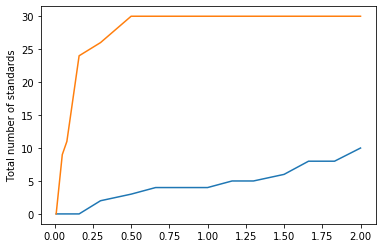

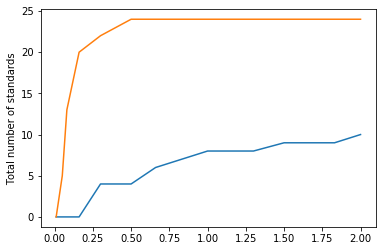

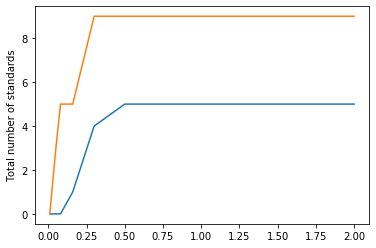

In [179]:
plot_peaks_rt(combinedvl)

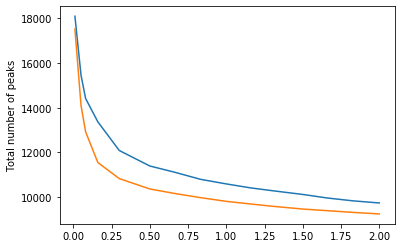

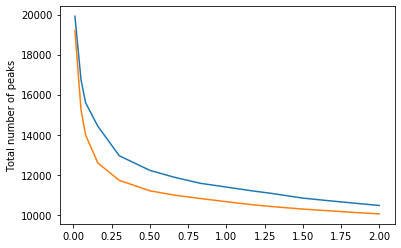

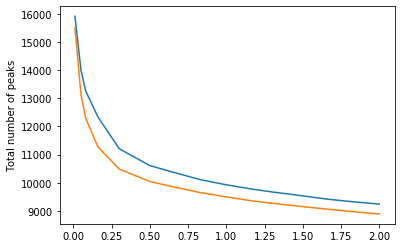

In [181]:
plot_peaks_rt(combinedvl, stds = False)

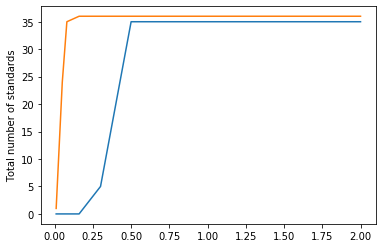

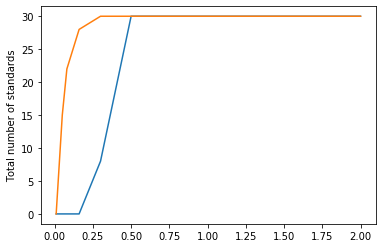

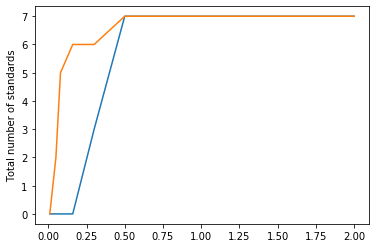

In [180]:
plot_peaks_rt(combined)

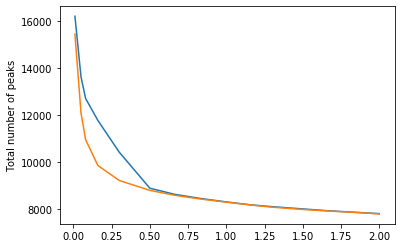

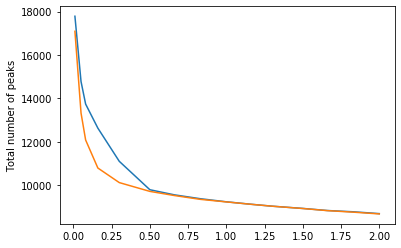

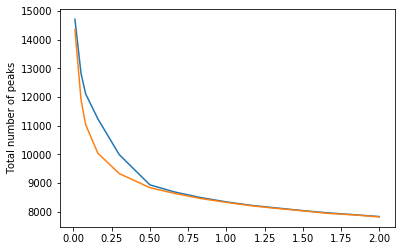

In [182]:
plot_peaks_rt(combined, False)